# LSTM Text Classifier Using Research Papers

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import tensorflow as tf
import numpy as np
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)

## Load Data set

In [3]:
#Load Training Data
df=pd.read_csv('D:\covid_noncovid_train.csv')
#Set width of columns to maximum
pd.set_option('display.max_colwidth', None)

In [4]:
df.head()

,title,author,journal,source,publish_year,abstract,Labels
0,"Zoom In, Zoom Out: The Impact of the COVID-19 Pandemic in the Classroom","Joia, Luiz Antonio, Lorenzo, Manuela",Sustainability,COVIDWHO,2021,"On 11 March 2020, the World Health Organization declared COVID-19 to be a pandemic to be confronted by humanity As a result, social isolation has become the norm in most countries, with the consequent replacement of face-to-face classes by classes mediated by information and communication technology Within this context, this work sets out to investigate the factors necessary for courses mediated by technology to attain their pedagogical objectives Additionally, the study examines how subjects that develop hard and soft skills differ in a technology-mediated setting The results show that the teacherâ€™s digital competence on the technological platform and the metacognitive support available in the digital environment are significant factors for a course to attain its pedagogical objectives successfully Lastly, the study revealed that hard skill disciplines, when they migrate to technology-mediated environments, are more likely to fail to achieve their educational goals than soft skill disciplines subject to the same migration",1
1,Worry and perceived risk of contagion during the COVID-19 quarantine in the Jalisco population: Preliminary Study,"Guzman-Gonzalez, J. I.; Sanchez-Garcia, F. G.; Ramirez-de los Santos, S.; Gutierrez-Rodriguez, F.; Palomino-Esparza, D.; Telles-Martinez, A. L.",Salud Mental,COVIDWHO,2020,"Introduction Preventive measures taken during periods of health crisis, specifically in pandemics, have consistently been associated with detrimental effects on mental health Isolation and loneliness are indirect effects of these preventive measures Given these premises, monitoring the behavior of the population in the face of these eventualities becomes important Worry as an indirect measure of anxiety and stress enables one to recognize subjects who are vulnerable to phenomena of high uncertainty, since measures taken to avoid excessive contagion can have high costs for this population This phenomenon has been consistently observed in other pandemics such as H1/N1 influenza Objective To determine the prevalence of worry and perceived risk of contagion in the Guadalajara population during the COVID-19 quarantine and to identify differentiating effects Method A total of 255 people from western Mexico (Guadalajara, Jalisco) voluntarily participated by answering the Penn State Worry Questionnaire (PSWQ) adapted to Mexican population The average age of the respondents, aged between 18 and 70 years, was 31 71 (+/- 5 19) A total of 170 women and 85 men participated in the study Results 40 12% of the population scored high levels of worry, making them vulnerable to mental health conditions Subjects favored the prevention of a contagion regardless of whether they were self-isolated The only variable that had a differential effect was sex (p &amp;lt; 05), and there were no differences in educational attainment, occupational demandingness, and isolation between the groups Discussion and conclusion A preventive attitude was observed among the participants, and so it is important to implement strategies that will prevent mental health costs in those who express excessive worry to avoid saturating mental health services",1
2,Why I Would Want to Live in the Village If I Was Not Interested in Cultivating the Plot? A Study of Home Gardening in Rural Czechia,"VÃ¡vra, Jan, SmutnÃ¡, ZdeÅˆka, HruÅ¡ka, Vladan",Sustainability,COVIDWHO,2021,"Unsustainable food practices in the global North have brought a lot of attention to the concept of alternative food networks However, prevailing research perspectives have focused on urban areas or market-related activities and tended to overlook the widespread yet neglected food growing in home gardens, especially in rural areas This paper uses a mixed method approach to study home gardening in two vill

In [5]:
#Load Testing Data
dft=pd.read_csv('D:\covid_noncovid_new_test.csv')
#Set width of columns to maximum
pd.set_option('display.max_colwidth', None)

In [6]:
dft.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract
0,covidwho-1361980,"China coronavirus: partial border closures into Hong Kong are not enough, say doctors.","Parry, Jane",BMJ,MEDLINE,article,en,GB,Jan-20,NaN
1,covidwho-1343226,"An anthropometric evaluation of the scapula, with emphasis on the coracoid process and glenoid fossa in a South African population.","Khan, R; Satyapal, K S; Lazarus, L; Naidoo, N",Heliyon,MEDLINE,article,en,GB,Jan-20,"The exact dimensions of the scapula, including the coracoid process and glenoid fossa, are fundamental in the patho-mechanics of the glenohumeral joint (GHJ); as these structures act as initiators of shoulder movement. The aim of the study was to evaluate the anthropometric parameters of the GHJ, with emphasis on the coracoid process and glenoid fossa. The morphometric (Linear Tools 2012, 0-150mm, LIN 86500963) and morphological parameters of a total of one hundred and sixty-four (n = 164) dry bone scapulae [Right (R): 80; Left (L): 84, Male (M): 68; Female (F): 96] were recorded. Results: (i) Shape of glenoid fossa: Type 1: (R) 16.5%, (L) 11.0%; Male (M) 20.1%, Female (F) 7.3%; Type 2: (R) 14.0%, (L) 15.2%; (M) 18.3%, (F) 11.0%; Type 3: (R) 18.3%, (L) 25.0%; (M) 27.4%, (F) 15.9%. (ii) Notch type: Type 1: (R) 1.7%, (L) 7.3%; (M) 6.7%, (F) 2.4%; Type 2: (R) 47.0%, (L) 43.9%; (M) 59.2%, (F) 31.7%. (iii) Vertical diameter of glenoid fossa (VD) (mm): (R) 35.2 Â± 3.1, (L) 34.9 Â± 3.0; (M) 35.3 Â± 3.2, (F) 34.6 Â± 2.8. (iv) Horizontal diameter 1 (HD1) of glenoid fossa (mm): (R) 18.4 Â± 3.3, (L) 17.5 Â± 2.9; (M) 18.2 Â± 3.3, (F) 17.4 Â± 2.6. (v) Horizontal diameter 2 (HD2) of glenoid fossa (mm): (R) 24.5 Â± 2.9, (L) 23.6 Â± 2.6; (M) 24.2 Â± 2.7, (F) 23.7 Â± 2.8. (vi) Length of coracoid process (CL) (mm): (R) 41.7 Â± 4.7, (L) 41.5 Â± 4.9; (M) 42.1 Â± 4.7, (F) 40.7 Â± 4.8. (vii) Width of coracoid process (CW) (mm): (R) 13.3 Â± 1.9, (L) 14.2 Â± 11.9; (M) 13.1 Â± 1.9, (F) 15.1 Â± 14.5. (viii) Coracoglenoid distance (CGD) (mm): (R) 27.4 Â± 8.3, (L) 28.2 Â± 3.5; (M) 28.2 Â± 7.4, (F) 27.0 Â± 3.4. In the present study, Type 3 (oval) was observed to be the predominant glenoid fossa shape with a higher incidence in male individuals and on the right side. Although only notch Types 1 (without a notch) and 2 (with one notch) were observed in this study, Type 2 (one notch) was the most prevalent, presenting with a significant p-value (p = 0.019), suggesting that notch Type 1 (without a notch) and 2 (with one notch) are common findings in the right and left side of individuals. The findings observed in this study may provide knowledge regarding the role of the coracoid parameters in etiology of subcoracoid impingement while knowledge on the glenoid fossa parameters and variations are essential for evaluation in shoulder arthroplasty for glenoid fractures and anterior dislocations, and for glenoid prosthesis designs for the South African population."
2,covidwho-1335914,"Pneumonia of unknown aetiology in Wuhan, China: potential for international spread via commercial air travel.","Bogoch, Isaac I; Watts, Alexander; Thomas-Bachli, Andrea; Huber, Carmen; Kraemer, Moritz U G; Khan, Kamran",J. travel med,MEDLINE,article,en,GB,Jan-20,"There is currently an outbreak of pneumonia of unknown aetiology in Wuhan, China. Although there are still several unanswered questions about this infection, we evaluate the potential for international dissemination of this disease via commercial air travel should the outbreak continue."
3,covidwho-1300286,HMPV in Immunocompromised Patients: Frequency and Severity in Pediatric Oncology Patients.,"Martinez-Rodriguez, Cesar; Banos-Lara, Ma Del Rocio",NaN,MEDLINE,article,en,CH,Jan-20,"Cancer is the first cause of death by disease in childhood globally. The most frequent types of cancers in children and adolescents are leukemias, followed by brain and central nervous system tumors and lymphomas. The recovery rate of cancer in children is around 

## Exploratory Data Analysis

In [7]:
#Shuffle dataset
from sklearn.utils import shuffle
df=shuffle(df,random_state=1)
df.head()

,title,author,journal,source,publish_year,abstract,Labels
9954,"Rabies viruses infect primary cultures of murine, feline, and human microglia and astrocytes","Ray, N. B.; Power, C.; Lynch, W. P.; Ewalt, L. C.; Lodmell, D. L.",Arch Virol,PMC,7/3/2014,"Recent studies have reported the detection of rabies viral antigens and virions in astrocytes and microglia of rabies-infected animals. As a first step toward understanding whether these glial cells may be involved in rabies virus replication, persistence, and/or pathogenesis, we explored their potential to be infected in vitro. Primary cultures of murine, feline, and human microglia and astrocytes were infected with several different rabies viruses: two unpassaged street virus isolates, a cell culture-adapted strain, and a mouse brain-passaged strain. Infection, as determined by immunofluorescence, was detected in 15 of the 16 (94%) virus-glial cell combinations. Replication of infectious virus, determined by infectivity assay, was detected in 7 of the 8 (88%) virus-cell combinations. These results show that astrocytes and microglia can be infected by rabies viruses, suggesting that they may have a potential role in disease, perhaps contributing to viral spread, persistence and/or neuronal dysfunction.",0
3851,EMA recommends expanding access to remdesivir,"[Data Missing],; en",HIV Treatment Bulletin,COVIDWHO,2020,WATERLIT Abstract: EMAâ€™s human medicines committee (CHMP) has recommended expanding the compassionate use of the investigational medicine remdesivir so that more patients with severe COVID19 can be treated,1
4963,The Impact of the Covid-19 Pandemic on Uptake of Influenza Vaccine: A UK-Wide Observational Study.,"Bachtiger, Patrik; Adamson, Alexander; Chow, Ji-Jian; Sisodia, Rupa; Quint, Jennifer K; Peters, Nicholas S",NaN,MEDLINE,2021,"BACKGROUND: In the face of the Covid-19 pandemic, the UK National Health Service (NHS) flu vaccination eligibility is extended this season to ~32.4 million (48.8%) of the population. Knowing intended uptake will inform supply and public health messaging to maximise vaccination. OBJECTIVE: The objective of this study was to measure the impact of the Covid-19 pandemic on acceptance of flu vaccination in the 2020-21 season, specifically focusing on those previously eligible who routinely decline vaccination and the newly eligible. METHODS: Intention to receive influenza vaccine in 2020-21 was asked of all registrants of the NHS&#039;s largest electronic personal health record by online questionnaire on 31st July 2020. Of those who were either newly or previously eligible but had not previously received influenza vaccination, multivariable logistic regression and network diagrams were used to examine reasons to have or decline vaccination. RESULTS: Among 6,641 respondents, 945 (14.2%) were previously eligible but not vaccinated, of whom 536 (56.7%) intended to receive flu vaccination in 2020/21, as did 466 (68.6%) of the newly eligible. Intention to receive the flu vaccine was associated with increased age, index of multiple deprivation (IMD) quintile, and considering oneself at high risk from Covid-19. Among those eligible but intending not to be vaccinated in 2020/21, 164 (30.2%) gave misinformed reasons. 47 (49.9%) of previously unvaccinated healthcare workers would decline vaccination in 2020/21. CONCLUSIONS: In this sample, Covid-19 has increased acceptance of flu vaccination in those previously eligible but unvaccinated and motivates substantial uptake in the newly eligible. This study is essential for informing resource planning and the need for effective messaging campaigns to address negative misconceptions, also necessary for Covid-19 vaccination programmes. CLINICALTRIAL: Not applicable.",1
7918,Biomarkers for Chronic Kidney Disease Associated with High Salt Intake,"Hosohata, Keiko",Int J Mol Sci,PMC,9/30/2017,"High salt intake has been related to the development to chronic kidney disease (CKD) as well as hypertension. In its early

In [8]:
#Drop unnecessary columns from training data
df1=df.drop(['author','journal','source','publish_year'],axis=1)
df1.head()

,title,abstract,Labels
9954,"Rabies viruses infect primary cultures of murine, feline, and human microglia and astrocytes","Recent studies have reported the detection of rabies viral antigens and virions in astrocytes and microglia of rabies-infected animals. As a first step toward understanding whether these glial cells may be involved in rabies virus replication, persistence, and/or pathogenesis, we explored their potential to be infected in vitro. Primary cultures of murine, feline, and human microglia and astrocytes were infected with several different rabies viruses: two unpassaged street virus isolates, a cell culture-adapted strain, and a mouse brain-passaged strain. Infection, as determined by immunofluorescence, was detected in 15 of the 16 (94%) virus-glial cell combinations. Replication of infectious virus, determined by infectivity assay, was detected in 7 of the 8 (88%) virus-cell combinations. These results show that astrocytes and microglia can be infected by rabies viruses, suggesting that they may have a potential role in disease, perhaps contributing to viral spread, persistence and/or neuronal dysfunction.",0
3851,EMA recommends expanding access to remdesivir,WATERLIT Abstract: EMAâ€™s human medicines committee (CHMP) has recommended expanding the compassionate use of the investigational medicine remdesivir so that more patients with severe COVID19 can be treated,1
4963,The Impact of the Covid-19 Pandemic on Uptake of Influenza Vaccine: A UK-Wide Observational Study.,"BACKGROUND: In the face of the Covid-19 pandemic, the UK National Health Service (NHS) flu vaccination eligibility is extended this season to ~32.4 million (48.8%) of the population. Knowing intended uptake will inform supply and public health messaging to maximise vaccination. OBJECTIVE: The objective of this study was to measure the impact of the Covid-19 pandemic on acceptance of flu vaccination in the 2020-21 season, specifically focusing on those previously eligible who routinely decline vaccination and the newly eligible. METHODS: Intention to receive influenza vaccine in 2020-21 was asked of all registrants of the NHS&#039;s largest electronic personal health record by online questionnaire on 31st July 2020. Of those who were either newly or previously eligible but had not previously received influenza vaccination, multivariable logistic regression and network diagrams were used to examine reasons to have or decline vaccination. RESULTS: Among 6,641 respondents, 945 (14.2%) were previously eligible but not vaccinated, of whom 536 (56.7%) intended to receive flu vaccination in 2020/21, as did 466 (68.6%) of the newly eligible. Intention to receive the flu vaccine was associated with increased age, index of multiple deprivation (IMD) quintile, and considering oneself at high risk from Covid-19. Among those eligible but intending not to be vaccinated in 2020/21, 164 (30.2%) gave misinformed reasons. 47 (49.9%) of previously unvaccinated healthcare workers would decline vaccination in 2020/21. CONCLUSIONS: In this sample, Covid-19 has increased acceptance of flu vaccination in those previously eligible but unvaccinated and motivates substantial uptake in the newly eligible. This study is essential for informing resource planning and the need for effective messaging campaigns to address negative misconceptions, also necessary for Covid-19 vaccination programmes. CLINICALTRIAL: Not applicable.",1
7918,Biomarkers for Chronic Kidney Disease Associated with High Salt Intake,"High salt intake has been related to the development to chronic kidney disease (CKD) as well as hypertension. In its early stages, symptoms of CKD are usually not apparent, especially those that are induced in a â€œsilentâ€ manner in normotensive individuals, thereby providing a need for some kind of urinary biomarker to detect injury at an early stage. Because traditional renal biomarkers such as serum creatinine are insensitive, it is difficult to detect kidney injury indu

In [9]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10001 entries, 9954 to 235
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   title     10001 non-null  object
 1   abstract  10000 non-null  object
 2   Labels    10001 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 312.5+ KB


In [10]:
dft.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161630 entries, 0 to 161629
Data columns (total 10 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   ID                   161627 non-null  object
 1   Title                161625 non-null  object
 2   Authors              160164 non-null  object
 3   Journal              137642 non-null  object
 4   Database             161627 non-null  object
 5   Type                 161628 non-null  object
 6   Language             143212 non-null  object
 7   Publication Country  142517 non-null  object
 8   Publication_time     157998 non-null  object
 9    Abstract            113913 non-null  object
dtypes: object(10)
memory usage: 12.3+ MB


In [11]:
#Shape of training data
df.shape

(10001, 7)

In [12]:
#Shape testing data
dft.shape

(161630, 10)

In [13]:
#Check Null values in Rows in training data
df1.isnull().sum()

title       0
abstract    1
Labels      0
dtype: int64

In [14]:
#Remove rows with null values
df1.dropna(inplace=True)

In [15]:
df1.isnull().sum()

title       0
abstract    0
Labels      0
dtype: int64

In [16]:
#Check Null Rows in testing data
dft.isnull().sum()

ID                         3
Title                      5
Authors                 1466
Journal                23988
Database                   3
Type                       2
Language               18418
Publication Country    19113
Publication_time        3632
 Abstract              47717
dtype: int64

In [17]:
#Remove rows with null values in test dataset
dft1=dft
dft1.dropna(inplace=True)

In [18]:
dft1.isnull().sum()

ID                     0
Title                  0
Authors                0
Journal                0
Database               0
Type                   0
Language               0
Publication Country    0
Publication_time       0
 Abstract              0
dtype: int64

In [19]:
df1.shape #Shape of training data 

(10000, 3)

In [20]:
dft1.shape #Shape of testing testing data

(86721, 10)

## Data Cleaning

In [21]:
#Clean title
##Make all letters lowercase
df1['title'] = df1['title'].apply(lambda x: " ".join(x.lower() for x in x.split()))

#Remove Punctuation, Symbols to simplify text
df1['title'] = df1['title'].str.replace('[^\w\s]',' ')

#Remove Stop Words using NLTK
from nltk.corpus import stopwords
stop = stopwords.words('english')
df1['title'] = df1['title'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

#Lemmatizationin: convert words to a single form.
from textblob import Word
df1['title'] = df1['title'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

#Remove Digits from text
df1['title']= df1['title'].replace('\d+', '', regex=True)

#Remove words having letters less then 5
df1['title']=df1.title.str.replace(r'\b(\w{1,4})\b', '')

# function to remove non-alphabets
def remove_non_alpha(text): 
    return ''.join(i for i in text if ord(i)<128) 
 
df1['title'] = df1['title'].apply(remove_non_alpha) 

In [22]:
df1.head()

,title,abstract,Labels
9954,rabies virus infect primary culture murine feline human microglia astrocyte,"Recent studies have reported the detection of rabies viral antigens and virions in astrocytes and microglia of rabies-infected animals. As a first step toward understanding whether these glial cells may be involved in rabies virus replication, persistence, and/or pathogenesis, we explored their potential to be infected in vitro. Primary cultures of murine, feline, and human microglia and astrocytes were infected with several different rabies viruses: two unpassaged street virus isolates, a cell culture-adapted strain, and a mouse brain-passaged strain. Infection, as determined by immunofluorescence, was detected in 15 of the 16 (94%) virus-glial cell combinations. Replication of infectious virus, determined by infectivity assay, was detected in 7 of the 8 (88%) virus-cell combinations. These results show that astrocytes and microglia can be infected by rabies viruses, suggesting that they may have a potential role in disease, perhaps contributing to viral spread, persistence and/or neuronal dysfunction.",0
3851,recommends expanding access remdesivir,WATERLIT Abstract: EMAâ€™s human medicines committee (CHMP) has recommended expanding the compassionate use of the investigational medicine remdesivir so that more patients with severe COVID19 can be treated,1
4963,impact covid pandemic uptake influenza vaccine observational study,"BACKGROUND: In the face of the Covid-19 pandemic, the UK National Health Service (NHS) flu vaccination eligibility is extended this season to ~32.4 million (48.8%) of the population. Knowing intended uptake will inform supply and public health messaging to maximise vaccination. OBJECTIVE: The objective of this study was to measure the impact of the Covid-19 pandemic on acceptance of flu vaccination in the 2020-21 season, specifically focusing on those previously eligible who routinely decline vaccination and the newly eligible. METHODS: Intention to receive influenza vaccine in 2020-21 was asked of all registrants of the NHS&#039;s largest electronic personal health record by online questionnaire on 31st July 2020. Of those who were either newly or previously eligible but had not previously received influenza vaccination, multivariable logistic regression and network diagrams were used to examine reasons to have or decline vaccination. RESULTS: Among 6,641 respondents, 945 (14.2%) were previously eligible but not vaccinated, of whom 536 (56.7%) intended to receive flu vaccination in 2020/21, as did 466 (68.6%) of the newly eligible. Intention to receive the flu vaccine was associated with increased age, index of multiple deprivation (IMD) quintile, and considering oneself at high risk from Covid-19. Among those eligible but intending not to be vaccinated in 2020/21, 164 (30.2%) gave misinformed reasons. 47 (49.9%) of previously unvaccinated healthcare workers would decline vaccination in 2020/21. CONCLUSIONS: In this sample, Covid-19 has increased acceptance of flu vaccination in those previously eligible but unvaccinated and motivates substantial uptake in the newly eligible. This study is essential for informing resource planning and the need for effective messaging campaigns to address negative misconceptions, also necessary for Covid-19 vaccination programmes. CLINICALTRIAL: Not applicable.",1
7918,biomarkers chronic kidney disease associated intake,"High salt intake has been related to the development to chronic kidney disease (CKD) as well as hypertension. In its early stages, symptoms of CKD are usually not apparent, especially those that are induced in a â€œsilentâ€ manner in normotensive individuals, thereby providing a need for some kind of urinary biomarker to detect injury at an early stage. Because traditional renal biomarkers such as serum creatinine are insensitive, it is difficult to detect kidney injury induced by a high-salt diet, especially in normotensive individuals. Recently, se

In [23]:
#Clean abstract
##Make all letters lowercase in abstract column
df1['abstract'] = df1['abstract'].apply(lambda x: " ".join(x.lower() for x in x.split()))

#Remove Punctuation, Symbols to simplify text
df1['abstract'] = df1['abstract'].str.replace('[^\w\s]',' ')

#Remove Stop Words using NLTK
from nltk.corpus import stopwords
stop = stopwords.words('english')
df1['abstract'] = df1['abstract'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

#Lemmatizationin: convert words to a single form.
from textblob import Word
df1['abstract'] = df1['abstract'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

#Remove Digits from text
df1['abstract']= df1['abstract'].replace('\d+', '', regex=True)

#Remove words having letters less then 5
df1['abstract']=df1.abstract.str.replace(r'\b(\w{1,4})\b', '')

# function to remove non-alphabets
def remove_non_alpha(text): 
    return ''.join(i for i in text if ord(i)<128) 
 
df1['abstract'] = df1['abstract'].apply(remove_non_alpha) 

In [24]:
df1.head()

,title,abstract,Labels
9954,rabies virus infect primary culture murine feline human microglia astrocyte,recent study reported detection rabies viral antigen virion astrocyte microglia rabies infected animal first toward understanding whether glial involved rabies virus replication persistence pathogenesis explored potential infected vitro primary culture murine feline human microglia astrocyte infected several different rabies virus unpassaged street virus isolates culture adapted strain mouse brain passaged strain infection determined immunofluorescence detected virus glial combination replication infectious virus determined infectivity assay detected virus combination result astrocyte microglia infected rabies virus suggesting potential disease perhaps contributing viral spread persistence neuronal dysfunction,0
3851,recommends expanding access remdesivir,waterlit abstract human medicine committee recommended expanding compassionate investigational medicine remdesivir patient severe covid treated,1
4963,impact covid pandemic uptake influenza vaccine observational study,background covid pandemic national health service vaccination eligibility extended season million population knowing intended uptake inform supply public health messaging maximise vaccination objective objective study measure impact covid pandemic acceptance vaccination season specifically focusing previously eligible routinely decline vaccination newly eligible method intention receive influenza vaccine asked registrant largest electronic personal health record online questionnaire either newly previously eligible previously received influenza vaccination multivariable logistic regression network diagram examine reason decline vaccination result among respondent previously eligible vaccinated intended receive vaccination newly eligible intention receive vaccine associated increased index multiple deprivation quintile considering oneself covid among eligible intending vaccinated misinformed reason previously unvaccinated healthcare worker would decline vaccination conclusion sample covid increased acceptance vaccination previously eligible unvaccinated motivates substantial uptake newly eligible study essential informing resource planning effective messaging campaign address negative misconception necessary covid vaccination programme clinicaltrial applicable,1
7918,biomarkers chronic kidney disease associated intake,intake related development chronic kidney disease hypertension early stage symptom usually apparent especially induced silent manner normotensive individual thereby providing urinary biomarker detect injury early stage traditional renal biomarkers serum creatinine insensitive difficult detect kidney injury induced especially normotensive individual recently several biomarkers damage renal tubular epithelium neutrophil gelatinase associated lipocalin kidney injury molecule identified previously found novel renal biomarker urinary vanin several animal model renal tubular injury however study early biomarkers progression associated review present insight novel biomarkers normotensives hypertensive intake interestingly recent report using spontaneously hypertensive normotensive wistar kyoto revealed urinary vanin earlier biomarkers renal tubular damage whereas urinary useful biomarker induced renal injury clinical study needed clarify finding,0
9382,rural youth violence public health concern,youth violence significant issue public health potential longterm impact individual family community limited exposure violence component healthy living however limited understanding violence public health perspective within rural community rural refers community population outside commuting large urban population health approach including social determinant health supported public health official generating information rural youth violence canadian perspective would understanding social determinant providing guidance policy program development current understandin

In [25]:
# Clean Title of Test Data

##Make all letters lowercase
dft1['Title'] = dft1['Title'].apply(lambda x: " ".join(x.lower() for x in x.split()))

#Remove Punctuation, Symbols to simplify text
dft1['Title'] = dft1['Title'].str.replace('[^\w\s]',' ')

#Remove Stop Words using NLTK
from nltk.corpus import stopwords
stop = stopwords.words('english')
dft1['Title'] = dft1['Title'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

#Lemmatizationin: convert words to a single form.
from textblob import Word
dft1['Title'] = dft1['Title'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

#Remove Digits from text
dft1['Title']= dft1['Title'].replace('\d+', '', regex=True)

#Remove words having letters less then 5
dft1['Title']=dft1.Title.str.replace(r'\b(\w{1,4})\b', '')

# function to remove non-alphabets
def remove_non_alpha(text): 
    return ''.join(i for i in text if ord(i)<128) 
 
dft1['Title'] = dft1['Title'].apply(remove_non_alpha) 

In [26]:
#Clean Abstract of Test Data
dft1 = dft1.rename(columns={' Abstract': 'Abstract'})

##Make all letters lowercase in abstract column
dft1['Abstract'] = dft1['Abstract'].apply(lambda x: " ".join(x.lower() for x in x.split()))

#Remove Punctuation, Symbols to simplify text
dft1['Abstract'] = dft1['Abstract'].str.replace('[^\w\s]',' ')

#Remove Stop Words using NLTK
from nltk.corpus import stopwords
stop = stopwords.words('english')
dft1['Abstract'] = dft1['Abstract'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

#Lemmatizationin: convert words to a single form.
from textblob import Word
dft1['Abstract'] = dft1['Abstract'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

#Remove Digits from text
dft1['Abstract']= dft1['Abstract'].replace('\d+', '', regex=True)

#Remove words having letters less then 5
dft1['Abstract']=dft1.Abstract.str.replace(r'\b(\w{1,4})\b', '')

# function to remove non-alphabets
def remove_non_alpha(text): 
    return ''.join(i for i in text if ord(i)<128) 
 
dft1['Abstract'] = dft1['Abstract'].apply(remove_non_alpha) 

In [27]:
dft1.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract
1,covidwho-1343226,anthropometric evaluation scapula emphasis coracoid process glenoid fossa south african population,"Khan, R; Satyapal, K S; Lazarus, L; Naidoo, N",Heliyon,MEDLINE,article,en,GB,Jan-20,exact dimension scapula including coracoid process glenoid fossa fundamental patho mechanic glenohumeral joint structure initiator shoulder movement study evaluate anthropometric parameter emphasis coracoid process glenoid fossa morphometric linear morphological parameter total hundred sixty scapula right female recorded result shape glenoid fossa female notch vertical diameter glenoid fossa horizontal diameter glenoid fossa horizontal diameter glenoid fossa length coracoid process width coracoid process coracoglenoid distance present study observed predominant glenoid fossa shape higher incidence individual right although notch without notch notch observed study notch prevalent presenting significant value suggesting notch without notch notch common finding right individual finding observed study provide knowledge regarding coracoid parameter etiology subcoracoid impingement knowledge glenoid fossa parameter variation essential evaluation shoulder arthroplasty glenoid fracture anterior dislocation glenoid prosthesis design south african population
2,covidwho-1335914,pneumonia unknown aetiology wuhan china potential international spread commercial travel,"Bogoch, Isaac I; Watts, Alexander; Thomas-Bachli, Andrea; Huber, Carmen; Kraemer, Moritz U G; Khan, Kamran",J. travel med,MEDLINE,article,en,GB,Jan-20,currently outbreak pneumonia unknown aetiology wuhan china although still several unanswered question infection evaluate potential international dissemination disease commercial travel outbreak continue
4,covidwho-1291550,ospemifene novel therapy vulvovaginal atrophy menopause,"Reid, Robert L; Black, Denise; Derzko, Christine; Portman, David",J Obstet Gynaecol Can,MEDLINE,article,en,NL,Jan-20,vulvovaginal atrophy resulting estrogen deprivation menopause often result distressing vaginal dryness dyspareunia fewer affected woman condition citing embarrassment cultural value aging unavailable partner concern estrogen following woman health initiative available hormonal treatment moisturizers affording relief messy apply prevent disease progression selective estrogen receptor modulator ospemifene found strong estrogenic activity vaginal tissue without adverse estrogenic effect
6,covidwho-1217360,potential large first generation human human transmission,"Li, Xingguang; Zai, Junjie; Wang, Xiaomei; Li, Yi",J Med Virol,MEDLINE,article,en,US,Jan-20,investigate genetic diversity origin evolutionary history outbreak china thailand total genome sequence virus known sampling december january geographic location primarily wuhan hubei province china bangkok thailand analyzed phylogenetic likelihood mapping analysis genome sequence performed basis result signal topology indicative potentially large first generation human human virus transmission estimated likely originated wuhan november credible interval september december wuhan major spread outbreak china elsewhere result could useful designing effective prevention strategy china beyond
7,covidwho-1169480,genomic characterization novel human pathogenic coronavirus isolated patient atypical pneumonia visiting wuhan,"Chan, Jasper Fuk-Woo; Kok, Kin-Hang; Zhu, Zheng; Chu, Hin; To, Kelvin Kai-Wang; Yuan, Shuofeng; Yuen, Kwok-Yung",Emerg Microbes Infect,MEDLINE,article,en,US,Jan-20,mysterious outbreak atypical pneumonia traced seafood wholesale market wuhan china within novel coronavirus tentatively named novel coronavirus announced world health organization performed bioinformatics analysis virus genome patient infection compared related coronavirus genome overall genome nucleotide identity covzxc human phylogenetic spike envelope membrane nucleoprotein clustered closely civet human coronaviruses however 

## Build LSTM (Long Short-Term Memory) Classifier

In [28]:
#Find distinct words
def find_distinct_Words(data):
    from collections import Counter
    cr = Counter()
    data.str.lower().str.split().apply(cr.update)
    return cr

In [29]:
#distinct words in title
tcr=find_distinct_Words(df1['title'] )
print(tcr)

Counter({'covid': 3166, 'virus': 1201, 'pandemic': 1021, 'infection': 823, 'patient': 822, 'study': 756, 'disease': 625, 'influenza': 617, 'analysis': 536, 'health': 511, 'human': 453, 'protein': 415, 'respiratory': 412, 'based': 388, 'response': 387, 'coronavirus': 373, 'review': 353, 'impact': 345, 'vaccine': 325, 'using': 320, 'clinical': 305, 'acute': 299, 'associated': 290, 'model': 270, 'viral': 269, 'effect': 269, 'novel': 254, 'antibody': 250, 'among': 248, 'factor': 240, 'severe': 232, 'system': 216, 'syndrome': 215, 'detection': 214, 'treatment': 214, 'mouse': 200, 'induced': 197, 'child': 188, 'hospital': 187, 'outbreak': 177, 'transmission': 175, 'outcome': 167, 'epidemic': 167, 'approach': 167, 'systematic': 167, 'social': 166, 'development': 165, 'potential': 164, 'china': 164, 'activity': 163, 'control': 163, 'immune': 160, 'mortality': 157, 'pneumonia': 156, 'public': 153, 'expression': 153, 'molecular': 153, 'related': 149, 'trial': 149, 'report': 149, 'evaluation': 14

In [30]:
#Total distinct words in Title
len(tcr)

11628

In [31]:
#distinct words in abstract
acr=find_distinct_Words(df1['abstract'])
print(acr)

Counter({'covid': 12170, 'patient': 10586, 'study': 8091, 'virus': 7673, 'infection': 7128, 'disease': 6524, 'result': 5546, 'pandemic': 5354, 'health': 5230, 'protein': 4208, 'method': 3882, 'analysis': 3462, 'using': 3400, 'viral': 3362, 'response': 3278, 'human': 3230, 'clinical': 3221, 'level': 3194, 'associated': 3163, 'group': 3133, 'model': 3095, 'influenza': 2991, 'based': 2890, 'vaccine': 2770, 'effect': 2732, 'respiratory': 2707, 'conclusion': 2677, 'treatment': 2650, 'system': 2535, 'factor': 2463, 'coronavirus': 2421, 'severe': 2390, 'development': 2295, 'however': 2295, 'control': 2234, 'among': 2149, 'hospital': 2106, 'number': 2083, 'including': 2055, 'different': 2047, 'mortality': 2044, 'population': 2042, 'related': 2041, 'activity': 2026, 'compared': 1952, 'specific': 1947, 'acute': 1918, 'potential': 1917, 'increased': 1907, 'positive': 1902, 'first': 1895, 'higher': 1889, 'antibody': 1877, 'background': 1874, 'public': 1837, 'significant': 1815, 'expression': 1795,

In [32]:
#Total distinct words in Abstract
len(acr)

35643

In [33]:
def find_longest_text_row(trow):
    maxlen=-1
    for doc in str(trow):
        tokens=nltk.word_tokenize(str(trow))
        if(maxlen<len(tokens)):
            maxlen=len(tokens)
    return maxlen

In [33]:
print("Maximum Number of Words in any Title: ",find_longest_text_row(df1['title']))
print("Maximum Number of Words in any Abstract: ",find_longest_text_row(df1['abstract']))

Maximum Number of Words in any Title:  98
Maximum Number of Words in any Abstract:  874


In [34]:
num_words_title = len(tcr)

# All the titles or abstracts does not have similar length so we are setting values as per our intuition
# Maximum length in a sequence
max_length_title = 50

num_words_abstract = len(acr)
# Maximum length in a sequence
max_length_abstract= 200

from tensorflow.keras.preprocessing.text import Tokenizer
#Tokenize sentences of title
tokenizer_title = Tokenizer(num_words=num_words_title )
tokenizer_title.fit_on_texts(df1['title'])

#convert words into sequence
title_sequence= tokenizer_title.texts_to_sequences(df1['title'])

tokenizer_abstract = Tokenizer(num_words=num_words_abstract)
tokenizer_abstract.fit_on_texts(df1['abstract'])
abstract_sequence= tokenizer_abstract.texts_to_sequences(df1['abstract'])

In [35]:
print(title_sequence[0])

[1016, 2, 3144, 252, 300, 469, 409, 11, 1375, 1640]


In [36]:
print(abstract_sequence[0])

[209, 3, 68, 156, 2275, 14, 206, 1160, 2534, 1971, 2275, 69, 148, 51, 1112, 218, 250, 4462, 278, 2275, 4, 139, 1518, 520, 1048, 48, 69, 273, 161, 329, 1375, 2176, 16, 1971, 2534, 69, 130, 40, 2275, 4, 15863, 3711, 4, 583, 329, 1261, 94, 77, 602, 6373, 94, 5, 474, 2196, 201, 4, 4462, 475, 139, 117, 4, 474, 1196, 96, 201, 4, 475, 7, 2534, 1971, 69, 2275, 4, 501, 48, 6, 2810, 2051, 14, 104, 1518, 3146, 933]


In [37]:
from tensorflow.keras.preprocessing.sequence import pad_sequences
#Different rows of column have differnet number of words, LSTM does not accept data in this style,
# so we need make the size of each row similar by adding zeros and truncating it.
title_padded= pad_sequences(title_sequence, maxlen=max_length_title, padding='post', truncating='post')

abstract_padded= pad_sequences(abstract_sequence, maxlen=max_length_abstract, padding='post', truncating='post')

In [37]:
print(title_padded[0])

[1016    2 3144  252  300  469  409   11 1375 1640    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


In [38]:
print(abstract_padded[0])

[  209     3    68   156  2275    14   206  1160  2534  1971  2275    69
   148    51  1112   218   250  4462   278  2275     4   139  1518   520
  1048    48    69   273   161   329  1375  2176    16  1971  2534    69
   130    40  2275     4 15863  3711     4   583   329  1261    94    77
   602  6373    94     5   474  2196   201     4  4462   475   139   117
     4   474  1196    96   201     4   475     7  2534  1971    69  2275
     4   501    48     6  2810  2051    14   104  1518  3146   933     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0   

In [44]:
# Split data into train and test
train_size=int(df1.shape[0]*0.90)
train_title= title_padded[:train_size]
train_labels= df1.Labels[:train_size]

test_title= title_padded[train_size:]
test_labels= df1.Labels[train_size:]

train_abstract= abstract_padded[:train_size]
test_abstract= abstract_padded[train_size:]

In [40]:
train_title.shape

(9000, 50)

In [41]:
test_title.shape

(1000, 50)

In [42]:
train_abstract.shape

(9000, 200)

In [43]:
test_abstract.shape

(1000, 200)

In [44]:
train_labels.shape

(9000,)

In [45]:
test_labels.shape

(1000,)

In [50]:
#LSTM using title as an input to classify labels
np.random.seed(46)
tf.random.set_seed(46)
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout
from tensorflow.keras.models import Sequential
from tensorflow import keras
from tensorflow.keras.optimizers import Adam

model = Sequential()

# Embedd each word into 10 dimensional vector
model.add(Embedding(num_words_title,10,input_length=max_length_title))
# Bring down sequence of embedded words into a single 6 dimensional vector
#Dropout prevents networks from overfitting
model.add(LSTM(6,dropout=0.1))
#1 means single dimensional output
# Activation function is used to adjust the output and feed it again as an input to layer
model.add(Dense(1,activation='sigmoid'))
# Optimizer is used to update network layer weights iteratively based on training data
# Learning rate controls how much change will be apllied to model after updating weights and caluclating error or loss
optimizer = Adam()
# loss function is used to calculate the loss or error
model.compile(loss='binary_crossentropy',optimizer=optimizer,metrics=['accuracy'])

model.fit(train_title,train_labels,epochs=50,validation_data=(test_title,test_labels))

Epoch 1/50
282/282 [==============================] - 9s 23ms/step - loss: 0.6933 - accuracy: 0.5060 - val_loss: 0.6930 - val_accuracy: 0.5090
Epoch 2/50
282/282 [==============================] - 5s 19ms/step - loss: 0.6932 - accuracy: 0.5024 - val_loss: 0.6930 - val_accuracy: 0.5090
Epoch 3/50
282/282 [==============================] - 6s 21ms/step - loss: 0.6936 - accuracy: 0.4815 - val_loss: 0.6931 - val_accuracy: 0.5090
Epoch 4/50
282/282 [==============================] - 5s 19ms/step - loss: 0.6933 - accuracy: 0.4886 - val_loss: 0.6931 - val_accuracy: 0.5090
Epoch 5/50
282/282 [==============================] - 6s 20ms/step - loss: 0.6932 - accuracy: 0.5103 - val_loss: 0.6932 - val_accuracy: 0.4910
Epoch 6/50
282/282 [==============================] - 6s 21ms/step - loss: 0.6933 - accuracy: 0.4897 - val_loss: 0.6931 - val_accuracy: 0.5090
Epoch 7/50
282/282 [==============================] - 8s 27ms/step - loss: 0.6161 - accuracy: 0.6223 - val_loss: 0.4347 - val_accuracy: 0.8350

In [51]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
y1_lables=model.predict_classes(test_title)
print ("Accuracy score: ",accuracy_score(test_labels, y1_lables)*100,"%")
print("f1 Score:",f1_score(test_labels, y1_lables))
#Hamming loss computes The fraction of labels that are incorrectly predicted
print("hamming loss:",hamming_loss(test_labels, y1_lables))
print("average precision score:",average_precision_score(test_labels, y1_lables))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, y1_lables))

#Classification Report
target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
from sklearn.metrics import classification_report
print(classification_report(test_labels, y1_lables, target_names=target_names))

Accuracy score:  85.9 %
f1 Score: 0.8571428571428572
hamming loss: 0.141
average precision score: 0.8027127324091715
balanced_accuracy_score: 0.8590443303630376

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.87      0.86      0.86       509
class 1     (Covid)       0.85      0.86      0.86       491

           accuracy                           0.86      1000
          macro avg       0.86      0.86      0.86      1000
       weighted avg       0.86      0.86      0.86      1000



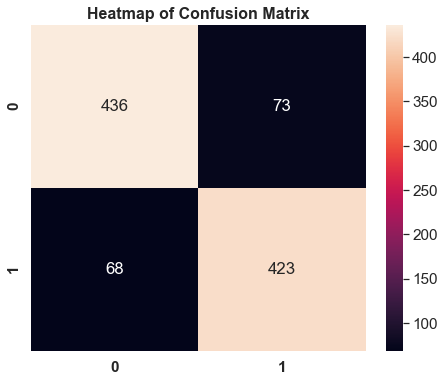

In [52]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(test_labels, y1_lables)
plt.figure(figsize=(7.5,6))
plt.title('Heatmap of Confusion Matrix', fontsize = 16,weight='bold')
plt.xticks(weight='bold')
plt.yticks(weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(cm, annot = True,fmt='g')
plt.show()

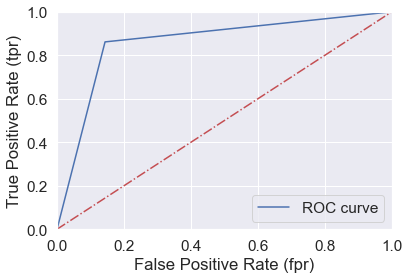

In [53]:
from sklearn.metrics import roc_curve
fpr, tpr, _= roc_curve(test_labels, y1_lables)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'r-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)')
plt.ylabel('True Positive Rate (tpr)')
plt.legend(loc="lower right")
plt.show()

In [45]:
#LSTM using abstract as an input to classify labels
np.random.seed(9)
tf.random.set_seed(9)
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout
from tensorflow.keras.models import Sequential
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.optimizers import Adam

model = Sequential()
model.add(Embedding(num_words_abstract,30,input_length=max_length_abstract))
model.add(LSTM(64,dropout=0.1))
model.add(Dense(1,activation='sigmoid'))

optimizer = Adam(learning_rate=3e-4)
model.compile(loss='binary_crossentropy',optimizer=optimizer,metrics=['accuracy'])

results=model.fit(train_abstract,train_labels,epochs=30,validation_data=(test_abstract,test_labels))

Epoch 1/30
282/282 [==============================] - 39s 128ms/step - loss: 0.6935 - accuracy: 0.5023 - val_loss: 0.6928 - val_accuracy: 0.5170
Epoch 2/30
282/282 [==============================] - 36s 129ms/step - loss: 0.6930 - accuracy: 0.5126 - val_loss: 0.6928 - val_accuracy: 0.5150
Epoch 3/30
282/282 [==============================] - 36s 127ms/step - loss: 0.6926 - accuracy: 0.5087 - val_loss: 0.6928 - val_accuracy: 0.5170
Epoch 4/30
282/282 [==============================] - 36s 127ms/step - loss: 0.6932 - accuracy: 0.5062 - val_loss: 0.6923 - val_accuracy: 0.5200
Epoch 5/30
282/282 [==============================] - 36s 129ms/step - loss: 0.6902 - accuracy: 0.5132 - val_loss: 0.6255 - val_accuracy: 0.6500
Epoch 6/30
282/282 [==============================] - 36s 127ms/step - loss: 0.5795 - accuracy: 0.6820 - val_loss: 0.3465 - val_accuracy: 0.8900
Epoch 7/30
282/282 [==============================] - 36s 126ms/step - loss: 0.3389 - accuracy: 0.8931 - val_loss: 0.3511 - val_ac

In [83]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
y_lables=model.predict_classes(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, y_lables)*100,"%")
print("f1 Score:",f1_score(test_labels, y_lables))
#Hamming loss computes The fraction of labels that are incorrectly predicted
print("hamming loss:",hamming_loss(test_labels, y_lables))
print("average precision score:",average_precision_score(test_labels, y_lables))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, y_lables))

#Classification Report
target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
from sklearn.metrics import classification_report
print(classification_report(test_labels, y_lables, target_names=target_names))

Accuracy score:  88.1 %
f1 Score: 0.880803943044907
hamming loss: 0.107
average precision score: 0.8718196542504416
balanced_accuracy_score: 0.8917229182255051

Classification Report:
		     precision    recall  f1-score   support

class 0 (Non-Covid)       0.85      0.96      0.90       509
class 1     (Covid)       0.95      0.82      0.88       491

	   accuracy                           0.89      1000
	  macro avg       0.90      0.89      0.89      1000
       weighted avg       0.90      0.89      0.89      1000


In [88]:
#Save Model
model.save('abstract_model.h5')

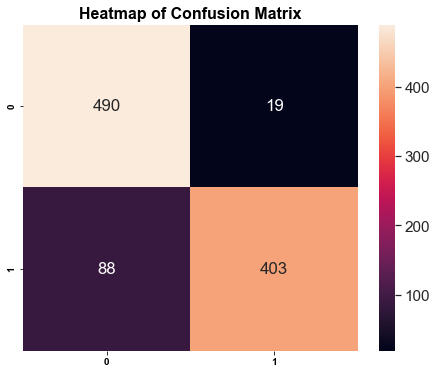

In [86]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(test_labels, y_lables)
plt.figure(figsize=(7.5,6))
plt.title('Heatmap of Confusion Matrix', fontsize = 16,weight='bold')
plt.xticks(weight='bold')
plt.yticks(weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(cm, annot = True,fmt='g')
plt.show()

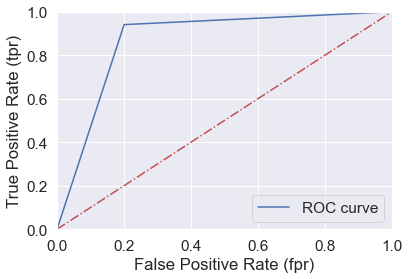

In [62]:
from sklearn.metrics import roc_curve
fpr, tpr, _= roc_curve(test_labels, y_lables)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'r-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)')
plt.ylabel('True Positive Rate (tpr)')
plt.legend(loc="lower right")
plt.show()

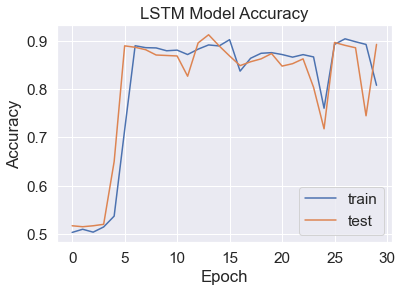

In [87]:
plt.plot(results.history['accuracy'])
plt.plot(results.history['val_accuracy'])
plt.title('LSTM Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train', 'test'], loc='best')
plt.show()

## Test Model on Unseen Data

In [81]:
#Import unseen data
dft=pd.read_csv("testdata.csv")

In [82]:
dft

,title,Abstract
0,The epidemiology and pathogenesis of coronavirus disease (COVID-19) outbreak,"Coronavirus disease (COVID-19) is caused by SARS-COV2 and represents the causative agent of a potentially fatal disease that is of great global public health concern. Based on the large number of infected people that were exposed to the wet animal market in Wuhan City, China, it is suggested that this is likely the zoonotic origin of COVID-19. Person-to-person transmission of COVID-19 infection led to the isolation of patients that were subsequently administered a variety of treatments. Extensive measures to reduce person-to-person transmission of COVID-19 have been implemented to control the current outbreak. Special attention and efforts to protect or reduce transmission should be applied in susceptible populations including children, health care providers, and elderly people. In this review, we highlights the symptoms, epidemiology, transmission, pathogenesis, phylogenetic analysis and future directions to control the spread of this fatal disease"


In [83]:
# To test our model on unseen data, we need to first preprocess it.

#Clean test data
##Make all letters lowercase in abstract column
dft['Abstract'] = dft['Abstract'].apply(lambda x: " ".join(x.lower() for x in x.split()))

#Remove Punctuation, Symbols to simplify text
dft['Abstract'] = dft['Abstract'].str.replace('[^\w\s]',' ')

#Remove Stop Words using NLTK
from nltk.corpus import stopwords
stop = stopwords.words('english')
dft['Abstract'] = dft['Abstract'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

#Lemmatizationin: convert words to a single form.
from textblob import Word
dft['Abstract'] = dft['Abstract'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

#Remove Digits from text
dft['Abstract']= dft['Abstract'].replace('\d+', '', regex=True)

#Remove single letters
import re
dft['Abstract']= dft['Abstract'].str.replace(r'\b\w\b','').str.replace(r'\s+', ' ')

# function to remove non-alphabets
def remove_non_alpha(text): 
    return ''.join(i for i in text if ord(i)<128) 
 
dft['Abstract'] = dft['Abstract'].apply(remove_non_alpha) 

In [84]:
dft

,title,Abstract
0,The epidemiology and pathogenesis of coronavirus disease (COVID-19) outbreak,coronavirus disease covid caused sars cov represents causative agent potentially fatal disease great global public health concern based large number infected people exposed wet animal market wuhan city china suggested likely zoonotic origin covid person person transmission covid infection led isolation patient subsequently administered variety treatment extensive measure reduce person person transmission covid implemented control current outbreak special attention effort protect reduce transmission applied susceptible population including child health care provider elderly people review highlight symptom epidemiology transmission pathogenesis phylogenetic analysis future direction control spread fatal disease


In [85]:
from tensorflow.keras.preprocessing.text import Tokenizer

tr_Abstract = Tokenizer(num_words=num_words_abstract)
tr_Abstract.fit_on_texts(dft['Abstract'])
Abstract_sequence= tr_Abstract.texts_to_sequences(dft['Abstract'])

In [86]:
Abstract_padded= pad_sequences(Abstract_sequence, maxlen=max_length_abstract, padding='post', truncating='post')

In [88]:
from keras.models import load_model
model_abst = load_model('abstract_model.h5')
# Lets make prediction
y = model_abst.predict_classes(Abstract_padded)
print("Predicted Label: ",y[0])

Predicted Label:  [1]


## Model Evaluation

In [358]:
#Lets Compare Expected Lables and predicted labels by model
#Expected Label: Labels of 10% Unseen data that we reserved for testing before building model
#Predicted: Labels Predicted by model when we feed it 10% data (Unseen data that we reserved for testing) of abstract column
#In below given output We can see that our model has prefectly predected the labels with accuracy
yl=y_lables.ravel()
yl=yl.tolist()
comparison = pd.DataFrame(list(zip(test_labels, yl)),columns =['Expected Label', 'Predicted Label'])
comparison

,Expected Label,Predicted Label
0,1,1
1,0,0
2,0,1
3,0,0
4,1,1
...,...,...
995,1,1
996,0,1
997,1,1
998,0,0


Epoch 1/10
180/180 [==============================] - 29s 134ms/step - loss: 0.6932 - accuracy: 0.5035 - val_loss: 0.6930 - val_accuracy: 0.5170
Epoch 2/10
180/180 [==============================] - 23s 126ms/step - loss: 0.6931 - accuracy: 0.5006 - val_loss: 0.6927 - val_accuracy: 0.5160
Epoch 3/10
180/180 [==============================] - 23s 128ms/step - loss: 0.6928 - accuracy: 0.5014 - val_loss: 0.6925 - val_accuracy: 0.5160
Epoch 4/10
180/180 [==============================] - 23s 129ms/step - loss: 0.6917 - accuracy: 0.5264 - val_loss: 0.6931 - val_accuracy: 0.4920
Epoch 5/10
180/180 [==============================] - 23s 129ms/step - loss: 0.6916 - accuracy: 0.5158 - val_loss: 0.6924 - val_accuracy: 0.5210
Epoch 6/10
180/180 [==============================] - 23s 130ms/step - loss: 0.6906 - accuracy: 0.5212 - val_loss: 0.6919 - val_accuracy: 0.5210
Epoch 7/10
180/180 [==============================] - 24s 132ms/step - loss: 0.6920 - accuracy: 0.5118 - val_loss: 0.6921 - val_ac

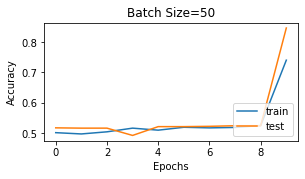

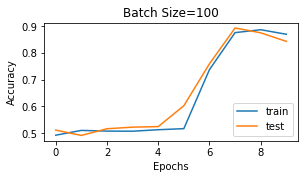

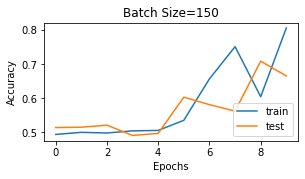

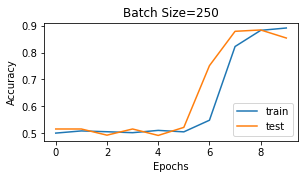

In [108]:
#Lets check Performance of our model using different Batch sizes and epochs
np.random.seed(4)
tf.random.set_seed(4)
from tensorflow.keras.layers import Embedding, LSTM, Dense, Dropout
from tensorflow.keras.models import Sequential
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.optimizers import Adam

def plot_model(train_abstract,train_labels,test_abstract,test_labels, batch_size,epochs):
    model = Sequential()
    model.add(Embedding(num_words_abstract,30,input_length=max_length_abstract))
    model.add(LSTM(64,dropout=0.1))
    model.add(Dense(1,activation='sigmoid'))
    optimizer = Adam(learning_rate=3e-4)
    model.compile(loss='binary_crossentropy',optimizer=optimizer,metrics=['accuracy'])
    history=model.fit(train_abstract,train_labels,validation_data=(test_abstract,test_labels),epochs=epochs, batch_size=batch_size)
    
    plt.plot(history.history['accuracy'], label='train')
    plt.plot(history.history['val_accuracy'], label='test')
    plt.title('Batch Size='+str(batch_size))
    plt.ylabel('Accuracy')
    plt.xlabel('Epochs')
    plt.legend(['train', 'test'], loc='lower right')
 
b_sizes = [50, 100, 150, 250]
epochs=10
for i in range(len(b_sizes)):
    plt.figure(figsize=(10, 10))
    plt.subplot(420 + (i+1))
    plot_model(train_abstract,train_labels,test_abstract,test_labels, b_sizes[i],epochs)
plt.show()

Epoch 1/5
180/180 [==============================] - 10s 40ms/step - loss: 0.6892 - accuracy: 0.5147 - val_loss: 0.2164 - val_accuracy: 0.9410
Epoch 2/5
180/180 [==============================] - 7s 37ms/step - loss: 0.2919 - accuracy: 0.9048 - val_loss: 0.2702 - val_accuracy: 0.9240
Epoch 3/5
180/180 [==============================] - 7s 38ms/step - loss: 0.3075 - accuracy: 0.9022 - val_loss: 0.5319 - val_accuracy: 0.7140
Epoch 4/5
180/180 [==============================] - 7s 36ms/step - loss: 0.5609 - accuracy: 0.6875 - val_loss: 0.6260 - val_accuracy: 0.5960
Epoch 5/5
180/180 [==============================] - 7s 38ms/step - loss: 0.5999 - accuracy: 0.6344 - val_loss: 0.6093 - val_accuracy: 0.6280
Epoch 1/5
90/90 [==============================] - 9s 75ms/step - loss: 0.6933 - accuracy: 0.5042 - val_loss: 0.6925 - val_accuracy: 0.5270
Epoch 2/5
90/90 [==============================] - 6s 67ms/step - loss: 0.5806 - accuracy: 0.6571 - val_loss: 0.2722 - val_accuracy: 0.9200
Epoch 3/5

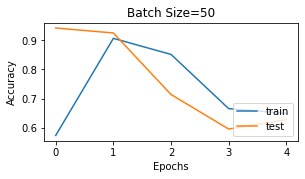

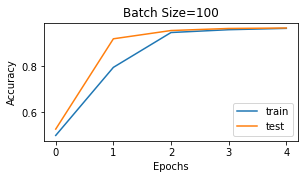

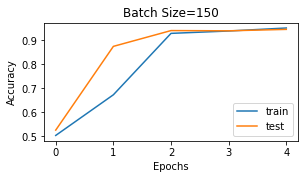

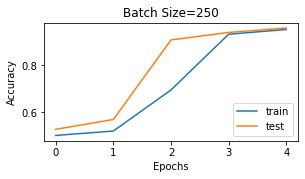

In [92]:
b_sizes = [50, 100, 150, 250]
epochs=5
for i in range(len(b_sizes)):
    plt.figure(figsize=(10, 10))
    plt.subplot(420 + (i+1))
    plot_model(train_abstract,train_labels,test_abstract,test_labels, b_sizes[i],epochs)
plt.show()

## We have Tested and Evaluated the Model, Now we Shall Use it to Make Predictions using Test Dataset and We shall Separate Predicted COVID Papers in CSV

In [96]:
#Convert Testing data
from tensorflow.keras.preprocessing.text import Tokenizer

num_words_abstract = len(acr)
max_length_abstract= 200

tokenizer_abstract = Tokenizer(num_words=num_words_abstract)
tokenizer_abstract.fit_on_texts(dft1['Abstract'])
testing_abstract_sequence= tokenizer_abstract.texts_to_sequences(dft1['Abstract'])

In [97]:
from keras.preprocessing.sequence import pad_sequences
testing_abstract_padded= pad_sequences(testing_abstract_sequence, maxlen=max_length_abstract, padding='post', truncating='post')

In [98]:
testing_abstract_padded[0]

array([ 2195,  1606, 27203,    46, 24519,   211, 17901, 11392,  1757,
       14858,  3883, 24520,  2202,   428, 12490,  5695,  1280,     4,
         233,  6532,   401,  1975, 24519,   211, 17901, 11392, 19756,
         864,  5104,   401,    74,   987,  2141, 27203,   757,   309,
         775,     8,  2431, 17901, 11392,   309,  9886,  2270,  3280,
       17901, 11392,  5646,  3280, 17901, 11392,  5646,  3280, 17901,
       11392,   728, 24519,   211,  7044, 24519,   211,   839,    84,
           4,   152,  2562, 17901, 11392,  2431,    38,   227,    60,
         757,   203,  9886,   157,  9886,  9886,   152,     4,  9886,
        1345,   768,    54,   149,   884,  9886,   157,  9886,  9886,
         173,    63,   757,    60,    63,   152,     4,   113,   166,
         215, 24519,   401,  2116,   166, 17901, 11392,   401,   749,
         350,   376,  5695,  4263, 17901,  1517,  3181,  8615, 17901,
       10540,   184,   771,  1115,    41,     0,     0,     0,     0,
           0,     0,

In [55]:
from keras.models import load_model
model_abst = load_model('abstract_model.h5')
p_labels = model_abst.predict_classes(testing_abstract_padded)
print("Predicted Label: ",p_labels)

Predicted Label:  [[1]
 [0]
 [1]
 ...
 [0]
 [0]
 [0]]


In [56]:
p_labels=p_labels.ravel()
p_labels=p_labels.tolist()
csvdf = pd.DataFrame(list(zip(dft1.ID,dft1.Title,dft1.Authors,dft1.Journal,dft1.Database,dft1.Type,dft1.Language,dft1['Publication Country'],dft1.Publication_time,dft1.Abstract, p_labels)),columns =['ID ','Title','Authors','Journal','Database','Type','Language','Publication Country','Publication_time','Abstract','Predicted Label'])
csvdf.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication year,Publication Country,Abstract,Entry Date,Predicted Label
0,covidwho-1273763,salud mental en la poblacin peruana durante la covid,"Llamocuro-Mamani, Paola; Medrano-Espinoza, Frida; Montealegre-Soto, David",Cir Cir,MEDLINE,article,en,2021,MX,la salud mental en respuesta la pandemia de covid un tema importante en este artculo se hace una comparacin en la poblacin peruana dando conocer diversos estudios agregando los factores asociados su desarrollo mental health response covid pandemic important subject article make comparison peruvian population releasing many study adding factor associated development,20210622,1
1,covidwho-1273761,risk condition healthcare worker pediatric coronavirus disease center mexico city,"Márquez-González, Horacio; Klünder-Klünder, Miguel; de la Rosa-Zamboni, Daniela; Ortega-Riosvelasco, Fernando; López-Martínez, Briceida; Jean-Tron, Guadalupe; Chapa-Koloffon, Gina; Ávila-Hernández, A Viridiana; Garduño-Espinosa, Juan; Villa-Guillén, Mónica; Nieto-Zermeño, Jaime",Bol Med Hosp Infant Mex,MEDLINE,article,en,2021,MX,background new evere acute respiratory syndrome coronavirus sars cov characterized high capacity transmit health care personnel highly susceptible becoming infected study aimed determine characteristic known risk factor contagion severe outcome sars cov disease health care personnel pediatric coronavirus disease covid center mexico city method last week march beginning phase ministry health national campaign mexico study conducted healthcare worker pediatric covid hospital mexico city using virtual interview evaluated comorbidities mobility area function carry activity protection measure contact history vaccination according activity healthcare worker classified following area medical nursing health care personnel researcher nutritionist rehabilitation imaging laboratory administrative service compared variable group healthcare worker test result included participant mean age year overweight obese year old high blood pressure medical nursing personnel presented higher proportion use standard protection measure conclusion among healthcare worker risk condition development complication case sars cov infection medical nursing personnel use standard protective measure,20210622,0
2,covidwho-1273752,revelaciones de la pandemia de covid,"Viniegra-Velázquez, Leonardo",Bol Med Hosp Infant Mex,MEDLINE,article,en,2021,MX,quot society unveil entrails crisis hide conceal normal situation quot premise essay offer propositional critique foundation civilization characterizing revelation covid pandemic seriously compromise globalized world especially neoliberal myth way human progress technological development essence social progress main reason scientific research among significant revelation dismantling welfare state public health service render population vulnerability face pandemic planetary devastation favor emergence correlation despondency human activity fleeting improvement planetary life denotes radical incompatibility permanence neoliberal capitalism degrades everything preservation care life infinite diversity including human life another notion human progress proposed rise value involved coexistence spiritual intellectual moral growth human condition harmony planetary ecosystem regarding deep reason catastrophe argued humanity way thinking acting living together relating planet therefore conclusion reached urgent need undertake alternative path search another possible world hospitable dignifying form life,20210622,1
3,covidwho-1273728,behavioral factor risk viral infection essential aspect covid pandemic,"Rychter, Anna M; Zawada, Agnieszka; Szymczak-Tomczak, Aleksandra; Ratajczak, Alicja E; Dobrowolska, Agnieszka; Krela-Kazmierczak, Iwona",Pol Arch Intern Med,MEDLINE,article,en,2021,PL,current covid pandemic continues eleven month several nutritional behavioural aspect associated increased inflammatory state oxidative stress could negat

In [58]:
#Filter COVID papers
csvdf1 = csvdf[csvdf['Predicted Label'] == 1]
csvdf1.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication year,Publication Country,Abstract,Entry Date,Predicted Label
0,covidwho-1273763,salud mental en la poblacin peruana durante la covid,"Llamocuro-Mamani, Paola; Medrano-Espinoza, Frida; Montealegre-Soto, David",Cir Cir,MEDLINE,article,en,2021,MX,la salud mental en respuesta la pandemia de covid un tema importante en este artculo se hace una comparacin en la poblacin peruana dando conocer diversos estudios agregando los factores asociados su desarrollo mental health response covid pandemic important subject article make comparison peruvian population releasing many study adding factor associated development,20210622,1
2,covidwho-1273752,revelaciones de la pandemia de covid,"Viniegra-Velázquez, Leonardo",Bol Med Hosp Infant Mex,MEDLINE,article,en,2021,MX,quot society unveil entrails crisis hide conceal normal situation quot premise essay offer propositional critique foundation civilization characterizing revelation covid pandemic seriously compromise globalized world especially neoliberal myth way human progress technological development essence social progress main reason scientific research among significant revelation dismantling welfare state public health service render population vulnerability face pandemic planetary devastation favor emergence correlation despondency human activity fleeting improvement planetary life denotes radical incompatibility permanence neoliberal capitalism degrades everything preservation care life infinite diversity including human life another notion human progress proposed rise value involved coexistence spiritual intellectual moral growth human condition harmony planetary ecosystem regarding deep reason catastrophe argued humanity way thinking acting living together relating planet therefore conclusion reached urgent need undertake alternative path search another possible world hospitable dignifying form life,20210622,1
3,covidwho-1273728,behavioral factor risk viral infection essential aspect covid pandemic,"Rychter, Anna M; Zawada, Agnieszka; Szymczak-Tomczak, Aleksandra; Ratajczak, Alicja E; Dobrowolska, Agnieszka; Krela-Kazmierczak, Iwona",Pol Arch Intern Med,MEDLINE,article,en,2021,PL,current covid pandemic continues eleven month several nutritional behavioural aspect associated increased inflammatory state oxidative stress could negatively affect course covid research shown metabolic disease including obesity type diabetes mellitus tdm proper diet especially important increase risk covid infection exacerbate course taken account particularly area high prevalence obesity tdm western country paper briefly summarised harmful beneficial nutritional behavioural aspect essential covid pandemic present particular among patient suffering obesity tdm,20210622,1
5,covidwho-1273648,patient chronic venous insufficiency time covid risk thrombus formation suggestion conservative treatment patient based principle pathophysiology,"Krasinski, Zbigniew; Krasinska, Aleksandra; Markiewicz, Szymon; Zielinski, Maciej",Pol Przegl Chir,MEDLINE,article,en,2021,PL,current limitation surgical treatment well restriction professional sport activity related covid pandemic require seeking therapeutic solution vast population patient chronic venous insufficiency cvi chronic venous insufficiency understand principle pharmacotherapy disease author used data related epidemiology pathophysiology cvi provided latest data venoactive drug recommendation followed summarized literature based ebm article provide answer question deal patient varicose vein broadly chronic venous insufficiency pandemic,20210622,1
6,covidwho-1273622,mobilizing covid contact tracing workforce warp speed framework successful program implementation,"Celentano, Jessica; Sachdev, Darpun; Hirose, Mivic; Ernst, Alexandra; Reid, Michael",Am. j. trop. med. hyg,MEDLINE,article,en,2021,US,effectively control spread covid essential jurisdiction capacity rapidly contact trace close contact every case des

In [60]:
#Save Predicted data in csv
csvdf1.to_csv('Predicted_Data.csv',index=False)

## Build Machine Learning Models

### Support vector Classifier

In [42]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
svc_classifier = SVC()
svc_classifier.fit(train_abstract,train_labels)
pred_labels_svc = svc_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_svc)*100,"%")
accuracy = f1_score(test_labels, pred_labels_svc)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_svc))
print("average precision score:",average_precision_score(test_labels, pred_labels_svc))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_svc))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_svc, target_names=target_names))

Accuracy score:  59.199999999999996 %
f1 Score: 0.6172607879924954
hamming loss: 0.408
average precision score: 0.5453914814486851
balanced_accuracy_score: 0.5933802552026857

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.62      0.52      0.56       509
class 1     (Covid)       0.57      0.67      0.62       491

           accuracy                           0.59      1000
          macro avg       0.60      0.59      0.59      1000
       weighted avg       0.60      0.59      0.59      1000



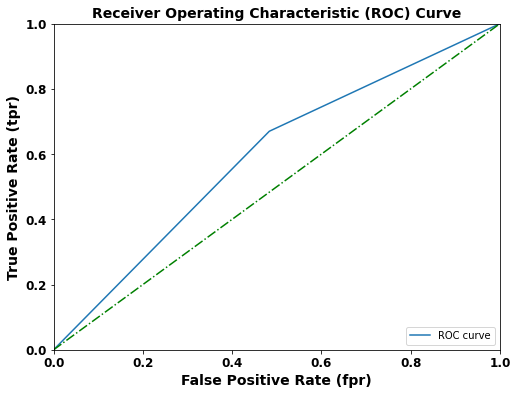

In [73]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_svc)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### Logistic Regression

In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
lr_classifier = LogisticRegression()
lr_classifier.fit(train_abstract,train_labels)
pred_labels_lr = lr_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_lr)*100,"%")
accuracy = f1_score(test_labels, pred_labels_lr)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_lr))
print("average precision score:",average_precision_score(test_labels, pred_labels_lr))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_lr))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_lr, target_names=target_names))

Accuracy score:  55.2 %
f1 Score: 0.5254237288135593
hamming loss: 0.448
average precision score: 0.5195181658371661
balanced_accuracy_score: 0.5511705792676828

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.56      0.60      0.58       509
class 1     (Covid)       0.55      0.51      0.53       491

           accuracy                           0.55      1000
          macro avg       0.55      0.55      0.55      1000
       weighted avg       0.55      0.55      0.55      1000



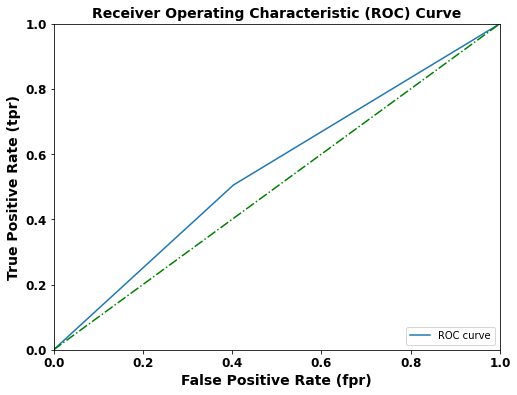

In [75]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_lr)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### AdaBoost Classifier

In [54]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
adb_classifier = AdaBoostClassifier(n_estimators=2500,learning_rate=0.9)
adb_classifier.fit(train_abstract,train_labels)
pred_labels_adb = adb_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_adb)*100,"%")
accuracy = f1_score(test_labels, pred_labels_adb)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_adb))
print("average precision score:",average_precision_score(test_labels, pred_labels_adb))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_adb))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_adb, target_names=target_names))

Accuracy score:  81.69999999999999 %
f1 Score: 0.8055260361317746
hamming loss: 0.183
average precision score: 0.7621063589047296
balanced_accuracy_score: 0.8162024495936684

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.80      0.86      0.83       509
class 1     (Covid)       0.84      0.77      0.81       491

           accuracy                           0.82      1000
          macro avg       0.82      0.82      0.82      1000
       weighted avg       0.82      0.82      0.82      1000



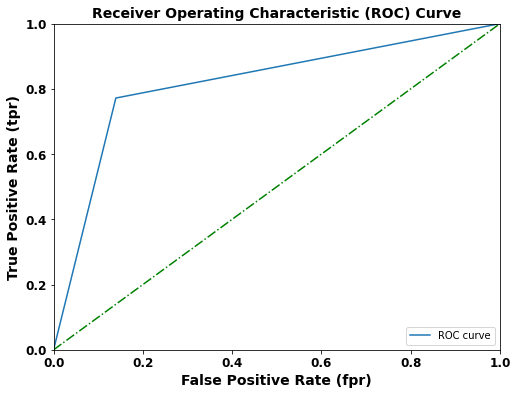

In [78]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_adb)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### XGBoost Classifier

In [55]:
from xgboost import XGBClassifier
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
xgb_classifier = XGBClassifier()
xgb_classifier.fit(train_abstract,train_labels)
pred_labels_xgb = xgb_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_xgb)*100,"%")
accuracy = f1_score(test_labels, pred_labels_xgb)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_xgb))
print("average precision score:",average_precision_score(test_labels, pred_labels_xgb))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_xgb))

target_names = ['class 0 (Non-Covid)', 'class 1 (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_xgb, target_names=target_names))

#save the model
import pickle
pickle.dump(xgb_classifier, open('xgb_model.sav', 'wb'))

[13:53:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy score:  88.0 %
f1 Score: 0.8660714285714285
hamming loss: 0.12
average precision score: 0.8600541349224309
balanced_accuracy_score: 0.8784126056842416

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.83      0.97      0.89       509
    class 1 (Covid)       0.96      0.79      0.87       491

           accuracy                           0.88      1000
          macro avg       0.89      0.88      0.88      1000
       weighted avg       0.89      0.88      0.88      1000



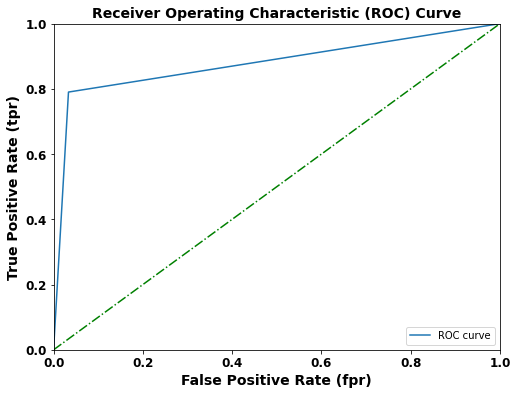

In [80]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_xgb)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### K – Nearest Neighbor Classifier

In [56]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
knn_classifier = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
knn_classifier.fit(train_abstract,train_labels)
pred_labels_knn = knn_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_knn)*100,"%")
accuracy = f1_score(test_labels, pred_labels_knn)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_knn))
print("average precision score:",average_precision_score(test_labels, pred_labels_knn))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_knn))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_knn, target_names=target_names))

Accuracy score:  53.5 %
f1 Score: 0.5633802816901409
hamming loss: 0.465
average precision score: 0.5103369146376946
balanced_accuracy_score: 0.5363437753832242

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.55      0.46      0.50       509
class 1     (Covid)       0.52      0.61      0.56       491

           accuracy                           0.54      1000
          macro avg       0.54      0.54      0.53      1000
       weighted avg       0.54      0.54      0.53      1000



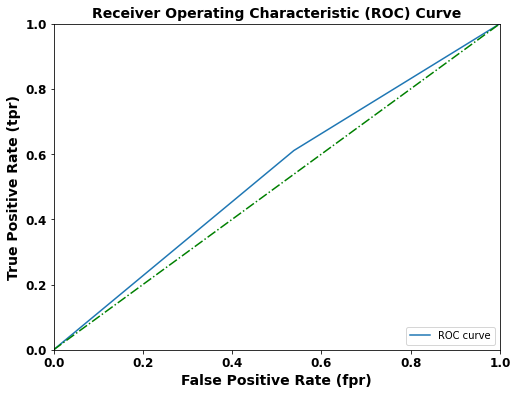

In [82]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_knn)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### Naive Bayes Classifier

In [57]:
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
nb_classifier = GaussianNB()
nb_classifier.fit(train_abstract,train_labels)
pred_labels_nb = nb_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_nb)*100,"%")
accuracy = f1_score(test_labels, pred_labels_nb)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_nb))
print("average precision score:",average_precision_score(test_labels, pred_labels_nb))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_nb))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_nb, target_names=target_names))

Accuracy score:  50.9 %
f1 Score: 0.14608695652173911
hamming loss: 0.491
average precision score: 0.4917698574338085
balanced_accuracy_score: 0.5015124900467751

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.51      0.92      0.66       509
class 1     (Covid)       0.50      0.09      0.15       491

           accuracy                           0.51      1000
          macro avg       0.50      0.50      0.40      1000
       weighted avg       0.51      0.51      0.41      1000



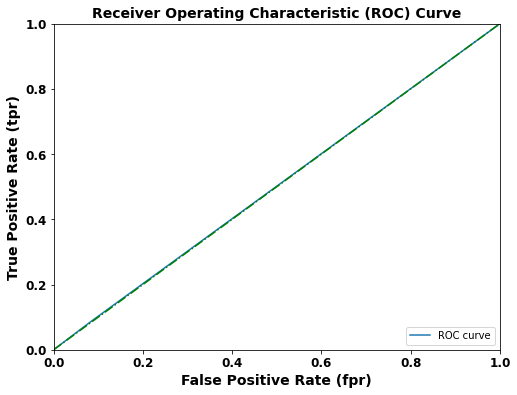

In [84]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_nb)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### Decision Tree Classifier

In [58]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report
dt_classifier = DecisionTreeClassifier(criterion = 'entropy', random_state = 1)
dt_classifier.fit(train_abstract,train_labels)
pred_labels_dt = dt_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_dt)*100,"%")
accuracy = f1_score(test_labels, pred_labels_dt)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_dt))
print("average precision score:",average_precision_score(test_labels, pred_labels_dt))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_dt))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_dt, target_names=target_names))

Accuracy score:  81.3 %
f1 Score: 0.8109201213346815
hamming loss: 0.187
average precision score: 0.7476243875706492
balanced_accuracy_score: 0.8130654332003568

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.82      0.81      0.82       509
class 1     (Covid)       0.81      0.82      0.81       491

           accuracy                           0.81      1000
          macro avg       0.81      0.81      0.81      1000
       weighted avg       0.81      0.81      0.81      1000



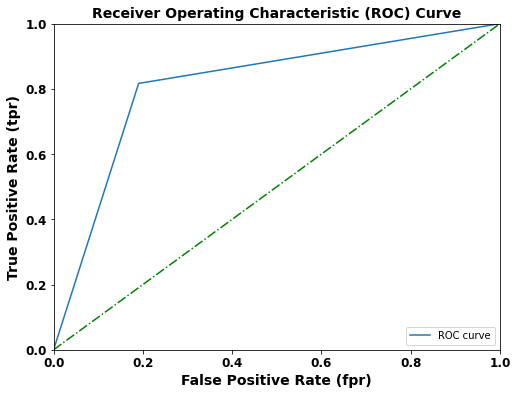

In [87]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_dt)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

### Random Forest Classifier

In [59]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import hamming_loss
from sklearn.metrics import average_precision_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import classification_report

rf_classifier = RandomForestClassifier(n_estimators = 25, criterion = 'entropy', random_state = 1)
rf_classifier.fit(train_abstract,train_labels)
pred_labels_rfc = rf_classifier.predict(test_abstract)
print ("Accuracy score: ",accuracy_score(test_labels, pred_labels_rfc)*100,"%")
accuracy = f1_score(test_labels, pred_labels_rfc)
print("f1 Score:",accuracy)
print("hamming loss:",hamming_loss(test_labels, pred_labels_rfc))
print("average precision score:",average_precision_score(test_labels, pred_labels_rfc))
print("balanced_accuracy_score:",balanced_accuracy_score(test_labels, pred_labels_rfc))

target_names = ['class 0 (Non-Covid)', 'class 1     (Covid)']
print("\nClassification Report:")
print(classification_report(test_labels, pred_labels_rfc, target_names=target_names))

Accuracy score:  85.6 %
f1 Score: 0.8464818763326226
hamming loss: 0.144
average precision score: 0.8121116927969673
balanced_accuracy_score: 0.8551610721873887

Classification Report:
                     precision    recall  f1-score   support

class 0 (Non-Covid)       0.83      0.90      0.86       509
class 1     (Covid)       0.89      0.81      0.85       491

           accuracy                           0.86      1000
          macro avg       0.86      0.86      0.86      1000
       weighted avg       0.86      0.86      0.86      1000



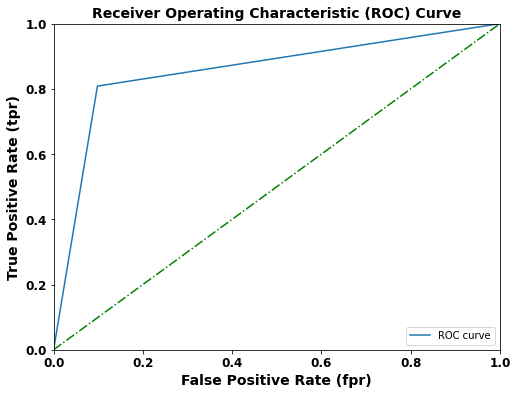

In [89]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))
fpr, tpr, _= roc_curve(test_labels, pred_labels_rfc)
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.title('Receiver Operating Characteristic (ROC) Curve',weight='bold',fontsize=14)
plt.legend(loc="lower right")
plt.show()

## Comparision of Machine Learning Models

In [105]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

svca=accuracy_score(test_labels, pred_labels_svc)
svcp=precision_score(test_labels, pred_labels_svc)
svcr=recall_score(test_labels, pred_labels_svc)

lra=accuracy_score(test_labels, pred_labels_lr)
lrp=precision_score(test_labels, pred_labels_lr)
lrr=recall_score(test_labels, pred_labels_lr)

adba=accuracy_score(test_labels, pred_labels_adb)
adbp=precision_score(test_labels, pred_labels_adb)
adbr=recall_score(test_labels, pred_labels_adb)

xgba=accuracy_score(test_labels, pred_labels_xgb)
xgbp=precision_score(test_labels, pred_labels_xgb)
xgbr=recall_score(test_labels, pred_labels_xgb)

knna=accuracy_score(test_labels, pred_labels_knn)
knnp=precision_score(test_labels, pred_labels_knn)
knnr=recall_score(test_labels, pred_labels_knn)

nba=accuracy_score(test_labels, pred_labels_nb)
nbp=precision_score(test_labels, pred_labels_nb)
nbr=recall_score(test_labels, pred_labels_nb)

dta=accuracy_score(test_labels, pred_labels_dt)
dtp=precision_score(test_labels, pred_labels_dt)
dtr=recall_score(test_labels, pred_labels_dt)

rfa=accuracy_score(test_labels, pred_labels_rfc)
rfp=precision_score(test_labels, pred_labels_rfc)
rfr=recall_score(test_labels, pred_labels_rfc)

dffff =pd.DataFrame([['Support Vec.', round(svca,2), round(svcp,2), round(svcr,2)],
                     ['Logistic Regr.', round(lra,2), round(lrp,2), round(lrr,2)],
                     ['AdaBoost', round(adba,2), round(adbp,2), round(adbr,2)],
                     ['XGBoost', round(xgba,2), round(xgbp,2), round(xgbr,2)],
                     ['K–N Neighbor', round(knna,2), round(knnp,2), round(knnr,2)],
                     ['Naive Bayes', round(nba,2), round(nbp,2), round(nbr,2)],
                     ['Decision Tree', round(dta,2), round(dtp,2), round(dtr,2)],
                     ['Random Forest', round(rfa,2), round(rfp,2), round(rfr,2)]],
                  columns=['Classifiers', 'Accuracy_score', 'Precision_Score', 'Recall_Score'])
dffff

,Classifiers,Accuracy_score,Precision_Score,Recall_Score
0,Support Vec.,0.59,0.57,0.67
1,Logistic Regr.,0.55,0.55,0.51
2,AdaBoost,0.82,0.84,0.77
3,XGBoost,0.88,0.96,0.79
4,K–N Neighbor,0.54,0.52,0.61
5,Naive Bayes,0.51,0.50,0.09
6,Decision Tree,0.81,0.81,0.82
7,Random Forest,0.86,0.89,0.81


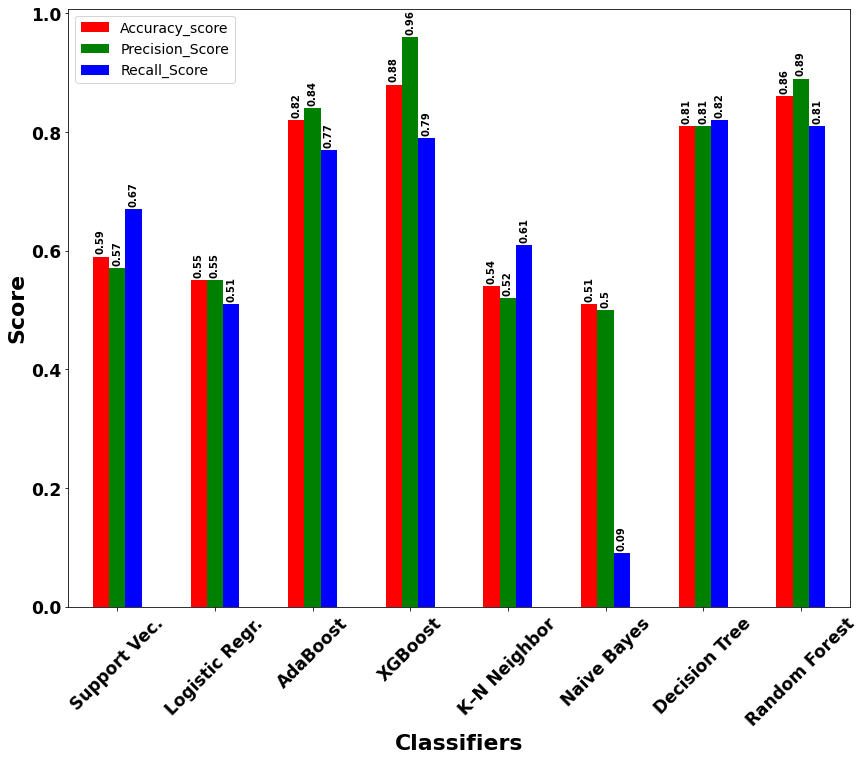

In [112]:
ax=dffff.plot(x='Classifiers',kind='bar',stacked=False,figsize=(14, 11),color='rgb')
plt.xlabel('Classifiers', fontsize=22,weight = 'bold')
plt.ylabel('Score', fontsize=22,weight = 'bold')
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.legend(loc='upper left',fontsize=14)
for p in ax.patches:
    h = p.get_height()
    x = p.get_x()+p.get_width()/2.
    if h != 0:
        ax.annotate("%g" % p.get_height(), xy=(x,h), xytext=(0,5), textcoords="offset points", ha="center",weight='bold',fontsize=10,rotation=90)
print()

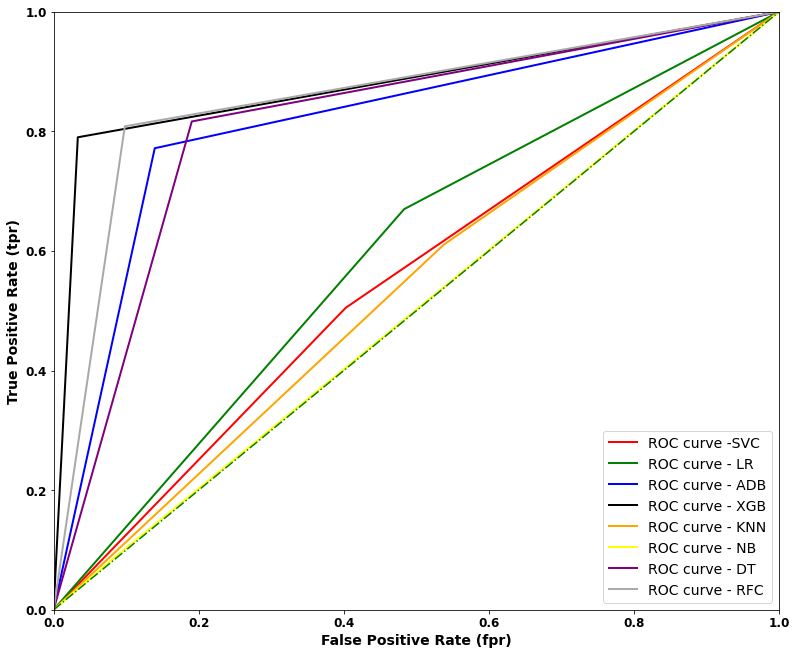

In [99]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(13,11))
fpr, tpr, _= roc_curve(test_labels, pred_labels_lr)
fpr1, tpr1, _= roc_curve(test_labels, pred_labels_svc)
fpr2, tpr2, _= roc_curve(test_labels, pred_labels_adb)
fpr3, tpr3, _= roc_curve(test_labels, pred_labels_xgb)
fpr4, tpr4, _= roc_curve(test_labels, pred_labels_knn)
fpr5, tpr5, _= roc_curve(test_labels, pred_labels_nb)
fpr6, tpr6, _= roc_curve(test_labels, pred_labels_dt)
fpr7, tpr7, _= roc_curve(test_labels, pred_labels_rfc)
plt.plot(fpr, tpr, label='ROC curve -SVC',color='r',linewidth=2)
plt.plot(fpr1, tpr1, label='ROC curve - LR',color='g',linewidth=2)
plt.plot(fpr2, tpr2, label='ROC curve - ADB',color='b',linewidth=2)
plt.plot(fpr3, tpr3, label='ROC curve - XGB',color='black',linewidth=2)
plt.plot(fpr4, tpr4, label='ROC curve - KNN',color='orange',linewidth=2)
plt.plot(fpr5, tpr5, label='ROC curve - NB',color='yellow',linewidth=2)
plt.plot(fpr6, tpr6, label='ROC curve - DT',color='purple',linewidth=2)
plt.plot(fpr7, tpr7, label='ROC curve - RFC',color='darkgrey',linewidth=2)
plt.plot([0, 1], [0, 1], 'g-.')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.xlabel('False Positive Rate (fpr)',weight='bold',fontsize=14)
plt.ylabel('True Positive Rate (tpr)',weight='bold',fontsize=14)
plt.xticks(weight='bold',fontsize=12)
plt.yticks(weight='bold',fontsize=12)
plt.legend(loc="lower right",fontsize=14)
plt.show()

#### We found that XGBoost Classifer is more accurate then others so we shall evaluate it.

## Model Evaluation: XGBoost Classifier

### Confusion Matrix

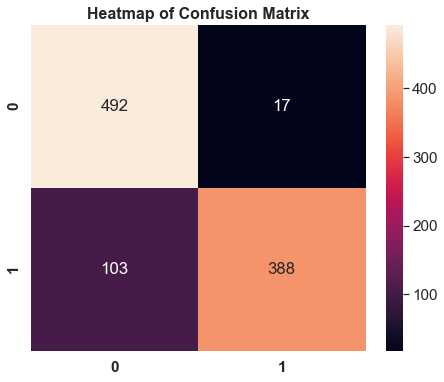

In [176]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(test_labels, pred_labels_xgb)
plt.figure(figsize=(7.5,6))
plt.title('Heatmap of Confusion Matrix', fontsize = 16,weight='bold')
plt.xticks(weight='bold')
plt.yticks(weight='bold')
sns.set(font_scale=1.4)
sns.heatmap(cm, annot = True,fmt='g')
plt.show()

In [80]:
tn, fp, fn, tp= confusion_matrix(test_labels, pred_labels_xgb).ravel()
print(cm)
print("\ntn: ",tn,"\nfp:", fp,"\nfn:", fn,"\ntp:", tp)

[[492  17]
 [103 388]]

tn:  492 
fp: 17 
fn: 103 
tp: 388


## We have Tested and Evaluated the Model, Now we Shall Use it to Make Predictions using Test Dataset and We shall Separate Predicted COVID Papers in CSV

In [99]:
#load the saved model
import joblib
xgb_loaded = joblib.load('xgb_model.sav')

In [103]:
#Predict
pred_label = xgb_loaded.predict(testing_abstract_padded)

In [104]:
pred_label1=pred_label.ravel()
pred_label1=pred_label1.tolist()
csvdfadb = pd.DataFrame(list(zip(dft1.ID,dft1.Title,dft1.Authors,dft1.Journal,dft1.Database,dft1.Type,dft1.Language,dft1['Publication Country'],dft1.Publication_time,dft1.Abstract, pred_label1)),columns =['ID ','Title','Authors','Journal','Database','Type','Language','Publication Country','Publication_time','Abstract','Predicted Label'])
csvdfadb.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label
0,covidwho-1343226,anthropometric evaluation scapula emphasis coracoid process glenoid fossa south african population,"Khan, R; Satyapal, K S; Lazarus, L; Naidoo, N",Heliyon,MEDLINE,article,en,GB,Jan-20,exact dimension scapula including coracoid process glenoid fossa fundamental patho mechanic glenohumeral joint structure initiator shoulder movement study evaluate anthropometric parameter emphasis coracoid process glenoid fossa morphometric linear morphological parameter total hundred sixty scapula right female recorded result shape glenoid fossa female notch vertical diameter glenoid fossa horizontal diameter glenoid fossa horizontal diameter glenoid fossa length coracoid process width coracoid process coracoglenoid distance present study observed predominant glenoid fossa shape higher incidence individual right although notch without notch notch observed study notch prevalent presenting significant value suggesting notch without notch notch common finding right individual finding observed study provide knowledge regarding coracoid parameter etiology subcoracoid impingement knowledge glenoid fossa parameter variation essential evaluation shoulder arthroplasty glenoid fracture anterior dislocation glenoid prosthesis design south african population,0
1,covidwho-1335914,pneumonia unknown aetiology wuhan china potential international spread commercial travel,"Bogoch, Isaac I; Watts, Alexander; Thomas-Bachli, Andrea; Huber, Carmen; Kraemer, Moritz U G; Khan, Kamran",J. travel med,MEDLINE,article,en,GB,Jan-20,currently outbreak pneumonia unknown aetiology wuhan china although still several unanswered question infection evaluate potential international dissemination disease commercial travel outbreak continue,0
2,covidwho-1291550,ospemifene novel therapy vulvovaginal atrophy menopause,"Reid, Robert L; Black, Denise; Derzko, Christine; Portman, David",J Obstet Gynaecol Can,MEDLINE,article,en,NL,Jan-20,vulvovaginal atrophy resulting estrogen deprivation menopause often result distressing vaginal dryness dyspareunia fewer affected woman condition citing embarrassment cultural value aging unavailable partner concern estrogen following woman health initiative available hormonal treatment moisturizers affording relief messy apply prevent disease progression selective estrogen receptor modulator ospemifene found strong estrogenic activity vaginal tissue without adverse estrogenic effect,0
3,covidwho-1217360,potential large first generation human human transmission,"Li, Xingguang; Zai, Junjie; Wang, Xiaomei; Li, Yi",J Med Virol,MEDLINE,article,en,US,Jan-20,investigate genetic diversity origin evolutionary history outbreak china thailand total genome sequence virus known sampling december january geographic location primarily wuhan hubei province china bangkok thailand analyzed phylogenetic likelihood mapping analysis genome sequence performed basis result signal topology indicative potentially large first generation human human virus transmission estimated likely originated wuhan november credible interval september december wuhan major spread outbreak china elsewhere result could useful designing effective prevention strategy china beyond,0
4,covidwho-1169480,genomic characterization novel human pathogenic coronavirus isolated patient atypical pneumonia visiting wuhan,"Chan, Jasper Fuk-Woo; Kok, Kin-Hang; Zhu, Zheng; Chu, Hin; To, Kelvin Kai-Wang; Yuan, Shuofeng; Yuen, Kwok-Yung",Emerg Microbes Infect,MEDLINE,article,en,US,Jan-20,mysterious outbreak atypical pneumonia traced seafood wholesale market wuhan china within novel coronavirus tentatively named novel coronavirus announced world health organization performed bioinformatics analysis virus genome patient infection compared related coronavirus genome overall genome nucleotide identity covzxc human phylogenetic spike envelope membrane nucleoprotein clustered closely civet huma

In [105]:
#Filter COVID papers
csvdf2 = csvdfadb[csvdfadb['Predicted Label'] == 1]
csvdf2.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label
5,covidwho-1127853,covid pandemic nursing patient hemodialysis treatment pandemia covid cuidados enfermagem pacientes tratamento hemodial pandemia covid cuidados enfermer pacientes sometidos hemodi,"Gama, Bernadete Marinho Bara De Martin; Cruz, Carla Mariana Alves da; FranÃ§a, Ludmilla Mursa de; Ferreira, Mariana Ramalho; Gomes, Sarah SimÃµes; Godinho, Marluce Rodrigues",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre cuidados enfermagem pacientes hemodi contexto pandemia covid trata estudo reflexivo realizado mediante documentos oficiais rg sade artigos cient ficos outras fontes conceituadas organizado seguintes eixos pandemia covid insuficincia renal tratamento hemodial cuidados enfermagem pacientes tratamento hemodial contexto covid resultado educa sade educa continuada supervis enfermagem ganharam destaque contexto pandemia garantiram orienta necess pacientes familiares equipe enfermagem preven controle covid consequentemente contribu prote sade pacientes insuficincia renal apresentavam sade comprometida poderiam deixar realizar hemodi considera finais implica contexto pandemia covid profissionais enfermagem precisam redobrar aten assistncia prestada pacientes tratamento hemodial adaptarem orienta espera reflex contribua cuidados enfermagem sejam seguros poss tanto pacientes familiares quanto profissionais enfermagem,1
6,covidwho-1127851,dimension human nursing pandemic context covid dimenses humano cuidado enfermagem contexto pandmico covid dimensiones cuidado humano enfermer contexto pand covid,"Paula, Paulo Henrique Alexandre de; Pinheiro, Patricia Neyva da Costa; MondragÃ³n-SÃ¡nchez, Edna Johana; Costa, Maria Isabelly Fernandes da; Rodrigues, Icleia Parente; Dourado, JoÃ£o VÃ­ctor Lira",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre dimenses humano cuidado enfermagem contexto pandmico covid trata estudo reflexivo foram discutidas dimenses corprea somaticus humana vivens conhecer sapiens vontade volens linguagem loquens social socialis trabalho faber divertimento ludens cuidado enfermagem contexto pandmico covid resultados dimenses sendo influenciadas contexto pandmico coronav sendo necess interven enfermagem humanizadoras manejo teraputico transpessoal suporte corpo adoecimento garantia linguagem possibilite autocuidado apoio psicolgico atitude escuta aberta incentivo ticas jogos passar tempo todos relaxamento medita imagina guiada entre outras refletir sobre dimenses possibilidades sinalizar pontos intercess compreens realidade vivenciada homem conclus implica refletir sobre dimenses homem antropologia embasamento terico modelos cuidados nursing intervention classification geram possibilidades estabelecer cuidado stico contexto pandemia coronav,1
7,covidwho-1127850,safety health professional facing coronavirus brazil seguran profissionais sade enfrentamento coronav brasil seguridad profesionales salud enfrentamiento nuevo coronavirus brasil,"Santana, Neuranides; Costa, Greice Alves; Costa, Sabrina dos Santos Pinho; Pereira, Larissa VitÃ³ria; Silva, JÃ©ssica Vieira da; Sales, Ivana Patricia Perrelli Maia",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivos apresentar nmero profissionais sade acometidos covid brasil identificar algumas medidas controle redu vulnerabilidade repercusses sobre sade profissionais enfrentamento pandemia covid implementado estudo descritivo tendo fonte boletins epidemiolgicos center disease control prevention resultados estados brasileiros informam casos covid entre profissionais sade totalizando dentre capitais trazem informa algumas medidas recomendadas controle engenharia seguran administrativas ticas seguran trabalho equipamentos prote individual repercusses envolvem sade mental implica quicas transtornos psicolgicos psiqui tricos conclus implica pandemia desvelou forma inequ retrato condi trabalho desigu

In [106]:
csvdf2.shape

(65296, 11)

In [108]:
#Save Predicted data in csv
csvdf2.to_csv('Predicted_Data_xgb.csv',index=False)

# Let's do Some Topic Modelling using Latent Dirichlet Allocation (LDA)

In [2]:
dfu=pd.read_csv("Predicted_Data_xgb.csv")
dfu.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label
0,covidwho-1127853,covid pandemic nursing patient hemodialysis ...,"Gama, Bernadete Marinho Bara De Martin; Cruz, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre cuidados enfermagem ...,1
1,covidwho-1127851,dimension human nursing pandemic context covi...,"Paula, Paulo Henrique Alexandre de; Pinheiro, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre dimenses humano cuid...,1
2,covidwho-1127850,safety health professional facing coronavirus...,"Santana, Neuranides; Costa, Greice Alves; Cost...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivos apresentar nmero profissionais sad...,1
3,covidwho-992886,pandemic immigration haitian family facing cov...,"Souza, Jeane Barros de; Heidemann, Ivonete Ter...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo compreender vivncia enfrentamento re...,1
4,covidwho-824860,phylogenetics genomic recombination polymorph...,"Yu, Fang; Yan, Yi; Shi, Mang; Liu, Hai-Zhou; Z...",J. virol,MEDLINE,article,en,US,Jan-20,porcine reproductive respiratory syndrome viru...,1


## Exploratory Text Analysis

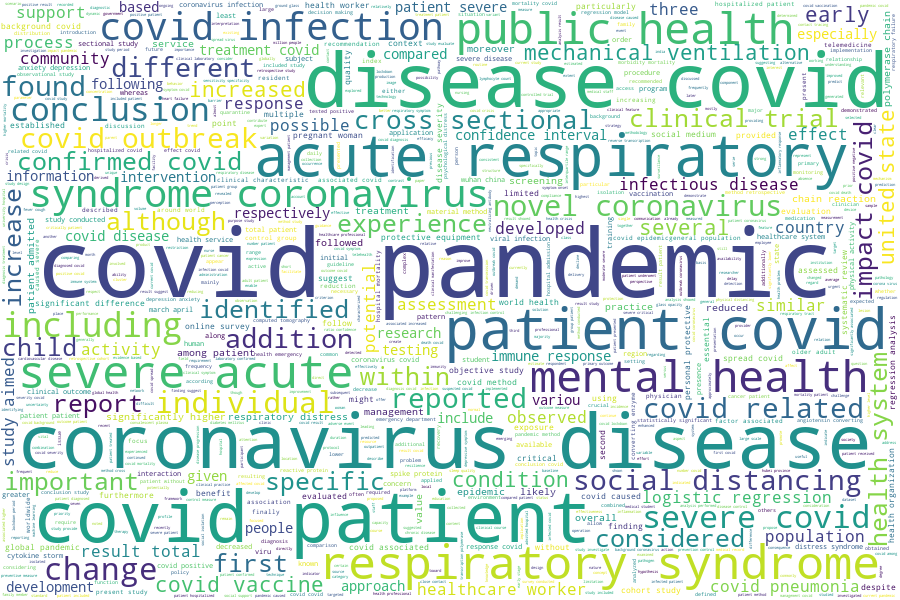

In [101]:
string=dfu['Abstract'].astype(str)
from wordcloud import WordCloud
text = ','.join(list(string.values))
wordcloud = WordCloud(background_color="white", width=900, height=600, max_words=10000, contour_width=0.5, contour_color='blue')
wordcloud.generate(text)
wordcloud.to_image()

In [102]:
#Most Common and repeated 10 Words
splited_text = text.split()
from collections import Counter
mcw=Counter(splited_text)
mcw.most_common(10)

[('covid', 221568),
 ('patient', 131611),
 ('pandemic', 64707),
 ('study', 59227),
 ('disease', 58242),
 ('health', 51813),
 ('result', 41908),
 ('infection', 38690),
 ('coronavirus', 36154),
 ('clinical', 31578)]

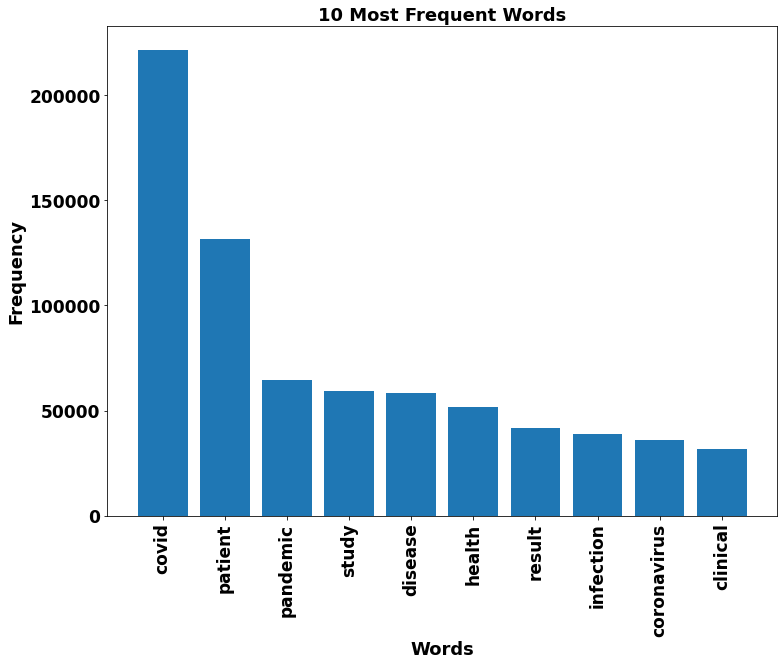

In [88]:
cw=mcw.most_common(10)
Dcw = dict(cw)
plt.figure(figsize=(12, 9))
plt.bar(range(len(Dcw)), list(Dcw.values()), align='center')
plt.xticks(range(len(Dcw)), list(Dcw.keys()),rotation=90,fontsize=17,weight='bold')
plt.yticks(fontsize=17,weight='bold')
plt.xlabel('Words', fontsize=18,weight='bold')
plt.ylabel('Frequency', fontsize=18,weight='bold')
plt.title('10 Most Frequent Words', fontsize=18,weight='bold')
plt.show()

## Data Preparation

In [3]:
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
%matplotlib inline
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [4]:
# tokenize the each sentences
def tokenize(sentences):
    for sen in sentences:
        yield(gensim.utils.simple_preprocess(str(sen)))
        
tokenized_words = list(tokenize(dfu.Abstract))

In [16]:
print(tokenized_words[:1])

[['objetivo', 'refletir', 'sobre', 'cuidados', 'enfermagem', 'pacientes', 'hemodi', 'contexto', 'pandemia', 'covid', 'trata', 'estudo', 'reflexivo', 'realizado', 'mediante', 'documentos', 'oficiais', 'rg', 'sade', 'artigos', 'cient', 'ficos', 'outras', 'fontes', 'conceituadas', 'organizado', 'seguintes', 'eixos', 'pandemia', 'covid', 'insuficincia', 'renal', 'tratamento', 'hemodial', 'cuidados', 'enfermagem', 'pacientes', 'tratamento', 'hemodial', 'contexto', 'covid', 'resultado', 'educa', 'sade', 'educa', 'continuada', 'supervis', 'enfermagem', 'ganharam', 'destaque', 'contexto', 'pandemia', 'garantiram', 'orienta', 'necess', 'pacientes', 'familiares', 'equipe', 'enfermagem', 'preven', 'controle', 'covid', 'contribu', 'prote', 'sade', 'pacientes', 'insuficincia', 'renal', 'apresentavam', 'sade', 'comprometida', 'poderiam', 'deixar', 'realizar', 'hemodi', 'considera', 'finais', 'implica', 'contexto', 'pandemia', 'covid', 'profissionais', 'enfermagem', 'precisam', 'redobrar', 'aten', 'a

In [69]:
#Create Dictionary from tokenized words
dic_word = corpora.Dictionary(tokenized_words)

# Create Corpus from tokenized words
# Mapping of (word_id, word_frequency)
corpus = [dic_word.doc2bow(text) for text in tokenized_words]

print(corpus[:1])

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 4), (10, 1), (11, 1), (12, 1), (13, 1), (14, 5), (15, 3), (16, 1), (17, 1), (18, 1), (19, 2), (20, 1), (21, 7), (22, 1), (23, 1), (24, 1), (25, 2), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 2), (32, 3), (33, 1), (34, 2), (35, 1), (36, 1), (37, 1), (38, 1), (39, 1), (40, 2), (41, 1), (42, 6), (43, 4), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 2), (50, 1), (51, 1), (52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 2), (59, 1), (60, 1), (61, 4), (62, 1), (63, 1), (64, 1), (65, 1), (66, 1), (67, 1), (68, 1), (69, 3)]]


In [66]:
# Lets Check ids of some words
for i in range(0,10):
    print(dic_word[i],":",i)

adaptarem : 0
apresentavam : 1
artigos : 2
assistncia : 3
aten : 4
cient : 5
comprometida : 6
conceituadas : 7
considera : 8
contexto : 9


In [83]:
#Total words in dictionary
len(dic_word)

62657

## Building the Topic Model

#### Before Building our Final Model We Need to Find out the Best Fit Parameters of Model.

In [127]:
def find_parameters(corpus, dic_word, tokenized_words):
    global coherence
    global perplexity
    coherence=[]
    perplexity=[]
    for num_topics in range(5,50,5):
        LDA_Test = gensim.models.LdaMulticore(corpus=corpus, id2word=dic_word, num_topics=num_topics,chunksize=500,passes=25,eval_every=1, random_state=1,minimum_probability=0)
        Prep=LDA_Test.log_perplexity(corpus)
        coherence_model_lda = CoherenceModel(model=LDA_Test, texts=tokenized_words, dictionary=dic_word, coherence='c_v')
        coherence_lda = coherence_model_lda.get_coherence()
        coherence.append(coherence_lda)
        perplexity.append(Prep)
        print("Topics:",num_topics, "Perplexity:", Prep, "Coherence:", coherence_lda)
        print()

In [128]:
find_parameters(corpus, dic_word, tokenized_words)

Topics: 5 Perplexity: -7.4577278987302895 Coherence: 0.4481071968596016

Topics: 10 Perplexity: -7.589260553889657 Coherence: 0.5108851921925488

Topics: 15 Perplexity: -7.833552540209244 Coherence: 0.5129703904911155

Topics: 20 Perplexity: -7.975027547573689 Coherence: 0.5260763137973504

Topics: 25 Perplexity: -8.12691358341893 Coherence: 0.5597349537069054

Topics: 30 Perplexity: -8.276164939037297 Coherence: 0.5527556618130353

Topics: 35 Perplexity: -8.44070714084159 Coherence: 0.5498535918383375

Topics: 40 Perplexity: -8.609472849119596 Coherence: 0.556788182395452

Topics: 45 Perplexity: -8.773250809833428 Coherence: 0.5509010419367739



<Figure size 1008x432 with 0 Axes>

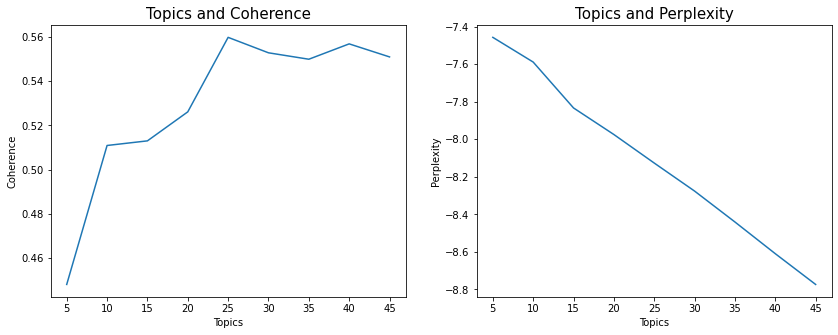

In [129]:
topics = range(5, 50, 5)
plt.figure(figsize=(14, 6))
fig, (p1, p2) = plt.subplots(1, 2,figsize=(14,5))
p1.set_title('Topics and Coherence',fontsize=15)
p2.set_title('Topics and Perplexity',fontsize=15)
p1.set_xlabel('Topics')
p1.set_ylabel('Coherence')
p2.set_xlabel('Topics')
p2.set_ylabel('Perplexity')
p2.plot(topics,perplexity)
p1.plot(topics,coherence)

#### Now, We have Best Parameters, so Lets Build our Final Model

In [108]:
LDA_Model = gensim.models.LdaMulticore(corpus=corpus, id2word=dic_word, num_topics=25,
                                       chunksize=500,passes=25,eval_every=1, random_state=1,
                                       minimum_probability=0)
# Perplexity
print('\nPerplexity: ', LDA_Model.log_perplexity(corpus))
# Coherence Score
coherence_model_lda = CoherenceModel(model=LDA_Model, texts=tokenized_words, dictionary=dic_word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -8.124097046613448

Coherence Score:  0.5610544399562541


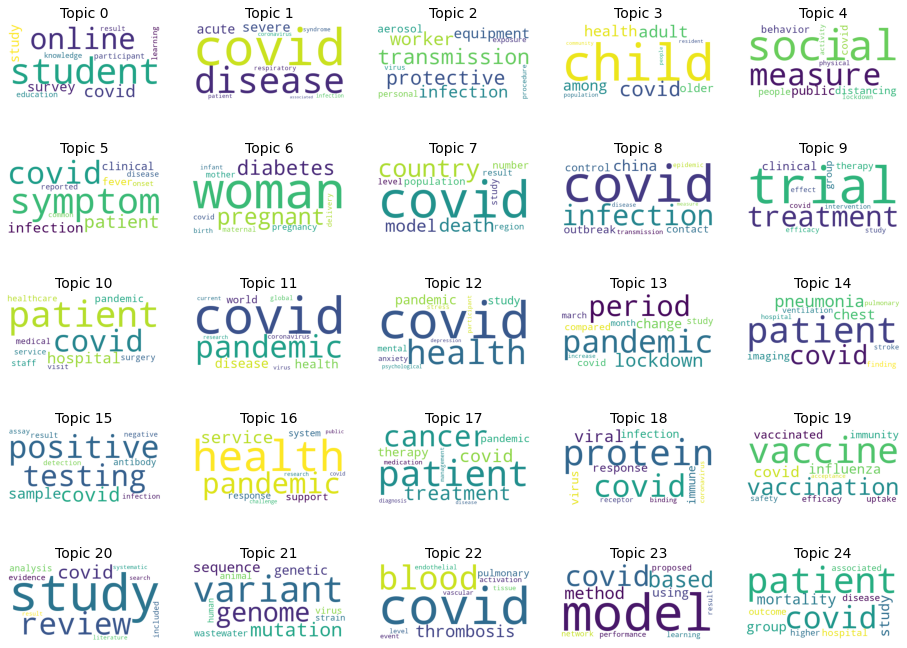

In [252]:
from wordcloud import WordCloud

cloud = WordCloud(background_color='white',max_words=10)

topics = LDA_Model.show_topics(formatted=False, num_topics=25)

fig, axes = plt.subplots(5, 5, figsize=(16,12), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    words = dict(topics[i][1])
    cloud.generate_from_frequencies(words, max_font_size=300)
    plt.imshow(cloud)
    plt.title('Topic ' + str(i), fontsize=14)
    plt.axis('off')
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [172]:
# Print topics
for i,topic in LDA_Model.show_topics(formatted=True, num_topics=25):
    print("Topic:", str(i)+": "+ topic)
    print()

Topic: 0: 0.035*"student" + 0.022*"online" + 0.019*"covid" + 0.019*"survey" + 0.018*"study" + 0.015*"participant" + 0.014*"education" + 0.014*"learning" + 0.013*"knowledge" + 0.012*"result"

Topic: 1: 0.058*"covid" + 0.041*"disease" + 0.033*"severe" + 0.032*"acute" + 0.031*"respiratory" + 0.028*"patient" + 0.027*"syndrome" + 0.025*"infection" + 0.024*"coronavirus" + 0.011*"associated"

Topic: 2: 0.020*"transmission" + 0.018*"protective" + 0.015*"worker" + 0.015*"infection" + 0.013*"equipment" + 0.012*"aerosol" + 0.012*"personal" + 0.011*"exposure" + 0.010*"virus" + 0.010*"procedure"

Topic: 3: 0.045*"child" + 0.042*"covid" + 0.025*"adult" + 0.021*"health" + 0.020*"among" + 0.017*"older" + 0.016*"population" + 0.013*"community" + 0.013*"resident" + 0.012*"people"

Topic: 4: 0.049*"social" + 0.023*"measure" + 0.018*"public" + 0.017*"distancing" + 0.016*"behavior" + 0.016*"covid" + 0.014*"people" + 0.014*"physical" + 0.013*"activity" + 0.012*"lockdown"

Topic: 5: 0.065*"symptom" + 0.054*"

In [16]:
for i,topic in LDA_Model.show_topics(formatted=True, num_topics=25, num_words=5):
    print("Topic:", str(i)+": "+ topic)
    print()

Topic: 0: 0.035*"student" + 0.022*"online" + 0.019*"covid" + 0.019*"survey" + 0.018*"study"

Topic: 1: 0.058*"covid" + 0.041*"disease" + 0.033*"severe" + 0.032*"acute" + 0.031*"respiratory"

Topic: 2: 0.020*"transmission" + 0.018*"protective" + 0.015*"infection" + 0.015*"worker" + 0.013*"equipment"

Topic: 3: 0.045*"child" + 0.042*"covid" + 0.025*"adult" + 0.020*"health" + 0.020*"among"

Topic: 4: 0.049*"social" + 0.023*"measure" + 0.018*"public" + 0.017*"distancing" + 0.016*"behavior"

Topic: 5: 0.064*"symptom" + 0.054*"covid" + 0.050*"patient" + 0.026*"infection" + 0.016*"clinical"

Topic: 6: 0.130*"woman" + 0.050*"pregnant" + 0.040*"diabetes" + 0.028*"pregnancy" + 0.026*"mother"

Topic: 7: 0.036*"covid" + 0.021*"country" + 0.018*"death" + 0.015*"model" + 0.014*"population"

Topic: 8: 0.036*"covid" + 0.031*"infection" + 0.029*"china" + 0.028*"outbreak" + 0.028*"control"

Topic: 9: 0.043*"trial" + 0.042*"treatment" + 0.032*"clinical" + 0.022*"group" + 0.019*"therapy"

Topic: 10: 0.049

In [17]:
# Print Probability of each topic for each document
count=0
for i in LDA_Model[corpus]:
    print("Document No: ", count,"Topic Wise Probability",i)
    print()
    count+=1

Document No:  0 Topic Wise Probability [(0, 0.00047094098), (1, 0.028871901), (2, 0.00047094098), (3, 0.00047094098), (4, 0.00047094098), (5, 0.00047094098), (6, 0.2599168), (7, 0.00047094098), (8, 0.03619092), (9, 0.00047094098), (10, 0.00047094098), (11, 0.00047094098), (12, 0.00047094098), (13, 0.00047094098), (14, 0.00047094098), (15, 0.00047094098), (16, 0.00047094098), (17, 0.00047094098), (18, 0.00047094098), (19, 0.00047094098), (20, 0.00047094098), (21, 0.6651306), (22, 0.00047094098), (23, 0.00047094098), (24, 0.00047094098)]

Document No:  1 Topic Wise Probability [(0, 0.0005582585), (1, 0.0005582585), (2, 0.0005582585), (3, 0.01576183), (4, 0.020712676), (5, 0.0005582585), (6, 0.0005582585), (7, 0.0005582585), (8, 0.0005582585), (9, 0.0005582585), (10, 0.0005582585), (11, 0.0005582585), (12, 0.0005582585), (13, 0.0005582585), (14, 0.0005582585), (15, 0.0005582585), (16, 0.0005582585), (17, 0.0005582585), (18, 0.0005582585), (19, 0.0005582585), (20, 0.0005582585), (21, 0.951

Document No:  75 Topic Wise Probability [(0, 0.0003008774), (1, 0.0003008774), (2, 0.0003008774), (3, 0.01424062), (4, 0.0003008774), (5, 0.15163004), (6, 0.0003008774), (7, 0.0003008774), (8, 0.30216074), (9, 0.0003008774), (10, 0.0003008774), (11, 0.0003008774), (12, 0.0003008774), (13, 0.0003008774), (14, 0.2809228), (15, 0.0003008774), (16, 0.0003008774), (17, 0.0003008774), (18, 0.0003008774), (19, 0.0003008774), (20, 0.0003008774), (21, 0.008401824), (22, 0.0003008774), (23, 0.0003008774), (24, 0.23692732)]

Document No:  76 Topic Wise Probability [(0, 0.00095271843), (1, 0.2707045), (2, 0.00095271843), (3, 0.00095271843), (4, 0.00095271843), (5, 0.00095271843), (6, 0.00095271843), (7, 0.00095271843), (8, 0.22843201), (9, 0.00095271843), (10, 0.00095271843), (11, 0.37412202), (12, 0.00095271843), (13, 0.00095271843), (14, 0.00095271843), (15, 0.00095271843), (16, 0.00095271843), (17, 0.00095271843), (18, 0.00095271843), (19, 0.00095271843), (20, 0.00095271843), (21, 0.10673438), 

Document No:  143 Topic Wise Probability [(0, 0.0007845341), (1, 0.086267695), (2, 0.0007845341), (3, 0.0007845341), (4, 0.0007845341), (5, 0.08928066), (6, 0.0007845341), (7, 0.0007845341), (8, 0.069946595), (9, 0.0007845341), (10, 0.0007845341), (11, 0.13333084), (12, 0.0007845341), (13, 0.0007845341), (14, 0.10555511), (15, 0.44496647), (16, 0.0007845341), (17, 0.0007845341), (18, 0.0007845341), (19, 0.016556261), (20, 0.0007845341), (21, 0.040759265), (22, 0.0007845341), (23, 0.0007845341), (24, 0.0007845341)]

Document No:  144 Topic Wise Probability [(0, 0.017716818), (1, 0.00037083204), (2, 0.00037083204), (3, 0.00037083204), (4, 0.00037083204), (5, 0.22553656), (6, 0.00037083204), (7, 0.00037083204), (8, 0.00037083204), (9, 0.24539389), (10, 0.00037083204), (11, 0.00037083204), (12, 0.00037083204), (13, 0.08155646), (14, 0.00037083204), (15, 0.25300306), (16, 0.00037083204), (17, 0.06232279), (18, 0.00037083204), (19, 0.00037083204), (20, 0.00037083204), (21, 0.00037083204), (2

Document No:  200 Topic Wise Probability [(0, 0.0007146678), (1, 0.06741272), (2, 0.0007146678), (3, 0.0007146678), (4, 0.0007146678), (5, 0.0007146678), (6, 0.0007146678), (7, 0.0007146678), (8, 0.12629071), (9, 0.0007146678), (10, 0.0007146678), (11, 0.11732142), (12, 0.0007146678), (13, 0.0007146678), (14, 0.57410514), (15, 0.0007146678), (16, 0.0007146678), (17, 0.0007146678), (18, 0.0007146678), (19, 0.0007146678), (20, 0.0007146678), (21, 0.0007146678), (22, 0.10057664), (23, 0.0007146678), (24, 0.0007146678)]

Document No:  201 Topic Wise Probability [(0, 0.018192217), (1, 0.00056396384), (2, 0.00056396384), (3, 0.016818782), (4, 0.00056396384), (5, 0.00056396384), (6, 0.00056396384), (7, 0.00056396384), (8, 0.24216045), (9, 0.00056396384), (10, 0.4675453), (11, 0.00056396384), (12, 0.00056396384), (13, 0.00056396384), (14, 0.00056396384), (15, 0.00056396384), (16, 0.048078254), (17, 0.12432187), (18, 0.00056396384), (19, 0.00056396384), (20, 0.07273175), (21, 0.00056396384), (2

Document No:  261 Topic Wise Probability [(0, 0.030509237), (1, 0.083447814), (2, 0.00037793166), (3, 0.00037793166), (4, 0.019076059), (5, 0.00037793166), (6, 0.00037793166), (7, 0.4457144), (8, 0.41369385), (9, 0.00037793166), (10, 0.00037793166), (11, 0.00037793166), (12, 0.00037793166), (13, 0.00037793166), (14, 0.00037793166), (15, 0.00037793166), (16, 0.00037793166), (17, 0.00037793166), (18, 0.00037793166), (19, 0.00037793166), (20, 0.00037793166), (21, 0.00037793166), (22, 0.00037793166), (23, 0.00037793166), (24, 0.00037793166)]

Document No:  262 Topic Wise Probability [(0, 0.000580237), (1, 0.08658463), (2, 0.000580237), (3, 0.000580237), (4, 0.000580237), (5, 0.000580237), (6, 0.000580237), (7, 0.000580237), (8, 0.10342513), (9, 0.000580237), (10, 0.56606525), (11, 0.15801302), (12, 0.000580237), (13, 0.000580237), (14, 0.07430724), (15, 0.000580237), (16, 0.000580237), (17, 0.000580237), (18, 0.000580237), (19, 0.000580237), (20, 0.000580237), (21, 0.000580237), (22, 0.000

Document No:  323 Topic Wise Probability [(0, 0.0002603399), (1, 0.0002603399), (2, 0.0002603399), (3, 0.0065502725), (4, 0.0002603399), (5, 0.0002603399), (6, 0.0002603399), (7, 0.0002603399), (8, 0.061078068), (9, 0.09646649), (10, 0.0002603399), (11, 0.0002603399), (12, 0.0002603399), (13, 0.0002603399), (14, 0.028990747), (15, 0.10389851), (16, 0.0002603399), (17, 0.035321083), (18, 0.44600025), (19, 0.031536527), (20, 0.0002603399), (21, 0.0002603399), (22, 0.15997818), (23, 0.026274761), (24, 0.0002603399)]

Document No:  324 Topic Wise Probability [(0, 0.0005979578), (1, 0.0005979578), (2, 0.0005979578), (3, 0.0005979578), (4, 0.0005979578), (5, 0.02061592), (6, 0.0005979578), (7, 0.0005979578), (8, 0.22578715), (9, 0.0005979578), (10, 0.2870379), (11, 0.436934), (12, 0.0005979578), (13, 0.0005979578), (14, 0.0005979578), (15, 0.0005979578), (16, 0.0005979578), (17, 0.0005979578), (18, 0.0005979578), (19, 0.0005979578), (20, 0.0005979578), (21, 0.0005979578), (22, 0.0005979578),

Document No:  377 Topic Wise Probability [(0, 0.0002212203), (1, 0.0002212203), (2, 0.0002212203), (3, 0.007722566), (4, 0.0002212203), (5, 0.0002212203), (6, 0.0002212203), (7, 0.37739605), (8, 0.18891479), (9, 0.0002212203), (10, 0.0002212203), (11, 0.032417394), (12, 0.0002212203), (13, 0.0002212203), (14, 0.0002212203), (15, 0.0002212203), (16, 0.3015167), (17, 0.0002212203), (18, 0.0002212203), (19, 0.0002212203), (20, 0.0002212203), (21, 0.0002212203), (22, 0.0002212203), (23, 0.08782929), (24, 0.0002212203)]

Document No:  378 Topic Wise Probability [(0, 0.0008006424), (1, 0.0008006424), (2, 0.0008006424), (3, 0.0008006424), (4, 0.0008006424), (5, 0.23306827), (6, 0.0008006424), (7, 0.0008006424), (8, 0.29336014), (9, 0.0008006424), (10, 0.0008006424), (11, 0.120231286), (12, 0.0008006424), (13, 0.0008006424), (14, 0.33652684), (15, 0.0008006424), (16, 0.0008006424), (17, 0.0008006424), (18, 0.0008006424), (19, 0.0008006424), (20, 0.0008006424), (21, 0.0008006424), (22, 0.000800

Document No:  447 Topic Wise Probability [(0, 0.031550437), (1, 0.00042625153), (2, 0.00042625153), (3, 0.00042625153), (4, 0.00042625153), (5, 0.00042625153), (6, 0.00042625153), (7, 0.00042625153), (8, 0.1330389), (9, 0.00042625153), (10, 0.054686245), (11, 0.00042625153), (12, 0.00042625153), (13, 0.00042625153), (14, 0.09201662), (15, 0.00042625153), (16, 0.00042625153), (17, 0.49272364), (18, 0.00042625153), (19, 0.00042625153), (20, 0.00042625153), (21, 0.00042625153), (22, 0.00042625153), (23, 0.00042625153), (24, 0.18788542)]

Document No:  448 Topic Wise Probability [(0, 0.00095298776), (1, 0.00095298776), (2, 0.00095298776), (3, 0.00095298776), (4, 0.00095298776), (5, 0.00095298776), (6, 0.00095298776), (7, 0.4350918), (8, 0.39747077), (9, 0.00095298776), (10, 0.00095298776), (11, 0.00095298776), (12, 0.00095298776), (13, 0.00095298776), (14, 0.00095298776), (15, 0.00095298776), (16, 0.00095298776), (17, 0.14647171), (18, 0.00095298776), (19, 0.00095298776), (20, 0.0009529877

Document No:  510 Topic Wise Probability [(0, 0.0003032294), (1, 0.100005575), (2, 0.0003032294), (3, 0.0003032294), (4, 0.0003032294), (5, 0.022386096), (6, 0.0003032294), (7, 0.0003032294), (8, 0.0003032294), (9, 0.0003032294), (10, 0.0003032294), (11, 0.0003032294), (12, 0.0003032294), (13, 0.0003032294), (14, 0.0003032294), (15, 0.0003032294), (16, 0.0003032294), (17, 0.0003032294), (18, 0.0003032294), (19, 0.0003032294), (20, 0.0003032294), (21, 0.0003032294), (22, 0.0003032294), (23, 0.0003032294), (24, 0.8709373)]

Document No:  511 Topic Wise Probability [(0, 0.00044957755), (1, 0.00044957755), (2, 0.00044957755), (3, 0.00044957755), (4, 0.00044957755), (5, 0.044088542), (6, 0.00044957755), (7, 0.06463601), (8, 0.35459593), (9, 0.00044957755), (10, 0.00044957755), (11, 0.24970731), (12, 0.00044957755), (13, 0.00044957755), (14, 0.00044957755), (15, 0.27798066), (16, 0.00044957755), (17, 0.00044957755), (18, 0.00044957755), (19, 0.00044957755), (20, 0.00044957755), (21, 0.000449

Document No:  583 Topic Wise Probability [(0, 0.00054077356), (1, 0.5620772), (2, 0.00054077356), (3, 0.00054077356), (4, 0.00054077356), (5, 0.00054077356), (6, 0.00054077356), (7, 0.00054077356), (8, 0.00054077356), (9, 0.00054077356), (10, 0.00054077356), (11, 0.00054077356), (12, 0.00054077356), (13, 0.00054077356), (14, 0.00054077356), (15, 0.016560743), (16, 0.00054077356), (17, 0.00054077356), (18, 0.40946501), (19, 0.00054077356), (20, 0.00054077356), (21, 0.00054077356), (22, 0.00054077356), (23, 0.00054077356), (24, 0.00054077356)]

Document No:  584 Topic Wise Probability [(0, 0.0006721215), (1, 0.0006721215), (2, 0.0006721215), (3, 0.0006721215), (4, 0.0006721215), (5, 0.0006721215), (6, 0.0006721215), (7, 0.24829355), (8, 0.0006721215), (9, 0.0006721215), (10, 0.0006721215), (11, 0.0006721215), (12, 0.0006721215), (13, 0.0006721215), (14, 0.0006721215), (15, 0.0006721215), (16, 0.026290022), (17, 0.0006721215), (18, 0.0006721215), (19, 0.0006721215), (20, 0.0006721215), (2

Document No:  647 Topic Wise Probability [(0, 0.00033351313), (1, 0.00033351313), (2, 0.00033351313), (3, 0.00033351313), (4, 0.048818626), (5, 0.25528145), (6, 0.010653261), (7, 0.00033351313), (8, 0.00033351313), (9, 0.00033351313), (10, 0.3623352), (11, 0.00033351313), (12, 0.00033351313), (13, 0.023891995), (14, 0.00033351313), (15, 0.00033351313), (16, 0.00033351313), (17, 0.0949562), (18, 0.00033351313), (19, 0.00033351313), (20, 0.00033351313), (21, 0.00033351313), (22, 0.00033351313), (23, 0.00033351313), (24, 0.19806005)]

Document No:  648 Topic Wise Probability [(0, 0.0011115787), (1, 0.18512459), (2, 0.0011115787), (3, 0.0011115787), (4, 0.0011115787), (5, 0.5485445), (6, 0.0011115787), (7, 0.0011115787), (8, 0.0011115787), (9, 0.0011115787), (10, 0.0011115787), (11, 0.0011115787), (12, 0.0011115787), (13, 0.0011115787), (14, 0.0011115787), (15, 0.0011115787), (16, 0.0011115787), (17, 0.2418761), (18, 0.0011115787), (19, 0.0011115787), (20, 0.0011115787), (21, 0.0011115787)

Document No:  732 Topic Wise Probability [(0, 0.00060162507), (1, 0.019879788), (2, 0.00060162507), (3, 0.1958205), (4, 0.17016426), (5, 0.00060162507), (6, 0.048094586), (7, 0.029598646), (8, 0.00060162507), (9, 0.00060162507), (10, 0.00060162507), (11, 0.44230598), (12, 0.025095107), (13, 0.00060162507), (14, 0.00060162507), (15, 0.013169503), (16, 0.00060162507), (17, 0.00060162507), (18, 0.00060162507), (19, 0.0462456), (20, 0.00060162507), (21, 0.00060162507), (22, 0.00060162507), (23, 0.00060162507), (24, 0.00060162507)]

Document No:  733 Topic Wise Probability [(0, 0.039470892), (1, 0.00075560535), (2, 0.00075560535), (3, 0.00075560535), (4, 0.00075560535), (5, 0.00075560535), (6, 0.00075560535), (7, 0.00075560535), (8, 0.21242583), (9, 0.00075560535), (10, 0.00075560535), (11, 0.2528436), (12, 0.00075560535), (13, 0.00075560535), (14, 0.09291876), (15, 0.16747512), (16, 0.12578402), (17, 0.00075560535), (18, 0.00075560535), (19, 0.00075560535), (20, 0.00075560535), (21, 0.0517

Document No:  811 Topic Wise Probability [(0, 0.00027978103), (1, 0.31979114), (2, 0.00027978103), (3, 0.00027978103), (4, 0.00027978103), (5, 0.12177608), (6, 0.00027978103), (7, 0.00027978103), (8, 0.00027978103), (9, 0.00027978103), (10, 0.00027978103), (11, 0.00027978103), (12, 0.00027978103), (13, 0.00027978103), (14, 0.00027978103), (15, 0.00027978103), (16, 0.00027978103), (17, 0.00027978103), (18, 0.00027978103), (19, 0.00027978103), (20, 0.00027978103), (21, 0.00027978103), (22, 0.00027978103), (23, 0.00027978103), (24, 0.55227757)]

Document No:  812 Topic Wise Probability [(0, 0.00040432974), (1, 0.00040432974), (2, 0.00040432974), (3, 0.00040432974), (4, 0.00040432974), (5, 0.00040432974), (6, 0.00040432974), (7, 0.00040432974), (8, 0.08238136), (9, 0.112660356), (10, 0.00040432974), (11, 0.00040432974), (12, 0.00040432974), (13, 0.051619228), (14, 0.00040432974), (15, 0.01802357), (16, 0.00040432974), (17, 0.020470105), (18, 0.0508845), (19, 0.00040432974), (20, 0.00040432

Document No:  893 Topic Wise Probability [(0, 0.5125711), (1, 0.0003057218), (2, 0.03333617), (3, 0.0003057218), (4, 0.04777165), (5, 0.0003057218), (6, 0.0003057218), (7, 0.031301692), (8, 0.0003057218), (9, 0.0003057218), (10, 0.0003057218), (11, 0.04786457), (12, 0.0003057218), (13, 0.0003057218), (14, 0.0003057218), (15, 0.0003057218), (16, 0.23891705), (17, 0.0003057218), (18, 0.0003057218), (19, 0.0003057218), (20, 0.0003057218), (21, 0.0003057218), (22, 0.0003057218), (23, 0.082734734), (24, 0.0003057218)]

Document No:  894 Topic Wise Probability [(0, 0.00027037607), (1, 0.00027037607), (2, 0.00027037607), (3, 0.00027037607), (4, 0.00027037607), (5, 0.00027037607), (6, 0.00027037607), (7, 0.05170771), (8, 0.00027037607), (9, 0.00027037607), (10, 0.00027037607), (11, 0.00027037607), (12, 0.00027037607), (13, 0.00027037607), (14, 0.27059838), (15, 0.00027037607), (16, 0.00027037607), (17, 0.00027037607), (18, 0.00027037607), (19, 0.00027037607), (20, 0.00027037607), (21, 0.000270

Document No:  974 Topic Wise Probability [(0, 0.0010004549), (1, 0.532003), (2, 0.0010004549), (3, 0.0010004549), (4, 0.0010004549), (5, 0.0010004549), (6, 0.0010004549), (7, 0.0010004549), (8, 0.0010004549), (9, 0.04709699), (10, 0.0010004549), (11, 0.0010004549), (12, 0.0010004549), (13, 0.0010004549), (14, 0.117749974), (15, 0.14377609), (16, 0.0010004549), (17, 0.0010004549), (18, 0.13936482), (19, 0.0010004549), (20, 0.0010004549), (21, 0.0010004549), (22, 0.0010004549), (23, 0.0010004549), (24, 0.0010004549)]

Document No:  975 Topic Wise Probability [(0, 0.0010001559), (1, 0.0710068), (2, 0.0010001559), (3, 0.0010001559), (4, 0.0010001559), (5, 0.0010001559), (6, 0.0010001559), (7, 0.0010001559), (8, 0.14108615), (9, 0.0010001559), (10, 0.0010001559), (11, 0.60340333), (12, 0.0010001559), (13, 0.0010001559), (14, 0.0010001559), (15, 0.0010001559), (16, 0.0010001559), (17, 0.0010001559), (18, 0.0010001559), (19, 0.0010001559), (20, 0.0010001559), (21, 0.16350046), (22, 0.00100015

Document No:  1033 Topic Wise Probability [(0, 0.0006259875), (1, 0.0006259875), (2, 0.16302708), (3, 0.0006259875), (4, 0.018288761), (5, 0.0006259875), (6, 0.0006259875), (7, 0.0006259875), (8, 0.0006259875), (9, 0.0006259875), (10, 0.30648053), (11, 0.35683012), (12, 0.0006259875), (13, 0.0006259875), (14, 0.0006259875), (15, 0.0006259875), (16, 0.06285482), (17, 0.08062497), (18, 0.0006259875), (19, 0.0006259875), (20, 0.0006259875), (21, 0.0006259875), (22, 0.0006259875), (23, 0.0006259875), (24, 0.0006259875)]

Document No:  1034 Topic Wise Probability [(0, 0.0007031185), (1, 0.57452464), (2, 0.0007031185), (3, 0.0007031185), (4, 0.0007031185), (5, 0.0007031185), (6, 0.0007031185), (7, 0.0007031185), (8, 0.024903638), (9, 0.0007031185), (10, 0.0007031185), (11, 0.22104606), (12, 0.0007031185), (13, 0.049991276), (14, 0.0007031185), (15, 0.0007031185), (16, 0.0007031185), (17, 0.0007031185), (18, 0.022629661), (19, 0.0007031185), (20, 0.0007031185), (21, 0.0007031185), (22, 0.0007

Document No:  1096 Topic Wise Probability [(0, 0.67991906), (1, 0.013336705), (2, 0.013336705), (3, 0.013336705), (4, 0.013336705), (5, 0.013336705), (6, 0.013336705), (7, 0.013336705), (8, 0.013336705), (9, 0.013336705), (10, 0.013336705), (11, 0.013336705), (12, 0.013336705), (13, 0.013336705), (14, 0.013336705), (15, 0.013336705), (16, 0.013336705), (17, 0.013336705), (18, 0.013336705), (19, 0.013336705), (20, 0.013336705), (21, 0.013336705), (22, 0.013336705), (23, 0.013336705), (24, 0.013336705)]

Document No:  1097 Topic Wise Probability [(0, 0.00038470948), (1, 0.20912862), (2, 0.00038470948), (3, 0.00038470948), (4, 0.00038470948), (5, 0.00038470948), (6, 0.00038470948), (7, 0.00038470948), (8, 0.00038470948), (9, 0.00038470948), (10, 0.00038470948), (11, 0.00038470948), (12, 0.00038470948), (13, 0.00038470948), (14, 0.00038470948), (15, 0.00038470948), (16, 0.00038470948), (17, 0.00038470948), (18, 0.00038470948), (19, 0.00038470948), (20, 0.16093297), (21, 0.00038470948), (22

Document No:  1152 Topic Wise Probability [(0, 0.0007696242), (1, 0.0007696242), (2, 0.0007696242), (3, 0.0007696242), (4, 0.0007696242), (5, 0.0007696242), (6, 0.0007696242), (7, 0.0007696242), (8, 0.0007696242), (9, 0.0007696242), (10, 0.45772767), (11, 0.26381543), (12, 0.0007696242), (13, 0.0007696242), (14, 0.0007696242), (15, 0.0007696242), (16, 0.20391653), (17, 0.058378212), (18, 0.0007696242), (19, 0.0007696242), (20, 0.0007696242), (21, 0.0007696242), (22, 0.0007696242), (23, 0.0007696242), (24, 0.0007696242)]

Document No:  1153 Topic Wise Probability [(0, 0.0010258685), (1, 0.33491182), (2, 0.07483332), (3, 0.0010258685), (4, 0.0010258685), (5, 0.0010258685), (6, 0.0010258685), (7, 0.0010258685), (8, 0.33327562), (9, 0.0010258685), (10, 0.0010258685), (11, 0.0010258685), (12, 0.0010258685), (13, 0.0010258685), (14, 0.0010258685), (15, 0.23543599), (16, 0.0010258685), (17, 0.0010258685), (18, 0.0010258685), (19, 0.0010258685), (20, 0.0010258685), (21, 0.0010258685), (22, 0.0

Document No:  1211 Topic Wise Probability [(0, 0.0002819713), (1, 0.20927176), (2, 0.0002819713), (3, 0.0002819713), (4, 0.021348244), (5, 0.0002819713), (6, 0.0002819713), (7, 0.0002819713), (8, 0.25283256), (9, 0.043507624), (10, 0.0002819713), (11, 0.33231992), (12, 0.0002819713), (13, 0.0002819713), (14, 0.0002819713), (15, 0.07690744), (16, 0.0002819713), (17, 0.0002819713), (18, 0.04230525), (19, 0.0002819713), (20, 0.0002819713), (21, 0.00948787), (22, 0.0075078136), (23, 0.0002819713), (24, 0.0002819713)]

Document No:  1212 Topic Wise Probability [(0, 0.021855919), (1, 0.0008167547), (2, 0.05634716), (3, 0.028896952), (4, 0.0008167547), (5, 0.0008167547), (6, 0.33329073), (7, 0.0008167547), (8, 0.21618079), (9, 0.0008167547), (10, 0.0008167547), (11, 0.27968824), (12, 0.0008167547), (13, 0.0008167547), (14, 0.0008167547), (15, 0.0008167547), (16, 0.049038637), (17, 0.0008167547), (18, 0.0008167547), (19, 0.0008167547), (20, 0.0008167547), (21, 0.0008167547), (22, 0.0008167547)

Document No:  1274 Topic Wise Probability [(0, 0.0002869137), (1, 0.0002869137), (2, 0.0002869137), (3, 0.0002869137), (4, 0.0002869137), (5, 0.0002869137), (6, 0.0002869137), (7, 0.034017093), (8, 0.0420777), (9, 0.0002869137), (10, 0.0002869137), (11, 0.07789046), (12, 0.0002869137), (13, 0.016935896), (14, 0.0002869137), (15, 0.0002869137), (16, 0.033936422), (17, 0.0002869137), (18, 0.09285199), (19, 0.019745605), (20, 0.0002869137), (21, 0.25515693), (22, 0.0002869137), (23, 0.42279732), (24, 0.0002869137)]

Document No:  1275 Topic Wise Probability [(0, 0.00059761165), (1, 0.028648388), (2, 0.00059761165), (3, 0.00059761165), (4, 0.00059761165), (5, 0.00059761165), (6, 0.00059761165), (7, 0.00059761165), (8, 0.043932937), (9, 0.00059761165), (10, 0.53693086), (11, 0.19037849), (12, 0.00059761165), (13, 0.00059761165), (14, 0.00059761165), (15, 0.00059761165), (16, 0.13504149), (17, 0.020876197), (18, 0.00059761165), (19, 0.00059761165), (20, 0.00059761165), (21, 0.00059761165), (

Document No:  1335 Topic Wise Probability [(0, 0.0004449843), (1, 0.27672455), (2, 0.0004449843), (3, 0.0004449843), (4, 0.0004449843), (5, 0.017572299), (6, 0.0004449843), (7, 0.0004449843), (8, 0.0004449843), (9, 0.078199565), (10, 0.0004449843), (11, 0.0004449843), (12, 0.0004449843), (13, 0.0004449843), (14, 0.0004449843), (15, 0.0004449843), (16, 0.0004449843), (17, 0.0004449843), (18, 0.5402854), (19, 0.0004449843), (20, 0.0004449843), (21, 0.018510612), (22, 0.0004449843), (23, 0.060252838), (24, 0.0004449843)]

Document No:  1336 Topic Wise Probability [(0, 0.00033354448), (1, 0.092325635), (2, 0.033269145), (3, 0.05646806), (4, 0.00033354448), (5, 0.311451), (6, 0.00033354448), (7, 0.00033354448), (8, 0.00033354448), (9, 0.00033354448), (10, 0.00033354448), (11, 0.00033354448), (12, 0.00033354448), (13, 0.00033354448), (14, 0.41795576), (15, 0.00033354448), (16, 0.08219309), (17, 0.00033354448), (18, 0.00033354448), (19, 0.00033354448), (20, 0.00033354448), (21, 0.00033354448)

Document No:  1407 Topic Wise Probability [(0, 0.0005287929), (1, 0.0005287929), (2, 0.0005287929), (3, 0.09264144), (4, 0.19273944), (5, 0.0005287929), (6, 0.019455055), (7, 0.0005287929), (8, 0.016086733), (9, 0.0005287929), (10, 0.08412554), (11, 0.0005287929), (12, 0.026762659), (13, 0.0005287929), (14, 0.0005287929), (15, 0.0005287929), (16, 0.052186836), (17, 0.36021435), (18, 0.0005287929), (19, 0.0005287929), (20, 0.05031069), (21, 0.021835972), (22, 0.0005287929), (23, 0.0005287929), (24, 0.07623814)]

Document No:  1408 Topic Wise Probability [(0, 0.015534738), (1, 0.08186936), (2, 0.36643258), (3, 0.00045566913), (4, 0.00045566913), (5, 0.00045566913), (6, 0.024815504), (7, 0.00045566913), (8, 0.019077575), (9, 0.032412477), (10, 0.070249476), (11, 0.00045566913), (12, 0.00045566913), (13, 0.00045566913), (14, 0.00045566913), (15, 0.00045566913), (16, 0.00045566913), (17, 0.00045566913), (18, 0.24628799), (19, 0.00045566913), (20, 0.13602957), (21, 0.00045566913), (22, 0.000

Document No:  1501 Topic Wise Probability [(0, 0.00072815624), (1, 0.22293511), (2, 0.00072815624), (3, 0.00072815624), (4, 0.00072815624), (5, 0.00072815624), (6, 0.00072815624), (7, 0.00072815624), (8, 0.00072815624), (9, 0.00072815624), (10, 0.00072815624), (11, 0.5025083), (12, 0.00072815624), (13, 0.00072815624), (14, 0.00072815624), (15, 0.00072815624), (16, 0.21418774), (17, 0.00072815624), (18, 0.00072815624), (19, 0.024695538), (20, 0.00072815624), (21, 0.00072815624), (22, 0.0211102), (23, 0.00072815624), (24, 0.00072815624)]

Document No:  1502 Topic Wise Probability [(0, 0.0003160785), (1, 0.04824196), (2, 0.0003160785), (3, 0.0003160785), (4, 0.037203494), (5, 0.106344156), (6, 0.0003160785), (7, 0.0555814), (8, 0.13952973), (9, 0.09047453), (10, 0.06436683), (11, 0.42338437), (12, 0.0003160785), (13, 0.0003160785), (14, 0.02184228), (15, 0.008290061), (16, 0.0003160785), (17, 0.0003160785), (18, 0.0003160785), (19, 0.0003160785), (20, 0.0003160785), (21, 0.0003160785), (2

Document No:  1589 Topic Wise Probability [(0, 0.01098561), (1, 0.047312796), (2, 0.16470861), (3, 8.789299e-05), (4, 0.08853025), (5, 8.789299e-05), (6, 8.789299e-05), (7, 0.031268977), (8, 8.789299e-05), (9, 8.789299e-05), (10, 0.1687183), (11, 0.052721653), (12, 0.02280887), (13, 8.789299e-05), (14, 8.789299e-05), (15, 8.789299e-05), (16, 0.1721409), (17, 8.789299e-05), (18, 8.789299e-05), (19, 0.0039728116), (20, 0.22817087), (21, 8.789299e-05), (22, 8.789299e-05), (23, 0.0038809786), (24, 0.0037246598)]

Document No:  1590 Topic Wise Probability [(0, 0.00036420947), (1, 0.56909657), (2, 0.00036420947), (3, 0.00036420947), (4, 0.00036420947), (5, 0.00036420947), (6, 0.02233968), (7, 0.00036420947), (8, 0.00036420947), (9, 0.00036420947), (10, 0.00036420947), (11, 0.00036420947), (12, 0.00036420947), (13, 0.050887253), (14, 0.00036420947), (15, 0.00036420947), (16, 0.00036420947), (17, 0.00036420947), (18, 0.16227096), (19, 0.08502414), (20, 0.00036420947), (21, 0.00036420947), (22,

Document No:  1654 Topic Wise Probability [(0, 0.00035095777), (1, 0.00035095777), (2, 0.00035095777), (3, 0.00035095777), (4, 0.00035095777), (5, 0.00035095777), (6, 0.00035095777), (7, 0.250814), (8, 0.48643354), (9, 0.00035095777), (10, 0.00035095777), (11, 0.03831439), (12, 0.00035095777), (13, 0.00035095777), (14, 0.00035095777), (15, 0.00035095777), (16, 0.00035095777), (17, 0.00035095777), (18, 0.00035095777), (19, 0.00035095777), (20, 0.03252764), (21, 0.00035095777), (22, 0.00035095777), (23, 0.00035095777), (24, 0.18489127)]

Document No:  1655 Topic Wise Probability [(0, 0.00063500425), (1, 0.19480124), (2, 0.00063500425), (3, 0.00063500425), (4, 0.00063500425), (5, 0.00063500425), (6, 0.00063500425), (7, 0.00063500425), (8, 0.00063500425), (9, 0.00063500425), (10, 0.00063500425), (11, 0.00063500425), (12, 0.00063500425), (13, 0.14863998), (14, 0.098107815), (15, 0.00063500425), (16, 0.00063500425), (17, 0.00063500425), (18, 0.00063500425), (19, 0.00063500425), (20, 0.187015

Document No:  1733 Topic Wise Probability [(0, 0.0008340183), (1, 0.07223278), (2, 0.0888207), (3, 0.0008340183), (4, 0.22258826), (5, 0.0008340183), (6, 0.0008340183), (7, 0.0008340183), (8, 0.0008340183), (9, 0.0008340183), (10, 0.0008340183), (11, 0.48652163), (12, 0.043600347), (13, 0.0008340183), (14, 0.0008340183), (15, 0.0008340183), (16, 0.04404467), (17, 0.0008340183), (18, 0.0008340183), (19, 0.0008340183), (20, 0.0008340183), (21, 0.0008340183), (22, 0.0008340183), (23, 0.027179275), (24, 0.0008340183)]

Document No:  1734 Topic Wise Probability [(0, 0.00045473635), (1, 0.00045473635), (2, 0.048202712), (3, 0.00045473635), (4, 0.00045473635), (5, 0.00045473635), (6, 0.00045473635), (7, 0.00045473635), (8, 0.00045473635), (9, 0.00045473635), (10, 0.54321605), (11, 0.042127203), (12, 0.00045473635), (13, 0.00045473635), (14, 0.00045473635), (15, 0.00045473635), (16, 0.3569046), (17, 0.00045473635), (18, 0.00045473635), (19, 0.00045473635), (20, 0.00045473635), (21, 0.000454736

Document No:  1821 Topic Wise Probability [(0, 0.00024394538), (1, 0.34445515), (2, 0.00024394538), (3, 0.03380085), (4, 0.00024394538), (5, 0.085683025), (6, 0.00024394538), (7, 0.00024394538), (8, 0.00024394538), (9, 0.08346359), (10, 0.00024394538), (11, 0.00024394538), (12, 0.00024394538), (13, 0.00024394538), (14, 0.135894), (15, 0.00024394538), (16, 0.00024394538), (17, 0.00024394538), (18, 0.00024394538), (19, 0.008918162), (20, 0.00024394538), (21, 0.00024394538), (22, 0.00024394538), (23, 0.00024394538), (24, 0.30339423)]

Document No:  1822 Topic Wise Probability [(0, 0.0007851271), (1, 0.0007851271), (2, 0.0007851271), (3, 0.0007851271), (4, 0.0007851271), (5, 0.0007851271), (6, 0.0007851271), (7, 0.0007851271), (8, 0.0007851271), (9, 0.0007851271), (10, 0.0007851271), (11, 0.8323379), (12, 0.0007851271), (13, 0.0007851271), (14, 0.0007851271), (15, 0.0007851271), (16, 0.0007851271), (17, 0.0007851271), (18, 0.0007851271), (19, 0.10167512), (20, 0.0007851271), (21, 0.0487141

Document No:  1916 Topic Wise Probability [(0, 0.0005509313), (1, 0.0005509313), (2, 0.0005509313), (3, 0.0005509313), (4, 0.094939716), (5, 0.0005509313), (6, 0.18923506), (7, 0.0005509313), (8, 0.0005509313), (9, 0.29771683), (10, 0.03258813), (11, 0.15139972), (12, 0.0005509313), (13, 0.0005509313), (14, 0.0005509313), (15, 0.0005509313), (16, 0.11152229), (17, 0.07010635), (18, 0.0005509313), (19, 0.0005509313), (20, 0.022443758), (21, 0.0005509313), (22, 0.0212332), (23, 0.0005509313), (24, 0.0005509313)]

Document No:  1917 Topic Wise Probability [(0, 0.010601312), (1, 0.00023543897), (2, 0.00023543897), (3, 0.00023543897), (4, 0.00023543897), (5, 0.04422291), (6, 0.00023543897), (7, 0.00023543897), (8, 0.0072777276), (9, 0.00023543897), (10, 0.00023543897), (11, 0.00023543897), (12, 0.00023543897), (13, 0.00023543897), (14, 0.25278518), (15, 0.00023543897), (16, 0.00023543897), (17, 0.00023543897), (18, 0.00023543897), (19, 0.047726654), (20, 0.00023543897), (21, 0.00023543897),

Document No:  2010 Topic Wise Probability [(0, 0.00019372925), (1, 0.00019372925), (2, 0.00019372925), (3, 0.00019372925), (4, 0.00019372925), (5, 0.017659007), (6, 0.00019372925), (7, 0.00019372925), (8, 0.097537294), (9, 0.2670295), (10, 0.015383581), (11, 0.19113614), (12, 0.00019372925), (13, 0.00019372925), (14, 0.00019372925), (15, 0.00019372925), (16, 0.042479727), (17, 0.00019372925), (18, 0.24832375), (19, 0.0057128277), (20, 0.00019372925), (21, 0.00019372925), (22, 0.00019372925), (23, 0.111638464), (24, 0.00019372925)]

Document No:  2011 Topic Wise Probability [(0, 0.000241459), (1, 0.19908382), (2, 0.000241459), (3, 0.000241459), (4, 0.000241459), (5, 0.0716133), (6, 0.000241459), (7, 0.066064365), (8, 0.09600697), (9, 0.1920737), (10, 0.000241459), (11, 0.109232165), (12, 0.009667435), (13, 0.000241459), (14, 0.000241459), (15, 0.000241459), (16, 0.000241459), (17, 0.07339927), (18, 0.000241459), (19, 0.000241459), (20, 0.0962481), (21, 0.000241459), (22, 0.021461632), (

Document No:  2094 Topic Wise Probability [(0, 0.00050757814), (1, 0.00050757814), (2, 0.00050757814), (3, 0.00050757814), (4, 0.00050757814), (5, 0.00050757814), (6, 0.00050757814), (7, 0.00050757814), (8, 0.00050757814), (9, 0.13365863), (10, 0.00050757814), (11, 0.33315223), (12, 0.00050757814), (13, 0.00050757814), (14, 0.00050757814), (15, 0.00050757814), (16, 0.00050757814), (17, 0.12594137), (18, 0.32766318), (19, 0.00050757814), (20, 0.04161675), (21, 0.00050757814), (22, 0.00050757814), (23, 0.028323874), (24, 0.00050757814)]

Document No:  2095 Topic Wise Probability [(0, 0.0010020031), (1, 0.0010020031), (2, 0.0010020031), (3, 0.0010020031), (4, 0.0010020031), (5, 0.0010020031), (6, 0.0010020031), (7, 0.0010020031), (8, 0.12822855), (9, 0.0010020031), (10, 0.19422054), (11, 0.6109177), (12, 0.0010020031), (13, 0.0010020031), (14, 0.0010020031), (15, 0.0010020031), (16, 0.0010532758), (17, 0.0010020031), (18, 0.0010020031), (19, 0.0010020031), (20, 0.0010020031), (21, 0.00100

Document No:  2186 Topic Wise Probability [(0, 0.299281), (1, 0.0003402525), (2, 0.0003402525), (3, 0.15006116), (4, 0.0003402525), (5, 0.0003402525), (6, 0.0003402525), (7, 0.0003402525), (8, 0.2169941), (9, 0.0003402525), (10, 0.2098952), (11, 0.043762747), (12, 0.0003402525), (13, 0.0003402525), (14, 0.0003402525), (15, 0.06353935), (16, 0.0003402525), (17, 0.0003402525), (18, 0.0003402525), (19, 0.0003402525), (20, 0.010341895), (21, 0.0003402525), (22, 0.0003402525), (23, 0.0003402525), (24, 0.0003402525)]

Document No:  2187 Topic Wise Probability [(0, 0.00029013734), (1, 0.00029013734), (2, 0.00029013734), (3, 0.00029013734), (4, 0.00029013734), (5, 0.00029013734), (6, 0.00029013734), (7, 0.00029013734), (8, 0.00029013734), (9, 0.00029013734), (10, 0.025130402), (11, 0.5279158), (12, 0.00029013734), (13, 0.00029013734), (14, 0.00029013734), (15, 0.00029013734), (16, 0.19331974), (17, 0.00029013734), (18, 0.1322576), (19, 0.067937), (20, 0.00029013734), (21, 0.00029013734), (22, 

Document No:  2270 Topic Wise Probability [(0, 0.08075318), (1, 0.0014840896), (2, 0.0014840896), (3, 0.0014840896), (4, 0.0014840896), (5, 0.0014840896), (6, 0.0014840896), (7, 0.0014840896), (8, 0.0014840896), (9, 0.072289936), (10, 0.0014840896), (11, 0.49126756), (12, 0.0014840896), (13, 0.10562571), (14, 0.0014840896), (15, 0.0014840896), (16, 0.0014840896), (17, 0.0014840896), (18, 0.0014840896), (19, 0.0014840896), (20, 0.0014840896), (21, 0.0014840896), (22, 0.17170018), (23, 0.050165717), (24, 0.0014840896)]

Document No:  2271 Topic Wise Probability [(0, 0.0044451253), (1, 0.0044451253), (2, 0.0044451253), (3, 0.0044451253), (4, 0.0044451253), (5, 0.0044451253), (6, 0.0044451253), (7, 0.0044451253), (8, 0.0044451253), (9, 0.893317), (10, 0.0044451253), (11, 0.0044451253), (12, 0.0044451253), (13, 0.0044451253), (14, 0.0044451253), (15, 0.0044451253), (16, 0.0044451253), (17, 0.0044451253), (18, 0.0044451253), (19, 0.0044451253), (20, 0.0044451253), (21, 0.0044451253), (22, 0.

Document No:  2364 Topic Wise Probability [(0, 0.00033623516), (1, 0.00033623516), (2, 0.00033623516), (3, 0.00033623516), (4, 0.00033623516), (5, 0.042837944), (6, 0.00033623516), (7, 0.00033623516), (8, 0.039757628), (9, 0.00033623516), (10, 0.66856956), (11, 0.00033623516), (12, 0.00033623516), (13, 0.00033623516), (14, 0.00033623516), (15, 0.00033623516), (16, 0.24177392), (17, 0.00033623516), (18, 0.00033623516), (19, 0.00033623516), (20, 0.00033623516), (21, 0.00033623516), (22, 0.00033623516), (23, 0.00033623516), (24, 0.00033623516)]

Document No:  2365 Topic Wise Probability [(0, 0.00023855615), (1, 0.010539982), (2, 0.043618906), (3, 0.022132566), (4, 0.00023855615), (5, 0.31394634), (6, 0.00023855615), (7, 0.00023855615), (8, 0.16185383), (9, 0.00023855615), (10, 0.053721685), (11, 0.00023855615), (12, 0.23744145), (13, 0.00023855615), (14, 0.03237416), (15, 0.00023855615), (16, 0.00023855615), (17, 0.00023855615), (18, 0.00023855615), (19, 0.00023855615), (20, 0.00023855615

Document No:  2457 Topic Wise Probability [(0, 0.0011127669), (1, 0.0011127669), (2, 0.0011127669), (3, 0.0011127669), (4, 0.0011127669), (5, 0.0011127669), (6, 0.0011127669), (7, 0.26669428), (8, 0.40641803), (9, 0.0011127669), (10, 0.0011127669), (11, 0.27126515), (12, 0.0011127669), (13, 0.0011127669), (14, 0.0011127669), (15, 0.0011127669), (16, 0.0011127669), (17, 0.0011127669), (18, 0.0011127669), (19, 0.032254454), (20, 0.0011127669), (21, 0.0011127669), (22, 0.0011127669), (23, 0.0011127669), (24, 0.0011127669)]

Document No:  2458 Topic Wise Probability [(0, 0.0012908141), (1, 0.17911536), (2, 0.0012908141), (3, 0.0012908141), (4, 0.0012908141), (5, 0.17490548), (6, 0.0012908141), (7, 0.0012908141), (8, 0.3118303), (9, 0.0012908141), (10, 0.0012908141), (11, 0.0012908141), (12, 0.0012908141), (13, 0.047517482), (14, 0.0012908141), (15, 0.13477859), (16, 0.0012908141), (17, 0.0012908141), (18, 0.12732728), (19, 0.0012908141), (20, 0.0012908141), (21, 0.0012908141), (22, 0.00129

Document No:  2550 Topic Wise Probability [(0, 0.00044458974), (1, 0.32090047), (2, 0.00044458974), (3, 0.00044458974), (4, 0.00044458974), (5, 0.00044458974), (6, 0.00044458974), (7, 0.00044458974), (8, 0.00044458974), (9, 0.00044458974), (10, 0.32416812), (11, 0.21382654), (12, 0.00044458974), (13, 0.00044458974), (14, 0.00044458974), (15, 0.00044458974), (16, 0.04498866), (17, 0.00044458974), (18, 0.00044458974), (19, 0.00044458974), (20, 0.00044458974), (21, 0.00044458974), (22, 0.00044458974), (23, 0.00044458974), (24, 0.087224446)]

Document No:  2551 Topic Wise Probability [(0, 0.0002858337), (1, 0.0002858337), (2, 0.0002858337), (3, 0.0002858337), (4, 0.0002858337), (5, 0.0002858337), (6, 0.0002858337), (7, 0.042495098), (8, 0.1561112), (9, 0.0002858337), (10, 0.20831601), (11, 0.089921355), (12, 0.0002858337), (13, 0.0002858337), (14, 0.0002858337), (15, 0.0002858337), (16, 0.47100708), (17, 0.0002858337), (18, 0.0002858337), (19, 0.0002858337), (20, 0.02671846), (21, 0.000285

Document No:  2638 Topic Wise Probability [(0, 0.0005339725), (1, 0.0005339725), (2, 0.0005339725), (3, 0.0005339725), (4, 0.25033784), (5, 0.0005339725), (6, 0.0005339725), (7, 0.0005339725), (8, 0.0005339725), (9, 0.0005339725), (10, 0.0005339725), (11, 0.3459222), (12, 0.27309683), (13, 0.0005339725), (14, 0.0005339725), (15, 0.0005339725), (16, 0.030853808), (17, 0.08910985), (18, 0.0005339725), (19, 0.0005339725), (20, 0.0005339725), (21, 0.0005339725), (22, 0.0005339725), (23, 0.0005339725), (24, 0.0005339725)]

Document No:  2639 Topic Wise Probability [(0, 0.00028190084), (1, 0.00028190084), (2, 0.00028190084), (3, 0.00028190084), (4, 0.00028190084), (5, 0.00028190084), (6, 0.00028190084), (7, 0.00028190084), (8, 0.13281438), (9, 0.00028190084), (10, 0.5080166), (11, 0.00028190084), (12, 0.00028190084), (13, 0.00028190084), (14, 0.087065056), (15, 0.054801967), (16, 0.00028190084), (17, 0.00028190084), (18, 0.00028190084), (19, 0.00028190084), (20, 0.00028190084), (21, 0.000281

Document No:  2736 Topic Wise Probability [(0, 0.00048892363), (1, 0.00048892363), (2, 0.00048892363), (3, 0.00048892363), (4, 0.07763945), (5, 0.00048892363), (6, 0.00048892363), (7, 0.00048892363), (8, 0.23380822), (9, 0.00048892363), (10, 0.00048892363), (11, 0.30314374), (12, 0.00048892363), (13, 0.00048892363), (14, 0.00048892363), (15, 0.34577027), (16, 0.00048892363), (17, 0.00048892363), (18, 0.00048892363), (19, 0.015088027), (20, 0.00048892363), (21, 0.015260705), (22, 0.00048892363), (23, 0.00048892363), (24, 0.00048892363)]

Document No:  2737 Topic Wise Probability [(0, 0.00044603628), (1, 0.33773902), (2, 0.00044603628), (3, 0.00044603628), (4, 0.00044603628), (5, 0.00044603628), (6, 0.00044603628), (7, 0.00044603628), (8, 0.05236117), (9, 0.00044603628), (10, 0.00044603628), (11, 0.08714965), (12, 0.109657146), (13, 0.00044603628), (14, 0.00044603628), (15, 0.00044603628), (16, 0.00044603628), (17, 0.15830961), (18, 0.22006826), (19, 0.00044603628), (20, 0.00044603628), 

Document No:  2780 Topic Wise Probability [(0, 0.0005351835), (1, 0.0005351835), (2, 0.0005351835), (3, 0.25759855), (4, 0.0005351835), (5, 0.0005351835), (6, 0.0005351835), (7, 0.0005351835), (8, 0.0005351835), (9, 0.0005351835), (10, 0.0005351835), (11, 0.17421788), (12, 0.0005351835), (13, 0.19775343), (14, 0.0005351835), (15, 0.0005351835), (16, 0.30358815), (17, 0.0005351835), (18, 0.0005351835), (19, 0.0005351835), (20, 0.040721066), (21, 0.01595247), (22, 0.0005351835), (23, 0.0005351835), (24, 0.0005351835)]

Document No:  2781 Topic Wise Probability [(0, 0.0200017), (1, 0.0200017), (2, 0.0200017), (3, 0.0200017), (4, 0.0200017), (5, 0.0200017), (6, 0.0200017), (7, 0.0200017), (8, 0.0200017), (9, 0.0200017), (10, 0.0200017), (11, 0.0200017), (12, 0.0200017), (13, 0.0200017), (14, 0.0200017), (15, 0.0200017), (16, 0.0200017), (17, 0.0200017), (18, 0.0200017), (19, 0.0200017), (20, 0.5199592), (21, 0.0200017), (22, 0.0200017), (23, 0.0200017), (24, 0.0200017)]

Document No:  2782


Document No:  2825 Topic Wise Probability [(0, 0.00030342067), (1, 0.113189854), (2, 0.027646232), (3, 0.00030342067), (4, 0.00030342067), (5, 0.00030342067), (6, 0.00030342067), (7, 0.00030342067), (8, 0.00030342067), (9, 0.28265822), (10, 0.00030342067), (11, 0.00030342067), (12, 0.00030342067), (13, 0.07063513), (14, 0.00030342067), (15, 0.048633218), (16, 0.00030342067), (17, 0.00030342067), (18, 0.23149133), (19, 0.00030342067), (20, 0.00030342067), (21, 0.00030342067), (22, 0.054515816), (23, 0.00030342067), (24, 0.166072)]

Document No:  2826 Topic Wise Probability [(0, 0.00026863228), (1, 0.8411213), (2, 0.00026863228), (3, 0.00026863228), (4, 0.00026863228), (5, 0.00026863228), (6, 0.00026863228), (7, 0.00026863228), (8, 0.00026863228), (9, 0.00026863228), (10, 0.00026863228), (11, 0.038510054), (12, 0.00026863228), (13, 0.00026863228), (14, 0.00026863228), (15, 0.00026863228), (16, 0.00026863228), (17, 0.00026863228), (18, 0.11445873), (19, 0.00026863228), (20, 0.00026863228


Document No:  2869 Topic Wise Probability [(0, 0.0004354043), (1, 0.0004354043), (2, 0.0004354043), (3, 0.23850678), (4, 0.0004354043), (5, 0.0004354043), (6, 0.0004354043), (7, 0.0004354043), (8, 0.0004354043), (9, 0.0004354043), (10, 0.06433372), (11, 0.52506477), (12, 0.0004354043), (13, 0.0004354043), (14, 0.0004354043), (15, 0.0004354043), (16, 0.1629512), (17, 0.0004354043), (18, 0.0004354043), (19, 0.0004354043), (20, 0.0004354043), (21, 0.0004354043), (22, 0.0004354043), (23, 0.0004354043), (24, 0.0004354043)]

Document No:  2870 Topic Wise Probability [(0, 0.00031108604), (1, 0.2866408), (2, 0.00031108604), (3, 0.00031108604), (4, 0.00031108604), (5, 0.00031108604), (6, 0.00031108604), (7, 0.00031108604), (8, 0.00031108604), (9, 0.07171395), (10, 0.012589278), (11, 0.16563873), (12, 0.00031108604), (13, 0.00031108604), (14, 0.00031108604), (15, 0.010715025), (16, 0.00031108604), (17, 0.00031108604), (18, 0.2533531), (19, 0.012464814), (20, 0.044679698), (21, 0.034979288), (22

Document No:  2953 Topic Wise Probability [(0, 0.156645), (1, 0.1410921), (2, 0.0021069688), (3, 0.0021069688), (4, 0.0021069688), (5, 0.091092385), (6, 0.0021069688), (7, 0.0021069688), (8, 0.094146475), (9, 0.0021069688), (10, 0.47488463), (11, 0.0021069688), (12, 0.0021069688), (13, 0.0021069688), (14, 0.0021069688), (15, 0.0021069688), (16, 0.0021069688), (17, 0.0021069688), (18, 0.0021069688), (19, 0.0021069688), (20, 0.0021069688), (21, 0.0021069688), (22, 0.0021069688), (23, 0.0021069688), (24, 0.0021069688)]

Document No:  2954 Topic Wise Probability [(0, 0.0007846108), (1, 0.0007846108), (2, 0.0007846108), (3, 0.0007846108), (4, 0.0007846108), (5, 0.0007846108), (6, 0.0007846108), (7, 0.0007846108), (8, 0.079171255), (9, 0.0007846108), (10, 0.0007846108), (11, 0.44331867), (12, 0.18916933), (13, 0.0007846108), (14, 0.0007846108), (15, 0.028239613), (16, 0.0007846108), (17, 0.0007846108), (18, 0.0007846108), (19, 0.0007846108), (20, 0.0007846108), (21, 0.0007846108), (22, 0.000

Document No:  3003 Topic Wise Probability [(0, 0.41501728), (1, 0.010077151), (2, 0.0002671791), (3, 0.0002671791), (4, 0.07577705), (5, 0.0002671791), (6, 0.0002671791), (7, 0.012796255), (8, 0.0002671791), (9, 0.0002671791), (10, 0.0002671791), (11, 0.27497754), (12, 0.17225201), (13, 0.0002671791), (14, 0.0002671791), (15, 0.0002671791), (16, 0.034293436), (17, 0.0002671791), (18, 0.0002671791), (19, 0.0002671791), (20, 0.0002671791), (21, 0.0002671791), (22, 0.0002671791), (23, 0.0002671791), (24, 0.0002671791)]

Document No:  3004 Topic Wise Probability [(0, 0.47554195), (1, 0.000370772), (2, 0.000370772), (3, 0.000370772), (4, 0.000370772), (5, 0.016632864), (6, 0.000370772), (7, 0.000370772), (8, 0.21628922), (9, 0.000370772), (10, 0.18212855), (11, 0.000370772), (12, 0.000370772), (13, 0.000370772), (14, 0.000370772), (15, 0.000370772), (16, 0.000370772), (17, 0.07786559), (18, 0.000370772), (19, 0.000370772), (20, 0.024497138), (21, 0.000370772), (22, 0.000370772), (23, 0.0003

Document No:  3057 Topic Wise Probability [(0, 0.00035408745), (1, 0.00035408745), (2, 0.00035408745), (3, 0.00035408745), (4, 0.00035408745), (5, 0.00035408745), (6, 0.00035408745), (7, 0.00035408745), (8, 0.00035408745), (9, 0.00035408745), (10, 0.00035408745), (11, 0.00035408745), (12, 0.00035408745), (13, 0.00035408745), (14, 0.29593015), (15, 0.30416858), (16, 0.00035408745), (17, 0.00035408745), (18, 0.00035408745), (19, 0.00035408745), (20, 0.00035408745), (21, 0.00035408745), (22, 0.00035408745), (23, 0.3215169), (24, 0.07094855)]

Document No:  3058 Topic Wise Probability [(0, 0.00021867859), (1, 0.1492075), (2, 0.00021867859), (3, 0.00021867859), (4, 0.00021867859), (5, 0.00021867859), (6, 0.00021867859), (7, 0.00021867859), (8, 0.05151735), (9, 0.17578442), (10, 0.00021867859), (11, 0.00021867859), (12, 0.00021867859), (13, 0.00021867859), (14, 0.00021867859), (15, 0.013051092), (16, 0.00021867859), (17, 0.00021867859), (18, 0.052273173), (19, 0.00021867859), (20, 0.33223924

Document No:  3144 Topic Wise Probability [(0, 0.0004962785), (1, 0.0004962785), (2, 0.07839931), (3, 0.0004962785), (4, 0.0004962785), (5, 0.108316906), (6, 0.03551335), (7, 0.0004962785), (8, 0.0004962785), (9, 0.0004962785), (10, 0.0004962785), (11, 0.019036734), (12, 0.0004962785), (13, 0.04069171), (14, 0.0004962785), (15, 0.0004962785), (16, 0.0004962785), (17, 0.0004962785), (18, 0.49107397), (19, 0.16950265), (20, 0.015343292), (21, 0.0004962785), (22, 0.0004962785), (23, 0.034181572), (24, 0.0004962785)]

Document No:  3145 Topic Wise Probability [(0, 0.00052660215), (1, 0.00052660215), (2, 0.21675162), (3, 0.00052660215), (4, 0.00052660215), (5, 0.00052660215), (6, 0.00052660215), (7, 0.041277934), (8, 0.03316957), (9, 0.00052660215), (10, 0.29903683), (11, 0.34550837), (12, 0.054250296), (13, 0.00052660215), (14, 0.00052660215), (15, 0.00052660215), (16, 0.00052660215), (17, 0.00052660215), (18, 0.00052660215), (19, 0.00052660215), (20, 0.00052660215), (21, 0.00052660215), (

Document No:  3184 Topic Wise Probability [(0, 0.00044492472), (1, 0.11243279), (2, 0.00044492472), (3, 0.00044492472), (4, 0.00044492472), (5, 0.00044492472), (6, 0.00044492472), (7, 0.00044492472), (8, 0.036546644), (9, 0.00044492472), (10, 0.00044492472), (11, 0.26424852), (12, 0.00044492472), (13, 0.00044492472), (14, 0.3819404), (15, 0.17813832), (16, 0.018239774), (17, 0.00044492472), (18, 0.00044492472), (19, 0.00044492472), (20, 0.00044492472), (21, 0.00044492472), (22, 0.00044492472), (23, 0.00044492472), (24, 0.00044492472)]

Document No:  3185 Topic Wise Probability [(0, 0.0005130541), (1, 0.0005130541), (2, 0.0005130541), (3, 0.0005130541), (4, 0.0005130541), (5, 0.0005130541), (6, 0.0005130541), (7, 0.0005130541), (8, 0.3758804), (9, 0.0005130541), (10, 0.0005130541), (11, 0.4325537), (12, 0.0005130541), (13, 0.0005130541), (14, 0.12638609), (15, 0.0005130541), (16, 0.054405686), (17, 0.0005130541), (18, 0.0005130541), (19, 0.0005130541), (20, 0.0005130541), (21, 0.0005130

Document No:  3240 Topic Wise Probability [(0, 0.00039638954), (1, 0.00039638954), (2, 0.00039638954), (3, 0.00039638954), (4, 0.00039638954), (5, 0.00039638954), (6, 0.00039638954), (7, 0.00039638954), (8, 0.00039638954), (9, 0.13386148), (10, 0.00039638954), (11, 0.00039638954), (12, 0.00039638954), (13, 0.00039638954), (14, 0.1411605), (15, 0.047360294), (16, 0.00039638954), (17, 0.12036487), (18, 0.00039638954), (19, 0.00039638954), (20, 0.00039638954), (21, 0.00039638954), (22, 0.5144316), (23, 0.035289913), (24, 0.00039638954)]

Document No:  3241 Topic Wise Probability [(0, 0.40795404), (1, 0.00030780802), (2, 0.00030780802), (3, 0.00030780802), (4, 0.00030780802), (5, 0.00030780802), (6, 0.00030780802), (7, 0.00030780802), (8, 0.00030780802), (9, 0.00030780802), (10, 0.24561118), (11, 0.099799566), (12, 0.24017122), (13, 0.00030780802), (14, 0.00030780802), (15, 0.00030780802), (16, 0.00030780802), (17, 0.00030780802), (18, 0.00030780802), (19, 0.00030780802), (20, 0.0003078080

Document No:  3336 Topic Wise Probability [(0, 0.00080225855), (1, 0.00080225855), (2, 0.00080225855), (3, 0.09143073), (4, 0.06822776), (5, 0.00080225855), (6, 0.00080225855), (7, 0.00080225855), (8, 0.062635586), (9, 0.00080225855), (10, 0.00080225855), (11, 0.26843986), (12, 0.00080225855), (13, 0.00080225855), (14, 0.02469781), (15, 0.00080225855), (16, 0.23198521), (17, 0.00080225855), (18, 0.00080225855), (19, 0.2143668), (20, 0.024577865), (21, 0.00080225855), (22, 0.00080225855), (23, 0.00080225855), (24, 0.00080225855)]

Document No:  3337 Topic Wise Probability [(0, 0.0005272122), (1, 0.0005272122), (2, 0.0005272122), (3, 0.0005272122), (4, 0.022051435), (5, 0.0005272122), (6, 0.015667856), (7, 0.043574646), (8, 0.0005272122), (9, 0.19074762), (10, 0.0005272122), (11, 0.41720527), (12, 0.0005272122), (13, 0.0005272122), (14, 0.0005272122), (15, 0.0005272122), (16, 0.12517315), (17, 0.017915668), (18, 0.0005272122), (19, 0.04457698), (20, 0.114651926), (21, 0.0005272122), (22,

Document No:  3414 Topic Wise Probability [(0, 0.0005638549), (1, 0.0005638549), (2, 0.0005638549), (3, 0.0005638549), (4, 0.24362145), (5, 0.0005638549), (6, 0.0005638549), (7, 0.10912597), (8, 0.25347987), (9, 0.09232514), (10, 0.0005638549), (11, 0.0005638549), (12, 0.0005638549), (13, 0.04680866), (14, 0.0005638549), (15, 0.0005638549), (16, 0.099396825), (17, 0.0005638549), (18, 0.053283785), (19, 0.06293941), (20, 0.0005638549), (21, 0.0005638549), (22, 0.029997261), (23, 0.0005638549), (24, 0.0005638549)]

Document No:  3415 Topic Wise Probability [(0, 0.00066710403), (1, 0.00066710403), (2, 0.5111828), (3, 0.00066710403), (4, 0.00066710403), (5, 0.14118296), (6, 0.00066710403), (7, 0.08943402), (8, 0.00066710403), (9, 0.00066710403), (10, 0.00066710403), (11, 0.00066710403), (12, 0.00066710403), (13, 0.054374598), (14, 0.00066710403), (15, 0.19048353), (16, 0.00066710403), (17, 0.00066710403), (18, 0.00066710403), (19, 0.00066710403), (20, 0.00066710403), (21, 0.00066710403), (

Document No:  3504 Topic Wise Probability [(0, 0.001250672), (1, 0.001250672), (2, 0.001250672), (3, 0.001250672), (4, 0.18201554), (5, 0.001250672), (6, 0.001250672), (7, 0.001250672), (8, 0.001250672), (9, 0.001250672), (10, 0.001250672), (11, 0.001250672), (12, 0.12440661), (13, 0.001250672), (14, 0.001250672), (15, 0.001250672), (16, 0.49710372), (17, 0.001250672), (18, 0.17020999), (19, 0.001250672), (20, 0.001250672), (21, 0.001250672), (22, 0.001250672), (23, 0.001250672), (24, 0.001250672)]

Document No:  3505 Topic Wise Probability [(0, 0.0002858257), (1, 0.022751898), (2, 0.0002858257), (3, 0.0002858257), (4, 0.0002858257), (5, 0.22947146), (6, 0.0002858257), (7, 0.04918634), (8, 0.0002858257), (9, 0.025517369), (10, 0.0002858257), (11, 0.0002858257), (12, 0.0002858257), (13, 0.0002858257), (14, 0.44265994), (15, 0.08687988), (16, 0.0002858257), (17, 0.13838822), (18, 0.0002858257), (19, 0.0002858257), (20, 0.0002858257), (21, 0.0002858257), (22, 0.0002858257), (23, 0.0002858

Document No:  3581 Topic Wise Probability [(0, 0.0006375656), (1, 0.0006375656), (2, 0.079242006), (3, 0.0006375656), (4, 0.085761435), (5, 0.0006375656), (6, 0.0006375656), (7, 0.0006375656), (8, 0.14913), (9, 0.0006375656), (10, 0.06457723), (11, 0.44190848), (12, 0.080417655), (13, 0.0006375656), (14, 0.0006375656), (15, 0.0006375656), (16, 0.070572436), (17, 0.0006375656), (18, 0.0006375656), (19, 0.0006375656), (20, 0.0006375656), (21, 0.0006375656), (22, 0.0006375656), (23, 0.0006375656), (24, 0.017552137)]

Document No:  3582 Topic Wise Probability [(0, 0.00027421024), (1, 0.00027421024), (2, 0.00027421024), (3, 0.00027421024), (4, 0.00027421024), (5, 0.00027421024), (6, 0.00027421024), (7, 0.14829458), (8, 0.06711112), (9, 0.00027421024), (10, 0.00027421024), (11, 0.10665908), (12, 0.00027421024), (13, 0.00027421024), (14, 0.00027421024), (15, 0.00027421024), (16, 0.017105082), (17, 0.00027421024), (18, 0.00027421024), (19, 0.029266935), (20, 0.00027421024), (21, 0.011576397), 

Document No:  3672 Topic Wise Probability [(0, 0.023864143), (1, 0.17433198), (2, 0.0003849109), (3, 0.0003849109), (4, 0.0003849109), (5, 0.043601207), (6, 0.0109460745), (7, 0.0003849109), (8, 0.0003849109), (9, 0.0003849109), (10, 0.49631405), (11, 0.0003849109), (12, 0.0003849109), (13, 0.0003849109), (14, 0.0003849109), (15, 0.0003849109), (16, 0.0003849109), (17, 0.24362926), (18, 0.0003849109), (19, 0.0003849109), (20, 0.0003849109), (21, 0.0003849109), (22, 0.0003849109), (23, 0.0003849109), (24, 0.0003849109)]

Document No:  3673 Topic Wise Probability [(0, 0.00033096402), (1, 0.13831317), (2, 0.010293666), (3, 0.101745196), (4, 0.00033096402), (5, 0.00033096402), (6, 0.00033096402), (7, 0.00033096402), (8, 0.00033096402), (9, 0.00033096402), (10, 0.00033096402), (11, 0.00033096402), (12, 0.00033096402), (13, 0.026672864), (14, 0.13251024), (15, 0.00033096402), (16, 0.00033096402), (17, 0.00033096402), (18, 0.00033096402), (19, 0.00033096402), (20, 0.00033096402), (21, 0.00033

Document No:  3752 Topic Wise Probability [(0, 0.00042140385), (1, 0.05024915), (2, 0.00042140385), (3, 0.03943389), (4, 0.00042140385), (5, 0.13134281), (6, 0.00042140385), (7, 0.00042140385), (8, 0.00042140385), (9, 0.00042140385), (10, 0.00042140385), (11, 0.00042140385), (12, 0.00042140385), (13, 0.00042140385), (14, 0.00042140385), (15, 0.00042140385), (16, 0.00042140385), (17, 0.00042140385), (18, 0.00042140385), (19, 0.00042140385), (20, 0.23743586), (21, 0.00042140385), (22, 0.00042140385), (23, 0.00042140385), (24, 0.5331102)]

Document No:  3753 Topic Wise Probability [(0, 0.0009304758), (1, 0.58757293), (2, 0.034296583), (3, 0.0009304758), (4, 0.0009304758), (5, 0.0009304758), (6, 0.0009304758), (7, 0.0009304758), (8, 0.0009304758), (9, 0.2565177), (10, 0.0009304758), (11, 0.0009304758), (12, 0.0009304758), (13, 0.0009304758), (14, 0.0009304758), (15, 0.0009304758), (16, 0.0009304758), (17, 0.10207279), (18, 0.0009304758), (19, 0.0009304758), (20, 0.0009304758), (21, 0.00093

Document No:  3833 Topic Wise Probability [(0, 0.00030790383), (1, 0.19246866), (2, 0.00030790383), (3, 0.00030790383), (4, 0.00030790383), (5, 0.00030790383), (6, 0.00030790383), (7, 0.23327748), (8, 0.00030790383), (9, 0.00030790383), (10, 0.35825235), (11, 0.00030790383), (12, 0.00030790383), (13, 0.044595115), (14, 0.068554536), (15, 0.00030790383), (16, 0.047014896), (17, 0.00030790383), (18, 0.00030790383), (19, 0.00030790383), (20, 0.00030790383), (21, 0.00030790383), (22, 0.00030790383), (23, 0.0502947), (24, 0.00030790383)]

Document No:  3834 Topic Wise Probability [(0, 0.03045102), (1, 0.0003515205), (2, 0.0003515205), (3, 0.0003515205), (4, 0.0003515205), (5, 0.0003515205), (6, 0.0003515205), (7, 0.0003515205), (8, 0.0003515205), (9, 0.0003515205), (10, 0.035081133), (11, 0.09430196), (12, 0.0003515205), (13, 0.09573404), (14, 0.015065902), (15, 0.49212533), (16, 0.0003515205), (17, 0.0003515205), (18, 0.0003515205), (19, 0.013173174), (20, 0.0003515205), (21, 0.0003515205)

Document No:  3927 Topic Wise Probability [(0, 0.00015903923), (1, 0.013323478), (2, 0.00015903923), (3, 0.00015903923), (4, 0.00015903923), (5, 0.00015903923), (6, 0.00015903923), (7, 0.00015903923), (8, 0.00015903923), (9, 0.28615034), (10, 0.00015903923), (11, 0.072178625), (12, 0.00015903923), (13, 0.007164382), (14, 0.00015903923), (15, 0.18018354), (16, 0.00015903923), (17, 0.04754005), (18, 0.19758269), (19, 0.007227094), (20, 0.00015903923), (21, 0.060952958), (22, 0.018008128), (23, 0.00015903923), (24, 0.10746217)]

Document No:  3928 Topic Wise Probability [(0, 0.076290995), (1, 0.00022249145), (2, 0.00022249145), (3, 0.00022249145), (4, 0.009471734), (5, 0.00022249145), (6, 0.00022249145), (7, 0.00022249145), (8, 0.095799394), (9, 0.00022249145), (10, 0.59169805), (11, 0.10198704), (12, 0.00022249145), (13, 0.040612157), (14, 0.00022249145), (15, 0.00022249145), (16, 0.00022249145), (17, 0.07211704), (18, 0.00022249145), (19, 0.00022249145), (20, 0.008241214), (21, 0.000222

Document No:  4008 Topic Wise Probability [(0, 0.00027829641), (1, 0.00027829641), (2, 0.00027829641), (3, 0.00027829641), (4, 0.00027829641), (5, 0.00027829641), (6, 0.00027829641), (7, 0.00027829641), (8, 0.00027829641), (9, 0.00027829641), (10, 0.543009), (11, 0.17099948), (12, 0.00027829641), (13, 0.016642129), (14, 0.00027829641), (15, 0.00027829641), (16, 0.10898601), (17, 0.07057628), (18, 0.00027829641), (19, 0.00027829641), (20, 0.08449942), (21, 0.00027829641), (22, 0.00027829641), (23, 0.00027829641), (24, 0.00027829641)]

Document No:  4009 Topic Wise Probability [(0, 0.00038525584), (1, 0.00038525584), (2, 0.00038525584), (3, 0.32808354), (4, 0.00038525584), (5, 0.00038525584), (6, 0.00038525584), (7, 0.00038525584), (8, 0.08128495), (9, 0.00038525584), (10, 0.00038525584), (11, 0.11556744), (12, 0.00038525584), (13, 0.00038525584), (14, 0.00038525584), (15, 0.00038525584), (16, 0.099854134), (17, 0.00038525584), (18, 0.00038525584), (19, 0.010331049), (20, 0.00038525584),

Document No:  4089 Topic Wise Probability [(0, 0.000388749), (1, 0.000388749), (2, 0.000388749), (3, 0.1394129), (4, 0.028887479), (5, 0.000388749), (6, 0.000388749), (7, 0.039147466), (8, 0.000388749), (9, 0.000388749), (10, 0.04501544), (11, 0.078756094), (12, 0.5920619), (13, 0.000388749), (14, 0.000388749), (15, 0.000388749), (16, 0.069721274), (17, 0.000388749), (18, 0.000388749), (19, 0.000388749), (20, 0.000388749), (21, 0.000388749), (22, 0.000388749), (23, 0.000388749), (24, 0.000388749)]

Document No:  4090 Topic Wise Probability [(0, 0.00060632644), (1, 0.00060632644), (2, 0.43088892), (3, 0.00060632644), (4, 0.00060632644), (5, 0.15163916), (6, 0.00060632644), (7, 0.00060632644), (8, 0.00060632644), (9, 0.00060632644), (10, 0.19744699), (11, 0.2072921), (12, 0.00060632644), (13, 0.00060632644), (14, 0.00060632644), (15, 0.00060632644), (16, 0.00060632644), (17, 0.00060632644), (18, 0.00060632644), (19, 0.00060632644), (20, 0.00060632644), (21, 0.00060632644), (22, 0.0006063

Document No:  4168 Topic Wise Probability [(0, 0.00050192146), (1, 0.4841862), (2, 0.00050192146), (3, 0.00050192146), (4, 0.018759882), (5, 0.017933141), (6, 0.00050192146), (7, 0.00050192146), (8, 0.00050192146), (9, 0.00050192146), (10, 0.2228505), (11, 0.08420837), (12, 0.00050192146), (13, 0.00050192146), (14, 0.00050192146), (15, 0.00050192146), (16, 0.047795445), (17, 0.00050192146), (18, 0.022083072), (19, 0.00050192146), (20, 0.00050192146), (21, 0.00050192146), (22, 0.093650684), (23, 0.00050192146), (24, 0.00050192146)]

Document No:  4169 Topic Wise Probability [(0, 0.00034493176), (1, 0.15418844), (2, 0.00034493176), (3, 0.00034493176), (4, 0.00034493176), (5, 0.00034493176), (6, 0.00034493176), (7, 0.00034493176), (8, 0.00034493176), (9, 0.00034493176), (10, 0.13660699), (11, 0.17695928), (12, 0.00034493176), (13, 0.00034493176), (14, 0.00034493176), (15, 0.00034493176), (16, 0.00034493176), (17, 0.22304064), (18, 0.00034493176), (19, 0.00034493176), (20, 0.00034493176), 

Document No:  4247 Topic Wise Probability [(0, 0.12618393), (1, 0.0002602401), (2, 0.0002602401), (3, 0.010223576), (4, 0.37785283), (5, 0.0002602401), (6, 0.0002602401), (7, 0.0002602401), (8, 0.07515364), (9, 0.0002602401), (10, 0.0002602401), (11, 0.03989529), (12, 0.31723517), (13, 0.0002602401), (14, 0.0002602401), (15, 0.0002602401), (16, 0.0002602401), (17, 0.0079609705), (18, 0.0002602401), (19, 0.0074412622), (20, 0.0338895), (21, 0.0002602401), (22, 0.0002602401), (23, 0.0002602401), (24, 0.0002602401)]

Document No:  4248 Topic Wise Probability [(0, 0.024079314), (1, 0.2365161), (2, 0.00019533839), (3, 0.00019533839), (4, 0.00019533839), (5, 0.00019533839), (6, 0.00019533839), (7, 0.00019533839), (8, 0.0069514294), (9, 0.057469595), (10, 0.00019533839), (11, 0.058235977), (12, 0.00019533839), (13, 0.00019533839), (14, 0.00019533839), (15, 0.00019533839), (16, 0.00019533839), (17, 0.04255273), (18, 0.33151194), (19, 0.00019533839), (20, 0.00019533839), (21, 0.00019533839), (2

Document No:  4341 Topic Wise Probability [(0, 0.00027035872), (1, 0.00027035872), (2, 0.00027035872), (3, 0.00027035872), (4, 0.00027035872), (5, 0.15163893), (6, 0.00027035872), (7, 0.00027035872), (8, 0.093453415), (9, 0.45527324), (10, 0.00027035872), (11, 0.00027035872), (12, 0.00027035872), (13, 0.041313015), (14, 0.023312012), (15, 0.02220328), (16, 0.00027035872), (17, 0.00027035872), (18, 0.00027035872), (19, 0.00027035872), (20, 0.00027035872), (21, 0.00027035872), (22, 0.00027035872), (23, 0.00027035872), (24, 0.20793968)]

Document No:  4342 Topic Wise Probability [(0, 0.00032539578), (1, 0.00032539578), (2, 0.00032539578), (3, 0.0307321), (4, 0.00032539578), (5, 0.00032539578), (6, 0.00032539578), (7, 0.00032539578), (8, 0.052001882), (9, 0.00032539578), (10, 0.19003269), (11, 0.09718259), (12, 0.5989971), (13, 0.00032539578), (14, 0.00032539578), (15, 0.00032539578), (16, 0.00032539578), (17, 0.00032539578), (18, 0.00032539578), (19, 0.00032539578), (20, 0.024871124), (21

Document No:  4432 Topic Wise Probability [(0, 0.0003421236), (1, 0.0003421236), (2, 0.09410046), (3, 0.0003421236), (4, 0.0003421236), (5, 0.0003421236), (6, 0.0003421236), (7, 0.0003421236), (8, 0.0003421236), (9, 0.0003421236), (10, 0.55809206), (11, 0.10183535), (12, 0.0003421236), (13, 0.0003421236), (14, 0.0003421236), (15, 0.0003421236), (16, 0.120857134), (17, 0.09363397), (18, 0.0003421236), (19, 0.024980685), (20, 0.0003421236), (21, 0.0003421236), (22, 0.0003421236), (23, 0.0003421236), (24, 0.0003421236)]

Document No:  4433 Topic Wise Probability [(0, 0.00016627721), (1, 0.0001662985), (2, 0.035307635), (3, 0.03359423), (4, 0.00016627721), (5, 0.25596148), (6, 0.00016627721), (7, 0.06734677), (8, 0.37153634), (9, 0.00016627721), (10, 0.038535476), (11, 0.00016627721), (12, 0.00016627721), (13, 0.00016627721), (14, 0.02482269), (15, 0.04073793), (16, 0.06835291), (17, 0.015786748), (18, 0.00016627721), (19, 0.00016627721), (20, 0.00016627721), (21, 0.023772698), (22, 0.0001

Document No:  4517 Topic Wise Probability [(0, 0.0004891786), (1, 0.0004891786), (2, 0.0004891786), (3, 0.22966501), (4, 0.24018663), (5, 0.0004891786), (6, 0.0004891786), (7, 0.0004891786), (8, 0.0004891786), (9, 0.0004891786), (10, 0.02901889), (11, 0.24248935), (12, 0.0004891786), (13, 0.0004891786), (14, 0.0004891786), (15, 0.0004891786), (16, 0.23695555), (17, 0.0004891786), (18, 0.0004891786), (19, 0.012390206), (20, 0.0004891786), (21, 0.0004891786), (22, 0.0004891786), (23, 0.0004891786), (24, 0.0004891786)]

Document No:  4518 Topic Wise Probability [(0, 0.0008010379), (1, 0.2769612), (2, 0.0008010379), (3, 0.0008010379), (4, 0.0008010379), (5, 0.0008010379), (6, 0.0008010379), (7, 0.0008010379), (8, 0.0008010379), (9, 0.0008010379), (10, 0.0008010379), (11, 0.25838453), (12, 0.0008010379), (13, 0.082459226), (14, 0.0008010379), (15, 0.20702523), (16, 0.0008010379), (17, 0.0008010379), (18, 0.15914904), (19, 0.0008010379), (20, 0.0008010379), (21, 0.0008010379), (22, 0.0008010

Document No:  4575 Topic Wise Probability [(0, 0.0005557376), (1, 0.0005557376), (2, 0.0005557376), (3, 0.0005557376), (4, 0.0005557376), (5, 0.0005557376), (6, 0.0005557376), (7, 0.55323803), (8, 0.19316907), (9, 0.0005557376), (10, 0.0005557376), (11, 0.03356615), (12, 0.0005557376), (13, 0.04567915), (14, 0.0005557376), (15, 0.0005557376), (16, 0.100414604), (17, 0.0005557376), (18, 0.0005557376), (19, 0.0005557376), (20, 0.0005557376), (21, 0.0005557376), (22, 0.0005557376), (23, 0.06337402), (24, 0.0005557376)]

Document No:  4576 Topic Wise Probability [(0, 0.0008896543), (1, 0.08106278), (2, 0.0008896543), (3, 0.18611264), (4, 0.1188513), (5, 0.0008896543), (6, 0.0008896543), (7, 0.0008896543), (8, 0.0008896543), (9, 0.0008896543), (10, 0.06574209), (11, 0.0008896543), (12, 0.28696993), (13, 0.0008896543), (14, 0.0008896543), (15, 0.0008896543), (16, 0.16653794), (17, 0.07870953), (18, 0.0008896543), (19, 0.0008896543), (20, 0.0008896543), (21, 0.0008896543), (22, 0.0008896543),

Document No:  4625 Topic Wise Probability [(0, 0.000294278), (1, 0.000294278), (2, 0.048971184), (3, 0.000294278), (4, 0.15699036), (5, 0.000294278), (6, 0.000294278), (7, 0.41544616), (8, 0.044683646), (9, 0.000294278), (10, 0.000294278), (11, 0.086351514), (12, 0.000294278), (13, 0.24196585), (14, 0.000294278), (15, 0.000294278), (16, 0.000294278), (17, 0.000294278), (18, 0.000294278), (19, 0.000294278), (20, 0.000294278), (21, 0.000294278), (22, 0.000294278), (23, 0.000294278), (24, 0.000294278)]

Document No:  4626 Topic Wise Probability [(0, 0.0003573802), (1, 0.48198295), (2, 0.0003573802), (3, 0.0003573802), (4, 0.0003573802), (5, 0.012496636), (6, 0.0003573802), (7, 0.0003573802), (8, 0.037500646), (9, 0.018348627), (10, 0.019603087), (11, 0.20210686), (12, 0.0003573802), (13, 0.0003573802), (14, 0.0003573802), (15, 0.0003573802), (16, 0.040404763), (17, 0.08616061), (18, 0.0003573802), (19, 0.0003573802), (20, 0.0003573802), (21, 0.0003573802), (22, 0.057559203), (23, 0.000357

Document No:  4686 Topic Wise Probability [(0, 0.0002454851), (1, 0.23296183), (2, 0.0002454851), (3, 0.013853865), (4, 0.0002454851), (5, 0.0002454851), (6, 0.0002454851), (7, 0.0002454851), (8, 0.0002454851), (9, 0.1775971), (10, 0.0002454851), (11, 0.0002454851), (12, 0.0002454851), (13, 0.0002454851), (14, 0.0002454851), (15, 0.0002454851), (16, 0.0002454851), (17, 0.0002454851), (18, 0.0002454851), (19, 0.016690386), (20, 0.34186688), (21, 0.0002454851), (22, 0.0002454851), (23, 0.0002454851), (24, 0.21236569)]

Document No:  4687 Topic Wise Probability [(0, 0.0003573842), (1, 0.0003573842), (2, 0.0003573842), (3, 0.0003573842), (4, 0.0003573842), (5, 0.0003573842), (6, 0.0003573842), (7, 0.0003573842), (8, 0.0003573842), (9, 0.0003573842), (10, 0.0003573842), (11, 0.078925386), (12, 0.0003573842), (13, 0.0003573842), (14, 0.0003573842), (15, 0.0003573842), (16, 0.0003573842), (17, 0.0003573842), (18, 0.8240369), (19, 0.05494014), (20, 0.0003573842), (21, 0.034592498), (22, 0.0003

Document No:  4759 Topic Wise Probability [(0, 0.0004821467), (1, 0.0004821467), (2, 0.0004821467), (3, 0.0004821467), (4, 0.0004821467), (5, 0.0004821467), (6, 0.0004821467), (7, 0.0004821467), (8, 0.0004821467), (9, 0.0004821467), (10, 0.17144813), (11, 0.23281096), (12, 0.0004821467), (13, 0.022788169), (14, 0.027879028), (15, 0.0004821467), (16, 0.27347532), (17, 0.089381255), (18, 0.0004821467), (19, 0.0004821467), (20, 0.15649079), (21, 0.0004821467), (22, 0.0004821467), (23, 0.01752987), (24, 0.0004821467)]

Document No:  4760 Topic Wise Probability [(0, 0.15730293), (1, 0.0004549026), (2, 0.0004549026), (3, 0.0004549026), (4, 0.0801278), (5, 0.0004549026), (6, 0.0004549026), (7, 0.057559956), (8, 0.0004549026), (9, 0.0004549026), (10, 0.26041728), (11, 0.08280365), (12, 0.17950149), (13, 0.10754035), (14, 0.0004549026), (15, 0.0004549026), (16, 0.0004549026), (17, 0.0670132), (18, 0.0004549026), (19, 0.0004549026), (20, 0.0004549026), (21, 0.0004549026), (22, 0.0004549026), (23

Document No:  4846 Topic Wise Probability [(0, 0.0002273354), (1, 0.084515825), (2, 0.0002273354), (3, 0.0002273354), (4, 0.0002273354), (5, 0.0002273354), (6, 0.0002273354), (7, 0.0002273354), (8, 0.0002273354), (9, 0.15882309), (10, 0.0002273354), (11, 0.0002273354), (12, 0.0002273354), (13, 0.0002273354), (14, 0.16676784), (15, 0.0002273354), (16, 0.0002273354), (17, 0.01604365), (18, 0.0002273354), (19, 0.0002273354), (20, 0.0002273354), (21, 0.0002273354), (22, 0.0002273354), (23, 0.0002273354), (24, 0.5693029)]

Document No:  4847 Topic Wise Probability [(0, 0.00028821593), (1, 0.055932004), (2, 0.00028821593), (3, 0.00028821593), (4, 0.00028821593), (5, 0.33290955), (6, 0.00028821593), (7, 0.00028821593), (8, 0.035317607), (9, 0.00028821593), (10, 0.00028821593), (11, 0.00028821593), (12, 0.023840928), (13, 0.046870206), (14, 0.07872528), (15, 0.20711313), (16, 0.00028821593), (17, 0.028489044), (18, 0.00028821593), (19, 0.00028821593), (20, 0.00028821593), (21, 0.00028821593), 

Document No:  4934 Topic Wise Probability [(0, 0.46724454), (1, 0.0003924836), (2, 0.0003924836), (3, 0.0003924836), (4, 0.0003924836), (5, 0.0003924836), (6, 0.0003924836), (7, 0.0003924836), (8, 0.0003924836), (9, 0.0003924836), (10, 0.055031627), (11, 0.10730095), (12, 0.0003924836), (13, 0.0003924836), (14, 0.0003924836), (15, 0.0003924836), (16, 0.36218074), (17, 0.0003924836), (18, 0.0003924836), (19, 0.0003924836), (20, 0.0003924836), (21, 0.0003924836), (22, 0.0003924836), (23, 0.0003924836), (24, 0.0003924836)]

Document No:  4935 Topic Wise Probability [(0, 0.00030086024), (1, 0.00030086024), (2, 0.00030086024), (3, 0.00030086024), (4, 0.00030086024), (5, 0.2969889), (6, 0.00030086024), (7, 0.00030086024), (8, 0.00030086024), (9, 0.00030086024), (10, 0.00030086024), (11, 0.00030086024), (12, 0.00030086024), (13, 0.00030086024), (14, 0.00030086024), (15, 0.48365137), (16, 0.00030086024), (17, 0.00030086024), (18, 0.00030086024), (19, 0.00030086024), (20, 0.08728055), (21, 0.00

Document No:  5021 Topic Wise Probability [(0, 0.00064562407), (1, 0.00064562407), (2, 0.00064562407), (3, 0.00064562407), (4, 0.00064562407), (5, 0.00064562407), (6, 0.00064562407), (7, 0.00064562407), (8, 0.53355634), (9, 0.00064562407), (10, 0.031618096), (11, 0.34731883), (12, 0.00064562407), (13, 0.00064562407), (14, 0.00064562407), (15, 0.00064562407), (16, 0.073948614), (17, 0.00064562407), (18, 0.00064562407), (19, 0.00064562407), (20, 0.00064562407), (21, 0.00064562407), (22, 0.00064562407), (23, 0.00064562407), (24, 0.00064562407)]

Document No:  5022 Topic Wise Probability [(0, 0.00040842127), (1, 0.00040842127), (2, 0.00040842127), (3, 0.05363314), (4, 0.036573652), (5, 0.2637049), (6, 0.012313179), (7, 0.00040842127), (8, 0.00040842127), (9, 0.00040842127), (10, 0.082156576), (11, 0.00040842127), (12, 0.00040842127), (13, 0.00040842127), (14, 0.00040842127), (15, 0.15919055), (16, 0.00040842127), (17, 0.00040842127), (18, 0.00040842127), (19, 0.00040842127), (20, 0.0004084

Document No:  5098 Topic Wise Probability [(0, 0.0005002241), (1, 0.18581206), (2, 0.0005002241), (3, 0.0005002241), (4, 0.0005002241), (5, 0.0005002241), (6, 0.0005002241), (7, 0.0005002241), (8, 0.0005002241), (9, 0.031392593), (10, 0.0005002241), (11, 0.0005002241), (12, 0.0005002241), (13, 0.0005002241), (14, 0.31999907), (15, 0.0005002241), (16, 0.0005002241), (17, 0.077986516), (18, 0.18850465), (19, 0.0005002241), (20, 0.0005002241), (21, 0.0005002241), (22, 0.01585095), (23, 0.0005002241), (24, 0.17145012)]

Document No:  5099 Topic Wise Probability [(0, 0.00062557904), (1, 0.00062557904), (2, 0.00062557904), (3, 0.07229519), (4, 0.00062557904), (5, 0.21318217), (6, 0.00062557904), (7, 0.00062557904), (8, 0.00062557904), (9, 0.15002316), (10, 0.00062557904), (11, 0.031979945), (12, 0.00062557904), (13, 0.02983683), (14, 0.00062557904), (15, 0.00062557904), (16, 0.00062557904), (17, 0.00062557904), (18, 0.15207063), (19, 0.00062557904), (20, 0.00062557904), (21, 0.00062557904), 

Document No:  5179 Topic Wise Probability [(0, 0.0003127657), (1, 0.023963887), (2, 0.0003127657), (3, 0.0003127657), (4, 0.0003127657), (5, 0.0003127657), (6, 0.0003127657), (7, 0.0003127657), (8, 0.068289295), (9, 0.0003127657), (10, 0.070711866), (11, 0.14766827), (12, 0.0003127657), (13, 0.0003127657), (14, 0.106676675), (15, 0.0003127657), (16, 0.040190846), (17, 0.0003127657), (18, 0.0003127657), (19, 0.0003127657), (20, 0.0003127657), (21, 0.0003127657), (22, 0.0003127657), (23, 0.0003127657), (24, 0.5368694)]

Document No:  5180 Topic Wise Probability [(0, 0.0003544247), (1, 0.0003544247), (2, 0.0003544247), (3, 0.0003544247), (4, 0.0003544247), (5, 0.0003544247), (6, 0.014154231), (7, 0.07240637), (8, 0.031631168), (9, 0.0003544247), (10, 0.04174051), (11, 0.15920502), (12, 0.0003544247), (13, 0.0003544247), (14, 0.053959813), (15, 0.0003544247), (16, 0.086202376), (17, 0.0003544247), (18, 0.0003544247), (19, 0.0003544247), (20, 0.0003544247), (21, 0.0003544247), (22, 0.000354

Document No:  5266 Topic Wise Probability [(0, 0.0006788592), (1, 0.0006788592), (2, 0.0006788592), (3, 0.039538536), (4, 0.0006788592), (5, 0.0006788592), (6, 0.0006788592), (7, 0.0006788592), (8, 0.0006788592), (9, 0.0006788592), (10, 0.44012564), (11, 0.32428855), (12, 0.0006788592), (13, 0.0006788592), (14, 0.0006788592), (15, 0.0006788592), (16, 0.1817912), (17, 0.0006788592), (18, 0.0006788592), (19, 0.0006788592), (20, 0.0006788592), (21, 0.0006788592), (22, 0.0006788592), (23, 0.0006788592), (24, 0.0006788592)]

Document No:  5267 Topic Wise Probability [(0, 0.00032293273), (1, 0.10346858), (2, 0.00032293273), (3, 0.2507502), (4, 0.024223268), (5, 0.018861292), (6, 0.00032293273), (7, 0.00032293273), (8, 0.033531442), (9, 0.00032293273), (10, 0.00032293273), (11, 0.31755272), (12, 0.06433293), (13, 0.00032293273), (14, 0.00032293273), (15, 0.00032293273), (16, 0.00032293273), (17, 0.00032293273), (18, 0.00032293273), (19, 0.00032293273), (20, 0.05688929), (21, 0.00032293273), (

Document No:  5309 Topic Wise Probability [(0, 0.0004883904), (1, 0.0004883904), (2, 0.0004883904), (3, 0.0004883904), (4, 0.029472288), (5, 0.0004883904), (6, 0.0004883904), (7, 0.0004883904), (8, 0.0004883904), (9, 0.06530325), (10, 0.0004883904), (11, 0.6324954), (12, 0.0004883904), (13, 0.0004883904), (14, 0.0004883904), (15, 0.0004883904), (16, 0.0004883904), (17, 0.01979262), (18, 0.18519983), (19, 0.058457237), (20, 0.0004883904), (21, 0.0004883904), (22, 0.0004883904), (23, 0.0004883904), (24, 0.0004883904)]

Document No:  5310 Topic Wise Probability [(0, 0.00031796546), (1, 0.013171452), (2, 0.00031796546), (3, 0.00031796546), (4, 0.016896792), (5, 0.60203564), (6, 0.00031796546), (7, 0.00031796546), (8, 0.00031796546), (9, 0.00031796546), (10, 0.00031796546), (11, 0.00031796546), (12, 0.00031796546), (13, 0.00031796546), (14, 0.00031796546), (15, 0.00031796546), (16, 0.00031796546), (17, 0.00031796546), (18, 0.00031796546), (19, 0.00031796546), (20, 0.36121887), (21, 0.000317

Document No:  5386 Topic Wise Probability [(0, 0.00028600136), (1, 0.00028600136), (2, 0.05909051), (3, 0.00028600136), (4, 0.033874344), (5, 0.00028600136), (6, 0.00028600136), (7, 0.00028600136), (8, 0.00028600136), (9, 0.10343425), (10, 0.00028600136), (11, 0.45047817), (12, 0.03939356), (13, 0.012170803), (14, 0.00028600136), (15, 0.00028600136), (16, 0.15744412), (17, 0.00028600136), (18, 0.03158767), (19, 0.027671406), (20, 0.0805652), (21, 0.00028600136), (22, 0.00028600136), (23, 0.00028600136), (24, 0.00028600136)]

Document No:  5387 Topic Wise Probability [(0, 0.00040824147), (1, 0.00040824147), (2, 0.00040824147), (3, 0.299555), (4, 0.00040824147), (5, 0.00040824147), (6, 0.00040824147), (7, 0.1715385), (8, 0.00040824147), (9, 0.084160864), (10, 0.00040824147), (11, 0.00040824147), (12, 0.00040824147), (13, 0.00040824147), (14, 0.00040824147), (15, 0.00040824147), (16, 0.00040824147), (17, 0.00040824147), (18, 0.00040824147), (19, 0.00040824147), (20, 0.00040824147), (21, 0

Document No:  5476 Topic Wise Probability [(0, 0.000276029), (1, 0.000276029), (2, 0.000276029), (3, 0.000276029), (4, 0.000276029), (5, 0.101051755), (6, 0.000276029), (7, 0.000276029), (8, 0.000276029), (9, 0.000276029), (10, 0.00966572), (11, 0.000276029), (12, 0.000276029), (13, 0.04054756), (14, 0.3326567), (15, 0.000276029), (16, 0.000276029), (17, 0.000276029), (18, 0.000276029), (19, 0.000276029), (20, 0.000276029), (21, 0.000276029), (22, 0.000276029), (23, 0.000276029), (24, 0.51055765)]

Document No:  5477 Topic Wise Probability [(0, 0.0006353982), (1, 0.0006353982), (2, 0.0006353982), (3, 0.0006353982), (4, 0.0006353982), (5, 0.0006353982), (6, 0.0006353982), (7, 0.26471505), (8, 0.14086524), (9, 0.0006353982), (10, 0.36806428), (11, 0.0006353982), (12, 0.10576794), (13, 0.0006353982), (14, 0.0006353982), (15, 0.0006353982), (16, 0.0006353982), (17, 0.0006353982), (18, 0.0006353982), (19, 0.0006353982), (20, 0.107879534), (21, 0.0006353982), (22, 0.0006353982), (23, 0.00063

Document No:  5568 Topic Wise Probability [(0, 0.0005637189), (1, 0.3172997), (2, 0.0005637189), (3, 0.0005637189), (4, 0.0005637189), (5, 0.0005637189), (6, 0.0005637189), (7, 0.0005637189), (8, 0.0005637189), (9, 0.1772998), (10, 0.0005637189), (11, 0.26142475), (12, 0.0005637189), (13, 0.0005637189), (14, 0.0005637189), (15, 0.0005637189), (16, 0.0005637189), (17, 0.0005637189), (18, 0.1237005), (19, 0.017071173), (20, 0.0005637189), (21, 0.0005637189), (22, 0.06273615), (23, 0.0005637189), (24, 0.030320976)]

Document No:  5569 Topic Wise Probability [(0, 0.00093093904), (1, 0.00093093904), (2, 0.00093093904), (3, 0.10809641), (4, 0.00093093904), (5, 0.00093093904), (6, 0.00093093904), (7, 0.00093093904), (8, 0.00093093904), (9, 0.00093093904), (10, 0.00093093904), (11, 0.2786516), (12, 0.3646436), (13, 0.00093093904), (14, 0.00093093904), (15, 0.00093093904), (16, 0.19202481), (17, 0.00093093904), (18, 0.00093093904), (19, 0.00093093904), (20, 0.00093093904), (21, 0.00093093904), 

Document No:  5649 Topic Wise Probability [(0, 0.0004448659), (1, 0.07259866), (2, 0.0004448659), (3, 0.0004448659), (4, 0.0004448659), (5, 0.0004448659), (6, 0.0004448659), (7, 0.0004448659), (8, 0.0004448659), (9, 0.0004448659), (10, 0.0004448659), (11, 0.0004448659), (12, 0.0004448659), (13, 0.0004448659), (14, 0.014451598), (15, 0.0004448659), (16, 0.0004448659), (17, 0.0004448659), (18, 0.0004448659), (19, 0.0004448659), (20, 0.2628215), (21, 0.0004448659), (22, 0.0004448659), (23, 0.0004448659), (24, 0.64078605)]

Document No:  5650 Topic Wise Probability [(0, 0.00042172743), (1, 0.00042172743), (2, 0.00042172743), (3, 0.00042172743), (4, 0.00042172743), (5, 0.00042172743), (6, 0.00042172743), (7, 0.06681963), (8, 0.00042172743), (9, 0.00042172743), (10, 0.00042172743), (11, 0.045355782), (12, 0.8407351), (13, 0.00042172743), (14, 0.00042172743), (15, 0.00042172743), (16, 0.013026871), (17, 0.00042172743), (18, 0.00042172743), (19, 0.00042172743), (20, 0.00042172743), (21, 0.0004

Document No:  5719 Topic Wise Probability [(0, 0.00031321976), (1, 0.00031321976), (2, 0.2099824), (3, 0.00031321976), (4, 0.027805248), (5, 0.00031321976), (6, 0.017598962), (7, 0.00031321976), (8, 0.00031321976), (9, 0.00031321976), (10, 0.12642148), (11, 0.27631688), (12, 0.010695983), (13, 0.00031321976), (14, 0.00031321976), (15, 0.020348895), (16, 0.27475345), (17, 0.018053053), (18, 0.013325343), (19, 0.00031321976), (20, 0.00031321976), (21, 0.00031321976), (22, 0.00031321976), (23, 0.00031321976), (24, 0.00031321976)]

Document No:  5720 Topic Wise Probability [(0, 0.00054072397), (1, 0.8005199), (2, 0.00054072397), (3, 0.00054072397), (4, 0.00054072397), (5, 0.00054072397), (6, 0.00054072397), (7, 0.00054072397), (8, 0.00054072397), (9, 0.00054072397), (10, 0.00054072397), (11, 0.00054072397), (12, 0.00054072397), (13, 0.00054072397), (14, 0.019315904), (15, 0.00054072397), (16, 0.00054072397), (17, 0.03579447), (18, 0.103316605), (19, 0.015193967), (20, 0.00054072397), (21, 

Document No:  5810 Topic Wise Probability [(0, 0.0004883703), (1, 0.0004883703), (2, 0.16168901), (3, 0.0004883703), (4, 0.0004883703), (5, 0.0004883703), (6, 0.0004883703), (7, 0.0004883703), (8, 0.0004883703), (9, 0.0004883703), (10, 0.31130633), (11, 0.24660347), (12, 0.0004883703), (13, 0.0004883703), (14, 0.0004883703), (15, 0.0004883703), (16, 0.17336242), (17, 0.035356466), (18, 0.0004883703), (19, 0.015226063), (20, 0.0004883703), (21, 0.0004883703), (22, 0.0004883703), (23, 0.04766556), (24, 0.0004883703)]

Document No:  5811 Topic Wise Probability [(0, 0.0003742343), (1, 0.0003742343), (2, 0.0003742343), (3, 0.08833124), (4, 0.0003742343), (5, 0.0003742343), (6, 0.010012921), (7, 0.0003742343), (8, 0.0003742343), (9, 0.0003742343), (10, 0.6076342), (11, 0.0003742343), (12, 0.0003742343), (13, 0.0003742343), (14, 0.045865994), (15, 0.0003742343), (16, 0.16126499), (17, 0.05529772), (18, 0.0003742343), (19, 0.0003742343), (20, 0.024856739), (21, 0.0003742343), (22, 0.0003742343

Document No:  5885 Topic Wise Probability [(0, 0.00030091195), (1, 0.00030091195), (2, 0.00030091195), (3, 0.00030091195), (4, 0.016074628), (5, 0.00030091195), (6, 0.00030091195), (7, 0.3765813), (8, 0.13528208), (9, 0.00030091195), (10, 0.00030091195), (11, 0.1914628), (12, 0.00030091195), (13, 0.022218555), (14, 0.00030091195), (15, 0.0341468), (16, 0.00030091195), (17, 0.00030091195), (18, 0.00030091195), (19, 0.00030091195), (20, 0.00030091195), (21, 0.00030091195), (22, 0.00030091195), (23, 0.20028038), (24, 0.018837959)]

Document No:  5886 Topic Wise Probability [(0, 0.0009758552), (1, 0.0009758552), (2, 0.0009758552), (3, 0.0009758552), (4, 0.061145645), (5, 0.0009758552), (6, 0.0009758552), (7, 0.0009758552), (8, 0.14281279), (9, 0.0009758552), (10, 0.70944273), (11, 0.0009758552), (12, 0.0009758552), (13, 0.0009758552), (14, 0.0009758552), (15, 0.0009758552), (16, 0.0009758552), (17, 0.0009758552), (18, 0.0009758552), (19, 0.0009758552), (20, 0.06610587), (21, 0.0009758552),

Document No:  5933 Topic Wise Probability [(0, 0.00044951317), (1, 0.00044951317), (2, 0.00044951317), (3, 0.00044951317), (4, 0.00044951317), (5, 0.00044951317), (6, 0.00044951317), (7, 0.46115103), (8, 0.00044951317), (9, 0.00044951317), (10, 0.00044951317), (11, 0.00044951317), (12, 0.00044951317), (13, 0.00044951317), (14, 0.00044951317), (15, 0.00044951317), (16, 0.060628347), (17, 0.00044951317), (18, 0.00044951317), (19, 0.00044951317), (20, 0.00044951317), (21, 0.00044951317), (22, 0.00044951317), (23, 0.00044951317), (24, 0.46833137)]

Document No:  5934 Topic Wise Probability [(0, 0.00031777297), (1, 0.3793364), (2, 0.00816262), (3, 0.00031777297), (4, 0.082409374), (5, 0.00031777297), (6, 0.00031777297), (7, 0.00031777297), (8, 0.060328737), (9, 0.00031777297), (10, 0.09116707), (11, 0.09367301), (12, 0.00031777297), (13, 0.12727322), (14, 0.14071077), (15, 0.00031777297), (16, 0.00031777297), (17, 0.011854451), (18, 0.00031777297), (19, 0.00031777297), (20, 0.00031777297), 

Document No:  6017 Topic Wise Probability [(0, 0.00080021593), (1, 0.2326082), (2, 0.00080021593), (3, 0.00080021593), (4, 0.00080021593), (5, 0.00080021593), (6, 0.00080021593), (7, 0.00080021593), (8, 0.13738503), (9, 0.00080021593), (10, 0.00080021593), (11, 0.3472864), (12, 0.04784903), (13, 0.00080021593), (14, 0.00080021593), (15, 0.00080021593), (16, 0.00080021593), (17, 0.00080021593), (18, 0.21886699), (19, 0.00080021593), (20, 0.00080021593), (21, 0.00080021593), (22, 0.00080021593), (23, 0.00080021593), (24, 0.00080021593)]

Document No:  6018 Topic Wise Probability [(0, 0.00038866216), (1, 0.32521367), (2, 0.29624885), (3, 0.00038866216), (4, 0.00038866216), (5, 0.00038866216), (6, 0.00038866216), (7, 0.06028342), (8, 0.088391624), (9, 0.00038866216), (10, 0.098018475), (11, 0.058421414), (12, 0.00038866216), (13, 0.00038866216), (14, 0.00038866216), (15, 0.00038866216), (16, 0.00038866216), (17, 0.06642664), (18, 0.00038866216), (19, 0.00038866216), (20, 0.00038866216), (2

Document No:  6114 Topic Wise Probability [(0, 0.019347275), (1, 0.00034255552), (2, 0.00034255552), (3, 0.03803481), (4, 0.00034255552), (5, 0.28195095), (6, 0.00034255552), (7, 0.01813821), (8, 0.09563079), (9, 0.029808981), (10, 0.00034255552), (11, 0.00034255552), (12, 0.00034255552), (13, 0.00034255552), (14, 0.35367993), (15, 0.06664969), (16, 0.00034255552), (17, 0.00034255552), (18, 0.00034255552), (19, 0.00034255552), (20, 0.00034255552), (21, 0.00034255552), (22, 0.00034255552), (23, 0.00034255552), (24, 0.091278486)]

Document No:  6115 Topic Wise Probability [(0, 0.0009779326), (1, 0.0009779326), (2, 0.0009779326), (3, 0.0009779326), (4, 0.059967637), (5, 0.0009779326), (6, 0.0009779326), (7, 0.107647456), (8, 0.0009779326), (9, 0.0009779326), (10, 0.0009779326), (11, 0.6545095), (12, 0.0009779326), (13, 0.0009779326), (14, 0.0009779326), (15, 0.0009779326), (16, 0.06570375), (17, 0.04689072), (18, 0.0009779326), (19, 0.0009779326), (20, 0.0009779326), (21, 0.0009779326), (

Document No:  6213 Topic Wise Probability [(0, 0.0011767129), (1, 0.099254124), (2, 0.0011767129), (3, 0.0011767129), (4, 0.0011767129), (5, 0.0011767129), (6, 0.0011767129), (7, 0.0011767129), (8, 0.0011767129), (9, 0.0011767129), (10, 0.058013313), (11, 0.38133958), (12, 0.0011767129), (13, 0.0011767129), (14, 0.0011767129), (15, 0.0011767129), (16, 0.0011767129), (17, 0.43668202), (18, 0.0011767129), (19, 0.0011767129), (20, 0.0011767129), (21, 0.0011767129), (22, 0.0011767129), (23, 0.0011767129), (24, 0.0011767129)]

Document No:  6214 Topic Wise Probability [(0, 0.00048227352), (1, 0.3419617), (2, 0.021431861), (3, 0.00048227352), (4, 0.00048227352), (5, 0.00048227352), (6, 0.00048227352), (7, 0.00048227352), (8, 0.025778366), (9, 0.04513154), (10, 0.00048227352), (11, 0.00048227352), (12, 0.00048227352), (13, 0.00048227352), (14, 0.5560511), (15, 0.00048227352), (16, 0.00048227352), (17, 0.00048227352), (18, 0.00048227352), (19, 0.00048227352), (20, 0.00048227352), (21, 0.000482

Document No:  6302 Topic Wise Probability [(0, 0.00066755485), (1, 0.00066755485), (2, 0.05690696), (3, 0.00066755485), (4, 0.0687984), (5, 0.00066755485), (6, 0.042772934), (7, 0.04005806), (8, 0.00066755485), (9, 0.00066755485), (10, 0.32155433), (11, 0.136496), (12, 0.00066755485), (13, 0.00066755485), (14, 0.053316455), (15, 0.00066755485), (16, 0.1498575), (17, 0.044320874), (18, 0.00066755485), (19, 0.00066755485), (20, 0.07590512), (21, 0.00066755485), (22, 0.00066755485), (23, 0.00066755485), (24, 0.00066755485)]

Document No:  6303 Topic Wise Probability [(0, 0.00051986374), (1, 0.00051986374), (2, 0.18707433), (3, 0.00051986374), (4, 0.00051986374), (5, 0.00051986374), (6, 0.00051986374), (7, 0.070957094), (8, 0.04178751), (9, 0.00051986374), (10, 0.24707903), (11, 0.00051986374), (12, 0.20031519), (13, 0.00051986374), (14, 0.00051986374), (15, 0.24290945), (16, 0.00051986374), (17, 0.00051986374), (18, 0.00051986374), (19, 0.00051986374), (20, 0.00051986374), (21, 0.00051986

Document No:  6400 Topic Wise Probability [(0, 0.00039268183), (1, 0.15217064), (2, 0.00039268183), (3, 0.00039268183), (4, 0.00039268183), (5, 0.00039268183), (6, 0.00039268183), (7, 0.00039268183), (8, 0.00039268183), (9, 0.13276023), (10, 0.00039268183), (11, 0.00039268183), (12, 0.00039268183), (13, 0.00039268183), (14, 0.07194127), (15, 0.00039268183), (16, 0.00039268183), (17, 0.00039268183), (18, 0.045860853), (19, 0.00039268183), (20, 0.00039268183), (21, 0.00039268183), (22, 0.00039268183), (23, 0.00039268183), (24, 0.58941334)]

Document No:  6401 Topic Wise Probability [(0, 0.0001718594), (1, 0.0001718594), (2, 0.0001718594), (3, 0.0001718594), (4, 0.12812944), (5, 0.0001718594), (6, 0.0001718594), (7, 0.46856526), (8, 0.1472232), (9, 0.0001718594), (10, 0.0001718594), (11, 0.05412295), (12, 0.0001718594), (13, 0.036646903), (14, 0.0001718594), (15, 0.0001718594), (16, 0.10553144), (17, 0.0001718594), (18, 0.0001718594), (19, 0.009213446), (20, 0.0001718594), (21, 0.00017185

Document No:  6441 Topic Wise Probability [(0, 0.017022371), (1, 0.00037755034), (2, 0.00037755034), (3, 0.00037755034), (4, 0.00037755034), (5, 0.03679449), (6, 0.00037755034), (7, 0.00037755034), (8, 0.00037755034), (9, 0.00037755034), (10, 0.24844588), (11, 0.0947452), (12, 0.00037755034), (13, 0.00037755034), (14, 0.00037755034), (15, 0.00037755034), (16, 0.5561621), (17, 0.00037755034), (18, 0.00037755034), (19, 0.00037755034), (20, 0.039656498), (21, 0.00037755034), (22, 0.00037755034), (23, 0.00037755034), (24, 0.00037755034)]

Document No:  6442 Topic Wise Probability [(0, 0.0009303243), (1, 0.0009303243), (2, 0.0009303243), (3, 0.0009303243), (4, 0.0009303243), (5, 0.0009303243), (6, 0.18061277), (7, 0.0009303243), (8, 0.0009303243), (9, 0.0009303243), (10, 0.0009303243), (11, 0.644627), (12, 0.0009303243), (13, 0.0009303243), (14, 0.0009303243), (15, 0.0009303243), (16, 0.0009303243), (17, 0.0009303243), (18, 0.0009303243), (19, 0.0009303243), (20, 0.15429312), (21, 0.0009303

Document No:  6475 Topic Wise Probability [(0, 0.14525388), (1, 0.00030328258), (2, 0.00030328258), (3, 0.06845349), (4, 0.1328746), (5, 0.00030328258), (6, 0.10140027), (7, 0.00030328258), (8, 0.020180337), (9, 0.00030328258), (10, 0.27615708), (11, 0.034668054), (12, 0.005643538), (13, 0.092039645), (14, 0.00030328258), (15, 0.00030328258), (16, 0.081809364), (17, 0.00030328258), (18, 0.00030328258), (19, 0.00030328258), (20, 0.00030328258), (21, 0.00030328258), (22, 0.00030328258), (23, 0.037273794), (24, 0.00030328258)]

Document No:  6476 Topic Wise Probability [(0, 0.0033338112), (1, 0.0033338112), (2, 0.0033338112), (3, 0.0033338112), (4, 0.0033338112), (5, 0.0033338112), (6, 0.0033338112), (7, 0.0033338112), (8, 0.0033338112), (9, 0.15818906), (10, 0.0033338112), (11, 0.18841393), (12, 0.0033338112), (13, 0.0033338112), (14, 0.0033338112), (15, 0.0033338112), (16, 0.19565606), (17, 0.17340212), (18, 0.0033338112), (19, 0.2176626), (20, 0.0033338112), (21, 0.0033338112), (22, 0.

Document No:  6529 Topic Wise Probability [(0, 0.0005418028), (1, 0.3671161), (2, 0.0005418028), (3, 0.0005418028), (4, 0.0005418028), (5, 0.058783438), (6, 0.0005418028), (7, 0.0005418028), (8, 0.0005418028), (9, 0.0005418028), (10, 0.0005418028), (11, 0.0005418028), (12, 0.0005418028), (13, 0.0005418028), (14, 0.0005418028), (15, 0.0005418028), (16, 0.0005418028), (17, 0.0458794), (18, 0.48030204), (19, 0.03708294), (20, 0.0005418028), (21, 0.0005418028), (22, 0.0005418028), (23, 0.0005418028), (24, 0.0005418028)]

Document No:  6530 Topic Wise Probability [(0, 0.25260445), (1, 0.0005636119), (2, 0.0005636119), (3, 0.0005636119), (4, 0.032374814), (5, 0.0005636119), (6, 0.0005636119), (7, 0.0005636119), (8, 0.0005636119), (9, 0.0005636119), (10, 0.018553192), (11, 0.51904935), (12, 0.0005636119), (13, 0.0005636119), (14, 0.0005636119), (15, 0.0005636119), (16, 0.16614592), (17, 0.0005636119), (18, 0.0005636119), (19, 0.0005636119), (20, 0.0005636119), (21, 0.0005636119), (22, 0.00056

Document No:  6551 Topic Wise Probability [(0, 0.00037397433), (1, 0.18236116), (2, 0.00037397433), (3, 0.00037397433), (4, 0.00037397433), (5, 0.00037397433), (6, 0.00037397433), (7, 0.00037397433), (8, 0.0690836), (9, 0.00037397433), (10, 0.10181144), (11, 0.00037397433), (12, 0.00037397433), (13, 0.00037397433), (14, 0.00037397433), (15, 0.00037397433), (16, 0.00037397433), (17, 0.3447286), (18, 0.00037397433), (19, 0.00037397433), (20, 0.00037397433), (21, 0.00037397433), (22, 0.29453576), (23, 0.00037397433), (24, 0.00037397433)]

Document No:  6552 Topic Wise Probability [(0, 0.0002843773), (1, 0.11786088), (2, 0.0002843773), (3, 0.009293231), (4, 0.025522536), (5, 0.0002843773), (6, 0.0002843773), (7, 0.0002843773), (8, 0.0002843773), (9, 0.0698183), (10, 0.2330787), (11, 0.0002843773), (12, 0.0002843773), (13, 0.0002843773), (14, 0.14873655), (15, 0.0002843773), (16, 0.090906836), (17, 0.17860985), (18, 0.0002843773), (19, 0.0002843773), (20, 0.0002843773), (21, 0.0002843773), 

Document No:  6580 Topic Wise Probability [(0, 0.10123394), (1, 0.06072174), (2, 0.1826735), (3, 0.00035441926), (4, 0.00035441926), (5, 0.00035441926), (6, 0.00035441926), (7, 0.00035441926), (8, 0.00035441926), (9, 0.00035441926), (10, 0.047171243), (11, 0.19983795), (12, 0.00035441926), (13, 0.00035441926), (14, 0.00035441926), (15, 0.00035441926), (16, 0.23354451), (17, 0.00035441926), (18, 0.00035441926), (19, 0.012195278), (20, 0.08636161), (21, 0.00035441926), (22, 0.00035441926), (23, 0.07058951), (24, 0.00035441926)]

Document No:  6581 Topic Wise Probability [(0, 0.093965985), (1, 0.0003393422), (2, 0.0003393422), (3, 0.08063766), (4, 0.01700338), (5, 0.0003393422), (6, 0.0003393422), (7, 0.0003393422), (8, 0.0003393422), (9, 0.0003393422), (10, 0.44958588), (11, 0.0003393422), (12, 0.0003393422), (13, 0.14274555), (14, 0.0003393422), (15, 0.0003393422), (16, 0.101617746), (17, 0.050397497), (18, 0.0003393422), (19, 0.0003393422), (20, 0.05827744), (21, 0.0003393422), (22, 0.

Document No:  6613 Topic Wise Probability [(0, 0.00069031754), (1, 0.00069031754), (2, 0.00069031754), (3, 0.00069031754), (4, 0.00069031754), (5, 0.15395647), (6, 0.00069031754), (7, 0.00069031754), (8, 0.1334931), (9, 0.00069031754), (10, 0.00069031754), (11, 0.15108953), (12, 0.036511306), (13, 0.00069031754), (14, 0.00069031754), (15, 0.13255972), (16, 0.00069031754), (17, 0.00069031754), (18, 0.10485028), (19, 0.05516576), (20, 0.11983978), (21, 0.028839113), (22, 0.00069031754), (23, 0.07334018), (24, 0.00069031754)]

Document No:  6614 Topic Wise Probability [(0, 0.07375389), (1, 0.00038899234), (2, 0.30153802), (3, 0.00038899234), (4, 0.00038899234), (5, 0.011749599), (6, 0.00038899234), (7, 0.00038899234), (8, 0.00038899234), (9, 0.017698567), (10, 0.3510529), (11, 0.13938819), (12, 0.00038899234), (13, 0.015712127), (14, 0.00038899234), (15, 0.00038899234), (16, 0.00038899234), (17, 0.082493804), (18, 0.00038899234), (19, 0.00038899234), (20, 0.00038899234), (21, 0.0003889923

Document No:  6651 Topic Wise Probability [(0, 0.041255943), (1, 0.00057176425), (2, 0.038518265), (3, 0.00057176425), (4, 0.00057176425), (5, 0.00057176425), (6, 0.00057176425), (7, 0.00057176425), (8, 0.00057176425), (9, 0.00057176425), (10, 0.00057176425), (11, 0.00057176425), (12, 0.087007694), (13, 0.00057176425), (14, 0.00057176425), (15, 0.68241084), (16, 0.04319647), (17, 0.00057176425), (18, 0.0967473), (19, 0.00057176425), (20, 0.00057176425), (21, 0.00057176425), (22, 0.00057176425), (23, 0.00057176425), (24, 0.00057176425)]

Document No:  6652 Topic Wise Probability [(0, 0.0005265795), (1, 0.12916562), (2, 0.0005265795), (3, 0.12852581), (4, 0.0969883), (5, 0.057288297), (6, 0.0005265795), (7, 0.0005265795), (8, 0.0005265795), (9, 0.0005265795), (10, 0.0005265795), (11, 0.26919514), (12, 0.0005265795), (13, 0.0005265795), (14, 0.027966643), (15, 0.0005265795), (16, 0.12515175), (17, 0.15676656), (18, 0.0005265795), (19, 0.0005265795), (20, 0.0005265795), (21, 0.0005265795),


Document No:  6670 Topic Wise Probability [(0, 0.00032802427), (1, 0.2196752), (2, 0.04669605), (3, 0.00032802427), (4, 0.00032802427), (5, 0.43711388), (6, 0.00032802427), (7, 0.00032802427), (8, 0.00032802427), (9, 0.00032802427), (10, 0.00032802427), (11, 0.10860551), (12, 0.00032802427), (13, 0.00032802427), (14, 0.00032802427), (15, 0.029390825), (16, 0.00032802427), (17, 0.00032802427), (18, 0.14055857), (19, 0.00032802427), (20, 0.00032802427), (21, 0.00032802427), (22, 0.012055504), (23, 0.00032802427), (24, 0.00032802427)]

Document No:  6671 Topic Wise Probability [(0, 0.00064538233), (1, 0.00064538233), (2, 0.41109246), (3, 0.00064538233), (4, 0.00064538233), (5, 0.00064538233), (6, 0.00064538233), (7, 0.00064538233), (8, 0.00064538233), (9, 0.00064538233), (10, 0.072472155), (11, 0.39428505), (12, 0.00064538233), (13, 0.061728094), (14, 0.00064538233), (15, 0.00064538233), (16, 0.00064538233), (17, 0.00064538233), (18, 0.00064538233), (19, 0.00064538233), (20, 0.0006453823

Document No:  6696 Topic Wise Probability [(0, 0.050621234), (1, 0.0004941396), (2, 0.0004941396), (3, 0.02374087), (4, 0.34249854), (5, 0.0004941396), (6, 0.0004941396), (7, 0.0004941396), (8, 0.0004941396), (9, 0.0004941396), (10, 0.07592328), (11, 0.16432461), (12, 0.0004941396), (13, 0.0004941396), (14, 0.0004941396), (15, 0.0004941396), (16, 0.3335028), (17, 0.0004941396), (18, 0.0004941396), (19, 0.0004941396), (20, 0.0004941396), (21, 0.0004941396), (22, 0.0004941396), (23, 0.0004941396), (24, 0.0004941396)]

Document No:  6697 Topic Wise Probability [(0, 0.00040425977), (1, 0.09963447), (2, 0.05293015), (3, 0.00040425977), (4, 0.00040425977), (5, 0.20470738), (6, 0.00040425977), (7, 0.00040425977), (8, 0.029271653), (9, 0.05942563), (10, 0.00040425977), (11, 0.18495943), (12, 0.00040425977), (13, 0.00040425977), (14, 0.00040425977), (15, 0.19612172), (16, 0.00040425977), (17, 0.12274053), (18, 0.043740828), (19, 0.00040425977), (20, 0.00040425977), (21, 0.00040425977), (22, 0.0

Document No:  6722 Topic Wise Probability [(0, 0.25827593), (1, 0.00033764323), (2, 0.044246364), (3, 0.00033764323), (4, 0.00033764323), (5, 0.00033764323), (6, 0.00033764323), (7, 0.00033764323), (8, 0.00033764323), (9, 0.00033764323), (10, 0.34281147), (11, 0.010375575), (12, 0.00033764323), (13, 0.018803164), (14, 0.03391108), (15, 0.00033764323), (16, 0.019858098), (17, 0.103794135), (18, 0.020111114), (19, 0.00033764323), (20, 0.022238858), (21, 0.00033764323), (22, 0.00033764323), (23, 0.12084722), (24, 0.00033764323)]

Document No:  6723 Topic Wise Probability [(0, 0.23497468), (1, 0.0003815105), (2, 0.35915005), (3, 0.047949545), (4, 0.07277902), (5, 0.0003815105), (6, 0.0003815105), (7, 0.0003815105), (8, 0.15458095), (9, 0.0003815105), (10, 0.0003815105), (11, 0.09946601), (12, 0.0003815105), (13, 0.0003815105), (14, 0.0003815105), (15, 0.0003815105), (16, 0.0003815105), (17, 0.0003815105), (18, 0.0003815105), (19, 0.0003815105), (20, 0.0003815105), (21, 0.0003815105), (22, 

Document No:  6753 Topic Wise Probability [(0, 0.08249522), (1, 0.00046532656), (2, 0.00046532656), (3, 0.00046532656), (4, 0.00046532656), (5, 0.00046532656), (6, 0.00046532656), (7, 0.00046532656), (8, 0.00046532656), (9, 0.00046532656), (10, 0.30803865), (11, 0.3751896), (12, 0.00046532656), (13, 0.00046532656), (14, 0.00046532656), (15, 0.00046532656), (16, 0.16967373), (17, 0.00046532656), (18, 0.00046532656), (19, 0.00046532656), (20, 0.055296287), (21, 0.00046532656), (22, 0.00046532656), (23, 0.00046532656), (24, 0.00046532656)]

Document No:  6754 Topic Wise Probability [(0, 0.0003154704), (1, 0.07854434), (2, 0.040115662), (3, 0.16339071), (4, 0.2248137), (5, 0.0003154704), (6, 0.026948703), (7, 0.0003154704), (8, 0.0003154704), (9, 0.0003154704), (10, 0.0003154704), (11, 0.19345993), (12, 0.0003154704), (13, 0.0003154704), (14, 0.0003154704), (15, 0.0003154704), (16, 0.21880662), (17, 0.0003154704), (18, 0.0003154704), (19, 0.0003154704), (20, 0.0003154704), (21, 0.000315470

Document No:  6786 Topic Wise Probability [(0, 0.0005003481), (1, 0.0005003481), (2, 0.0005003481), (3, 0.090666), (4, 0.0005003481), (5, 0.0005003481), (6, 0.0005003481), (7, 0.0005003481), (8, 0.0005003481), (9, 0.0005003481), (10, 0.0005003481), (11, 0.21561943), (12, 0.0005003481), (13, 0.055238698), (14, 0.0005003481), (15, 0.0005003481), (16, 0.0005003481), (17, 0.0005003481), (18, 0.46297386), (19, 0.04572777), (20, 0.0005003481), (21, 0.07393955), (22, 0.0005003481), (23, 0.0005003481), (24, 0.046828452)]

Document No:  6787 Topic Wise Probability [(0, 0.00032023372), (1, 0.026306283), (2, 0.022186741), (3, 0.00032023372), (4, 0.00032023372), (5, 0.02302431), (6, 0.00032023372), (7, 0.00032023372), (8, 0.025056431), (9, 0.00032023372), (10, 0.00032023372), (11, 0.3958641), (12, 0.00032023372), (13, 0.00032023372), (14, 0.00032023372), (15, 0.00032023372), (16, 0.00032023372), (17, 0.00032023372), (18, 0.45066544), (19, 0.028306918), (20, 0.00032023372), (21, 0.00032023372), (22

Document No:  6818 Topic Wise Probability [(0, 0.00032533848), (1, 0.00032533848), (2, 0.00032533848), (3, 0.00032533848), (4, 0.00032533848), (5, 0.1746687), (6, 0.00032533848), (7, 0.00032533848), (8, 0.00032533848), (9, 0.00032533848), (10, 0.00032533848), (11, 0.00032533848), (12, 0.00032533848), (13, 0.08990954), (14, 0.44904312), (15, 0.00032533848), (16, 0.00032533848), (17, 0.00032533848), (18, 0.00032533848), (19, 0.00032533848), (20, 0.00032533848), (21, 0.00032533848), (22, 0.00032533848), (23, 0.00032533848), (24, 0.27954656)]

Document No:  6819 Topic Wise Probability [(0, 0.000270614), (1, 0.000270614), (2, 0.000270614), (3, 0.000270614), (4, 0.000270614), (5, 0.000270614), (6, 0.000270614), (7, 0.000270614), (8, 0.000270614), (9, 0.000270614), (10, 0.06796533), (11, 0.000270614), (12, 0.000270614), (13, 0.000270614), (14, 0.38258886), (15, 0.08175478), (16, 0.000270614), (17, 0.000270614), (18, 0.000270614), (19, 0.000270614), (20, 0.000270614), (21, 0.000270614), (22, 0

Document No:  6837 Topic Wise Probability [(0, 0.00042118106), (1, 0.00042118106), (2, 0.00042118106), (3, 0.073491454), (4, 0.00042118106), (5, 0.00042118106), (6, 0.013746753), (7, 0.00042118106), (8, 0.00042118106), (9, 0.00042118106), (10, 0.00042118106), (11, 0.41157272), (12, 0.00042118106), (13, 0.030034028), (14, 0.00042118106), (15, 0.00042118106), (16, 0.072412364), (17, 0.39074025), (18, 0.00042118106), (19, 0.00042118106), (20, 0.00042118106), (21, 0.00042118106), (22, 0.00042118106), (23, 0.00042118106), (24, 0.00042118106)]

Document No:  6838 Topic Wise Probability [(0, 0.0004170809), (1, 0.0004170809), (2, 0.0004170809), (3, 0.0004170809), (4, 0.0004170809), (5, 0.0004170809), (6, 0.0004170809), (7, 0.0004170809), (8, 0.0004170809), (9, 0.07101021), (10, 0.0004170809), (11, 0.0004170809), (12, 0.0004170809), (13, 0.0004170809), (14, 0.0004170809), (15, 0.0004170809), (16, 0.0004170809), (17, 0.0004170809), (18, 0.8501916), (19, 0.014431857), (20, 0.0004170809), (21, 0.0

Document No:  6868 Topic Wise Probability [(0, 0.00093102246), (1, 0.00093102246), (2, 0.30398652), (3, 0.00093102246), (4, 0.00093102246), (5, 0.00093102246), (6, 0.00093102246), (7, 0.00093102246), (8, 0.00093102246), (9, 0.00093102246), (10, 0.39173335), (11, 0.28379768), (12, 0.00093102246), (13, 0.00093102246), (14, 0.00093102246), (15, 0.00093102246), (16, 0.00093102246), (17, 0.00093102246), (18, 0.00093102246), (19, 0.00093102246), (20, 0.00093102246), (21, 0.00093102246), (22, 0.00093102246), (23, 0.00093102246), (24, 0.00093102246)]

Document No:  6869 Topic Wise Probability [(0, 0.00051981345), (1, 0.5630658), (2, 0.06415904), (3, 0.00051981345), (4, 0.00051981345), (5, 0.00051981345), (6, 0.00051981345), (7, 0.00051981345), (8, 0.00051981345), (9, 0.00051981345), (10, 0.00051981345), (11, 0.14435756), (12, 0.00051981345), (13, 0.00051981345), (14, 0.00051981345), (15, 0.00051981345), (16, 0.11248813), (17, 0.00051981345), (18, 0.00051981345), (19, 0.00051981345), (20, 0.000

Document No:  6912 Topic Wise Probability [(0, 6.803941e-05), (1, 0.022460943), (2, 0.009855052), (3, 6.803941e-05), (4, 6.803941e-05), (5, 0.005218682), (6, 0.008261577), (7, 0.017299995), (8, 6.803941e-05), (9, 0.2796623), (10, 0.046859056), (11, 6.803941e-05), (12, 6.803941e-05), (13, 6.803941e-05), (14, 0.1496854), (15, 0.021304721), (16, 6.803941e-05), (17, 0.048592206), (18, 6.803941e-05), (19, 0.00458006), (20, 0.043391995), (21, 0.004719602), (22, 0.16886608), (23, 6.803941e-05), (24, 0.16856197)]

Document No:  6913 Topic Wise Probability [(0, 9.708016e-05), (1, 0.0318207), (2, 9.708016e-05), (3, 9.708016e-05), (4, 9.708016e-05), (5, 0.013199442), (6, 0.0026536337), (7, 9.708016e-05), (8, 9.708016e-05), (9, 0.3443761), (10, 0.067040436), (11, 0.018321583), (12, 9.708016e-05), (13, 0.023120588), (14, 0.043816954), (15, 0.09409996), (16, 9.708016e-05), (17, 0.004792817), (18, 0.030822022), (19, 9.708016e-05), (20, 0.065954156), (21, 9.708016e-05), (22, 9.708016e-05), (23, 9.7080

Document No:  6955 Topic Wise Probability [(0, 0.00060632214), (1, 0.13856475), (2, 0.00060632214), (3, 0.00060632214), (4, 0.00060632214), (5, 0.48607007), (6, 0.00060632214), (7, 0.035826106), (8, 0.00060632214), (9, 0.00060632214), (10, 0.00060632214), (11, 0.00060632214), (12, 0.00060632214), (13, 0.00060632214), (14, 0.13640459), (15, 0.13477203), (16, 0.00060632214), (17, 0.00060632214), (18, 0.041195385), (19, 0.016253307), (20, 0.00060632214), (21, 0.00060632214), (22, 0.00060632214), (23, 0.00060632214), (24, 0.00060632214)]

Document No:  6956 Topic Wise Probability [(0, 0.00032030453), (1, 0.00032030453), (2, 0.00032030453), (3, 0.00032030453), (4, 0.00032030453), (5, 0.09241102), (6, 0.010312213), (7, 0.00032030453), (8, 0.00032030453), (9, 0.025195908), (10, 0.18815276), (11, 0.00032030453), (12, 0.00032030453), (13, 0.00032030453), (14, 0.12402151), (15, 0.024673194), (16, 0.14207661), (17, 0.1638521), (18, 0.00032030453), (19, 0.00032030453), (20, 0.06401278), (21, 0.000


Document No:  7003 Topic Wise Probability [(0, 0.00032018786), (1, 0.00032018786), (2, 0.00032018786), (3, 0.00032018786), (4, 0.00032018786), (5, 0.17222087), (6, 0.00032018786), (7, 0.00032018786), (8, 0.2926694), (9, 0.00032018786), (10, 0.00032018786), (11, 0.00032018786), (12, 0.00032018786), (13, 0.00032018786), (14, 0.0426313), (15, 0.00032018786), (16, 0.00032018786), (17, 0.00032018786), (18, 0.00032018786), (19, 0.018332148), (20, 0.00032018786), (21, 0.00032018786), (22, 0.00032018786), (23, 0.00032018786), (24, 0.46774256)]

Document No:  7004 Topic Wise Probability [(0, 0.00031264758), (1, 0.13691106), (2, 0.00031264758), (3, 0.00031264758), (4, 0.00031264758), (5, 0.00031264758), (6, 0.00031264758), (7, 0.07128269), (8, 0.00031264758), (9, 0.00031264758), (10, 0.16384076), (11, 0.23373142), (12, 0.00031264758), (13, 0.00031264758), (14, 0.00031264758), (15, 0.00031264758), (16, 0.00031264758), (17, 0.31909588), (18, 0.00031264758), (19, 0.00031264758), (20, 0.00031264758

Document No:  7044 Topic Wise Probability [(0, 0.2924349), (1, 0.00033199787), (2, 0.00033199787), (3, 0.04618626), (4, 0.07939727), (5, 0.00033199787), (6, 0.00033199787), (7, 0.00033199787), (8, 0.00033199787), (9, 0.012603028), (10, 0.17586297), (11, 0.00033199787), (12, 0.00033199787), (13, 0.00033199787), (14, 0.00033199787), (15, 0.00033199787), (16, 0.32952958), (17, 0.00033199787), (18, 0.00033199787), (19, 0.01101686), (20, 0.00033199787), (21, 0.00033199787), (22, 0.00033199787), (23, 0.047325194), (24, 0.00033199787)]

Document No:  7045 Topic Wise Probability [(0, 0.0003705911), (1, 0.17944182), (2, 0.0003705911), (3, 0.0003705911), (4, 0.0003705911), (5, 0.2607189), (6, 0.0003705911), (7, 0.0003705911), (8, 0.0003705911), (9, 0.0003705911), (10, 0.0003705911), (11, 0.153574), (12, 0.0003705911), (13, 0.0003705911), (14, 0.0003705911), (15, 0.0003705911), (16, 0.0003705911), (17, 0.1654877), (18, 0.0003705911), (19, 0.0003705911), (20, 0.21991798), (21, 0.0003705911), (22, 

Document No:  7085 Topic Wise Probability [(0, 0.00058027776), (1, 0.40042678), (2, 0.00058027776), (3, 0.00058027776), (4, 0.00058027776), (5, 0.00058027776), (6, 0.00058027776), (7, 0.049742337), (8, 0.00058027776), (9, 0.14157751), (10, 0.09492574), (11, 0.19135877), (12, 0.00058027776), (13, 0.00058027776), (14, 0.00058027776), (15, 0.00058027776), (16, 0.00058027776), (17, 0.092096), (18, 0.00058027776), (19, 0.00058027776), (20, 0.00058027776), (21, 0.00058027776), (22, 0.019427873), (23, 0.00058027776), (24, 0.00058027776)]

Document No:  7086 Topic Wise Probability [(0, 0.000471055), (1, 0.13872212), (2, 0.033224136), (3, 0.000471055), (4, 0.038917713), (5, 0.000471055), (6, 0.000471055), (7, 0.000471055), (8, 0.000471055), (9, 0.11452984), (10, 0.000471055), (11, 0.20915322), (12, 0.000471055), (13, 0.000471055), (14, 0.000471055), (15, 0.000471055), (16, 0.000471055), (17, 0.000471055), (18, 0.000471055), (19, 0.000471055), (20, 0.000471055), (21, 0.000471055), (22, 0.3606914

Document No:  7132 Topic Wise Probability [(0, 0.040716387), (1, 0.00044011368), (2, 0.00044011368), (3, 0.00044011368), (4, 0.00044011368), (5, 0.15188341), (6, 0.00044011368), (7, 0.07705411), (8, 0.4527558), (9, 0.00044011368), (10, 0.00044011368), (11, 0.00044011368), (12, 0.00044011368), (13, 0.00044011368), (14, 0.00044011368), (15, 0.00044011368), (16, 0.00044011368), (17, 0.00044011368), (18, 0.00044011368), (19, 0.00044011368), (20, 0.00044011368), (21, 0.00044011368), (22, 0.00044011368), (23, 0.00044011368), (24, 0.268788)]

Document No:  7133 Topic Wise Probability [(0, 0.03541097), (1, 0.00036394096), (2, 0.00036394096), (3, 0.00036394096), (4, 0.00036394096), (5, 0.00036394096), (6, 0.00036394096), (7, 0.012758136), (8, 0.7003317), (9, 0.00036394096), (10, 0.00036394096), (11, 0.10485867), (12, 0.00036394096), (13, 0.13936174), (14, 0.00036394096), (15, 0.00036394096), (16, 0.00036394096), (17, 0.00036394096), (18, 0.00036394096), (19, 0.00036394096), (20, 0.00036394096),

Document No:  7167 Topic Wise Probability [(0, 0.00021535256), (1, 0.14774798), (2, 0.15519418), (3, 0.052200895), (4, 0.00021535256), (5, 0.00021535256), (6, 0.00021535256), (7, 0.00021535256), (8, 0.024958638), (9, 0.08707008), (10, 0.00021535256), (11, 0.00021535256), (12, 0.00021535256), (13, 0.045262486), (14, 0.00021535256), (15, 0.01819098), (16, 0.045284647), (17, 0.00021535256), (18, 0.00021535256), (19, 0.02329092), (20, 0.33427572), (21, 0.0074766944), (22, 0.00021535256), (23, 0.00021535256), (24, 0.056247197)]

Document No:  7168 Topic Wise Probability [(0, 0.0005888138), (1, 0.23547466), (2, 0.0005888138), (3, 0.0005888138), (4, 0.11446924), (5, 0.0005888138), (6, 0.0005888138), (7, 0.3879542), (8, 0.12889698), (9, 0.0005888138), (10, 0.0005888138), (11, 0.0005888138), (12, 0.0005888138), (13, 0.0005888138), (14, 0.0005888138), (15, 0.0005888138), (16, 0.0005888138), (17, 0.0005888138), (18, 0.0005888138), (19, 0.12142859), (20, 0.0005888138), (21, 0.0005888138), (22, 0.0

Document No:  7213 Topic Wise Probability [(0, 0.00032549328), (1, 0.0759913), (2, 0.00032549328), (3, 0.00032549328), (4, 0.049347177), (5, 0.00032549328), (6, 0.00032549328), (7, 0.00032549328), (8, 0.11348264), (9, 0.67809623), (10, 0.00032549328), (11, 0.00032549328), (12, 0.00032549328), (13, 0.00032549328), (14, 0.00032549328), (15, 0.00032549328), (16, 0.00032549328), (17, 0.00032549328), (18, 0.00032549328), (19, 0.00032549328), (20, 0.00032549328), (21, 0.00032549328), (22, 0.00032549328), (23, 0.00032549328), (24, 0.076572776)]

Document No:  7214 Topic Wise Probability [(0, 0.00042601457), (1, 0.00042601457), (2, 0.00042601457), (3, 0.00042601457), (4, 0.4033456), (5, 0.00042601457), (6, 0.00042601457), (7, 0.24740386), (8, 0.00042601457), (9, 0.00042601457), (10, 0.00042601457), (11, 0.11315029), (12, 0.00042601457), (13, 0.036364827), (14, 0.00042601457), (15, 0.00042601457), (16, 0.1702839), (17, 0.00042601457), (18, 0.021357272), (19, 0.00042601457), (20, 0.00042601457),

Document No:  7271 Topic Wise Probability [(0, 0.052578524), (1, 0.00043074516), (2, 0.00043074516), (3, 0.16757527), (4, 0.00043074516), (5, 0.00043074516), (6, 0.00043074516), (7, 0.00043074516), (8, 0.2562298), (9, 0.00043074516), (10, 0.20820947), (11, 0.12301062), (12, 0.00043074516), (13, 0.06170884), (14, 0.00043074516), (15, 0.00043074516), (16, 0.12293407), (17, 0.00043074516), (18, 0.00043074516), (19, 0.00043074516), (20, 0.00043074516), (21, 0.00043074516), (22, 0.00043074516), (23, 0.00043074516), (24, 0.00043074516)]

Document No:  7272 Topic Wise Probability [(0, 0.00046533637), (1, 0.00046533637), (2, 0.00046533637), (3, 0.04678727), (4, 0.08940735), (5, 0.00046533637), (6, 0.013315992), (7, 0.00046533637), (8, 0.10771063), (9, 0.00046533637), (10, 0.11791615), (11, 0.1757945), (12, 0.08502857), (13, 0.00046533637), (14, 0.00046533637), (15, 0.00046533637), (16, 0.35612887), (17, 0.00046533637), (18, 0.00046533637), (19, 0.00046533637), (20, 0.00046533637), (21, 0.00046

Document No:  7312 Topic Wise Probability [(0, 0.25957298), (1, 0.00022129614), (2, 0.05257577), (3, 0.1682685), (4, 0.13249613), (5, 0.00022129614), (6, 0.00022129614), (7, 0.00022129614), (8, 0.105583355), (9, 0.00022129614), (10, 0.00022129614), (11, 0.066158056), (12, 0.097960755), (13, 0.00022129614), (14, 0.00022129614), (15, 0.00022129614), (16, 0.10645454), (17, 0.00022129614), (18, 0.00022129614), (19, 0.0073892004), (20, 0.00022129614), (21, 0.00022129614), (22, 0.00022129614), (23, 0.00022129614), (24, 0.00022129614)]

Document No:  7313 Topic Wise Probability [(0, 0.04573998), (1, 0.00026387745), (2, 0.00026387745), (3, 0.022439273), (4, 0.00026387745), (5, 0.00026387745), (6, 0.00026387745), (7, 0.00026387745), (8, 0.057249866), (9, 0.00026387745), (10, 0.12062682), (11, 0.06897908), (12, 0.21350916), (13, 0.091379315), (14, 0.00026387745), (15, 0.00026387745), (16, 0.34414843), (17, 0.00026387745), (18, 0.00026387745), (19, 0.00026387745), (20, 0.00026387745), (21, 0.0002

Document No:  7354 Topic Wise Probability [(0, 0.00029950673), (1, 0.00029950673), (2, 0.00029950673), (3, 0.00029950673), (4, 0.00029950673), (5, 0.00029950673), (6, 0.00029950673), (7, 0.5453804), (8, 0.20361137), (9, 0.00029950673), (10, 0.00029950673), (11, 0.07233914), (12, 0.00029950673), (13, 0.06178181), (14, 0.009531014), (15, 0.00029950673), (16, 0.03455515), (17, 0.00029950673), (18, 0.00029950673), (19, 0.009453531), (20, 0.00029950673), (21, 0.024900287), (22, 0.012444778), (23, 0.021509973), (24, 0.00029950673)]

Document No:  7355 Topic Wise Probability [(0, 0.0005007798), (1, 0.0005007798), (2, 0.0005007798), (3, 0.0005007798), (4, 0.12935337), (5, 0.0005007798), (6, 0.0005007798), (7, 0.5454476), (8, 0.0005007798), (9, 0.0005007798), (10, 0.0005007798), (11, 0.1106883), (12, 0.0005007798), (13, 0.1567153), (14, 0.0005007798), (15, 0.0005007798), (16, 0.0005007798), (17, 0.0005007798), (18, 0.0005007798), (19, 0.0005007798), (20, 0.0005007798), (21, 0.04777986), (22, 0.

Document No:  7399 Topic Wise Probability [(0, 0.00035726762), (1, 0.27188346), (2, 0.00035726762), (3, 0.00035726762), (4, 0.00035726762), (5, 0.00035726762), (6, 0.00035726762), (7, 0.08415688), (8, 0.00035726762), (9, 0.00035726762), (10, 0.00035726762), (11, 0.00035726762), (12, 0.00035726762), (13, 0.00035726762), (14, 0.00035726762), (15, 0.00035726762), (16, 0.00035726762), (17, 0.00035726762), (18, 0.00035726762), (19, 0.00035726762), (20, 0.20154777), (21, 0.00035726762), (22, 0.00035726762), (23, 0.00035726762), (24, 0.43490928)]

Document No:  7400 Topic Wise Probability [(0, 0.0003605543), (1, 0.0003605543), (2, 0.0003605543), (3, 0.0003605543), (4, 0.0003605543), (5, 0.06119588), (6, 0.0003605543), (7, 0.12719195), (8, 0.0003605543), (9, 0.0003605543), (10, 0.0003605543), (11, 0.0003605543), (12, 0.0003605543), (13, 0.4285707), (14, 0.29315534), (15, 0.07179568), (16, 0.0003605543), (17, 0.0003605543), (18, 0.0003605543), (19, 0.011239932), (20, 0.0003605543), (21, 0.00036

Document No:  7432 Topic Wise Probability [(0, 0.0004613348), (1, 0.22444135), (2, 0.05237795), (3, 0.0004613348), (4, 0.0004613348), (5, 0.5298407), (6, 0.0004613348), (7, 0.0004613348), (8, 0.0004613348), (9, 0.0004613348), (10, 0.0004613348), (11, 0.13078621), (12, 0.0004613348), (13, 0.0004613348), (14, 0.0004613348), (15, 0.0004613348), (16, 0.0004613348), (17, 0.040967703), (18, 0.0004613348), (19, 0.0004613348), (20, 0.0004613348), (21, 0.011664536), (22, 0.001617487), (23, 0.0004613348), (24, 0.0004613348)]

Document No:  7433 Topic Wise Probability [(0, 0.00031506488), (1, 0.00031506488), (2, 0.00031506488), (3, 0.014583008), (4, 0.00031506488), (5, 0.115023814), (6, 0.00031506488), (7, 0.00031506488), (8, 0.00031506488), (9, 0.00031506488), (10, 0.00031506488), (11, 0.04225613), (12, 0.00031506488), (13, 0.00031506488), (14, 0.21272768), (15, 0.00031506488), (16, 0.00031506488), (17, 0.00031506488), (18, 0.00031506488), (19, 0.00031506488), (20, 0.00031506488), (21, 0.0003150

Document No:  7472 Topic Wise Probability [(0, 0.0002165131), (1, 0.0002165131), (2, 0.0002165131), (3, 0.0002165131), (4, 0.0002165131), (5, 0.025890473), (6, 0.0002165131), (7, 0.0002165131), (8, 0.0002165131), (9, 0.0661033), (10, 0.10599104), (11, 0.109676875), (12, 0.0002165131), (13, 0.0002165131), (14, 0.09056967), (15, 0.17200589), (16, 0.0002165131), (17, 0.0002165131), (18, 0.036024213), (19, 0.029589355), (20, 0.0002165131), (21, 0.0002165131), (22, 0.052999564), (23, 0.28268272), (24, 0.02543574)]

Document No:  7473 Topic Wise Probability [(0, 0.05841905), (1, 0.00043980175), (2, 0.00043980175), (3, 0.00043980175), (4, 0.00043980175), (5, 0.12885426), (6, 0.00043980175), (7, 0.00043980175), (8, 0.00043980175), (9, 0.00043980175), (10, 0.00043980175), (11, 0.15479912), (12, 0.00043980175), (13, 0.00043980175), (14, 0.14758043), (15, 0.24030961), (16, 0.00043980175), (17, 0.00043980175), (18, 0.00043980175), (19, 0.00043980175), (20, 0.00043980175), (21, 0.00043980175), (22,

Document No:  7522 Topic Wise Probability [(0, 0.0008173824), (1, 0.0008173824), (2, 0.0008173824), (3, 0.0008173824), (4, 0.06195784), (5, 0.0008173824), (6, 0.0008173824), (7, 0.1084317), (8, 0.0008173824), (9, 0.0008173824), (10, 0.0008173824), (11, 0.30957112), (12, 0.3046793), (13, 0.0008173824), (14, 0.0008173824), (15, 0.03919241), (16, 0.13460076), (17, 0.0008173824), (18, 0.0008173824), (19, 0.0008173824), (20, 0.0008173824), (21, 0.026853997), (22, 0.0008173824), (23, 0.0008173824), (24, 0.0008173824)]

Document No:  7523 Topic Wise Probability [(0, 0.0005005273), (1, 0.0005005273), (2, 0.29840595), (3, 0.0005005273), (4, 0.11119963), (5, 0.0005005273), (6, 0.0005005273), (7, 0.08465787), (8, 0.0005005273), (9, 0.0005005273), (10, 0.0005005273), (11, 0.31616548), (12, 0.0005005273), (13, 0.0005005273), (14, 0.0005005273), (15, 0.0005005273), (16, 0.16575818), (17, 0.0005005273), (18, 0.0005005273), (19, 0.0005005273), (20, 0.0005005273), (21, 0.0005005273), (22, 0.01430288), 

Document No:  7569 Topic Wise Probability [(0, 0.00054898317), (1, 0.23904867), (2, 0.00054898317), (3, 0.00054898317), (4, 0.00054898317), (5, 0.00054898317), (6, 0.00054898317), (7, 0.00054898317), (8, 0.00054898317), (9, 0.00054898317), (10, 0.00054898317), (11, 0.15004149), (12, 0.00054898317), (13, 0.00054898317), (14, 0.00054898317), (15, 0.00054898317), (16, 0.00054898317), (17, 0.00054898317), (18, 0.19410254), (19, 0.00054898317), (20, 0.017078286), (21, 0.00054898317), (22, 0.38874936), (23, 0.00054898317), (24, 0.00054898317)]

Document No:  7570 Topic Wise Probability [(0, 0.00025987253), (1, 0.19285978), (2, 0.011931795), (3, 0.00025987253), (4, 0.00025987253), (5, 0.00025987253), (6, 0.00025987253), (7, 0.00025987253), (8, 0.00025987253), (9, 0.00025987253), (10, 0.00025987253), (11, 0.07169963), (12, 0.00025987253), (13, 0.00025987253), (14, 0.06651158), (15, 0.00025987253), (16, 0.00025987253), (17, 0.08794148), (18, 0.00025987253), (19, 0.00025987253), (20, 0.000259872

Document No:  7614 Topic Wise Probability [(0, 0.0005068797), (1, 0.0005068797), (2, 0.0005068797), (3, 0.0005068797), (4, 0.05542694), (5, 0.0005068797), (6, 0.19530596), (7, 0.0005068797), (8, 0.0005068797), (9, 0.10427077), (10, 0.0005068797), (11, 0.29897222), (12, 0.0005068797), (13, 0.0005068797), (14, 0.0005068797), (15, 0.0005068797), (16, 0.31275782), (17, 0.0005068797), (18, 0.0005068797), (19, 0.023635581), (20, 0.0005068797), (21, 0.0005068797), (22, 0.0005068797), (23, 0.0005068797), (24, 0.0005068797)]

Document No:  7615 Topic Wise Probability [(0, 0.00038099336), (1, 0.008222128), (2, 0.00038099336), (3, 0.00038099336), (4, 0.00038099336), (5, 0.00038099336), (6, 0.00038099336), (7, 0.4328561), (8, 0.062424995), (9, 0.00038099336), (10, 0.00038099336), (11, 0.00038099336), (12, 0.05293203), (13, 0.2569297), (14, 0.041196126), (15, 0.00038099336), (16, 0.00038099336), (17, 0.00038099336), (18, 0.00038099336), (19, 0.012326647), (20, 0.028720468), (21, 0.00038099336), (22

Document No:  7648 Topic Wise Probability [(0, 0.00073258067), (1, 0.00073258067), (2, 0.00073258067), (3, 0.026682215), (4, 0.00073258067), (5, 0.00073258067), (6, 0.00073258067), (7, 0.00073258067), (8, 0.00073258067), (9, 0.018968146), (10, 0.036983695), (11, 0.56773835), (12, 0.00073258067), (13, 0.049119845), (14, 0.00073258067), (15, 0.078087434), (16, 0.085454956), (17, 0.018543176), (18, 0.058638483), (19, 0.00073258067), (20, 0.048795), (21, 0.00073258067), (22, 0.00073258067), (23, 0.00073258067), (24, 0.00073258067)]

Document No:  7649 Topic Wise Probability [(0, 0.018539585), (1, 0.16843879), (2, 0.090234965), (3, 0.0003818404), (4, 0.0003818404), (5, 0.0003818404), (6, 0.0003818404), (7, 0.23813201), (8, 0.067832954), (9, 0.06605413), (10, 0.0003818404), (11, 0.16053788), (12, 0.0003818404), (13, 0.0003818404), (14, 0.09854274), (15, 0.0003818404), (16, 0.0003818404), (17, 0.0003818404), (18, 0.0003818404), (19, 0.012838166), (20, 0.05595434), (21, 0.0003818404), (22, 0.0

Document No:  7686 Topic Wise Probability [(0, 0.61897635), (1, 0.00039245418), (2, 0.00039245418), (3, 0.00039245418), (4, 0.00039245418), (5, 0.00039245418), (6, 0.00039245418), (7, 0.02407204), (8, 0.00039245418), (9, 0.00039245418), (10, 0.018933246), (11, 0.15085544), (12, 0.16922714), (13, 0.00039245418), (14, 0.00039245418), (15, 0.00039245418), (16, 0.00039245418), (17, 0.00039245418), (18, 0.00039245418), (19, 0.00039245418), (20, 0.00039245418), (21, 0.010479168), (22, 0.00039245418), (23, 0.00039245418), (24, 0.00039245418)]

Document No:  7687 Topic Wise Probability [(0, 0.00028485787), (1, 0.24541853), (2, 0.049185436), (3, 0.015435128), (4, 0.00028485787), (5, 0.00028485787), (6, 0.007522049), (7, 0.00028485787), (8, 0.00028485787), (9, 0.11914038), (10, 0.00028485787), (11, 0.18109272), (12, 0.00028485787), (13, 0.00028485787), (14, 0.05190243), (15, 0.00028485787), (16, 0.00028485787), (17, 0.00028485787), (18, 0.23182763), (19, 0.00028485787), (20, 0.010027733), (21, 0

Document No:  7725 Topic Wise Probability [(0, 0.0002989236), (1, 0.078758605), (2, 0.0002989236), (3, 0.0002989236), (4, 0.0002989236), (5, 0.10267213), (6, 0.0002989236), (7, 0.0002989236), (8, 0.0002989236), (9, 0.0002989236), (10, 0.0002989236), (11, 0.119866215), (12, 0.0002989236), (13, 0.0002989236), (14, 0.42010653), (15, 0.22710143), (16, 0.0002989236), (17, 0.045815486), (18, 0.0002989236), (19, 0.0002989236), (20, 0.0002989236), (21, 0.0002989236), (22, 0.0002989236), (23, 0.0002989236), (24, 0.0002989236)]

Document No:  7726 Topic Wise Probability [(0, 0.00028206164), (1, 0.094822444), (2, 0.00028206164), (3, 0.00028206164), (4, 0.00028206164), (5, 0.022773087), (6, 0.00028206164), (7, 0.00028206164), (8, 0.023216192), (9, 0.14070159), (10, 0.00028206164), (11, 0.048235178), (12, 0.00028206164), (13, 0.00028206164), (14, 0.3042564), (15, 0.02745368), (16, 0.00028206164), (17, 0.00028206164), (18, 0.11225834), (19, 0.055014465), (20, 0.13989586), (21, 0.00028206164), (22, 0


Document No:  7752 Topic Wise Probability [(0, 0.0006572585), (1, 0.0006572585), (2, 0.018188171), (3, 0.07637401), (4, 0.0657704), (5, 0.0006572585), (6, 0.050456308), (7, 0.0006572585), (8, 0.15009949), (9, 0.0006572585), (10, 0.0006572585), (11, 0.32864255), (12, 0.29863846), (13, 0.0006572585), (14, 0.0006572585), (15, 0.0006572585), (16, 0.0006572585), (17, 0.0006572585), (18, 0.0006572585), (19, 0.0006572585), (20, 0.0006572585), (21, 0.0006572585), (22, 0.0006572585), (23, 0.0006572585), (24, 0.0006572585)]

Document No:  7753 Topic Wise Probability [(0, 0.00054935884), (1, 0.017341977), (2, 0.00054935884), (3, 0.00054935884), (4, 0.00054935884), (5, 0.00054935884), (6, 0.00054935884), (7, 0.10175303), (8, 0.033244133), (9, 0.00054935884), (10, 0.00054935884), (11, 0.113596246), (12, 0.00054935884), (13, 0.00054935884), (14, 0.00054935884), (15, 0.00054935884), (16, 0.05057687), (17, 0.00054935884), (18, 0.6163343), (19, 0.03514105), (20, 0.00054935884), (21, 0.00054935884), (2


Document No:  7775 Topic Wise Probability [(0, 0.013829977), (1, 0.0003177584), (2, 0.0003177584), (3, 0.024984326), (4, 0.0003177584), (5, 0.0003177584), (6, 0.0003177584), (7, 0.0003177584), (8, 0.0003177584), (9, 0.0003177584), (10, 0.35836068), (11, 0.13846263), (12, 0.0003177584), (13, 0.23959674), (14, 0.0003177584), (15, 0.0003177584), (16, 0.041819613), (17, 0.054606188), (18, 0.0003177584), (19, 0.0003177584), (20, 0.0003177584), (21, 0.0003177584), (22, 0.0003177584), (23, 0.0003177584), (24, 0.122937985)]

Document No:  7776 Topic Wise Probability [(0, 0.00028373694), (1, 0.08840804), (2, 0.00028373694), (3, 0.00028373694), (4, 0.00028373694), (5, 0.00028373694), (6, 0.00028373694), (7, 0.00028373694), (8, 0.154868), (9, 0.00028373694), (10, 0.00028373694), (11, 0.038949408), (12, 0.6855213), (13, 0.00028373694), (14, 0.00028373694), (15, 0.00028373694), (16, 0.00028373694), (17, 0.00028373694), (18, 0.00028373694), (19, 0.00028373694), (20, 0.00028373694), (21, 0.000283736

Document No:  7799 Topic Wise Probability [(0, 0.38822275), (1, 0.00026338428), (2, 0.00026338428), (3, 0.00026338428), (4, 0.00026338428), (5, 0.00026338428), (6, 0.00026338428), (7, 0.055005413), (8, 0.00026338428), (9, 0.00026338428), (10, 0.34998915), (11, 0.07385792), (12, 0.00026338428), (13, 0.04360305), (14, 0.00026338428), (15, 0.00026338428), (16, 0.06354536), (17, 0.00026338428), (18, 0.00026338428), (19, 0.00026338428), (20, 0.021035422), (21, 0.00026338428), (22, 0.00026338428), (23, 0.00026338428), (24, 0.00026338428)]

Document No:  7800 Topic Wise Probability [(0, 0.00047090554), (1, 0.0623862), (2, 0.00047090554), (3, 0.00047090554), (4, 0.00047090554), (5, 0.00047090554), (6, 0.00047090554), (7, 0.00047090554), (8, 0.00047090554), (9, 0.00047090554), (10, 0.00047090554), (11, 0.31053668), (12, 0.00047090554), (13, 0.00047090554), (14, 0.00047090554), (15, 0.077316664), (16, 0.00047090554), (17, 0.00047090554), (18, 0.2394881), (19, 0.236732), (20, 0.00047090554), (21,

Document No:  7820 Topic Wise Probability [(0, 0.0005887633), (1, 0.0005887633), (2, 0.0005887633), (3, 0.0005887633), (4, 0.077639475), (5, 0.0005887633), (6, 0.0005887633), (7, 0.0005887633), (8, 0.0005887633), (9, 0.16600585), (10, 0.27909952), (11, 0.28196242), (12, 0.0005887633), (13, 0.0005887633), (14, 0.0005887633), (15, 0.0005887633), (16, 0.18351749), (17, 0.0005887633), (18, 0.0005887633), (19, 0.0005887633), (20, 0.0005887633), (21, 0.0005887633), (22, 0.0005887633), (23, 0.0005887633), (24, 0.0005887633)]

Document No:  7821 Topic Wise Probability [(0, 0.00069035846), (1, 0.00069035846), (2, 0.61117864), (3, 0.00069035846), (4, 0.00069035846), (5, 0.00069035846), (6, 0.00069035846), (7, 0.00069035846), (8, 0.00069035846), (9, 0.00069035846), (10, 0.10289456), (11, 0.21125048), (12, 0.00069035846), (13, 0.00069035846), (14, 0.03496171), (15, 0.00069035846), (16, 0.00069035846), (17, 0.00069035846), (18, 0.00069035846), (19, 0.00069035846), (20, 0.00069035846), (21, 0.025907

Document No:  7842 Topic Wise Probability [(0, 0.0010815879), (1, 0.27538207), (2, 0.0010815879), (3, 0.0010815879), (4, 0.0010815879), (5, 0.0010815879), (6, 0.0010815879), (7, 0.0010815879), (8, 0.0010815879), (9, 0.0010815879), (10, 0.0010815879), (11, 0.0010815879), (12, 0.0010815879), (13, 0.0010815879), (14, 0.0010815879), (15, 0.0010815879), (16, 0.0010815879), (17, 0.0010815879), (18, 0.6997414), (19, 0.0010815879), (20, 0.0010815879), (21, 0.0010815879), (22, 0.0010815879), (23, 0.0010815879), (24, 0.0010815879)]

Document No:  7843 Topic Wise Probability [(0, 0.00041249528), (1, 0.14502074), (2, 0.00041249528), (3, 0.00041249528), (4, 0.00041249528), (5, 0.21766771), (6, 0.00041249528), (7, 0.00041249528), (8, 0.14865421), (9, 0.046494763), (10, 0.00041249528), (11, 0.07684534), (12, 0.00041249528), (13, 0.00041249528), (14, 0.3574798), (15, 0.00041249528), (16, 0.00041249528), (17, 0.00041249528), (18, 0.00041249528), (19, 0.00041249528), (20, 0.00041249528), (21, 0.00041249

Document No:  7873 Topic Wise Probability [(0, 0.0005133925), (1, 0.0005133925), (2, 0.0005133925), (3, 0.0005133925), (4, 0.18486142), (5, 0.0005133925), (6, 0.0005133925), (7, 0.047782317), (8, 0.0005133925), (9, 0.0005133925), (10, 0.0005133925), (11, 0.3184744), (12, 0.048311155), (13, 0.0005133925), (14, 0.0005133925), (15, 0.0005133925), (16, 0.21166122), (17, 0.0005133925), (18, 0.0822347), (19, 0.048863467), (20, 0.0005133925), (21, 0.0005133925), (22, 0.012856267), (23, 0.036740713), (24, 0.0005133925)]

Document No:  7874 Topic Wise Probability [(0, 0.00035439298), (1, 0.06578287), (2, 0.00035439298), (3, 0.00035439298), (4, 0.00035439298), (5, 0.04687146), (6, 0.03282292), (7, 0.00035439298), (8, 0.00035439298), (9, 0.00035439298), (10, 0.00035439298), (11, 0.00035439298), (12, 0.00035439298), (13, 0.00035439298), (14, 0.4728662), (15, 0.10247212), (16, 0.00035439298), (17, 0.026125934), (18, 0.00035439298), (19, 0.00035439298), (20, 0.00035439298), (21, 0.012804263), (22, 0

Document No:  7906 Topic Wise Probability [(0, 0.00063580513), (1, 0.30216974), (2, 0.00063580513), (3, 0.00063580513), (4, 0.13240741), (5, 0.00063580513), (6, 0.00063580513), (7, 0.053634144), (8, 0.00063580513), (9, 0.00063580513), (10, 0.00063580513), (11, 0.29503757), (12, 0.083724834), (13, 0.00063580513), (14, 0.00063580513), (15, 0.00063580513), (16, 0.04436981), (17, 0.077212036), (18, 0.00063580513), (19, 0.00063580513), (20, 0.00063580513), (21, 0.00063580513), (22, 0.00063580513), (23, 0.00063580513), (24, 0.00063580513)]

Document No:  7907 Topic Wise Probability [(0, 0.00048799833), (1, 0.00048799833), (2, 0.00048799833), (3, 0.00048799833), (4, 0.00048799833), (5, 0.043699183), (6, 0.00048799833), (7, 0.00048799833), (8, 0.00048799833), (9, 0.111915424), (10, 0.00048799833), (11, 0.11382072), (12, 0.00048799833), (13, 0.00048799833), (14, 0.00048799833), (15, 0.00048799833), (16, 0.00048799833), (17, 0.28870916), (18, 0.08603582), (19, 0.00048799833), (20, 0.3465477), (2

Document No:  7938 Topic Wise Probability [(0, 0.00036387728), (1, 0.00036387728), (2, 0.0351977), (3, 0.00036387728), (4, 0.00036387728), (5, 0.00036387728), (6, 0.00036387728), (7, 0.00036387728), (8, 0.00036387728), (9, 0.00036387728), (10, 0.00036387728), (11, 0.00036387728), (12, 0.07574407), (13, 0.00036387728), (14, 0.00036387728), (15, 0.050348803), (16, 0.00036387728), (17, 0.028937493), (18, 0.60782784), (19, 0.00036387728), (20, 0.00036387728), (21, 0.00036387728), (22, 0.12724811), (23, 0.00036387728), (24, 0.068146184)]

Document No:  7939 Topic Wise Probability [(0, 0.0005883689), (1, 0.11048126), (2, 0.0005883689), (3, 0.0005883689), (4, 0.0005883689), (5, 0.0005883689), (6, 0.0005883689), (7, 0.0005883689), (8, 0.38083076), (9, 0.0005883689), (10, 0.34637487), (11, 0.14995733), (12, 0.0005883689), (13, 0.0005883689), (14, 0.0005883689), (15, 0.0005883689), (16, 0.0005883689), (17, 0.0005883689), (18, 0.0005883689), (19, 0.0005883689), (20, 0.0005883689), (21, 0.00058836


Document No:  7957 Topic Wise Probability [(0, 0.00030579188), (1, 0.048118915), (2, 0.00030579188), (3, 0.07719473), (4, 0.0244916), (5, 0.00030579188), (6, 0.00030579188), (7, 0.00030579188), (8, 0.04588123), (9, 0.00030579188), (10, 0.00030579188), (11, 0.4089111), (12, 0.00030579188), (13, 0.00030579188), (14, 0.00030579188), (15, 0.00030579188), (16, 0.3178237), (17, 0.00030579188), (18, 0.00030579188), (19, 0.03506332), (20, 0.00030579188), (21, 0.0134586515), (22, 0.00030579188), (23, 0.024164073), (24, 0.00030579188)]

Document No:  7958 Topic Wise Probability [(0, 0.049062405), (1, 0.0010530902), (2, 0.0010530902), (3, 0.0010530902), (4, 0.0010530902), (5, 0.0010530902), (6, 0.0010530902), (7, 0.0010530902), (8, 0.43893477), (9, 0.0010530902), (10, 0.0010530902), (11, 0.4888348), (12, 0.0010530902), (13, 0.0010530902), (14, 0.0010530902), (15, 0.0010530902), (16, 0.0010530902), (17, 0.0010530902), (18, 0.0010530902), (19, 0.0010530902), (20, 0.0010530902), (21, 0.0010530902),

Document No:  7976 Topic Wise Probability [(0, 0.14990285), (1, 0.013493327), (2, 0.0002783569), (3, 0.028926868), (4, 0.028738247), (5, 0.0002783569), (6, 0.0002783569), (7, 0.0002783569), (8, 0.0002783569), (9, 0.0002783569), (10, 0.042235706), (11, 0.2609638), (12, 0.025261905), (13, 0.0002783569), (14, 0.0002783569), (15, 0.0002783569), (16, 0.43321648), (17, 0.0002783569), (18, 0.0002783569), (19, 0.0002783569), (20, 0.0002783569), (21, 0.0002783569), (22, 0.0002783569), (23, 0.012807057), (24, 0.0002783569)]

Document No:  7977 Topic Wise Probability [(0, 0.00058116246), (1, 0.00058116246), (2, 0.00058116246), (3, 0.00058116246), (4, 0.073945716), (5, 0.00058116246), (6, 0.00058116246), (7, 0.00058116246), (8, 0.02909565), (9, 0.00058116246), (10, 0.00058116246), (11, 0.33813214), (12, 0.00058116246), (13, 0.00058116246), (14, 0.00058116246), (15, 0.00058116246), (16, 0.36578932), (17, 0.00058116246), (18, 0.00058116246), (19, 0.037343647), (20, 0.00058116246), (21, 0.00058116246

Document No:  8005 Topic Wise Probability [(0, 0.00042575478), (1, 0.00042575478), (2, 0.02294732), (3, 0.00042575478), (4, 0.00042575478), (5, 0.00042575478), (6, 0.00042575478), (7, 0.00042575478), (8, 0.00042575478), (9, 0.00042575478), (10, 0.00042575478), (11, 0.13226803), (12, 0.00042575478), (13, 0.05537579), (14, 0.00042575478), (15, 0.619204), (16, 0.00042575478), (17, 0.00042575478), (18, 0.0187388), (19, 0.00042575478), (20, 0.00042575478), (21, 0.00042575478), (22, 0.00042575478), (23, 0.14337678), (24, 0.00042575478)]

Document No:  8006 Topic Wise Probability [(0, 0.00028579673), (1, 0.00028579673), (2, 0.00028579673), (3, 0.00028579673), (4, 0.00028579673), (5, 0.25738898), (6, 0.00028579673), (7, 0.07923037), (8, 0.0963202), (9, 0.00028579673), (10, 0.06353131), (11, 0.00028579673), (12, 0.00028579673), (13, 0.00028579673), (14, 0.13294339), (15, 0.20758304), (16, 0.00028579673), (17, 0.00028579673), (18, 0.00028579673), (19, 0.00028579673), (20, 0.00028579673), (21, 0.

Document No:  8040 Topic Wise Probability [(0, 0.00043122406), (1, 0.00043122406), (2, 0.00043122406), (3, 0.00043122406), (4, 0.00043122406), (5, 0.00043122406), (6, 0.00043122406), (7, 0.00043122406), (8, 0.00043122406), (9, 0.00043122406), (10, 0.00043122406), (11, 0.031368107), (12, 0.00043122406), (13, 0.00043122406), (14, 0.00043122406), (15, 0.00043122406), (16, 0.00043122406), (17, 0.00043122406), (18, 0.6378725), (19, 0.01075083), (20, 0.00043122406), (21, 0.24815395), (22, 0.00043122406), (23, 0.06323009), (24, 0.00043122406)]

Document No:  8041 Topic Wise Probability [(0, 0.03675778), (1, 0.26728716), (2, 0.0002175772), (3, 0.0002175772), (4, 0.0002175772), (5, 0.0002175772), (6, 0.005990236), (7, 0.0002175772), (8, 0.0002175772), (9, 0.0002175772), (10, 0.0002175772), (11, 0.0002175772), (12, 0.0002175772), (13, 0.0002175772), (14, 0.3426501), (15, 0.08631786), (16, 0.0002175772), (17, 0.0002175772), (18, 0.0002175772), (19, 0.0002175772), (20, 0.03859128), (21, 0.00622525

Document No:  8092 Topic Wise Probability [(0, 0.003077442), (1, 0.1409495), (2, 0.003077442), (3, 0.003077442), (4, 0.003077442), (5, 0.572074), (6, 0.003077442), (7, 0.003077442), (8, 0.003077442), (9, 0.003077442), (10, 0.21927272), (11, 0.003077442), (12, 0.003077442), (13, 0.003077442), (14, 0.003077442), (15, 0.003077442), (16, 0.003077442), (17, 0.003077442), (18, 0.003077442), (19, 0.003077442), (20, 0.003077442), (21, 0.003077442), (22, 0.003077442), (23, 0.003077442), (24, 0.003077442)]

Document No:  8093 Topic Wise Probability [(0, 0.000563732), (1, 0.45083195), (2, 0.000563732), (3, 0.06314317), (4, 0.000563732), (5, 0.18565767), (6, 0.000563732), (7, 0.000563732), (8, 0.000563732), (9, 0.000563732), (10, 0.000563732), (11, 0.056824744), (12, 0.000563732), (13, 0.000563732), (14, 0.000563732), (15, 0.02697337), (16, 0.000563732), (17, 0.000563732), (18, 0.000563732), (19, 0.000563732), (20, 0.06758434), (21, 0.000563732), (22, 0.000563732), (23, 0.000563732), (24, 0.138837

Document No:  8147 Topic Wise Probability [(0, 0.0004658188), (1, 0.0004658188), (2, 0.0004658188), (3, 0.0004658188), (4, 0.0004658188), (5, 0.0004658188), (6, 0.0004658188), (7, 0.0004658188), (8, 0.0004658188), (9, 0.0004658188), (10, 0.0004658188), (11, 0.0004658188), (12, 0.0004658188), (13, 0.0004658188), (14, 0.0004658188), (15, 0.0004658188), (16, 0.0004658188), (17, 0.3393269), (18, 0.052006137), (19, 0.0004658188), (20, 0.44018373), (21, 0.0004658188), (22, 0.0004658188), (23, 0.0004658188), (24, 0.15870102)]

Document No:  8148 Topic Wise Probability [(0, 0.00059056206), (1, 0.16403048), (2, 0.00059056206), (3, 0.00059056206), (4, 0.00059056206), (5, 0.00059056206), (6, 0.00059056206), (7, 0.00059056206), (8, 0.00059056206), (9, 0.033352356), (10, 0.00059056206), (11, 0.19986033), (12, 0.016860481), (13, 0.00059056206), (14, 0.00059056206), (15, 0.00059056206), (16, 0.00059056206), (17, 0.11287106), (18, 0.0721231), (19, 0.00059056206), (20, 0.3902721), (21, 0.00059056206), 

Document No:  8170 Topic Wise Probability [(0, 0.0014832855), (1, 0.0014832855), (2, 0.0014832855), (3, 0.0014832855), (4, 0.054344766), (5, 0.15772884), (6, 0.0014832855), (7, 0.114976265), (8, 0.0014832855), (9, 0.0014832855), (10, 0.0014832855), (11, 0.0014832855), (12, 0.0014832855), (13, 0.0014832855), (14, 0.0014832855), (15, 0.5554719), (16, 0.0014832855), (17, 0.0014832855), (18, 0.087812535), (19, 0.0014832855), (20, 0.0014832855), (21, 0.0014832855), (22, 0.0014832855), (23, 0.0014832855), (24, 0.0014832855)]

Document No:  8171 Topic Wise Probability [(0, 0.00043032021), (1, 0.00043032021), (2, 0.00043032021), (3, 0.054880608), (4, 0.00043032021), (5, 0.13428345), (6, 0.00043032021), (7, 0.00043032021), (8, 0.00043032021), (9, 0.00043032021), (10, 0.00043032021), (11, 0.00043032021), (12, 0.00043032021), (13, 0.00043032021), (14, 0.63776946), (15, 0.11809103), (16, 0.00043032021), (17, 0.00043032021), (18, 0.00043032021), (19, 0.00043032021), (20, 0.046369065), (21, 0.000430

Document No:  8207 Topic Wise Probability [(0, 0.00029464756), (1, 0.012530008), (2, 0.08293463), (3, 0.00029464756), (4, 0.00029464756), (5, 0.047162287), (6, 0.00029464756), (7, 0.00029464756), (8, 0.028632127), (9, 0.00029464756), (10, 0.19425678), (11, 0.00029464756), (12, 0.00029464756), (13, 0.33055627), (14, 0.033530865), (15, 0.00029464756), (16, 0.00029464756), (17, 0.1368483), (18, 0.00029464756), (19, 0.00029464756), (20, 0.00029464756), (21, 0.00029464756), (22, 0.00029464756), (23, 0.00029464756), (24, 0.12883435)]

Document No:  8208 Topic Wise Probability [(0, 0.00039252362), (1, 0.4161124), (2, 0.00039252362), (3, 0.00039252362), (4, 0.00039252362), (5, 0.00039252362), (6, 0.00039252362), (7, 0.00039252362), (8, 0.00039252362), (9, 0.00039252362), (10, 0.00039252362), (11, 0.00039252362), (12, 0.06545779), (13, 0.00039252362), (14, 0.014767229), (15, 0.00039252362), (16, 0.049736943), (17, 0.06716739), (18, 0.00039252362), (19, 0.00039252362), (20, 0.00039252362), (21, 

Document No:  8239 Topic Wise Probability [(0, 0.07480059), (1, 0.0002383255), (2, 0.0002383255), (3, 0.063776314), (4, 0.034152217), (5, 0.0002383255), (6, 0.0002383255), (7, 0.07839553), (8, 0.0002383255), (9, 0.0002383255), (10, 0.21728393), (11, 0.1341839), (12, 0.03911493), (13, 0.0002383255), (14, 0.0002383255), (15, 0.0407433), (16, 0.31373608), (17, 0.0002383255), (18, 0.0002383255), (19, 0.0002383255), (20, 0.0002383255), (21, 0.0002383255), (22, 0.0002383255), (23, 0.0002383255), (24, 0.0002383255)]

Document No:  8240 Topic Wise Probability [(0, 0.00032065797), (1, 0.03756142), (2, 0.06365459), (3, 0.00032065797), (4, 0.00032065797), (5, 0.08711757), (6, 0.00032065797), (7, 0.00032065797), (8, 0.47536507), (9, 0.00032065797), (10, 0.017482465), (11, 0.00032065797), (12, 0.084750876), (13, 0.00032065797), (14, 0.00032065797), (15, 0.01387809), (16, 0.00032065797), (17, 0.00032065797), (18, 0.00032065797), (19, 0.00032065797), (20, 0.00032065797), (21, 0.00032065797), (22, 0.0


Document No:  8270 Topic Wise Probability [(0, 0.00015844681), (1, 0.00015844681), (2, 0.00015844681), (3, 0.00015844681), (4, 0.00015844681), (5, 0.07333278), (6, 0.00015844681), (7, 0.00015844681), (8, 0.058502026), (9, 0.00015844681), (10, 0.00015844681), (11, 0.00015844681), (12, 0.00015844681), (13, 0.00015844681), (14, 0.0523309), (15, 0.00015844681), (16, 0.00015844681), (17, 0.008568375), (18, 0.00015844681), (19, 0.00015844681), (20, 0.0065455334), (21, 0.00015844681), (22, 0.00015844681), (23, 0.1304109), (24, 0.66745746)]

Document No:  8271 Topic Wise Probability [(0, 0.052158743), (1, 0.00019011913), (2, 0.1751813), (3, 0.0665898), (4, 0.00019011913), (5, 0.14995876), (6, 0.00019011913), (7, 0.034084614), (8, 0.00019011913), (9, 0.00019011913), (10, 0.1529084), (11, 0.00019011913), (12, 0.20756185), (13, 0.00019011913), (14, 0.00019011913), (15, 0.14542034), (16, 0.00019011913), (17, 0.00019011913), (18, 0.00019011913), (19, 0.0067999233), (20, 0.00019011913), (21, 0.0001

Document No:  8312 Topic Wise Probability [(0, 0.00095296977), (1, 0.18003143), (2, 0.00095296977), (3, 0.00095296977), (4, 0.00095296977), (5, 0.00095296977), (6, 0.00095296977), (7, 0.00095296977), (8, 0.00095296977), (9, 0.00095296977), (10, 0.00095296977), (11, 0.00095296977), (12, 0.070664085), (13, 0.00095296977), (14, 0.37271988), (15, 0.00095296977), (16, 0.00095296977), (17, 0.00095296977), (18, 0.00095296977), (19, 0.00095296977), (20, 0.00095296977), (21, 0.00095296977), (22, 0.35657224), (23, 0.00095296977), (24, 0.00095296977)]

Document No:  8313 Topic Wise Probability [(0, 0.00041725885), (1, 0.26289174), (2, 0.00041725885), (3, 0.00041725885), (4, 0.00041725885), (5, 0.23444714), (6, 0.011969882), (7, 0.00041725885), (8, 0.00041725885), (9, 0.00041725885), (10, 0.00041725885), (11, 0.06978903), (12, 0.074425176), (13, 0.00041725885), (14, 0.25245053), (15, 0.00041725885), (16, 0.00041725885), (17, 0.025612094), (18, 0.00041725885), (19, 0.00041725885), (20, 0.0004172588

Document No:  8402 Topic Wise Probability [(0, 0.0004213502), (1, 0.0004213502), (2, 0.0004213502), (3, 0.0004213502), (4, 0.058331568), (5, 0.0004213502), (6, 0.012187448), (7, 0.3527927), (8, 0.24371974), (9, 0.0004213502), (10, 0.0004213502), (11, 0.0004213502), (12, 0.0004213502), (13, 0.08021264), (14, 0.0004213502), (15, 0.0004213502), (16, 0.0004213502), (17, 0.0004213502), (18, 0.03402401), (19, 0.0004213502), (20, 0.0004213502), (21, 0.0004213502), (22, 0.0004213502), (23, 0.0004213502), (24, 0.21114753)]

Document No:  8403 Topic Wise Probability [(0, 0.00031530563), (1, 0.0787124), (2, 0.00031530563), (3, 0.00031530563), (4, 0.11401755), (5, 0.28029156), (6, 0.00031530563), (7, 0.04401419), (8, 0.00031530563), (9, 0.00031530563), (10, 0.00031530563), (11, 0.00031530563), (12, 0.08768415), (13, 0.09414525), (14, 0.00031530563), (15, 0.00031530563), (16, 0.00031530563), (17, 0.19987735), (18, 0.00031530563), (19, 0.010380048), (20, 0.00031530563), (21, 0.00031530563), (22, 0.0

Document No:  8483 Topic Wise Probability [(0, 0.19632104), (1, 0.055295683), (2, 0.00024560996), (3, 0.063428216), (4, 0.07609776), (5, 0.008471372), (6, 0.00024560996), (7, 0.00024560996), (8, 0.13664082), (9, 0.00024560996), (10, 0.00024560996), (11, 0.16568631), (12, 0.00024560996), (13, 0.00024560996), (14, 0.00024560996), (15, 0.00024560996), (16, 0.1078455), (17, 0.00024560996), (18, 0.00024560996), (19, 0.00024560996), (20, 0.18628356), (21, 0.00024560996), (22, 0.00024560996), (23, 0.00024560996), (24, 0.00024560996)]

Document No:  8484 Topic Wise Probability [(0, 0.00027409065), (1, 0.00027409065), (2, 0.00027409065), (3, 0.00027409065), (4, 0.00027409065), (5, 0.00027409065), (6, 0.00027409065), (7, 0.00027409065), (8, 0.020990176), (9, 0.00027409065), (10, 0.00027409065), (11, 0.00027409065), (12, 0.00027409065), (13, 0.00027409065), (14, 0.00027409065), (15, 0.020598056), (16, 0.00027409065), (17, 0.00027409065), (18, 0.00027409065), (19, 0.00027409065), (20, 0.0002740906

Document No:  8574 Topic Wise Probability [(0, 0.0002118336), (1, 0.0002118336), (2, 0.0002118336), (3, 0.16357681), (4, 0.012829138), (5, 0.012700306), (6, 0.040903345), (7, 0.23681757), (8, 0.06986968), (9, 0.0002118336), (10, 0.0002118336), (11, 0.0002118336), (12, 0.05633223), (13, 0.14159127), (14, 0.0002118336), (15, 0.26199034), (16, 0.0002118336), (17, 0.0002118336), (18, 0.0002118336), (19, 0.0002118336), (20, 0.0002118336), (21, 0.0002118336), (22, 0.0002118336), (23, 0.0002118336), (24, 0.0002118336)]

Document No:  8575 Topic Wise Probability [(0, 0.0004879464), (1, 0.06351758), (2, 0.0004879464), (3, 0.0004879464), (4, 0.0004879464), (5, 0.0004879464), (6, 0.0004879464), (7, 0.0004879464), (8, 0.0004879464), (9, 0.03336844), (10, 0.3446212), (11, 0.0004879464), (12, 0.0004879464), (13, 0.0004879464), (14, 0.0004879464), (15, 0.0004879464), (16, 0.27511546), (17, 0.2736184), (18, 0.0004879464), (19, 0.0004879464), (20, 0.0004879464), (21, 0.0004879464), (22, 0.0004879464), 

Document No:  8664 Topic Wise Probability [(0, 0.00011358471), (1, 0.05735661), (2, 0.00011358471), (3, 0.00011358471), (4, 0.00011358471), (5, 0.0071577434), (6, 0.023435958), (7, 0.00011358471), (8, 0.00011358471), (9, 0.45925203), (10, 0.043094393), (11, 0.026042169), (12, 0.0067338017), (13, 0.00011358471), (14, 0.06318661), (15, 0.00011358471), (16, 0.00011358471), (17, 0.076640405), (18, 0.0041007586), (19, 0.00011358471), (20, 0.06403072), (21, 0.007879656), (22, 0.00011358471), (23, 0.00011358471), (24, 0.15972613)]

Document No:  8665 Topic Wise Probability [(0, 0.0005264616), (1, 0.25026518), (2, 0.0005264616), (3, 0.0005264616), (4, 0.0005264616), (5, 0.0005264616), (6, 0.0005264616), (7, 0.0005264616), (8, 0.0005264616), (9, 0.0005264616), (10, 0.0005264616), (11, 0.03308006), (12, 0.0005264616), (13, 0.0005264616), (14, 0.0005264616), (15, 0.0005264616), (16, 0.0005264616), (17, 0.0005264616), (18, 0.0005264616), (19, 0.0005264616), (20, 0.0005264616), (21, 0.0005264616), 

Document No:  8750 Topic Wise Probability [(0, 0.04224181), (1, 0.00069047714), (2, 0.00069047714), (3, 0.00069047714), (4, 0.027718639), (5, 0.00069047714), (6, 0.00069047714), (7, 0.00069047714), (8, 0.00069047714), (9, 0.00069047714), (10, 0.17288911), (11, 0.10042213), (12, 0.00069047714), (13, 0.00069047714), (14, 0.00069047714), (15, 0.058677923), (16, 0.31829196), (17, 0.00069047714), (18, 0.0806539), (19, 0.00069047714), (20, 0.00069047714), (21, 0.00069047714), (22, 0.12997015), (23, 0.058086764), (24, 0.00069047714)]

Document No:  8751 Topic Wise Probability [(0, 0.0009306721), (1, 0.2537363), (2, 0.0009306721), (3, 0.12404442), (4, 0.0659355), (5, 0.0009306721), (6, 0.0009306721), (7, 0.0009306721), (8, 0.0009306721), (9, 0.0009306721), (10, 0.0009306721), (11, 0.38550144), (12, 0.0009306721), (13, 0.0009306721), (14, 0.0009306721), (15, 0.0009306721), (16, 0.0009306721), (17, 0.15216891), (18, 0.0009306721), (19, 0.0009306721), (20, 0.0009306721), (21, 0.0009306721), (22, 

Document No:  8841 Topic Wise Probability [(0, 0.024628788), (1, 0.0524664), (2, 0.00011928921), (3, 0.00011928921), (4, 0.00011928921), (5, 0.00011928921), (6, 0.00011928921), (7, 0.017293684), (8, 0.011223612), (9, 0.39331356), (10, 0.0934092), (11, 0.00011928921), (12, 0.00011928921), (13, 0.029211394), (14, 0.00011928921), (15, 0.037151545), (16, 0.00011928921), (17, 0.013299195), (18, 0.011001031), (19, 0.00011928921), (20, 0.09068348), (21, 0.00011928921), (22, 0.071142115), (23, 0.00011928921), (24, 0.15374449)]

Document No:  8842 Topic Wise Probability [(0, 0.00035102622), (1, 0.00035102622), (2, 0.00035102622), (3, 0.00035102622), (4, 0.00035102622), (5, 0.00035102622), (6, 0.12118371), (7, 0.025724858), (8, 0.00035102622), (9, 0.2254447), (10, 0.07990942), (11, 0.3208827), (12, 0.00035102622), (13, 0.00035102622), (14, 0.00035102622), (15, 0.00035102622), (16, 0.00035102622), (17, 0.0086036725), (18, 0.00035102622), (19, 0.00035102622), (20, 0.1954461), (21, 0.016837366), (2

Document No:  8931 Topic Wise Probability [(0, 0.37862724), (1, 0.0003963521), (2, 0.0003963521), (3, 0.23465796), (4, 0.09111794), (5, 0.0003963521), (6, 0.0003963521), (7, 0.0003963521), (8, 0.0003963521), (9, 0.0003963521), (10, 0.1471986), (11, 0.02186193), (12, 0.0003963521), (13, 0.0003963521), (14, 0.0003963521), (15, 0.0003963521), (16, 0.11900562), (17, 0.0003963521), (18, 0.0003963521), (19, 0.0003963521), (20, 0.0003963521), (21, 0.0003963521), (22, 0.0003963521), (23, 0.0003963521), (24, 0.0003963521)]

Document No:  8932 Topic Wise Probability [(0, 0.00016956411), (1, 0.00016956411), (2, 0.059569426), (3, 0.03381017), (4, 0.00016956411), (5, 0.35552838), (6, 0.00016956411), (7, 0.00016956411), (8, 0.00016956411), (9, 0.04284021), (10, 0.00016956411), (11, 0.040625006), (12, 0.00016956411), (13, 0.00016956411), (14, 0.07395402), (15, 0.00016956411), (16, 0.00016956411), (17, 0.00016956411), (18, 0.00016956411), (19, 0.00016956411), (20, 0.22802521), (21, 0.00016956411), (22

Document No:  9023 Topic Wise Probability [(0, 0.0005265977), (1, 0.3674078), (2, 0.10035381), (3, 0.0269012), (4, 0.0005265977), (5, 0.0005265977), (6, 0.0005265977), (7, 0.0005265977), (8, 0.0005265977), (9, 0.0005265977), (10, 0.25633457), (11, 0.08015857), (12, 0.0005265977), (13, 0.0005265977), (14, 0.1358885), (15, 0.0005265977), (16, 0.023476774), (17, 0.0005265977), (18, 0.0005265977), (19, 0.0005265977), (20, 0.0005265977), (21, 0.0005265977), (22, 0.0005265977), (23, 0.0005265977), (24, 0.0005265977)]

Document No:  9024 Topic Wise Probability [(0, 0.11169975), (1, 0.0006157125), (2, 0.0006157125), (3, 0.02198726), (4, 0.0006157125), (5, 0.05743093), (6, 0.0006157125), (7, 0.05407524), (8, 0.0006157125), (9, 0.0006157125), (10, 0.2944265), (11, 0.0006157125), (12, 0.0006157125), (13, 0.041821726), (14, 0.0006157125), (15, 0.0006157125), (16, 0.0006157125), (17, 0.0006157125), (18, 0.0006157125), (19, 0.0006157125), (20, 0.0006157125), (21, 0.0006157125), (22, 0.0006157125), (

Document No:  9118 Topic Wise Probability [(0, 0.00042588936), (1, 0.11692851), (2, 0.016518828), (3, 0.00042588936), (4, 0.00042588936), (5, 0.11334601), (6, 0.00042588936), (7, 0.00042588936), (8, 0.02653402), (9, 0.00042588936), (10, 0.18565793), (11, 0.033701368), (12, 0.00042588936), (13, 0.00042588936), (14, 0.24998137), (15, 0.11788242), (16, 0.00042588936), (17, 0.13263531), (18, 0.00042588936), (19, 0.00042588936), (20, 0.00042588936), (21, 0.00042588936), (22, 0.00042588936), (23, 0.00042588936), (24, 0.00042588936)]

Document No:  9119 Topic Wise Probability [(0, 0.00035414315), (1, 0.00035414315), (2, 0.00035414315), (3, 0.05595563), (4, 0.1577066), (5, 0.00035414315), (6, 0.00035414315), (7, 0.054244045), (8, 0.00035414315), (9, 0.00035414315), (10, 0.30074626), (11, 0.00035414315), (12, 0.00035414315), (13, 0.35559866), (14, 0.04695332), (15, 0.00035414315), (16, 0.00035414315), (17, 0.00035414315), (18, 0.00035414315), (19, 0.00035414315), (20, 0.00035414315), (21, 0.000

Document No:  9202 Topic Wise Probability [(0, 0.0004601649), (1, 0.07570159), (2, 0.0004601649), (3, 0.0004601649), (4, 0.0959349), (5, 0.0004601649), (6, 0.0004601649), (7, 0.043676514), (8, 0.3496591), (9, 0.0004601649), (10, 0.0004601649), (11, 0.3002946), (12, 0.0004601649), (13, 0.0004601649), (14, 0.0004601649), (15, 0.0004601649), (16, 0.11202995), (17, 0.0004601649), (18, 0.0004601649), (19, 0.014420387), (20, 0.0004601649), (21, 0.0004601649), (22, 0.0004601649), (23, 0.0004601649), (24, 0.0004601649)]

Document No:  9203 Topic Wise Probability [(0, 0.0008339564), (1, 0.22457813), (2, 0.0008339564), (3, 0.0008339564), (4, 0.0008339564), (5, 0.0008339564), (6, 0.023827262), (7, 0.0008339564), (8, 0.0008339564), (9, 0.0008339564), (10, 0.33527744), (11, 0.064322926), (12, 0.0008339564), (13, 0.0008339564), (14, 0.20107792), (15, 0.0008339564), (16, 0.0008339564), (17, 0.0008339564), (18, 0.043642733), (19, 0.0008339564), (20, 0.0008339564), (21, 0.0008339564), (22, 0.03372527),

Document No:  9292 Topic Wise Probability [(0, 0.0004940108), (1, 0.0004940108), (2, 0.0004940108), (3, 0.0004940108), (4, 0.0004940108), (5, 0.0004940108), (6, 0.0004940108), (7, 0.0004940108), (8, 0.0004940108), (9, 0.0004940108), (10, 0.0004940108), (11, 0.30781978), (12, 0.09077081), (13, 0.0004940108), (14, 0.0004940108), (15, 0.0004940108), (16, 0.0004940108), (17, 0.0004940108), (18, 0.0004940108), (19, 0.0004940108), (20, 0.15988192), (21, 0.0004940108), (22, 0.0004940108), (23, 0.0004940108), (24, 0.43115327)]

Document No:  9293 Topic Wise Probability [(0, 0.00070197333), (1, 0.34860677), (2, 0.00070197333), (3, 0.00070197333), (4, 0.00070197333), (5, 0.06702142), (6, 0.00070197333), (7, 0.00070197333), (8, 0.00070197333), (9, 0.00070197333), (10, 0.25612596), (11, 0.2322597), (12, 0.00070197333), (13, 0.00070197333), (14, 0.08194667), (15, 0.00070197333), (16, 0.00070197333), (17, 0.00070197333), (18, 0.00070197333), (19, 0.00070197333), (20, 0.00070197333), (21, 0.000701973

Document No:  9383 Topic Wise Probability [(0, 0.00033349142), (1, 0.119546264), (2, 0.00033349142), (3, 0.00033349142), (4, 0.00033349142), (5, 0.07375464), (6, 0.00033349142), (7, 0.00033349142), (8, 0.025915816), (9, 0.00033349142), (10, 0.00033349142), (11, 0.00033349142), (12, 0.00033349142), (13, 0.00033349142), (14, 0.018174859), (15, 0.00033349142), (16, 0.00033349142), (17, 0.00033349142), (18, 0.00033349142), (19, 0.00033349142), (20, 0.00033349142), (21, 0.00033349142), (22, 0.00033349142), (23, 0.00033349142), (24, 0.7559386)]

Document No:  9384 Topic Wise Probability [(0, 0.00051302626), (1, 0.36289507), (2, 0.00051302626), (3, 0.00051302626), (4, 0.00051302626), (5, 0.00051302626), (6, 0.00051302626), (7, 0.00051302626), (8, 0.00051302626), (9, 0.25716975), (10, 0.00051302626), (11, 0.18912782), (12, 0.00051302626), (13, 0.00051302626), (14, 0.00051302626), (15, 0.00051302626), (16, 0.00051302626), (17, 0.00051302626), (18, 0.1626031), (19, 0.017943697), (20, 0.000513026

Document No:  9472 Topic Wise Probability [(0, 0.0007294847), (1, 0.32303798), (2, 0.0007294847), (3, 0.0007294847), (4, 0.0007294847), (5, 0.12084366), (6, 0.0007294847), (7, 0.0007294847), (8, 0.0007294847), (9, 0.0007294847), (10, 0.0007294847), (11, 0.0007294847), (12, 0.0007294847), (13, 0.0007294847), (14, 0.44417083), (15, 0.0007294847), (16, 0.0007294847), (17, 0.0007294847), (18, 0.026612623), (19, 0.0007294847), (20, 0.0007294847), (21, 0.0007294847), (22, 0.07074516), (23, 0.0007294847), (24, 0.0007294847)]

Document No:  9473 Topic Wise Probability [(0, 0.0004261592), (1, 0.0004261592), (2, 0.0004261592), (3, 0.0004261592), (4, 0.0004261592), (5, 0.0004261592), (6, 0.0004261592), (7, 0.57531625), (8, 0.12775369), (9, 0.0004261592), (10, 0.0004261592), (11, 0.0004261592), (12, 0.0004261592), (13, 0.10554743), (14, 0.06351546), (15, 0.0004261592), (16, 0.0004261592), (17, 0.0004261592), (18, 0.0004261592), (19, 0.0004261592), (20, 0.0004261592), (21, 0.07315153), (22, 0.04661

Document No:  9570 Topic Wise Probability [(0, 0.022290286), (1, 0.00045114357), (2, 0.020737432), (3, 0.27261433), (4, 0.07755225), (5, 0.00045114357), (6, 0.00045114357), (7, 0.04243971), (8, 0.00045114357), (9, 0.00045114357), (10, 0.09979593), (11, 0.14733642), (12, 0.00045114357), (13, 0.00045114357), (14, 0.073073074), (15, 0.02869618), (16, 0.18170334), (17, 0.00045114357), (18, 0.00045114357), (19, 0.027445074), (20, 0.00045114357), (21, 0.00045114357), (22, 0.00045114357), (23, 0.00045114357), (24, 0.00045114357)]

Document No:  9571 Topic Wise Probability [(0, 0.00035132022), (1, 0.2630209), (2, 0.00035132022), (3, 0.00035132022), (4, 0.00035132022), (5, 0.00035132022), (6, 0.00035132022), (7, 0.00035132022), (8, 0.00035132022), (9, 0.00035132022), (10, 0.00035132022), (11, 0.057171397), (12, 0.00035132022), (13, 0.00035132022), (14, 0.00035132022), (15, 0.00035132022), (16, 0.02769328), (17, 0.06531284), (18, 0.30860293), (19, 0.00035132022), (20, 0.050431006), (21, 0.000351

Document No:  9621 Topic Wise Probability [(0, 0.00031533896), (1, 0.34068033), (2, 0.00031533896), (3, 0.00031533896), (4, 0.011390671), (5, 0.00031533896), (6, 0.00031533896), (7, 0.00031533896), (8, 0.00031533896), (9, 0.22083364), (10, 0.00031533896), (11, 0.00031533896), (12, 0.00031533896), (13, 0.00031533896), (14, 0.00031533896), (15, 0.00031533896), (16, 0.00031533896), (17, 0.00031533896), (18, 0.36550033), (19, 0.009424904), (20, 0.00031533896), (21, 0.00031533896), (22, 0.046178676), (23, 0.00031533896), (24, 0.00031533896)]

Document No:  9622 Topic Wise Probability [(0, 0.0003480325), (1, 0.40003845), (2, 0.0003480325), (3, 0.0003480325), (4, 0.0003480325), (5, 0.0003480325), (6, 0.0003480325), (7, 0.0003480325), (8, 0.0003480325), (9, 0.0003480325), (10, 0.0003480325), (11, 0.082332805), (12, 0.0003480325), (13, 0.0003480325), (14, 0.0003480325), (15, 0.0003480325), (16, 0.0003480325), (17, 0.0003480325), (18, 0.4589983), (19, 0.009381463), (20, 0.0003480325), (21, 0.000

Document No:  9689 Topic Wise Probability [(0, 0.0005482526), (1, 0.0005482526), (2, 0.105481915), (3, 0.0005482526), (4, 0.0005482526), (5, 0.0005482526), (6, 0.0005482526), (7, 0.0005482526), (8, 0.48836905), (9, 0.046131097), (10, 0.1566752), (11, 0.17528427), (12, 0.0005482526), (13, 0.0005482526), (14, 0.0005482526), (15, 0.0005482526), (16, 0.0005482526), (17, 0.0005482526), (18, 0.0005482526), (19, 0.01764167), (20, 0.0005482526), (21, 0.0005482526), (22, 0.0005482526), (23, 0.0005482526), (24, 0.0005482526)]

Document No:  9690 Topic Wise Probability [(0, 0.00040023457), (1, 0.312035), (2, 0.00040023457), (3, 0.00040023457), (4, 0.00040023457), (5, 0.025159601), (6, 0.00040023457), (7, 0.00040023457), (8, 0.00040023457), (9, 0.078718744), (10, 0.00040023457), (11, 0.068832986), (12, 0.00040023457), (13, 0.00040023457), (14, 0.00040023457), (15, 0.036460098), (16, 0.00040023457), (17, 0.3055463), (18, 0.15559916), (19, 0.00040023457), (20, 0.00040023457), (21, 0.00040023457), (2

Document No:  9787 Topic Wise Probability [(0, 0.0268217), (1, 0.52088356), (2, 0.058791704), (3, 0.00033641825), (4, 0.00033641825), (5, 0.030318163), (6, 0.00033641825), (7, 0.00033641825), (8, 0.00033641825), (9, 0.00033641825), (10, 0.00033641825), (11, 0.2260699), (12, 0.00033641825), (13, 0.00033641825), (14, 0.01693387), (15, 0.00033641825), (16, 0.00033641825), (17, 0.012987863), (18, 0.036699504), (19, 0.00033641825), (20, 0.020601265), (21, 0.00033641825), (22, 0.00033641825), (23, 0.00033641825), (24, 0.044846162)]

Document No:  9788 Topic Wise Probability [(0, 0.00040854714), (1, 0.00040854714), (2, 0.00040854714), (3, 0.00040854714), (4, 0.050848268), (5, 0.00040854714), (6, 0.00040854714), (7, 0.059952483), (8, 0.00040854714), (9, 0.18415096), (10, 0.00040854714), (11, 0.00040854714), (12, 0.016597923), (13, 0.00040854714), (14, 0.00040854714), (15, 0.00040854714), (16, 0.00040854714), (17, 0.00040854714), (18, 0.00040854714), (19, 0.00040854714), (20, 0.00040854714), (2

Document No:  9873 Topic Wise Probability [(0, 0.0006911755), (1, 0.36518085), (2, 0.0006911755), (3, 0.021533506), (4, 0.0006911755), (5, 0.03109218), (6, 0.0006911755), (7, 0.0006911755), (8, 0.03113712), (9, 0.0006911755), (10, 0.0006911755), (11, 0.0796195), (12, 0.0006911755), (13, 0.0006911755), (14, 0.0006911755), (15, 0.0006911755), (16, 0.040716704), (17, 0.02400572), (18, 0.39496443), (19, 0.0006911755), (20, 0.0006911755), (21, 0.0006911755), (22, 0.0006911755), (23, 0.0006911755), (24, 0.0006911755)]

Document No:  9874 Topic Wise Probability [(0, 0.00035769062), (1, 0.00035769062), (2, 0.00035769062), (3, 0.1322278), (4, 0.030697232), (5, 0.012189721), (6, 0.009832791), (7, 0.015245382), (8, 0.00035769062), (9, 0.00035769062), (10, 0.1019495), (11, 0.00035769062), (12, 0.00035769062), (13, 0.00035769062), (14, 0.00035769062), (15, 0.00035769062), (16, 0.6914192), (17, 0.00035769062), (18, 0.00035769062), (19, 0.00035769062), (20, 0.00035769062), (21, 0.00035769062), (22, 0

Document No:  9968 Topic Wise Probability [(0, 0.00038144432), (1, 0.15074049), (2, 0.00038144432), (3, 0.00038144432), (4, 0.00038144432), (5, 0.00038144432), (6, 0.00038144432), (7, 0.00038144432), (8, 0.050555415), (9, 0.1804528), (10, 0.00038144432), (11, 0.00038144432), (12, 0.00038144432), (13, 0.00038144432), (14, 0.00038144432), (15, 0.00038144432), (16, 0.00038144432), (17, 0.00038144432), (18, 0.26132664), (19, 0.00038144432), (20, 0.00038144432), (21, 0.00038144432), (22, 0.00038144432), (23, 0.3492958), (24, 0.00038144432)]

Document No:  9969 Topic Wise Probability [(0, 0.00048446818), (1, 0.00048446818), (2, 0.00048446818), (3, 0.00048446818), (4, 0.013832267), (5, 0.00048446818), (6, 0.00048446818), (7, 0.47271964), (8, 0.19365247), (9, 0.0127137005), (10, 0.00048446818), (11, 0.055297464), (12, 0.00048446818), (13, 0.22756109), (14, 0.00048446818), (15, 0.00048446818), (16, 0.00048446818), (17, 0.00048446818), (18, 0.00048446818), (19, 0.00048446818), (20, 0.00048446818

Document No:  10060 Topic Wise Probability [(0, 0.0012122631), (1, 0.35030502), (2, 0.0012122631), (3, 0.0012122631), (4, 0.0012122631), (5, 0.0012122631), (6, 0.03997029), (7, 0.0012122631), (8, 0.0012122631), (9, 0.0012122631), (10, 0.0012122631), (11, 0.0012122631), (12, 0.0012122631), (13, 0.0012122631), (14, 0.36575502), (15, 0.0012122631), (16, 0.0012122631), (17, 0.0012122631), (18, 0.0012122631), (19, 0.0012122631), (20, 0.0012122631), (21, 0.0012122631), (22, 0.21851213), (23, 0.0012122631), (24, 0.0012122631)]

Document No:  10061 Topic Wise Probability [(0, 0.00041695838), (1, 0.35426947), (2, 0.00041695838), (3, 0.00041695838), (4, 0.00041695838), (5, 0.00041695838), (6, 0.00041695838), (7, 0.00041695838), (8, 0.00041695838), (9, 0.00041695838), (10, 0.00041695838), (11, 0.058459215), (12, 0.00041695838), (13, 0.00041695838), (14, 0.00041695838), (15, 0.00041695838), (16, 0.00041695838), (17, 0.031373527), (18, 0.5311894), (19, 0.00041695838), (20, 0.00041695838), (21, 0.00

Document No:  10149 Topic Wise Probability [(0, 0.00038117866), (1, 0.00038117866), (2, 0.00038117866), (3, 0.00038117866), (4, 0.00038117866), (5, 0.017200092), (6, 0.00038117866), (7, 0.00038117866), (8, 0.15661106), (9, 0.22808772), (10, 0.00038117866), (11, 0.107273035), (12, 0.00038117866), (13, 0.00038117866), (14, 0.00038117866), (15, 0.00038117866), (16, 0.00038117866), (17, 0.00038117866), (18, 0.32608953), (19, 0.011839823), (20, 0.07736913), (21, 0.00038117866), (22, 0.00038117866), (23, 0.069049574), (24, 0.00038117866)]

Document No:  10150 Topic Wise Probability [(0, 0.000334589), (1, 0.12573045), (2, 0.000334589), (3, 0.000334589), (4, 0.035501223), (5, 0.14219882), (6, 0.007694443), (7, 0.013085764), (8, 0.22745828), (9, 0.20313394), (10, 0.000334589), (11, 0.08876959), (12, 0.000334589), (13, 0.000334589), (14, 0.000334589), (15, 0.000334589), (16, 0.05137548), (17, 0.000334589), (18, 0.000334589), (19, 0.016503531), (20, 0.000334589), (21, 0.000334589), (22, 0.0003345

Document No:  10242 Topic Wise Probability [(0, 0.017878294), (1, 0.0002743091), (2, 0.0002743091), (3, 0.024465105), (4, 0.0002743091), (5, 0.0002743091), (6, 0.0002743091), (7, 0.0002743091), (8, 0.0002743091), (9, 0.0002743091), (10, 0.5064553), (11, 0.0002743091), (12, 0.0002743091), (13, 0.0002743091), (14, 0.0002743091), (15, 0.0002743091), (16, 0.4454408), (17, 0.0002743091), (18, 0.0002743091), (19, 0.0002743091), (20, 0.0002743091), (21, 0.0002743091), (22, 0.0002743091), (23, 0.0002743091), (24, 0.0002743091)]

Document No:  10243 Topic Wise Probability [(0, 0.00057989673), (1, 0.21534613), (2, 0.00057989673), (3, 0.00057989673), (4, 0.00057989673), (5, 0.16304228), (6, 0.05103512), (7, 0.00057989673), (8, 0.00057989673), (9, 0.19619252), (10, 0.00057989673), (11, 0.00057989673), (12, 0.00057989673), (13, 0.00057989673), (14, 0.33592305), (15, 0.00057989673), (16, 0.00057989673), (17, 0.00057989673), (18, 0.027442891), (19, 0.00057989673), (20, 0.00057989673), (21, 0.00057989

Document No:  10319 Topic Wise Probability [(0, 0.00026873147), (1, 0.00026873147), (2, 0.00026873147), (3, 0.11707172), (4, 0.034074504), (5, 0.00026873147), (6, 0.00026873147), (7, 0.6558313), (8, 0.08404401), (9, 0.00026873147), (10, 0.052719835), (11, 0.00026873147), (12, 0.00026873147), (13, 0.00026873147), (14, 0.00026873147), (15, 0.00026873147), (16, 0.00026873147), (17, 0.00026873147), (18, 0.039275136), (19, 0.00026873147), (20, 0.00026873147), (21, 0.00026873147), (22, 0.00026873147), (23, 0.00026873147), (24, 0.012146351)]

Document No:  10320 Topic Wise Probability [(0, 0.0006782624), (1, 0.0006782624), (2, 0.0006782624), (3, 0.040649332), (4, 0.0006782624), (5, 0.20387267), (6, 0.0006782624), (7, 0.23709677), (8, 0.21701774), (9, 0.0006782624), (10, 0.0006782624), (11, 0.0006782624), (12, 0.0006782624), (13, 0.0006782624), (14, 0.0006782624), (15, 0.0006782624), (16, 0.14172444), (17, 0.0006782624), (18, 0.0006782624), (19, 0.0207977), (20, 0.0006782624), (21, 0.000678262

Document No:  10389 Topic Wise Probability [(0, 0.00036708202), (1, 0.31324705), (2, 0.00036708202), (3, 0.00036708202), (4, 0.024571098), (5, 0.00036708202), (6, 0.06304458), (7, 0.00036708202), (8, 0.07187121), (9, 0.00036708202), (10, 0.00036708202), (11, 0.281014), (12, 0.00036708202), (13, 0.00036708202), (14, 0.00036708202), (15, 0.00036708202), (16, 0.053105723), (17, 0.046285708), (18, 0.07153047), (19, 0.00036708202), (20, 0.00036708202), (21, 0.00036708202), (22, 0.011814531), (23, 0.00036708202), (24, 0.058009386)]

Document No:  10390 Topic Wise Probability [(0, 0.12860975), (1, 0.00037423702), (2, 0.00037423702), (3, 0.00037423702), (4, 0.15531449), (5, 0.016830208), (6, 0.037838493), (7, 0.15093862), (8, 0.07160807), (9, 0.032094035), (10, 0.093960986), (11, 0.11714296), (12, 0.09528388), (13, 0.031871565), (14, 0.00037423702), (15, 0.00037423702), (16, 0.06364186), (17, 0.00037423702), (18, 0.00037423702), (19, 0.00037423702), (20, 0.00037423702), (21, 0.00037423702), (2

Document No:  10485 Topic Wise Probability [(0, 0.00030339125), (1, 0.00030339125), (2, 0.08464615), (3, 0.00030339125), (4, 0.05897063), (5, 0.00030339125), (6, 0.03341298), (7, 0.0541801), (8, 0.00030339125), (9, 0.00030339125), (10, 0.00030339125), (11, 0.00030339125), (12, 0.00030339125), (13, 0.07179838), (14, 0.30742753), (15, 0.057787716), (16, 0.023385882), (17, 0.00030339125), (18, 0.00030339125), (19, 0.00030339125), (20, 0.099175565), (21, 0.00030339125), (22, 0.00030339125), (23, 0.15432769), (24, 0.050639912)]

Document No:  10486 Topic Wise Probability [(0, 0.0003151569), (1, 0.14793146), (2, 0.0003151569), (3, 0.20903589), (4, 0.012941371), (5, 0.20841482), (6, 0.0003151569), (7, 0.0003151569), (8, 0.031552806), (9, 0.0003151569), (10, 0.0003151569), (11, 0.0003151569), (12, 0.0003151569), (13, 0.0003151569), (14, 0.0003151569), (15, 0.0003151569), (16, 0.0003151569), (17, 0.0003151569), (18, 0.0003151569), (19, 0.0003151569), (20, 0.022940041), (21, 0.0003151569), (22, 

Document No:  10542 Topic Wise Probability [(0, 0.00024862523), (1, 0.00024862523), (2, 0.00024862523), (3, 0.02734104), (4, 0.1074048), (5, 0.00024862523), (6, 0.00024862523), (7, 0.20960703), (8, 0.013091499), (9, 0.00024862523), (10, 0.00024862523), (11, 0.24586496), (12, 0.00024862523), (13, 0.12978598), (14, 0.00024862523), (15, 0.00024862523), (16, 0.17311071), (17, 0.089567296), (18, 0.00024862523), (19, 0.00024862523), (20, 0.00024862523), (21, 0.00024862523), (22, 0.00024862523), (23, 0.00024862523), (24, 0.00024862523)]

Document No:  10543 Topic Wise Probability [(0, 0.09581383), (1, 0.013739772), (2, 0.00057677756), (3, 0.034169313), (4, 0.00057677756), (5, 0.00057677756), (6, 0.015631964), (7, 0.021841947), (8, 0.00057677756), (9, 0.00057677756), (10, 0.23138544), (11, 0.26229563), (12, 0.00057677756), (13, 0.00057677756), (14, 0.07472133), (15, 0.00057677756), (16, 0.09350602), (17, 0.025254296), (18, 0.00057677756), (19, 0.00057677756), (20, 0.016476389), (21, 0.03458485

Document No:  10586 Topic Wise Probability [(0, 0.00034198913), (1, 0.02264328), (2, 0.00034198913), (3, 0.00034198913), (4, 0.00034198913), (5, 0.00034198913), (6, 0.09853944), (7, 0.00034198913), (8, 0.00034198913), (9, 0.04728772), (10, 0.31844243), (11, 0.105252385), (12, 0.0131045), (13, 0.00034198913), (14, 0.00034198913), (15, 0.00034198913), (16, 0.38857442), (17, 0.00034198913), (18, 0.00034198913), (19, 0.00034198913), (20, 0.00034198913), (21, 0.00034198913), (22, 0.00034198913), (23, 0.00034198913), (24, 0.00034198913)]

Document No:  10587 Topic Wise Probability [(0, 0.00037750753), (1, 0.3909237), (2, 0.00037750753), (3, 0.00037750753), (4, 0.00037750753), (5, 0.26243168), (6, 0.00037750753), (7, 0.00037750753), (8, 0.00037750753), (9, 0.00037750753), (10, 0.00037750753), (11, 0.00037750753), (12, 0.00037750753), (13, 0.00037750753), (14, 0.06127682), (15, 0.065647624), (16, 0.00037750753), (17, 0.07115743), (18, 0.00037750753), (19, 0.00037750753), (20, 0.00037750753), (

Document No:  10631 Topic Wise Probability [(0, 0.00032818175), (1, 0.44893056), (2, 0.035710983), (3, 0.00032818175), (4, 0.00032818175), (5, 0.00032818175), (6, 0.00032818175), (7, 0.00032818175), (8, 0.00032818175), (9, 0.00032818175), (10, 0.00032818175), (11, 0.07553078), (12, 0.00032818175), (13, 0.00032818175), (14, 0.00032818175), (15, 0.00032818175), (16, 0.00032818175), (17, 0.00032818175), (18, 0.391369), (19, 0.00032818175), (20, 0.00032818175), (21, 0.00032818175), (22, 0.04189506), (23, 0.00032818175), (24, 0.00032818175)]

Document No:  10632 Topic Wise Probability [(0, 0.10948583), (1, 0.00025026232), (2, 0.00025026232), (3, 0.01293667), (4, 0.18997745), (5, 0.00025026232), (6, 0.00025026232), (7, 0.14403178), (8, 0.23810422), (9, 0.022267127), (10, 0.00025026232), (11, 0.13552473), (12, 0.00025026232), (13, 0.07272302), (14, 0.00025026232), (15, 0.00025026232), (16, 0.031037891), (17, 0.00025026232), (18, 0.00025026232), (19, 0.00025026232), (20, 0.040157374), (21, 0.0

Document No:  10673 Topic Wise Probability [(0, 0.00093046366), (1, 0.00093046366), (2, 0.00093046366), (3, 0.041402016), (4, 0.00093046366), (5, 0.44677898), (6, 0.00093046366), (7, 0.00093046366), (8, 0.00093046366), (9, 0.00093046366), (10, 0.00093046366), (11, 0.00093046366), (12, 0.09147752), (13, 0.09194927), (14, 0.00093046366), (15, 0.00093046366), (16, 0.00093046366), (17, 0.00093046366), (18, 0.037681006), (19, 0.00093046366), (20, 0.27303243), (21, 0.00093046366), (22, 0.00093046366), (23, 0.00093046366), (24, 0.00093046366)]

Document No:  10674 Topic Wise Probability [(0, 0.00033692774), (1, 0.2521827), (2, 0.00033692774), (3, 0.00033692774), (4, 0.00033692774), (5, 0.00033692774), (6, 0.00033692774), (7, 0.00033692774), (8, 0.00033692774), (9, 0.21231462), (10, 0.014882473), (11, 0.00033692774), (12, 0.00033692774), (13, 0.039020997), (14, 0.26043755), (15, 0.08185294), (16, 0.00033692774), (17, 0.00033692774), (18, 0.077360414), (19, 0.00033692774), (20, 0.00033692774), 

Document No:  10720 Topic Wise Probability [(0, 0.00042129512), (1, 0.00042129512), (2, 0.00042129512), (3, 0.00042129512), (4, 0.15796785), (5, 0.00042129512), (6, 0.00042129512), (7, 0.57849747), (8, 0.00042129512), (9, 0.00042129512), (10, 0.00042129512), (11, 0.071787596), (12, 0.00042129512), (13, 0.16080754), (14, 0.00042129512), (15, 0.00042129512), (16, 0.00042129512), (17, 0.00042129512), (18, 0.00042129512), (19, 0.00042129512), (20, 0.00042129512), (21, 0.022513598), (22, 0.00042129512), (23, 0.00042129512), (24, 0.00042129512)]

Document No:  10721 Topic Wise Probability [(0, 0.00033468258), (1, 0.00033468258), (2, 0.00033468258), (3, 0.019004669), (4, 0.1527436), (5, 0.012531687), (6, 0.00033468258), (7, 0.00033468258), (8, 0.00033468258), (9, 0.00033468258), (10, 0.00033468258), (11, 0.45716292), (12, 0.00033468258), (13, 0.00033468258), (14, 0.00033468258), (15, 0.00033468258), (16, 0.17777482), (17, 0.011258332), (18, 0.00033468258), (19, 0.07953064), (20, 0.00033468258

Document No:  10769 Topic Wise Probability [(0, 0.00027240452), (1, 0.018424552), (2, 0.00027240452), (3, 0.00027240452), (4, 0.00027240452), (5, 0.014137702), (6, 0.00027240452), (7, 0.00027240452), (8, 0.026554301), (9, 0.3809571), (10, 0.00027240452), (11, 0.21857765), (12, 0.00027240452), (13, 0.00027240452), (14, 0.03209722), (15, 0.00027240452), (16, 0.00027240452), (17, 0.034285925), (18, 0.00027240452), (19, 0.012599151), (20, 0.18996206), (21, 0.00027240452), (22, 0.00027240452), (23, 0.068318285), (24, 0.00027240452)]

Document No:  10770 Topic Wise Probability [(0, 0.0030801843), (1, 0.0030801843), (2, 0.0030801843), (3, 0.0030801843), (4, 0.0030801843), (5, 0.0030801843), (6, 0.17232592), (7, 0.0030801843), (8, 0.0030801843), (9, 0.0030801843), (10, 0.0030801843), (11, 0.3751024), (12, 0.38480765), (13, 0.0030801843), (14, 0.0030801843), (15, 0.0030801843), (16, 0.0030801843), (17, 0.0030801843), (18, 0.0030801843), (19, 0.0030801843), (20, 0.0030801843), (21, 0.0030801843)

Document No:  10813 Topic Wise Probability [(0, 0.00042576878), (1, 0.00042576878), (2, 0.00042576878), (3, 0.00042576878), (4, 0.00042576878), (5, 0.00042576878), (6, 0.00042576878), (7, 0.56720257), (8, 0.07167242), (9, 0.00042576878), (10, 0.00042576878), (11, 0.24079628), (12, 0.00042576878), (13, 0.00042576878), (14, 0.00042576878), (15, 0.00042576878), (16, 0.00042576878), (17, 0.00042576878), (18, 0.00042576878), (19, 0.00042576878), (20, 0.00042576878), (21, 0.00042576878), (22, 0.00042576878), (23, 0.00042576878), (24, 0.11138763)]

Document No:  10814 Topic Wise Probability [(0, 0.00054921885), (1, 0.00054921885), (2, 0.00054921885), (3, 0.2085744), (4, 0.00054921885), (5, 0.00054921885), (6, 0.15795101), (7, 0.00054921885), (8, 0.00054921885), (9, 0.00054921885), (10, 0.00054921885), (11, 0.00054921885), (12, 0.00054921885), (13, 0.0347111), (14, 0.00054921885), (15, 0.47106886), (16, 0.00054921885), (17, 0.00054921885), (18, 0.06962207), (19, 0.00054921885), (20, 0.00054921

Document No:  10854 Topic Wise Probability [(0, 0.013336703), (1, 0.013336703), (2, 0.013336703), (3, 0.013336703), (4, 0.013336703), (5, 0.013336703), (6, 0.013336703), (7, 0.013336703), (8, 0.013336703), (9, 0.013336703), (10, 0.013336703), (11, 0.013336703), (12, 0.013336703), (13, 0.013336703), (14, 0.013336703), (15, 0.013336703), (16, 0.6799191), (17, 0.013336703), (18, 0.013336703), (19, 0.013336703), (20, 0.013336703), (21, 0.013336703), (22, 0.013336703), (23, 0.013336703), (24, 0.013336703)]

Document No:  10855 Topic Wise Probability [(0, 0.000615768), (1, 0.000615768), (2, 0.000615768), (3, 0.000615768), (4, 0.000615768), (5, 0.000615768), (6, 0.000615768), (7, 0.000615768), (8, 0.16422121), (9, 0.03819235), (10, 0.000615768), (11, 0.000615768), (12, 0.000615768), (13, 0.000615768), (14, 0.000615768), (15, 0.000615768), (16, 0.000615768), (17, 0.000615768), (18, 0.74587107), (19, 0.021735445), (20, 0.000615768), (21, 0.017664598), (22, 0.000615768), (23, 0.000615768), (24, 

Document No:  10895 Topic Wise Probability [(0, 0.0003420548), (1, 0.0003420548), (2, 0.0003420548), (3, 0.03702759), (4, 0.0003420548), (5, 0.26989505), (6, 0.0003420548), (7, 0.0003420548), (8, 0.0003420548), (9, 0.0003420548), (10, 0.0003420548), (11, 0.13533255), (12, 0.0003420548), (13, 0.0003420548), (14, 0.08049148), (15, 0.0003420548), (16, 0.0003420548), (17, 0.0003420548), (18, 0.0003420548), (19, 0.0003420548), (20, 0.24690756), (21, 0.0003420548), (22, 0.0003420548), (23, 0.0003420548), (24, 0.22384676)]

Document No:  10896 Topic Wise Probability [(0, 0.0002326839), (1, 0.0002326839), (2, 0.0002326839), (3, 0.0002326839), (4, 0.23053329), (5, 0.0002326839), (6, 0.0002326839), (7, 0.2892592), (8, 0.13490848), (9, 0.0002326839), (10, 0.06696888), (11, 0.0002326839), (12, 0.0002326839), (13, 0.13373388), (14, 0.0002326839), (15, 0.0002326839), (16, 0.11690802), (17, 0.0002326839), (18, 0.0002326839), (19, 0.014086618), (20, 0.0002326839), (21, 0.0002326839), (22, 0.0002326839

Document No:  10940 Topic Wise Probability [(0, 0.00031282855), (1, 0.19980083), (2, 0.00031282855), (3, 0.00031282855), (4, 0.00031282855), (5, 0.00031282855), (6, 0.00031282855), (7, 0.00031282855), (8, 0.00031282855), (9, 0.00031282855), (10, 0.00031282855), (11, 0.00031282855), (12, 0.00031282855), (13, 0.00031282855), (14, 0.00031282855), (15, 0.00031282855), (16, 0.00031282855), (17, 0.03293879), (18, 0.00031282855), (19, 0.00031282855), (20, 0.109526396), (21, 0.00031282855), (22, 0.00031282855), (23, 0.033694856), (24, 0.61778253)]

Document No:  10941 Topic Wise Probability [(0, 0.00029453172), (1, 0.0535103), (2, 0.03576105), (3, 0.00029453172), (4, 0.03661114), (5, 0.00029453172), (6, 0.00029453172), (7, 0.00029453172), (8, 0.00029453172), (9, 0.01857722), (10, 0.011055872), (11, 0.00029453172), (12, 0.00029453172), (13, 0.00029453172), (14, 0.28157586), (15, 0.016996304), (16, 0.00029453172), (17, 0.00029453172), (18, 0.00029453172), (19, 0.00029453172), (20, 0.00029453172)

Document No:  10986 Topic Wise Probability [(0, 0.00027618703), (1, 0.00027618703), (2, 0.00027618703), (3, 0.00027618703), (4, 0.20216018), (5, 0.039819177), (6, 0.00027618703), (7, 0.06797976), (8, 0.00027618703), (9, 0.00027618703), (10, 0.00027618703), (11, 0.024099428), (12, 0.00027618703), (13, 0.27974513), (14, 0.21426123), (15, 0.00027618703), (16, 0.00027618703), (17, 0.00027618703), (18, 0.00027618703), (19, 0.00027618703), (20, 0.00027618703), (21, 0.00027618703), (22, 0.046679586), (23, 0.00027618703), (24, 0.12056035)]

Document No:  10987 Topic Wise Probability [(0, 0.0005003384), (1, 0.2181772), (2, 0.0005003384), (3, 0.0005003384), (4, 0.0005003384), (5, 0.056798227), (6, 0.0005003384), (7, 0.0005003384), (8, 0.029117405), (9, 0.26976305), (10, 0.0005003384), (11, 0.15133674), (12, 0.0005003384), (13, 0.0005003384), (14, 0.18618228), (15, 0.0005003384), (16, 0.0005003384), (17, 0.0005003384), (18, 0.0005003384), (19, 0.0005003384), (20, 0.0005003384), (21, 0.0005003384)

Document No:  11032 Topic Wise Probability [(0, 0.00046566073), (1, 0.00046566073), (2, 0.20390716), (3, 0.00046566073), (4, 0.00046566073), (5, 0.00046566073), (6, 0.00046566073), (7, 0.097781636), (8, 0.00046566073), (9, 0.00046566073), (10, 0.33026624), (11, 0.20485176), (12, 0.00046566073), (13, 0.00046566073), (14, 0.00046566073), (15, 0.00046566073), (16, 0.00046566073), (17, 0.087990254), (18, 0.00046566073), (19, 0.00046566073), (20, 0.06635542), (21, 0.00046566073), (22, 0.00046566073), (23, 0.00046566073), (24, 0.00046566073)]

Document No:  11033 Topic Wise Probability [(0, 0.0003888195), (1, 0.04510187), (2, 0.0003888195), (3, 0.0003888195), (4, 0.013603483), (5, 0.08277939), (6, 0.0003888195), (7, 0.0003888195), (8, 0.0003888195), (9, 0.13550128), (10, 0.0003888195), (11, 0.2248563), (12, 0.0003888195), (13, 0.0003888195), (14, 0.0003888195), (15, 0.0003888195), (16, 0.0003888195), (17, 0.0003888195), (18, 0.46586823), (19, 0.0003888195), (20, 0.02529064), (21, 0.000388819

Document No:  11070 Topic Wise Probability [(0, 0.0015419013), (1, 0.0015419013), (2, 0.0015419013), (3, 0.0015419013), (4, 0.0015419013), (5, 0.0015419013), (6, 0.0015419013), (7, 0.07350543), (8, 0.0015419013), (9, 0.0015419013), (10, 0.0015419013), (11, 0.60112387), (12, 0.0015419013), (13, 0.0015419013), (14, 0.0015419013), (15, 0.0015419013), (16, 0.23613693), (17, 0.0015419013), (18, 0.0015419013), (19, 0.056853857), (20, 0.0015419013), (21, 0.0015419013), (22, 0.0015419013), (23, 0.0015419013), (24, 0.0015419013)]

Document No:  11071 Topic Wise Probability [(0, 0.0004600419), (1, 0.5419881), (2, 0.0004600419), (3, 0.0004600419), (4, 0.0004600419), (5, 0.0004600419), (6, 0.0004600419), (7, 0.0004600419), (8, 0.016392574), (9, 0.0004600419), (10, 0.0004600419), (11, 0.3456083), (12, 0.0004600419), (13, 0.0004600419), (14, 0.0004600419), (15, 0.014177481), (16, 0.0004600419), (17, 0.0004600419), (18, 0.0004600419), (19, 0.0004600419), (20, 0.0004600419), (21, 0.0004600419), (22, 0

Document No:  11119 Topic Wise Probability [(0, 0.0006260083), (1, 0.17394252), (2, 0.0006260083), (3, 0.0006260083), (4, 0.0006260083), (5, 0.0006260083), (6, 0.0006260083), (7, 0.0006260083), (8, 0.0006260083), (9, 0.0006260083), (10, 0.0006260083), (11, 0.0006260083), (12, 0.0006260083), (13, 0.0006260083), (14, 0.5392667), (15, 0.0006260083), (16, 0.0006260083), (17, 0.11652187), (18, 0.0006260083), (19, 0.0006260083), (20, 0.033329826), (21, 0.0006260083), (22, 0.12441891), (23, 0.0006260083), (24, 0.0006260083)]

Document No:  11120 Topic Wise Probability [(0, 0.00050026015), (1, 0.00050026015), (2, 0.00050026015), (3, 0.073096484), (4, 0.11931549), (5, 0.00050026015), (6, 0.00050026015), (7, 0.00050026015), (8, 0.00050026015), (9, 0.00050026015), (10, 0.00050026015), (11, 0.18589099), (12, 0.00050026015), (13, 0.00050026015), (14, 0.00050026015), (15, 0.036213372), (16, 0.57547843), (17, 0.00050026015), (18, 0.00050026015), (19, 0.00050026015), (20, 0.00050026015), (21, 0.000500

Document No:  11162 Topic Wise Probability [(0, 0.00040850166), (1, 0.30213946), (2, 0.00040850166), (3, 0.00040850166), (4, 0.00040850166), (5, 0.00040850166), (6, 0.00040850166), (7, 0.02460939), (8, 0.00040850166), (9, 0.00040850166), (10, 0.00040850166), (11, 0.21599117), (12, 0.00040850166), (13, 0.00040850166), (14, 0.00040850166), (15, 0.00040850166), (16, 0.03601604), (17, 0.28363794), (18, 0.062879205), (19, 0.00040850166), (20, 0.00040850166), (21, 0.00040850166), (22, 0.06737374), (23, 0.00040850166), (24, 0.00040850166)]

Document No:  11163 Topic Wise Probability [(0, 0.037532732), (1, 0.16600193), (2, 0.0008002121), (3, 0.0008002121), (4, 0.09603612), (5, 0.0008002121), (6, 0.0008002121), (7, 0.0008002121), (8, 0.19604257), (9, 0.0008002121), (10, 0.0008002121), (11, 0.4883824), (12, 0.0008002121), (13, 0.0008002121), (14, 0.0008002121), (15, 0.0008002121), (16, 0.0008002121), (17, 0.0008002121), (18, 0.0008002121), (19, 0.0008002121), (20, 0.0008002121), (21, 0.000800212

Document No:  11206 Topic Wise Probability [(0, 0.0002799165), (1, 0.026357416), (2, 0.0002799165), (3, 0.0002799165), (4, 0.0002799165), (5, 0.0002799165), (6, 0.0002799165), (7, 0.026908651), (8, 0.0002799165), (9, 0.45033142), (10, 0.0002799165), (11, 0.0002799165), (12, 0.0002799165), (13, 0.0002799165), (14, 0.06892116), (15, 0.0002799165), (16, 0.0002799165), (17, 0.0002799165), (18, 0.0002799165), (19, 0.0002799165), (20, 0.0002799165), (21, 0.0002799165), (22, 0.0002799165), (23, 0.0002799165), (24, 0.42188305)]

Document No:  11207 Topic Wise Probability [(0, 0.060527485), (1, 0.057775218), (2, 0.0002786598), (3, 0.0002786598), (4, 0.14245452), (5, 0.0002786598), (6, 0.0002786598), (7, 0.23474976), (8, 0.11500465), (9, 0.0002786598), (10, 0.0002786598), (11, 0.20730269), (12, 0.046098005), (13, 0.0002786598), (14, 0.0002786598), (15, 0.0002786598), (16, 0.029926881), (17, 0.0002786598), (18, 0.0002786598), (19, 0.05447663), (20, 0.0002786598), (21, 0.0002786598), (22, 0.000278

Document No:  11247 Topic Wise Probability [(0, 0.00044468106), (1, 0.227272), (2, 0.00044468106), (3, 0.059635), (4, 0.040288705), (5, 0.15131304), (6, 0.00044468106), (7, 0.00044468106), (8, 0.00044468106), (9, 0.00044468106), (10, 0.00044468106), (11, 0.20508815), (12, 0.00044468106), (13, 0.00044468106), (14, 0.00044468106), (15, 0.00044468106), (16, 0.08239232), (17, 0.00044468106), (18, 0.00044468106), (19, 0.00044468106), (20, 0.00044468106), (21, 0.00044468106), (22, 0.00044468106), (23, 0.00044468106), (24, 0.22600652)]

Document No:  11248 Topic Wise Probability [(0, 0.0018187537), (1, 0.42711586), (2, 0.0018187537), (3, 0.0018187537), (4, 0.0018187537), (5, 0.14308442), (6, 0.0018187537), (7, 0.0018187537), (8, 0.0018187537), (9, 0.0018187537), (10, 0.0018187537), (11, 0.38978717), (12, 0.0018187537), (13, 0.0018187537), (14, 0.0018187537), (15, 0.0018187537), (16, 0.0018187537), (17, 0.0018187537), (18, 0.0018187537), (19, 0.0018187537), (20, 0.0018187537), (21, 0.001818753

Document No:  11325 Topic Wise Probability [(0, 0.69149035), (1, 0.00041303126), (2, 0.14986202), (3, 0.00041303126), (4, 0.00041303126), (5, 0.00041303126), (6, 0.00041303126), (7, 0.040745575), (8, 0.00041303126), (9, 0.00041303126), (10, 0.06682379), (11, 0.00041303126), (12, 0.00041303126), (13, 0.00041303126), (14, 0.00041303126), (15, 0.00041303126), (16, 0.032085367), (17, 0.00041303126), (18, 0.00041303126), (19, 0.00041303126), (20, 0.00041303126), (21, 0.011145328), (22, 0.00041303126), (23, 0.00041303126), (24, 0.00041303126)]

Document No:  11326 Topic Wise Probability [(0, 0.00043966895), (1, 0.00043966895), (2, 0.00043966895), (3, 0.00043966895), (4, 0.00043966895), (5, 0.00043966895), (6, 0.00043966895), (7, 0.00043966895), (8, 0.03509114), (9, 0.00043966895), (10, 0.00043966895), (11, 0.17951657), (12, 0.6582448), (13, 0.00043966895), (14, 0.00043966895), (15, 0.00043966895), (16, 0.07634282), (17, 0.00043966895), (18, 0.00043966895), (19, 0.00043966895), (20, 0.0420112

Document No:  11402 Topic Wise Probability [(0, 0.00026355544), (1, 0.00026355544), (2, 0.00026355544), (3, 0.21430974), (4, 0.00026355544), (5, 0.00026355544), (6, 0.00026355544), (7, 0.08168244), (8, 0.00026355544), (9, 0.00026355544), (10, 0.00026355544), (11, 0.00026355544), (12, 0.4316471), (13, 0.2322467), (14, 0.00026355544), (15, 0.009997087), (16, 0.013771979), (17, 0.00026355544), (18, 0.00026355544), (19, 0.00026355544), (20, 0.00026355544), (21, 0.00026355544), (22, 0.00026355544), (23, 0.011600931), (24, 0.00026355544)]

Document No:  11403 Topic Wise Probability [(0, 0.0005131383), (1, 0.24496531), (2, 0.03486133), (3, 0.0005131383), (4, 0.05111621), (5, 0.0005131383), (6, 0.03114463), (7, 0.24369308), (8, 0.037040804), (9, 0.0005131383), (10, 0.0005131383), (11, 0.22251356), (12, 0.0005131383), (13, 0.02902964), (14, 0.0005131383), (15, 0.0005131383), (16, 0.0005131383), (17, 0.0005131383), (18, 0.0005131383), (19, 0.0005131383), (20, 0.0005131383), (21, 0.015229691), (2

Document No:  11485 Topic Wise Probability [(0, 0.00045991255), (1, 0.00045991255), (2, 0.00045991255), (3, 0.00045991255), (4, 0.00045991255), (5, 0.00045991255), (6, 0.00045991255), (7, 0.00045991255), (8, 0.00045991255), (9, 0.00045991255), (10, 0.00045991255), (11, 0.3155691), (12, 0.00045991255), (13, 0.00045991255), (14, 0.00045991255), (15, 0.00045991255), (16, 0.00045991255), (17, 0.00045991255), (18, 0.47143304), (19, 0.20287973), (20, 0.00045991255), (21, 0.00045991255), (22, 0.00045991255), (23, 0.00045991255), (24, 0.00045991255)]

Document No:  11486 Topic Wise Probability [(0, 0.000381084), (1, 0.000381084), (2, 0.000381084), (3, 0.02013571), (4, 0.051228985), (5, 0.000381084), (6, 0.000381084), (7, 0.000381084), (8, 0.000381084), (9, 0.000381084), (10, 0.49989945), (11, 0.17906603), (12, 0.000381084), (13, 0.000381084), (14, 0.000381084), (15, 0.000381084), (16, 0.19568804), (17, 0.000381084), (18, 0.000381084), (19, 0.000381084), (20, 0.000381084), (21, 0.000381084), (2

Document No:  11578 Topic Wise Probability [(0, 0.00047080405), (1, 0.16045608), (2, 0.00047080405), (3, 0.00047080405), (4, 0.00047080405), (5, 0.00047080405), (6, 0.00047080405), (7, 0.00047080405), (8, 0.00047080405), (9, 0.15945758), (10, 0.00047080405), (11, 0.2261624), (12, 0.00047080405), (13, 0.00047080405), (14, 0.00047080405), (15, 0.00047080405), (16, 0.00047080405), (17, 0.00047080405), (18, 0.40665606), (19, 0.00047080405), (20, 0.00047080405), (21, 0.00047080405), (22, 0.00047080405), (23, 0.037851844), (24, 0.00047080405)]

Document No:  11579 Topic Wise Probability [(0, 0.00044985965), (1, 0.05367153), (2, 0.00044985965), (3, 0.00044985965), (4, 0.00044985965), (5, 0.00044985965), (6, 0.012367784), (7, 0.00044985965), (8, 0.02712202), (9, 0.033869117), (10, 0.00044985965), (11, 0.00044985965), (12, 0.00044985965), (13, 0.00044985965), (14, 0.00044985965), (15, 0.00044985965), (16, 0.00044985965), (17, 0.00044985965), (18, 0.00044985965), (19, 0.00044985965), (20, 0.2527

Document No:  11638 Topic Wise Probability [(0, 0.00035433826), (1, 0.47263417), (2, 0.00035433826), (3, 0.00035433826), (4, 0.00035433826), (5, 0.00035433826), (6, 0.00035433826), (7, 0.00035433826), (8, 0.032821715), (9, 0.00035433826), (10, 0.00035433826), (11, 0.025221167), (12, 0.11239732), (13, 0.00035433826), (14, 0.00035433826), (15, 0.00035433826), (16, 0.00035433826), (17, 0.00035433826), (18, 0.2147073), (19, 0.00035433826), (20, 0.00035433826), (21, 0.00035433826), (22, 0.11538176), (23, 0.00035433826), (24, 0.020458503)]

Document No:  11639 Topic Wise Probability [(0, 0.0002922957), (1, 0.20415069), (2, 0.0002922957), (3, 0.0002922957), (4, 0.0002922957), (5, 0.026437903), (6, 0.0002922957), (7, 0.11465574), (8, 0.28211004), (9, 0.0002922957), (10, 0.0002922957), (11, 0.098412596), (12, 0.0002922957), (13, 0.026663082), (14, 0.0002922957), (15, 0.0002922957), (16, 0.14194208), (17, 0.0002922957), (18, 0.0002922957), (19, 0.03393805), (20, 0.067013144), (21, 0.0002922957),

Document No:  11694 Topic Wise Probability [(0, 0.00091067946), (1, 0.00091067946), (2, 0.3174225), (3, 0.00091067946), (4, 0.039302718), (5, 0.00091067946), (6, 0.00091067946), (7, 0.00091067946), (8, 0.00091067946), (9, 0.00091067946), (10, 0.22664697), (11, 0.14182398), (12, 0.00091067946), (13, 0.00091067946), (14, 0.00091067946), (15, 0.00091067946), (16, 0.00091067946), (17, 0.00091067946), (18, 0.00091067946), (19, 0.00091067946), (20, 0.2309584), (21, 0.00091067946), (22, 0.026542485), (23, 0.00091067946), (24, 0.00091067946)]

Document No:  11695 Topic Wise Probability [(0, 0.0003032817), (1, 0.0003032817), (2, 0.0003032817), (3, 0.0003032817), (4, 0.0003032817), (5, 0.5370055), (6, 0.0003032817), (7, 0.0003032817), (8, 0.06169305), (9, 0.0003032817), (10, 0.0003032817), (11, 0.08122048), (12, 0.0003032817), (13, 0.0299956), (14, 0.0003032817), (15, 0.076779015), (16, 0.0003032817), (17, 0.0003032817), (18, 0.0003032817), (19, 0.0003032817), (20, 0.08184473), (21, 0.008059836)

Document No:  11751 Topic Wise Probability [(0, 0.0008085769), (1, 0.0008085769), (2, 0.0008085769), (3, 0.0008085769), (4, 0.0008085769), (5, 0.0008085769), (6, 0.0008085769), (7, 0.0008085769), (8, 0.0008085769), (9, 0.0008085769), (10, 0.0008085769), (11, 0.66522986), (12, 0.0008085769), (13, 0.0008085769), (14, 0.0008085769), (15, 0.041572794), (16, 0.039429024), (17, 0.030522875), (18, 0.05333888), (19, 0.08851071), (20, 0.0008085769), (21, 0.0008085769), (22, 0.0008085769), (23, 0.06684148), (24, 0.0008085769)]

Document No:  11752 Topic Wise Probability [(0, 0.00031283073), (1, 0.08292787), (2, 0.00031283073), (3, 0.00031283073), (4, 0.00031283073), (5, 0.06813896), (6, 0.00031283073), (7, 0.00031283073), (8, 0.03221156), (9, 0.00031283073), (10, 0.00031283073), (11, 0.06351706), (12, 0.00031283073), (13, 0.00031283073), (14, 0.00031283073), (15, 0.00031283073), (16, 0.00031283073), (17, 0.00031283073), (18, 0.00031283073), (19, 0.00031283073), (20, 0.00031283073), (21, 0.000312

Document No:  11802 Topic Wise Probability [(0, 0.00039626265), (1, 0.10376884), (2, 0.00039626265), (3, 0.00039626265), (4, 0.00039626265), (5, 0.00039626265), (6, 0.00039626265), (7, 0.00039626265), (8, 0.051798772), (9, 0.00039626265), (10, 0.00039626265), (11, 0.5444282), (12, 0.00039626265), (13, 0.00039626265), (14, 0.00039626265), (15, 0.19424902), (16, 0.00039626265), (17, 0.00039626265), (18, 0.023276376), (19, 0.00039626265), (20, 0.07494978), (21, 0.00039626265), (22, 0.00039626265), (23, 0.00039626265), (24, 0.00039626265)]

Document No:  11803 Topic Wise Probability [(0, 0.014390989), (1, 0.00037068158), (2, 0.00037068158), (3, 0.00037068158), (4, 0.00037068158), (5, 0.072735265), (6, 0.00037068158), (7, 0.00037068158), (8, 0.00037068158), (9, 0.00037068158), (10, 0.00037068158), (11, 0.00037068158), (12, 0.00037068158), (13, 0.00037068158), (14, 0.037724733), (15, 0.00037068158), (16, 0.00037068158), (17, 0.017131465), (18, 0.00037068158), (19, 0.00037068158), (20, 0.0003

Document No:  11854 Topic Wise Probability [(0, 0.0009094206), (1, 0.09661637), (2, 0.0009094206), (3, 0.0009094206), (4, 0.08920181), (5, 0.0009094206), (6, 0.023890924), (7, 0.0009094206), (8, 0.0009094206), (9, 0.0009094206), (10, 0.0009094206), (11, 0.22398731), (12, 0.11232974), (13, 0.0009094206), (14, 0.0009094206), (15, 0.0009094206), (16, 0.23862988), (17, 0.0009094206), (18, 0.0009094206), (19, 0.0009094206), (20, 0.0009094206), (21, 0.0009094206), (22, 0.0009094206), (23, 0.0009094206), (24, 0.1989744)]

Document No:  11855 Topic Wise Probability [(0, 0.013636857), (1, 0.00035764818), (2, 0.00035764818), (3, 0.00035764818), (4, 0.01432378), (5, 0.024695735), (6, 0.00035764818), (7, 0.00035764818), (8, 0.00035764818), (9, 0.042650536), (10, 0.00035764818), (11, 0.00035764818), (12, 0.00035764818), (13, 0.00035764818), (14, 0.00035764818), (15, 0.00035764818), (16, 0.00035764818), (17, 0.00035764818), (18, 0.6658135), (19, 0.00035764818), (20, 0.06343257), (21, 0.00035764818),

Document No:  11908 Topic Wise Probability [(0, 0.00046667346), (1, 0.00046667346), (2, 0.00046667346), (3, 0.00046667346), (4, 0.00046667346), (5, 0.00046667346), (6, 0.01898733), (7, 0.00046667346), (8, 0.00046667346), (9, 0.04878465), (10, 0.06616795), (11, 0.30536357), (12, 0.00046667346), (13, 0.035363376), (14, 0.00046667346), (15, 0.00046667346), (16, 0.00046667346), (17, 0.00046667346), (18, 0.00046667346), (19, 0.00046667346), (20, 0.50671977), (21, 0.00046667346), (22, 0.010213225), (23, 0.00046667346), (24, 0.00046667346)]

Document No:  11909 Topic Wise Probability [(0, 0.0007020511), (1, 0.0007020511), (2, 0.0007020511), (3, 0.0007020511), (4, 0.0007020511), (5, 0.07862124), (6, 0.0007020511), (7, 0.0007020511), (8, 0.0007020511), (9, 0.0007020511), (10, 0.108334474), (11, 0.31776527), (12, 0.0007020511), (13, 0.0642562), (14, 0.2098893), (15, 0.0007020511), (16, 0.14960414), (17, 0.0007020511), (18, 0.0007020511), (19, 0.0007020511), (20, 0.0007020511), (21, 0.0007020511)

Document No:  11963 Topic Wise Probability [(0, 0.0012129116), (1, 0.0012129116), (2, 0.0012129116), (3, 0.0012129116), (4, 0.0012129116), (5, 0.0012129116), (6, 0.0012129116), (7, 0.21439177), (8, 0.0012129116), (9, 0.0012129116), (10, 0.0012129116), (11, 0.14788969), (12, 0.0012129116), (13, 0.4038511), (14, 0.0012129116), (15, 0.0012129116), (16, 0.0012129116), (17, 0.0012129116), (18, 0.0012129116), (19, 0.0012129116), (20, 0.0012129116), (21, 0.0012129116), (22, 0.0012129116), (23, 0.0012129116), (24, 0.20839627)]

Document No:  11964 Topic Wise Probability [(0, 0.00034557763), (1, 0.00034557763), (2, 0.00034557763), (3, 0.00034557763), (4, 0.00034557763), (5, 0.02651497), (6, 0.06519861), (7, 0.00034557763), (8, 0.122736394), (9, 0.00034557763), (10, 0.3311578), (11, 0.049841035), (12, 0.13151576), (13, 0.09723847), (14, 0.00034557763), (15, 0.021745225), (16, 0.00034557763), (17, 0.00034557763), (18, 0.00034557763), (19, 0.00034557763), (20, 0.00034557763), (21, 0.00034557763), 

Document No:  12035 Topic Wise Probability [(0, 0.12824625), (1, 0.00041700067), (2, 0.00041700067), (3, 0.00041700067), (4, 0.00041700067), (5, 0.00041700067), (6, 0.00041700067), (7, 0.00041700067), (8, 0.020532738), (9, 0.00041700067), (10, 0.00041700067), (11, 0.3763356), (12, 0.00041700067), (13, 0.00041700067), (14, 0.00041700067), (15, 0.00041700067), (16, 0.2560141), (17, 0.00041700067), (18, 0.00041700067), (19, 0.00041700067), (20, 0.11328707), (21, 0.00041700067), (22, 0.00041700067), (23, 0.09766119), (24, 0.00041700067)]

Document No:  12036 Topic Wise Probability [(0, 0.00034219938), (1, 0.11065866), (2, 0.00034219938), (3, 0.06025141), (4, 0.00034219938), (5, 0.00034219938), (6, 0.00034219938), (7, 0.00034219938), (8, 0.020325739), (9, 0.00034219938), (10, 0.00034219938), (11, 0.00034219938), (12, 0.00034219938), (13, 0.00034219938), (14, 0.36812901), (15, 0.00034219938), (16, 0.00034219938), (17, 0.00034219938), (18, 0.00034219938), (19, 0.00034219938), (20, 0.000342199

Document No:  12115 Topic Wise Probability [(0, 0.00045639178), (1, 0.06346005), (2, 0.51130426), (3, 0.00045639178), (4, 0.112381496), (5, 0.00045639178), (6, 0.015771745), (7, 0.075969845), (8, 0.00045639178), (9, 0.00045639178), (10, 0.00045639178), (11, 0.00045639178), (12, 0.00045639178), (13, 0.00045639178), (14, 0.03715947), (15, 0.00045639178), (16, 0.00045639178), (17, 0.07812907), (18, 0.00045639178), (19, 0.00045639178), (20, 0.0839457), (21, 0.014576119), (22, 0.00045639178), (23, 0.00045639178), (24, 0.00045639178)]

Document No:  12116 Topic Wise Probability [(0, 0.005716004), (1, 0.005716004), (2, 0.005716004), (3, 0.005716004), (4, 0.005716004), (5, 0.005716004), (6, 0.005716004), (7, 0.005716004), (8, 0.005716004), (9, 0.005716004), (10, 0.44458535), (11, 0.42394653), (12, 0.005716004), (13, 0.005716004), (14, 0.005716004), (15, 0.005716004), (16, 0.005716004), (17, 0.005716004), (18, 0.005716004), (19, 0.005716004), (20, 0.005716004), (21, 0.005716004), (22, 0.0057160

Document No:  12193 Topic Wise Probability [(0, 0.0003849582), (1, 0.0003849582), (2, 0.0003849582), (3, 0.0003849582), (4, 0.0003849582), (5, 0.1281605), (6, 0.0003849582), (7, 0.0003849582), (8, 0.0003849582), (9, 0.0003849582), (10, 0.0003849582), (11, 0.0003849582), (12, 0.0003849582), (13, 0.028160106), (14, 0.04370301), (15, 0.0003849582), (16, 0.0003849582), (17, 0.0003849582), (18, 0.036535714), (19, 0.0003849582), (20, 0.0003849582), (21, 0.0003849582), (22, 0.0003849582), (23, 0.03373607), (24, 0.7223904)]

Document No:  12194 Topic Wise Probability [(0, 0.00031262406), (1, 0.19915912), (2, 0.00031262406), (3, 0.00031262406), (4, 0.00031262406), (5, 0.028204076), (6, 0.00031262406), (7, 0.00031262406), (8, 0.00031262406), (9, 0.022389023), (10, 0.00031262406), (11, 0.00031262406), (12, 0.00031262406), (13, 0.00031262406), (14, 0.08554139), (15, 0.00031262406), (16, 0.00031262406), (17, 0.00031262406), (18, 0.00031262406), (19, 0.00031262406), (20, 0.00031262406), (21, 0.00031

Document No:  12260 Topic Wise Probability [(0, 0.00067817286), (1, 0.32330552), (2, 0.00067817286), (3, 0.00067817286), (4, 0.00067817286), (5, 0.00067817286), (6, 0.00067817286), (7, 0.00067817286), (8, 0.00067817286), (9, 0.00067817286), (10, 0.00067817286), (11, 0.16692515), (12, 0.00067817286), (13, 0.00067817286), (14, 0.00067817286), (15, 0.00067817286), (16, 0.00067817286), (17, 0.00067817286), (18, 0.38784176), (19, 0.107685946), (20, 0.00067817286), (21, 0.00067817286), (22, 0.00067817286), (23, 0.00067817286), (24, 0.00067817286)]

Document No:  12261 Topic Wise Probability [(0, 0.0022234786), (1, 0.0022234786), (2, 0.0022234786), (3, 0.0022234786), (4, 0.0022234786), (5, 0.0022234786), (6, 0.0022234786), (7, 0.0022234786), (8, 0.0022234786), (9, 0.0022234786), (10, 0.12957181), (11, 0.40709087), (12, 0.0022234786), (13, 0.0022234786), (14, 0.14429358), (15, 0.0022234786), (16, 0.27235073), (17, 0.0022234786), (18, 0.0022234786), (19, 0.0022234786), (20, 0.0022234786), (21, 

Document No:  12345 Topic Wise Probability [(0, 0.0003334542), (1, 0.018532403), (2, 0.0003334542), (3, 0.0003334542), (4, 0.0003334542), (5, 0.0003334542), (6, 0.0003334542), (7, 0.0003334542), (8, 0.0003334542), (9, 0.0003334542), (10, 0.0003334542), (11, 0.0003334542), (12, 0.0003334542), (13, 0.018179934), (14, 0.0003334542), (15, 0.0003334542), (16, 0.0003334542), (17, 0.0003334542), (18, 0.115111485), (19, 0.0003334542), (20, 0.0003334542), (21, 0.0003334542), (22, 0.0003334542), (23, 0.17433472), (24, 0.6671723)]

Document No:  12346 Topic Wise Probability [(0, 0.017441077), (1, 0.044409562), (2, 0.0042703347), (3, 9.741389e-05), (4, 9.741389e-05), (5, 9.741389e-05), (6, 9.741389e-05), (7, 0.037070885), (8, 9.741389e-05), (9, 0.37788823), (10, 0.01673377), (11, 9.741389e-05), (12, 0.0055254833), (13, 0.047169443), (14, 0.17309976), (15, 0.04199031), (16, 9.741389e-05), (17, 9.741389e-05), (18, 9.741389e-05), (19, 0.003426887), (20, 0.08367835), (21, 9.741389e-05), (22, 0.0409057

Document No:  12427 Topic Wise Probability [(0, 0.0003741188), (1, 0.28079742), (2, 0.0003741188), (3, 0.0003741188), (4, 0.0003741188), (5, 0.0003741188), (6, 0.0003741188), (7, 0.0003741188), (8, 0.0003741188), (9, 0.15438898), (10, 0.0003741188), (11, 0.0003741188), (12, 0.0003741188), (13, 0.0003741188), (14, 0.019393269), (15, 0.0003741188), (16, 0.0003741188), (17, 0.0003741188), (18, 0.062312413), (19, 0.0003741188), (20, 0.0003741188), (21, 0.0003741188), (22, 0.0003741188), (23, 0.0003741188), (24, 0.47562557)]

Document No:  12428 Topic Wise Probability [(0, 0.0008343076), (1, 0.3023967), (2, 0.0008343076), (3, 0.0008343076), (4, 0.0008343076), (5, 0.47033674), (6, 0.0008343076), (7, 0.0008343076), (8, 0.0008343076), (9, 0.0008343076), (10, 0.0008343076), (11, 0.0008343076), (12, 0.0008343076), (13, 0.0008343076), (14, 0.079594575), (15, 0.04430406), (16, 0.0008343076), (17, 0.0008343076), (18, 0.0008343076), (19, 0.0008343076), (20, 0.0008343076), (21, 0.0008343076), (22, 0.

Document No:  12491 Topic Wise Probability [(0, 0.16202074), (1, 0.00040017313), (2, 0.00040017313), (3, 0.2687194), (4, 0.00040017313), (5, 0.00040017313), (6, 0.00040017313), (7, 0.00040017313), (8, 0.00040017313), (9, 0.00040017313), (10, 0.3889769), (11, 0.00040017313), (12, 0.00040017313), (13, 0.042377386), (14, 0.00040017313), (15, 0.00040017313), (16, 0.00040017313), (17, 0.00040017313), (18, 0.00040017313), (19, 0.12990211), (20, 0.00040017313), (21, 0.00040017313), (22, 0.00040017313), (23, 0.00040017313), (24, 0.00040017313)]

Document No:  12492 Topic Wise Probability [(0, 0.00034215022), (1, 0.32414246), (2, 0.00034215022), (3, 0.00034215022), (4, 0.00034215022), (5, 0.00034215022), (6, 0.00034215022), (7, 0.00034215022), (8, 0.00034215022), (9, 0.16883512), (10, 0.00034215022), (11, 0.036875933), (12, 0.00034215022), (13, 0.010502372), (14, 0.00034215022), (15, 0.00034215022), (16, 0.00034215022), (17, 0.00034215022), (18, 0.16010995), (19, 0.00034215022), (20, 0.15861897

Document No:  12529 Topic Wise Probability [(0, 0.00032536534), (1, 0.33736485), (2, 0.00032536534), (3, 0.00032536534), (4, 0.00032536534), (5, 0.12848626), (6, 0.00032536534), (7, 0.00032536534), (8, 0.00032536534), (9, 0.00032536534), (10, 0.00032536534), (11, 0.00032536534), (12, 0.00032536534), (13, 0.00032536534), (14, 0.02190727), (15, 0.00032536534), (16, 0.00032536534), (17, 0.086162165), (18, 0.00032536534), (19, 0.012263322), (20, 0.00032536534), (21, 0.00032536534), (22, 0.00032536534), (23, 0.00032536534), (24, 0.4076342)]

Document No:  12530 Topic Wise Probability [(0, 0.00095368864), (1, 0.5496111), (2, 0.00095368864), (3, 0.00095368864), (4, 0.00095368864), (5, 0.14577568), (6, 0.00095368864), (7, 0.00095368864), (8, 0.00095368864), (9, 0.06878245), (10, 0.00095368864), (11, 0.12687765), (12, 0.00095368864), (13, 0.00095368864), (14, 0.00095368864), (15, 0.00095368864), (16, 0.00095368864), (17, 0.054256376), (18, 0.00095368864), (19, 0.00095368864), (20, 0.00095368864

Document No:  12584 Topic Wise Probability [(0, 0.06410774), (1, 0.0005885321), (2, 0.0005885321), (3, 0.0005885321), (4, 0.0005885321), (5, 0.0005885321), (6, 0.0005885321), (7, 0.0005885321), (8, 0.10489159), (9, 0.0005885321), (10, 0.51092756), (11, 0.0005885321), (12, 0.0005885321), (13, 0.10224385), (14, 0.0005885321), (15, 0.07383116), (16, 0.06342376), (17, 0.0005885321), (18, 0.0005885321), (19, 0.0005885321), (20, 0.026033508), (21, 0.0005885321), (22, 0.044535775), (23, 0.0005885321), (24, 0.0005885321)]

Document No:  12585 Topic Wise Probability [(0, 0.0010265061), (1, 0.0010265061), (2, 0.0010265061), (3, 0.0010265061), (4, 0.053032808), (5, 0.0010265061), (6, 0.0010265061), (7, 0.46413317), (8, 0.0010265061), (9, 0.0010265061), (10, 0.0010265061), (11, 0.09178054), (12, 0.0010265061), (13, 0.341878), (14, 0.0010265061), (15, 0.0010265061), (16, 0.0010265061), (17, 0.0010265061), (18, 0.0010265061), (19, 0.0010265061), (20, 0.02864535), (21, 0.0010265061), (22, 0.001026506

Document No:  12670 Topic Wise Probability [(0, 0.0003607158), (1, 0.0003607158), (2, 0.0003607158), (3, 0.0003607158), (4, 0.0003607158), (5, 0.0003607158), (6, 0.0003607158), (7, 0.0003607158), (8, 0.0003607158), (9, 0.0003607158), (10, 0.34993407), (11, 0.044459816), (12, 0.0003607158), (13, 0.0003607158), (14, 0.1142814), (15, 0.0003607158), (16, 0.0003607158), (17, 0.0003607158), (18, 0.0003607158), (19, 0.0003607158), (20, 0.0003607158), (21, 0.0003607158), (22, 0.011575063), (23, 0.0003607158), (24, 0.47253534)]

Document No:  12671 Topic Wise Probability [(0, 0.0003781988), (1, 0.47277787), (2, 0.0003781988), (3, 0.0003781988), (4, 0.011682151), (5, 0.0003781988), (6, 0.0003781988), (7, 0.0003781988), (8, 0.026400328), (9, 0.049748767), (10, 0.0003781988), (11, 0.15676665), (12, 0.0003781988), (13, 0.0003781988), (14, 0.19108574), (15, 0.0003781988), (16, 0.0003781988), (17, 0.0003781988), (18, 0.0003781988), (19, 0.0003781988), (20, 0.0003781988), (21, 0.0003781988), (22, 0.08

Document No:  12743 Topic Wise Probability [(0, 9.2637056e-05), (1, 9.2637056e-05), (2, 9.2637056e-05), (3, 0.048028603), (4, 9.2637056e-05), (5, 0.20071648), (6, 9.2637056e-05), (7, 9.2637056e-05), (8, 9.2637056e-05), (9, 9.2637056e-05), (10, 0.06271596), (11, 0.024564024), (12, 9.2637056e-05), (13, 9.2637056e-05), (14, 0.032337565), (15, 0.1839982), (16, 9.2637056e-05), (17, 9.2637056e-05), (18, 9.2637056e-05), (19, 9.2637056e-05), (20, 0.33185193), (21, 9.2637056e-05), (22, 9.2637056e-05), (23, 0.04001319), (24, 0.074291885)]

Document No:  12744 Topic Wise Probability [(0, 0.00030318229), (1, 0.07343809), (2, 0.00030318229), (3, 0.00030318229), (4, 0.00030318229), (5, 0.11784968), (6, 0.18845513), (7, 0.00030318229), (8, 0.14194371), (9, 0.021750676), (10, 0.00030318229), (11, 0.00030318229), (12, 0.00030318229), (13, 0.00030318229), (14, 0.2689344), (15, 0.043047883), (16, 0.00030318229), (17, 0.00030318229), (18, 0.00030318229), (19, 0.00030318229), (20, 0.00030318229), (21, 0.00

Document No:  12813 Topic Wise Probability [(0, 0.0008347037), (1, 0.0008347037), (2, 0.0008347037), (3, 0.11209562), (4, 0.28182447), (5, 0.0008347037), (6, 0.0008347037), (7, 0.07034476), (8, 0.0008347037), (9, 0.0008347037), (10, 0.0008347037), (11, 0.37037537), (12, 0.0008347037), (13, 0.0008347037), (14, 0.0008347037), (15, 0.0008347037), (16, 0.0008347037), (17, 0.031337366), (18, 0.0008347037), (19, 0.03261608), (20, 0.08638163), (21, 0.0008347037), (22, 0.0008347037), (23, 0.0008347037), (24, 0.0008347037)]

Document No:  12814 Topic Wise Probability [(0, 0.00034210435), (1, 0.39290485), (2, 0.01816859), (3, 0.00034210435), (4, 0.00034210435), (5, 0.13218328), (6, 0.00034210435), (7, 0.00034210435), (8, 0.070117846), (9, 0.00034210435), (10, 0.0918819), (11, 0.048710346), (12, 0.00034210435), (13, 0.00034210435), (14, 0.00034210435), (15, 0.00034210435), (16, 0.00034210435), (17, 0.06391552), (18, 0.16665743), (19, 0.009986547), (20, 0.00034210435), (21, 0.00034210435), (22, 0.

Document No:  12884 Topic Wise Probability [(0, 0.00076968985), (1, 0.1314986), (2, 0.00076968985), (3, 0.00076968985), (4, 0.08545725), (5, 0.00076968985), (6, 0.00076968985), (7, 0.31231654), (8, 0.00076968985), (9, 0.00076968985), (10, 0.00076968985), (11, 0.00076968985), (12, 0.00076968985), (13, 0.00076968985), (14, 0.00076968985), (15, 0.00076968985), (16, 0.12661347), (17, 0.00076968985), (18, 0.00076968985), (19, 0.026109055), (20, 0.00076968985), (21, 0.303381), (22, 0.00076968985), (23, 0.00076968985), (24, 0.00076968985)]

Document No:  12885 Topic Wise Probability [(0, 0.041089263), (1, 0.0014829458), (2, 0.0014829458), (3, 0.0014829458), (4, 0.0014829458), (5, 0.0014829458), (6, 0.09314086), (7, 0.044492435), (8, 0.7901356), (9, 0.0014829458), (10, 0.0014829458), (11, 0.0014829458), (12, 0.0014829458), (13, 0.0014829458), (14, 0.0014829458), (15, 0.0014829458), (16, 0.0014829458), (17, 0.0014829458), (18, 0.0014829458), (19, 0.0014829458), (20, 0.0014829458), (21, 0.001482

Document No:  12962 Topic Wise Probability [(0, 0.0005070369), (1, 0.09501698), (2, 0.0005070369), (3, 0.0005070369), (4, 0.0005070369), (5, 0.0005070369), (6, 0.0005070369), (7, 0.0005070369), (8, 0.0005070369), (9, 0.0005070369), (10, 0.0005070369), (11, 0.0005070369), (12, 0.0005070369), (13, 0.0005070369), (14, 0.0005070369), (15, 0.0005070369), (16, 0.0005070369), (17, 0.0005070369), (18, 0.53929585), (19, 0.0005070369), (20, 0.0005070369), (21, 0.013471516), (22, 0.14054558), (23, 0.0005070369), (24, 0.20152932)]

Document No:  12963 Topic Wise Probability [(0, 0.0003013275), (1, 0.0003013275), (2, 0.124356754), (3, 0.12731937), (4, 0.0003013275), (5, 0.0003013275), (6, 0.0003013275), (7, 0.0003013275), (8, 0.0003013275), (9, 0.0003013275), (10, 0.42464817), (11, 0.10904994), (12, 0.044063207), (13, 0.009685527), (14, 0.10382286), (15, 0.032448396), (16, 0.0003013275), (17, 0.0003013275), (18, 0.00896705), (19, 0.0003013275), (20, 0.0003013275), (21, 0.0003013275), (22, 0.0003013

Document No:  13040 Topic Wise Probability [(0, 0.00048795197), (1, 0.17520237), (2, 0.09814209), (3, 0.00048795197), (4, 0.00048795197), (5, 0.00048795197), (6, 0.00048795197), (7, 0.00048795197), (8, 0.10663706), (9, 0.00048795197), (10, 0.20258276), (11, 0.2817944), (12, 0.00048795197), (13, 0.00048795197), (14, 0.00048795197), (15, 0.00048795197), (16, 0.12637024), (17, 0.00048795197), (18, 0.00048795197), (19, 0.00048795197), (20, 0.00048795197), (21, 0.00048795197), (22, 0.00048795197), (23, 0.00048795197), (24, 0.00048795197)]

Document No:  13041 Topic Wise Probability [(0, 0.0003811217), (1, 0.0003811217), (2, 0.0003811217), (3, 0.0003811217), (4, 0.0003811217), (5, 0.0003811217), (6, 0.0003811217), (7, 0.52682513), (8, 0.31661633), (9, 0.0003811217), (10, 0.0003811217), (11, 0.0003811217), (12, 0.0003811217), (13, 0.07830903), (14, 0.0003811217), (15, 0.0003811217), (16, 0.01438826), (17, 0.0003811217), (18, 0.0003811217), (19, 0.0003811217), (20, 0.03422233), (21, 0.02239761

Document No:  13119 Topic Wise Probability [(0, 0.00043022246), (1, 0.115982406), (2, 0.00043022246), (3, 0.00043022246), (4, 0.00043022246), (5, 0.066334434), (6, 0.00043022246), (7, 0.00043022246), (8, 0.3215992), (9, 0.00043022246), (10, 0.00043022246), (11, 0.00043022246), (12, 0.00043022246), (13, 0.14715351), (14, 0.00043022246), (15, 0.19817366), (16, 0.00043022246), (17, 0.00043022246), (18, 0.00043022246), (19, 0.04974814), (20, 0.00043022246), (21, 0.00043022246), (22, 0.00043022246), (23, 0.00043022246), (24, 0.09326469)]

Document No:  13120 Topic Wise Probability [(0, 0.0010004408), (1, 0.073228486), (2, 0.0010004408), (3, 0.0010004408), (4, 0.07634586), (5, 0.0010004408), (6, 0.0010004408), (7, 0.0010004408), (8, 0.055086862), (9, 0.0010004408), (10, 0.6506704), (11, 0.124659605), (12, 0.0010004408), (13, 0.0010004408), (14, 0.0010004408), (15, 0.0010004408), (16, 0.0010004408), (17, 0.0010004408), (18, 0.0010004408), (19, 0.0010004408), (20, 0.0010004408), (21, 0.0010004

Document No:  13197 Topic Wise Probability [(0, 0.0002925719), (1, 0.0002925719), (2, 0.15612638), (3, 0.0002925719), (4, 0.058832403), (5, 0.0002925719), (6, 0.0002925719), (7, 0.25823632), (8, 0.10740548), (9, 0.0002925719), (10, 0.0002925719), (11, 0.07219877), (12, 0.0002925719), (13, 0.1375243), (14, 0.0002925719), (15, 0.0002925719), (16, 0.0002925719), (17, 0.0002925719), (18, 0.11094926), (19, 0.0002925719), (20, 0.0002925719), (21, 0.05817803), (22, 0.023984171), (23, 0.012176268), (24, 0.0002925719)]

Document No:  13198 Topic Wise Probability [(0, 0.008788112), (1, 0.010105062), (2, 0.00636389), (3, 0.025126575), (4, 0.00010596628), (5, 0.39193782), (6, 0.0038099813), (7, 0.006919425), (8, 0.020111335), (9, 0.017731449), (10, 0.00010596628), (11, 0.039706547), (12, 0.00010596628), (13, 0.00010596628), (14, 0.04443914), (15, 0.041267294), (16, 0.00010596628), (17, 0.016280748), (18, 0.00010596628), (19, 0.00010596628), (20, 0.0037057074), (21, 0.003253138), (22, 0.00010596628

Document No:  13277 Topic Wise Probability [(0, 0.00024427418), (1, 0.0990665), (2, 0.05738452), (3, 0.00024427418), (4, 0.050495952), (5, 0.06227607), (6, 0.006360085), (7, 0.00024427418), (8, 0.00024427418), (9, 0.10843631), (10, 0.00024427418), (11, 0.16840026), (12, 0.00024427418), (13, 0.00024427418), (14, 0.00024427418), (15, 0.031172067), (16, 0.00024427418), (17, 0.00024427418), (18, 0.3924549), (19, 0.008997257), (20, 0.00024427418), (21, 0.011536281), (22, 0.00024427418), (23, 0.00024427418), (24, 0.00024427418)]

Document No:  13278 Topic Wise Probability [(0, 0.0004547911), (1, 0.0004547911), (2, 0.0004547911), (3, 0.0004547911), (4, 0.0004547911), (5, 0.0004547911), (6, 0.0004547911), (7, 0.0004547911), (8, 0.0004547911), (9, 0.0004547911), (10, 0.0004547911), (11, 0.26488662), (12, 0.0004547911), (13, 0.0004547911), (14, 0.0004547911), (15, 0.5114515), (16, 0.16162786), (17, 0.0004547911), (18, 0.027400611), (19, 0.01468192), (20, 0.0004547911), (21, 0.011310439), (22, 0.

Document No:  13357 Topic Wise Probability [(0, 0.037644602), (1, 0.28370067), (2, 0.00031049814), (3, 0.00031049814), (4, 0.047986176), (5, 0.039337855), (6, 0.00031049814), (7, 0.00031049814), (8, 0.092304476), (9, 0.06111469), (10, 0.2856807), (11, 0.00031049814), (12, 0.00031049814), (13, 0.03205581), (14, 0.00031049814), (15, 0.00031049814), (16, 0.034849253), (17, 0.00031049814), (18, 0.00031049814), (19, 0.015706426), (20, 0.00031049814), (21, 0.00031049814), (22, 0.00031049814), (23, 0.00031049814), (24, 0.065272346)]

Document No:  13358 Topic Wise Probability [(0, 0.0014836534), (1, 0.38661784), (2, 0.04298432), (3, 0.0014836534), (4, 0.0014836534), (5, 0.0014836534), (6, 0.04065), (7, 0.0014836534), (8, 0.0014836534), (9, 0.0014836534), (10, 0.0014836534), (11, 0.31468332), (12, 0.18539144), (13, 0.0014836534), (14, 0.0014836534), (15, 0.0014836534), (16, 0.0014836534), (17, 0.0014836534), (18, 0.0014836534), (19, 0.0014836534), (20, 0.0014836534), (21, 0.0014836534), (22, 0

Document No:  13432 Topic Wise Probability [(0, 0.0004162474), (1, 0.0836791), (2, 0.0004162474), (3, 0.0004162474), (4, 0.0004162474), (5, 0.15160295), (6, 0.0004162474), (7, 0.0004162474), (8, 0.0004162474), (9, 0.08393712), (10, 0.0004162474), (11, 0.0004162474), (12, 0.0004162474), (13, 0.016912224), (14, 0.0004162474), (15, 0.0004162474), (16, 0.0004162474), (17, 0.41208297), (18, 0.0004162474), (19, 0.0004162474), (20, 0.082209185), (21, 0.0004162474), (22, 0.16208397), (23, 0.0004162474), (24, 0.0004162474)]

Document No:  13433 Topic Wise Probability [(0, 0.00029513548), (1, 0.00029513548), (2, 0.00029513548), (3, 0.00029513548), (4, 0.00029513548), (5, 0.010482917), (6, 0.00029513548), (7, 0.00029513548), (8, 0.00029513548), (9, 0.00029513548), (10, 0.15774943), (11, 0.011486247), (12, 0.00029513548), (13, 0.00029513548), (14, 0.00029513548), (15, 0.00029513548), (16, 0.00029513548), (17, 0.47878963), (18, 0.00029513548), (19, 0.00029513548), (20, 0.23781893), (21, 0.000295135

Document No:  13509 Topic Wise Probability [(0, 0.0012908676), (1, 0.52228415), (2, 0.0012908676), (3, 0.0012908676), (4, 0.0012908676), (5, 0.0012908676), (6, 0.0012908676), (7, 0.0012908676), (8, 0.0012908676), (9, 0.1722378), (10, 0.0012908676), (11, 0.12709312), (12, 0.0012908676), (13, 0.0012908676), (14, 0.0012908676), (15, 0.08941507), (16, 0.0012908676), (17, 0.0631525), (18, 0.0012908676), (19, 0.0012908676), (20, 0.0012908676), (21, 0.0012908676), (22, 0.0012908676), (23, 0.0012908676), (24, 0.0012908676)]

Document No:  13510 Topic Wise Probability [(0, 0.00035117008), (1, 0.00035117008), (2, 0.36159223), (3, 0.00035117008), (4, 0.04888159), (5, 0.00035117008), (6, 0.00035117008), (7, 0.04702962), (8, 0.012296039), (9, 0.00035117008), (10, 0.08391489), (11, 0.00035117008), (12, 0.00035117008), (13, 0.00035117008), (14, 0.00035117008), (15, 0.3041843), (16, 0.059229538), (17, 0.00035117008), (18, 0.07690192), (19, 0.00035117008), (20, 0.00035117008), (21, 0.00035117008), (22,

Document No:  13586 Topic Wise Probability [(0, 0.52654016), (1, 0.00029925606), (2, 0.00029925606), (3, 0.00029925606), (4, 0.071244605), (5, 0.00029925606), (6, 0.00029925606), (7, 0.00029925606), (8, 0.00029925606), (9, 0.00029925606), (10, 0.038625956), (11, 0.2069592), (12, 0.00029925606), (13, 0.00029925606), (14, 0.00029925606), (15, 0.00029925606), (16, 0.120277874), (17, 0.03066634), (18, 0.00029925606), (19, 0.00029925606), (20, 0.00029925606), (21, 0.00029925606), (22, 0.00029925606), (23, 0.00029925606), (24, 0.00029925606)]

Document No:  13587 Topic Wise Probability [(0, 0.6155551), (1, 0.00065630605), (2, 0.00065630605), (3, 0.00065630605), (4, 0.04968786), (5, 0.00065630605), (6, 0.00065630605), (7, 0.00065630605), (8, 0.09757082), (9, 0.00065630605), (10, 0.00065630605), (11, 0.046968453), (12, 0.030100312), (13, 0.022457764), (14, 0.00065630605), (15, 0.00065630605), (16, 0.00065630605), (17, 0.00065630605), (18, 0.00065630605), (19, 0.00065630605), (20, 0.00065630605

Document No:  13656 Topic Wise Probability [(0, 0.00025646522), (1, 0.22006926), (2, 0.00025646522), (3, 0.00025646522), (4, 0.00025646522), (5, 0.056184154), (6, 0.00025646522), (7, 0.00025646522), (8, 0.00025646522), (9, 0.11095499), (10, 0.00025646522), (11, 0.00025646522), (12, 0.00025646522), (13, 0.00025646522), (14, 0.5766109), (15, 0.00025646522), (16, 0.00025646522), (17, 0.00025646522), (18, 0.00025646522), (19, 0.00025646522), (20, 0.00025646522), (21, 0.00025646522), (22, 0.00025646522), (23, 0.00025646522), (24, 0.031051336)]

Document No:  13657 Topic Wise Probability [(0, 0.041052308), (1, 0.00033919493), (2, 0.00033919493), (3, 0.00033919493), (4, 0.029237136), (5, 0.00033919493), (6, 0.033382002), (7, 0.00033919493), (8, 0.00033919493), (9, 0.00033919493), (10, 0.23953019), (11, 0.00033919493), (12, 0.33420482), (13, 0.00033919493), (14, 0.00033919493), (15, 0.00033919493), (16, 0.00033919493), (17, 0.14264226), (18, 0.00033919493), (19, 0.00033919493), (20, 0.01849822

Document No:  13731 Topic Wise Probability [(0, 0.07924715), (1, 0.15599626), (2, 0.0004763182), (3, 0.0004763182), (4, 0.06902298), (5, 0.0004763182), (6, 0.0004763182), (7, 0.0004763182), (8, 0.17380269), (9, 0.0004763182), (10, 0.0004763182), (11, 0.48946905), (12, 0.0004763182), (13, 0.0004763182), (14, 0.0004763182), (15, 0.0004763182), (16, 0.0004763182), (17, 0.0004763182), (18, 0.0004763182), (19, 0.015454848), (20, 0.0004763182), (21, 0.008433241), (22, 0.0004763182), (23, 0.0004763182), (24, 0.0004763182)]

Document No:  13732 Topic Wise Probability [(0, 0.00033964566), (1, 0.4701976), (2, 0.00033964566), (3, 0.00033964566), (4, 0.00033964566), (5, 0.00033964566), (6, 0.00033964566), (7, 0.12739137), (8, 0.00033964566), (9, 0.00033964566), (10, 0.00033964566), (11, 0.05242117), (12, 0.013942034), (13, 0.00033964566), (14, 0.046624817), (15, 0.00033964566), (16, 0.00033964566), (17, 0.00033964566), (18, 0.17652822), (19, 0.00033964566), (20, 0.011433216), (21, 0.00033964566), 

Document No:  13806 Topic Wise Probability [(0, 0.0005719871), (1, 0.0005719871), (2, 0.0005719871), (3, 0.065238565), (4, 0.30134764), (5, 0.0005719871), (6, 0.0005719871), (7, 0.0005719871), (8, 0.0005719871), (9, 0.0005719871), (10, 0.0005719871), (11, 0.29925212), (12, 0.09552099), (13, 0.0005719871), (14, 0.0005719871), (15, 0.0005719871), (16, 0.12949832), (17, 0.0005719871), (18, 0.0005719871), (19, 0.0005719871), (20, 0.09827464), (21, 0.0005719871), (22, 0.0005719871), (23, 0.0005719871), (24, 0.0005719871)]

Document No:  13807 Topic Wise Probability [(0, 0.24940689), (1, 0.0010262302), (2, 0.0010262302), (3, 0.0010262302), (4, 0.0010262302), (5, 0.0010262302), (6, 0.12691431), (7, 0.0010262302), (8, 0.0010262302), (9, 0.0010262302), (10, 0.3370118), (11, 0.0010262302), (12, 0.0010262302), (13, 0.0010262302), (14, 0.0010262302), (15, 0.0010262302), (16, 0.26511618), (17, 0.0010262302), (18, 0.0010262302), (19, 0.0010262302), (20, 0.0010262302), (21, 0.0010262302), (22, 0.0010

Document No:  13898 Topic Wise Probability [(0, 0.00054167444), (1, 0.024378093), (2, 0.00054167444), (3, 0.24144222), (4, 0.45106995), (5, 0.00054167444), (6, 0.00054167444), (7, 0.039845288), (8, 0.00054167444), (9, 0.00054167444), (10, 0.00054167444), (11, 0.08180497), (12, 0.00054167444), (13, 0.00054167444), (14, 0.00054167444), (15, 0.00054167444), (16, 0.08245838), (17, 0.00054167444), (18, 0.00054167444), (19, 0.00054167444), (20, 0.039260276), (21, 0.00054167444), (22, 0.00054167444), (23, 0.030532401), (24, 0.00054167444)]

Document No:  13899 Topic Wise Probability [(0, 0.00020463055), (1, 0.23827331), (2, 0.008200767), (3, 0.013927833), (4, 0.00020463055), (5, 0.08785366), (6, 0.00020463055), (7, 0.00020463055), (8, 0.010151552), (9, 0.00020463055), (10, 0.00020463055), (11, 0.00020463055), (12, 0.00020463055), (13, 0.024193348), (14, 0.11295794), (15, 0.054312736), (16, 0.04465941), (17, 0.041254673), (18, 0.032049574), (19, 0.011907034), (20, 0.057265505), (21, 0.00678215

Document No:  13985 Topic Wise Probability [(0, 0.00031508825), (1, 0.00031508825), (2, 0.00031508825), (3, 0.00031508825), (4, 0.00031508825), (5, 0.00031508825), (6, 0.01434202), (7, 0.00031508825), (8, 0.08818698), (9, 0.00031508825), (10, 0.25399143), (11, 0.00031508825), (12, 0.6368627), (13, 0.00031508825), (14, 0.00031508825), (15, 0.00031508825), (16, 0.00031508825), (17, 0.00031508825), (18, 0.00031508825), (19, 0.00031508825), (20, 0.00031508825), (21, 0.00031508825), (22, 0.00031508825), (23, 0.00031508825), (24, 0.00031508825)]

Document No:  13986 Topic Wise Probability [(0, 0.0011113774), (1, 0.0515421), (2, 0.0011113774), (3, 0.0011113774), (4, 0.0011113774), (5, 0.0011113774), (6, 0.0011113774), (7, 0.0011113774), (8, 0.0011113774), (9, 0.0011113774), (10, 0.0011113774), (11, 0.42517397), (12, 0.0011113774), (13, 0.049534496), (14, 0.09902483), (15, 0.0011113774), (16, 0.16137515), (17, 0.0011113774), (18, 0.05494118), (19, 0.0011113774), (20, 0.0011113774), (21, 0.0011

Document No:  14078 Topic Wise Probability [(0, 0.0003923687), (1, 0.0003923687), (2, 0.15600951), (3, 0.0003923687), (4, 0.0003923687), (5, 0.0003923687), (6, 0.0003923687), (7, 0.0003923687), (8, 0.062506124), (9, 0.0003923687), (10, 0.4781654), (11, 0.18356796), (12, 0.0003923687), (13, 0.0003923687), (14, 0.0003923687), (15, 0.0003923687), (16, 0.0003923687), (17, 0.111903675), (18, 0.0003923687), (19, 0.0003923687), (20, 0.0003923687), (21, 0.0003923687), (22, 0.0003923687), (23, 0.0003923687), (24, 0.0003923687)]

Document No:  14079 Topic Wise Probability [(0, 0.0008365472), (1, 0.0008365472), (2, 0.028877834), (3, 0.0008365472), (4, 0.0008365472), (5, 0.0008365472), (6, 0.0008365472), (7, 0.0008365472), (8, 0.0008365472), (9, 0.025387485), (10, 0.048576124), (11, 0.2916743), (12, 0.0008365472), (13, 0.0008365472), (14, 0.0008365472), (15, 0.0008365472), (16, 0.5110652), (17, 0.0008365472), (18, 0.0008365472), (19, 0.0008365472), (20, 0.0008365472), (21, 0.0008365472), (22, 0.00

Document No:  14170 Topic Wise Probability [(0, 0.0003102517), (1, 0.3613874), (2, 0.024593363), (3, 0.0003102517), (4, 0.0003102517), (5, 0.0003102517), (6, 0.0003102517), (7, 0.0003102517), (8, 0.0003102517), (9, 0.0003102517), (10, 0.0003102517), (11, 0.08650187), (12, 0.0003102517), (13, 0.0003102517), (14, 0.34077957), (15, 0.115657635), (16, 0.0003102517), (17, 0.012923425), (18, 0.0003102517), (19, 0.0003102517), (20, 0.0003102517), (21, 0.0003102517), (22, 0.039909348), (23, 0.012973138), (24, 0.0003102517)]

Document No:  14171 Topic Wise Probability [(0, 0.0002969125), (1, 0.052469764), (2, 0.0002969125), (3, 0.0002969125), (4, 0.0002969125), (5, 0.0002969125), (6, 0.008498586), (7, 0.0002969125), (8, 0.13341944), (9, 0.030888263), (10, 0.025749594), (11, 0.37547356), (12, 0.0002969125), (13, 0.0002969125), (14, 0.0002969125), (15, 0.037625633), (16, 0.08899617), (17, 0.0002969125), (18, 0.0002969125), (19, 0.020585531), (20, 0.028812667), (21, 0.19332404), (22, 0.0002969125)

Document No:  14222 Topic Wise Probability [(0, 0.043337226), (1, 0.0003280468), (2, 0.0003280468), (3, 0.0003280468), (4, 0.104886554), (5, 0.0003280468), (6, 0.0003280468), (7, 0.5359586), (8, 0.0003280468), (9, 0.0003280468), (10, 0.0003280468), (11, 0.14951354), (12, 0.0003280468), (13, 0.0003280468), (14, 0.0003280468), (15, 0.0003280468), (16, 0.05432694), (17, 0.0003280468), (18, 0.10574427), (19, 0.0003280468), (20, 0.0003280468), (21, 0.0003280468), (22, 0.0003280468), (23, 0.0003280468), (24, 0.0003280468)]

Document No:  14223 Topic Wise Probability [(0, 0.00056386704), (1, 0.00056386704), (2, 0.00056386704), (3, 0.00056386704), (4, 0.09208345), (5, 0.00056386704), (6, 0.00056386704), (7, 0.06943758), (8, 0.00056386704), (9, 0.00056386704), (10, 0.02199944), (11, 0.6079134), (12, 0.00056386704), (13, 0.00056386704), (14, 0.00056386704), (15, 0.00056386704), (16, 0.1143095), (17, 0.00056386704), (18, 0.00056386704), (19, 0.00056386704), (20, 0.08354323), (21, 0.00056386704), 

Document No:  14301 Topic Wise Probability [(0, 0.000404655), (1, 0.000404655), (2, 0.012261974), (3, 0.000404655), (4, 0.000404655), (5, 0.000404655), (6, 0.000404655), (7, 0.019220095), (8, 0.000404655), (9, 0.000404655), (10, 0.000404655), (11, 0.000404655), (12, 0.000404655), (13, 0.000404655), (14, 0.000404655), (15, 0.000404655), (16, 0.041318767), (17, 0.028563773), (18, 0.86716485), (19, 0.023782078), (20, 0.000404655), (21, 0.000404655), (22, 0.000404655), (23, 0.000404655), (24, 0.000404655)]

Document No:  14302 Topic Wise Probability [(0, 0.00033633423), (1, 0.07264256), (2, 0.00033633423), (3, 0.3949868), (4, 0.00033633423), (5, 0.00033633423), (6, 0.00033633423), (7, 0.30590236), (8, 0.025975171), (9, 0.00033633423), (10, 0.00033633423), (11, 0.00033633423), (12, 0.00033633423), (13, 0.00033633423), (14, 0.00033633423), (15, 0.042009976), (16, 0.00033633423), (17, 0.00033633423), (18, 0.00033633423), (19, 0.00033633423), (20, 0.00033633423), (21, 0.00033633423), (22, 0.00

Document No:  14381 Topic Wise Probability [(0, 0.00085121195), (1, 0.00085121195), (2, 0.00085121195), (3, 0.00085121195), (4, 0.00085121195), (5, 0.1263331), (6, 0.00085121195), (7, 0.00085121195), (8, 0.25151104), (9, 0.00085121195), (10, 0.00085121195), (11, 0.6034292), (12, 0.00085121195), (13, 0.00085121195), (14, 0.00085121195), (15, 0.00085121195), (16, 0.00085121195), (17, 0.00085121195), (18, 0.00085121195), (19, 0.00085121195), (20, 0.00085121195), (21, 0.00085121195), (22, 0.00085121195), (23, 0.00085121195), (24, 0.00085121195)]

Document No:  14382 Topic Wise Probability [(0, 0.00027412627), (1, 0.04990389), (2, 0.00027412627), (3, 0.03067835), (4, 0.00027412627), (5, 0.00027412627), (6, 0.00027412627), (7, 0.00027412627), (8, 0.00027412627), (9, 0.017348185), (10, 0.00027412627), (11, 0.00027412627), (12, 0.73424304), (13, 0.00027412627), (14, 0.00027412627), (15, 0.00027412627), (16, 0.00027412627), (17, 0.081430346), (18, 0.00027412627), (19, 0.00027412627), (20, 0.033

Document No:  14474 Topic Wise Probability [(0, 0.0005715982), (1, 0.42478147), (2, 0.0005715982), (3, 0.0005715982), (4, 0.0005715982), (5, 0.0005715982), (6, 0.0005715982), (7, 0.0005715982), (8, 0.0005715982), (9, 0.0005715982), (10, 0.0005715982), (11, 0.24585254), (12, 0.0005715982), (13, 0.0005715982), (14, 0.31679088), (15, 0.0005715982), (16, 0.0005715982), (17, 0.0005715982), (18, 0.0005715982), (19, 0.0005715982), (20, 0.0005715982), (21, 0.0005715982), (22, 0.0005715982), (23, 0.0005715982), (24, 0.0005715982)]

Document No:  14475 Topic Wise Probability [(0, 0.1344554), (1, 0.0005274795), (2, 0.016717255), (3, 0.0005274795), (4, 0.013410371), (5, 0.121919714), (6, 0.0005274795), (7, 0.0005274795), (8, 0.31372112), (9, 0.0005274795), (10, 0.1618829), (11, 0.09754941), (12, 0.043960217), (13, 0.019063773), (14, 0.0005274795), (15, 0.0005274795), (16, 0.0005274795), (17, 0.015558245), (18, 0.0005274795), (19, 0.0005274795), (20, 0.0005274795), (21, 0.0005274795), (22, 0.000527

Document No:  14569 Topic Wise Probability [(0, 0.00030557383), (1, 0.00030557383), (2, 0.00030557383), (3, 0.009287822), (4, 0.00030557383), (5, 0.00030557383), (6, 0.00030557383), (7, 0.00030557383), (8, 0.00030557383), (9, 0.00030557383), (10, 0.00030557383), (11, 0.13340797), (12, 0.00030557383), (13, 0.00030557383), (14, 0.00030557383), (15, 0.00030557383), (16, 0.01806533), (17, 0.008533235), (18, 0.7468952), (19, 0.017558279), (20, 0.00030557383), (21, 0.00030557383), (22, 0.00030557383), (23, 0.060751818), (24, 0.00030557383)]

Document No:  14570 Topic Wise Probability [(0, 0.00023012597), (1, 0.18918337), (2, 0.00023012597), (3, 0.00023012597), (4, 0.00023012597), (5, 0.00023012597), (6, 0.00023012597), (7, 0.00023012597), (8, 0.00023012597), (9, 0.00023012597), (10, 0.00023012597), (11, 0.09043352), (12, 0.00023012597), (13, 0.00023012597), (14, 0.00023012597), (15, 0.00023012597), (16, 0.00023012597), (17, 0.00023012597), (18, 0.7003416), (19, 0.008216531), (20, 0.007222499

Document No:  14665 Topic Wise Probability [(0, 0.00031511713), (1, 0.00031511713), (2, 0.5464653), (3, 0.012594413), (4, 0.00031511713), (5, 0.00031511713), (6, 0.00031511713), (7, 0.17936692), (8, 0.00031511713), (9, 0.00031511713), (10, 0.00031511713), (11, 0.00031511713), (12, 0.00031511713), (13, 0.0554443), (14, 0.00031511713), (15, 0.03917496), (16, 0.00031511713), (17, 0.00031511713), (18, 0.00031511713), (19, 0.00031511713), (20, 0.00031511713), (21, 0.032642934), (22, 0.00031511713), (23, 0.12863907), (24, 0.00031511713)]

Document No:  14666 Topic Wise Probability [(0, 0.0007845531), (1, 0.3275665), (2, 0.0007845531), (3, 0.11924893), (4, 0.16943234), (5, 0.0007845531), (6, 0.0007845531), (7, 0.0007845531), (8, 0.20351745), (9, 0.061312716), (10, 0.0007845531), (11, 0.10401553), (12, 0.0007845531), (13, 0.0007845531), (14, 0.0007845531), (15, 0.0007845531), (16, 0.0007845531), (17, 0.0007845531), (18, 0.0007845531), (19, 0.0007845531), (20, 0.0007845531), (21, 0.0007845531),

Document No:  14756 Topic Wise Probability [(0, 0.00029440565), (1, 0.00029440565), (2, 0.00029440565), (3, 0.00029440565), (4, 0.00029440565), (5, 0.00029440565), (6, 0.00029440565), (7, 0.00029440565), (8, 0.00029440565), (9, 0.00029440565), (10, 0.00029440565), (11, 0.00029440565), (12, 0.00029440565), (13, 0.00029440565), (14, 0.12137291), (15, 0.00029440565), (16, 0.00029440565), (17, 0.00029440565), (18, 0.024547039), (19, 0.00029440565), (20, 0.00029440565), (21, 0.00029440565), (22, 0.00029440565), (23, 0.0772221), (24, 0.7706754)]

Document No:  14757 Topic Wise Probability [(0, 0.00047143985), (1, 0.044338156), (2, 0.00047143985), (3, 0.2847328), (4, 0.00047143985), (5, 0.00047143985), (6, 0.00047143985), (7, 0.27330682), (8, 0.00047143985), (9, 0.00047143985), (10, 0.00047143985), (11, 0.00047143985), (12, 0.00047143985), (13, 0.00047143985), (14, 0.00047143985), (15, 0.00047143985), (16, 0.00047143985), (17, 0.00047143985), (18, 0.23728971), (19, 0.013427534), (20, 0.015988

Document No:  14843 Topic Wise Probability [(0, 0.00036081581), (1, 0.16921061), (2, 0.00036081581), (3, 0.00036081581), (4, 0.00036081581), (5, 0.10628787), (6, 0.00036081581), (7, 0.109902434), (8, 0.05855762), (9, 0.00036081581), (10, 0.00036081581), (11, 0.4800097), (12, 0.00036081581), (13, 0.020835659), (14, 0.00036081581), (15, 0.00036081581), (16, 0.00036081581), (17, 0.00036081581), (18, 0.03529621), (19, 0.00036081581), (20, 0.00036081581), (21, 0.013765997), (22, 0.00036081581), (23, 0.00036081581), (24, 0.00036081581)]

Document No:  14844 Topic Wise Probability [(0, 0.0006678822), (1, 0.0006678822), (2, 0.0006678822), (3, 0.0006678822), (4, 0.18241847), (5, 0.0006678822), (6, 0.0006678822), (7, 0.15988715), (8, 0.22362171), (9, 0.0006678822), (10, 0.0006678822), (11, 0.31487736), (12, 0.0006678822), (13, 0.0006678822), (14, 0.0006678822), (15, 0.05288096), (16, 0.0006678822), (17, 0.028365351), (18, 0.0006678822), (19, 0.025927087), (20, 0.0006678822), (21, 0.0006678822), 

Document No:  14935 Topic Wise Probability [(0, 0.036522575), (1, 0.23883133), (2, 0.0003230733), (3, 0.0003230733), (4, 0.016731115), (5, 0.0003230733), (6, 0.0003230733), (7, 0.0003230733), (8, 0.057265293), (9, 0.0003230733), (10, 0.1375896), (11, 0.041923754), (12, 0.20958085), (13, 0.15792371), (14, 0.012801226), (15, 0.0003230733), (16, 0.0003230733), (17, 0.085984424), (18, 0.0003230733), (19, 0.0003230733), (20, 0.0003230733), (21, 0.0003230733), (22, 0.0003230733), (23, 0.0003230733), (24, 0.0003230733)]

Document No:  14936 Topic Wise Probability [(0, 0.23022196), (1, 0.0008003942), (2, 0.0008003942), (3, 0.07099497), (4, 0.10472965), (5, 0.0008003942), (6, 0.0008003942), (7, 0.0008003942), (8, 0.0008003942), (9, 0.02740932), (10, 0.23203456), (11, 0.24262097), (12, 0.0008003942), (13, 0.0008003942), (14, 0.0008003942), (15, 0.0008003942), (16, 0.07758145), (17, 0.0008003942), (18, 0.0008003942), (19, 0.0008003942), (20, 0.0008003942), (21, 0.0008003942), (22, 0.0008003942), 

Document No:  15024 Topic Wise Probability [(0, 0.00030813), (1, 0.00030813), (2, 0.00030813), (3, 0.00030813), (4, 0.08729707), (5, 0.02906577), (6, 0.00030813), (7, 0.00030813), (8, 0.00030813), (9, 0.00030813), (10, 0.18773338), (11, 0.040401053), (12, 0.47631228), (13, 0.00030813), (14, 0.015311316), (15, 0.00030813), (16, 0.07686064), (17, 0.037212256), (18, 0.033266697), (19, 0.011917588), (20, 0.00030813), (21, 0.00030813), (22, 0.00030813), (23, 0.00030813), (24, 0.00030813)]

Document No:  15025 Topic Wise Probability [(0, 0.00038166222), (1, 0.00038166222), (2, 0.020220114), (3, 0.101955585), (4, 0.00038166222), (5, 0.00038166222), (6, 0.00038166222), (7, 0.00038166222), (8, 0.00038166222), (9, 0.00038166222), (10, 0.14454497), (11, 0.00038166222), (12, 0.59294534), (13, 0.00038166222), (14, 0.00038166222), (15, 0.00038166222), (16, 0.108485445), (17, 0.00038166222), (18, 0.00038166222), (19, 0.00038166222), (20, 0.00038166222), (21, 0.00038166222), (22, 0.024596976), (23, 0.

Document No:  15107 Topic Wise Probability [(0, 0.0003778275), (1, 0.0156152835), (2, 0.0003778275), (3, 0.0003778275), (4, 0.0003778275), (5, 0.028241068), (6, 0.0003778275), (7, 0.07163267), (8, 0.0003778275), (9, 0.062263254), (10, 0.0003778275), (11, 0.0003778275), (12, 0.0003778275), (13, 0.022373393), (14, 0.4684711), (15, 0.0003778275), (16, 0.0003778275), (17, 0.0003778275), (18, 0.012385227), (19, 0.0003778275), (20, 0.0003778275), (21, 0.0003778275), (22, 0.11627128), (23, 0.0003778275), (24, 0.19670148)]

Document No:  15108 Topic Wise Probability [(0, 0.00045000002), (1, 0.00045000002), (2, 0.00045000002), (3, 0.00045000002), (4, 0.00045000002), (5, 0.00045000002), (6, 0.00045000002), (7, 0.00045000002), (8, 0.00045000002), (9, 0.1575312), (10, 0.00045000002), (11, 0.00045000002), (12, 0.00045000002), (13, 0.00045000002), (14, 0.00045000002), (15, 0.060657017), (16, 0.00045000002), (17, 0.00045000002), (18, 0.7299123), (19, 0.00045000002), (20, 0.042449508), (21, 0.00045000

Document No:  15184 Topic Wise Probability [(0, 0.00029870946), (1, 0.00029870946), (2, 0.14124323), (3, 0.00029870946), (4, 0.00029870946), (5, 0.11767892), (6, 0.00029870946), (7, 0.00029870946), (8, 0.00029870946), (9, 0.00029870946), (10, 0.30006483), (11, 0.23048782), (12, 0.00029870946), (13, 0.00029870946), (14, 0.07857844), (15, 0.08422305), (16, 0.00029870946), (17, 0.00029870946), (18, 0.00029870946), (19, 0.00029870946), (20, 0.00029870946), (21, 0.00029870946), (22, 0.0109069375), (23, 0.031738695), (24, 0.00029870946)]

Document No:  15185 Topic Wise Probability [(0, 0.0006254155), (1, 0.49431732), (2, 0.0006254155), (3, 0.0006254155), (4, 0.0006254155), (5, 0.0006254155), (6, 0.019269383), (7, 0.0006254155), (8, 0.0006254155), (9, 0.0006254155), (10, 0.0006254155), (11, 0.0006254155), (12, 0.0006254155), (13, 0.043978922), (14, 0.15102004), (15, 0.0006254155), (16, 0.111988485), (17, 0.041607343), (18, 0.0006254155), (19, 0.0006254155), (20, 0.0006254155), (21, 0.00062541

Document No:  15263 Topic Wise Probability [(0, 0.018124815), (1, 0.00045529255), (2, 0.00045529255), (3, 0.00045529255), (4, 0.00045529255), (5, 0.00045529255), (6, 0.00045529255), (7, 0.18472546), (8, 0.00045529255), (9, 0.00045529255), (10, 0.00045529255), (11, 0.00045529255), (12, 0.00045529255), (13, 0.00045529255), (14, 0.089358434), (15, 0.024473721), (16, 0.00045529255), (17, 0.00045529255), (18, 0.04232503), (19, 0.00045529255), (20, 0.00045529255), (21, 0.012071773), (22, 0.23337676), (23, 0.38780406), (24, 0.00045529255)]

Document No:  15264 Topic Wise Probability [(0, 0.0007694912), (1, 0.0007694912), (2, 0.0007694912), (3, 0.0007694912), (4, 0.0007694912), (5, 0.0007694912), (6, 0.0007694912), (7, 0.0007694912), (8, 0.0007694912), (9, 0.0007694912), (10, 0.271495), (11, 0.34379837), (12, 0.0007694912), (13, 0.0007694912), (14, 0.092744604), (15, 0.0007694912), (16, 0.27580273), (17, 0.0007694912), (18, 0.0007694912), (19, 0.0007694912), (20, 0.0007694912), (21, 0.00076949

Document No:  15348 Topic Wise Probability [(0, 0.00034524436), (1, 0.00034524436), (2, 0.00034524436), (3, 0.00034524436), (4, 0.00034524436), (5, 0.00034524436), (6, 0.00034524436), (7, 0.16474402), (8, 0.00034524436), (9, 0.00034524436), (10, 0.028987821), (11, 0.00034524436), (12, 0.077549264), (13, 0.44027826), (14, 0.17547163), (15, 0.00034524436), (16, 0.00034524436), (17, 0.05878164), (18, 0.00034524436), (19, 0.00034524436), (20, 0.00034524436), (21, 0.00034524436), (22, 0.00034524436), (23, 0.047972918), (24, 0.00034524436)]

Document No:  15349 Topic Wise Probability [(0, 0.00035111568), (1, 0.25449097), (2, 0.00035111568), (3, 0.00035111568), (4, 0.00035111568), (5, 0.08858925), (6, 0.010377893), (7, 0.00035111568), (8, 0.00035111568), (9, 0.00035111568), (10, 0.00035111568), (11, 0.019332783), (12, 0.00035111568), (13, 0.00035111568), (14, 0.24021944), (15, 0.3605302), (16, 0.00035111568), (17, 0.00035111568), (18, 0.00035111568), (19, 0.00035111568), (20, 0.020139404), (2

Document No:  15417 Topic Wise Probability [(0, 0.0004944019), (1, 0.0004944019), (2, 0.036884148), (3, 0.0004944019), (4, 0.048447985), (5, 0.0004944019), (6, 0.0004944019), (7, 0.48831886), (8, 0.0004944019), (9, 0.0004944019), (10, 0.0004944019), (11, 0.1439963), (12, 0.0004944019), (13, 0.0004944019), (14, 0.0004944019), (15, 0.0004944019), (16, 0.0004944019), (17, 0.0004944019), (18, 0.0004944019), (19, 0.041559868), (20, 0.0004944019), (21, 0.0004944019), (22, 0.0004944019), (23, 0.23139922), (24, 0.0004944019)]

Document No:  15418 Topic Wise Probability [(0, 0.00071739405), (1, 0.00071739405), (2, 0.00071739405), (3, 0.0932732), (4, 0.2866367), (5, 0.00071739405), (6, 0.038990516), (7, 0.026572227), (8, 0.00071739405), (9, 0.00071739405), (10, 0.00071739405), (11, 0.23011974), (12, 0.00071739405), (13, 0.00071739405), (14, 0.00071739405), (15, 0.00071739405), (16, 0.2940062), (17, 0.017488325), (18, 0.00071739405), (19, 0.00071739405), (20, 0.00071739405), (21, 0.00071739405), 

Document No:  15497 Topic Wise Probability [(0, 0.0003709682), (1, 0.03203875), (2, 0.0003709682), (3, 0.0003709682), (4, 0.0003709682), (5, 0.07391144), (6, 0.0003709682), (7, 0.0003709682), (8, 0.0003709682), (9, 0.0003709682), (10, 0.0003709682), (11, 0.3149797), (12, 0.0003709682), (13, 0.0003709682), (14, 0.19604957), (15, 0.25654718), (16, 0.0003709682), (17, 0.0529693), (18, 0.0003709682), (19, 0.0003709682), (20, 0.0003709682), (21, 0.0003709682), (22, 0.0003709682), (23, 0.015089328), (24, 0.052108273)]

Document No:  15498 Topic Wise Probability [(0, 0.00038859696), (1, 0.00038859696), (2, 0.00038859696), (3, 0.00038859696), (4, 0.00038859696), (5, 0.0763598), (6, 0.00038859696), (7, 0.00038859696), (8, 0.42642185), (9, 0.00038859696), (10, 0.06938571), (11, 0.00038859696), (12, 0.00038859696), (13, 0.00038859696), (14, 0.00038859696), (15, 0.081215076), (16, 0.00038859696), (17, 0.00038859696), (18, 0.00038859696), (19, 0.00038859696), (20, 0.00038859696), (21, 0.00038859696

Document No:  15581 Topic Wise Probability [(0, 0.0005067311), (1, 0.3844015), (2, 0.0005067311), (3, 0.0005067311), (4, 0.0005067311), (5, 0.0005067311), (6, 0.19079266), (7, 0.0005067311), (8, 0.0005067311), (9, 0.0005067311), (10, 0.0005067311), (11, 0.0005067311), (12, 0.0005067311), (13, 0.0005067311), (14, 0.0005067311), (15, 0.0005067311), (16, 0.07602794), (17, 0.0005067311), (18, 0.2514256), (19, 0.0005067311), (20, 0.0005067311), (21, 0.0005067311), (22, 0.08721769), (23, 0.0005067311), (24, 0.0005067311)]

Document No:  15582 Topic Wise Probability [(0, 0.0003010123), (1, 0.22169337), (2, 0.0003010123), (3, 0.0003010123), (4, 0.0003010123), (5, 0.0003010123), (6, 0.29383323), (7, 0.039888952), (8, 0.013565279), (9, 0.0003010123), (10, 0.0003010123), (11, 0.0003010123), (12, 0.0003010123), (13, 0.0003010123), (14, 0.0003010123), (15, 0.0003010123), (16, 0.0003010123), (17, 0.0003010123), (18, 0.0003010123), (19, 0.0003010123), (20, 0.2720071), (21, 0.0003010123), (22, 0.01016

Document No:  15663 Topic Wise Probability [(0, 0.000435871), (1, 0.000435871), (2, 0.000435871), (3, 0.000435871), (4, 0.000435871), (5, 0.000435871), (6, 0.012217644), (7, 0.6394345), (8, 0.000435871), (9, 0.000435871), (10, 0.000435871), (11, 0.18357182), (12, 0.000435871), (13, 0.054291725), (14, 0.000435871), (15, 0.000435871), (16, 0.014814036), (17, 0.000435871), (18, 0.000435871), (19, 0.045392964), (20, 0.000435871), (21, 0.042431585), (22, 0.000435871), (23, 0.000435871), (24, 0.000435871)]

Document No:  15664 Topic Wise Probability [(0, 0.0011134426), (1, 0.0011134426), (2, 0.0011134426), (3, 0.0011134426), (4, 0.2958762), (5, 0.0011134426), (6, 0.0011134426), (7, 0.22894533), (8, 0.0011134426), (9, 0.0011134426), (10, 0.0011134426), (11, 0.2559229), (12, 0.0011134426), (13, 0.0805467), (14, 0.0011134426), (15, 0.0011134426), (16, 0.0011134426), (17, 0.0011134426), (18, 0.0011134426), (19, 0.07338712), (20, 0.0011134426), (21, 0.0011134426), (22, 0.0011134426), (23, 0.04416

Document No:  15745 Topic Wise Probability [(0, 0.019407729), (1, 0.3123227), (2, 0.00026008242), (3, 0.00026008242), (4, 0.00026008242), (5, 0.00026008242), (6, 0.00026008242), (7, 0.00026008242), (8, 0.018862715), (9, 0.00026008242), (10, 0.00026008242), (11, 0.06055025), (12, 0.00026008242), (13, 0.00026008242), (14, 0.00026008242), (15, 0.00026008242), (16, 0.00026008242), (17, 0.00026008242), (18, 0.00026008242), (19, 0.00026008242), (20, 0.13381998), (21, 0.00026008242), (22, 0.00026008242), (23, 0.034130186), (24, 0.41622496)]

Document No:  15746 Topic Wise Probability [(0, 0.00027032627), (1, 0.00027032627), (2, 0.00027032627), (3, 0.00027032627), (4, 0.00027032627), (5, 0.00027032627), (6, 0.00027032627), (7, 0.00027032627), (8, 0.00027032627), (9, 0.00027032627), (10, 0.00027032627), (11, 0.00027032627), (12, 0.00027032627), (13, 0.00027032627), (14, 0.00027032627), (15, 0.00027032627), (16, 0.00027032627), (17, 0.3113432), (18, 0.00027032627), (19, 0.00027032627), (20, 0.00

Document No:  15800 Topic Wise Probability [(0, 0.051781863), (1, 0.00065655616), (2, 0.00065655616), (3, 0.032291677), (4, 0.00065655616), (5, 0.00065655616), (6, 0.01784048), (7, 0.00065655616), (8, 0.026646128), (9, 0.00065655616), (10, 0.15110682), (11, 0.22019023), (12, 0.00065655616), (13, 0.00065655616), (14, 0.00065655616), (15, 0.00065655616), (16, 0.45741004), (17, 0.00065655616), (18, 0.00065655616), (19, 0.03157136), (20, 0.00065655616), (21, 0.00065655616), (22, 0.00065655616), (23, 0.00065655616), (24, 0.00065655616)]

Document No:  15801 Topic Wise Probability [(0, 0.000325495), (1, 0.000325495), (2, 0.08305612), (3, 0.000325495), (4, 0.063262254), (5, 0.000325495), (6, 0.000325495), (7, 0.06696048), (8, 0.04653283), (9, 0.000325495), (10, 0.1960549), (11, 0.27201703), (12, 0.000325495), (13, 0.000325495), (14, 0.000325495), (15, 0.034991603), (16, 0.20633765), (17, 0.000325495), (18, 0.000325495), (19, 0.025579238), (20, 0.000325495), (21, 0.000325495), (22, 0.000325495

Document No:  15841 Topic Wise Probability [(0, 0.0005339105), (1, 0.0005339105), (2, 0.109753795), (3, 0.0005339105), (4, 0.0005339105), (5, 0.0005339105), (6, 0.0005339105), (7, 0.0005339105), (8, 0.0005339105), (9, 0.1971625), (10, 0.063741304), (11, 0.19022784), (12, 0.0005339105), (13, 0.0005339105), (14, 0.0005339105), (15, 0.0005339105), (16, 0.0005339105), (17, 0.0005339105), (18, 0.36041746), (19, 0.015848875), (20, 0.0005339105), (21, 0.017430896), (22, 0.036340863), (23, 0.0005339105), (24, 0.0005339105)]

Document No:  15842 Topic Wise Probability [(0, 0.00040472797), (1, 0.00040472797), (2, 0.00040472797), (3, 0.00040472797), (4, 0.00040472797), (5, 0.00040472797), (6, 0.00040472797), (7, 0.037144605), (8, 0.00040472797), (9, 0.058493253), (10, 0.00040472797), (11, 0.41815144), (12, 0.00040472797), (13, 0.00040472797), (14, 0.00040472797), (15, 0.021869048), (16, 0.35781738), (17, 0.00040472797), (18, 0.00040472797), (19, 0.00040472797), (20, 0.00040472797), (21, 0.0004047

Document No:  15885 Topic Wise Probability [(0, 0.00026868086), (1, 0.029565161), (2, 0.00026868086), (3, 0.00026868086), (4, 0.00026868086), (5, 0.049026515), (6, 0.00026868086), (7, 0.00026868086), (8, 0.00026868086), (9, 0.00026868086), (10, 0.00026868086), (11, 0.07096296), (12, 0.00026868086), (13, 0.053502582), (14, 0.00026868086), (15, 0.05510564), (16, 0.00026868086), (17, 0.00026868086), (18, 0.03673968), (19, 0.00026868086), (20, 0.00026868086), (21, 0.00026868086), (22, 0.00026868086), (23, 0.00026868086), (24, 0.7002612)]

Document No:  15886 Topic Wise Probability [(0, 0.00022622324), (1, 0.091449134), (2, 0.00022622324), (3, 0.00022622324), (4, 0.00022622324), (5, 0.21410486), (6, 0.00022622324), (7, 0.00022622324), (8, 0.044020317), (9, 0.00022622324), (10, 0.00022622324), (11, 0.07754861), (12, 0.054424517), (13, 0.022063438), (14, 0.29992524), (15, 0.00022622324), (16, 0.00022622324), (17, 0.00022622324), (18, 0.00022622324), (19, 0.022176418), (20, 0.088935316), (21, 

Document No:  15934 Topic Wise Probability [(0, 0.00026013356), (1, 0.048185028), (2, 0.00026013356), (3, 0.018672891), (4, 0.00026013356), (5, 0.08706963), (6, 0.24678332), (7, 0.01696687), (8, 0.081513315), (9, 0.00026013356), (10, 0.022618784), (11, 0.00026013356), (12, 0.00026013356), (13, 0.00026013356), (14, 0.17157), (15, 0.26312566), (16, 0.022977367), (17, 0.00026013356), (18, 0.00026013356), (19, 0.00026013356), (20, 0.00026013356), (21, 0.00026013356), (22, 0.00026013356), (23, 0.00026013356), (24, 0.016875248)]

Document No:  15935 Topic Wise Probability [(0, 0.00017933866), (1, 0.00017933866), (2, 0.00017933866), (3, 0.00017933866), (4, 0.037543334), (5, 0.00017933866), (6, 0.00017933866), (7, 0.6111635), (8, 0.026035583), (9, 0.00017933866), (10, 0.009855932), (11, 0.00017933866), (12, 0.044133063), (13, 0.010623262), (14, 0.00017933866), (15, 0.00017933866), (16, 0.025395047), (17, 0.00017933866), (18, 0.019887894), (19, 0.028961942), (20, 0.02304118), (21, 0.00017933866

Document No:  15993 Topic Wise Probability [(0, 0.00049504795), (1, 0.29157275), (2, 0.00049504795), (3, 0.00049504795), (4, 0.00049504795), (5, 0.00049504795), (6, 0.022800082), (7, 0.00049504795), (8, 0.00049504795), (9, 0.04640657), (10, 0.08090767), (11, 0.27613372), (12, 0.00049504795), (13, 0.00049504795), (14, 0.00049504795), (15, 0.00049504795), (16, 0.11433069), (17, 0.1052175), (18, 0.00049504795), (19, 0.00049504795), (20, 0.00049504795), (21, 0.00049504795), (22, 0.00049504795), (23, 0.00049504795), (24, 0.054215174)]

Document No:  15994 Topic Wise Probability [(0, 0.0003816791), (1, 0.0003816791), (2, 0.0003816791), (3, 0.0003816791), (4, 0.07121118), (5, 0.0003816791), (6, 0.0003816791), (7, 0.14845397), (8, 0.06757606), (9, 0.0003816791), (10, 0.20363985), (11, 0.0003816791), (12, 0.0003816791), (13, 0.16965792), (14, 0.021325812), (15, 0.11795027), (16, 0.0003816791), (17, 0.1844624), (18, 0.0003816791), (19, 0.0003816791), (20, 0.0003816791), (21, 0.0003816791), (22, 

Document No:  16041 Topic Wise Probability [(0, 0.030146113), (1, 0.00091442873), (2, 0.00091442873), (3, 0.00091442873), (4, 0.00091442873), (5, 0.00091442873), (6, 0.00091442873), (7, 0.00091442873), (8, 0.00091442873), (9, 0.00091442873), (10, 0.12766837), (11, 0.6926618), (12, 0.00091442873), (13, 0.00091442873), (14, 0.00091442873), (15, 0.00091442873), (16, 0.13032068), (17, 0.00091442873), (18, 0.00091442873), (19, 0.00091442873), (20, 0.00091442873), (21, 0.00091442873), (22, 0.00091442873), (23, 0.00091442873), (24, 0.00091442873)]

Document No:  16042 Topic Wise Probability [(0, 0.00051312253), (1, 0.00051312253), (2, 0.00051312253), (3, 0.3366265), (4, 0.048087563), (5, 0.00051312253), (6, 0.00051312253), (7, 0.00051312253), (8, 0.00051312253), (9, 0.00051312253), (10, 0.00051312253), (11, 0.21754558), (12, 0.00051312253), (13, 0.00051312253), (14, 0.00051312253), (15, 0.00051312253), (16, 0.34851182), (17, 0.00051312253), (18, 0.00051312253), (19, 0.00051312253), (20, 0.000

Document No:  16106 Topic Wise Probability [(0, 0.014728233), (1, 0.00034504285), (2, 0.22824548), (3, 0.024101246), (4, 0.08099897), (5, 0.00034504285), (6, 0.00034504285), (7, 0.20058456), (8, 0.00034504285), (9, 0.00034504285), (10, 0.27067614), (11, 0.00034504285), (12, 0.00034504285), (13, 0.00034504285), (14, 0.00034504285), (15, 0.00034504285), (16, 0.07737837), (17, 0.00034504285), (18, 0.00034504285), (19, 0.00034504285), (20, 0.00034504285), (21, 0.00034504285), (22, 0.00034504285), (23, 0.072035566), (24, 0.025730751)]

Document No:  16107 Topic Wise Probability [(0, 0.09057862), (1, 0.00038147694), (2, 0.00038147694), (3, 0.00038147694), (4, 0.027608), (5, 0.00038147694), (6, 0.00038147694), (7, 0.00038147694), (8, 0.32301357), (9, 0.00038147694), (10, 0.19542111), (11, 0.00038147694), (12, 0.00038147694), (13, 0.00038147694), (14, 0.00038147694), (15, 0.00038147694), (16, 0.35574916), (17, 0.00038147694), (18, 0.00038147694), (19, 0.00038147694), (20, 0.00038147694), (21, 

Document No:  16166 Topic Wise Probability [(0, 0.00054845255), (1, 0.04601849), (2, 0.00054845255), (3, 0.00054845255), (4, 0.104917735), (5, 0.00054845255), (6, 0.00054845255), (7, 0.07779766), (8, 0.00054845255), (9, 0.00054845255), (10, 0.00054845255), (11, 0.22549278), (12, 0.28310442), (13, 0.2214608), (14, 0.00054845255), (15, 0.00054845255), (16, 0.00054845255), (17, 0.00054845255), (18, 0.00054845255), (19, 0.00054845255), (20, 0.00054845255), (21, 0.00054845255), (22, 0.00054845255), (23, 0.03133593), (24, 0.00054845255)]

Document No:  16167 Topic Wise Probability [(0, 0.0003511304), (1, 0.20028682), (2, 0.13769321), (3, 0.0003511304), (4, 0.0003511304), (5, 0.08936325), (6, 0.0003511304), (7, 0.0003511304), (8, 0.0003511304), (9, 0.0003511304), (10, 0.00870765), (11, 0.500744), (12, 0.0003511304), (13, 0.0003511304), (14, 0.0003511304), (15, 0.0003511304), (16, 0.0565336), (17, 0.0003511304), (18, 0.0003511304), (19, 0.0003511304), (20, 0.0003511304), (21, 0.0003511304), (2

Document No:  16233 Topic Wise Probability [(0, 0.0004599447), (1, 0.53236485), (2, 0.0004599447), (3, 0.0004599447), (4, 0.0004599447), (5, 0.0004599447), (6, 0.057380196), (7, 0.0838989), (8, 0.0004599447), (9, 0.0004599447), (10, 0.039979693), (11, 0.19442229), (12, 0.0004599447), (13, 0.0004599447), (14, 0.0004599447), (15, 0.0004599447), (16, 0.06198549), (17, 0.0004599447), (18, 0.021689592), (19, 0.0004599447), (20, 0.0004599447), (21, 0.0004599447), (22, 0.0004599447), (23, 0.0004599447), (24, 0.0004599447)]

Document No:  16234 Topic Wise Probability [(0, 0.00042586398), (1, 0.00042586398), (2, 0.00042586398), (3, 0.00042586398), (4, 0.00042586398), (5, 0.61420023), (6, 0.00042586398), (7, 0.00042586398), (8, 0.00042586398), (9, 0.00042586398), (10, 0.00042586398), (11, 0.00042586398), (12, 0.00042586398), (13, 0.00042586398), (14, 0.00042586398), (15, 0.00042586398), (16, 0.00042586398), (17, 0.10471468), (18, 0.00042586398), (19, 0.00042586398), (20, 0.023997879), (21, 0.000

Document No:  16292 Topic Wise Probability [(0, 0.00025487592), (1, 0.00025487592), (2, 0.00025487592), (3, 0.00025487592), (4, 0.00025487592), (5, 0.21667118), (6, 0.00025487592), (7, 0.09341497), (8, 0.11414292), (9, 0.034399305), (10, 0.00025487592), (11, 0.00025487592), (12, 0.00025487592), (13, 0.00025487592), (14, 0.035113685), (15, 0.074844), (16, 0.00025487592), (17, 0.00025487592), (18, 0.00025487592), (19, 0.00025487592), (20, 0.00025487592), (21, 0.00025487592), (22, 0.00025487592), (23, 0.00025487592), (24, 0.42682612)]

Document No:  16293 Topic Wise Probability [(0, 0.00035104694), (1, 0.10375877), (2, 0.00035104694), (3, 0.00035104694), (4, 0.00035104694), (5, 0.07257235), (6, 0.00035104694), (7, 0.00035104694), (8, 0.014648627), (9, 0.2477196), (10, 0.00035104694), (11, 0.35286373), (12, 0.00035104694), (13, 0.00035104694), (14, 0.00035104694), (15, 0.00035104694), (16, 0.00035104694), (17, 0.12598357), (18, 0.00035104694), (19, 0.00035104694), (20, 0.076134525), (21, 0


Document No:  16340 Topic Wise Probability [(0, 0.0057158214), (1, 0.0057158214), (2, 0.0057158214), (3, 0.0057158214), (4, 0.0057158214), (5, 0.0057158214), (6, 0.0057158214), (7, 0.0057158214), (8, 0.0057158214), (9, 0.0057158214), (10, 0.44344783), (11, 0.0057158214), (12, 0.0057158214), (13, 0.0057158214), (14, 0.0057158214), (15, 0.0057158214), (16, 0.0057158214), (17, 0.0057158214), (18, 0.0057158214), (19, 0.0057158214), (20, 0.0057158214), (21, 0.0057158214), (22, 0.0057158214), (23, 0.0057158214), (24, 0.4250883)]

Document No:  16341 Topic Wise Probability [(0, 0.00060623745), (1, 0.075929604), (2, 0.00060623745), (3, 0.00060623745), (4, 0.08875042), (5, 0.00060623745), (6, 0.00060623745), (7, 0.00060623745), (8, 0.19829968), (9, 0.00060623745), (10, 0.00060623745), (11, 0.28709567), (12, 0.00060623745), (13, 0.00060623745), (14, 0.00060623745), (15, 0.00060623745), (16, 0.00060623745), (17, 0.00060623745), (18, 0.316435), (19, 0.021971129), (20, 0.00060623745), (21, 0.00060

Document No:  16390 Topic Wise Probability [(0, 0.031059269), (1, 0.00018274413), (2, 0.00018274413), (3, 0.00018274413), (4, 0.27659887), (5, 0.00018274413), (6, 0.00018274413), (7, 0.038771007), (8, 0.10835899), (9, 0.00018274413), (10, 0.00018274413), (11, 0.00018274413), (12, 0.3497411), (13, 0.00018274413), (14, 0.00018274413), (15, 0.00018274413), (16, 0.10189296), (17, 0.00018274413), (18, 0.00018274413), (19, 0.00018274413), (20, 0.00018274413), (21, 0.00018274413), (22, 0.00018274413), (23, 0.09028838), (24, 0.00018274413)]

Document No:  16391 Topic Wise Probability [(0, 0.18710876), (1, 0.00036096337), (2, 0.00036096337), (3, 0.00036096337), (4, 0.00036096337), (5, 0.00036096337), (6, 0.00036096337), (7, 0.00036096337), (8, 0.00036096337), (9, 0.00036096337), (10, 0.59833324), (11, 0.00036096337), (12, 0.00036096337), (13, 0.093223765), (14, 0.07523163), (15, 0.00036096337), (16, 0.025574472), (17, 0.013669835), (18, 0.00036096337), (19, 0.00036096337), (20, 0.00036096337), 

Document No:  16465 Topic Wise Probability [(0, 0.00051295926), (1, 0.3696004), (2, 0.00051295926), (3, 0.00051295926), (4, 0.00051295926), (5, 0.00051295926), (6, 0.00051295926), (7, 0.00051295926), (8, 0.14463864), (9, 0.10930157), (10, 0.00051295926), (11, 0.17860776), (12, 0.00051295926), (13, 0.00051295926), (14, 0.00051295926), (15, 0.00051295926), (16, 0.00051295926), (17, 0.00051295926), (18, 0.18759248), (19, 0.00051295926), (20, 0.00051295926), (21, 0.00051295926), (22, 0.00051295926), (23, 0.00051295926), (24, 0.00051295926)]

Document No:  16466 Topic Wise Probability [(0, 0.00033915776), (1, 0.00033915776), (2, 0.25542414), (3, 0.00033915776), (4, 0.08926064), (5, 0.01282548), (6, 0.00033915776), (7, 0.00033915776), (8, 0.12682685), (9, 0.00033915776), (10, 0.00033915776), (11, 0.3825689), (12, 0.00033915776), (13, 0.00033915776), (14, 0.00033915776), (15, 0.00033915776), (16, 0.00033915776), (17, 0.06692617), (18, 0.011844513), (19, 0.011348948), (20, 0.00033915776), (21,

Document No:  16556 Topic Wise Probability [(0, 0.023989545), (1, 0.1077507), (2, 0.00046045234), (3, 0.00046045234), (4, 0.00046045234), (5, 0.00046045234), (6, 0.00046045234), (7, 0.00046045234), (8, 0.00046045234), (9, 0.00046045234), (10, 0.06294109), (11, 0.12660292), (12, 0.00046045234), (13, 0.00046045234), (14, 0.11346089), (15, 0.00046045234), (16, 0.31041935), (17, 0.00046045234), (18, 0.00046045234), (19, 0.00046045234), (20, 0.00046045234), (21, 0.00046045234), (22, 0.00046045234), (23, 0.24654731), (24, 0.00046045234)]

Document No:  16557 Topic Wise Probability [(0, 0.00061701064), (1, 0.00061701064), (2, 0.00061701064), (3, 0.00061701064), (4, 0.03839297), (5, 0.00061701064), (6, 0.00061701064), (7, 0.00061701064), (8, 0.09007384), (9, 0.00061701064), (10, 0.33787093), (11, 0.17746444), (12, 0.00061701064), (13, 0.28770772), (14, 0.00061701064), (15, 0.039945003), (16, 0.00061701064), (17, 0.00061701064), (18, 0.00061701064), (19, 0.00061701064), (20, 0.00061701064), (21

Document No:  16631 Topic Wise Probability [(0, 0.000851286), (1, 0.41718286), (2, 0.000851286), (3, 0.000851286), (4, 0.000851286), (5, 0.36738867), (6, 0.000851286), (7, 0.000851286), (8, 0.06387407), (9, 0.000851286), (10, 0.09693822), (11, 0.000851286), (12, 0.000851286), (13, 0.000851286), (14, 0.000851286), (15, 0.000851286), (16, 0.000851286), (17, 0.000851286), (18, 0.000851286), (19, 0.000851286), (20, 0.000851286), (21, 0.000851286), (22, 0.037590433), (23, 0.000851286), (24, 0.000851286)]

Document No:  16632 Topic Wise Probability [(0, 0.00038847115), (1, 0.0293142), (2, 0.00038847115), (3, 0.00038847115), (4, 0.00038847115), (5, 0.00038847115), (6, 0.00038847115), (7, 0.00038847115), (8, 0.042260125), (9, 0.00038847115), (10, 0.00038847115), (11, 0.00038847115), (12, 0.06884332), (13, 0.00038847115), (14, 0.00038847115), (15, 0.00038847115), (16, 0.00038847115), (17, 0.00038847115), (18, 0.00038847115), (19, 0.00038847115), (20, 0.00038847115), (21, 0.00038847115), (22, 0.

Document No:  16705 Topic Wise Probability [(0, 0.0006155853), (1, 0.5087932), (2, 0.0006155853), (3, 0.0006155853), (4, 0.0006155853), (5, 0.0006155853), (6, 0.0006155853), (7, 0.0006155853), (8, 0.072604366), (9, 0.0006155853), (10, 0.0006155853), (11, 0.32011086), (12, 0.0006155853), (13, 0.0006155853), (14, 0.0006155853), (15, 0.0006155853), (16, 0.08556436), (17, 0.0006155853), (18, 0.0006155853), (19, 0.0006155853), (20, 0.0006155853), (21, 0.0006155853), (22, 0.0006155853), (23, 0.0006155853), (24, 0.0006155853)]

Document No:  16706 Topic Wise Probability [(0, 0.00040881257), (1, 0.00040881257), (2, 0.00040881257), (3, 0.00040881257), (4, 0.06190059), (5, 0.00040881257), (6, 0.022122141), (7, 0.13612574), (8, 0.00040881257), (9, 0.06832586), (10, 0.00040881257), (11, 0.36134452), (12, 0.00040881257), (13, 0.00040881257), (14, 0.00040881257), (15, 0.00040881257), (16, 0.17298588), (17, 0.00040881257), (18, 0.00040881257), (19, 0.00040881257), (20, 0.00040881257), (21, 0.00040881

Document No:  16783 Topic Wise Probability [(0, 0.023150673), (1, 0.00046018354), (2, 0.43969297), (3, 0.00046018354), (4, 0.00046018354), (5, 0.00046018354), (6, 0.00046018354), (7, 0.00046018354), (8, 0.00046018354), (9, 0.00046018354), (10, 0.080910705), (11, 0.22413775), (12, 0.00046018354), (13, 0.00046018354), (14, 0.00046018354), (15, 0.00046018354), (16, 0.00046018354), (17, 0.00046018354), (18, 0.00046018354), (19, 0.00046018354), (20, 0.15368275), (21, 0.017302921), (22, 0.020731056), (23, 0.032568023), (24, 0.00046018354)]

Document No:  16784 Topic Wise Probability [(0, 0.00036091378), (1, 0.00036091378), (2, 0.00036091378), (3, 0.00036091378), (4, 0.00036091378), (5, 0.00036091378), (6, 0.011615293), (7, 0.00036091378), (8, 0.00036091378), (9, 0.15749562), (10, 0.00036091378), (11, 0.00036091378), (12, 0.00036091378), (13, 0.00036091378), (14, 0.00036091378), (15, 0.00036091378), (16, 0.00036091378), (17, 0.00036091378), (18, 0.7061859), (19, 0.00036091378), (20, 0.0445871

Document No:  16825 Topic Wise Probability [(0, 0.05989734), (1, 0.00043988405), (2, 0.00043988405), (3, 0.00043988405), (4, 0.00043988405), (5, 0.00043988405), (6, 0.00043988405), (7, 0.00043988405), (8, 0.015543087), (9, 0.00043988405), (10, 0.00043988405), (11, 0.19167122), (12, 0.00043988405), (13, 0.00043988405), (14, 0.00043988405), (15, 0.00043988405), (16, 0.00043988405), (17, 0.0147669865), (18, 0.680091), (19, 0.02967257), (20, 0.00043988405), (21, 0.00043988405), (22, 0.00043988405), (23, 0.00043988405), (24, 0.00043988405)]

Document No:  16826 Topic Wise Probability [(0, 0.00037887204), (1, 0.00037887204), (2, 0.00037887204), (3, 0.00037887204), (4, 0.42654997), (5, 0.00037887204), (6, 0.010020589), (7, 0.15058424), (8, 0.00037887204), (9, 0.010928104), (10, 0.00037887204), (11, 0.084740825), (12, 0.00037887204), (13, 0.00037887204), (14, 0.00037887204), (15, 0.00037887204), (16, 0.22044945), (17, 0.059240434), (18, 0.00037887204), (19, 0.00037887204), (20, 0.017631123), (

Document No:  16891 Topic Wise Probability [(0, 0.00054909324), (1, 0.00054909324), (2, 0.00054909324), (3, 0.20648597), (4, 0.08085939), (5, 0.00054909324), (6, 0.016228432), (7, 0.00054909324), (8, 0.00054909324), (9, 0.00054909324), (10, 0.00054909324), (11, 0.19094513), (12, 0.025663782), (13, 0.051587243), (14, 0.00054909324), (15, 0.00054909324), (16, 0.15007672), (17, 0.00054909324), (18, 0.00054909324), (19, 0.099356346), (20, 0.00054909324), (21, 0.13209973), (22, 0.00054909324), (23, 0.038460903), (24, 0.00054909324)]

Document No:  16892 Topic Wise Probability [(0, 0.028201422), (1, 0.11912974), (2, 0.010032407), (3, 0.00030655175), (4, 0.00030655175), (5, 0.30135334), (6, 0.00030655175), (7, 0.00030655175), (8, 0.00030655175), (9, 0.00030655175), (10, 0.00030655175), (11, 0.016390128), (12, 0.09629993), (13, 0.013152066), (14, 0.11676307), (15, 0.06038703), (16, 0.00030655175), (17, 0.00030655175), (18, 0.00030655175), (19, 0.00030655175), (20, 0.00030655175), (21, 0.000306

Document No:  16965 Topic Wise Probability [(0, 0.00024442901), (1, 0.00024442901), (2, 0.034021668), (3, 0.00024442901), (4, 0.00024442901), (5, 0.027269742), (6, 0.01426875), (7, 0.4266676), (8, 0.00024442901), (9, 0.00024442901), (10, 0.00024442901), (11, 0.26612383), (12, 0.00024442901), (13, 0.00024442901), (14, 0.00024442901), (15, 0.00024442901), (16, 0.00024442901), (17, 0.00024442901), (18, 0.082721), (19, 0.027517052), (20, 0.10936191), (21, 0.008137592), (22, 0.00024442901), (23, 0.00024442901), (24, 0.00024442901)]

Document No:  16966 Topic Wise Probability [(0, 0.10140965), (1, 0.00034493866), (2, 0.00034493866), (3, 0.00034493866), (4, 0.00034493866), (5, 0.00034493866), (6, 0.00034493866), (7, 0.040499482), (8, 0.00034493866), (9, 0.00034493866), (10, 0.15036166), (11, 0.00034493866), (12, 0.70048547), (13, 0.00034493866), (14, 0.00034493866), (15, 0.00034493866), (16, 0.00034493866), (17, 0.00034493866), (18, 0.00034493866), (19, 0.00034493866), (20, 0.00034493866), (2

Document No:  17044 Topic Wise Probability [(0, 0.0005975524), (1, 0.16209099), (2, 0.0005975524), (3, 0.0005975524), (4, 0.0005975524), (5, 0.08044311), (6, 0.0005975524), (7, 0.0005975524), (8, 0.0005975524), (9, 0.024956353), (10, 0.0005975524), (11, 0.1821674), (12, 0.0005975524), (13, 0.0005975524), (14, 0.46601734), (15, 0.0005975524), (16, 0.0005975524), (17, 0.0005975524), (18, 0.0005975524), (19, 0.0005975524), (20, 0.0005975524), (21, 0.0005975524), (22, 0.0005975524), (23, 0.072971314), (24, 0.0005975524)]

Document No:  17045 Topic Wise Probability [(0, 0.34519264), (1, 0.00032025622), (2, 0.00032025622), (3, 0.00032025622), (4, 0.055351272), (5, 0.00032025622), (6, 0.009665495), (7, 0.033852365), (8, 0.04348629), (9, 0.00032025622), (10, 0.00032025622), (11, 0.041923266), (12, 0.3870501), (13, 0.057039965), (14, 0.00032025622), (15, 0.00032025622), (16, 0.00032025622), (17, 0.00032025622), (18, 0.00032025622), (19, 0.00032025622), (20, 0.00032025622), (21, 0.00032025622), 

Document No:  17126 Topic Wise Probability [(0, 0.0005800726), (1, 0.04982583), (2, 0.0005800726), (3, 0.0005800726), (4, 0.0005800726), (5, 0.0005800726), (6, 0.0005800726), (7, 0.17579725), (8, 0.0005800726), (9, 0.0005800726), (10, 0.12469731), (11, 0.23150432), (12, 0.0005800726), (13, 0.0005800726), (14, 0.0005800726), (15, 0.0697002), (16, 0.2310472), (17, 0.106986545), (18, 0.0005800726), (19, 0.0005800726), (20, 0.0005800726), (21, 0.0005800726), (22, 0.0005800726), (23, 0.0005800726), (24, 0.0005800726)]

Document No:  17127 Topic Wise Probability [(0, 0.00057987205), (1, 0.11784375), (2, 0.00057987205), (3, 0.5307302), (4, 0.00057987205), (5, 0.00057987205), (6, 0.00057987205), (7, 0.00057987205), (8, 0.00057987205), (9, 0.00057987205), (10, 0.00057987205), (11, 0.00057987205), (12, 0.00057987205), (13, 0.00057987205), (14, 0.00057987205), (15, 0.00057987205), (16, 0.1636091), (17, 0.00057987205), (18, 0.00057987205), (19, 0.00057987205), (20, 0.00057987205), (21, 0.000579872

Document No:  17173 Topic Wise Probability [(0, 0.00040434), (1, 0.50902575), (2, 0.00040434), (3, 0.00040434), (4, 0.00040434), (5, 0.00040434), (6, 0.00040434), (7, 0.00040434), (8, 0.00040434), (9, 0.00040434), (10, 0.00040434), (11, 0.20987636), (12, 0.00040434), (13, 0.00040434), (14, 0.07111384), (15, 0.00040434), (16, 0.00040434), (17, 0.00040434), (18, 0.01668363), (19, 0.00040434), (20, 0.00040434), (21, 0.00040434), (22, 0.18521366), (23, 0.00040434), (24, 0.00040434)]

Document No:  17174 Topic Wise Probability [(0, 0.0004170311), (1, 0.0004170311), (2, 0.09160502), (3, 0.025969647), (4, 0.20572755), (5, 0.0004170311), (6, 0.0004170311), (7, 0.21638766), (8, 0.15593886), (9, 0.0004170311), (10, 0.0004170311), (11, 0.0004170311), (12, 0.0004170311), (13, 0.0069106654), (14, 0.0004170311), (15, 0.0004170311), (16, 0.0004170311), (17, 0.0004170311), (18, 0.0004170311), (19, 0.0004170311), (20, 0.020193987), (21, 0.0004170311), (22, 0.0004170311), (23, 0.27017707), (24, 0.000417

Document No:  17220 Topic Wise Probability [(0, 0.14966747), (1, 0.0012505929), (2, 0.0012505929), (3, 0.0012505929), (4, 0.40171593), (5, 0.0012505929), (6, 0.0012505929), (7, 0.0012505929), (8, 0.14461868), (9, 0.0012505929), (10, 0.0012505929), (11, 0.27773547), (12, 0.0012505929), (13, 0.0012505929), (14, 0.0012505929), (15, 0.0012505929), (16, 0.0012505929), (17, 0.0012505929), (18, 0.0012505929), (19, 0.0012505929), (20, 0.0012505929), (21, 0.0012505929), (22, 0.0012505929), (23, 0.0012505929), (24, 0.0012505929)]

Document No:  17221 Topic Wise Probability [(0, 0.00071480987), (1, 0.00071480987), (2, 0.00071480987), (3, 0.00071480987), (4, 0.00071480987), (5, 0.12228927), (6, 0.00071480987), (7, 0.00071480987), (8, 0.00071480987), (9, 0.00071480987), (10, 0.00071480987), (11, 0.04848598), (12, 0.00071480987), (13, 0.00071480987), (14, 0.00071480987), (15, 0.00071480987), (16, 0.00071480987), (17, 0.691182), (18, 0.00071480987), (19, 0.00071480987), (20, 0.00071480987), (21, 0.00

Document No:  17264 Topic Wise Probability [(0, 0.00050652516), (1, 0.00050652516), (2, 0.00050652516), (3, 0.00050652516), (4, 0.00050652516), (5, 0.21295846), (6, 0.22276732), (7, 0.00050652516), (8, 0.06530698), (9, 0.00050652516), (10, 0.00050652516), (11, 0.4883302), (12, 0.00050652516), (13, 0.00050652516), (14, 0.00050652516), (15, 0.00050652516), (16, 0.00050652516), (17, 0.00050652516), (18, 0.00050652516), (19, 0.00050652516), (20, 0.00050652516), (21, 0.00050652516), (22, 0.00050652516), (23, 0.00050652516), (24, 0.00050652516)]

Document No:  17265 Topic Wise Probability [(0, 0.0006257675), (1, 0.0006257675), (2, 0.0006257675), (3, 0.0006257675), (4, 0.0006257675), (5, 0.02522169), (6, 0.0006257675), (7, 0.0006257675), (8, 0.0006257675), (9, 0.0006257675), (10, 0.73890543), (11, 0.090699665), (12, 0.0006257675), (13, 0.0006257675), (14, 0.0006257675), (15, 0.0006257675), (16, 0.07663108), (17, 0.05602678), (18, 0.0006257675), (19, 0.0006257675), (20, 0.0006257675), (21, 0.0

Document No:  17306 Topic Wise Probability [(0, 0.00038151935), (1, 0.00038151935), (2, 0.00038151935), (3, 0.00038151935), (4, 0.00038151935), (5, 0.00038151935), (6, 0.00038151935), (7, 0.00038151935), (8, 0.08825487), (9, 0.00038151935), (10, 0.00038151935), (11, 0.1867466), (12, 0.6621469), (13, 0.00038151935), (14, 0.00038151935), (15, 0.00038151935), (16, 0.022424975), (17, 0.00038151935), (18, 0.00038151935), (19, 0.00038151935), (20, 0.00038151935), (21, 0.00038151935), (22, 0.00038151935), (23, 0.00038151935), (24, 0.032796245)]

Document No:  17307 Topic Wise Probability [(0, 0.00027071338), (1, 0.00027071338), (2, 0.107664585), (3, 0.00027071338), (4, 0.009598706), (5, 0.00027071338), (6, 0.00027071338), (7, 0.00027071338), (8, 0.00027071338), (9, 0.00027071338), (10, 0.21915989), (11, 0.06839342), (12, 0.00027071338), (13, 0.00027071338), (14, 0.158891), (15, 0.35593602), (16, 0.00027071338), (17, 0.0116001535), (18, 0.00027071338), (19, 0.00027071338), (20, 0.023601875), (

Document No:  17362 Topic Wise Probability [(0, 0.00025330193), (1, 0.00029508307), (2, 0.00025330193), (3, 0.00025330193), (4, 0.03351138), (5, 0.00025330193), (6, 0.00025330193), (7, 0.00025330193), (8, 0.00025330193), (9, 0.32889727), (10, 0.00025330193), (11, 0.12557068), (12, 0.00025330193), (13, 0.00025330193), (14, 0.00025330193), (15, 0.00025330193), (16, 0.0825014), (17, 0.19648093), (18, 0.00025330193), (19, 0.009027347), (20, 0.11601368), (21, 0.00025330193), (22, 0.00025330193), (23, 0.00025330193), (24, 0.10364944)]

Document No:  17363 Topic Wise Probability [(0, 0.00043978635), (1, 0.00043978635), (2, 0.00043978635), (3, 0.00043978635), (4, 0.00043978635), (5, 0.00043978635), (6, 0.00043978635), (7, 0.00043978635), (8, 0.00043978635), (9, 0.00043978635), (10, 0.00043978635), (11, 0.00043978635), (12, 0.00043978635), (13, 0.0892535), (14, 0.00043978635), (15, 0.00043978635), (16, 0.100823864), (17, 0.00043978635), (18, 0.23277572), (19, 0.18289246), (20, 0.00043978635), (

Document No:  17446 Topic Wise Probability [(0, 0.003638769), (1, 0.003638769), (2, 0.003638769), (3, 0.003638769), (4, 0.003638769), (5, 0.003638769), (6, 0.003638769), (7, 0.003638769), (8, 0.003638769), (9, 0.003638769), (10, 0.46383575), (11, 0.003638769), (12, 0.003638769), (13, 0.003638769), (14, 0.003638769), (15, 0.003638769), (16, 0.45247257), (17, 0.003638769), (18, 0.003638769), (19, 0.003638769), (20, 0.003638769), (21, 0.003638769), (22, 0.003638769), (23, 0.003638769), (24, 0.003638769)]

Document No:  17447 Topic Wise Probability [(0, 0.0009762469), (1, 0.0009762469), (2, 0.0009762469), (3, 0.0009762469), (4, 0.0009762469), (5, 0.39049146), (6, 0.0009762469), (7, 0.0009762469), (8, 0.0009762469), (9, 0.0009762469), (10, 0.0009762469), (11, 0.106697805), (12, 0.0009762469), (13, 0.0009762469), (14, 0.21815704), (15, 0.0009762469), (16, 0.0009762469), (17, 0.13589823), (18, 0.03465095), (19, 0.0009762469), (20, 0.0009762469), (21, 0.0009762469), (22, 0.095555834), (23, 0.0

Document No:  17526 Topic Wise Probability [(0, 0.00029002043), (1, 0.00029002043), (2, 0.00029002043), (3, 0.00029002043), (4, 0.00029002043), (5, 0.00029002043), (6, 0.009538375), (7, 0.00029002043), (8, 0.00029002043), (9, 0.00029002043), (10, 0.25211206), (11, 0.023881584), (12, 0.00029002043), (13, 0.00029002043), (14, 0.024027748), (15, 0.00029002043), (16, 0.17307965), (17, 0.32919276), (18, 0.00029002043), (19, 0.00029002043), (20, 0.18294746), (21, 0.00029002043), (22, 0.00029002043), (23, 0.00029002043), (24, 0.00029002043)]

Document No:  17527 Topic Wise Probability [(0, 0.0004044296), (1, 0.0004044296), (2, 0.0004044296), (3, 0.0004044296), (4, 0.016243868), (5, 0.0004044296), (6, 0.0004044296), (7, 0.038909543), (8, 0.0004044296), (9, 0.0004044296), (10, 0.0004044296), (11, 0.1686307), (12, 0.0004044296), (13, 0.0004044296), (14, 0.0004044296), (15, 0.45169494), (16, 0.0004044296), (17, 0.0004044296), (18, 0.25185713), (19, 0.011437591), (20, 0.0004044296), (21, 0.0004044

Document No:  17604 Topic Wise Probability [(0, 0.00052673515), (1, 0.00052673515), (2, 0.03948908), (3, 0.00052673515), (4, 0.44053093), (5, 0.033612628), (6, 0.021205254), (7, 0.00052673515), (8, 0.00052673515), (9, 0.00052673515), (10, 0.00052673515), (11, 0.05315803), (12, 0.34190977), (13, 0.04602544), (14, 0.00052673515), (15, 0.00052673515), (16, 0.00052673515), (17, 0.00052673515), (18, 0.00052673515), (19, 0.00052673515), (20, 0.00052673515), (21, 0.015114406), (22, 0.00052673515), (23, 0.00052673515), (24, 0.00052673515)]

Document No:  17605 Topic Wise Probability [(0, 0.00034498415), (1, 0.00034498415), (2, 0.00034498415), (3, 0.15479724), (4, 0.16273727), (5, 0.00034498415), (6, 0.00034498415), (7, 0.28195077), (8, 0.17721112), (9, 0.00034498415), (10, 0.00034498415), (11, 0.15956336), (12, 0.00034498415), (13, 0.00034498415), (14, 0.00034498415), (15, 0.00034498415), (16, 0.02884829), (17, 0.00034498415), (18, 0.00034498415), (19, 0.00034498415), (20, 0.00034498415), (21,

Document No:  17662 Topic Wise Probability [(0, 0.0007416727), (1, 0.44262037), (2, 0.0007416727), (3, 0.0007416727), (4, 0.0007416727), (5, 0.0007416727), (6, 0.0007416727), (7, 0.0007416727), (8, 0.0007416727), (9, 0.20511614), (10, 0.0007416727), (11, 0.17525071), (12, 0.0007416727), (13, 0.0007416727), (14, 0.0007416727), (15, 0.0007416727), (16, 0.0007416727), (17, 0.0007416727), (18, 0.0007416727), (19, 0.0007416727), (20, 0.0007416727), (21, 0.026517145), (22, 0.1356622), (23, 0.0007416727), (24, 0.0007416727)]

Document No:  17663 Topic Wise Probability [(0, 0.0003363799), (1, 0.0003363799), (2, 0.24026453), (3, 0.0003363799), (4, 0.10721566), (5, 0.034056872), (6, 0.0003363799), (7, 0.1934473), (8, 0.049924362), (9, 0.027471835), (10, 0.0003363799), (11, 0.06866262), (12, 0.0003363799), (13, 0.0003363799), (14, 0.0003363799), (15, 0.03146494), (16, 0.24210976), (17, 0.0003363799), (18, 0.0003363799), (19, 0.0003363799), (20, 0.0003363799), (21, 0.0003363799), (22, 0.0003363799

Document No:  17721 Topic Wise Probability [(0, 0.00031781508), (1, 0.17818029), (2, 0.00031781508), (3, 0.00031781508), (4, 0.00031781508), (5, 0.00031781508), (6, 0.00031781508), (7, 0.00031781508), (8, 0.00031781508), (9, 0.3080279), (10, 0.00031781508), (11, 0.00031781508), (12, 0.00031781508), (13, 0.00031781508), (14, 0.08269606), (15, 0.00031781508), (16, 0.07272938), (17, 0.016757486), (18, 0.00031781508), (19, 0.00031781508), (20, 0.00031781508), (21, 0.00031781508), (22, 0.00031781508), (23, 0.00031781508), (24, 0.3355704)]

Document No:  17722 Topic Wise Probability [(0, 0.019766765), (1, 0.00021755788), (2, 0.00021755788), (3, 0.067869246), (4, 0.062093336), (5, 0.00021755788), (6, 0.00021755788), (7, 0.00021755788), (8, 0.00021755788), (9, 0.00021755788), (10, 0.00021755788), (11, 0.00021755788), (12, 0.60491854), (13, 0.00021755788), (14, 0.00021755788), (15, 0.00021755788), (16, 0.12935159), (17, 0.00021755788), (18, 0.08487959), (19, 0.0064058555), (20, 0.00021755788), 

Document No:  17766 Topic Wise Probability [(0, 0.51921034), (1, 0.00027803818), (2, 0.00027803818), (3, 0.00027803818), (4, 0.025199812), (5, 0.00027803818), (6, 0.00027803818), (7, 0.00027803818), (8, 0.074546665), (9, 0.00027803818), (10, 0.20924133), (11, 0.00027803818), (12, 0.00027803818), (13, 0.119228944), (14, 0.00027803818), (15, 0.00027803818), (16, 0.00027803818), (17, 0.00027803818), (18, 0.00027803818), (19, 0.00027803818), (20, 0.00027803818), (21, 0.00027803818), (22, 0.011497398), (23, 0.021403559), (24, 0.014945287)]

Document No:  17767 Topic Wise Probability [(0, 0.00047765367), (1, 0.00047765367), (2, 0.49966496), (3, 0.00047765367), (4, 0.093861416), (5, 0.09587913), (6, 0.00047765367), (7, 0.15422569), (8, 0.00047765367), (9, 0.00047765367), (10, 0.00047765367), (11, 0.00047765367), (12, 0.00047765367), (13, 0.00047765367), (14, 0.00047765367), (15, 0.00047765367), (16, 0.00047765367), (17, 0.00047765367), (18, 0.00047765367), (19, 0.00047765367), (20, 0.01473080

Document No:  17802 Topic Wise Probability [(0, 0.19588049), (1, 0.00038854932), (2, 0.019961942), (3, 0.00038854932), (4, 0.00038854932), (5, 0.00038854932), (6, 0.00038854932), (7, 0.00038854932), (8, 0.026700225), (9, 0.00038854932), (10, 0.35852635), (11, 0.00038854932), (12, 0.27253333), (13, 0.00038854932), (14, 0.00038854932), (15, 0.00038854932), (16, 0.05286817), (17, 0.017089495), (18, 0.00038854932), (19, 0.00038854932), (20, 0.00038854932), (21, 0.00038854932), (22, 0.00038854932), (23, 0.00038854932), (24, 0.04983467)]

Document No:  17803 Topic Wise Probability [(0, 0.0002759956), (1, 0.1611279), (2, 0.0002759956), (3, 0.060935415), (4, 0.0002759956), (5, 0.0002759956), (6, 0.0002759956), (7, 0.0002759956), (8, 0.0002759956), (9, 0.0002759956), (10, 0.0002759956), (11, 0.0002759956), (12, 0.0002759956), (13, 0.0002759956), (14, 0.073349334), (15, 0.0002759956), (16, 0.10974923), (17, 0.0002759956), (18, 0.14036876), (19, 0.0002759956), (20, 0.44922543), (21, 0.0002759956)

Document No:  17833 Topic Wise Probability [(0, 0.0014291565), (1, 0.0014291565), (2, 0.0014291565), (3, 0.0014291565), (4, 0.33751103), (5, 0.0014291565), (6, 0.0014291565), (7, 0.0014291565), (8, 0.0014291565), (9, 0.0014291565), (10, 0.431145), (11, 0.13118084), (12, 0.0014291565), (13, 0.070150815), (14, 0.0014291565), (15, 0.0014291565), (16, 0.0014291565), (17, 0.0014291565), (18, 0.0014291565), (19, 0.0014291565), (20, 0.0014291565), (21, 0.0014291565), (22, 0.0014291565), (23, 0.0014291565), (24, 0.0014291565)]

Document No:  17834 Topic Wise Probability [(0, 0.0006353438), (1, 0.0006353438), (2, 0.0006353438), (3, 0.0006353438), (4, 0.022832029), (5, 0.0006353438), (6, 0.0006353438), (7, 0.0006353438), (8, 0.0006353438), (9, 0.065460116), (10, 0.2754777), (11, 0.0006353438), (12, 0.3367662), (13, 0.047847245), (14, 0.0006353438), (15, 0.0006353438), (16, 0.23954517), (17, 0.0006353438), (18, 0.0006353438), (19, 0.0006353438), (20, 0.0006353438), (21, 0.0006353438), (22, 0.0006

Document No:  17868 Topic Wise Probability [(0, 0.00038475636), (1, 0.00038475636), (2, 0.024303837), (3, 0.00038475636), (4, 0.067859754), (5, 0.00038475636), (6, 0.00038475636), (7, 0.28795397), (8, 0.034821127), (9, 0.00038475636), (10, 0.00038475636), (11, 0.16311161), (12, 0.00038475636), (13, 0.00038475636), (14, 0.065089025), (15, 0.00038475636), (16, 0.00038475636), (17, 0.00038475636), (18, 0.00038475636), (19, 0.00038475636), (20, 0.00038475636), (21, 0.00038475636), (22, 0.00038475636), (23, 0.34993505), (24, 0.00038475636)]

Document No:  17869 Topic Wise Probability [(0, 0.40508878), (1, 0.00061580277), (2, 0.00061580277), (3, 0.00061580277), (4, 0.00061580277), (5, 0.00061580277), (6, 0.00061580277), (7, 0.25892994), (8, 0.00061580277), (9, 0.00061580277), (10, 0.00061580277), (11, 0.12891199), (12, 0.07740973), (13, 0.00061580277), (14, 0.00061580277), (15, 0.00061580277), (16, 0.00061580277), (17, 0.00061580277), (18, 0.028772697), (19, 0.025270827), (20, 0.00061580277)

Document No:  17903 Topic Wise Probability [(0, 0.0010257997), (1, 0.6798366), (2, 0.0010257997), (3, 0.0010257997), (4, 0.029330274), (5, 0.0010257997), (6, 0.03079931), (7, 0.0010257997), (8, 0.0010257997), (9, 0.0010257997), (10, 0.0010257997), (11, 0.20099883), (12, 0.038519077), (13, 0.0010257997), (14, 0.0010257997), (15, 0.0010257997), (16, 0.0010257997), (17, 0.0010257997), (18, 0.0010257997), (19, 0.0010257997), (20, 0.0010257997), (21, 0.0010257997), (22, 0.0010257997), (23, 0.0010257997), (24, 0.0010257997)]

Document No:  17904 Topic Wise Probability [(0, 0.00028190174), (1, 0.00028190174), (2, 0.00028190174), (3, 0.47480953), (4, 0.061426055), (5, 0.037050284), (6, 0.00028190174), (7, 0.00028190174), (8, 0.00028190174), (9, 0.00028190174), (10, 0.00028190174), (11, 0.00028190174), (12, 0.00028190174), (13, 0.08065544), (14, 0.00028190174), (15, 0.20258301), (16, 0.00028190174), (17, 0.00028190174), (18, 0.00028190174), (19, 0.00028190174), (20, 0.00028190174), (21, 0.00028

Document No:  17937 Topic Wise Probability [(0, 0.00042665153), (1, 0.00042665153), (2, 0.033668645), (3, 0.00042665153), (4, 0.16955929), (5, 0.00042665153), (6, 0.00042665153), (7, 0.00042665153), (8, 0.014902207), (9, 0.00042665153), (10, 0.043065228), (11, 0.03949092), (12, 0.00042665153), (13, 0.38687915), (14, 0.00042665153), (15, 0.00042665153), (16, 0.14982954), (17, 0.081860505), (18, 0.00042665153), (19, 0.073918134), (20, 0.00042665153), (21, 0.00042665153), (22, 0.00042665153), (23, 0.00042665153), (24, 0.00042665153)]

Document No:  17938 Topic Wise Probability [(0, 0.0005914885), (1, 0.00062959857), (2, 0.037499115), (3, 0.025323343), (4, 0.2581333), (5, 0.0005914885), (6, 0.0005914885), (7, 0.35423034), (8, 0.0005914885), (9, 0.0005914885), (10, 0.0145493895), (11, 0.09367686), (12, 0.0005914885), (13, 0.079534575), (14, 0.0005914885), (15, 0.04533163), (16, 0.022362882), (17, 0.0005914885), (18, 0.0005914885), (19, 0.033314195), (20, 0.02772537), (21, 0.0005914885), (22


Document No:  17972 Topic Wise Probability [(0, 0.22167048), (1, 0.00021175653), (2, 0.021390568), (3, 0.00021175653), (4, 0.00021175653), (5, 0.00021175653), (6, 0.00021175653), (7, 0.00021175653), (8, 0.08212881), (9, 0.00021175653), (10, 0.3530412), (11, 0.14509337), (12, 0.05513604), (13, 0.00021175653), (14, 0.00021175653), (15, 0.00021175653), (16, 0.0851521), (17, 0.032787584), (18, 0.00021175653), (19, 0.00021175653), (20, 0.00021175653), (21, 0.00021175653), (22, 0.00021175653), (23, 0.00021175653), (24, 0.00021175653)]

Document No:  17973 Topic Wise Probability [(0, 0.000417064), (1, 0.000417064), (2, 0.000417064), (3, 0.10345324), (4, 0.21384548), (5, 0.000417064), (6, 0.000417064), (7, 0.19634183), (8, 0.000417064), (9, 0.000417064), (10, 0.000417064), (11, 0.29308245), (12, 0.000417064), (13, 0.000417064), (14, 0.000417064), (15, 0.000417064), (16, 0.15379596), (17, 0.03155681), (18, 0.000417064), (19, 0.000417064), (20, 0.000417064), (21, 0.000417064), (22, 0.000417064)

Document No:  18020 Topic Wise Probability [(0, 0.00050672406), (1, 0.61496687), (2, 0.00050672406), (3, 0.00050672406), (4, 0.00050672406), (5, 0.00050672406), (6, 0.00050672406), (7, 0.00050672406), (8, 0.00050672406), (9, 0.00050672406), (10, 0.00050672406), (11, 0.00050672406), (12, 0.00050672406), (13, 0.00050672406), (14, 0.00050672406), (15, 0.00050672406), (16, 0.00050672406), (17, 0.00050672406), (18, 0.31667864), (19, 0.00050672406), (20, 0.00050672406), (21, 0.00050672406), (22, 0.00050672406), (23, 0.00050672406), (24, 0.057206538)]

Document No:  18021 Topic Wise Probability [(0, 0.05579108), (1, 0.058122385), (2, 0.0002859597), (3, 0.0002859597), (4, 0.0002859597), (5, 0.0002859597), (6, 0.0002859597), (7, 0.0002859597), (8, 0.0002859597), (9, 0.26312926), (10, 0.016482584), (11, 0.4058173), (12, 0.0002859597), (13, 0.0002859597), (14, 0.0002859597), (15, 0.0002859597), (16, 0.0002859597), (17, 0.0002859597), (18, 0.0002859597), (19, 0.05424842), (20, 0.14126168), (21, 0.

Document No:  18077 Topic Wise Probability [(0, 0.00033076908), (1, 0.24990097), (2, 0.00033076908), (3, 0.00033076908), (4, 0.00033076908), (5, 0.00033076908), (6, 0.00033076908), (7, 0.00033076908), (8, 0.06365607), (9, 0.00033076908), (10, 0.46482915), (11, 0.00033076908), (12, 0.00033076908), (13, 0.19360624), (14, 0.00033076908), (15, 0.00033076908), (16, 0.00033076908), (17, 0.02139216), (18, 0.00033076908), (19, 0.00033076908), (20, 0.00033076908), (21, 0.00033076908), (22, 0.00033076908), (23, 0.00033076908), (24, 0.00033076908)]

Document No:  18078 Topic Wise Probability [(0, 0.00078613247), (1, 0.00078613247), (2, 0.00078613247), (3, 0.00078613247), (4, 0.17941698), (5, 0.00078613247), (6, 0.00078613247), (7, 0.34387448), (8, 0.034571517), (9, 0.00078613247), (10, 0.00078613247), (11, 0.119211175), (12, 0.12658234), (13, 0.00078613247), (14, 0.00078613247), (15, 0.00078613247), (16, 0.00078613247), (17, 0.079962194), (18, 0.00078613247), (19, 0.029836692), (20, 0.00078613247

Document No:  18149 Topic Wise Probability [(0, 0.00058860413), (1, 0.00058860413), (2, 0.00058860413), (3, 0.00058860413), (4, 0.00058860413), (5, 0.00058860413), (6, 0.00058860413), (7, 0.00058860413), (8, 0.00058860413), (9, 0.18551515), (10, 0.0021493153), (11, 0.4225873), (12, 0.00058860413), (13, 0.00058860413), (14, 0.00058860413), (15, 0.00058860413), (16, 0.03132056), (17, 0.24282092), (18, 0.08711632), (19, 0.017895602), (20, 0.00058860413), (21, 0.00058860413), (22, 0.00058860413), (23, 0.00058860413), (24, 0.00058860413)]

Document No:  18150 Topic Wise Probability [(0, 0.00032626235), (1, 0.22426715), (2, 0.13786368), (3, 0.00032626235), (4, 0.010527769), (5, 0.0457101), (6, 0.008737936), (7, 0.29968137), (8, 0.06352447), (9, 0.00032626235), (10, 0.00032626235), (11, 0.13124561), (12, 0.00032626235), (13, 0.013885206), (14, 0.00032626235), (15, 0.00032626235), (16, 0.00032626235), (17, 0.012374159), (18, 0.025679989), (19, 0.0099228), (20, 0.00032626235), (21, 0.012664598)

Document No:  18229 Topic Wise Probability [(0, 0.00047107282), (1, 0.00047107282), (2, 0.00047107282), (3, 0.00047107282), (4, 0.15599214), (5, 0.00047107282), (6, 0.00047107282), (7, 0.302758), (8, 0.265699), (9, 0.00047107282), (10, 0.00047107282), (11, 0.18214636), (12, 0.00047107282), (13, 0.032525048), (14, 0.00047107282), (15, 0.00047107282), (16, 0.00047107282), (17, 0.00047107282), (18, 0.00047107282), (19, 0.00047107282), (20, 0.00047107282), (21, 0.00047107282), (22, 0.00047107282), (23, 0.051929113), (24, 0.00047107282)]

Document No:  18230 Topic Wise Probability [(0, 0.17005792), (1, 0.00025188463), (2, 0.00025188463), (3, 0.03369964), (4, 0.00025188463), (5, 0.013014176), (6, 0.005524774), (7, 0.00025188463), (8, 0.00025188463), (9, 0.00025188463), (10, 0.49965242), (11, 0.08488604), (12, 0.054204833), (13, 0.10599569), (14, 0.00025188463), (15, 0.00025188463), (16, 0.028934319), (17, 0.00025188463), (18, 0.00025188463), (19, 0.00025188463), (20, 0.00025188463), (21, 0.0

Document No:  18314 Topic Wise Probability [(0, 0.00025208804), (1, 0.014792902), (2, 0.00025208804), (3, 0.00025208804), (4, 0.00025208804), (5, 0.00025208804), (6, 0.00025208804), (7, 0.34360662), (8, 0.13675088), (9, 0.007261235), (10, 0.00025208804), (11, 0.32294846), (12, 0.00025208804), (13, 0.00025208804), (14, 0.00025208804), (15, 0.00025208804), (16, 0.042252846), (17, 0.015171994), (18, 0.02610987), (19, 0.00025208804), (20, 0.00025208804), (21, 0.007396889), (22, 0.00025208804), (23, 0.07992699), (24, 0.00025208804)]

Document No:  18315 Topic Wise Probability [(0, 0.0002925476), (1, 0.0002925476), (2, 0.0002925476), (3, 0.0002925476), (4, 0.27764043), (5, 0.0002925476), (6, 0.0002925476), (7, 0.20314214), (8, 0.011243709), (9, 0.0002925476), (10, 0.0002925476), (11, 0.10904351), (12, 0.0002925476), (13, 0.07079084), (14, 0.0002925476), (15, 0.015031345), (16, 0.09116294), (17, 0.0002925476), (18, 0.05153361), (19, 0.022849984), (20, 0.0002925476), (21, 0.015302018), (22, 0.

Document No:  18397 Topic Wise Probability [(0, 0.00064540264), (1, 0.00064540264), (2, 0.00064540264), (3, 0.00064540264), (4, 0.4473729), (5, 0.00064540264), (6, 0.00064540264), (7, 0.06497068), (8, 0.00064540264), (9, 0.00064540264), (10, 0.00064540264), (11, 0.20984812), (12, 0.00064540264), (13, 0.00064540264), (14, 0.00064540264), (15, 0.00064540264), (16, 0.09290886), (17, 0.00064540264), (18, 0.00064540264), (19, 0.00064540264), (20, 0.00064540264), (21, 0.00064540264), (22, 0.00064540264), (23, 0.1719914), (24, 0.00064540264)]

Document No:  18398 Topic Wise Probability [(0, 0.0005130297), (1, 0.0005130297), (2, 0.27857843), (3, 0.0005130297), (4, 0.10194015), (5, 0.0005130297), (6, 0.0005130297), (7, 0.0005130297), (8, 0.03057668), (9, 0.0005130297), (10, 0.0005130297), (11, 0.39803064), (12, 0.0005130297), (13, 0.06365212), (14, 0.0005130297), (15, 0.057009272), (16, 0.06097813), (17, 0.0005130297), (18, 0.0005130297), (19, 0.0005130297), (20, 0.0005130297), (21, 0.000513029

Document No:  18441 Topic Wise Probability [(0, 0.00061711855), (1, 0.046853345), (2, 0.00061711855), (3, 0.47971582), (4, 0.10551589), (5, 0.00061711855), (6, 0.00061711855), (7, 0.00061711855), (8, 0.07302714), (9, 0.00061711855), (10, 0.00061711855), (11, 0.16223244), (12, 0.00061711855), (13, 0.00061711855), (14, 0.00061711855), (15, 0.00061711855), (16, 0.07758515), (17, 0.021107908), (18, 0.023471244), (19, 0.00061711855), (20, 0.00061711855), (21, 0.00061711855), (22, 0.00061711855), (23, 0.00061711855), (24, 0.00061711855)]

Document No:  18442 Topic Wise Probability [(0, 0.0005884171), (1, 0.3762974), (2, 0.0005884171), (3, 0.0005884171), (4, 0.0005884171), (5, 0.0005884171), (6, 0.0005884171), (7, 0.0005884171), (8, 0.10122683), (9, 0.0005884171), (10, 0.0005884171), (11, 0.3592693), (12, 0.0005884171), (13, 0.047375787), (14, 0.10406235), (15, 0.0005884171), (16, 0.0005884171), (17, 0.0005884171), (18, 0.0005884171), (19, 0.0005884171), (20, 0.0005884171), (21, 0.0005884171)

Document No:  18491 Topic Wise Probability [(0, 0.1102794), (1, 0.010002088), (2, 0.076120876), (3, 0.018372377), (4, 0.00029911322), (5, 0.00029911322), (6, 0.00029911322), (7, 0.09066885), (8, 0.13514967), (9, 0.00029911322), (10, 0.057623144), (11, 0.00029911322), (12, 0.16190466), (13, 0.039923448), (14, 0.00029911322), (15, 0.00029911322), (16, 0.2954688), (17, 0.00029911322), (18, 0.00029911322), (19, 0.00029911322), (20, 0.00029911322), (21, 0.00029911322), (22, 0.00029911322), (23, 0.00029911322), (24, 0.00029911322)]

Document No:  18492 Topic Wise Probability [(0, 0.00029529928), (1, 0.00029529928), (2, 0.16765131), (3, 0.00029529928), (4, 0.00029529928), (5, 0.00029529928), (6, 0.00029529928), (7, 0.095121115), (8, 0.00029529928), (9, 0.08699576), (10, 0.00029529928), (11, 0.07728764), (12, 0.00029529928), (13, 0.00029529928), (14, 0.00029529928), (15, 0.32925844), (16, 0.00029529928), (17, 0.00029529928), (18, 0.047251586), (19, 0.00029529928), (20, 0.00029529928), (21, 0.0

Document No:  18580 Topic Wise Probability [(0, 0.1087978), (1, 0.00038483657), (2, 0.13734274), (3, 0.00038483657), (4, 0.06334589), (5, 0.00038483657), (6, 0.06574533), (7, 0.048703283), (8, 0.00038483657), (9, 0.00038483657), (10, 0.20192859), (11, 0.11232538), (12, 0.00038483657), (13, 0.00038483657), (14, 0.00038483657), (15, 0.00038483657), (16, 0.19676545), (17, 0.058888186), (18, 0.00038483657), (19, 0.00038483657), (20, 0.00038483657), (21, 0.00038483657), (22, 0.00038483657), (23, 0.00038483657), (24, 0.00038483657)]

Document No:  18581 Topic Wise Probability [(0, 0.00035140032), (1, 0.00035140032), (2, 0.00035140032), (3, 0.00035140032), (4, 0.09597879), (5, 0.00035140032), (6, 0.00035140032), (7, 0.29472908), (8, 0.2816923), (9, 0.00035140032), (10, 0.00035140032), (11, 0.025767956), (12, 0.00035140032), (13, 0.055184364), (14, 0.00035140032), (15, 0.00035140032), (16, 0.00035140032), (17, 0.00035140032), (18, 0.00035140032), (19, 0.00035140032), (20, 0.00035140032), (21, 

Document No:  18663 Topic Wise Probability [(0, 0.00069136906), (1, 0.00069136906), (2, 0.06142518), (3, 0.00069136906), (4, 0.13661861), (5, 0.00069136906), (6, 0.00069136906), (7, 0.00069136906), (8, 0.00069136906), (9, 0.019965181), (10, 0.00069136906), (11, 0.19195554), (12, 0.00069136906), (13, 0.00069136906), (14, 0.12053569), (15, 0.00069136906), (16, 0.33321288), (17, 0.00069136906), (18, 0.00069136906), (19, 0.00069136906), (20, 0.123842254), (21, 0.00069136906), (22, 0.00069136906), (23, 0.00069136906), (24, 0.00069136906)]

Document No:  18664 Topic Wise Probability [(0, 0.0002964774), (1, 0.18776754), (2, 0.0002964774), (3, 0.0002964774), (4, 0.0002964774), (5, 0.0002964774), (6, 0.0002964774), (7, 0.0002964774), (8, 0.0002964774), (9, 0.0002964774), (10, 0.0002964774), (11, 0.16705903), (12, 0.0002964774), (13, 0.09210355), (14, 0.17965557), (15, 0.0002964774), (16, 0.14730662), (17, 0.056681335), (18, 0.0002964774), (19, 0.0002964774), (20, 0.0002964774), (21, 0.000296477

Document No:  18759 Topic Wise Probability [(0, 0.00032555914), (1, 0.17104433), (2, 0.00032555914), (3, 0.00032555914), (4, 0.00032555914), (5, 0.00032555914), (6, 0.00032555914), (7, 0.00032555914), (8, 0.00032555914), (9, 0.061437078), (10, 0.00032555914), (11, 0.00032555914), (12, 0.00032555914), (13, 0.00032555914), (14, 0.00032555914), (15, 0.061951283), (16, 0.00032555914), (17, 0.14293179), (18, 0.16290869), (19, 0.010976799), (20, 0.00032555914), (21, 0.00032555914), (22, 0.00032555914), (23, 0.00032555914), (24, 0.38288996)]

Document No:  18760 Topic Wise Probability [(0, 0.38285622), (1, 0.0004553241), (2, 0.021577952), (3, 0.056530964), (4, 0.08820626), (5, 0.0004553241), (6, 0.0004553241), (7, 0.0004553241), (8, 0.03669128), (9, 0.0004553241), (10, 0.033800416), (11, 0.105792165), (12, 0.058367208), (13, 0.060881946), (14, 0.0004553241), (15, 0.0004553241), (16, 0.0004553241), (17, 0.022614483), (18, 0.0004553241), (19, 0.0004553241), (20, 0.1132751), (21, 0.0004553241), 

Document No:  18842 Topic Wise Probability [(0, 0.00044974603), (1, 0.00044974603), (2, 0.04260719), (3, 0.014917883), (4, 0.00044974603), (5, 0.00044974603), (6, 0.00044974603), (7, 0.5716647), (8, 0.00044974603), (9, 0.00044974603), (10, 0.00044974603), (11, 0.00044974603), (12, 0.084653564), (13, 0.00044974603), (14, 0.00044974603), (15, 0.00044974603), (16, 0.00044974603), (17, 0.00044974603), (18, 0.00044974603), (19, 0.00044974603), (20, 0.00044974603), (21, 0.04102649), (22, 0.00044974603), (23, 0.23658499), (24, 0.00044974603)]

Document No:  18843 Topic Wise Probability [(0, 0.00037410285), (1, 0.00037410285), (2, 0.012483906), (3, 0.00037410285), (4, 0.29482284), (5, 0.00037410285), (6, 0.08010023), (7, 0.00037410285), (8, 0.00037410285), (9, 0.00037410285), (10, 0.030782431), (11, 0.00037410285), (12, 0.2791684), (13, 0.2077555), (14, 0.00037410285), (15, 0.00037410285), (16, 0.025774408), (17, 0.043289416), (18, 0.00037410285), (19, 0.019837217), (20, 0.00037410285), (21, 0

Document No:  18931 Topic Wise Probability [(0, 0.00039227912), (1, 0.00039227912), (2, 0.00039227912), (3, 0.00039227912), (4, 0.00039227912), (5, 0.17525217), (6, 0.00039227912), (7, 0.00039227912), (8, 0.015049464), (9, 0.00039227912), (10, 0.00039227912), (11, 0.00039227912), (12, 0.00039227912), (13, 0.00039227912), (14, 0.00039227912), (15, 0.7036564), (16, 0.00039227912), (17, 0.00039227912), (18, 0.09780417), (19, 0.00039227912), (20, 0.00039227912), (21, 0.00039227912), (22, 0.00039227912), (23, 0.00039227912), (24, 0.00039227912)]

Document No:  18932 Topic Wise Probability [(0, 0.00030081542), (1, 0.00030081542), (2, 0.00030081542), (3, 0.031041926), (4, 0.00030081542), (5, 0.00030081542), (6, 0.00030081542), (7, 0.00030081542), (8, 0.00030081542), (9, 0.00030081542), (10, 0.00030081542), (11, 0.00030081542), (12, 0.5344781), (13, 0.16106905), (14, 0.00030081542), (15, 0.00030081542), (16, 0.00030081542), (17, 0.00030081542), (18, 0.00030081542), (19, 0.00030081542), (20, 0.

Document No:  19024 Topic Wise Probability [(0, 0.0003941013), (1, 0.0003941013), (2, 0.01245591), (3, 0.3611258), (4, 0.19424704), (5, 0.0003941013), (6, 0.024008721), (7, 0.0003941013), (8, 0.017492658), (9, 0.0003941013), (10, 0.009645605), (11, 0.22820206), (12, 0.0003941013), (13, 0.043054417), (14, 0.0003941013), (15, 0.0003941013), (16, 0.10346221), (17, 0.0003941013), (18, 0.0003941013), (19, 0.0003941013), (20, 0.0003941013), (21, 0.0003941013), (22, 0.0003941013), (23, 0.0003941013), (24, 0.0003941013)]

Document No:  19025 Topic Wise Probability [(0, 0.00081673986), (1, 0.575975), (2, 0.041910693), (3, 0.00081673986), (4, 0.00081673986), (5, 0.00081673986), (6, 0.00081673986), (7, 0.00081673986), (8, 0.17415914), (9, 0.00081673986), (10, 0.00081673986), (11, 0.00081673986), (12, 0.00081673986), (13, 0.00081673986), (14, 0.03932298), (15, 0.00081673986), (16, 0.00081673986), (17, 0.00081673986), (18, 0.00081673986), (19, 0.00081673986), (20, 0.00081673986), (21, 0.00081673986

Document No:  19102 Topic Wise Probability [(0, 0.00039236835), (1, 0.12696576), (2, 0.08001564), (3, 0.00039236835), (4, 0.00039236835), (5, 0.00039236835), (6, 0.25591668), (7, 0.00039236835), (8, 0.00039236835), (9, 0.00039236835), (10, 0.25421667), (11, 0.27503783), (12, 0.00039236835), (13, 0.00039236835), (14, 0.00039236835), (15, 0.00039236835), (16, 0.00039236835), (17, 0.00039236835), (18, 0.00039236835), (19, 0.00039236835), (20, 0.00039236835), (21, 0.00039236835), (22, 0.00039236835), (23, 0.00039236835), (24, 0.00039236835)]

Document No:  19103 Topic Wise Probability [(0, 0.00047628567), (1, 0.43905333), (2, 0.00047628567), (3, 0.00047628567), (4, 0.00047628567), (5, 0.00047628567), (6, 0.116758354), (7, 0.00047628567), (8, 0.00047628567), (9, 0.00047628567), (10, 0.00047628567), (11, 0.23647036), (12, 0.00047628567), (13, 0.00047628567), (14, 0.17778608), (15, 0.00047628567), (16, 0.00047628567), (17, 0.00047628567), (18, 0.00047628567), (19, 0.00047628567), (20, 0.02040

Document No:  19175 Topic Wise Probability [(0, 0.16718145), (1, 0.09267028), (2, 0.00028589496), (3, 0.042613212), (4, 0.00028589496), (5, 0.00028589496), (6, 0.00028589496), (7, 0.08048662), (8, 0.011941419), (9, 0.00028589496), (10, 0.28852195), (11, 0.00028589496), (12, 0.00028589496), (13, 0.07957199), (14, 0.00028589496), (15, 0.04317791), (16, 0.13117291), (17, 0.047151387), (18, 0.00028589496), (19, 0.011508345), (20, 0.00028589496), (21, 0.00028589496), (22, 0.00028589496), (23, 0.00028589496), (24, 0.00028589496)]

Document No:  19176 Topic Wise Probability [(0, 0.00017711779), (1, 0.00017711779), (2, 0.07428783), (3, 0.00017711779), (4, 0.00017711779), (5, 0.009342415), (6, 0.00017711779), (7, 0.00017711779), (8, 0.08936087), (9, 0.45284265), (10, 0.00017711779), (11, 0.00017711779), (12, 0.014009205), (13, 0.019635346), (14, 0.07809729), (15, 0.05313283), (16, 0.00017711779), (17, 0.00017711779), (18, 0.0313606), (19, 0.00017711779), (20, 0.015826808), (21, 0.00017711779), 

Document No:  19250 Topic Wise Probability [(0, 0.0011777768), (1, 0.6671645), (2, 0.0011777768), (3, 0.0011777768), (4, 0.0011777768), (5, 0.0011777768), (6, 0.0011777768), (7, 0.0011777768), (8, 0.0011777768), (9, 0.03458526), (10, 0.0011777768), (11, 0.27233917), (12, 0.0011777768), (13, 0.0011777768), (14, 0.0011777768), (15, 0.0011777768), (16, 0.0011777768), (17, 0.0011777768), (18, 0.0011777768), (19, 0.0011777768), (20, 0.0011777768), (21, 0.0011777768), (22, 0.0011777768), (23, 0.0011777768), (24, 0.0011777768)]

Document No:  19251 Topic Wise Probability [(0, 0.00058023894), (1, 0.029194634), (2, 0.11479638), (3, 0.00058023894), (4, 0.00058023894), (5, 0.00058023894), (6, 0.00058023894), (7, 0.00058023894), (8, 0.00058023894), (9, 0.00058023894), (10, 0.00058023894), (11, 0.086571254), (12, 0.00058023894), (13, 0.00058023894), (14, 0.62328035), (15, 0.00058023894), (16, 0.022962673), (17, 0.04737428), (18, 0.00058023894), (19, 0.00058023894), (20, 0.048618127), (21, 0.0005802

Document No:  19322 Topic Wise Probability [(0, 0.17713353), (1, 0.00035733465), (2, 0.00035733465), (3, 0.12456364), (4, 0.058236405), (5, 0.00035733465), (6, 0.00035733465), (7, 0.00035733465), (8, 0.035698697), (9, 0.00035733465), (10, 0.3963835), (11, 0.121804476), (12, 0.00035733465), (13, 0.07974772), (14, 0.00035733465), (15, 0.00035733465), (16, 0.00035733465), (17, 0.00035733465), (18, 0.00035733465), (19, 0.00035733465), (20, 0.00035733465), (21, 0.00035733465), (22, 0.00035733465), (23, 0.00035733465), (24, 0.00035733465)]

Document No:  19323 Topic Wise Probability [(0, 0.010432926), (1, 0.0002273797), (2, 0.0002273797), (3, 0.0002273797), (4, 0.0002273797), (5, 0.0002273797), (6, 0.27034777), (7, 0.0002273797), (8, 0.0002273797), (9, 0.0002273797), (10, 0.0002273797), (11, 0.0002273797), (12, 0.0002273797), (13, 0.02222928), (14, 0.0002273797), (15, 0.029390095), (16, 0.0002273797), (17, 0.0002273797), (18, 0.0002273797), (19, 0.0002273797), (20, 0.0002273797), (21, 0.0002

Document No:  19397 Topic Wise Probability [(0, 0.026441613), (1, 0.00045997737), (2, 0.00045997737), (3, 0.00045997737), (4, 0.00045997737), (5, 0.00045997737), (6, 0.00045997737), (7, 0.08500525), (8, 0.00045997737), (9, 0.00045997737), (10, 0.00045997737), (11, 0.00045997737), (12, 0.00045997737), (13, 0.038145818), (14, 0.14956354), (15, 0.00045997737), (16, 0.00045997737), (17, 0.00045997737), (18, 0.00045997737), (19, 0.00045997737), (20, 0.021008184), (21, 0.00045997737), (22, 0.00045997737), (23, 0.00045997737), (24, 0.671096)]

Document No:  19398 Topic Wise Probability [(0, 0.00046535104), (1, 0.00046535104), (2, 0.00046535104), (3, 0.4264194), (4, 0.052306317), (5, 0.00046535104), (6, 0.00046535104), (7, 0.26763645), (8, 0.00046535104), (9, 0.00046535104), (10, 0.00046535104), (11, 0.00046535104), (12, 0.00046535104), (13, 0.00046535104), (14, 0.00046535104), (15, 0.00046535104), (16, 0.060820863), (17, 0.00046535104), (18, 0.00046535104), (19, 0.01326906), (20, 0.047729038)

Document No:  19482 Topic Wise Probability [(0, 0.13425177), (1, 0.0002412812), (2, 0.0002412812), (3, 0.0002412812), (4, 0.023147842), (5, 0.0002412812), (6, 0.0002412812), (7, 0.0002412812), (8, 0.06320135), (9, 0.0002412812), (10, 0.04795121), (11, 0.0002412812), (12, 0.36249992), (13, 0.10172209), (14, 0.0002412812), (15, 0.0002412812), (16, 0.13885957), (17, 0.0002412812), (18, 0.0002412812), (19, 0.0002412812), (20, 0.029041214), (21, 0.0002412812), (22, 0.0002412812), (23, 0.095464475), (24, 0.0002412812)]

Document No:  19483 Topic Wise Probability [(0, 0.00043520203), (1, 0.22510287), (2, 0.00043520203), (3, 0.00043520203), (4, 0.00043520203), (5, 0.11660477), (6, 0.00043520203), (7, 0.00043520203), (8, 0.10993453), (9, 0.047422048), (10, 0.00043520203), (11, 0.41367143), (12, 0.00043520203), (13, 0.00043520203), (14, 0.00043520203), (15, 0.00043520203), (16, 0.00043520203), (17, 0.00043520203), (18, 0.00043520203), (19, 0.014743108), (20, 0.00043520203), (21, 0.06468761), (22

Document No:  19562 Topic Wise Probability [(0, 0.080885105), (1, 0.0002456662), (2, 0.0002456662), (3, 0.0002456662), (4, 0.10340501), (5, 0.0002456662), (6, 0.0002456662), (7, 0.04716535), (8, 0.0002456662), (9, 0.20628837), (10, 0.0002456662), (11, 0.14301422), (12, 0.06486146), (13, 0.044510596), (14, 0.0002456662), (15, 0.0002456662), (16, 0.059845924), (17, 0.07420772), (18, 0.0002456662), (19, 0.010021867), (20, 0.0002456662), (21, 0.0002456662), (22, 0.027657822), (23, 0.0002456662), (24, 0.13494287)]

Document No:  19563 Topic Wise Probability [(0, 0.049112167), (1, 0.00030820997), (2, 0.014595536), (3, 0.103241615), (4, 0.34408143), (5, 0.00030820997), (6, 0.00030820997), (7, 0.32547346), (8, 0.00030820997), (9, 0.00030820997), (10, 0.00030820997), (11, 0.052581534), (12, 0.00030820997), (13, 0.018084953), (14, 0.009131463), (15, 0.00030820997), (16, 0.035699844), (17, 0.00030820997), (18, 0.00030820997), (19, 0.015093564), (20, 0.00030820997), (21, 0.00030820997), (22, 0.000

Document No:  19654 Topic Wise Probability [(0, 0.00027409423), (1, 0.092480384), (2, 0.00027409423), (3, 0.00027409423), (4, 0.00027409423), (5, 0.00027409423), (6, 0.00027409423), (7, 0.112276115), (8, 0.00027409423), (9, 0.00027409423), (10, 0.00027409423), (11, 0.00027409423), (12, 0.00027409423), (13, 0.00027409423), (14, 0.26112208), (15, 0.00027409423), (16, 0.045629006), (17, 0.025396543), (18, 0.00027409423), (19, 0.00027409423), (20, 0.00027409423), (21, 0.00027409423), (22, 0.00027409423), (23, 0.00027409423), (24, 0.45788807)]

Document No:  19655 Topic Wise Probability [(0, 0.00024720846), (1, 0.048663825), (2, 0.00024720846), (3, 0.00024720846), (4, 0.00024720846), (5, 0.2821415), (6, 0.00024720846), (7, 0.04703384), (8, 0.047519602), (9, 0.12481899), (10, 0.00024720846), (11, 0.00024720846), (12, 0.032371074), (13, 0.00024720846), (14, 0.03075734), (15, 0.00024720846), (16, 0.07438733), (17, 0.00024720846), (18, 0.00024720846), (19, 0.00024720846), (20, 0.00024720846), (


Document No:  19742 Topic Wise Probability [(0, 0.00031259347), (1, 0.00031259347), (2, 0.25105268), (3, 0.03555996), (4, 0.0585497), (5, 0.00031259347), (6, 0.00031259347), (7, 0.00031259347), (8, 0.07010066), (9, 0.00031259347), (10, 0.00031259347), (11, 0.00031259347), (12, 0.52362716), (13, 0.00031259347), (14, 0.00031259347), (15, 0.00031259347), (16, 0.00031259347), (17, 0.00031259347), (18, 0.00031259347), (19, 0.00031259347), (20, 0.00031259347), (21, 0.00031259347), (22, 0.00031259347), (23, 0.032213543), (24, 0.023269597)]

Document No:  19743 Topic Wise Probability [(0, 0.00026526832), (1, 0.00026526832), (2, 0.43320027), (3, 0.00026526832), (4, 0.07114204), (5, 0.00026526832), (6, 0.00026526832), (7, 0.00026526832), (8, 0.00026526832), (9, 0.00026526832), (10, 0.14926466), (11, 0.254518), (12, 0.00026526832), (13, 0.00026526832), (14, 0.00026526832), (15, 0.00026526832), (16, 0.011571411), (17, 0.020781573), (18, 0.00026526832), (19, 0.00026526832), (20, 0.054747205), (21,

Document No:  19829 Topic Wise Probability [(0, 0.00044468787), (1, 0.08933019), (2, 0.00044468787), (3, 0.00044468787), (4, 0.00044468787), (5, 0.00044468787), (6, 0.00044468787), (7, 0.00044468787), (8, 0.00044468787), (9, 0.036248736), (10, 0.00044468787), (11, 0.00044468787), (12, 0.00044468787), (13, 0.00044468787), (14, 0.00044468787), (15, 0.7553807), (16, 0.00044468787), (17, 0.00044468787), (18, 0.00044468787), (19, 0.00044468787), (20, 0.00044468787), (21, 0.00044468787), (22, 0.00044468787), (23, 0.109701976), (24, 0.00044468787)]

Document No:  19830 Topic Wise Probability [(0, 0.12620558), (1, 0.0011441342), (2, 0.0011441342), (3, 0.0011441342), (4, 0.0011441342), (5, 0.0011441342), (6, 0.0011441342), (7, 0.0011441342), (8, 0.0011441342), (9, 0.0011441342), (10, 0.07256776), (11, 0.3883878), (12, 0.24131915), (13, 0.0011441342), (14, 0.0011441342), (15, 0.0011441342), (16, 0.148637), (17, 0.0011441342), (18, 0.0011441342), (19, 0.0011441342), (20, 0.0011441342), (21, 0.001

Document No:  19869 Topic Wise Probability [(0, 0.01088563), (1, 0.00032546435), (2, 0.00032546435), (3, 0.00032546435), (4, 0.00032546435), (5, 0.00032546435), (6, 0.00032546435), (7, 0.053742606), (8, 0.10928664), (9, 0.00032546435), (10, 0.00032546435), (11, 0.075079195), (12, 0.00032546435), (13, 0.00032546435), (14, 0.08326462), (15, 0.00032546435), (16, 0.031418044), (17, 0.00032546435), (18, 0.09215008), (19, 0.008066445), (20, 0.00032546435), (21, 0.00032546435), (22, 0.00032546435), (23, 0.07066339), (24, 0.4605614)]

Document No:  19870 Topic Wise Probability [(0, 0.0004086421), (1, 0.120832466), (2, 0.18043526), (3, 0.10637973), (4, 0.08659865), (5, 0.0004086421), (6, 0.011571047), (7, 0.016892621), (8, 0.17823997), (9, 0.012860292), (10, 0.0004086421), (11, 0.25151458), (12, 0.0004086421), (13, 0.0004086421), (14, 0.0004086421), (15, 0.0004086421), (16, 0.0004086421), (17, 0.0004086421), (18, 0.0004086421), (19, 0.01304776), (20, 0.0004086421), (21, 0.0004086421), (22, 0.01

Document No:  19914 Topic Wise Probability [(0, 0.0004550951), (1, 0.0004550951), (2, 0.0004550951), (3, 0.0004550951), (4, 0.0004550951), (5, 0.0004550951), (6, 0.0004550951), (7, 0.0004550951), (8, 0.032509834), (9, 0.06910304), (10, 0.0004550951), (11, 0.45984018), (12, 0.0004550951), (13, 0.0004550951), (14, 0.0004550951), (15, 0.0004550951), (16, 0.12363063), (17, 0.07769501), (18, 0.0004550951), (19, 0.0004550951), (20, 0.088100076), (21, 0.0004550951), (22, 0.0004550951), (23, 0.14092958), (24, 0.0004550951)]

Document No:  19915 Topic Wise Probability [(0, 0.00022137605), (1, 0.041066874), (2, 0.008124777), (3, 0.0076539563), (4, 0.00022137605), (5, 0.00022137605), (6, 0.005789732), (7, 0.6279383), (8, 0.00022137605), (9, 0.015203798), (10, 0.00022137605), (11, 0.014266024), (12, 0.044140268), (13, 0.16409765), (14, 0.00022137605), (15, 0.00022137605), (16, 0.03571371), (17, 0.00022137605), (18, 0.00022137605), (19, 0.00022137605), (20, 0.015949827), (21, 0.00022137605), (22, 0

Document No:  19989 Topic Wise Probability [(0, 0.0006357172), (1, 0.0006357172), (2, 0.0006357172), (3, 0.0006357172), (4, 0.0006357172), (5, 0.0006357172), (6, 0.03443771), (7, 0.08790393), (8, 0.0006357172), (9, 0.0006357172), (10, 0.38295963), (11, 0.0006357172), (12, 0.0006357172), (13, 0.0006357172), (14, 0.0006357172), (15, 0.0006357172), (16, 0.20285407), (17, 0.0006357172), (18, 0.0006357172), (19, 0.0006357172), (20, 0.12590033), (21, 0.016731225), (22, 0.0006357172), (23, 0.1377702), (24, 0.0006357172)]

Document No:  19990 Topic Wise Probability [(0, 0.00058855483), (1, 0.00058855483), (2, 0.00058855483), (3, 0.14526217), (4, 0.051095925), (5, 0.00058855483), (6, 0.00058855483), (7, 0.0784786), (8, 0.00058855483), (9, 0.00058855483), (10, 0.00058855483), (11, 0.13985461), (12, 0.00058855483), (13, 0.00058855483), (14, 0.00058855483), (15, 0.00058855483), (16, 0.40081275), (17, 0.00058855483), (18, 0.00058855483), (19, 0.00058855483), (20, 0.00058855483), (21, 0.00058855483)

Document No:  20056 Topic Wise Probability [(0, 0.0003281474), (1, 0.17308255), (2, 0.0003281474), (3, 0.0003281474), (4, 0.0003281474), (5, 0.038862024), (6, 0.0003281474), (7, 0.0003281474), (8, 0.0003281474), (9, 0.037963975), (10, 0.0003281474), (11, 0.0003281474), (12, 0.0003281474), (13, 0.0003281474), (14, 0.0003281474), (15, 0.097700596), (16, 0.0003281474), (17, 0.0003281474), (18, 0.0003281474), (19, 0.0003281474), (20, 0.17809165), (21, 0.0003281474), (22, 0.0003281474), (23, 0.0003281474), (24, 0.4680644)]

Document No:  20057 Topic Wise Probability [(0, 0.00021844431), (1, 0.056915563), (2, 0.00021844431), (3, 0.00021844431), (4, 0.00021844431), (5, 0.0078021325), (6, 0.005894354), (7, 0.006368129), (8, 0.00021844431), (9, 0.046820376), (10, 0.00021844431), (11, 0.21976613), (12, 0.00021844431), (13, 0.0068496075), (14, 0.00021844431), (15, 0.01035122), (16, 0.00021844431), (17, 0.016978856), (18, 0.59494823), (19, 0.0064429287), (20, 0.00021844431), (21, 0.00021844431), (

Document No:  20120 Topic Wise Probability [(0, 0.0005486451), (1, 0.08390424), (2, 0.0005486451), (3, 0.0005486451), (4, 0.0005486451), (5, 0.0005486451), (6, 0.0005486451), (7, 0.0005486451), (8, 0.0005486451), (9, 0.0005486451), (10, 0.20800233), (11, 0.29157567), (12, 0.0005486451), (13, 0.037547436), (14, 0.09328375), (15, 0.2610011), (16, 0.0005486451), (17, 0.0005486451), (18, 0.0005486451), (19, 0.01480986), (20, 0.0005486451), (21, 0.0005486451), (22, 0.0005486451), (23, 0.0005486451), (24, 0.0005486451)]

Document No:  20121 Topic Wise Probability [(0, 0.00032812334), (1, 0.00032812334), (2, 0.00032812334), (3, 0.00032812334), (4, 0.00032812334), (5, 0.15875454), (6, 0.00032812334), (7, 0.00032812334), (8, 0.03200136), (9, 0.00032812334), (10, 0.00032812334), (11, 0.00032812334), (12, 0.00032812334), (13, 0.00032812334), (14, 0.3551894), (15, 0.00032812334), (16, 0.00032812334), (17, 0.08780765), (18, 0.00032812334), (19, 0.00032812334), (20, 0.00032812334), (21, 0.0003281233

Document No:  20204 Topic Wise Probability [(0, 0.00048809056), (1, 0.00048809056), (2, 0.00048809056), (3, 0.14266011), (4, 0.101943046), (5, 0.00048809056), (6, 0.00048809056), (7, 0.45334452), (8, 0.21509756), (9, 0.00048809056), (10, 0.00048809056), (11, 0.00048809056), (12, 0.00048809056), (13, 0.037303124), (14, 0.00048809056), (15, 0.00048809056), (16, 0.00048809056), (17, 0.00048809056), (18, 0.00048809056), (19, 0.00048809056), (20, 0.00048809056), (21, 0.00048809056), (22, 0.00048809056), (23, 0.04037793), (24, 0.00048809056)]

Document No:  20205 Topic Wise Probability [(0, 0.000833639), (1, 0.000833639), (2, 0.000833639), (3, 0.000833639), (4, 0.000833639), (5, 0.000833639), (6, 0.000833639), (7, 0.20652458), (8, 0.000833639), (9, 0.000833639), (10, 0.59464526), (11, 0.000833639), (12, 0.048215307), (13, 0.000833639), (14, 0.000833639), (15, 0.000833639), (16, 0.09918745), (17, 0.034754574), (18, 0.000833639), (19, 0.000833639), (20, 0.000833639), (21, 0.000833639), (22, 0.

Document No:  20290 Topic Wise Probability [(0, 0.00032035177), (1, 0.45335156), (2, 0.00032035177), (3, 0.00032035177), (4, 0.00032035177), (5, 0.10085965), (6, 0.00032035177), (7, 0.032260884), (8, 0.00032035177), (9, 0.00032035177), (10, 0.00032035177), (11, 0.0604261), (12, 0.00032035177), (13, 0.00032035177), (14, 0.00032035177), (15, 0.00032035177), (16, 0.00032035177), (17, 0.00032035177), (18, 0.2636852), (19, 0.062052466), (20, 0.00032035177), (21, 0.00032035177), (22, 0.00032035177), (23, 0.00032035177), (24, 0.02159782)]

Document No:  20291 Topic Wise Probability [(0, 0.00043992864), (1, 0.00043992864), (2, 0.22334354), (3, 0.041282926), (4, 0.00043992864), (5, 0.030877154), (6, 0.00043992864), (7, 0.00043992864), (8, 0.03280713), (9, 0.00043992864), (10, 0.37817657), (11, 0.00043992864), (12, 0.00043992864), (13, 0.018470768), (14, 0.00043992864), (15, 0.00043992864), (16, 0.031787362), (17, 0.00043992864), (18, 0.00043992864), (19, 0.024074916), (20, 0.18081354), (21, 0.0

Document No:  20368 Topic Wise Probability [(0, 0.027267594), (1, 0.3917471), (2, 0.025869489), (3, 0.061569057), (4, 0.0008187398), (5, 0.0008187398), (6, 0.0008187398), (7, 0.050046146), (8, 0.0008187398), (9, 0.0008187398), (10, 0.0008187398), (11, 0.0008187398), (12, 0.0008187398), (13, 0.0008187398), (14, 0.42794457), (15, 0.0008187398), (16, 0.0008187398), (17, 0.0008187398), (18, 0.0008187398), (19, 0.0008187398), (20, 0.0008187398), (21, 0.0008187398), (22, 0.0008187398), (23, 0.0008187398), (24, 0.0008187398)]

Document No:  20369 Topic Wise Probability [(0, 0.00029425355), (1, 0.042323783), (2, 0.00029425355), (3, 0.00029425355), (4, 0.036079608), (5, 0.00029425355), (6, 0.00029425355), (7, 0.06637959), (8, 0.00029425355), (9, 0.00029425355), (10, 0.10917574), (11, 0.00029425355), (12, 0.00029425355), (13, 0.5063216), (14, 0.025966015), (15, 0.00029425355), (16, 0.00029425355), (17, 0.00029425355), (18, 0.00029425355), (19, 0.00029425355), (20, 0.00029425355), (21, 0.00029425

Document No:  20419 Topic Wise Probability [(0, 0.00033351273), (1, 0.00033351273), (2, 0.00033351273), (3, 0.00033351273), (4, 0.00033351273), (5, 0.00033351273), (6, 0.00033351273), (7, 0.00033351273), (8, 0.00033351273), (9, 0.00033351273), (10, 0.00033351273), (11, 0.00033351273), (12, 0.17077723), (13, 0.00033351273), (14, 0.00033351273), (15, 0.05100888), (16, 0.00033351273), (17, 0.02297811), (18, 0.00033351273), (19, 0.00033351273), (20, 0.00033351273), (21, 0.01349871), (22, 0.21659924), (23, 0.02170837), (24, 0.49742627)]

Document No:  20420 Topic Wise Probability [(0, 0.015163133), (1, 0.00030343415), (2, 0.00030343415), (3, 0.105283126), (4, 0.00030343415), (5, 0.00030343415), (6, 0.00030343415), (7, 0.22806041), (8, 0.48130262), (9, 0.00030343415), (10, 0.00030343415), (11, 0.061852504), (12, 0.00030343415), (13, 0.07649076), (14, 0.00030343415), (15, 0.00030343415), (16, 0.00030343415), (17, 0.00030343415), (18, 0.00030343415), (19, 0.00030343415), (20, 0.00030343415), (

Document No:  20465 Topic Wise Probability [(0, 0.00039280189), (1, 0.00039280189), (2, 0.03555552), (3, 0.00039280189), (4, 0.00039280189), (5, 0.00039280189), (6, 0.012051209), (7, 0.00039280189), (8, 0.33620408), (9, 0.00039280189), (10, 0.44205904), (11, 0.15017141), (12, 0.00039280189), (13, 0.00039280189), (14, 0.016495455), (15, 0.00039280189), (16, 0.00039280189), (17, 0.00039280189), (18, 0.00039280189), (19, 0.00039280189), (20, 0.00039280189), (21, 0.00039280189), (22, 0.00039280189), (23, 0.00039280189), (24, 0.00039280189)]

Document No:  20466 Topic Wise Probability [(0, 0.00033933026), (1, 0.23733157), (2, 0.00033933026), (3, 0.00033933026), (4, 0.00033933026), (5, 0.00033933026), (6, 0.00033933026), (7, 0.05939574), (8, 0.00033933026), (9, 0.00033933026), (10, 0.00033933026), (11, 0.00033933026), (12, 0.00033933026), (13, 0.00033933026), (14, 0.06798876), (15, 0.00033933026), (16, 0.00033933026), (17, 0.010679752), (18, 0.00033933026), (19, 0.00033933026), (20, 0.000339

Document No:  20497 Topic Wise Probability [(0, 0.00071538246), (1, 0.17779075), (2, 0.35370386), (3, 0.00071538246), (4, 0.00071538246), (5, 0.00071538246), (6, 0.00071538246), (7, 0.00071538246), (8, 0.03257182), (9, 0.059308182), (10, 0.00071538246), (11, 0.00071538246), (12, 0.00071538246), (13, 0.00071538246), (14, 0.00071538246), (15, 0.00071538246), (16, 0.07820076), (17, 0.021139255), (18, 0.26440847), (19, 0.00071538246), (20, 0.00071538246), (21, 0.00071538246), (22, 0.00071538246), (23, 0.00071538246), (24, 0.00071538246)]

Document No:  20498 Topic Wise Probability [(0, 0.0009095422), (1, 0.0009095422), (2, 0.0009095422), (3, 0.0009095422), (4, 0.0009095422), (5, 0.7564428), (6, 0.0009095422), (7, 0.0009095422), (8, 0.0009095422), (9, 0.0009095422), (10, 0.0009095422), (11, 0.16609144), (12, 0.0009095422), (13, 0.0009095422), (14, 0.057455827), (15, 0.0009095422), (16, 0.0009095422), (17, 0.0009095422), (18, 0.0009095422), (19, 0.0009095422), (20, 0.0009095422), (21, 0.0009

Document No:  20520 Topic Wise Probability [(0, 0.001380457), (1, 0.001380457), (2, 0.001380457), (3, 0.001380457), (4, 0.09457451), (5, 0.001380457), (6, 0.001380457), (7, 0.24869487), (8, 0.001380457), (9, 0.001380457), (10, 0.001380457), (11, 0.5469458), (12, 0.001380457), (13, 0.001380457), (14, 0.001380457), (15, 0.001380457), (16, 0.001380457), (17, 0.001380457), (18, 0.001380457), (19, 0.08079525), (20, 0.001380457), (21, 0.001380457), (22, 0.001380457), (23, 0.001380457), (24, 0.001380457)]

Document No:  20521 Topic Wise Probability [(0, 0.00069027557), (1, 0.00069027557), (2, 0.00069027557), (3, 0.05510209), (4, 0.2338963), (5, 0.00069027557), (6, 0.00069027557), (7, 0.22714357), (8, 0.00069027557), (9, 0.00069027557), (10, 0.00069027557), (11, 0.29746145), (12, 0.00069027557), (13, 0.075325504), (14, 0.00069027557), (15, 0.00069027557), (16, 0.00069027557), (17, 0.00069027557), (18, 0.00069027557), (19, 0.00069027557), (20, 0.00069027557), (21, 0.00069027557), (22, 0.0006902

Document No:  20573 Topic Wise Probability [(0, 0.00024870338), (1, 0.00024870338), (2, 0.00024870338), (3, 0.09942822), (4, 0.0789737), (5, 0.03606154), (6, 0.00024870338), (7, 0.00024870338), (8, 0.00024870338), (9, 0.00024870338), (10, 0.00024870338), (11, 0.00024870338), (12, 0.6261937), (13, 0.040242508), (14, 0.00024870338), (15, 0.00024870338), (16, 0.00024870338), (17, 0.00024870338), (18, 0.00024870338), (19, 0.010256038), (20, 0.00024870338), (21, 0.00024870338), (22, 0.00024870338), (23, 0.044796396), (24, 0.059819926)]

Document No:  20574 Topic Wise Probability [(0, 0.00033922924), (1, 0.05591473), (2, 0.00033922924), (3, 0.06990901), (4, 0.00033922924), (5, 0.28658426), (6, 0.00033922924), (7, 0.11354953), (8, 0.021871213), (9, 0.00033922924), (10, 0.00033922924), (11, 0.00033922924), (12, 0.00033922924), (13, 0.00033922924), (14, 0.00033922924), (15, 0.00033922924), (16, 0.00033922924), (17, 0.018970056), (18, 0.00033922924), (19, 0.00033922924), (20, 0.2679996), (21, 0.

Document No:  20636 Topic Wise Probability [(0, 0.00089135766), (1, 0.00089135766), (2, 0.00089135766), (3, 0.10520112), (4, 0.00089135766), (5, 0.00089135766), (6, 0.00089135766), (7, 0.029164718), (8, 0.00089135766), (9, 0.00089135766), (10, 0.00089135766), (11, 0.72626054), (12, 0.00089135766), (13, 0.00089135766), (14, 0.00089135766), (15, 0.00089135766), (16, 0.09530017), (17, 0.00089135766), (18, 0.00089135766), (19, 0.00089135766), (20, 0.00089135766), (21, 0.00089135766), (22, 0.00089135766), (23, 0.026246252), (24, 0.00089135766)]

Document No:  20637 Topic Wise Probability [(0, 0.000371323), (1, 0.000371323), (2, 0.000371323), (3, 0.000371323), (4, 0.000371323), (5, 0.18115121), (6, 0.000371323), (7, 0.000371323), (8, 0.017378295), (9, 0.010345888), (10, 0.000371323), (11, 0.012663456), (12, 0.000371323), (13, 0.06314252), (14, 0.000371323), (15, 0.33222032), (16, 0.000371323), (17, 0.000371323), (18, 0.000371323), (19, 0.000371323), (20, 0.000371323), (21, 0.000371323), (22,

Document No:  20693 Topic Wise Probability [(0, 0.00036393694), (1, 0.3083405), (2, 0.050539248), (3, 0.00036393694), (4, 0.00036393694), (5, 0.00036393694), (6, 0.00036393694), (7, 0.00036393694), (8, 0.00036393694), (9, 0.00036393694), (10, 0.00036393694), (11, 0.15298797), (12, 0.00036393694), (13, 0.00036393694), (14, 0.00036393694), (15, 0.00036393694), (16, 0.054777175), (17, 0.00036393694), (18, 0.32501984), (19, 0.03704746), (20, 0.00036393694), (21, 0.00036393694), (22, 0.06473695), (23, 0.00036393694), (24, 0.00036393694)]

Document No:  20694 Topic Wise Probability [(0, 0.00039251547), (1, 0.342554), (2, 0.00039251547), (3, 0.00039251547), (4, 0.00039251547), (5, 0.00039251547), (6, 0.00039251547), (7, 0.00039251547), (8, 0.00039251547), (9, 0.011319155), (10, 0.00039251547), (11, 0.14114065), (12, 0.00039251547), (13, 0.054445885), (14, 0.00039251547), (15, 0.00039251547), (16, 0.00039251547), (17, 0.026161503), (18, 0.26325783), (19, 0.00039251547), (20, 0.03109842), (21, 

Document No:  20757 Topic Wise Probability [(0, 0.00028791028), (1, 0.00028791028), (2, 0.018666595), (3, 0.00028791028), (4, 0.033235453), (5, 0.045914594), (6, 0.00028791028), (7, 0.00028791028), (8, 0.27293345), (9, 0.027829427), (10, 0.00028791028), (11, 0.52485836), (12, 0.00028791028), (13, 0.014590781), (14, 0.00028791028), (15, 0.00028791028), (16, 0.00028791028), (17, 0.00028791028), (18, 0.00028791028), (19, 0.00028791028), (20, 0.046592273), (21, 0.010772544), (22, 0.00028791028), (23, 0.00028791028), (24, 0.00028791028)]

Document No:  20758 Topic Wise Probability [(0, 0.00025338386), (1, 0.00025338386), (2, 0.019181807), (3, 0.00025338386), (4, 0.00025338386), (5, 0.051119853), (6, 0.00025338386), (7, 0.036091346), (8, 0.00025338386), (9, 0.0075250426), (10, 0.00025338386), (11, 0.27105182), (12, 0.00025338386), (13, 0.00025338386), (14, 0.00025338386), (15, 0.057641853), (16, 0.045621537), (17, 0.00025338386), (18, 0.00025338386), (19, 0.00025338386), (20, 0.00025338386),

Document No:  20817 Topic Wise Probability [(0, 0.019981822), (1, 0.00030327388), (2, 0.025809528), (3, 0.1723516), (4, 0.13996537), (5, 0.00030327388), (6, 0.00030327388), (7, 0.00030327388), (8, 0.028503185), (9, 0.00030327388), (10, 0.00030327388), (11, 0.22555141), (12, 0.037347913), (13, 0.00030327388), (14, 0.00030327388), (15, 0.00030327388), (16, 0.257404), (17, 0.00030327388), (18, 0.00030327388), (19, 0.00030327388), (20, 0.08823281), (21, 0.00030327388), (22, 0.00030327388), (23, 0.00030327388), (24, 0.00030327388)]

Document No:  20818 Topic Wise Probability [(0, 0.00035453556), (1, 0.00035453556), (2, 0.00035453556), (3, 0.00035453556), (4, 0.014542411), (5, 0.00035453556), (6, 0.009816705), (7, 0.39977822), (8, 0.1677278), (9, 0.00035453556), (10, 0.00035453556), (11, 0.00035453556), (12, 0.00035453556), (13, 0.05934303), (14, 0.00035453556), (15, 0.05263958), (16, 0.00035453556), (17, 0.00035453556), (18, 0.00035453556), (19, 0.00035453556), (20, 0.00035453556), (21, 0.0

Document No:  20882 Topic Wise Probability [(0, 0.00031885), (1, 0.037766393), (2, 0.00031885), (3, 0.00031885), (4, 0.00031885), (5, 0.039694), (6, 0.00031885), (7, 0.19089021), (8, 0.00031885), (9, 0.00031885), (10, 0.007667037), (11, 0.052718002), (12, 0.00031885), (13, 0.21187265), (14, 0.00031885), (15, 0.08343671), (16, 0.00031885), (17, 0.00031885), (18, 0.00031885), (19, 0.00031885), (20, 0.00031885), (21, 0.00031885), (22, 0.030771902), (23, 0.00031885), (24, 0.34008148)]

Document No:  20883 Topic Wise Probability [(0, 0.000292724), (1, 0.000292724), (2, 0.000292724), (3, 0.000292724), (4, 0.000292724), (5, 0.000292724), (6, 0.000292724), (7, 0.000292724), (8, 0.000292724), (9, 0.030695044), (10, 0.000292724), (11, 0.000292724), (12, 0.000292724), (13, 0.000292724), (14, 0.000292724), (15, 0.000292724), (16, 0.000292724), (17, 0.000292724), (18, 0.000292724), (19, 0.000292724), (20, 0.20093152), (21, 0.000292724), (22, 0.00915838), (23, 0.000292724), (24, 0.7530679)]

Documen

Document No:  20935 Topic Wise Probability [(0, 0.0005724231), (1, 0.18437718), (2, 0.0005724231), (3, 0.0005724231), (4, 0.0005724231), (5, 0.09678692), (6, 0.0005724231), (7, 0.0005724231), (8, 0.0005724231), (9, 0.0005724231), (10, 0.0005724231), (11, 0.0005724231), (12, 0.0005724231), (13, 0.0005724231), (14, 0.313292), (15, 0.0005724231), (16, 0.0005724231), (17, 0.0005724231), (18, 0.0005724231), (19, 0.0005724231), (20, 0.04958961), (21, 0.047774658), (22, 0.20650761), (23, 0.0005724231), (24, 0.091368385)]

Document No:  20936 Topic Wise Probability [(0, 0.00049420673), (1, 0.18084465), (2, 0.00049420673), (3, 0.052179344), (4, 0.00049420673), (5, 0.5041931), (6, 0.027656157), (7, 0.00049420673), (8, 0.00049420673), (9, 0.00049420673), (10, 0.00049420673), (11, 0.051291227), (12, 0.00049420673), (13, 0.00049420673), (14, 0.00049420673), (15, 0.00049420673), (16, 0.00049420673), (17, 0.09557406), (18, 0.00049420673), (19, 0.00049420673), (20, 0.00049420673), (21, 0.00049420673),

Document No:  20988 Topic Wise Probability [(0, 0.0018191418), (1, 0.0018191418), (2, 0.0018191418), (3, 0.0869278), (4, 0.0018191418), (5, 0.0018191418), (6, 0.34697866), (7, 0.07093191), (8, 0.4569596), (9, 0.0018191418), (10, 0.0018191418), (11, 0.0018191418), (12, 0.0018191418), (13, 0.0018191418), (14, 0.0018191418), (15, 0.0018191418), (16, 0.0018191418), (17, 0.0018191418), (18, 0.0018191418), (19, 0.0018191418), (20, 0.0018191418), (21, 0.0018191418), (22, 0.0018191418), (23, 0.0018191418), (24, 0.0018191418)]

Document No:  20989 Topic Wise Probability [(0, 0.00028193113), (1, 0.00028193113), (2, 0.00028193113), (3, 0.00028193113), (4, 0.07805451), (5, 0.102848016), (6, 0.00028193113), (7, 0.021105126), (8, 0.00028193113), (9, 0.00028193113), (10, 0.00028193113), (11, 0.00028193113), (12, 0.58689505), (13, 0.12108799), (14, 0.00028193113), (15, 0.00028193113), (16, 0.00028193113), (17, 0.08465262), (18, 0.00028193113), (19, 0.00028193113), (20, 0.00028193113), (21, 0.000281931

Document No:  21038 Topic Wise Probability [(0, 0.0006670965), (1, 0.0006670965), (2, 0.1551444), (3, 0.0006670965), (4, 0.0006670965), (5, 0.0006670965), (6, 0.020032069), (7, 0.0006670965), (8, 0.0006670965), (9, 0.0006670965), (10, 0.3491269), (11, 0.20530693), (12, 0.0006670965), (13, 0.0006670965), (14, 0.0006670965), (15, 0.0006670965), (16, 0.16060372), (17, 0.09711118), (18, 0.0006670965), (19, 0.0006670965), (20, 0.0006670965), (21, 0.0006670965), (22, 0.0006670965), (23, 0.0006670965), (24, 0.0006670965)]

Document No:  21039 Topic Wise Probability [(0, 0.14136906), (1, 0.0008004109), (2, 0.0008004109), (3, 0.0008004109), (4, 0.0008004109), (5, 0.0008004109), (6, 0.0008004109), (7, 0.0008004109), (8, 0.0008004109), (9, 0.0008004109), (10, 0.29426014), (11, 0.0008004109), (12, 0.0008004109), (13, 0.14355125), (14, 0.0008004109), (15, 0.0008004109), (16, 0.35119268), (17, 0.0008004109), (18, 0.0008004109), (19, 0.0008004109), (20, 0.053618662), (21, 0.0008004109), (22, 0.000800

Document No:  21084 Topic Wise Probability [(0, 0.00031808848), (1, 0.00031808848), (2, 0.00031808848), (3, 0.04167894), (4, 0.00031808848), (5, 0.01070662), (6, 0.00031808848), (7, 0.00031808848), (8, 0.045548294), (9, 0.29037204), (10, 0.00031808848), (11, 0.00031808848), (12, 0.00031808848), (13, 0.00031808848), (14, 0.00031808848), (15, 0.00031808848), (16, 0.03389351), (17, 0.00031808848), (18, 0.00031808848), (19, 0.010870714), (20, 0.55356234), (21, 0.007959996), (22, 0.00031808848), (23, 0.00031808848), (24, 0.00031808848)]

Document No:  21085 Topic Wise Probability [(0, 0.08333521), (1, 0.13716285), (2, 0.00029224684), (3, 0.00029224684), (4, 0.021228492), (5, 0.00029224684), (6, 0.00029224684), (7, 0.00029224684), (8, 0.027473068), (9, 0.096400656), (10, 0.00029224684), (11, 0.00029224684), (12, 0.014409169), (13, 0.00029224684), (14, 0.10492811), (15, 0.00029224684), (16, 0.00029224684), (17, 0.00029224684), (18, 0.00029224684), (19, 0.00029224684), (20, 0.49222204), (21, 0

Document No:  21118 Topic Wise Probability [(0, 0.00074093294), (1, 0.00074093294), (2, 0.00074093294), (3, 0.00074093294), (4, 0.00074093294), (5, 0.00074093294), (6, 0.00074093294), (7, 0.00074093294), (8, 0.6103636), (9, 0.00074093294), (10, 0.00074093294), (11, 0.10363852), (12, 0.00074093294), (13, 0.00074093294), (14, 0.00074093294), (15, 0.050716598), (16, 0.15197389), (17, 0.00074093294), (18, 0.00074093294), (19, 0.00074093294), (20, 0.06848877), (21, 0.00074093294), (22, 0.00074093294), (23, 0.00074093294), (24, 0.00074093294)]

Document No:  21119 Topic Wise Probability [(0, 0.000851555), (1, 0.000851555), (2, 0.59602785), (3, 0.000851555), (4, 0.000851555), (5, 0.000851555), (6, 0.000851555), (7, 0.000851555), (8, 0.000851555), (9, 0.000851555), (10, 0.19278494), (11, 0.000851555), (12, 0.000851555), (13, 0.000851555), (14, 0.000851555), (15, 0.000851555), (16, 0.14320332), (17, 0.000851555), (18, 0.000851555), (19, 0.000851555), (20, 0.050101247), (21, 0.000851555), (22, 0

Document No:  21150 Topic Wise Probability [(0, 0.093567476), (1, 0.00042582862), (2, 0.00042582862), (3, 0.00042582862), (4, 0.00042582862), (5, 0.00042582862), (6, 0.016185416), (7, 0.00042582862), (8, 0.00042582862), (9, 0.00042582862), (10, 0.57552546), (11, 0.00042582862), (12, 0.00042582862), (13, 0.058862988), (14, 0.024592679), (15, 0.00042582862), (16, 0.00042582862), (17, 0.17754313), (18, 0.00042582862), (19, 0.00042582862), (20, 0.00042582862), (21, 0.00042582862), (22, 0.00042582862), (23, 0.046057977), (24, 0.00042582862)]

Document No:  21151 Topic Wise Probability [(0, 0.39764982), (1, 0.00044990977), (2, 0.00044990977), (3, 0.065330304), (4, 0.045570068), (5, 0.00044990977), (6, 0.00044990977), (7, 0.03215968), (8, 0.00044990977), (9, 0.00044990977), (10, 0.17587754), (11, 0.00044990977), (12, 0.08455765), (13, 0.12570573), (14, 0.00044990977), (15, 0.00044990977), (16, 0.00044990977), (17, 0.00044990977), (18, 0.00044990977), (19, 0.00044990977), (20, 0.00044990977), 

Document No:  21184 Topic Wise Probability [(0, 0.00078517996), (1, 0.49937195), (2, 0.00078517996), (3, 0.00078517996), (4, 0.023364007), (5, 0.18397662), (6, 0.00078517996), (7, 0.00078517996), (8, 0.14015923), (9, 0.00078517996), (10, 0.00078517996), (11, 0.00078517996), (12, 0.00078517996), (13, 0.00078517996), (14, 0.06545414), (15, 0.00078517996), (16, 0.00078517996), (17, 0.00078517996), (18, 0.00078517996), (19, 0.07275561), (20, 0.00078517996), (21, 0.00078517996), (22, 0.00078517996), (23, 0.00078517996), (24, 0.00078517996)]

Document No:  21185 Topic Wise Probability [(0, 0.040533453), (1, 0.43348867), (2, 0.0005200445), (3, 0.0005200445), (4, 0.0005200445), (5, 0.07267524), (6, 0.0005200445), (7, 0.0005200445), (8, 0.0005200445), (9, 0.110378414), (10, 0.0005200445), (11, 0.0005200445), (12, 0.0005200445), (13, 0.044802696), (14, 0.14458418), (15, 0.0005200445), (16, 0.0005200445), (17, 0.0005200445), (18, 0.115565434), (19, 0.0005200445), (20, 0.0005200445), (21, 0.000520


Document No:  21224 Topic Wise Probability [(0, 0.0007021298), (1, 0.18331106), (2, 0.0007021298), (3, 0.0007021298), (4, 0.0007021298), (5, 0.0007021298), (6, 0.0007021298), (7, 0.0007021298), (8, 0.0007021298), (9, 0.0980137), (10, 0.0007021298), (11, 0.0007021298), (12, 0.0007021298), (13, 0.0007021298), (14, 0.0007021298), (15, 0.0007021298), (16, 0.10792646), (17, 0.0007021298), (18, 0.4536516), (19, 0.12567143), (20, 0.018085262), (21, 0.0007021298), (22, 0.0007021298), (23, 0.0007021298), (24, 0.0007021298)]

Document No:  21225 Topic Wise Probability [(0, 0.055988207), (1, 0.0006673027), (2, 0.33643904), (3, 0.0006673027), (4, 0.0006673027), (5, 0.0006673027), (6, 0.0006673027), (7, 0.0006673027), (8, 0.0006673027), (9, 0.0006673027), (10, 0.0006673027), (11, 0.21223257), (12, 0.0006673027), (13, 0.0006673027), (14, 0.0006673027), (15, 0.0006673027), (16, 0.0006673027), (17, 0.0006673027), (18, 0.31081915), (19, 0.0523931), (20, 0.0006673027), (21, 0.0006673027), (22, 0.000667

Document No:  21262 Topic Wise Probability [(0, 0.00068992353), (1, 0.42240238), (2, 0.00068992353), (3, 0.00068992353), (4, 0.00068992353), (5, 0.18349582), (6, 0.021894777), (7, 0.00068992353), (8, 0.00068992353), (9, 0.00068992353), (10, 0.00068992353), (11, 0.00068992353), (12, 0.00068992353), (13, 0.00068992353), (14, 0.35771862), (15, 0.00068992353), (16, 0.00068992353), (17, 0.00068992353), (18, 0.00068992353), (19, 0.00068992353), (20, 0.00068992353), (21, 0.00068992353), (22, 0.00068992353), (23, 0.00068992353), (24, 0.00068992353)]

Document No:  21263 Topic Wise Probability [(0, 0.00071563304), (1, 0.00071563304), (2, 0.120431446), (3, 0.00071563304), (4, 0.18158512), (5, 0.00071563304), (6, 0.00071563304), (7, 0.00071563304), (8, 0.00071563304), (9, 0.00071563304), (10, 0.00071563304), (11, 0.00071563304), (12, 0.00071563304), (13, 0.034601353), (14, 0.48962578), (15, 0.00071563304), (16, 0.08356677), (17, 0.07659253), (18, 0.00071563304), (19, 0.00071563304), (20, 0.000715

Document No:  21329 Topic Wise Probability [(0, 0.00040038204), (1, 0.015611667), (2, 0.00040038204), (3, 0.00040038204), (4, 0.00040038204), (5, 0.00040038204), (6, 0.00040038204), (7, 0.00040038204), (8, 0.00040038204), (9, 0.047208868), (10, 0.00040038204), (11, 0.0994987), (12, 0.00040038204), (13, 0.027034303), (14, 0.00040038204), (15, 0.00040038204), (16, 0.00040038204), (17, 0.02090016), (18, 0.117456734), (19, 0.025329491), (20, 0.00040038204), (21, 0.00040038204), (22, 0.013683336), (23, 0.00040038204), (24, 0.6268706)]

Document No:  21330 Topic Wise Probability [(0, 0.08058154), (1, 0.0004892575), (2, 0.0004892575), (3, 0.044455674), (4, 0.19047053), (5, 0.053919904), (6, 0.0004892575), (7, 0.1305826), (8, 0.0004892575), (9, 0.0004892575), (10, 0.0004892575), (11, 0.052426547), (12, 0.26508147), (13, 0.05389055), (14, 0.0004892575), (15, 0.0004892575), (16, 0.10564825), (17, 0.0004892575), (18, 0.0004892575), (19, 0.01560405), (20, 0.0004892575), (21, 0.0004892575), (22, 0.

Document No:  21386 Topic Wise Probability [(0, 0.0005500864), (1, 0.0005500864), (2, 0.0005500864), (3, 0.0005500864), (4, 0.0005500864), (5, 0.04687074), (6, 0.0005500864), (7, 0.0005500864), (8, 0.03303539), (9, 0.0005500864), (10, 0.198478), (11, 0.0005500864), (12, 0.0005500864), (13, 0.6439598), (14, 0.0005500864), (15, 0.0005500864), (16, 0.0005500864), (17, 0.0005500864), (18, 0.0005500864), (19, 0.0005500864), (20, 0.0005500864), (21, 0.0005500864), (22, 0.0005500864), (23, 0.0005500864), (24, 0.06665433)]

Document No:  21387 Topic Wise Probability [(0, 0.00067834987), (1, 0.00067834987), (2, 0.00067834987), (3, 0.00067834987), (4, 0.00067834987), (5, 0.7132077), (6, 0.00067834987), (7, 0.00067834987), (8, 0.00067834987), (9, 0.00067834987), (10, 0.00067834987), (11, 0.00067834987), (12, 0.00067834987), (13, 0.00067834987), (14, 0.1235429), (15, 0.00067834987), (16, 0.00067834987), (17, 0.14832567), (18, 0.00067834987), (19, 0.00067834987), (20, 0.00067834987), (21, 0.0006783

Document No:  21438 Topic Wise Probability [(0, 0.00029209812), (1, 0.26859036), (2, 0.00029209812), (3, 0.00029209812), (4, 0.00029209812), (5, 0.11837729), (6, 0.00029209812), (7, 0.00029209812), (8, 0.00029209812), (9, 0.07520798), (10, 0.00029209812), (11, 0.00029209812), (12, 0.00029209812), (13, 0.00029209812), (14, 0.07109903), (15, 0.00029209812), (16, 0.00029209812), (17, 0.00029209812), (18, 0.00029209812), (19, 0.00029209812), (20, 0.055962663), (21, 0.00029209812), (22, 0.36795917), (23, 0.037545744), (24, 0.00029209812)]

Document No:  21439 Topic Wise Probability [(0, 0.00036410688), (1, 0.00036410688), (2, 0.00036410688), (3, 0.06109442), (4, 0.18538733), (5, 0.00036410688), (6, 0.00036410688), (7, 0.00036410688), (8, 0.088270105), (9, 0.00036410688), (10, 0.00036410688), (11, 0.15717793), (12, 0.05600468), (13, 0.00036410688), (14, 0.00036410688), (15, 0.00036410688), (16, 0.3621581), (17, 0.00036410688), (18, 0.00036410688), (19, 0.00036410688), (20, 0.00036410688), (2

Document No:  21501 Topic Wise Probability [(0, 0.00040830916), (1, 0.00040830916), (2, 0.00040830916), (3, 0.00040830916), (4, 0.079621784), (5, 0.00040830916), (6, 0.00040830916), (7, 0.00040830916), (8, 0.00040830916), (9, 0.00040830916), (10, 0.00040830916), (11, 0.00040830916), (12, 0.4293195), (13, 0.106847525), (14, 0.00040830916), (15, 0.00040830916), (16, 0.118726574), (17, 0.00040830916), (18, 0.00040830916), (19, 0.00040830916), (20, 0.00040830916), (21, 0.00040830916), (22, 0.00040830916), (23, 0.015541063), (24, 0.24218567)]

Document No:  21502 Topic Wise Probability [(0, 0.00031602022), (1, 0.36309445), (2, 0.00031602022), (3, 0.00031602022), (4, 0.00031602022), (5, 0.00031602022), (6, 0.00031602022), (7, 0.011515075), (8, 0.00031602022), (9, 0.00031602022), (10, 0.00031602022), (11, 0.20810026), (12, 0.00031602022), (13, 0.00031602022), (14, 0.00031602022), (15, 0.00031602022), (16, 0.00031602022), (17, 0.00031602022), (18, 0.29928732), (19, 0.009430284), (20, 0.0003160

Document No:  21590 Topic Wise Probability [(0, 0.008904463), (1, 0.00034204483), (2, 0.00034204483), (3, 0.00034204483), (4, 0.00034204483), (5, 0.00034204483), (6, 0.00034204483), (7, 0.00034204483), (8, 0.043265447), (9, 0.06522499), (10, 0.00034204483), (11, 0.25684154), (12, 0.00034204483), (13, 0.0008045718), (14, 0.1111167), (15, 0.2988033), (16, 0.033950284), (17, 0.00034204483), (18, 0.00034204483), (19, 0.00034204483), (20, 0.175616), (21, 0.00034204483), (22, 0.00034204483), (23, 0.00034204483), (24, 0.00034204483)]

Document No:  21591 Topic Wise Probability [(0, 0.0004094566), (1, 0.0004094566), (2, 0.0004094566), (3, 0.0004094566), (4, 0.0004094566), (5, 0.035846855), (6, 0.0004094566), (7, 0.12213987), (8, 0.0004094566), (9, 0.56275636), (10, 0.0004094566), (11, 0.056994673), (12, 0.0004094566), (13, 0.0004094566), (14, 0.0004094566), (15, 0.0004094566), (16, 0.017493838), (17, 0.047119398), (18, 0.0004094566), (19, 0.010776568), (20, 0.04167855), (21, 0.0004094566), (22

Document No:  21630 Topic Wise Probability [(0, 0.00040467954), (1, 0.00040467954), (2, 0.00040467954), (3, 0.00040467954), (4, 0.00040467954), (5, 0.5688677), (6, 0.017463155), (7, 0.00040467954), (8, 0.00040467954), (9, 0.00040467954), (10, 0.058655497), (11, 0.00040467954), (12, 0.00040467954), (13, 0.043650344), (14, 0.16386053), (15, 0.10132587), (16, 0.012273951), (17, 0.027023446), (18, 0.00040467954), (19, 0.00040467954), (20, 0.00040467954), (21, 0.00040467954), (22, 0.00040467954), (23, 0.00040467954), (24, 0.00040467954)]

Document No:  21631 Topic Wise Probability [(0, 0.00087006687), (1, 0.6557254), (2, 0.00087006687), (3, 0.00087006687), (4, 0.00087006687), (5, 0.00087006687), (6, 0.00087006687), (7, 0.057037532), (8, 0.00087006687), (9, 0.00087006687), (10, 0.00087006687), (11, 0.1151622), (12, 0.00087006687), (13, 0.00087006687), (14, 0.00087006687), (15, 0.00087006687), (16, 0.00087006687), (17, 0.1295372), (18, 0.00087006687), (19, 0.00087006687), (20, 0.00087006687),

Document No:  21683 Topic Wise Probability [(0, 0.00027079455), (1, 0.00027079455), (2, 0.008040878), (3, 0.00027079455), (4, 0.00027079455), (5, 0.030768419), (6, 0.1290952), (7, 0.08602973), (8, 0.00027079455), (9, 0.00027079455), (10, 0.0654408), (11, 0.00027079455), (12, 0.00027079455), (13, 0.42058492), (14, 0.032573577), (15, 0.00027079455), (16, 0.00027079455), (17, 0.034870315), (18, 0.00027079455), (19, 0.00027079455), (20, 0.00027079455), (21, 0.00027079455), (22, 0.00027079455), (23, 0.00027079455), (24, 0.18826348)]

Document No:  21684 Topic Wise Probability [(0, 0.058387615), (1, 0.06090944), (2, 0.00018801748), (3, 0.035584163), (4, 0.00018801748), (5, 0.00018801748), (6, 0.00018801748), (7, 0.00018801748), (8, 0.00018801748), (9, 0.009645907), (10, 0.21711062), (11, 0.016961003), (12, 0.00018801748), (13, 0.00018801748), (14, 0.015338252), (15, 0.00018801748), (16, 0.30003843), (17, 0.1633936), (18, 0.00018801748), (19, 0.00018801748), (20, 0.083846), (21, 0.00018801748

Document No:  21737 Topic Wise Probability [(0, 0.0005481336), (1, 0.11120657), (2, 0.0005481336), (3, 0.0005481336), (4, 0.0005481336), (5, 0.0005481336), (6, 0.0005481336), (7, 0.0005481336), (8, 0.3757572), (9, 0.0005481336), (10, 0.022107383), (11, 0.34253943), (12, 0.0005481336), (13, 0.0005481336), (14, 0.0005481336), (15, 0.0005481336), (16, 0.0005481336), (17, 0.0005481336), (18, 0.116735466), (19, 0.021239443), (20, 0.0005481336), (21, 0.0005481336), (22, 0.0005481336), (23, 0.0005481336), (24, 0.0005481336)]

Document No:  21738 Topic Wise Probability [(0, 0.0007147038), (1, 0.0007147038), (2, 0.0007147038), (3, 0.0007147038), (4, 0.0007147038), (5, 0.0007147038), (6, 0.0007147038), (7, 0.0007147038), (8, 0.0007147038), (9, 0.0007147038), (10, 0.14649834), (11, 0.18408905), (12, 0.0007147038), (13, 0.047338847), (14, 0.0007147038), (15, 0.0007147038), (16, 0.3560494), (17, 0.25173035), (18, 0.0007147038), (19, 0.0007147038), (20, 0.0007147038), (21, 0.0007147038), (22, 0.0007

Document No:  21802 Topic Wise Probability [(0, 0.0002549376), (1, 0.22535823), (2, 0.0002549376), (3, 0.0002549376), (4, 0.0002549376), (5, 0.14156292), (6, 0.0002549376), (7, 0.0002549376), (8, 0.0002549376), (9, 0.0002549376), (10, 0.0002549376), (11, 0.0002549376), (12, 0.0002549376), (13, 0.0002549376), (14, 0.0002549376), (15, 0.0002549376), (16, 0.0002549376), (17, 0.0002549376), (18, 0.0002549376), (19, 0.0002549376), (20, 0.0002549376), (21, 0.0002549376), (22, 0.0002549376), (23, 0.0002549376), (24, 0.6274702)]

Document No:  21803 Topic Wise Probability [(0, 0.00028598015), (1, 0.1771786), (2, 0.05197672), (3, 0.00028598015), (4, 0.00028598015), (5, 0.42543504), (6, 0.00028598015), (7, 0.00028598015), (8, 0.00028598015), (9, 0.00028598015), (10, 0.00028598015), (11, 0.15613276), (12, 0.00028598015), (13, 0.00028598015), (14, 0.00028598015), (15, 0.058721516), (16, 0.00028598015), (17, 0.00028598015), (18, 0.112386376), (19, 0.00028598015), (20, 0.00028598015), (21, 0.0130213

Document No:  21863 Topic Wise Probability [(0, 0.0003009863), (1, 0.011900446), (2, 0.055215694), (3, 0.0003009863), (4, 0.0003009863), (5, 0.0003009863), (6, 0.0003009863), (7, 0.0003009863), (8, 0.08058353), (9, 0.0003009863), (10, 0.3294968), (11, 0.024796007), (12, 0.0003009863), (13, 0.0003009863), (14, 0.3041171), (15, 0.03856443), (16, 0.076092675), (17, 0.025007617), (18, 0.0003009863), (19, 0.0003009863), (20, 0.0003009863), (21, 0.008353807), (22, 0.0003009863), (23, 0.041658096), (24, 0.0003009863)]

Document No:  21864 Topic Wise Probability [(0, 0.0003337901), (1, 0.029881049), (2, 0.0003337901), (3, 0.0003337901), (4, 0.0003337901), (5, 0.0003337901), (6, 0.009640391), (7, 0.0003337901), (8, 0.0003337901), (9, 0.01117022), (10, 0.35488984), (11, 0.1003464), (12, 0.0003337901), (13, 0.0003337901), (14, 0.0003337901), (15, 0.0003337901), (16, 0.44760415), (17, 0.040459745), (18, 0.0003337901), (19, 0.0003337901), (20, 0.0003337901), (21, 0.0003337901), (22, 0.0003337901), 

Document No:  21904 Topic Wise Probability [(0, 0.00050667184), (1, 0.0721293), (2, 0.00050667184), (3, 0.00050667184), (4, 0.05519534), (5, 0.00050667184), (6, 0.00050667184), (7, 0.30422646), (8, 0.44940376), (9, 0.00050667184), (10, 0.00050667184), (11, 0.00050667184), (12, 0.00050667184), (13, 0.10891168), (14, 0.00050667184), (15, 0.00050667184), (16, 0.00050667184), (17, 0.00050667184), (18, 0.00050667184), (19, 0.00050667184), (20, 0.00050667184), (21, 0.00050667184), (22, 0.00050667184), (23, 0.00050667184), (24, 0.00050667184)]

Document No:  21905 Topic Wise Probability [(0, 0.00041719415), (1, 0.112019286), (2, 0.00041719415), (3, 0.00041719415), (4, 0.00041719415), (5, 0.04926856), (6, 0.00041719415), (7, 0.00041719415), (8, 0.00041719415), (9, 0.0262096), (10, 0.057676), (11, 0.00041719415), (12, 0.017263368), (13, 0.00041719415), (14, 0.00041719415), (15, 0.00041719415), (16, 0.00041719415), (17, 0.00041719415), (18, 0.00041719415), (19, 0.00041719415), (20, 0.00041719415

Document No:  21949 Topic Wise Probability [(0, 0.00037080044), (1, 0.11863489), (2, 0.15530643), (3, 0.00037080044), (4, 0.045339532), (5, 0.00037080044), (6, 0.00037080044), (7, 0.02038008), (8, 0.00037080044), (9, 0.00037080044), (10, 0.00037080044), (11, 0.15786612), (12, 0.31326583), (13, 0.00037080044), (14, 0.00037080044), (15, 0.00037080044), (16, 0.03964261), (17, 0.13310088), (18, 0.00037080044), (19, 0.010530807), (20, 0.00037080044), (21, 0.00037080044), (22, 0.00037080044), (23, 0.00037080044), (24, 0.00037080044)]

Document No:  21950 Topic Wise Probability [(0, 0.0006454231), (1, 0.0006454231), (2, 0.0006454231), (3, 0.0006454231), (4, 0.0006454231), (5, 0.0006454231), (6, 0.0006454231), (7, 0.0006454231), (8, 0.16283569), (9, 0.0006454231), (10, 0.0796164), (11, 0.2673004), (12, 0.387816), (13, 0.0006454231), (14, 0.0006454231), (15, 0.0006454231), (16, 0.0006454231), (17, 0.0006454231), (18, 0.08952309), (19, 0.0006454231), (20, 0.0006454231), (21, 0.0006454231), (22, 

Document No:  21984 Topic Wise Probability [(0, 0.0002250038), (1, 0.0002250038), (2, 0.0002250038), (3, 0.16379234), (4, 0.0002250038), (5, 0.026377272), (6, 0.0002250038), (7, 0.3447502), (8, 0.103165634), (9, 0.0002250038), (10, 0.0002250038), (11, 0.08480737), (12, 0.0002250038), (13, 0.025650062), (14, 0.0002250038), (15, 0.0002250038), (16, 0.0002250038), (17, 0.057834253), (18, 0.0002250038), (19, 0.007858324), (20, 0.0002250038), (21, 0.0002250038), (22, 0.0002250038), (23, 0.17688128), (24, 0.0055081965)]

Document No:  21985 Topic Wise Probability [(0, 0.026441818), (1, 0.00040017793), (2, 0.00040017793), (3, 0.32431954), (4, 0.19622514), (5, 0.00040017793), (6, 0.00040017793), (7, 0.00040017793), (8, 0.00040017793), (9, 0.00040017793), (10, 0.00040017793), (11, 0.00040017793), (12, 0.3563469), (13, 0.00040017793), (14, 0.00040017793), (15, 0.00040017793), (16, 0.088663064), (17, 0.00040017793), (18, 0.00040017793), (19, 0.00040017793), (20, 0.00040017793), (21, 0.00040017793

Document No:  22015 Topic Wise Probability [(0, 0.00011537474), (1, 0.0066212714), (2, 0.10262283), (3, 0.00011537474), (4, 0.00011537474), (5, 0.00011537474), (6, 0.0049593383), (7, 0.0056111533), (8, 0.030639807), (9, 0.39828587), (10, 0.16504908), (11, 0.00011537474), (12, 0.00011537474), (13, 0.044085015), (14, 0.010773559), (15, 0.016484512), (16, 0.013362846), (17, 0.011324644), (18, 0.00011537474), (19, 0.00011537474), (20, 0.09303369), (21, 0.00011537474), (22, 0.00011537474), (23, 0.00011537474), (24, 0.095877275)]

Document No:  22016 Topic Wise Probability [(0, 0.0009758222), (1, 0.17993425), (2, 0.0009758222), (3, 0.0009758222), (4, 0.0009758222), (5, 0.0009758222), (6, 0.0009758222), (7, 0.0009758222), (8, 0.0009758222), (9, 0.19919394), (10, 0.15906136), (11, 0.0009758222), (12, 0.0009758222), (13, 0.0009758222), (14, 0.16673648), (15, 0.0009758222), (16, 0.0009758222), (17, 0.27555752), (18, 0.0009758222), (19, 0.0009758222), (20, 0.0009758222), (21, 0.0009758222), (22, 


Document No:  22053 Topic Wise Probability [(0, 0.0002724743), (1, 0.0002724743), (2, 0.34906232), (3, 0.0002724743), (4, 0.05218843), (5, 0.0002724743), (6, 0.0002724743), (7, 0.0002724743), (8, 0.0002724743), (9, 0.059511997), (10, 0.0002724743), (11, 0.12130258), (12, 0.0002724743), (13, 0.0002724743), (14, 0.016744858), (15, 0.0002724743), (16, 0.0002724743), (17, 0.0509332), (18, 0.14644241), (19, 0.013646105), (20, 0.106198296), (21, 0.05043784), (22, 0.029717335), (23, 0.0002724743), (24, 0.0002724743)]

Document No:  22054 Topic Wise Probability [(0, 0.00027816117), (1, 0.07313686), (2, 0.00027816117), (3, 0.00027816117), (4, 0.00027816117), (5, 0.00027816117), (6, 0.00027816117), (7, 0.00027816117), (8, 0.00027816117), (9, 0.16327576), (10, 0.00027816117), (11, 0.35973194), (12, 0.00027816117), (13, 0.00027816117), (14, 0.047933992), (15, 0.00027816117), (16, 0.00027816117), (17, 0.08661104), (18, 0.21577983), (19, 0.020116657), (20, 0.010821398), (21, 0.00027816117), (22, 0.

Document No:  22091 Topic Wise Probability [(0, 0.0006160047), (1, 0.31395456), (2, 0.0006160047), (3, 0.0006160047), (4, 0.0006160047), (5, 0.0006160047), (6, 0.0006160047), (7, 0.05238515), (8, 0.0006160047), (9, 0.0006160047), (10, 0.0006160047), (11, 0.15912926), (12, 0.16564286), (13, 0.0006160047), (14, 0.02952456), (15, 0.0006160047), (16, 0.0006160047), (17, 0.0006160047), (18, 0.26765954), (19, 0.0006160047), (20, 0.0006160047), (21, 0.0006160047), (22, 0.0006160047), (23, 0.0006160047), (24, 0.0006160047)]

Document No:  22092 Topic Wise Probability [(0, 0.00035407607), (1, 0.00035407607), (2, 0.00035407607), (3, 0.00035407607), (4, 0.00035407607), (5, 0.025650833), (6, 0.00035407607), (7, 0.00035407607), (8, 0.12317944), (9, 0.00035407607), (10, 0.06576463), (11, 0.16836138), (12, 0.37776053), (13, 0.04979525), (14, 0.00035407607), (15, 0.00035407607), (16, 0.00035407607), (17, 0.00035407607), (18, 0.00035407607), (19, 0.00035407607), (20, 0.1831146), (21, 0.00035407607), (2

Document No:  22132 Topic Wise Probability [(0, 0.0007152165), (1, 0.15064204), (2, 0.0007152165), (3, 0.02975972), (4, 0.0007152165), (5, 0.0007152165), (6, 0.0007152165), (7, 0.057723247), (8, 0.06870286), (9, 0.0007152165), (10, 0.5033209), (11, 0.0007152165), (12, 0.0007152165), (13, 0.0007152165), (14, 0.0007152165), (15, 0.0007152165), (16, 0.0007152165), (17, 0.07551803), (18, 0.0007152165), (19, 0.0007152165), (20, 0.0007152165), (21, 0.0007152165), (22, 0.10145929), (23, 0.0007152165), (24, 0.0007152165)]

Document No:  22133 Topic Wise Probability [(0, 0.00039624065), (1, 0.12418303), (2, 0.00039624065), (3, 0.00039624065), (4, 0.00039624065), (5, 0.06449201), (6, 0.00039624065), (7, 0.00039624065), (8, 0.02763235), (9, 0.00039624065), (10, 0.23986162), (11, 0.032475535), (12, 0.00039624065), (13, 0.00039624065), (14, 0.00039624065), (15, 0.00039624065), (16, 0.055644397), (17, 0.44857872), (18, 0.00039624065), (19, 0.00039624065), (20, 0.00039624065), (21, 0.00039624065), (2

Document No:  22173 Topic Wise Probability [(0, 0.00040847497), (1, 0.00040847497), (2, 0.016939158), (3, 0.00040847497), (4, 0.032422945), (5, 0.07753787), (6, 0.00040847497), (7, 0.31956697), (8, 0.4111289), (9, 0.00040847497), (10, 0.00040847497), (11, 0.048667233), (12, 0.00040847497), (13, 0.00040847497), (14, 0.00040847497), (15, 0.00040847497), (16, 0.00040847497), (17, 0.00040847497), (18, 0.05611751), (19, 0.00040847497), (20, 0.00040847497), (21, 0.00040847497), (22, 0.00040847497), (23, 0.03067535), (24, 0.00040847497)]

Document No:  22174 Topic Wise Probability [(0, 0.00058856845), (1, 0.00058856845), (2, 0.30107588), (3, 0.00058856845), (4, 0.00058856845), (5, 0.00058856845), (6, 0.00058856845), (7, 0.00058856845), (8, 0.00058856845), (9, 0.00058856845), (10, 0.37637368), (11, 0.00058856845), (12, 0.00058856845), (13, 0.00058856845), (14, 0.00058856845), (15, 0.18150565), (16, 0.00058856845), (17, 0.00058856845), (18, 0.00058856845), (19, 0.00058856845), (20, 0.0005885684

Document No:  22211 Topic Wise Probability [(0, 0.0004548611), (1, 0.0004548611), (2, 0.04736889), (3, 0.0004548611), (4, 0.0004548611), (5, 0.0004548611), (6, 0.0004548611), (7, 0.0004548611), (8, 0.0004548611), (9, 0.0004548611), (10, 0.21131803), (11, 0.084656976), (12, 0.0004548611), (13, 0.12594528), (14, 0.0004548611), (15, 0.24111237), (16, 0.14628832), (17, 0.0004548611), (18, 0.0004548611), (19, 0.0004548611), (20, 0.0004548611), (21, 0.0004548611), (22, 0.0004548611), (23, 0.13512264), (24, 0.0004548611)]

Document No:  22212 Topic Wise Probability [(0, 0.15204059), (1, 0.00040065034), (2, 0.00040065034), (3, 0.00040065034), (4, 0.16308187), (5, 0.00040065034), (6, 0.00040065034), (7, 0.00040065034), (8, 0.0820101), (9, 0.00040065034), (10, 0.00040065034), (11, 0.017787749), (12, 0.42806917), (13, 0.00040065034), (14, 0.00040065034), (15, 0.00040065034), (16, 0.00040065034), (17, 0.00040065034), (18, 0.00040065034), (19, 0.00040065034), (20, 0.00040065034), (21, 0.00040065034

Document No:  22252 Topic Wise Probability [(0, 0.00036046375), (1, 0.16387002), (2, 0.00036046375), (3, 0.00036046375), (4, 0.00036046375), (5, 0.064856775), (6, 0.00036046375), (7, 0.00036046375), (8, 0.00036046375), (9, 0.00036046375), (10, 0.00036046375), (11, 0.00036046375), (12, 0.00036046375), (13, 0.00036046375), (14, 0.00036046375), (15, 0.00036046375), (16, 0.00036046375), (17, 0.00036046375), (18, 0.00036046375), (19, 0.00036046375), (20, 0.00036046375), (21, 0.019125728), (22, 0.00036046375), (23, 0.00036046375), (24, 0.7445777)]

Document No:  22253 Topic Wise Probability [(0, 0.308939), (1, 0.00034848173), (2, 0.00034848173), (3, 0.016648717), (4, 0.00034848173), (5, 0.00034848173), (6, 0.00034848173), (7, 0.00034848173), (8, 0.00034848173), (9, 0.00034848173), (10, 0.00034848173), (11, 0.022641383), (12, 0.41362414), (13, 0.067256756), (14, 0.035916347), (15, 0.01606683), (16, 0.11298264), (17, 0.00034848173), (18, 0.00034848173), (19, 0.00034848173), (20, 0.00034848173)

Document No:  22333 Topic Wise Probability [(0, 0.00034203095), (1, 0.00034203095), (2, 0.00034203095), (3, 0.027562575), (4, 0.00034203095), (5, 0.00034203095), (6, 0.03911605), (7, 0.00034203095), (8, 0.00034203095), (9, 0.00034203095), (10, 0.00034203095), (11, 0.00034203095), (12, 0.7945389), (13, 0.080908775), (14, 0.00034203095), (15, 0.00034203095), (16, 0.00034203095), (17, 0.05103304), (18, 0.00034203095), (19, 0.00034203095), (20, 0.00034203095), (21, 0.00034203095), (22, 0.00034203095), (23, 0.00034203095), (24, 0.00034203095)]

Document No:  22334 Topic Wise Probability [(0, 0.0003391903), (1, 0.0003391903), (2, 0.0003391903), (3, 0.0003391903), (4, 0.0003391903), (5, 0.0003391903), (6, 0.0003391903), (7, 0.0003391903), (8, 0.0003391903), (9, 0.0003391903), (10, 0.0003391903), (11, 0.0003391903), (12, 0.0003391903), (13, 0.0003391903), (14, 0.0003391903), (15, 0.76892823), (16, 0.05548844), (17, 0.0003391903), (18, 0.050045148), (19, 0.0003391903), (20, 0.0003391903), (21, 

Document No:  22418 Topic Wise Probability [(0, 0.44788098), (1, 0.00025999927), (2, 0.00025999927), (3, 0.00025999927), (4, 0.00025999927), (5, 0.00025999927), (6, 0.00025999927), (7, 0.07141575), (8, 0.00025999927), (9, 0.00025999927), (10, 0.35373715), (11, 0.06742033), (12, 0.00025999927), (13, 0.00025999927), (14, 0.00025999927), (15, 0.00025999927), (16, 0.04647572), (17, 0.00025999927), (18, 0.00025999927), (19, 0.00025999927), (20, 0.00025999927), (21, 0.008130109), (22, 0.00025999927), (23, 0.00025999927), (24, 0.00025999927)]

Document No:  22419 Topic Wise Probability [(0, 0.19074912), (1, 0.00034220377), (2, 0.025827449), (3, 0.00034220377), (4, 0.041194722), (5, 0.05759579), (6, 0.009139073), (7, 0.09698954), (8, 0.08676833), (9, 0.025857288), (10, 0.00034220377), (11, 0.0011089031), (12, 0.27001712), (13, 0.00034220377), (14, 0.014957237), (15, 0.00034220377), (16, 0.05650104), (17, 0.00034220377), (18, 0.00034220377), (19, 0.026366182), (20, 0.00034220377), (21, 0.000342

Document No:  22504 Topic Wise Probability [(0, 0.00043057196), (1, 0.00043057196), (2, 0.00043057196), (3, 0.00043057196), (4, 0.043208484), (5, 0.016409785), (6, 0.00043057196), (7, 0.00043057196), (8, 0.13077082), (9, 0.00043057196), (10, 0.020115305), (11, 0.55949515), (12, 0.00043057196), (13, 0.00043057196), (14, 0.00043057196), (15, 0.00043057196), (16, 0.19561374), (17, 0.00043057196), (18, 0.00043057196), (19, 0.026636405), (20, 0.00043057196), (21, 0.00043057196), (22, 0.00043057196), (23, 0.00043057196), (24, 0.00043057196)]

Document No:  22505 Topic Wise Probability [(0, 0.020006372), (1, 0.020006372), (2, 0.020006372), (3, 0.020006372), (4, 0.020006372), (5, 0.020006372), (6, 0.020006372), (7, 0.020006372), (8, 0.020006372), (9, 0.020006372), (10, 0.020006372), (11, 0.020006372), (12, 0.020006372), (13, 0.020006372), (14, 0.020006372), (15, 0.020006372), (16, 0.020006372), (17, 0.020006372), (18, 0.020006372), (19, 0.020006372), (20, 0.020006372), (21, 0.020006372), (22, 

Document No:  22594 Topic Wise Probability [(0, 0.00029217845), (1, 0.00029217845), (2, 0.00029217845), (3, 0.036675554), (4, 0.09836566), (5, 0.00029217845), (6, 0.00029217845), (7, 0.00029217845), (8, 0.00029217845), (9, 0.00029217845), (10, 0.30242985), (11, 0.15006316), (12, 0.058150455), (13, 0.00029217845), (14, 0.00029217845), (15, 0.00029217845), (16, 0.3487639), (17, 0.00029217845), (18, 0.00029217845), (19, 0.00029217845), (20, 0.00029217845), (21, 0.00029217845), (22, 0.00029217845), (23, 0.00029217845), (24, 0.00029217845)]

Document No:  22595 Topic Wise Probability [(0, 0.009957397), (1, 0.00031539792), (2, 0.05077886), (3, 0.00031539792), (4, 0.00031539792), (5, 0.00031539792), (6, 0.00031539792), (7, 0.00031539792), (8, 0.00031539792), (9, 0.00031539792), (10, 0.00031539792), (11, 0.00031539792), (12, 0.00031539792), (13, 0.023768742), (14, 0.00031539792), (15, 0.00031539792), (16, 0.026529893), (17, 0.00031539792), (18, 0.15681228), (19, 0.00031539792), (20, 0.29367468

Document No:  22673 Topic Wise Probability [(0, 0.00039702203), (1, 0.00039702203), (2, 0.056714103), (3, 0.049275037), (4, 0.00039702203), (5, 0.00039702203), (6, 0.00039702203), (7, 0.015047856), (8, 0.06517345), (9, 0.00039702203), (10, 0.07599212), (11, 0.21310833), (12, 0.00039702203), (13, 0.017479215), (14, 0.00039702203), (15, 0.00039702203), (16, 0.22357005), (17, 0.2637673), (18, 0.00039702203), (19, 0.00039702203), (20, 0.00039702203), (21, 0.00039702203), (22, 0.00039702203), (23, 0.013917173), (24, 0.00039702203)]

Document No:  22674 Topic Wise Probability [(0, 0.0006256308), (1, 0.0006256308), (2, 0.0006256308), (3, 0.0006256308), (4, 0.0006256308), (5, 0.0006256308), (6, 0.0006256308), (7, 0.0006256308), (8, 0.20586517), (9, 0.0006256308), (10, 0.2947232), (11, 0.25195372), (12, 0.0006256308), (13, 0.0006256308), (14, 0.0006256308), (15, 0.0006256308), (16, 0.0006256308), (17, 0.21342024), (18, 0.0006256308), (19, 0.0006256308), (20, 0.0006256308), (21, 0.0006256308), (

Document No:  22738 Topic Wise Probability [(0, 0.00058012863), (1, 0.00058012863), (2, 0.00058012863), (3, 0.00058012863), (4, 0.016831934), (5, 0.00058012863), (6, 0.015512545), (7, 0.048520103), (8, 0.00058012863), (9, 0.00058012863), (10, 0.08163236), (11, 0.13497399), (12, 0.00058012863), (13, 0.00058012863), (14, 0.024468083), (15, 0.00058012863), (16, 0.51166546), (17, 0.00058012863), (18, 0.00058012863), (19, 0.00058012863), (20, 0.00058012863), (21, 0.00058012863), (22, 0.00058012863), (23, 0.15653335), (24, 0.00058012863)]

Document No:  22739 Topic Wise Probability [(0, 0.0004306801), (1, 0.0004306801), (2, 0.0004306801), (3, 0.0004306801), (4, 0.0004306801), (5, 0.0004306801), (6, 0.0004306801), (7, 0.23361675), (8, 0.0004306801), (9, 0.0004306801), (10, 0.0004306801), (11, 0.0004306801), (12, 0.27939552), (13, 0.0004306801), (14, 0.07042543), (15, 0.0004306801), (16, 0.0004306801), (17, 0.0004306801), (18, 0.2060645), (19, 0.0144082215), (20, 0.021059753), (21, 0.044773784

Document No:  22796 Topic Wise Probability [(0, 0.00026518689), (1, 0.20283622), (2, 0.02511252), (3, 0.00026518689), (4, 0.00026518689), (5, 0.00026518689), (6, 0.00026518689), (7, 0.00026518689), (8, 0.00026518689), (9, 0.16757704), (10, 0.00026518689), (11, 0.033408523), (12, 0.00026518689), (13, 0.00026518689), (14, 0.038196895), (15, 0.009624452), (16, 0.00026518689), (17, 0.00026518689), (18, 0.254659), (19, 0.00026518689), (20, 0.061728142), (21, 0.00026518689), (22, 0.16277316), (23, 0.040106174), (24, 0.00026518689)]

Document No:  22797 Topic Wise Probability [(0, 0.0005277193), (1, 0.6904668), (2, 0.0005277193), (3, 0.03846572), (4, 0.049295496), (5, 0.0005277193), (6, 0.0005277193), (7, 0.0005277193), (8, 0.0005277193), (9, 0.0005277193), (10, 0.01621404), (11, 0.08813658), (12, 0.0005277193), (13, 0.044201277), (14, 0.0005277193), (15, 0.0005277193), (16, 0.0005277193), (17, 0.036716636), (18, 0.0005277193), (19, 0.0005277193), (20, 0.0005277193), (21, 0.0005277193), (22, 

Document No:  22853 Topic Wise Probability [(0, 0.00031287665), (1, 0.00031287665), (2, 0.56453353), (3, 0.029720725), (4, 0.011360628), (5, 0.00031287665), (6, 0.00855228), (7, 0.091125555), (8, 0.00031287665), (9, 0.00031287665), (10, 0.00031287665), (11, 0.18173324), (12, 0.00031287665), (13, 0.00031287665), (14, 0.033788513), (15, 0.00031287665), (16, 0.00031287665), (17, 0.00031287665), (18, 0.00031287665), (19, 0.00031287665), (20, 0.00031287665), (21, 0.07386663), (22, 0.00031287665), (23, 0.00031287665), (24, 0.00031287665)]

Document No:  22854 Topic Wise Probability [(0, 0.0002414521), (1, 0.0002414521), (2, 0.05341728), (3, 0.25013685), (4, 0.26667047), (5, 0.0002414521), (6, 0.0002414521), (7, 0.14847772), (8, 0.0002414521), (9, 0.0002414521), (10, 0.0002414521), (11, 0.09973016), (12, 0.027159391), (13, 0.0002414521), (14, 0.0002414521), (15, 0.0002414521), (16, 0.12579173), (17, 0.016640233), (18, 0.0002414521), (19, 0.008112928), (20, 0.0002414521), (21, 0.0002414521), (

Document No:  22914 Topic Wise Probability [(0, 0.00056370336), (1, 0.00056370336), (2, 0.21492878), (3, 0.00056370336), (4, 0.00056370336), (5, 0.00056370336), (6, 0.00056370336), (7, 0.00056370336), (8, 0.00056370336), (9, 0.00056370336), (10, 0.45723042), (11, 0.234455), (12, 0.00056370336), (13, 0.00056370336), (14, 0.00056370336), (15, 0.00056370336), (16, 0.00056370336), (17, 0.00056370336), (18, 0.00056370336), (19, 0.00056370336), (20, 0.00056370336), (21, 0.00056370336), (22, 0.00056370336), (23, 0.00056370336), (24, 0.08154805)]

Document No:  22915 Topic Wise Probability [(0, 0.0005808769), (1, 0.0005808769), (2, 0.0005808769), (3, 0.10212387), (4, 0.0005808769), (5, 0.0005808769), (6, 0.0005808769), (7, 0.0005808769), (8, 0.16376199), (9, 0.0005808769), (10, 0.049300995), (11, 0.41635385), (12, 0.0005808769), (13, 0.05652252), (14, 0.0005808769), (15, 0.0005808769), (16, 0.20090012), (17, 0.0005808769), (18, 0.0005808769), (19, 0.0005808769), (20, 0.0005808769), (21, 0.0005

Document No:  22973 Topic Wise Probability [(0, 0.0003364497), (1, 0.0003364497), (2, 0.0003364497), (3, 0.0003364497), (4, 0.067092545), (5, 0.0003364497), (6, 0.0003364497), (7, 0.0003364497), (8, 0.0003364497), (9, 0.0003364497), (10, 0.0003364497), (11, 0.0003364497), (12, 0.0003364497), (13, 0.0003364497), (14, 0.016917879), (15, 0.041230846), (16, 0.0003364497), (17, 0.0003364497), (18, 0.0003364497), (19, 0.0003364497), (20, 0.0003364497), (21, 0.0003364497), (22, 0.18587704), (23, 0.0003364497), (24, 0.6821527)]

Document No:  22974 Topic Wise Probability [(0, 0.19603662), (1, 0.0016711134), (2, 0.0016711134), (3, 0.0016711134), (4, 0.0016711134), (5, 0.122758396), (6, 0.0016711134), (7, 0.0016711134), (8, 0.0016711134), (9, 0.0016711134), (10, 0.4645962), (11, 0.0016711134), (12, 0.068261884), (13, 0.0016711134), (14, 0.11492463), (15, 0.0016711134), (16, 0.0016711134), (17, 0.0016711134), (18, 0.0016711134), (19, 0.0016711134), (20, 0.0016711134), (21, 0.0016711134), (22, 0.0

Document No:  23023 Topic Wise Probability [(0, 0.00032832345), (1, 0.00032832345), (2, 0.00032832345), (3, 0.00032832345), (4, 0.034631107), (5, 0.10093625), (6, 0.00032832345), (7, 0.00032832345), (8, 0.00032832345), (9, 0.00032832345), (10, 0.2714311), (11, 0.00032832345), (12, 0.00032832345), (13, 0.41959676), (14, 0.00032832345), (15, 0.01291384), (16, 0.039855797), (17, 0.00032832345), (18, 0.022282029), (19, 0.00032832345), (20, 0.00032832345), (21, 0.00032832345), (22, 0.00032832345), (23, 0.00032832345), (24, 0.09277165)]

Document No:  23024 Topic Wise Probability [(0, 0.00030565573), (1, 0.16130768), (2, 0.00030565573), (3, 0.00030565573), (4, 0.33516955), (5, 0.00030565573), (6, 0.00030565573), (7, 0.00030565573), (8, 0.00030565573), (9, 0.0076007047), (10, 0.00030565573), (11, 0.24020983), (12, 0.06715033), (13, 0.060443796), (14, 0.018313399), (15, 0.00030565573), (16, 0.00030565573), (17, 0.010918122), (18, 0.00030565573), (19, 0.03158985), (20, 0.00030565573), (21, 0.00

Document No:  23068 Topic Wise Probability [(0, 0.0004766092), (1, 0.032029856), (2, 0.0004766092), (3, 0.0004766092), (4, 0.04861073), (5, 0.0004766092), (6, 0.0004766092), (7, 0.123255685), (8, 0.16642243), (9, 0.0004766092), (10, 0.59994954), (11, 0.0004766092), (12, 0.0004766092), (13, 0.0004766092), (14, 0.0004766092), (15, 0.0004766092), (16, 0.0004766092), (17, 0.0004766092), (18, 0.020676224), (19, 0.0004766092), (20, 0.0004766092), (21, 0.0004766092), (22, 0.0004766092), (23, 0.0004766092), (24, 0.0004766092)]

Document No:  23069 Topic Wise Probability [(0, 0.0007286351), (1, 0.0007286351), (2, 0.0007286351), (3, 0.028481688), (4, 0.0007286351), (5, 0.0007286351), (6, 0.0007286351), (7, 0.14597389), (8, 0.0007286351), (9, 0.025594708), (10, 0.0007286351), (11, 0.51402444), (12, 0.0007286351), (13, 0.0007286351), (14, 0.0007286351), (15, 0.0007286351), (16, 0.22758666), (17, 0.044494558), (18, 0.0007286351), (19, 0.0007286351), (20, 0.0007286351), (21, 0.0007286351), (22, 0.00


Document No:  23110 Topic Wise Probability [(0, 0.00058865617), (1, 0.00058865617), (2, 0.00058865617), (3, 0.00058865617), (4, 0.00058865617), (5, 0.00058865617), (6, 0.17111316), (7, 0.00058865617), (8, 0.0245817), (9, 0.12668999), (10, 0.044832647), (11, 0.00058865617), (12, 0.00058865617), (13, 0.00058865617), (14, 0.103268296), (15, 0.00058865617), (16, 0.00058865617), (17, 0.23718832), (18, 0.07399174), (19, 0.00058865617), (20, 0.15672943), (21, 0.00058865617), (22, 0.0521862), (23, 0.00058865617), (24, 0.00058865617)]

Document No:  23111 Topic Wise Probability [(0, 0.00044488575), (1, 0.00044488575), (2, 0.00044488575), (3, 0.013822195), (4, 0.070227295), (5, 0.00044488575), (6, 0.00044488575), (7, 0.52452034), (8, 0.18548742), (9, 0.00044488575), (10, 0.00044488575), (11, 0.07757059), (12, 0.00044488575), (13, 0.00044488575), (14, 0.00044488575), (15, 0.00044488575), (16, 0.00044488575), (17, 0.070331074), (18, 0.00044488575), (19, 0.00044488575), (20, 0.00044488575), (21, 0

Document No:  23156 Topic Wise Probability [(0, 0.00054080103), (1, 0.00054080103), (2, 0.064374514), (3, 0.00054080103), (4, 0.00054080103), (5, 0.00054080103), (6, 0.00054080103), (7, 0.00054080103), (8, 0.00054080103), (9, 0.00054080103), (10, 0.11515091), (11, 0.2614786), (12, 0.00054080103), (13, 0.00054080103), (14, 0.0690495), (15, 0.00054080103), (16, 0.00054080103), (17, 0.47913042), (18, 0.00054080103), (19, 0.00054080103), (20, 0.00054080103), (21, 0.00054080103), (22, 0.00054080103), (23, 0.00054080103), (24, 0.00054080103)]

Document No:  23157 Topic Wise Probability [(0, 0.00032528758), (1, 0.00032528758), (2, 0.00032528758), (3, 0.00032528758), (4, 0.00032528758), (5, 0.00032528758), (6, 0.00032528758), (7, 0.14274244), (8, 0.00032528758), (9, 0.1857821), (10, 0.00032528758), (11, 0.00032528758), (12, 0.00032528758), (13, 0.018772492), (14, 0.04056312), (15, 0.00032528758), (16, 0.00032528758), (17, 0.00032528758), (18, 0.00032528758), (19, 0.00032528758), (20, 0.0258692

Document No:  23196 Topic Wise Probability [(0, 0.026699651), (1, 0.00033911748), (2, 0.00033911748), (3, 0.00033911748), (4, 0.00033911748), (5, 0.00033911748), (6, 0.00033911748), (7, 0.00033911748), (8, 0.064703375), (9, 0.00033911748), (10, 0.00033911748), (11, 0.5890827), (12, 0.00033911748), (13, 0.00033911748), (14, 0.00033911748), (15, 0.00033911748), (16, 0.16523112), (17, 0.00033911748), (18, 0.00033911748), (19, 0.00033911748), (20, 0.042059965), (21, 0.00033911748), (22, 0.00033911748), (23, 0.10577998), (24, 0.00033911748)]

Document No:  23197 Topic Wise Probability [(0, 0.00054077315), (1, 0.00054077315), (2, 0.00054077315), (3, 0.00054077315), (4, 0.00054077315), (5, 0.15425754), (6, 0.00054077315), (7, 0.00054077315), (8, 0.105115816), (9, 0.00054077315), (10, 0.00054077315), (11, 0.00054077315), (12, 0.00054077315), (13, 0.00054077315), (14, 0.00054077315), (15, 0.47559997), (16, 0.00054077315), (17, 0.00054077315), (18, 0.00054077315), (19, 0.00054077315), (20, 0.000

Document No:  23241 Topic Wise Probability [(0, 0.00039283058), (1, 0.39849615), (2, 0.00039283058), (3, 0.00039283058), (4, 0.00039283058), (5, 0.00039283058), (6, 0.00039283058), (7, 0.00039283058), (8, 0.021601226), (9, 0.03726643), (10, 0.00039283058), (11, 0.0237366), (12, 0.00039283058), (13, 0.00039283058), (14, 0.00039283058), (15, 0.00039283058), (16, 0.00039283058), (17, 0.00039283058), (18, 0.46389648), (19, 0.037317157), (20, 0.00039283058), (21, 0.010614977), (22, 0.00039283058), (23, 0.00039283058), (24, 0.00039283058)]

Document No:  23242 Topic Wise Probability [(0, 0.00034212464), (1, 0.17115699), (2, 0.00034212464), (3, 0.00034212464), (4, 0.00034212464), (5, 0.00034212464), (6, 0.00034212464), (7, 0.3295578), (8, 0.00034212464), (9, 0.00034212464), (10, 0.00034212464), (11, 0.20327462), (12, 0.00034212464), (13, 0.00034212464), (14, 0.00034212464), (15, 0.036981996), (16, 0.00034212464), (17, 0.00034212464), (18, 0.00034212464), (19, 0.00034212464), (20, 0.011488632)

Document No:  23289 Topic Wise Probability [(0, 0.00040852808), (1, 0.38513297), (2, 0.00040852808), (3, 0.00040852808), (4, 0.00040852808), (5, 0.045939527), (6, 0.033738352), (7, 0.00040852808), (8, 0.12957382), (9, 0.00040852808), (10, 0.00040852808), (11, 0.00040852808), (12, 0.037859), (13, 0.00040852808), (14, 0.00040852808), (15, 0.00040852808), (16, 0.00040852808), (17, 0.00040852808), (18, 0.2669891), (19, 0.00040852808), (20, 0.07872983), (21, 0.00040852808), (22, 0.00040852808), (23, 0.015092439), (24, 0.00040852808)]

Document No:  23290 Topic Wise Probability [(0, 0.00031511963), (1, 0.031114377), (2, 0.00031511963), (3, 0.017123146), (4, 0.00031511963), (5, 0.00031511963), (6, 0.00031511963), (7, 0.021683846), (8, 0.00031511963), (9, 0.36222297), (10, 0.00031511963), (11, 0.00031511963), (12, 0.00031511963), (13, 0.042091448), (14, 0.00031511963), (15, 0.00031511963), (16, 0.022756318), (17, 0.00031511963), (18, 0.00031511963), (19, 0.00031511963), (20, 0.00031511963), (2

Document No:  23346 Topic Wise Probability [(0, 0.13328563), (1, 0.00043986438), (2, 0.00043986438), (3, 0.00043986438), (4, 0.00043986438), (5, 0.00043986438), (6, 0.00043986438), (7, 0.00043986438), (8, 0.00043986438), (9, 0.00043986438), (10, 0.07696348), (11, 0.28226867), (12, 0.38485995), (13, 0.00043986438), (14, 0.031198474), (15, 0.00043986438), (16, 0.00043986438), (17, 0.00043986438), (18, 0.00043986438), (19, 0.00043986438), (20, 0.083066404), (21, 0.00043986438), (22, 0.00043986438), (23, 0.00043986438), (24, 0.00043986438)]

Document No:  23347 Topic Wise Probability [(0, 0.00017787449), (1, 0.00017787449), (2, 0.00017787449), (3, 0.00017787449), (4, 0.032757558), (5, 0.00017787449), (6, 0.00017787449), (7, 0.006166953), (8, 0.027749801), (9, 0.00017787449), (10, 0.021556018), (11, 0.119151406), (12, 0.00017787449), (13, 0.00017787449), (14, 0.00017787449), (15, 0.00017787449), (16, 0.33792028), (17, 0.05969041), (18, 0.00017787449), (19, 0.00017787449), (20, 0.23706903), 

Document No:  23404 Topic Wise Probability [(0, 0.45354277), (1, 0.0005408886), (2, 0.09724664), (3, 0.0005408886), (4, 0.0005408886), (5, 0.0005408886), (6, 0.0005408886), (7, 0.0005408886), (8, 0.0005408886), (9, 0.0005408886), (10, 0.13348758), (11, 0.0005408886), (12, 0.14736988), (13, 0.0005408886), (14, 0.09517464), (15, 0.0005408886), (16, 0.0005408886), (17, 0.0005408886), (18, 0.0005408886), (19, 0.0005408886), (20, 0.06290162), (21, 0.0005408886), (22, 0.0005408886), (23, 0.0005408886), (24, 0.0005408886)]

Document No:  23405 Topic Wise Probability [(0, 0.00033949918), (1, 0.00033949918), (2, 0.00033949918), (3, 0.022277826), (4, 0.4002111), (5, 0.00033949918), (6, 0.00033949918), (7, 0.00033949918), (8, 0.00033949918), (9, 0.00033949918), (10, 0.029842706), (11, 0.1311343), (12, 0.020802833), (13, 0.03910446), (14, 0.00033949918), (15, 0.00033949918), (16, 0.35051578), (17, 0.00033949918), (18, 0.00033949918), (19, 0.00033949918), (20, 0.00033949918), (21, 0.00033949918), (

Document No:  23463 Topic Wise Probability [(0, 0.00023567426), (1, 0.00023567426), (2, 0.052035518), (3, 0.00023567426), (4, 0.025455095), (5, 0.00023567426), (6, 0.00023567426), (7, 0.07230253), (8, 0.00023567426), (9, 0.00023567426), (10, 0.42112067), (11, 0.022731649), (12, 0.00023567426), (13, 0.08488734), (14, 0.00023567426), (15, 0.00023567426), (16, 0.040896293), (17, 0.24200088), (18, 0.00023567426), (19, 0.00023567426), (20, 0.00023567426), (21, 0.00023567426), (22, 0.00023567426), (23, 0.034799233), (24, 0.00023567426)]

Document No:  23464 Topic Wise Probability [(0, 0.0003083735), (1, 0.0003083735), (2, 0.0003083735), (3, 0.0003083735), (4, 0.023750396), (5, 0.0003083735), (6, 0.0003083735), (7, 0.0003083735), (8, 0.20211656), (9, 0.0003083735), (10, 0.37976983), (11, 0.0003083735), (12, 0.0003083735), (13, 0.0003083735), (14, 0.0003083735), (15, 0.09605332), (16, 0.0003083735), (17, 0.0003083735), (18, 0.0003083735), (19, 0.0003083735), (20, 0.06705805), (21, 0.0003083735

Document No:  23529 Topic Wise Probability [(0, 0.14802729), (1, 0.00059721596), (2, 0.01912361), (3, 0.00059721596), (4, 0.08151689), (5, 0.00059721596), (6, 0.00059721596), (7, 0.00059721596), (8, 0.00059721596), (9, 0.00059721596), (10, 0.4052541), (11, 0.00059721596), (12, 0.10226523), (13, 0.09934224), (14, 0.00059721596), (15, 0.00059721596), (16, 0.13372073), (17, 0.00059721596), (18, 0.00059721596), (19, 0.00059721596), (20, 0.00059721596), (21, 0.00059721596), (22, 0.00059721596), (23, 0.00059721596), (24, 0.00059721596)]

Document No:  23530 Topic Wise Probability [(0, 0.0006076198), (1, 0.0006076198), (2, 0.21708697), (3, 0.0006076198), (4, 0.0006076198), (5, 0.28591898), (6, 0.0006076198), (7, 0.10803296), (8, 0.0006076198), (9, 0.0006076198), (10, 0.23690051), (11, 0.1158788), (12, 0.0006076198), (13, 0.0006076198), (14, 0.0006076198), (15, 0.0006076198), (16, 0.0006076198), (17, 0.0006076198), (18, 0.0006076198), (19, 0.0006076198), (20, 0.0006076198), (21, 0.0006076198),

Document No:  23591 Topic Wise Probability [(0, 0.003339966), (1, 0.003339966), (2, 0.003339966), (3, 0.003339966), (4, 0.47146133), (5, 0.003339966), (6, 0.003339966), (7, 0.003339966), (8, 0.003339966), (9, 0.003339966), (10, 0.18298303), (11, 0.003339966), (12, 0.003339966), (13, 0.003339966), (14, 0.003339966), (15, 0.003339966), (16, 0.15376426), (17, 0.12165205), (18, 0.003339966), (19, 0.003339966), (20, 0.003339966), (21, 0.003339966), (22, 0.003339966), (23, 0.003339966), (24, 0.003339966)]

Document No:  23592 Topic Wise Probability [(0, 0.30193365), (1, 0.00044468744), (2, 0.00044468744), (3, 0.00044468744), (4, 0.107507676), (5, 0.00044468744), (6, 0.011742394), (7, 0.00044468744), (8, 0.00044468744), (9, 0.00044468744), (10, 0.1521029), (11, 0.1999099), (12, 0.00044468744), (13, 0.00044468744), (14, 0.00044468744), (15, 0.00044468744), (16, 0.20370401), (17, 0.00044468744), (18, 0.00044468744), (19, 0.00044468744), (20, 0.00044468744), (21, 0.00044468744), (22, 0.000444687

Document No:  23645 Topic Wise Probability [(0, 0.00044510936), (1, 0.00044510936), (2, 0.00044510936), (3, 0.014527662), (4, 0.00044510936), (5, 0.00044510936), (6, 0.00044510936), (7, 0.0567012), (8, 0.00044510936), (9, 0.00044510936), (10, 0.18485536), (11, 0.19023573), (12, 0.54477787), (13, 0.00044510936), (14, 0.00044510936), (15, 0.00044510936), (16, 0.00044510936), (17, 0.00044510936), (18, 0.00044510936), (19, 0.00044510936), (20, 0.00044510936), (21, 0.00044510936), (22, 0.00044510936), (23, 0.00044510936), (24, 0.00044510936)]

Document No:  23646 Topic Wise Probability [(0, 0.0003576765), (1, 0.0003576765), (2, 0.075536005), (3, 0.0003576765), (4, 0.04397261), (5, 0.11615477), (6, 0.0003576765), (7, 0.0003576765), (8, 0.01520858), (9, 0.1275991), (10, 0.0003576765), (11, 0.2932239), (12, 0.0003576765), (13, 0.0003576765), (14, 0.0003576765), (15, 0.0003576765), (16, 0.0003576765), (17, 0.13740684), (18, 0.1518471), (19, 0.0003576765), (20, 0.0003576765), (21, 0.0003576765),

Document No:  23683 Topic Wise Probability [(0, 0.0004658085), (1, 0.0004658085), (2, 0.0004658085), (3, 0.026313415), (4, 0.0004658085), (5, 0.0004658085), (6, 0.0004658085), (7, 0.11399668), (8, 0.0004658085), (9, 0.0004658085), (10, 0.0004658085), (11, 0.37300888), (12, 0.014835311), (13, 0.0004658085), (14, 0.0004658085), (15, 0.0004658085), (16, 0.24157141), (17, 0.04048811), (18, 0.0004658085), (19, 0.18140163), (20, 0.0004658085), (21, 0.0004658085), (22, 0.0004658085), (23, 0.0004658085), (24, 0.0004658085)]

Document No:  23684 Topic Wise Probability [(0, 0.00039648806), (1, 0.00039648806), (2, 0.00039648806), (3, 0.00039648806), (4, 0.14934294), (5, 0.00039648806), (6, 0.00039648806), (7, 0.5199218), (8, 0.00039648806), (9, 0.00039648806), (10, 0.13331689), (11, 0.16029543), (12, 0.00039648806), (13, 0.01708877), (14, 0.00039648806), (15, 0.00039648806), (16, 0.00039648806), (17, 0.00039648806), (18, 0.00039648806), (19, 0.012500941), (20, 0.00039648806), (21, 0.00039648806),

Document No:  23738 Topic Wise Probability [(0, 0.2887464), (1, 0.00025046285), (2, 0.00025046285), (3, 0.10495703), (4, 0.00025046285), (5, 0.00025046285), (6, 0.00025046285), (7, 0.00025046285), (8, 0.00025046285), (9, 0.00025046285), (10, 0.09646348), (11, 0.0768178), (12, 0.2030822), (13, 0.09657481), (14, 0.008040948), (15, 0.00025046285), (16, 0.074496225), (17, 0.038419828), (18, 0.00025046285), (19, 0.008644302), (20, 0.00025046285), (21, 0.00025046285), (22, 0.00025046285), (23, 0.00025046285), (24, 0.00025046285)]

Document No:  23739 Topic Wise Probability [(0, 0.02006672), (1, 0.00040435378), (2, 0.31974977), (3, 0.00040435378), (4, 0.00040435378), (5, 0.00040435378), (6, 0.00040435378), (7, 0.00040435378), (8, 0.06503512), (9, 0.00040435378), (10, 0.5353577), (11, 0.00040435378), (12, 0.00040435378), (13, 0.030016128), (14, 0.00040435378), (15, 0.00040435378), (16, 0.00040435378), (17, 0.00040435378), (18, 0.00040435378), (19, 0.022091841), (20, 0.00040435378), (21, 0.0004

Document No:  23819 Topic Wise Probability [(0, 0.0005064842), (1, 0.14977527), (2, 0.0005064842), (3, 0.0005064842), (4, 0.0005064842), (5, 0.0005064842), (6, 0.0005064842), (7, 0.0005064842), (8, 0.0005064842), (9, 0.0005064842), (10, 0.0005064842), (11, 0.09781789), (12, 0.0005064842), (13, 0.0005064842), (14, 0.0005064842), (15, 0.2250014), (16, 0.0005064842), (17, 0.0005064842), (18, 0.35765252), (19, 0.05225618), (20, 0.0005064842), (21, 0.10787354), (22, 0.0005064842), (23, 0.0005064842), (24, 0.0005064842)]

Document No:  23820 Topic Wise Probability [(0, 0.00045502777), (1, 0.13482192), (2, 0.032175984), (3, 0.00045502777), (4, 0.00045502777), (5, 0.15877794), (6, 0.00045502777), (7, 0.00045502777), (8, 0.14512578), (9, 0.00045502777), (10, 0.00045502777), (11, 0.419425), (12, 0.025608374), (13, 0.00045502777), (14, 0.00045502777), (15, 0.00045502777), (16, 0.00045502777), (17, 0.00045502777), (18, 0.00045502777), (19, 0.0145635735), (20, 0.00045502777), (21, 0.061766), (22, 0

Document No:  23905 Topic Wise Probability [(0, 0.20404512), (1, 0.0005074544), (2, 0.0005074544), (3, 0.12275149), (4, 0.11163117), (5, 0.0005074544), (6, 0.0005074544), (7, 0.0005074544), (8, 0.0005074544), (9, 0.0005074544), (10, 0.0005074544), (11, 0.24115528), (12, 0.0005074544), (13, 0.0005074544), (14, 0.03687201), (15, 0.024254404), (16, 0.23122062), (17, 0.0005074544), (18, 0.01944315), (19, 0.0005074544), (20, 0.0005074544), (21, 0.0005074544), (22, 0.0005074544), (23, 0.0005074544), (24, 0.0005074544)]

Document No:  23906 Topic Wise Probability [(0, 0.0003079132), (1, 0.0003079132), (2, 0.0003079132), (3, 0.26193145), (4, 0.1489119), (5, 0.0003079132), (6, 0.034758855), (7, 0.0003079132), (8, 0.0003079132), (9, 0.0003079132), (10, 0.17959408), (11, 0.0003079132), (12, 0.13126601), (13, 0.0003079132), (14, 0.0003079132), (15, 0.0003079132), (16, 0.07476923), (17, 0.026807964), (18, 0.0003079132), (19, 0.028989766), (20, 0.0003079132), (21, 0.0003079132), (22, 0.0003079132), 

Document No:  23953 Topic Wise Probability [(0, 0.0003638531), (1, 0.0003638531), (2, 0.10961084), (3, 0.0003638531), (4, 0.012960873), (5, 0.0003638531), (6, 0.0003638531), (7, 0.0003638531), (8, 0.0003638531), (9, 0.0003638531), (10, 0.47413042), (11, 0.3460727), (12, 0.0003638531), (13, 0.04994812), (14, 0.0003638531), (15, 0.0003638531), (16, 0.0003638531), (17, 0.0003638531), (18, 0.0003638531), (19, 0.0003638531), (20, 0.0003638531), (21, 0.0003638531), (22, 0.0003638531), (23, 0.0003638531), (24, 0.0003638531)]

Document No:  23954 Topic Wise Probability [(0, 0.00025178335), (1, 0.00025178335), (2, 0.00025178335), (3, 0.08770007), (4, 0.089605294), (5, 0.020938419), (6, 0.012804257), (7, 0.07067517), (8, 0.04147022), (9, 0.00025178335), (10, 0.00025178335), (11, 0.00025178335), (12, 0.62168664), (13, 0.00025178335), (14, 0.00025178335), (15, 0.00025178335), (16, 0.00025178335), (17, 0.00025178335), (18, 0.039656434), (19, 0.00025178335), (20, 0.00025178335), (21, 0.00025178335),

Document No:  23993 Topic Wise Probability [(0, 0.00028014524), (1, 0.00028014524), (2, 0.00028014524), (3, 0.015603061), (4, 0.023781091), (5, 0.00028014524), (6, 0.00028014524), (7, 0.00028014524), (8, 0.017360765), (9, 0.42030808), (10, 0.00028014524), (11, 0.12581874), (12, 0.034884274), (13, 0.00028014524), (14, 0.00028014524), (15, 0.0702254), (16, 0.058847837), (17, 0.00028014524), (18, 0.00028014524), (19, 0.014872119), (20, 0.12671521), (21, 0.00028014524), (22, 0.00028014524), (23, 0.00028014524), (24, 0.0876614)]

Document No:  23994 Topic Wise Probability [(0, 0.21595526), (1, 0.00064630917), (2, 0.020229533), (3, 0.00064630917), (4, 0.029744677), (5, 0.00064630917), (6, 0.018902542), (7, 0.00064630917), (8, 0.083846286), (9, 0.00064630917), (10, 0.00064630917), (11, 0.06066641), (12, 0.320536), (13, 0.12790307), (14, 0.022692071), (15, 0.00064630917), (16, 0.00064630917), (17, 0.00064630917), (18, 0.00064630917), (19, 0.018008264), (20, 0.00064630917), (21, 0.00064630917),

Document No:  24037 Topic Wise Probability [(0, 0.14666167), (1, 0.07585138), (2, 0.237549), (3, 0.0010266672), (4, 0.0010266672), (5, 0.0010266672), (6, 0.0010266672), (7, 0.0010266672), (8, 0.0010266672), (9, 0.0010266672), (10, 0.32354724), (11, 0.0010266672), (12, 0.0010266672), (13, 0.0010266672), (14, 0.0010266672), (15, 0.0010266672), (16, 0.16928312), (17, 0.0010266672), (18, 0.0010266672), (19, 0.027600905), (20, 0.0010266672), (21, 0.0010266672), (22, 0.0010266672), (23, 0.0010266672), (24, 0.0010266672)]

Document No:  24038 Topic Wise Probability [(0, 0.07566022), (1, 0.0012942135), (2, 0.0012942135), (3, 0.0012942135), (4, 0.0012942135), (5, 0.0012942135), (6, 0.0012942135), (7, 0.0012942135), (8, 0.0012942135), (9, 0.0012942135), (10, 0.41347012), (11, 0.0012942135), (12, 0.16809484), (13, 0.036907144), (14, 0.0012942135), (15, 0.0012942135), (16, 0.24005209), (17, 0.0012942135), (18, 0.0012942135), (19, 0.0012942135), (20, 0.0012942135), (21, 0.0012942135), (22, 0.001294

Document No:  24091 Topic Wise Probability [(0, 0.16451615), (1, 0.05605434), (2, 0.02503606), (3, 0.00022356946), (4, 0.26424143), (5, 0.00022356946), (6, 0.00022356946), (7, 0.039782453), (8, 0.04056951), (9, 0.00022356946), (10, 0.00022356946), (11, 0.07823104), (12, 0.2719501), (13, 0.006594955), (14, 0.00022356946), (15, 0.00022356946), (16, 0.04967043), (17, 0.00022356946), (18, 0.00022356946), (19, 0.00022356946), (20, 0.00022356946), (21, 0.00022356946), (22, 0.00022356946), (23, 0.00022356946), (24, 0.00022356946)]

Document No:  24092 Topic Wise Probability [(0, 0.00026711274), (1, 0.00026711274), (2, 0.00026711274), (3, 0.00026711274), (4, 0.07535186), (5, 0.00026711274), (6, 0.00026711274), (7, 0.1522142), (8, 0.06880259), (9, 0.020878447), (10, 0.00026711274), (11, 0.18610471), (12, 0.025611583), (13, 0.053995583), (14, 0.00026711274), (15, 0.00026711274), (16, 0.03475058), (17, 0.00026711274), (18, 0.28870305), (19, 0.00026711274), (20, 0.00026711274), (21, 0.08958063), (

Document No:  24149 Topic Wise Probability [(0, 0.15823393), (1, 0.0004220364), (2, 0.0004220364), (3, 0.0004220364), (4, 0.2590365), (5, 0.0004220364), (6, 0.0004220364), (7, 0.05317008), (8, 0.1347717), (9, 0.0004220364), (10, 0.0004220364), (11, 0.0965196), (12, 0.0004220364), (13, 0.049115993), (14, 0.0004220364), (15, 0.0004220364), (16, 0.18349601), (17, 0.014106286), (18, 0.0004220364), (19, 0.044797298), (20, 0.0004220364), (21, 0.0004220364), (22, 0.0004220364), (23, 0.0004220364), (24, 0.0004220364)]

Document No:  24150 Topic Wise Probability [(0, 0.052416865), (1, 0.0005065939), (2, 0.0005065939), (3, 0.0005065939), (4, 0.4353932), (5, 0.0005065939), (6, 0.0005065939), (7, 0.0005065939), (8, 0.015063419), (9, 0.0005065939), (10, 0.0005065939), (11, 0.0005065939), (12, 0.30412155), (13, 0.0005065939), (14, 0.0005065939), (15, 0.0005065939), (16, 0.0005065939), (17, 0.0005065939), (18, 0.0005065939), (19, 0.015094861), (20, 0.0005065939), (21, 0.0005065939), (22, 0.0005065939

Document No:  24209 Topic Wise Probability [(0, 0.0004710458), (1, 0.29775858), (2, 0.0004710458), (3, 0.0004710458), (4, 0.0004710458), (5, 0.20865586), (6, 0.0004710458), (7, 0.0004710458), (8, 0.116019435), (9, 0.0004710458), (10, 0.03358595), (11, 0.08685621), (12, 0.0004710458), (13, 0.0004710458), (14, 0.0004710458), (15, 0.0004710458), (16, 0.0004710458), (17, 0.0004710458), (18, 0.016739855), (19, 0.0004710458), (20, 0.0004710458), (21, 0.0004710458), (22, 0.20339186), (23, 0.028984461), (24, 0.0004710458)]

Document No:  24210 Topic Wise Probability [(0, 0.0001763175), (1, 0.0001763175), (2, 0.0001763175), (3, 0.0001763175), (4, 0.0001763175), (5, 0.0001763175), (6, 0.0001763175), (7, 0.0001763175), (8, 0.0001763175), (9, 0.0001763175), (10, 0.2523991), (11, 0.0001763175), (12, 0.0001763175), (13, 0.0001763175), (14, 0.16346204), (15, 0.3348133), (16, 0.0001763175), (17, 0.07533992), (18, 0.0001763175), (19, 0.0001763175), (20, 0.056857195), (21, 0.0001763175), (22, 0.00017631

Document No:  24265 Topic Wise Probability [(0, 0.0005195831), (1, 0.0005195831), (2, 0.0005195831), (3, 0.0005195831), (4, 0.5776996), (5, 0.0005195831), (6, 0.0005195831), (7, 0.3259341), (8, 0.046371732), (9, 0.0005195831), (10, 0.0005195831), (11, 0.0005195831), (12, 0.0005195831), (13, 0.039083358), (14, 0.0005195831), (15, 0.0005195831), (16, 0.0005195831), (17, 0.0005195831), (18, 0.0005195831), (19, 0.0005195831), (20, 0.0005195831), (21, 0.0005195831), (22, 0.0005195831), (23, 0.0005195831), (24, 0.0005195831)]

Document No:  24266 Topic Wise Probability [(0, 0.00036381694), (1, 0.1433369), (2, 0.00036381694), (3, 0.00036381694), (4, 0.00036381694), (5, 0.00036381694), (6, 0.00036381694), (7, 0.00036381694), (8, 0.00036381694), (9, 0.00036381694), (10, 0.00036381694), (11, 0.00036381694), (12, 0.00036381694), (13, 0.023249472), (14, 0.00036381694), (15, 0.00036381694), (16, 0.00036381694), (17, 0.0342243), (18, 0.4715923), (19, 0.060471795), (20, 0.04237006), (21, 0.0003638169

Document No:  24298 Topic Wise Probability [(0, 0.00036078176), (1, 0.4532283), (2, 0.00036078176), (3, 0.00036078176), (4, 0.00036078176), (5, 0.00036078176), (6, 0.00036078176), (7, 0.00036078176), (8, 0.042561788), (9, 0.049102943), (10, 0.00036078176), (11, 0.21540043), (12, 0.00036078176), (13, 0.00036078176), (14, 0.00036078176), (15, 0.00036078176), (16, 0.00036078176), (17, 0.026264999), (18, 0.16595428), (19, 0.00036078176), (20, 0.00036078176), (21, 0.00036078176), (22, 0.040993217), (23, 0.00036078176), (24, 0.00036078176)]

Document No:  24299 Topic Wise Probability [(0, 0.00029686163), (1, 0.05633138), (2, 0.06663906), (3, 0.00029686163), (4, 0.00029686163), (5, 0.03470809), (6, 0.00029686163), (7, 0.00029686163), (8, 0.016406132), (9, 0.12872927), (10, 0.0043804995), (11, 0.19041774), (12, 0.04586685), (13, 0.00029686163), (14, 0.013645595), (15, 0.00029686163), (16, 0.121752), (17, 0.026431318), (18, 0.16914012), (19, 0.00029686163), (20, 0.050099313), (21, 0.00029686163

Document No:  24330 Topic Wise Probability [(0, 0.00036057824), (1, 0.089238286), (2, 0.00036057824), (3, 0.00036057824), (4, 0.00036057824), (5, 0.00036057824), (6, 0.00036057824), (7, 0.00036057824), (8, 0.036186375), (9, 0.00036057824), (10, 0.00036057824), (11, 0.00036057824), (12, 0.00036057824), (13, 0.00036057824), (14, 0.00036057824), (15, 0.00036057824), (16, 0.00036057824), (17, 0.03518057), (18, 0.00036057824), (19, 0.00036057824), (20, 0.00036057824), (21, 0.00036057824), (22, 0.00036057824), (23, 0.2849681), (24, 0.5472151)]

Document No:  24331 Topic Wise Probability [(0, 0.0002779626), (1, 0.21230511), (2, 0.025200615), (3, 0.0002779626), (4, 0.0002779626), (5, 0.12641099), (6, 0.0002779626), (7, 0.0002779626), (8, 0.019369185), (9, 0.0002779626), (10, 0.07203764), (11, 0.0002779626), (12, 0.0002779626), (13, 0.0002779626), (14, 0.0002779626), (15, 0.21966037), (16, 0.0002779626), (17, 0.0002779626), (18, 0.0002779626), (19, 0.01013665), (20, 0.0002779626), (21, 0.000277

Document No:  24360 Topic Wise Probability [(0, 0.000251829), (1, 0.38792965), (2, 0.015266168), (3, 0.000251829), (4, 0.000251829), (5, 0.000251829), (6, 0.000251829), (7, 0.000251829), (8, 0.000251829), (9, 0.000251829), (10, 0.000251829), (11, 0.027759032), (12, 0.000251829), (13, 0.000251829), (14, 0.000251829), (15, 0.027612012), (16, 0.016633281), (17, 0.000251829), (18, 0.42704934), (19, 0.000251829), (20, 0.000251829), (21, 0.000251829), (22, 0.09321764), (23, 0.000251829), (24, 0.000251829)]

Document No:  24361 Topic Wise Probability [(0, 0.00026364034), (1, 0.157827), (2, 0.00026364034), (3, 0.00026364034), (4, 0.00026364034), (5, 0.036064684), (6, 0.0084016835), (7, 0.00026364034), (8, 0.16871059), (9, 0.030807687), (10, 0.0109562585), (11, 0.17091264), (12, 0.00026364034), (13, 0.00026364034), (14, 0.00026364034), (15, 0.042991728), (16, 0.00026364034), (17, 0.00026364034), (18, 0.119434424), (19, 0.008633675), (20, 0.04869677), (21, 0.19313556), (22, 0.00026364034), (23, 

Document No:  24395 Topic Wise Probability [(0, 0.0007019335), (1, 0.0007019335), (2, 0.0007019335), (3, 0.0007019335), (4, 0.0007019335), (5, 0.06364937), (6, 0.0007019335), (7, 0.0007019335), (8, 0.0007019335), (9, 0.13248853), (10, 0.0007019335), (11, 0.0007019335), (12, 0.0007019335), (13, 0.0007019335), (14, 0.67757523), (15, 0.0007019335), (16, 0.0007019335), (17, 0.0007019335), (18, 0.0007019335), (19, 0.0007019335), (20, 0.0007019335), (21, 0.0007019335), (22, 0.11154626), (23, 0.0007019335), (24, 0.0007019335)]

Document No:  24396 Topic Wise Probability [(0, 0.19268377), (1, 0.00070198654), (2, 0.00070198654), (3, 0.00070198654), (4, 0.019365305), (5, 0.00070198654), (6, 0.00070198654), (7, 0.00070198654), (8, 0.00070198654), (9, 0.00070198654), (10, 0.27913195), (11, 0.16831544), (12, 0.00070198654), (13, 0.00070198654), (14, 0.00070198654), (15, 0.00070198654), (16, 0.2992132), (17, 0.00070198654), (18, 0.00070198654), (19, 0.02795262), (20, 0.00070198654), (21, 0.000701986

Document No:  24424 Topic Wise Probability [(0, 0.00027042287), (1, 0.00027042287), (2, 0.014095589), (3, 0.008174052), (4, 0.00027042287), (5, 0.044705182), (6, 0.00027042287), (7, 0.00027042287), (8, 0.03114171), (9, 0.00027042287), (10, 0.00027042287), (11, 0.00027042287), (12, 0.00027042287), (13, 0.00027042287), (14, 0.12731352), (15, 0.21262436), (16, 0.00027042287), (17, 0.00027042287), (18, 0.00027042287), (19, 0.00027042287), (20, 0.00027042287), (21, 0.00027042287), (22, 0.00027042287), (23, 0.23194483), (24, 0.32540357)]

Document No:  24425 Topic Wise Probability [(0, 0.00027042223), (1, 0.00027042223), (2, 0.00027042223), (3, 0.00027042223), (4, 0.00027042223), (5, 0.00027042223), (6, 0.00027042223), (7, 0.00027042223), (8, 0.00027042223), (9, 0.41630268), (10, 0.00027042223), (11, 0.10804548), (12, 0.00027042223), (13, 0.00027042223), (14, 0.00027042223), (15, 0.00027042223), (16, 0.00027042223), (17, 0.00027042223), (18, 0.00027042223), (19, 0.00027042223), (20, 0.000270

Document No:  24463 Topic Wise Probability [(0, 0.00033082598), (1, 0.00033082598), (2, 0.021674419), (3, 0.00033082598), (4, 0.056456804), (5, 0.00033082598), (6, 0.009017554), (7, 0.084217116), (8, 0.060556807), (9, 0.00033082598), (10, 0.00033082598), (11, 0.6532255), (12, 0.03632668), (13, 0.00033082598), (14, 0.00033082598), (15, 0.00033082598), (16, 0.04770848), (17, 0.00033082598), (18, 0.00033082598), (19, 0.025523435), (20, 0.00033082598), (21, 0.00033082598), (22, 0.00033082598), (23, 0.00033082598), (24, 0.00033082598)]

Document No:  24464 Topic Wise Probability [(0, 0.06054161), (1, 0.25687078), (2, 0.0007553488), (3, 0.0007553488), (4, 0.0007553488), (5, 0.0007553488), (6, 0.0007553488), (7, 0.0007553488), (8, 0.0007553488), (9, 0.0007553488), (10, 0.0007553488), (11, 0.2732886), (12, 0.0007553488), (13, 0.0007553488), (14, 0.0007553488), (15, 0.0007553488), (16, 0.31654242), (17, 0.0007553488), (18, 0.0007553488), (19, 0.0007553488), (20, 0.0007553488), (21, 0.0007553488

Document No:  24511 Topic Wise Probability [(0, 0.00032010605), (1, 0.00032010605), (2, 0.00032010605), (3, 0.00032010605), (4, 0.00032010605), (5, 0.00032010605), (6, 0.00032010605), (7, 0.00032010605), (8, 0.08787501), (9, 0.14844075), (10, 0.00032010605), (11, 0.00032010605), (12, 0.00032010605), (13, 0.00032010605), (14, 0.3286724), (15, 0.040272113), (16, 0.02979929), (17, 0.00032010605), (18, 0.00032010605), (19, 0.012579667), (20, 0.026417179), (21, 0.00032010605), (22, 0.00032010605), (23, 0.00032010605), (24, 0.3205018)]

Document No:  24512 Topic Wise Probability [(0, 0.19260564), (1, 0.00029653127), (2, 0.023734402), (3, 0.00029653127), (4, 0.00029653127), (5, 0.00029653127), (6, 0.012190772), (7, 0.026973238), (8, 0.041758295), (9, 0.018016404), (10, 0.3622626), (11, 0.08545244), (12, 0.00029653127), (13, 0.051168457), (14, 0.00029653127), (15, 0.00029653127), (16, 0.00029653127), (17, 0.18138975), (18, 0.00029653127), (19, 0.00029653127), (20, 0.00029653127), (21, 0.000296

Document No:  24550 Topic Wise Probability [(0, 0.00043524193), (1, 0.00043524193), (2, 0.00043524193), (3, 0.00043524193), (4, 0.00043524193), (5, 0.00043524193), (6, 0.00043524193), (7, 0.00043524193), (8, 0.00043524193), (9, 0.026366504), (10, 0.00043524193), (11, 0.09590633), (12, 0.00043524193), (13, 0.00043524193), (14, 0.00043524193), (15, 0.00043524193), (16, 0.00043524193), (17, 0.00043524193), (18, 0.8681519), (19, 0.00043524193), (20, 0.00043524193), (21, 0.00043524193), (22, 0.00043524193), (23, 0.00043524193), (24, 0.00043524193)]

Document No:  24551 Topic Wise Probability [(0, 0.00036383953), (1, 0.00036383953), (2, 0.00036383953), (3, 0.00036383953), (4, 0.00036383953), (5, 0.10263309), (6, 0.00036383953), (7, 0.00036383953), (8, 0.024104247), (9, 0.00036383953), (10, 0.00036383953), (11, 0.00036383953), (12, 0.00036383953), (13, 0.028432347), (14, 0.00036383953), (15, 0.12644416), (16, 0.00036383953), (17, 0.00036383953), (18, 0.06393813), (19, 0.00036383953), (20, 0.0

Document No:  24622 Topic Wise Probability [(0, 0.00035096926), (1, 0.00035096926), (2, 0.00035096926), (3, 0.00035096926), (4, 0.00035096926), (5, 0.00035096926), (6, 0.00035096926), (7, 0.00035096926), (8, 0.00035096926), (9, 0.00035096926), (10, 0.00035096926), (11, 0.059627116), (12, 0.00035096926), (13, 0.00035096926), (14, 0.12584618), (15, 0.3568175), (16, 0.00035096926), (17, 0.00035096926), (18, 0.00035096926), (19, 0.00035096926), (20, 0.00035096926), (21, 0.00035096926), (22, 0.00035096926), (23, 0.057970278), (24, 0.39271954)]

Document No:  24623 Topic Wise Probability [(0, 0.00038499507), (1, 0.017949993), (2, 0.00038499507), (3, 0.03085291), (4, 0.00038499507), (5, 0.00038499507), (6, 0.00038499507), (7, 0.08712021), (8, 0.00038499507), (9, 0.026009237), (10, 0.33787403), (11, 0.14412035), (12, 0.00038499507), (13, 0.00038499507), (14, 0.00038499507), (15, 0.00038499507), (16, 0.3357829), (17, 0.00038499507), (18, 0.00038499507), (19, 0.00038499507), (20, 0.00038499507),

Document No:  24704 Topic Wise Probability [(0, 0.00035212288), (1, 0.5232547), (2, 0.00035212288), (3, 0.00035212288), (4, 0.00035212288), (5, 0.00035212288), (6, 0.00035212288), (7, 0.00035212288), (8, 0.00035212288), (9, 0.00035212288), (10, 0.08126621), (11, 0.15303668), (12, 0.00035212288), (13, 0.00035212288), (14, 0.00035212288), (15, 0.00035212288), (16, 0.16526927), (17, 0.031260453), (18, 0.00035212288), (19, 0.00035212288), (20, 0.010021658), (21, 0.00035212288), (22, 0.029552812), (23, 0.00035212288), (24, 0.00035212288)]

Document No:  24705 Topic Wise Probability [(0, 0.00053363113), (1, 0.15401402), (2, 0.018148), (3, 0.00053363113), (4, 0.00053363113), (5, 0.00053363113), (6, 0.00053363113), (7, 0.00053363113), (8, 0.00053363113), (9, 0.00053363113), (10, 0.00053363113), (11, 0.2719926), (12, 0.00053363113), (13, 0.028599951), (14, 0.00053363113), (15, 0.00053363113), (16, 0.05169682), (17, 0.054599028), (18, 0.00053363113), (19, 0.00053363113), (20, 0.00053363113), (21

Document No:  24787 Topic Wise Probability [(0, 0.18984002), (1, 0.016684812), (2, 0.00022381061), (3, 0.027595084), (4, 0.053587254), (5, 0.00022381061), (6, 0.00022381061), (7, 0.2801633), (8, 0.00022381061), (9, 0.00022381061), (10, 0.02551091), (11, 0.00022381061), (12, 0.00022381061), (13, 0.04624492), (14, 0.00022381061), (15, 0.00022381061), (16, 0.22562551), (17, 0.011197681), (18, 0.00022381061), (19, 0.008468453), (20, 0.07272016), (21, 0.00022381061), (22, 0.00022381061), (23, 0.039452393), (24, 0.00022381061)]

Document No:  24788 Topic Wise Probability [(0, 0.00056458457), (1, 0.018179443), (2, 0.15057744), (3, 0.21163383), (4, 0.3291843), (5, 0.00056458457), (6, 0.016227854), (7, 0.0756231), (8, 0.00056458457), (9, 0.00056458457), (10, 0.00056458457), (11, 0.029218784), (12, 0.00056458457), (13, 0.1597573), (14, 0.00056458457), (15, 0.00056458457), (16, 0.00056458457), (17, 0.00056458457), (18, 0.00056458457), (19, 0.00056458457), (20, 0.00056458457), (21, 0.00056458457),

Document No:  24872 Topic Wise Probability [(0, 0.0010535099), (1, 0.1792657), (2, 0.0010535099), (3, 0.037572667), (4, 0.039919794), (5, 0.0010535099), (6, 0.0010535099), (7, 0.0010535099), (8, 0.0010535099), (9, 0.14445587), (10, 0.0010535099), (11, 0.09118511), (12, 0.0010535099), (13, 0.085041486), (14, 0.0010535099), (15, 0.3567538), (16, 0.0010535099), (17, 0.0010535099), (18, 0.0010535099), (19, 0.0010535099), (20, 0.0010535099), (21, 0.0010535099), (22, 0.0010535099), (23, 0.047895942), (24, 0.0010535099)]

Document No:  24873 Topic Wise Probability [(0, 0.0011857082), (1, 0.0011857082), (2, 0.0011857082), (3, 0.26421356), (4, 0.034517378), (5, 0.0011857082), (6, 0.0011857082), (7, 0.13267513), (8, 0.17163977), (9, 0.0011857082), (10, 0.07947688), (11, 0.13745262), (12, 0.051830616), (13, 0.03950307), (14, 0.036208518), (15, 0.0011857082), (16, 0.0011857082), (17, 0.03469688), (18, 0.0011857082), (19, 0.0011857082), (20, 0.0011857082), (21, 0.0011857082), (22, 0.0011857082), (2

Document No:  24959 Topic Wise Probability [(0, 0.0011438467), (1, 0.4830256), (2, 0.0011438467), (3, 0.0011438467), (4, 0.0011438467), (5, 0.16906142), (6, 0.0011438467), (7, 0.0011438467), (8, 0.0011438467), (9, 0.0011438467), (10, 0.0011438467), (11, 0.0011438467), (12, 0.0011438467), (13, 0.0011438467), (14, 0.0011438467), (15, 0.117686905), (16, 0.0011438467), (17, 0.036240216), (18, 0.053254824), (19, 0.0011438467), (20, 0.085644975), (21, 0.0011438467), (22, 0.034496818), (23, 0.0011438467), (24, 0.0011438467)]

Document No:  24960 Topic Wise Probability [(0, 0.00026506942), (1, 0.47719866), (2, 0.00026506942), (3, 0.00026506942), (4, 0.00026506942), (5, 0.00026506942), (6, 0.00026506942), (7, 0.00026506942), (8, 0.00026506942), (9, 0.00026506942), (10, 0.00026506942), (11, 0.00026506942), (12, 0.00026506942), (13, 0.041691527), (14, 0.099531084), (15, 0.00026506942), (16, 0.00026506942), (17, 0.00026506942), (18, 0.09613382), (19, 0.00026506942), (20, 0.077771015), (21, 0.00026

Document No:  25046 Topic Wise Probability [(0, 0.0005066633), (1, 0.0005066633), (2, 0.0005066633), (3, 0.0005066633), (4, 0.09496422), (5, 0.0005066633), (6, 0.0005066633), (7, 0.56780773), (8, 0.0005066633), (9, 0.0005066633), (10, 0.0005066633), (11, 0.0005066633), (12, 0.0005066633), (13, 0.24257225), (14, 0.0005066633), (15, 0.0005066633), (16, 0.0005066633), (17, 0.0005066633), (18, 0.0005066633), (19, 0.0005066633), (20, 0.0005066633), (21, 0.014291084), (22, 0.0005066633), (23, 0.0702314), (24, 0.0005066633)]

Document No:  25047 Topic Wise Probability [(0, 0.0005409621), (1, 0.062044717), (2, 0.0005409621), (3, 0.0005409621), (4, 0.0005409621), (5, 0.0005409621), (6, 0.0005409621), (7, 0.021553935), (8, 0.048029322), (9, 0.0005409621), (10, 0.0005409621), (11, 0.36469623), (12, 0.0005409621), (13, 0.0005409621), (14, 0.0005409621), (15, 0.2688271), (16, 0.0005409621), (17, 0.0005409621), (18, 0.0005409621), (19, 0.016755488), (20, 0.0005409621), (21, 0.13425677), (22, 0.00054

Document No:  25134 Topic Wise Probability [(0, 0.00039331388), (1, 0.00039331388), (2, 0.00039331388), (3, 0.00039331388), (4, 0.00039331388), (5, 0.00039331388), (6, 0.00039331388), (7, 0.00039331388), (8, 0.00039331388), (9, 0.00039331388), (10, 0.00039331388), (11, 0.29331014), (12, 0.00039331388), (13, 0.013084362), (14, 0.02314792), (15, 0.00039331388), (16, 0.06740149), (17, 0.00039331388), (18, 0.56059515), (19, 0.03498799), (20, 0.00039331388), (21, 0.00039331388), (22, 0.00039331388), (23, 0.00039331388), (24, 0.00039331388)]

Document No:  25135 Topic Wise Probability [(0, 0.021619096), (1, 0.000247121), (2, 0.000247121), (3, 0.000247121), (4, 0.000247121), (5, 0.000247121), (6, 0.000247121), (7, 0.000247121), (8, 0.151458), (9, 0.000247121), (10, 0.4638162), (11, 0.07803819), (12, 0.000247121), (13, 0.022240004), (14, 0.000247121), (15, 0.000247121), (16, 0.000247121), (17, 0.047575075), (18, 0.000247121), (19, 0.000247121), (20, 0.005355168), (21, 0.000247121), (22, 0.0002

Document No:  25219 Topic Wise Probability [(0, 0.0021076465), (1, 0.0021076465), (2, 0.0021076465), (3, 0.0021076465), (4, 0.06552316), (5, 0.0021076465), (6, 0.0021076465), (7, 0.0021076465), (8, 0.0021076465), (9, 0.0021076465), (10, 0.46518037), (11, 0.0021076465), (12, 0.0021076465), (13, 0.0021076465), (14, 0.0021076465), (15, 0.0021076465), (16, 0.42292824), (17, 0.0021076465), (18, 0.0021076465), (19, 0.0021076465), (20, 0.0021076465), (21, 0.0021076465), (22, 0.0021076465), (23, 0.0021076465), (24, 0.0021076465)]

Document No:  25220 Topic Wise Probability [(0, 0.0014290797), (1, 0.0014290797), (2, 0.0014290797), (3, 0.0014290797), (4, 0.08487184), (5, 0.0014290797), (6, 0.0014290797), (7, 0.0014290797), (8, 0.0014290797), (9, 0.0014290797), (10, 0.45660624), (11, 0.30311367), (12, 0.0014290797), (13, 0.0014290797), (14, 0.0014290797), (15, 0.0014290797), (16, 0.12539755), (17, 0.0014290797), (18, 0.0014290797), (19, 0.0014290797), (20, 0.0014290797), (21, 0.0014290797), (22, 

Document No:  25306 Topic Wise Probability [(0, 0.023646405), (1, 0.20226869), (2, 0.00044957385), (3, 0.00044957385), (4, 0.00044957385), (5, 0.00044957385), (6, 0.00044957385), (7, 0.00044957385), (8, 0.00044957385), (9, 0.19394347), (10, 0.00044957385), (11, 0.26402444), (12, 0.00044957385), (13, 0.00044957385), (14, 0.00044957385), (15, 0.00044957385), (16, 0.00044957385), (17, 0.00044957385), (18, 0.23175487), (19, 0.00044957385), (20, 0.07582023), (21, 0.00044957385), (22, 0.00044957385), (23, 0.00044957385), (24, 0.00044957385)]

Document No:  25307 Topic Wise Probability [(0, 0.00034014156), (1, 0.00034014156), (2, 0.027286906), (3, 0.00034014156), (4, 0.021397408), (5, 0.00034014156), (6, 0.00034014156), (7, 0.00034014156), (8, 0.23985969), (9, 0.00034014156), (10, 0.15413144), (11, 0.00034014156), (12, 0.23472929), (13, 0.103898585), (14, 0.012422253), (15, 0.00034014156), (16, 0.00034014156), (17, 0.20049202), (18, 0.00034014156), (19, 0.00034014156), (20, 0.00034014156), (2

Document No:  25394 Topic Wise Probability [(0, 0.0002615662), (1, 0.2075037), (2, 0.0002615662), (3, 0.0002615662), (4, 0.0002615662), (5, 0.0002615662), (6, 0.0002615662), (7, 0.0002615662), (8, 0.038871687), (9, 0.39621913), (10, 0.0002615662), (11, 0.13938102), (12, 0.0002615662), (13, 0.0002615662), (14, 0.0002615662), (15, 0.0002615662), (16, 0.0002615662), (17, 0.0002615662), (18, 0.16579928), (19, 0.009930427), (20, 0.037586533), (21, 0.0002615662), (22, 0.0002615662), (23, 0.0002615662), (24, 0.0002615662)]

Document No:  25395 Topic Wise Probability [(0, 0.00024284275), (1, 0.32087326), (2, 0.00024284275), (3, 0.00024284275), (4, 0.00024284275), (5, 0.00024284275), (6, 0.00024284275), (7, 0.00024284275), (8, 0.00024284275), (9, 0.00024284275), (10, 0.00024284275), (11, 0.00024284275), (12, 0.00024284275), (13, 0.00024284275), (14, 0.04904315), (15, 0.00024284275), (16, 0.029417839), (17, 0.12460725), (18, 0.3462871), (19, 0.00024284275), (20, 0.00024284275), (21, 0.0002428427

Document No:  25482 Topic Wise Probability [(0, 0.0003009287), (1, 0.0003009287), (2, 0.0003009287), (3, 0.0003009287), (4, 0.08157452), (5, 0.0003009287), (6, 0.0003009287), (7, 0.0003009287), (8, 0.0003009287), (9, 0.0003009287), (10, 0.0003009287), (11, 0.0003009287), (12, 0.80082875), (13, 0.0003009287), (14, 0.0003009287), (15, 0.0003009287), (16, 0.06590787), (17, 0.028808791), (18, 0.0003009287), (19, 0.0003009287), (20, 0.0003009287), (21, 0.0003009287), (22, 0.0003009287), (23, 0.0003009287), (24, 0.016861456)]

Document No:  25483 Topic Wise Probability [(0, 0.3058831), (1, 0.0003579147), (2, 0.0003579147), (3, 0.0003579147), (4, 0.0003579147), (5, 0.0003579147), (6, 0.022185782), (7, 0.028296549), (8, 0.0003579147), (9, 0.0003579147), (10, 0.34316346), (11, 0.014774479), (12, 0.044059522), (13, 0.05036258), (14, 0.0003579147), (15, 0.0003579147), (16, 0.0820913), (17, 0.0003579147), (18, 0.0003579147), (19, 0.0003579147), (20, 0.0003579147), (21, 0.0003579147), (22, 0.000357

Document No:  25570 Topic Wise Probability [(0, 0.00031782757), (1, 0.05763396), (2, 0.00031782757), (3, 0.00031782757), (4, 0.00031782757), (5, 0.18439867), (6, 0.00031782757), (7, 0.048157636), (8, 0.06428318), (9, 0.00031782757), (10, 0.00031782757), (11, 0.026531361), (12, 0.00031782757), (13, 0.014281735), (14, 0.112470545), (15, 0.12637958), (16, 0.00031782757), (17, 0.00031782757), (18, 0.3374969), (19, 0.023599006), (20, 0.00031782757), (21, 0.00031782757), (22, 0.00031782757), (23, 0.00031782757), (24, 0.00031782757)]

Document No:  25571 Topic Wise Probability [(0, 0.00072799635), (1, 0.2338316), (2, 0.00072799635), (3, 0.13528283), (4, 0.00072799635), (5, 0.00072799635), (6, 0.00072799635), (7, 0.00072799635), (8, 0.15238208), (9, 0.00072799635), (10, 0.00072799635), (11, 0.3432243), (12, 0.05079883), (13, 0.051074624), (14, 0.00072799635), (15, 0.00072799635), (16, 0.00072799635), (17, 0.00072799635), (18, 0.00072799635), (19, 0.00072799635), (20, 0.00072799635), (21, 0.000

Document No:  25655 Topic Wise Probability [(0, 0.0006357022), (1, 0.427654), (2, 0.0006357022), (3, 0.0006357022), (4, 0.0006357022), (5, 0.08752283), (6, 0.0006357022), (7, 0.0006357022), (8, 0.0006357022), (9, 0.15232539), (10, 0.0006357022), (11, 0.09399736), (12, 0.0006357022), (13, 0.0006357022), (14, 0.0006357022), (15, 0.0006357022), (16, 0.0006357022), (17, 0.0006357022), (18, 0.0006357022), (19, 0.04738682), (20, 0.0006357022), (21, 0.0006357022), (22, 0.0006357022), (23, 0.0006357022), (24, 0.17903526)]

Document No:  25656 Topic Wise Probability [(0, 0.0005009051), (1, 0.33106256), (2, 0.0005009051), (3, 0.0005009051), (4, 0.0005009051), (5, 0.0005009051), (6, 0.0005009051), (7, 0.0005009051), (8, 0.0005009051), (9, 0.0005009051), (10, 0.22442406), (11, 0.27572298), (12, 0.0005009051), (13, 0.0005009051), (14, 0.0005009051), (15, 0.0005009051), (16, 0.0005009051), (17, 0.0005009051), (18, 0.029627347), (19, 0.0005009051), (20, 0.0005009051), (21, 0.0005009051), (22, 0.00050

Document No:  25747 Topic Wise Probability [(0, 0.00035111693), (1, 0.109366395), (2, 0.00035111693), (3, 0.013269639), (4, 0.00035111693), (5, 0.20226832), (6, 0.00035111693), (7, 0.00035111693), (8, 0.00035111693), (9, 0.00035111693), (10, 0.00035111693), (11, 0.00035111693), (12, 0.00035111693), (13, 0.00035111693), (14, 0.00035111693), (15, 0.19833237), (16, 0.00035111693), (17, 0.00035111693), (18, 0.352182), (19, 0.04633565), (20, 0.00035111693), (21, 0.00035111693), (22, 0.00035111693), (23, 0.00035111693), (24, 0.07192551)]

Document No:  25748 Topic Wise Probability [(0, 0.00089031743), (1, 0.09440384), (2, 0.00089031743), (3, 0.00089031743), (4, 0.00089031743), (5, 0.00089031743), (6, 0.00089031743), (7, 0.21185245), (8, 0.00089031743), (9, 0.00089031743), (10, 0.00089031743), (11, 0.5901305), (12, 0.00089031743), (13, 0.03276116), (14, 0.00089031743), (15, 0.00089031743), (16, 0.00089031743), (17, 0.00089031743), (18, 0.00089031743), (19, 0.00089031743), (20, 0.025024524), (

Document No:  25823 Topic Wise Probability [(0, 0.00032307967), (1, 0.00032307967), (2, 0.00032307967), (3, 0.00032307967), (4, 0.00032307967), (5, 0.00032307967), (6, 0.01987476), (7, 0.00032307967), (8, 0.00032307967), (9, 0.00032307967), (10, 0.00032307967), (11, 0.1401431), (12, 0.00032307967), (13, 0.00032307967), (14, 0.00032307967), (15, 0.00032307967), (16, 0.00032307967), (17, 0.00032307967), (18, 0.7218978), (19, 0.00032307967), (20, 0.00032307967), (21, 0.00032307967), (22, 0.039191406), (23, 0.07243136), (24, 0.00032307967)]

Document No:  25824 Topic Wise Probability [(0, 0.00046554965), (1, 0.62461084), (2, 0.00046554965), (3, 0.00046554965), (4, 0.00046554965), (5, 0.1459927), (6, 0.00046554965), (7, 0.00046554965), (8, 0.00046554965), (9, 0.00046554965), (10, 0.00046554965), (11, 0.12702233), (12, 0.00046554965), (13, 0.00046554965), (14, 0.00046554965), (15, 0.04436796), (16, 0.00046554965), (17, 0.035754334), (18, 0.00046554965), (19, 0.013406438), (20, 0.00046554965)

Document No:  25897 Topic Wise Probability [(0, 0.0005268134), (1, 0.0005268134), (2, 0.023185551), (3, 0.0005268134), (4, 0.2843346), (5, 0.0005268134), (6, 0.0005268134), (7, 0.46674308), (8, 0.021832716), (9, 0.0005268134), (10, 0.0005268134), (11, 0.0005268134), (12, 0.0005268134), (13, 0.13814594), (14, 0.0005268134), (15, 0.0005268134), (16, 0.0005268134), (17, 0.0005268134), (18, 0.0005268134), (19, 0.055748697), (20, 0.0005268134), (21, 0.0005268134), (22, 0.0005268134), (23, 0.0005268134), (24, 0.0005268134)]

Document No:  25898 Topic Wise Probability [(0, 0.0004883103), (1, 0.0004883103), (2, 0.015078524), (3, 0.016293535), (4, 0.0004883103), (5, 0.0004883103), (6, 0.0004883103), (7, 0.407661), (8, 0.033128712), (9, 0.0004883103), (10, 0.0004883103), (11, 0.0004883103), (12, 0.0004883103), (13, 0.47169045), (14, 0.0004883103), (15, 0.0004883103), (16, 0.0004883103), (17, 0.0004883103), (18, 0.0004883103), (19, 0.0004883103), (20, 0.0004883103), (21, 0.0004883103), (22, 0.016

Document No:  25976 Topic Wise Probability [(0, 0.0005973728), (1, 0.0005973728), (2, 0.0005973728), (3, 0.0005973728), (4, 0.2158197), (5, 0.0005973728), (6, 0.0005973728), (7, 0.0005973728), (8, 0.022162624), (9, 0.06664805), (10, 0.0005973728), (11, 0.49099118), (12, 0.049543574), (13, 0.0005973728), (14, 0.0005973728), (15, 0.0005973728), (16, 0.0005973728), (17, 0.0005973728), (18, 0.0005973728), (19, 0.072074994), (20, 0.0005973728), (21, 0.0005973728), (22, 0.0005973728), (23, 0.072007135), (24, 0.0005973728)]

Document No:  25977 Topic Wise Probability [(0, 0.0012514314), (1, 0.0012514314), (2, 0.0012514314), (3, 0.0012514314), (4, 0.0012514314), (5, 0.0012514314), (6, 0.0012514314), (7, 0.0012514314), (8, 0.07927364), (9, 0.0012514314), (10, 0.2493715), (11, 0.6081559), (12, 0.0012514314), (13, 0.0012514314), (14, 0.0012514314), (15, 0.0012514314), (16, 0.0012514314), (17, 0.0012514314), (18, 0.0012514314), (19, 0.036918957), (20, 0.0012514314), (21, 0.0012514314), (22, 0.0012

Document No:  26026 Topic Wise Probability [(0, 0.00051968463), (1, 0.4590367), (2, 0.00051968463), (3, 0.00051968463), (4, 0.00051968463), (5, 0.09207949), (6, 0.00051968463), (7, 0.00051968463), (8, 0.023904981), (9, 0.00051968463), (10, 0.00051968463), (11, 0.28401628), (12, 0.030657185), (13, 0.00051968463), (14, 0.00051968463), (15, 0.00051968463), (16, 0.00051968463), (17, 0.00051968463), (18, 0.00051968463), (19, 0.00051968463), (20, 0.10043133), (21, 0.00051968463), (22, 0.00051968463), (23, 0.00051968463), (24, 0.00051968463)]

Document No:  26027 Topic Wise Probability [(0, 0.0004945957), (1, 0.077155575), (2, 0.059265472), (3, 0.0004945957), (4, 0.0004945957), (5, 0.21168272), (6, 0.0004945957), (7, 0.027887706), (8, 0.040346347), (9, 0.0004945957), (10, 0.0004945957), (11, 0.18938287), (12, 0.0004945957), (13, 0.0004945957), (14, 0.0004945957), (15, 0.02502268), (16, 0.0004945957), (17, 0.119215764), (18, 0.1408652), (19, 0.0004945957), (20, 0.0004945957), (21, 0.0004945957

Document No:  26066 Topic Wise Probability [(0, 0.18713297), (1, 0.00038489056), (2, 0.00038489056), (3, 0.04765094), (4, 0.23379537), (5, 0.00038489056), (6, 0.00038489056), (7, 0.13017106), (8, 0.00038489056), (9, 0.00038489056), (10, 0.00038489056), (11, 0.23070799), (12, 0.00038489056), (13, 0.04875441), (14, 0.00038489056), (15, 0.00038489056), (16, 0.00038489056), (17, 0.00038489056), (18, 0.013516724), (19, 0.101727396), (20, 0.00038489056), (21, 0.00038489056), (22, 0.00038489056), (23, 0.00038489056), (24, 0.00038489056)]

Document No:  26067 Topic Wise Probability [(0, 0.0005133978), (1, 0.0005133978), (2, 0.0005133978), (3, 0.0005133978), (4, 0.2976788), (5, 0.0005133978), (6, 0.019179543), (7, 0.0005133978), (8, 0.0005133978), (9, 0.0005133978), (10, 0.0005133978), (11, 0.22132072), (12, 0.37224153), (13, 0.0005133978), (14, 0.0005133978), (15, 0.0005133978), (16, 0.06358932), (17, 0.0005133978), (18, 0.0005133978), (19, 0.016235538), (20, 0.0005133978), (21, 0.0005133978),

Document No:  26113 Topic Wise Probability [(0, 0.0009768354), (1, 0.0009768354), (2, 0.0009768354), (3, 0.0009768354), (4, 0.0009768354), (5, 0.20913532), (6, 0.0009768354), (7, 0.0009768354), (8, 0.0009768354), (9, 0.0009768354), (10, 0.05451661), (11, 0.15895659), (12, 0.0009768354), (13, 0.0009768354), (14, 0.21857044), (15, 0.33928433), (16, 0.0009768354), (17, 0.0009768354), (18, 0.0009768354), (19, 0.0009768354), (20, 0.0009768354), (21, 0.0009768354), (22, 0.0009768354), (23, 0.0009768354), (24, 0.0009768354)]

Document No:  26114 Topic Wise Probability [(0, 0.23460025), (1, 0.00031020748), (2, 0.00031020748), (3, 0.14312506), (4, 0.1623473), (5, 0.08848887), (6, 0.00031020748), (7, 0.05209822), (8, 0.00031020748), (9, 0.00031020748), (10, 0.00031020748), (11, 0.00031020748), (12, 0.19529225), (13, 0.00031020748), (14, 0.00031020748), (15, 0.055528246), (16, 0.00031020748), (17, 0.00031020748), (18, 0.00031020748), (19, 0.00031020748), (20, 0.00031020748), (21, 0.00031020748), 

Document No:  26152 Topic Wise Probability [(0, 0.033719275), (1, 0.0003152669), (2, 0.0003152669), (3, 0.039425045), (4, 0.0003152669), (5, 0.0003152669), (6, 0.0003152669), (7, 0.05762939), (8, 0.0003152669), (9, 0.013335455), (10, 0.1879244), (11, 0.0503635), (12, 0.0003152669), (13, 0.26666278), (14, 0.0003152669), (15, 0.0003152669), (16, 0.0003152669), (17, 0.10721972), (18, 0.019749671), (19, 0.0003152669), (20, 0.0003152669), (21, 0.0003152669), (22, 0.0003152669), (23, 0.0003152669), (24, 0.21924177)]

Document No:  26153 Topic Wise Probability [(0, 0.00040589814), (1, 0.049317263), (2, 0.00040589814), (3, 0.04034779), (4, 0.00040589814), (5, 0.062614664), (6, 0.00040589814), (7, 0.10474633), (8, 0.00040589814), (9, 0.00040589814), (10, 0.27361774), (11, 0.26425007), (12, 0.00040589814), (13, 0.08550943), (14, 0.00040589814), (15, 0.00040589814), (16, 0.00040589814), (17, 0.10182547), (18, 0.00040589814), (19, 0.00040589814), (20, 0.00040589814), (21, 0.00040589814), (22, 0.00

Document No:  26191 Topic Wise Probability [(0, 0.0009764936), (1, 0.12764424), (2, 0.0009764936), (3, 0.0009764936), (4, 0.06481227), (5, 0.037383355), (6, 0.0009764936), (7, 0.0009764936), (8, 0.0009764936), (9, 0.0009764936), (10, 0.0009764936), (11, 0.0009764936), (12, 0.0009764936), (13, 0.0009764936), (14, 0.07303411), (15, 0.0009764936), (16, 0.071413435), (17, 0.0009764936), (18, 0.4742858), (19, 0.08164191), (20, 0.0009764936), (21, 0.0009764936), (22, 0.0009764936), (23, 0.053184487), (24, 0.0009764936)]

Document No:  26192 Topic Wise Probability [(0, 0.02609298), (1, 0.0004948427), (2, 0.0004948427), (3, 0.0004948427), (4, 0.11971824), (5, 0.0004948427), (6, 0.013830237), (7, 0.0004948427), (8, 0.0004948427), (9, 0.0004948427), (10, 0.022286054), (11, 0.37455785), (12, 0.0004948427), (13, 0.0004948427), (14, 0.0004948427), (15, 0.036641393), (16, 0.26159316), (17, 0.083231084), (18, 0.0004948427), (19, 0.016157895), (20, 0.0004948427), (21, 0.0004948427), (22, 0.0004948427)

Document No:  26256 Topic Wise Probability [(0, 0.00035179954), (1, 0.4977794), (2, 0.00035179954), (3, 0.03225933), (4, 0.00035179954), (5, 0.25460637), (6, 0.00035179954), (7, 0.00035179954), (8, 0.014687359), (9, 0.00035179954), (10, 0.00035179954), (11, 0.109973505), (12, 0.00035179954), (13, 0.00035179954), (14, 0.00035179954), (15, 0.00035179954), (16, 0.00035179954), (17, 0.019998297), (18, 0.056072474), (19, 0.0086426195), (20, 0.00035179954), (21, 0.00035179954), (22, 0.00035179954), (23, 0.00035179954), (24, 0.00035179954)]

Document No:  26257 Topic Wise Probability [(0, 0.054931987), (1, 0.0005270813), (2, 0.0005270813), (3, 0.0005270813), (4, 0.086129814), (5, 0.0005270813), (6, 0.0005270813), (7, 0.474204), (8, 0.0005270813), (9, 0.0005270813), (10, 0.0005270813), (11, 0.17408092), (12, 0.0005270813), (13, 0.0005270813), (14, 0.0005270813), (15, 0.0005270813), (16, 0.024143158), (17, 0.0005270813), (18, 0.0005270813), (19, 0.057114083), (20, 0.0005270813), (21, 0.00052708

Document No:  26335 Topic Wise Probability [(0, 0.00033078328), (1, 0.47092012), (2, 0.00033078328), (3, 0.00033078328), (4, 0.00033078328), (5, 0.00033078328), (6, 0.00033078328), (7, 0.00033078328), (8, 0.014199332), (9, 0.07957261), (10, 0.00033078328), (11, 0.09998365), (12, 0.00033078328), (13, 0.00033078328), (14, 0.00033078328), (15, 0.00033078328), (16, 0.00033078328), (17, 0.00033078328), (18, 0.17704423), (19, 0.00033078328), (20, 0.00033078328), (21, 0.00033078328), (22, 0.15199518), (23, 0.00033078328), (24, 0.00033078328)]

Document No:  26336 Topic Wise Probability [(0, 0.00021183421), (1, 0.023473028), (2, 0.00021183421), (3, 0.00021183421), (4, 0.00021183421), (5, 0.00021183421), (6, 0.00021183421), (7, 0.04848658), (8, 0.14766978), (9, 0.00021183421), (10, 0.035638675), (11, 0.29014763), (12, 0.00021183421), (13, 0.03414871), (14, 0.00021183421), (15, 0.00021183421), (16, 0.14323477), (17, 0.00021183421), (18, 0.022916107), (19, 0.00021183421), (20, 0.2453734), (21, 0.

Document No:  26408 Topic Wise Probability [(0, 0.0004216138), (1, 0.0004216138), (2, 0.0004216138), (3, 0.0004216138), (4, 0.0004216138), (5, 0.0004216138), (6, 0.0004216138), (7, 0.0004216138), (8, 0.02665095), (9, 0.0004216138), (10, 0.0004216138), (11, 0.09187591), (12, 0.0004216138), (13, 0.0004216138), (14, 0.0004216138), (15, 0.0004216138), (16, 0.0004216138), (17, 0.0004216138), (18, 0.75983673), (19, 0.04470134), (20, 0.0004216138), (21, 0.0004216138), (22, 0.0004216138), (23, 0.06850277), (24, 0.0004216138)]

Document No:  26409 Topic Wise Probability [(0, 0.0010264192), (1, 0.0010264192), (2, 0.2938651), (3, 0.0010264192), (4, 0.0010264192), (5, 0.0010264192), (6, 0.0010264192), (7, 0.0010264192), (8, 0.0010264192), (9, 0.0010264192), (10, 0.4119822), (11, 0.21071906), (12, 0.0010264192), (13, 0.061878823), (14, 0.0010264192), (15, 0.0010264192), (16, 0.0010264192), (17, 0.0010264192), (18, 0.0010264192), (19, 0.0010264192), (20, 0.0010264192), (21, 0.0010264192), (22, 0.001

Document No:  26490 Topic Wise Probability [(0, 0.12581755), (1, 0.00033941635), (2, 0.00033941635), (3, 0.00033941635), (4, 0.021011075), (5, 0.00033941635), (6, 0.00033941635), (7, 0.11597637), (8, 0.00033941635), (9, 0.00033941635), (10, 0.12580198), (11, 0.10187091), (12, 0.00033941635), (13, 0.28171062), (14, 0.044775028), (15, 0.024042016), (16, 0.045499958), (17, 0.00033941635), (18, 0.00033941635), (19, 0.00033941635), (20, 0.108403206), (21, 0.00033941635), (22, 0.00033941635), (23, 0.00033941635), (24, 0.00033941635)]

Document No:  26491 Topic Wise Probability [(0, 0.25013277), (1, 0.00065905193), (2, 0.00065905193), (3, 0.1245433), (4, 0.00065905193), (5, 0.00065905193), (6, 0.00065905193), (7, 0.00065905193), (8, 0.00065905193), (9, 0.00065905193), (10, 0.00065905193), (11, 0.29810154), (12, 0.00065905193), (13, 0.00065905193), (14, 0.00065905193), (15, 0.00065905193), (16, 0.20645234), (17, 0.00065905193), (18, 0.045381993), (19, 0.041730117), (20, 0.021795029), (21, 0.00

Document No:  26573 Topic Wise Probability [(0, 0.000755639), (1, 0.000755639), (2, 0.000755639), (3, 0.000755639), (4, 0.06907628), (5, 0.000755639), (6, 0.000755639), (7, 0.5184012), (8, 0.045813255), (9, 0.000755639), (10, 0.000755639), (11, 0.000755639), (12, 0.000755639), (13, 0.000755639), (14, 0.000755639), (15, 0.000755639), (16, 0.000755639), (17, 0.000755639), (18, 0.000755639), (19, 0.000755639), (20, 0.029394362), (21, 0.000755639), (22, 0.000755639), (23, 0.32220212), (24, 0.000755639)]

Document No:  26574 Topic Wise Probability [(0, 0.0003711175), (1, 0.0902283), (2, 0.13695054), (3, 0.0003711175), (4, 0.0003711175), (5, 0.0003711175), (6, 0.0003711175), (7, 0.09518708), (8, 0.0003711175), (9, 0.0003711175), (10, 0.0003711175), (11, 0.17694108), (12, 0.005749899), (13, 0.0003711175), (14, 0.18894036), (15, 0.024305921), (16, 0.1006235), (17, 0.0003711175), (18, 0.016490124), (19, 0.0003711175), (20, 0.0003711175), (21, 0.0003711175), (22, 0.0003711175), (23, 0.15901645),

Document No:  26620 Topic Wise Probability [(0, 0.00033085572), (1, 0.00033085572), (2, 0.00033085572), (3, 0.00033085572), (4, 0.29268348), (5, 0.00033085572), (6, 0.00033085572), (7, 0.1889945), (8, 0.1638484), (9, 0.00033085572), (10, 0.00033085572), (11, 0.00033085572), (12, 0.00033085572), (13, 0.00033085572), (14, 0.00033085572), (15, 0.00033085572), (16, 0.16850504), (17, 0.036535043), (18, 0.00033085572), (19, 0.00033085572), (20, 0.11857221), (21, 0.00033085572), (22, 0.00033085572), (23, 0.024905948), (24, 0.00033085572)]

Document No:  26621 Topic Wise Probability [(0, 0.00017713418), (1, 0.027405616), (2, 0.00017713418), (3, 0.19914953), (4, 0.00017713418), (5, 0.00017713418), (6, 0.00017713418), (7, 0.12134192), (8, 0.00017713418), (9, 0.00017713418), (10, 0.04905041), (11, 0.06204484), (12, 0.00017713418), (13, 0.22943287), (14, 0.19511735), (15, 0.00017713418), (16, 0.00017713418), (17, 0.008157991), (18, 0.00017713418), (19, 0.00017713418), (20, 0.00017713418), (21, 0.0

Document No:  26651 Topic Wise Probability [(0, 0.00020984715), (1, 0.00020984715), (2, 0.00020984715), (3, 0.018988812), (4, 0.00020984715), (5, 0.030667474), (6, 0.00020984715), (7, 0.19197936), (8, 0.00020984715), (9, 0.00020984715), (10, 0.00020984715), (11, 0.06924016), (12, 0.00020984715), (13, 0.00020984715), (14, 0.00020984715), (15, 0.00020984715), (16, 0.00020984715), (17, 0.0060490724), (18, 0.26345524), (19, 0.0864697), (20, 0.108407415), (21, 0.08005667), (22, 0.00020984715), (23, 0.14153837), (24, 0.00020984715)]

Document No:  26652 Topic Wise Probability [(0, 0.02442058), (1, 0.00044991323), (2, 0.00044991323), (3, 0.00044991323), (4, 0.35450137), (5, 0.00044991323), (6, 0.00044991323), (7, 0.00044991323), (8, 0.00044991323), (9, 0.00044991323), (10, 0.00044991323), (11, 0.14868964), (12, 0.3692879), (13, 0.00044991323), (14, 0.00044991323), (15, 0.00044991323), (16, 0.094102256), (17, 0.00044991323), (18, 0.00044991323), (19, 0.00044991323), (20, 0.00044991323), (21, 0

Document No:  26693 Topic Wise Probability [(0, 0.00036397722), (1, 0.03659615), (2, 0.00036397722), (3, 0.00036397722), (4, 0.00036397722), (5, 0.00036397722), (6, 0.00036397722), (7, 0.031410072), (8, 0.00036397722), (9, 0.00036397722), (10, 0.073422275), (11, 0.11746756), (12, 0.00036397722), (13, 0.00036397722), (14, 0.1986957), (15, 0.091872595), (16, 0.00036397722), (17, 0.00036397722), (18, 0.00036397722), (19, 0.022021474), (20, 0.00036397722), (21, 0.00036397722), (22, 0.00036397722), (23, 0.42232656), (24, 0.00036397722)]

Document No:  26694 Topic Wise Probability [(0, 0.00059738883), (1, 0.00059738883), (2, 0.00059738883), (3, 0.00059738883), (4, 0.00059738883), (5, 0.35973844), (6, 0.00059738883), (7, 0.00059738883), (8, 0.31767797), (9, 0.00059738883), (10, 0.00059738883), (11, 0.00059738883), (12, 0.034415387), (13, 0.00059738883), (14, 0.071666084), (15, 0.20455435), (16, 0.00059738883), (17, 0.00059738883), (18, 0.00059738883), (19, 0.00059738883), (20, 0.00059738883),

Document No:  26736 Topic Wise Probability [(0, 0.00035721538), (1, 0.00035721538), (2, 0.00035721538), (3, 0.00035721538), (4, 0.11141538), (5, 0.044998992), (6, 0.00035721538), (7, 0.09314749), (8, 0.00035721538), (9, 0.00035721538), (10, 0.00035721538), (11, 0.00035721538), (12, 0.6286944), (13, 0.11459945), (14, 0.00035721538), (15, 0.00035721538), (16, 0.00035721538), (17, 0.00035721538), (18, 0.00035721538), (19, 0.00035721538), (20, 0.00035721538), (21, 0.00035721538), (22, 0.00035721538), (23, 0.00035721538), (24, 0.00035721538)]

Document No:  26737 Topic Wise Probability [(0, 0.0005335613), (1, 0.14042935), (2, 0.0005335613), (3, 0.0005335613), (4, 0.0005335613), (5, 0.0005335613), (6, 0.0005335613), (7, 0.0005335613), (8, 0.0005335613), (9, 0.0005335613), (10, 0.0005335613), (11, 0.042434644), (12, 0.017629575), (13, 0.0005335613), (14, 0.44232994), (15, 0.0005335613), (16, 0.0005335613), (17, 0.04816477), (18, 0.0005335613), (19, 0.0005335613), (20, 0.0005335613), (21, 0.01

Document No:  26782 Topic Wise Probability [(0, 0.00035410037), (1, 0.00035410037), (2, 0.00035410037), (3, 0.00035410037), (4, 0.00035410037), (5, 0.00035410037), (6, 0.00035410037), (7, 0.00035410037), (8, 0.00035410037), (9, 0.00035410037), (10, 0.15820558), (11, 0.00035410037), (12, 0.7746038), (13, 0.00035410037), (14, 0.00035410037), (15, 0.00035410037), (16, 0.05940041), (17, 0.00035410037), (18, 0.00035410037), (19, 0.00035410037), (20, 0.00035410037), (21, 0.00035410037), (22, 0.00035410037), (23, 0.00035410037), (24, 0.00035410037)]

Document No:  26783 Topic Wise Probability [(0, 0.00046045295), (1, 0.023097338), (2, 0.00046045295), (3, 0.00046045295), (4, 0.32138467), (5, 0.00046045295), (6, 0.00046045295), (7, 0.00046045295), (8, 0.00046045295), (9, 0.00046045295), (10, 0.00046045295), (11, 0.00046045295), (12, 0.38040647), (13, 0.11776286), (14, 0.00046045295), (15, 0.00046045295), (16, 0.026505612), (17, 0.00046045295), (18, 0.00046045295), (19, 0.016366273), (20, 0.0004

Document No:  26830 Topic Wise Probability [(0, 0.0003151787), (1, 0.15003878), (2, 0.0003151787), (3, 0.0003151787), (4, 0.0003151787), (5, 0.0003151787), (6, 0.0003151787), (7, 0.0003151787), (8, 0.0003151787), (9, 0.0003151787), (10, 0.0003151787), (11, 0.0003151787), (12, 0.0003151787), (13, 0.0003151787), (14, 0.37254077), (15, 0.0003151787), (16, 0.0003151787), (17, 0.036915224), (18, 0.0003151787), (19, 0.0003151787), (20, 0.0003151787), (21, 0.0003151787), (22, 0.043069787), (23, 0.0003151787), (24, 0.39113185)]

Document No:  26831 Topic Wise Probability [(0, 0.00031271187), (1, 0.29646465), (2, 0.00031271187), (3, 0.00031271187), (4, 0.044576786), (5, 0.00031271187), (6, 0.022380393), (7, 0.00031271187), (8, 0.00031271187), (9, 0.00031271187), (10, 0.00031271187), (11, 0.059867464), (12, 0.00031271187), (13, 0.00031271187), (14, 0.00031271187), (15, 0.00031271187), (16, 0.00031271187), (17, 0.054519415), (18, 0.16440201), (19, 0.0106683755), (20, 0.045932524), (21, 0.00031271

Document No:  26916 Topic Wise Probability [(0, 0.016407605), (1, 0.24970558), (2, 0.0002901425), (3, 0.0002901425), (4, 0.0002901425), (5, 0.24678622), (6, 0.007733722), (7, 0.0002901425), (8, 0.0002901425), (9, 0.0002901425), (10, 0.0002901425), (11, 0.0002901425), (12, 0.0002901425), (13, 0.0002901425), (14, 0.0002901425), (15, 0.12355716), (16, 0.0002901425), (17, 0.0002901425), (18, 0.23500516), (19, 0.0002901425), (20, 0.0002901425), (21, 0.0002901425), (22, 0.09550771), (23, 0.0002901425), (24, 0.020364366)]

Document No:  26917 Topic Wise Probability [(0, 0.0020009272), (1, 0.0020009272), (2, 0.0020009272), (3, 0.0020009272), (4, 0.0020009272), (5, 0.0020009272), (6, 0.0020009272), (7, 0.0020009272), (8, 0.0020009272), (9, 0.06250554), (10, 0.0020009272), (11, 0.0020009272), (12, 0.0020009272), (13, 0.0020009272), (14, 0.0020009272), (15, 0.0020009272), (16, 0.07786264), (17, 0.0020009272), (18, 0.8156115), (19, 0.0020009272), (20, 0.0020009272), (21, 0.0020009272), (22, 0.0020

Document No:  27004 Topic Wise Probability [(0, 0.00036163066), (1, 0.00036163066), (2, 0.00036163066), (3, 0.22459148), (4, 0.00036163066), (5, 0.00036163066), (6, 0.020268327), (7, 0.019224048), (8, 0.00036163066), (9, 0.00036163066), (10, 0.0077374876), (11, 0.00036163066), (12, 0.5565549), (13, 0.00036163066), (14, 0.00036163066), (15, 0.00036163066), (16, 0.00036163066), (17, 0.00036163066), (18, 0.00036163066), (19, 0.00036163066), (20, 0.00036163066), (21, 0.00036163066), (22, 0.00036163066), (23, 0.00036163066), (24, 0.16475275)]

Document No:  27005 Topic Wise Probability [(0, 0.00028824396), (1, 0.00028824396), (2, 0.00028824396), (3, 0.00028824396), (4, 0.19260494), (5, 0.00028824396), (6, 0.00028824396), (7, 0.13876326), (8, 0.00028824396), (9, 0.00028824396), (10, 0.00028824396), (11, 0.28974295), (12, 0.00028824396), (13, 0.09095459), (14, 0.00028824396), (15, 0.0279295), (16, 0.00028824396), (17, 0.0948158), (18, 0.010816152), (19, 0.13875103), (20, 0.00028824396), (21, 

Document No:  27081 Topic Wise Probability [(0, 0.00026153476), (1, 0.29863426), (2, 0.00026153476), (3, 0.00026153476), (4, 0.00026153476), (5, 0.1826288), (6, 0.014027986), (7, 0.00026153476), (8, 0.00026153476), (9, 0.00026153476), (10, 0.00026153476), (11, 0.00026153476), (12, 0.00026153476), (13, 0.00026153476), (14, 0.00026153476), (15, 0.00026153476), (16, 0.00026153476), (17, 0.00026153476), (18, 0.00026153476), (19, 0.00026153476), (20, 0.00026153476), (21, 0.00026153476), (22, 0.00026153476), (23, 0.00026153476), (24, 0.49921677)]

Document No:  27082 Topic Wise Probability [(0, 0.00041273807), (1, 0.23080531), (2, 0.030485634), (3, 0.00041273807), (4, 0.00041273807), (5, 0.16635188), (6, 0.00041273807), (7, 0.00041273807), (8, 0.00041273807), (9, 0.00041273807), (10, 0.02977214), (11, 0.17350169), (12, 0.00041273807), (13, 0.00041273807), (14, 0.30982983), (15, 0.05182426), (16, 0.00041273807), (17, 0.00041273807), (18, 0.00041273807), (19, 0.00041273807), (20, 0.00041273807

Document No:  27159 Topic Wise Probability [(0, 0.0003178455), (1, 0.17312886), (2, 0.0003178455), (3, 0.0003178455), (4, 0.0003178455), (5, 0.0003178455), (6, 0.0003178455), (7, 0.051516693), (8, 0.0003178455), (9, 0.052841507), (10, 0.0003178455), (11, 0.07497426), (12, 0.0003178455), (13, 0.0003178455), (14, 0.26300442), (15, 0.0003178455), (16, 0.038407505), (17, 0.0003178455), (18, 0.03454939), (19, 0.0003178455), (20, 0.0003178455), (21, 0.008516306), (22, 0.21894285), (23, 0.07935056), (24, 0.0003178455)]

Document No:  27160 Topic Wise Probability [(0, 0.41063744), (1, 0.0005852085), (2, 0.0005852085), (3, 0.0005852085), (4, 0.0005852085), (5, 0.045839094), (6, 0.032669056), (7, 0.076898836), (8, 0.073099285), (9, 0.0005852085), (10, 0.02003777), (11, 0.1281538), (12, 0.0005852085), (13, 0.037753895), (14, 0.0005852085), (15, 0.010316915), (16, 0.12181651), (17, 0.019719826), (18, 0.0005852085), (19, 0.015449886), (20, 0.0005852085), (21, 0.0005852085), (22, 0.0005852085), (23,

Document No:  27243 Topic Wise Probability [(0, 0.00033354078), (1, 0.00033354078), (2, 0.00033354078), (3, 0.00033354078), (4, 0.00033354078), (5, 0.00033354078), (6, 0.00033354078), (7, 0.00033354078), (8, 0.00033354078), (9, 0.07557752), (10, 0.00033354078), (11, 0.011080568), (12, 0.00033354078), (13, 0.00033354078), (14, 0.00033354078), (15, 0.02468309), (16, 0.00033354078), (17, 0.00033354078), (18, 0.6792995), (19, 0.00033354078), (20, 0.041005824), (21, 0.00033354078), (22, 0.00033354078), (23, 0.08067501), (24, 0.0816748)]

Document No:  27244 Topic Wise Probability [(0, 0.00037746356), (1, 0.118006274), (2, 0.00037746356), (3, 0.012636075), (4, 0.00037746356), (5, 0.00037746356), (6, 0.00037746356), (7, 0.00037746356), (8, 0.00037746356), (9, 0.00037746356), (10, 0.00037746356), (11, 0.00037746356), (12, 0.00037746356), (13, 0.00037746356), (14, 0.00037746356), (15, 0.00037746356), (16, 0.00037746356), (17, 0.00037746356), (18, 0.00037746356), (19, 0.00037746356), (20, 0.0003

Document No:  27295 Topic Wise Probability [(0, 0.0007159691), (1, 0.0007159691), (2, 0.0007159691), (3, 0.0007159691), (4, 0.0007159691), (5, 0.27951664), (6, 0.20829146), (7, 0.0007159691), (8, 0.0007159691), (9, 0.0007159691), (10, 0.0007159691), (11, 0.0007159691), (12, 0.0007159691), (13, 0.0007159691), (14, 0.2522975), (15, 0.0007159691), (16, 0.0007159691), (17, 0.07343047), (18, 0.11925004), (19, 0.0007159691), (20, 0.0007159691), (21, 0.0007159691), (22, 0.0007159691), (23, 0.053610478), (24, 0.0007159691)]

Document No:  27296 Topic Wise Probability [(0, 0.00063813286), (1, 0.061636176), (2, 0.00063813286), (3, 0.00063813286), (4, 0.00063813286), (5, 0.00063813286), (6, 0.00063813286), (7, 0.00063813286), (8, 0.00063813286), (9, 0.00063813286), (10, 0.3733551), (11, 0.16193686), (12, 0.07428693), (13, 0.00063813286), (14, 0.00063813286), (15, 0.14778261), (16, 0.00063813286), (17, 0.00063813286), (18, 0.00063813286), (19, 0.00063813286), (20, 0.00063813286), (21, 0.0006381328

Document No:  27338 Topic Wise Probability [(0, 0.29602197), (1, 0.00020780752), (2, 0.00020780752), (3, 0.00020780752), (4, 0.07234317), (5, 0.00020780752), (6, 0.00020780752), (7, 0.034654777), (8, 0.028736241), (9, 0.00020780752), (10, 0.08888505), (11, 0.031641275), (12, 0.07677449), (13, 0.034638047), (14, 0.00020780752), (15, 0.00020780752), (16, 0.22203545), (17, 0.10009478), (18, 0.00020780752), (19, 0.00020780752), (20, 0.00020780752), (21, 0.00020780752), (22, 0.00020780752), (23, 0.011265475), (24, 0.00020780752)]

Document No:  27339 Topic Wise Probability [(0, 0.28963512), (1, 0.00034825475), (2, 0.03343507), (3, 0.033347514), (4, 0.10137533), (5, 0.00034825475), (6, 0.00034825475), (7, 0.040757697), (8, 0.00034825475), (9, 0.00034825475), (10, 0.00034825475), (11, 0.14229433), (12, 0.30380952), (13, 0.00034825475), (14, 0.00034825475), (15, 0.00034825475), (16, 0.01721701), (17, 0.00034825475), (18, 0.00034825475), (19, 0.00034825475), (20, 0.00034825475), (21, 0.00034825

Document No:  27381 Topic Wise Probability [(0, 0.00030786003), (1, 0.61292434), (2, 0.00030786003), (3, 0.116156526), (4, 0.00030786003), (5, 0.00030786003), (6, 0.00030786003), (7, 0.00030786003), (8, 0.00030786003), (9, 0.00030786003), (10, 0.00030786003), (11, 0.021271061), (12, 0.00030786003), (13, 0.0097949095), (14, 0.00030786003), (15, 0.00030786003), (16, 0.00030786003), (17, 0.00030786003), (18, 0.23369594), (19, 0.00030786003), (20, 0.00030786003), (21, 0.00030786003), (22, 0.00030786003), (23, 0.00030786003), (24, 0.00030786003)]

Document No:  27382 Topic Wise Probability [(0, 0.000421187), (1, 0.000421187), (2, 0.000421187), (3, 0.000421187), (4, 0.000421187), (5, 0.000421187), (6, 0.000421187), (7, 0.000421187), (8, 0.000421187), (9, 0.000421187), (10, 0.000421187), (11, 0.10935217), (12, 0.000421187), (13, 0.000421187), (14, 0.000421187), (15, 0.000421187), (16, 0.000421187), (17, 0.000421187), (18, 0.69639087), (19, 0.103970736), (20, 0.000421187), (21, 0.081441276), (

Document No:  27412 Topic Wise Probability [(0, 0.00032029048), (1, 0.16070917), (2, 0.00032029048), (3, 0.00032029048), (4, 0.02391498), (5, 0.00032029048), (6, 0.00032029048), (7, 0.00032029048), (8, 0.015565533), (9, 0.00032029048), (10, 0.3815005), (11, 0.16299), (12, 0.04609049), (13, 0.043760933), (14, 0.00032029048), (15, 0.00032029048), (16, 0.12114774), (17, 0.03919602), (18, 0.00032029048), (19, 0.00032029048), (20, 0.00032029048), (21, 0.00032029048), (22, 0.00032029048), (23, 0.00032029048), (24, 0.00032029048)]

Document No:  27413 Topic Wise Probability [(0, 0.0006352433), (1, 0.2200708), (2, 0.0006352433), (3, 0.0006352433), (4, 0.0006352433), (5, 0.09909011), (6, 0.0006352433), (7, 0.0006352433), (8, 0.0006352433), (9, 0.0006352433), (10, 0.0006352433), (11, 0.0006352433), (12, 0.0006352433), (13, 0.0006352433), (14, 0.13012464), (15, 0.0006352433), (16, 0.0006352433), (17, 0.0006352433), (18, 0.0006352433), (19, 0.0006352433), (20, 0.060722515), (21, 0.0006352433), (22

Document No:  27444 Topic Wise Probability [(0, 0.058465876), (1, 0.000322742), (2, 0.000322742), (3, 0.07639737), (4, 0.000322742), (5, 0.000322742), (6, 0.000322742), (7, 0.000322742), (8, 0.000322742), (9, 0.000322742), (10, 0.3342369), (11, 0.000322742), (12, 0.000322742), (13, 0.000322742), (14, 0.09822523), (15, 0.000322742), (16, 0.000322742), (17, 0.000322742), (18, 0.040594447), (19, 0.000322742), (20, 0.000322742), (21, 0.000322742), (22, 0.000322742), (23, 0.000322742), (24, 0.38594806)]

Document No:  27445 Topic Wise Probability [(0, 0.00038112485), (1, 0.00038112485), (2, 0.00038112485), (3, 0.00038112485), (4, 0.00038112485), (5, 0.00038112485), (6, 0.00038112485), (7, 0.29901615), (8, 0.3585331), (9, 0.00038112485), (10, 0.00038112485), (11, 0.17172657), (12, 0.034006014), (13, 0.042219535), (14, 0.00038112485), (15, 0.00038112485), (16, 0.06296126), (17, 0.00038112485), (18, 0.00038112485), (19, 0.00038112485), (20, 0.02467712), (21, 0.00038112485), (22, 0.00038112485)

Document No:  27474 Topic Wise Probability [(0, 0.00049456087), (1, 0.00049456087), (2, 0.00049456087), (3, 0.00049456087), (4, 0.014653916), (5, 0.00049456087), (6, 0.00049456087), (7, 0.00049456087), (8, 0.00049456087), (9, 0.07864184), (10, 0.018914614), (11, 0.31633148), (12, 0.00049456087), (13, 0.00049456087), (14, 0.00049456087), (15, 0.05585368), (16, 0.00049456087), (17, 0.00049456087), (18, 0.218288), (19, 0.28841436), (20, 0.00049456087), (21, 0.00049456087), (22, 0.00049456087), (23, 0.00049456087), (24, 0.00049456087)]

Document No:  27475 Topic Wise Probability [(0, 0.0004940199), (1, 0.0004940199), (2, 0.0004940199), (3, 0.18275544), (4, 0.20947538), (5, 0.0004940199), (6, 0.0004940199), (7, 0.4754605), (8, 0.0004940199), (9, 0.0004940199), (10, 0.0004940199), (11, 0.0004940199), (12, 0.0004940199), (13, 0.0004940199), (14, 0.0004940199), (15, 0.0004940199), (16, 0.057454348), (17, 0.0004940199), (18, 0.0004940199), (19, 0.0004940199), (20, 0.0004940199), (21, 0.00049401

Document No:  27509 Topic Wise Probability [(0, 0.00033630582), (1, 0.23485744), (2, 0.028926566), (3, 0.00033630582), (4, 0.00033630582), (5, 0.00033630582), (6, 0.00033630582), (7, 0.00033630582), (8, 0.00033630582), (9, 0.2792643), (10, 0.00033630582), (11, 0.00033630582), (12, 0.00033630582), (13, 0.00033630582), (14, 0.12259345), (15, 0.00033630582), (16, 0.00033630582), (17, 0.00033630582), (18, 0.087601595), (19, 0.00033630582), (20, 0.029349472), (21, 0.00033630582), (22, 0.07779675), (23, 0.00033630582), (24, 0.13389322)]

Document No:  27510 Topic Wise Probability [(0, 0.0002819516), (1, 0.03778571), (2, 0.0002819516), (3, 0.12133879), (4, 0.03639746), (5, 0.2235945), (6, 0.0002819516), (7, 0.0002819516), (8, 0.0002819516), (9, 0.0002819516), (10, 0.19983113), (11, 0.14045957), (12, 0.0002819516), (13, 0.0002819516), (14, 0.0002819516), (15, 0.07024396), (16, 0.0002819516), (17, 0.0002819516), (18, 0.0002819516), (19, 0.01098507), (20, 0.0002819516), (21, 0.0002819516), (22, 

Document No:  27547 Topic Wise Probability [(0, 0.78045624), (1, 0.00043537392), (2, 0.00043537392), (3, 0.014011245), (4, 0.00043537392), (5, 0.00043537392), (6, 0.012156591), (7, 0.00043537392), (8, 0.00043537392), (9, 0.00043537392), (10, 0.08430645), (11, 0.00043537392), (12, 0.00043537392), (13, 0.00043537392), (14, 0.00043537392), (15, 0.00043537392), (16, 0.10036203), (17, 0.00043537392), (18, 0.00043537392), (19, 0.00043537392), (20, 0.00043537392), (21, 0.00043537392), (22, 0.00043537392), (23, 0.00043537392), (24, 0.00043537392)]

Document No:  27548 Topic Wise Probability [(0, 0.7899674), (1, 0.00042139686), (2, 0.00042139686), (3, 0.00042139686), (4, 0.00042139686), (5, 0.00042139686), (6, 0.00042139686), (7, 0.00042139686), (8, 0.00042139686), (9, 0.00042139686), (10, 0.08539214), (11, 0.00042139686), (12, 0.00042139686), (13, 0.00042139686), (14, 0.00042139686), (15, 0.00042139686), (16, 0.09151511), (17, 0.00042139686), (18, 0.00042139686), (19, 0.00042139686), (20, 0.01

Document No:  27591 Topic Wise Probability [(0, 0.0002947201), (1, 0.08039627), (2, 0.060817134), (3, 0.0002947201), (4, 0.0002947201), (5, 0.0002947201), (6, 0.0002947201), (7, 0.0002947201), (8, 0.0002947201), (9, 0.0002947201), (10, 0.0002947201), (11, 0.0002947201), (12, 0.026651578), (13, 0.0002947201), (14, 0.504818), (15, 0.04601018), (16, 0.0002947201), (17, 0.0002947201), (18, 0.01284895), (19, 0.0002947201), (20, 0.10582261), (21, 0.0002947201), (22, 0.11788892), (23, 0.0400308), (24, 0.0002947201)]

Document No:  27592 Topic Wise Probability [(0, 0.00041681464), (1, 0.017204672), (2, 0.00041681464), (3, 0.06593614), (4, 0.00041681464), (5, 0.00041681464), (6, 0.00041681464), (7, 0.03821475), (8, 0.00041681464), (9, 0.00041681464), (10, 0.00041681464), (11, 0.00041681464), (12, 0.00041681464), (13, 0.00041681464), (14, 0.52374196), (15, 0.00041681464), (16, 0.00041681464), (17, 0.00041681464), (18, 0.00041681464), (19, 0.00041681464), (20, 0.05973382), (21, 0.00041681464), (2

Document No:  27632 Topic Wise Probability [(0, 0.01529507), (1, 0.05153753), (2, 0.0003202772), (3, 0.0003202772), (4, 0.07638192), (5, 0.0003202772), (6, 0.0003202772), (7, 0.0003202772), (8, 0.0003202772), (9, 0.0003202772), (10, 0.0003202772), (11, 0.0003202772), (12, 0.68240726), (13, 0.0003202772), (14, 0.0003202772), (15, 0.0003202772), (16, 0.102709286), (17, 0.0003202772), (18, 0.038924918), (19, 0.026979068), (20, 0.0003202772), (21, 0.0003202772), (22, 0.0003202772), (23, 0.0003202772), (24, 0.0003202772)]

Document No:  27633 Topic Wise Probability [(0, 0.00030351538), (1, 0.00030351538), (2, 0.00030351538), (3, 0.00030351538), (4, 0.17588738), (5, 0.04555576), (6, 0.00030351538), (7, 0.00030351538), (8, 0.00030351538), (9, 0.00030351538), (10, 0.00030351538), (11, 0.10678042), (12, 0.4511715), (13, 0.00030351538), (14, 0.00030351538), (15, 0.017019989), (16, 0.00030351538), (17, 0.00030351538), (18, 0.07338259), (19, 0.008987818), (20, 0.042868186), (21, 0.00030351538), (2

Document No:  27673 Topic Wise Probability [(0, 0.00040034697), (1, 0.00040034697), (2, 0.00040034697), (3, 0.00040034697), (4, 0.00040034697), (5, 0.016908636), (6, 0.00040034697), (7, 0.00040034697), (8, 0.00040034697), (9, 0.00040034697), (10, 0.00040034697), (11, 0.13158387), (12, 0.00040034697), (13, 0.00040034697), (14, 0.00040034697), (15, 0.00040034697), (16, 0.00040034697), (17, 0.017589921), (18, 0.76966757), (19, 0.024066238), (20, 0.00040034697), (21, 0.00040034697), (22, 0.00040034697), (23, 0.03257722), (24, 0.00040034697)]

Document No:  27674 Topic Wise Probability [(0, 0.0002636757), (1, 0.0002636757), (2, 0.0002636757), (3, 0.0002636757), (4, 0.0002636757), (5, 0.0002636757), (6, 0.0002636757), (7, 0.0002636757), (8, 0.0002636757), (9, 0.5473404), (10, 0.0002636757), (11, 0.090877414), (12, 0.0002636757), (13, 0.015417602), (14, 0.14228942), (15, 0.03141996), (16, 0.0002636757), (17, 0.066064544), (18, 0.0002636757), (19, 0.01588029), (20, 0.0002636757), (21, 0.000263

Document No:  27707 Topic Wise Probability [(0, 0.0004886522), (1, 0.0004886522), (2, 0.0004886522), (3, 0.0004886522), (4, 0.0004886522), (5, 0.0004886522), (6, 0.0004886522), (7, 0.0004886522), (8, 0.0004886522), (9, 0.0004886522), (10, 0.0004886522), (11, 0.02288132), (12, 0.0004886522), (13, 0.0004886522), (14, 0.0004886522), (15, 0.0004886522), (16, 0.0004886522), (17, 0.0004886522), (18, 0.8060723), (19, 0.025813267), (20, 0.0004886522), (21, 0.0004886522), (22, 0.10474066), (23, 0.0004886522), (24, 0.030719357)]

Document No:  27708 Topic Wise Probability [(0, 0.0003542348), (1, 0.0003542348), (2, 0.0003542348), (3, 0.0003542348), (4, 0.35652542), (5, 0.0003542348), (6, 0.0003542348), (7, 0.29766828), (8, 0.19230694), (9, 0.0003542348), (10, 0.020230811), (11, 0.023454608), (12, 0.0003542348), (13, 0.0003542348), (14, 0.0003542348), (15, 0.0003542348), (16, 0.0003542348), (17, 0.0003542348), (18, 0.0003542348), (19, 0.0003542348), (20, 0.0003542348), (21, 0.0003542348), (22, 0.0

Document No:  27744 Topic Wise Probability [(0, 0.010784689), (1, 0.00037102925), (2, 0.00037102925), (3, 0.00037102925), (4, 0.00037102925), (5, 0.24456148), (6, 0.00037102925), (7, 0.00037102925), (8, 0.011044304), (9, 0.00037102925), (10, 0.013123753), (11, 0.00037102925), (12, 0.00037102925), (13, 0.00037102925), (14, 0.053776093), (15, 0.00037102925), (16, 0.00037102925), (17, 0.00037102925), (18, 0.00037102925), (19, 0.00037102925), (20, 0.00037102925), (21, 0.00037102925), (22, 0.00037102925), (23, 0.00037102925), (24, 0.6596601)]

Document No:  27745 Topic Wise Probability [(0, 0.00046586362), (1, 0.3026794), (2, 0.00046586362), (3, 0.03512379), (4, 0.00046586362), (5, 0.00046586362), (6, 0.00046586362), (7, 0.034576245), (8, 0.00046586362), (9, 0.00046586362), (10, 0.00046586362), (11, 0.53129375), (12, 0.00046586362), (13, 0.00046586362), (14, 0.00046586362), (15, 0.00046586362), (16, 0.00046586362), (17, 0.00046586362), (18, 0.026130507), (19, 0.012622603), (20, 0.0004658636

Document No:  27794 Topic Wise Probability [(0, 0.00037834886), (1, 0.00037834886), (2, 0.00037834886), (3, 0.20989607), (4, 0.07478237), (5, 0.00037834886), (6, 0.00037834886), (7, 0.13717446), (8, 0.05204425), (9, 0.00037834886), (10, 0.032706693), (11, 0.00037834886), (12, 0.47573468), (13, 0.00037834886), (14, 0.00037834886), (15, 0.00037834886), (16, 0.00037834886), (17, 0.00037834886), (18, 0.00037834886), (19, 0.010851175), (20, 0.00037834886), (21, 0.00037834886), (22, 0.00037834886), (23, 0.00037834886), (24, 0.00037834886)]

Document No:  27795 Topic Wise Probability [(0, 0.00042577242), (1, 0.00042577242), (2, 0.00042577242), (3, 0.00042577242), (4, 0.00042577242), (5, 0.028757585), (6, 0.00042577242), (7, 0.00042577242), (8, 0.07142255), (9, 0.00042577242), (10, 0.00042577242), (11, 0.1579039), (12, 0.67907375), (13, 0.00042577242), (14, 0.00042577242), (15, 0.00042577242), (16, 0.04464459), (17, 0.00042577242), (18, 0.00042577242), (19, 0.00042577242), (20, 0.00042577242),

Document No:  27842 Topic Wise Probability [(0, 0.019137833), (1, 0.28118446), (2, 0.0003678121), (3, 0.03922091), (4, 0.0003678121), (5, 0.08412963), (6, 0.0003678121), (7, 0.0003678121), (8, 0.0003678121), (9, 0.0003678121), (10, 0.021069119), (11, 0.0003678121), (12, 0.0003678121), (13, 0.0003678121), (14, 0.0003678121), (15, 0.0003678121), (16, 0.0003678121), (17, 0.0003678121), (18, 0.0003678121), (19, 0.0003678121), (20, 0.0003678121), (21, 0.028977664), (22, 0.012220891), (23, 0.0003678121), (24, 0.50780666)]

Document No:  27843 Topic Wise Probability [(0, 0.00025978513), (1, 0.00025978513), (2, 0.00025978513), (3, 0.120123185), (4, 0.08119688), (5, 0.00025978513), (6, 0.03495292), (7, 0.00025978513), (8, 0.00025978513), (9, 0.00025978513), (10, 0.00025978513), (11, 0.00025978513), (12, 0.7159245), (13, 0.00025978513), (14, 0.00025978513), (15, 0.00025978513), (16, 0.00025978513), (17, 0.00025978513), (18, 0.00025978513), (19, 0.00025978513), (20, 0.00025978513), (21, 0.0002597

Document No:  27899 Topic Wise Probability [(0, 0.00051340845), (1, 0.00051340845), (2, 0.00051340845), (3, 0.00051340845), (4, 0.00051340845), (5, 0.00051340845), (6, 0.00051340845), (7, 0.00051340845), (8, 0.00051340845), (9, 0.00051340845), (10, 0.12689762), (11, 0.00051340845), (12, 0.00051340845), (13, 0.07847709), (14, 0.00051340845), (15, 0.00051340845), (16, 0.09817393), (17, 0.6131872), (18, 0.00051340845), (19, 0.00051340845), (20, 0.054828323), (21, 0.00051340845), (22, 0.018681027), (23, 0.00051340845), (24, 0.00051340845)]

Document No:  27900 Topic Wise Probability [(0, 0.0006782229), (1, 0.8202351), (2, 0.0006782229), (3, 0.0006782229), (4, 0.0006782229), (5, 0.0006782229), (6, 0.0006782229), (7, 0.0006782229), (8, 0.037030753), (9, 0.0006782229), (10, 0.0006782229), (11, 0.0006782229), (12, 0.0006782229), (13, 0.0006782229), (14, 0.0006782229), (15, 0.0006782229), (16, 0.0006782229), (17, 0.0006782229), (18, 0.0006782229), (19, 0.0006782229), (20, 0.12781326), (21, 0.00

Document No:  27958 Topic Wise Probability [(0, 0.00042624713), (1, 0.00042624713), (2, 0.00042624713), (3, 0.00042624713), (4, 0.019570919), (5, 0.00042624713), (6, 0.00042624713), (7, 0.3000881), (8, 0.00042624713), (9, 0.00042624713), (10, 0.00042624713), (11, 0.23273055), (12, 0.00042624713), (13, 0.00042624713), (14, 0.0641209), (15, 0.07120397), (16, 0.14345585), (17, 0.00042624713), (18, 0.00042624713), (19, 0.00042624713), (20, 0.00042624713), (21, 0.00042624713), (22, 0.00042624713), (23, 0.16115722), (24, 0.00042624713)]

Document No:  27959 Topic Wise Probability [(0, 0.00039624248), (1, 0.00039624248), (2, 0.00039624248), (3, 0.00039624248), (4, 0.05217754), (5, 0.0271453), (6, 0.00039624248), (7, 0.13947582), (8, 0.00039624248), (9, 0.00039624248), (10, 0.00039624248), (11, 0.00039624248), (12, 0.00039624248), (13, 0.10134293), (14, 0.26281902), (15, 0.39390102), (16, 0.00039624248), (17, 0.00039624248), (18, 0.00039624248), (19, 0.00039624248), (20, 0.01600603), (21, 0.00

Document No:  28018 Topic Wise Probability [(0, 0.0002431506), (1, 0.0002431506), (2, 0.0002431506), (3, 0.021698298), (4, 0.08717205), (5, 0.0002431506), (6, 0.0002431506), (7, 0.017110847), (8, 0.0002431506), (9, 0.0002431506), (10, 0.5837836), (11, 0.17245029), (12, 0.0002431506), (13, 0.0140398545), (14, 0.0002431506), (15, 0.0002431506), (16, 0.03155161), (17, 0.034548987), (18, 0.007947895), (19, 0.0002431506), (20, 0.0002431506), (21, 0.0002431506), (22, 0.0002431506), (23, 0.0002431506), (24, 0.026049279)]

Document No:  28019 Topic Wise Probability [(0, 0.00030103646), (1, 0.00030103646), (2, 0.00030103646), (3, 0.00030103646), (4, 0.00030103646), (5, 0.00030103646), (6, 0.00030103646), (7, 0.00030103646), (8, 0.00030103646), (9, 0.056166757), (10, 0.59855044), (11, 0.00030103646), (12, 0.00030103646), (13, 0.00030103646), (14, 0.00030103646), (15, 0.00030103646), (16, 0.00030103646), (17, 0.013757942), (18, 0.00030103646), (19, 0.00030103646), (20, 0.00030103646), (21, 0.0003

Document No:  28075 Topic Wise Probability [(0, 0.020352533), (1, 0.0001971356), (2, 0.0001971356), (3, 0.0001971356), (4, 0.121587135), (5, 0.0001971356), (6, 0.0001971356), (7, 0.0001971356), (8, 0.0001971356), (9, 0.033917174), (10, 0.14672264), (11, 0.0001971356), (12, 0.087964885), (13, 0.0001971356), (14, 0.0001971356), (15, 0.0001971356), (16, 0.15832935), (17, 0.19533639), (18, 0.0001971356), (19, 0.0001971356), (20, 0.23243861), (21, 0.0001971356), (22, 0.0001971356), (23, 0.0001971356), (24, 0.0001971356)]

Document No:  28076 Topic Wise Probability [(0, 0.00038474324), (1, 0.00038474324), (2, 0.00038474324), (3, 0.0444999), (4, 0.39088038), (5, 0.00038474324), (6, 0.00038474324), (7, 0.13655952), (8, 0.00038474324), (9, 0.00038474324), (10, 0.00038474324), (11, 0.1645955), (12, 0.066724926), (13, 0.1894297), (14, 0.00038474324), (15, 0.00038474324), (16, 0.00038474324), (17, 0.00038474324), (18, 0.00038474324), (19, 0.00038474324), (20, 0.00038474324), (21, 0.00038474324), (

Document No:  28150 Topic Wise Probability [(0, 0.00024750372), (1, 0.074067704), (2, 0.00024750372), (3, 0.00024750372), (4, 0.00024750372), (5, 0.25203323), (6, 0.0070761964), (7, 0.00024750372), (8, 0.11487817), (9, 0.00024750372), (10, 0.00024750372), (11, 0.056886338), (12, 0.00024750372), (13, 0.03904357), (14, 0.14305843), (15, 0.00024750372), (16, 0.024106411), (17, 0.00024750372), (18, 0.00024750372), (19, 0.00024750372), (20, 0.00024750372), (21, 0.00024750372), (22, 0.00024750372), (23, 0.00024750372), (24, 0.28488988)]

Document No:  28151 Topic Wise Probability [(0, 0.00053492974), (1, 0.00053492974), (2, 0.00053492974), (3, 0.03454968), (4, 0.00053492974), (5, 0.00053492974), (6, 0.013971852), (7, 0.00053492974), (8, 0.00053492974), (9, 0.05956463), (10, 0.00053492974), (11, 0.11059518), (12, 0.00053492974), (13, 0.02387727), (14, 0.0491144), (15, 0.00053492974), (16, 0.13210548), (17, 0.00053492974), (18, 0.45922357), (19, 0.044843797), (20, 0.02347456), (21, 0.016746502

Document No:  28235 Topic Wise Probability [(0, 0.0003114361), (1, 0.0003114361), (2, 0.3612871), (3, 0.0003114361), (4, 0.026568469), (5, 0.0003114361), (6, 0.0003114361), (7, 0.24098201), (8, 0.0003114361), (9, 0.0133171445), (10, 0.0003114361), (11, 0.11263254), (12, 0.0003114361), (13, 0.0003114361), (14, 0.0003114361), (15, 0.009969978), (16, 0.0003114361), (17, 0.0085912), (18, 0.0003114361), (19, 0.0003114361), (20, 0.0003114361), (21, 0.011569073), (22, 0.1187622), (23, 0.038591616), (24, 0.053368524)]

Document No:  28236 Topic Wise Probability [(0, 0.00035463343), (1, 0.03617301), (2, 0.00035463343), (3, 0.07169182), (4, 0.29155517), (5, 0.00035463343), (6, 0.00035463343), (7, 0.00035463343), (8, 0.00035463343), (9, 0.00035463343), (10, 0.105899625), (11, 0.10865684), (12, 0.00035463343), (13, 0.00035463343), (14, 0.00035463343), (15, 0.00035463343), (16, 0.34599045), (17, 0.033649683), (18, 0.00035463343), (19, 0.00035463343), (20, 0.00035463343), (21, 0.00035463343), (22, 0

Document No:  28327 Topic Wise Probability [(0, 0.00013537527), (1, 0.00013537527), (2, 0.016718943), (3, 0.028252708), (4, 0.048195843), (5, 0.00013537527), (6, 0.00013537527), (7, 0.3676231), (8, 0.102139056), (9, 0.005655106), (10, 0.00013537527), (11, 0.15457848), (12, 0.00013537527), (13, 0.110556744), (14, 0.00013537527), (15, 0.026452115), (16, 0.100428455), (17, 0.004132464), (18, 0.00013537527), (19, 0.025291916), (20, 0.00013537527), (21, 0.00013537527), (22, 0.00013537527), (23, 0.008350547), (24, 0.00013537527)]

Document No:  28328 Topic Wise Probability [(0, 0.086621605), (1, 0.00017383618), (2, 0.012496801), (3, 0.073956445), (4, 0.008504399), (5, 0.005309855), (6, 0.00017383618), (7, 0.00017383618), (8, 0.00017383618), (9, 0.015845617), (10, 0.0386178), (11, 0.00017383618), (12, 0.00017383618), (13, 0.010478782), (14, 0.00017383618), (15, 0.00017383618), (16, 0.40623236), (17, 0.00017383618), (18, 0.00017383618), (19, 0.0069549903), (20, 0.33254763), (21, 0.00017383618)

Document No:  28410 Topic Wise Probability [(0, 0.00039234883), (1, 0.049587313), (2, 0.00039234883), (3, 0.00039234883), (4, 0.00039234883), (5, 0.00039234883), (6, 0.00039234883), (7, 0.00039234883), (8, 0.076303944), (9, 0.037636712), (10, 0.00039234883), (11, 0.15674244), (12, 0.00039234883), (13, 0.00039234883), (14, 0.00039234883), (15, 0.038503285), (16, 0.00039234883), (17, 0.00039234883), (18, 0.61026984), (19, 0.023894215), (20, 0.00039234883), (21, 0.00039234883), (22, 0.00039234883), (23, 0.00039234883), (24, 0.00039234883)]

Document No:  28411 Topic Wise Probability [(0, 0.00047103074), (1, 0.00047103074), (2, 0.00047103074), (3, 0.00047103074), (4, 0.2105862), (5, 0.00047103074), (6, 0.00047103074), (7, 0.1675739), (8, 0.12071115), (9, 0.00047103074), (10, 0.00047103074), (11, 0.1405026), (12, 0.00047103074), (13, 0.0608567), (14, 0.00047103074), (15, 0.00047103074), (16, 0.0996589), (17, 0.00047103074), (18, 0.00047103074), (19, 0.023901287), (20, 0.00047103074), (21, 0

Document No:  28463 Topic Wise Probability [(0, 0.03472484), (1, 0.00024411225), (2, 0.00024411225), (3, 0.00024411225), (4, 0.06976905), (5, 0.00024411225), (6, 0.00024411225), (7, 0.00024411225), (8, 0.00024411225), (9, 0.28158292), (10, 0.051588036), (11, 0.07397676), (12, 0.27777827), (13, 0.00024411225), (14, 0.00024411225), (15, 0.00024411225), (16, 0.045856163), (17, 0.13591231), (18, 0.00024411225), (19, 0.00024411225), (20, 0.00024411225), (21, 0.00024411225), (22, 0.0075462395), (23, 0.01760373), (24, 0.00024411225)]

Document No:  28464 Topic Wise Probability [(0, 0.00034807876), (1, 0.14501996), (2, 0.00034807876), (3, 0.04343212), (4, 0.00034807876), (5, 0.014432311), (6, 0.00034807876), (7, 0.00034807876), (8, 0.028457388), (9, 0.1427504), (10, 0.00034807876), (11, 0.18455485), (12, 0.00034807876), (13, 0.00034807876), (14, 0.00034807876), (15, 0.00034807876), (16, 0.00034807876), (17, 0.00034807876), (18, 0.00034807876), (19, 0.00034807876), (20, 0.43508753), (21, 0.0003

Document No:  28506 Topic Wise Probability [(0, 0.0004042526), (1, 0.0004042526), (2, 0.33586794), (3, 0.0004042526), (4, 0.05595287), (5, 0.0004042526), (6, 0.0004042526), (7, 0.0004042526), (8, 0.13598715), (9, 0.0004042526), (10, 0.19978793), (11, 0.22735965), (12, 0.0004042526), (13, 0.0004042526), (14, 0.0004042526), (15, 0.0004042526), (16, 0.0004042526), (17, 0.0004042526), (18, 0.0004042526), (19, 0.0004042526), (20, 0.0004042526), (21, 0.011589022), (22, 0.02617888), (23, 0.0004042526), (24, 0.0004042526)]

Document No:  28507 Topic Wise Probability [(0, 0.1769196), (1, 0.00031016406), (2, 0.00031016406), (3, 0.00031016406), (4, 0.044401), (5, 0.00031016406), (6, 0.00031016406), (7, 0.00031016406), (8, 0.00031016406), (9, 0.00031016406), (10, 0.059448306), (11, 0.21585777), (12, 0.25497243), (13, 0.00031016406), (14, 0.00031016406), (15, 0.00031016406), (16, 0.24250773), (17, 0.00031016406), (18, 0.00031016406), (19, 0.00031016406), (20, 0.00031016406), (21, 0.00031016406), (2

Document No:  28588 Topic Wise Probability [(0, 0.00052680325), (1, 0.00052680325), (2, 0.00052680325), (3, 0.00052680325), (4, 0.16103669), (5, 0.00052680325), (6, 0.00052680325), (7, 0.35648766), (8, 0.19306299), (9, 0.00052680325), (10, 0.00052680325), (11, 0.00052680325), (12, 0.00052680325), (13, 0.107479975), (14, 0.00052680325), (15, 0.00052680325), (16, 0.00052680325), (17, 0.00052680325), (18, 0.00052680325), (19, 0.00052680325), (20, 0.00052680325), (21, 0.032595105), (22, 0.00052680325), (23, 0.13932833), (24, 0.00052680325)]

Document No:  28589 Topic Wise Probability [(0, 0.00083444454), (1, 0.17841607), (2, 0.059798628), (3, 0.09444286), (4, 0.06598698), (5, 0.00083444454), (6, 0.00083444454), (7, 0.00083444454), (8, 0.00083444454), (9, 0.00083444454), (10, 0.22303472), (11, 0.0702476), (12, 0.00083444454), (13, 0.00083444454), (14, 0.2651782), (15, 0.00083444454), (16, 0.00083444454), (17, 0.00083444454), (18, 0.00083444454), (19, 0.00083444454), (20, 0.00083444454), (21

Document No:  28670 Topic Wise Probability [(0, 0.0004496126), (1, 0.083973445), (2, 0.0004496126), (3, 0.0004496126), (4, 0.0004496126), (5, 0.08558587), (6, 0.0004496126), (7, 0.0004496126), (8, 0.031292886), (9, 0.0004496126), (10, 0.0004496126), (11, 0.0004496126), (12, 0.0004496126), (13, 0.045615725), (14, 0.065319166), (15, 0.0004496126), (16, 0.0004496126), (17, 0.0004496126), (18, 0.59770817), (19, 0.037182637), (20, 0.0004496126), (21, 0.0004496126), (22, 0.0004496126), (23, 0.045678727), (24, 0.0004496126)]

Document No:  28671 Topic Wise Probability [(0, 0.00028185034), (1, 0.023776574), (2, 0.00028185034), (3, 0.00028185034), (4, 0.00028185034), (5, 0.15542), (6, 0.00028185034), (7, 0.013176514), (8, 0.19490016), (9, 0.00028185034), (10, 0.00028185034), (11, 0.00028185034), (12, 0.00028185034), (13, 0.00028185034), (14, 0.16088721), (15, 0.00028185034), (16, 0.00028185034), (17, 0.00028185034), (18, 0.00028185034), (19, 0.00028185034), (20, 0.00028185034), (21, 0.000281850

Document No:  28750 Topic Wise Probability [(0, 0.16523428), (1, 0.00041674354), (2, 0.00041674354), (3, 0.04270328), (4, 0.13356014), (5, 0.00041674354), (6, 0.0835323), (7, 0.00041674354), (8, 0.041908443), (9, 0.00041674354), (10, 0.00041674354), (11, 0.40501925), (12, 0.00041674354), (13, 0.00041674354), (14, 0.00041674354), (15, 0.00041674354), (16, 0.00041674354), (17, 0.00041674354), (18, 0.00041674354), (19, 0.00041674354), (20, 0.00041674354), (21, 0.00041674354), (22, 0.00041674354), (23, 0.00041674354), (24, 0.12054092)]

Document No:  28751 Topic Wise Probability [(0, 0.0004708334), (1, 0.1452376), (2, 0.0004708334), (3, 0.060765952), (4, 0.0004708334), (5, 0.0004708334), (6, 0.0004708334), (7, 0.0004708334), (8, 0.0004708334), (9, 0.0004708334), (10, 0.0004708334), (11, 0.032387298), (12, 0.0004708334), (13, 0.02062375), (14, 0.0626795), (15, 0.0004708334), (16, 0.0004708334), (17, 0.0004708334), (18, 0.0004708334), (19, 0.0004708334), (20, 0.09907184), (21, 0.0004708334),

Document No:  28827 Topic Wise Probability [(0, 0.0002879426), (1, 0.0002879426), (2, 0.0002879426), (3, 0.0002879426), (4, 0.10728915), (5, 0.0002879426), (6, 0.0002879426), (7, 0.0002879426), (8, 0.0002879426), (9, 0.0002879426), (10, 0.0002879426), (11, 0.0002879426), (12, 0.49484), (13, 0.13027228), (14, 0.0002879426), (15, 0.0002879426), (16, 0.12251956), (17, 0.0002879426), (18, 0.0002879426), (19, 0.0002879426), (20, 0.123551235), (21, 0.0002879426), (22, 0.0002879426), (23, 0.016056826), (24, 0.0002879426)]

Document No:  28828 Topic Wise Probability [(0, 0.0012911164), (1, 0.0012911164), (2, 0.0012911164), (3, 0.0012911164), (4, 0.0012911164), (5, 0.0012911164), (6, 0.0012911164), (7, 0.0012911164), (8, 0.0012911164), (9, 0.6168324), (10, 0.0012911164), (11, 0.0012911164), (12, 0.0012911164), (13, 0.0012911164), (14, 0.10415577), (15, 0.0012911164), (16, 0.0012911164), (17, 0.0012911164), (18, 0.0012911164), (19, 0.0012911164), (20, 0.0012911164), (21, 0.0012911164), (22, 0.00

Document No:  28908 Topic Wise Probability [(0, 0.014210734), (1, 0.06311345), (2, 0.00032533493), (3, 0.00032533493), (4, 0.00032533493), (5, 0.00032533493), (6, 0.00032533493), (7, 0.00032533493), (8, 0.00032533493), (9, 0.00032533493), (10, 0.00032533493), (11, 0.00032533493), (12, 0.00032533493), (13, 0.024129702), (14, 0.075046115), (15, 0.00032533493), (16, 0.00032533493), (17, 0.00032533493), (18, 0.00032533493), (19, 0.00032533493), (20, 0.00032533493), (21, 0.00032533493), (22, 0.021350443), (23, 0.09967615), (24, 0.69661736)]

Document No:  28909 Topic Wise Probability [(0, 0.000367614), (1, 0.000367614), (2, 0.000367614), (3, 0.000367614), (4, 0.000367614), (5, 0.000367614), (6, 0.012546081), (7, 0.08166182), (8, 0.000367614), (9, 0.000367614), (10, 0.03368732), (11, 0.40268272), (12, 0.000367614), (13, 0.000367614), (14, 0.000367614), (15, 0.03270979), (16, 0.11586693), (17, 0.000367614), (18, 0.19512293), (19, 0.05647309), (20, 0.000367614), (21, 0.06336753), (22, 0.000367

Document No:  28968 Topic Wise Probability [(0, 0.00041265987), (1, 0.26834565), (2, 0.13869575), (3, 0.00041265987), (4, 0.00041265987), (5, 0.00041265987), (6, 0.00041265987), (7, 0.00041265987), (8, 0.00041265987), (9, 0.00041265987), (10, 0.07668667), (11, 0.23786011), (12, 0.00041265987), (13, 0.00041265987), (14, 0.00041265987), (15, 0.00041265987), (16, 0.00041265987), (17, 0.15379445), (18, 0.00041265987), (19, 0.00041265987), (20, 0.11677683), (21, 0.00041265987), (22, 0.00041265987), (23, 0.00041265987), (24, 0.00041265987)]

Document No:  28969 Topic Wise Probability [(0, 0.00071443815), (1, 0.49207932), (2, 0.035756458), (3, 0.00071443815), (4, 0.00071443815), (5, 0.00071443815), (6, 0.00071443815), (7, 0.00071443815), (8, 0.00071443815), (9, 0.00071443815), (10, 0.00071443815), (11, 0.2180339), (12, 0.00071443815), (13, 0.00071443815), (14, 0.00071443815), (15, 0.00071443815), (16, 0.00071443815), (17, 0.00071443815), (18, 0.19119976), (19, 0.00071443815), (20, 0.000714438

Document No:  29013 Topic Wise Probability [(0, 0.00062657497), (1, 0.00062657497), (2, 0.00062657497), (3, 0.08021328), (4, 0.2690432), (5, 0.00062657497), (6, 0.00062657497), (7, 0.00062657497), (8, 0.00062657497), (9, 0.00062657497), (10, 0.0606293), (11, 0.36989802), (12, 0.00062657497), (13, 0.00062657497), (14, 0.00062657497), (15, 0.00062657497), (16, 0.1364328), (17, 0.050647285), (18, 0.02185778), (19, 0.00062657497), (20, 0.00062657497), (21, 0.00062657497), (22, 0.00062657497), (23, 0.00062657497), (24, 0.00062657497)]

Document No:  29014 Topic Wise Probability [(0, 0.00057169417), (1, 0.00057169417), (2, 0.00057169417), (3, 0.00057169417), (4, 0.13427892), (5, 0.00057169417), (6, 0.00057169417), (7, 0.00057169417), (8, 0.00057169417), (9, 0.03232651), (10, 0.00057169417), (11, 0.17269292), (12, 0.00057169417), (13, 0.00057169417), (14, 0.00057169417), (15, 0.00057169417), (16, 0.648696), (17, 0.00057169417), (18, 0.00057169417), (19, 0.00057169417), (20, 0.00057169417), (2

Document No:  29055 Topic Wise Probability [(0, 0.0005718264), (1, 0.0005718264), (2, 0.0005718264), (3, 0.0005718264), (4, 0.04250383), (5, 0.0005718264), (6, 0.0005718264), (7, 0.051772244), (8, 0.0005718264), (9, 0.051853087), (10, 0.27120474), (11, 0.17478767), (12, 0.0005718264), (13, 0.0005718264), (14, 0.0005718264), (15, 0.0005718264), (16, 0.18205662), (17, 0.0005718264), (18, 0.0005718264), (19, 0.046627928), (20, 0.04452092), (21, 0.0005718264), (22, 0.0005718264), (23, 0.050593324), (24, 0.0755022)]

Document No:  29056 Topic Wise Probability [(0, 0.00046526684), (1, 0.21628873), (2, 0.00046526684), (3, 0.00046526684), (4, 0.00046526684), (5, 0.00046526684), (6, 0.00046526684), (7, 0.00046526684), (8, 0.00046526684), (9, 0.18338823), (10, 0.00046526684), (11, 0.00046526684), (12, 0.00046526684), (13, 0.0446362), (14, 0.00046526684), (15, 0.08504374), (16, 0.00046526684), (17, 0.08902055), (18, 0.00046526684), (19, 0.00046526684), (20, 0.00046526684), (21, 0.00046526684), (2

Document No:  29098 Topic Wise Probability [(0, 0.0005406904), (1, 0.0005406904), (2, 0.0005406904), (3, 0.0005406904), (4, 0.0005406904), (5, 0.0005406904), (6, 0.0005406904), (7, 0.0005406904), (8, 0.0005406904), (9, 0.0005406904), (10, 0.0005406904), (11, 0.05959923), (12, 0.0005406904), (13, 0.0005406904), (14, 0.0005406904), (15, 0.0005406904), (16, 0.0005406904), (17, 0.0005406904), (18, 0.0005406904), (19, 0.0005406904), (20, 0.07819601), (21, 0.0005406904), (22, 0.0005406904), (23, 0.1261256), (24, 0.7247247)]

Document No:  29099 Topic Wise Probability [(0, 0.00031017137), (1, 0.09621359), (2, 0.00031017137), (3, 0.00031017137), (4, 0.00031017137), (5, 0.00031017137), (6, 0.00031017137), (7, 0.00031017137), (8, 0.00031017137), (9, 0.17385034), (10, 0.00031017137), (11, 0.32404485), (12, 0.00031017137), (13, 0.00031017137), (14, 0.00031017137), (15, 0.00031017137), (16, 0.00031017137), (17, 0.020270173), (18, 0.35976097), (19, 0.0102890255), (20, 0.00031017137), (21, 0.00031017

Document No:  29144 Topic Wise Probability [(0, 0.0785949), (1, 0.00043989852), (2, 0.00043989852), (3, 0.00043989852), (4, 0.06259255), (5, 0.034188226), (6, 0.00043989852), (7, 0.00043989852), (8, 0.00043989852), (9, 0.00043989852), (10, 0.00043989852), (11, 0.0871045), (12, 0.62064016), (13, 0.00043989852), (14, 0.00043989852), (15, 0.00043989852), (16, 0.10852158), (17, 0.00043989852), (18, 0.00043989852), (19, 0.00043989852), (20, 0.00043989852), (21, 0.00043989852), (22, 0.00043989852), (23, 0.00043989852), (24, 0.00043989852)]

Document No:  29145 Topic Wise Probability [(0, 0.0003362109), (1, 0.0003362109), (2, 0.0003362109), (3, 0.0003362109), (4, 0.0003362109), (5, 0.0003362109), (6, 0.0003362109), (7, 0.0003362109), (8, 0.0003362109), (9, 0.0003362109), (10, 0.0003362109), (11, 0.0003362109), (12, 0.0003362109), (13, 0.0003362109), (14, 0.0003362109), (15, 0.0003362109), (16, 0.0003362109), (17, 0.0003362109), (18, 0.0003362109), (19, 0.0003362109), (20, 0.0003362109), (21, 

Document No:  29203 Topic Wise Probability [(0, 0.00058836996), (1, 0.00058836996), (2, 0.00058836996), (3, 0.00058836996), (4, 0.00058836996), (5, 0.00058836996), (6, 0.00058836996), (7, 0.00058836996), (8, 0.18857816), (9, 0.0396516), (10, 0.00058836996), (11, 0.24752109), (12, 0.00058836996), (13, 0.00058836996), (14, 0.00058836996), (15, 0.36489603), (16, 0.00058836996), (17, 0.00058836996), (18, 0.00058836996), (19, 0.00058836996), (20, 0.00058836996), (21, 0.07747323), (22, 0.00058836996), (23, 0.070700884), (24, 0.00058836996)]

Document No:  29204 Topic Wise Probability [(0, 0.00019253508), (1, 0.10984408), (2, 0.029947506), (3, 0.00019253508), (4, 0.02640183), (5, 0.027931657), (6, 0.00019253508), (7, 0.0441655), (8, 0.070896365), (9, 0.13673894), (10, 0.061034333), (11, 0.1369071), (12, 0.00019253508), (13, 0.00019253508), (14, 0.00019253508), (15, 0.08370358), (16, 0.00019253508), (17, 0.026867088), (18, 0.20903173), (19, 0.0183576), (20, 0.00019253508), (21, 0.00019253508),

Document No:  29282 Topic Wise Probability [(0, 0.08911281), (1, 0.00034502073), (2, 0.00034502073), (3, 0.123107694), (4, 0.08729082), (5, 0.00034502073), (6, 0.0099394955), (7, 0.00034502073), (8, 0.00034502073), (9, 0.00034502073), (10, 0.018577935), (11, 0.00034502073), (12, 0.51707137), (13, 0.00034502073), (14, 0.00034502073), (15, 0.024661591), (16, 0.12437292), (17, 0.00034502073), (18, 0.00034502073), (19, 0.00034502073), (20, 0.00034502073), (21, 0.00034502073), (22, 0.00034502073), (23, 0.00034502073), (24, 0.00034502073)]

Document No:  29283 Topic Wise Probability [(0, 0.0010529141), (1, 0.0010529141), (2, 0.0010529141), (3, 0.0010529141), (4, 0.0010529141), (5, 0.0010529141), (6, 0.0010529141), (7, 0.0010529141), (8, 0.0010529141), (9, 0.068077594), (10, 0.0010529141), (11, 0.65470743), (12, 0.0010529141), (13, 0.0010529141), (14, 0.0010529141), (15, 0.0010529141), (16, 0.0010529141), (17, 0.0010529141), (18, 0.0010529141), (19, 0.25405085), (20, 0.0010529141), (21, 0.001

Document No:  29359 Topic Wise Probability [(0, 0.04943847), (1, 0.00035805948), (2, 0.00035805948), (3, 0.21248299), (4, 0.140611), (5, 0.00035805948), (6, 0.00035805948), (7, 0.063346036), (8, 0.039812826), (9, 0.00035805948), (10, 0.12642163), (11, 0.13223043), (12, 0.00035805948), (13, 0.107869126), (14, 0.00035805948), (15, 0.00035805948), (16, 0.00035805948), (17, 0.00035805948), (18, 0.00035805948), (19, 0.06163048), (20, 0.00035805948), (21, 0.00035805948), (22, 0.06078609), (23, 0.00035805948), (24, 0.00035805948)]

Document No:  29360 Topic Wise Probability [(0, 0.03023915), (1, 0.0005484174), (2, 0.0005484174), (3, 0.0005484174), (4, 0.0005484174), (5, 0.0005484174), (6, 0.0005484174), (7, 0.030000871), (8, 0.0005484174), (9, 0.029972767), (10, 0.0005484174), (11, 0.2927826), (12, 0.0005484174), (13, 0.0005484174), (14, 0.0005484174), (15, 0.36890727), (16, 0.0005484174), (17, 0.0005484174), (18, 0.0005484174), (19, 0.0005484174), (20, 0.0005484174), (21, 0.0005484174), (22,


Document No:  29432 Topic Wise Probability [(0, 0.16154984), (1, 0.0667096), (2, 0.00025660027), (3, 0.00025660027), (4, 0.14397563), (5, 0.00025660027), (6, 0.007025793), (7, 0.00025660027), (8, 0.00025660027), (9, 0.00025660027), (10, 0.178157), (11, 0.05322958), (12, 0.08583428), (13, 0.05742237), (14, 0.00025660027), (15, 0.00025660027), (16, 0.2127821), (17, 0.02946481), (18, 0.00025660027), (19, 0.00025660027), (20, 0.00025660027), (21, 0.00025660027), (22, 0.00025660027), (23, 0.00025660027), (24, 0.00025660027)]

Document No:  29433 Topic Wise Probability [(0, 0.0010822053), (1, 0.0010822053), (2, 0.0010822053), (3, 0.0010822053), (4, 0.0010822053), (5, 0.0010822053), (6, 0.0010822053), (7, 0.0010822053), (8, 0.0010822053), (9, 0.5063503), (10, 0.0010822053), (11, 0.0010822053), (12, 0.0010822053), (13, 0.0010822053), (14, 0.0010822053), (15, 0.23879819), (16, 0.0010822053), (17, 0.0010822053), (18, 0.0010822053), (19, 0.0010822053), (20, 0.19817543), (21, 0.0010822053), (22, 

Document No:  29502 Topic Wise Probability [(0, 0.00033980916), (1, 0.00033980916), (2, 0.00033980916), (3, 0.010110915), (4, 0.00033980916), (5, 0.5169812), (6, 0.00033980916), (7, 0.00033980916), (8, 0.00033980916), (9, 0.00033980916), (10, 0.00033980916), (11, 0.00033980916), (12, 0.13233691), (13, 0.061418205), (14, 0.00033980916), (15, 0.09978076), (16, 0.00033980916), (17, 0.010015233), (18, 0.00033980916), (19, 0.00033980916), (20, 0.00033980916), (21, 0.00033980916), (22, 0.00033980916), (23, 0.00033980916), (24, 0.16324022)]

Document No:  29503 Topic Wise Probability [(0, 0.0005409603), (1, 0.0005409603), (2, 0.0005409603), (3, 0.0005409603), (4, 0.045949228), (5, 0.0005409603), (6, 0.0005409603), (7, 0.43625912), (8, 0.0005409603), (9, 0.0005409603), (10, 0.0005409603), (11, 0.05516952), (12, 0.0005409603), (13, 0.39066032), (14, 0.0005409603), (15, 0.0005409603), (16, 0.0005409603), (17, 0.0005409603), (18, 0.0005409603), (19, 0.0005409603), (20, 0.037405934), (21, 0.000540

Document No:  29576 Topic Wise Probability [(0, 0.00027992734), (1, 0.00027992734), (2, 0.00027992734), (3, 0.050850146), (4, 0.00027992734), (5, 0.046725772), (6, 0.00027992734), (7, 0.00027992734), (8, 0.00027992734), (9, 0.00027992734), (10, 0.00027992734), (11, 0.00027992734), (12, 0.00027992734), (13, 0.049308475), (14, 0.5832522), (15, 0.0839097), (16, 0.00027992734), (17, 0.00027992734), (18, 0.00027992734), (19, 0.00027992734), (20, 0.18063506), (21, 0.00027992734), (22, 0.00027992734), (23, 0.00027992734), (24, 0.00027992734)]

Document No:  29577 Topic Wise Probability [(0, 0.00040851734), (1, 0.00040851734), (2, 0.21064903), (3, 0.019286992), (4, 0.00040851734), (5, 0.00040851734), (6, 0.00040851734), (7, 0.00040851734), (8, 0.044053257), (9, 0.00040851734), (10, 0.3019755), (11, 0.10914529), (12, 0.00040851734), (13, 0.20804772), (14, 0.00040851734), (15, 0.033690874), (16, 0.00040851734), (17, 0.06620658), (18, 0.00040851734), (19, 0.00040851734), (20, 0.00040851734), (21,

Document No:  29644 Topic Wise Probability [(0, 0.00022609552), (1, 0.00022609552), (2, 0.00022609552), (3, 0.48785383), (4, 0.00022609552), (5, 0.00022609552), (6, 0.00022609552), (7, 0.2765217), (8, 0.00022609552), (9, 0.00022609552), (10, 0.00022609552), (11, 0.00022609552), (12, 0.00022609552), (13, 0.021192275), (14, 0.00022609552), (15, 0.00022609552), (16, 0.00022609552), (17, 0.00022609552), (18, 0.00022609552), (19, 0.0062967893), (20, 0.00022609552), (21, 0.00022609552), (22, 0.00022609552), (23, 0.00022609552), (24, 0.20361349)]

Document No:  29645 Topic Wise Probability [(0, 0.0005719658), (1, 0.14590687), (2, 0.0005719658), (3, 0.020211665), (4, 0.0005719658), (5, 0.040553983), (6, 0.0005719658), (7, 0.0005719658), (8, 0.21511173), (9, 0.0005719658), (10, 0.09882139), (11, 0.0005719658), (12, 0.0005719658), (13, 0.0005719658), (14, 0.0005719658), (15, 0.0005719658), (16, 0.0005719658), (17, 0.0005719658), (18, 0.0005719658), (19, 0.053458262), (20, 0.0005719658), (21, 0.0

Document No:  29718 Topic Wise Probability [(0, 0.00032824723), (1, 0.20328857), (2, 0.1378901), (3, 0.011927402), (4, 0.00032824723), (5, 0.24814864), (6, 0.00032824723), (7, 0.00032824723), (8, 0.0855721), (9, 0.00032824723), (10, 0.00032824723), (11, 0.11500128), (12, 0.00032824723), (13, 0.00032824723), (14, 0.00032824723), (15, 0.033036746), (16, 0.00032824723), (17, 0.027973495), (18, 0.1000999), (19, 0.00032824723), (20, 0.00032824723), (21, 0.00032824723), (22, 0.032138057), (23, 0.00032824723), (24, 0.00032824723)]

Document No:  29719 Topic Wise Probability [(0, 0.00026551675), (1, 0.27318743), (2, 0.064334184), (3, 0.00026551675), (4, 0.00026551675), (5, 0.00026551675), (6, 0.00026551675), (7, 0.00026551675), (8, 0.00026551675), (9, 0.21233301), (10, 0.049513698), (11, 0.09186712), (12, 0.00026551675), (13, 0.00026551675), (14, 0.017751351), (15, 0.028691495), (16, 0.07433475), (17, 0.0697213), (18, 0.082568936), (19, 0.009618404), (20, 0.00026551675), (21, 0.00026551675), (

Document No:  29792 Topic Wise Probability [(0, 0.0003363909), (1, 0.0003363909), (2, 0.0003363909), (3, 0.092285395), (4, 0.215509), (5, 0.045351397), (6, 0.0003363909), (7, 0.069297366), (8, 0.0003363909), (9, 0.0003363909), (10, 0.0003363909), (11, 0.02079083), (12, 0.329382), (13, 0.22132894), (14, 0.0003363909), (15, 0.0003363909), (16, 0.0003363909), (17, 0.0003363909), (18, 0.0003363909), (19, 0.0003363909), (20, 0.0003363909), (21, 0.0003363909), (22, 0.0003363909), (23, 0.0003363909), (24, 0.0003363909)]

Document No:  29793 Topic Wise Probability [(0, 0.00048803908), (1, 0.26488858), (2, 0.00048803908), (3, 0.00048803908), (4, 0.00048803908), (5, 0.00048803908), (6, 0.00048803908), (7, 0.00048803908), (8, 0.00048803908), (9, 0.00048803908), (10, 0.00048803908), (11, 0.00048803908), (12, 0.00048803908), (13, 0.07963195), (14, 0.11439609), (15, 0.00048803908), (16, 0.00048803908), (17, 0.00048803908), (18, 0.12725405), (19, 0.00048803908), (20, 0.00048803908), (21, 0.0004880390

Document No:  29865 Topic Wise Probability [(0, 0.00030810173), (1, 0.05565242), (2, 0.00030810173), (3, 0.00030810173), (4, 0.00030810173), (5, 0.49628183), (6, 0.00030810173), (7, 0.14430952), (8, 0.00030810173), (9, 0.00030810173), (10, 0.00030810173), (11, 0.08414674), (12, 0.00030810173), (13, 0.00030810173), (14, 0.00030810173), (15, 0.00030810173), (16, 0.00030810173), (17, 0.01162747), (18, 0.00030810173), (19, 0.00030810173), (20, 0.18751074), (21, 0.00030810173), (22, 0.00030810173), (23, 0.014925441), (24, 0.00030810173)]

Document No:  29866 Topic Wise Probability [(0, 0.00054901076), (1, 0.70369774), (2, 0.00054901076), (3, 0.00054901076), (4, 0.00054901076), (5, 0.00054901076), (6, 0.052493867), (7, 0.01908895), (8, 0.00054901076), (9, 0.06114826), (10, 0.00054901076), (11, 0.00054901076), (12, 0.00054901076), (13, 0.00054901076), (14, 0.00054901076), (15, 0.00054901076), (16, 0.00054901076), (17, 0.05134507), (18, 0.04644599), (19, 0.00054901076), (20, 0.00054901076), (2

Document No:  29932 Topic Wise Probability [(0, 0.012884756), (1, 0.00023414857), (2, 0.025641717), (3, 0.00023414857), (4, 0.020885032), (5, 0.024794284), (6, 0.00023414857), (7, 0.00023414857), (8, 0.00023414857), (9, 0.008727692), (10, 0.16910607), (11, 0.06396711), (12, 0.53225577), (13, 0.12006099), (14, 0.00023414857), (15, 0.00023414857), (16, 0.00023414857), (17, 0.018164331), (18, 0.00023414857), (19, 0.00023414857), (20, 0.00023414857), (21, 0.00023414857), (22, 0.00023414857), (23, 0.00023414857), (24, 0.00023414857)]

Document No:  29933 Topic Wise Probability [(0, 0.19761002), (1, 0.00030624337), (2, 0.00030624337), (3, 0.00030624337), (4, 0.05982884), (5, 0.055780508), (6, 0.00030624337), (7, 0.06690157), (8, 0.00030624337), (9, 0.00030624337), (10, 0.00030624337), (11, 0.0699848), (12, 0.47827348), (13, 0.029641952), (14, 0.00030624337), (15, 0.027405653), (16, 0.00030624337), (17, 0.00967322), (18, 0.00030624337), (19, 0.00030624337), (20, 0.00030624337), (21, 0.0003062

Document No:  30001 Topic Wise Probability [(0, 0.047171023), (1, 0.00016553843), (2, 0.00016553843), (3, 0.00016553843), (4, 0.06817635), (5, 0.00016553843), (6, 0.00016553843), (7, 0.3371993), (8, 0.00536839), (9, 0.00016553843), (10, 0.00016553843), (11, 0.1210531), (12, 0.13519774), (13, 0.17151983), (14, 0.006816015), (15, 0.00016553843), (16, 0.00016553843), (17, 0.00016553843), (18, 0.00016553843), (19, 0.018511558), (20, 0.08261229), (21, 0.00016553843), (22, 0.0040569156), (23, 0.00016553843), (24, 0.00016553843)]

Document No:  30002 Topic Wise Probability [(0, 0.0006567994), (1, 0.34361732), (2, 0.0006567994), (3, 0.0006567994), (4, 0.0006567994), (5, 0.0006567994), (6, 0.0006567994), (7, 0.0006567994), (8, 0.0006567994), (9, 0.0006567994), (10, 0.0006567994), (11, 0.035255525), (12, 0.0006567994), (13, 0.0006567994), (14, 0.33438066), (15, 0.0006567994), (16, 0.0006567994), (17, 0.02504588), (18, 0.0006567994), (19, 0.0006567994), (20, 0.0006567994), (21, 0.0006567994), (22

Document No:  30078 Topic Wise Probability [(0, 0.00040023262), (1, 0.00040023262), (2, 0.00040023262), (3, 0.101353996), (4, 0.00040023262), (5, 0.00040023262), (6, 0.00040023262), (7, 0.00040023262), (8, 0.00040023262), (9, 0.00040023262), (10, 0.117748), (11, 0.00040040907), (12, 0.5813362), (13, 0.10655119), (14, 0.00040023262), (15, 0.00040023262), (16, 0.08500575), (17, 0.00040023262), (18, 0.00040023262), (19, 0.00040023262), (20, 0.00040023262), (21, 0.00040023262), (22, 0.00040023262), (23, 0.00040023262), (24, 0.00040023262)]

Document No:  30079 Topic Wise Probability [(0, 0.038291212), (1, 0.00052664866), (2, 0.00052664866), (3, 0.00052664866), (4, 0.07081394), (5, 0.00052664866), (6, 0.00052664866), (7, 0.00052664866), (8, 0.00052664866), (9, 0.00052664866), (10, 0.3679041), (11, 0.3865667), (12, 0.00052664866), (13, 0.00052664866), (14, 0.00052664866), (15, 0.00052664866), (16, 0.00052664866), (17, 0.00052664866), (18, 0.00052664866), (19, 0.00052664866), (20, 0.000526648

Document No:  30160 Topic Wise Probability [(0, 0.31739682), (1, 0.06416685), (2, 0.0003031581), (3, 0.023061119), (4, 0.10924382), (5, 0.0003031581), (6, 0.0003031581), (7, 0.0003031581), (8, 0.0003031581), (9, 0.0003031581), (10, 0.0003031581), (11, 0.0003031581), (12, 0.0003031581), (13, 0.0003031581), (14, 0.0003031581), (15, 0.0003031581), (16, 0.0003031581), (17, 0.38261965), (18, 0.0003031581), (19, 0.0003031581), (20, 0.0003031581), (21, 0.0003031581), (22, 0.0003031581), (23, 0.0003031581), (24, 0.09775169)]

Document No:  30161 Topic Wise Probability [(0, 0.00031045906), (1, 0.00031045906), (2, 0.13419525), (3, 0.00031045906), (4, 0.00031045906), (5, 0.00031045906), (6, 0.00031045906), (7, 0.00031045906), (8, 0.00031045906), (9, 0.10569912), (10, 0.00031045906), (11, 0.02472213), (12, 0.00031045906), (13, 0.00031045906), (14, 0.00031045906), (15, 0.37959197), (16, 0.00031045906), (17, 0.07988697), (18, 0.12451104), (19, 0.00031045906), (20, 0.00031045906), (21, 0.07206025), (

Document No:  30247 Topic Wise Probability [(0, 0.0004043632), (1, 0.0004043632), (2, 0.0004043632), (3, 0.0004043632), (4, 0.13508844), (5, 0.0004043632), (6, 0.02826774), (7, 0.0004043632), (8, 0.019532347), (9, 0.0004043632), (10, 0.0004043632), (11, 0.19287314), (12, 0.61615103), (13, 0.0004043632), (14, 0.0004043632), (15, 0.0004043632), (16, 0.0004043632), (17, 0.0004043632), (18, 0.0004043632), (19, 0.0004043632), (20, 0.0004043632), (21, 0.0004043632), (22, 0.0004043632), (23, 0.0004043632), (24, 0.0004043632)]

Document No:  30248 Topic Wise Probability [(0, 0.70244104), (1, 0.00028617537), (2, 0.00028617537), (3, 0.00028617537), (4, 0.00028617537), (5, 0.016922172), (6, 0.00028617537), (7, 0.00028617537), (8, 0.00028617537), (9, 0.00028617537), (10, 0.08465844), (11, 0.043324962), (12, 0.00028617537), (13, 0.00028617537), (14, 0.00028617537), (15, 0.00028617537), (16, 0.10802966), (17, 0.00028617537), (18, 0.00028617537), (19, 0.008758601), (20, 0.00028617537), (21, 0.0002861

Document No:  30323 Topic Wise Probability [(0, 0.021644989), (1, 0.00044959428), (2, 0.00044959428), (3, 0.00044959428), (4, 0.122071266), (5, 0.00044959428), (6, 0.00044959428), (7, 0.15745348), (8, 0.1833898), (9, 0.00044959428), (10, 0.04662001), (11, 0.35155815), (12, 0.00044959428), (13, 0.00044959428), (14, 0.00044959428), (15, 0.00044959428), (16, 0.00044959428), (17, 0.00044959428), (18, 0.00044959428), (19, 0.00044959428), (20, 0.00044959428), (21, 0.00044959428), (22, 0.00044959428), (23, 0.10916959), (24, 0.00044959428)]

Document No:  30324 Topic Wise Probability [(0, 0.0004495129), (1, 0.0004495129), (2, 0.0004495129), (3, 0.0004495129), (4, 0.0004495129), (5, 0.0004495129), (6, 0.0004495129), (7, 0.0004495129), (8, 0.14074244), (9, 0.0004495129), (10, 0.0004495129), (11, 0.087447025), (12, 0.0004495129), (13, 0.0004495129), (14, 0.0004495129), (15, 0.0004495129), (16, 0.0004495129), (17, 0.0004495129), (18, 0.0004495129), (19, 0.0004495129), (20, 0.0004495129), (21, 0.00

Document No:  30399 Topic Wise Probability [(0, 0.00020537482), (1, 0.00020537482), (2, 0.1519147), (3, 0.18285593), (4, 0.08611171), (5, 0.00020537482), (6, 0.00020537482), (7, 0.03814226), (8, 0.2198202), (9, 0.00020537482), (10, 0.045292158), (11, 0.00020537482), (12, 0.00020537482), (13, 0.030354545), (14, 0.00020537482), (15, 0.014716288), (16, 0.17746277), (17, 0.00020537482), (18, 0.00020537482), (19, 0.044810183), (20, 0.00020537482), (21, 0.005643983), (22, 0.00020537482), (23, 0.00020537482), (24, 0.00020537482)]

Document No:  30400 Topic Wise Probability [(0, 0.00036417498), (1, 0.00036417498), (2, 0.00036417498), (3, 0.03623307), (4, 0.00036417498), (5, 0.014052526), (6, 0.00036417498), (7, 0.00036417498), (8, 0.00036417498), (9, 0.18051744), (10, 0.0971563), (11, 0.23054734), (12, 0.00036417498), (13, 0.00036417498), (14, 0.00036417498), (15, 0.00036417498), (16, 0.18433268), (17, 0.00036417498), (18, 0.00036417498), (19, 0.22386451), (20, 0.00036417498), (21, 0.027105166

Document No:  30472 Topic Wise Probability [(0, 0.00044968174), (1, 0.00044968174), (2, 0.00044968174), (3, 0.00044968174), (4, 0.00044968174), (5, 0.00044968174), (6, 0.00044968174), (7, 0.6316158), (8, 0.00044968174), (9, 0.00044968174), (10, 0.00044968174), (11, 0.00044968174), (12, 0.15689524), (13, 0.14985475), (14, 0.00044968174), (15, 0.00044968174), (16, 0.025598872), (17, 0.00044968174), (18, 0.00044968174), (19, 0.00044968174), (20, 0.00044968174), (21, 0.00044968174), (22, 0.02704169), (23, 0.00044968174), (24, 0.00044968174)]

Document No:  30473 Topic Wise Probability [(0, 0.0004267273), (1, 0.0004267273), (2, 0.03023451), (3, 0.0004267273), (4, 0.0004267273), (5, 0.0004267273), (6, 0.0004267273), (7, 0.07600845), (8, 0.0004267273), (9, 0.013880894), (10, 0.0004267273), (11, 0.0638493), (12, 0.0004267273), (13, 0.0004267273), (14, 0.0004267273), (15, 0.0004267273), (16, 0.0004267273), (17, 0.015787572), (18, 0.6963045), (19, 0.0004267273), (20, 0.0004267273), (21, 0.000426

Document No:  30550 Topic Wise Probability [(0, 0.00030611173), (1, 0.8135987), (2, 0.00030611173), (3, 0.00030611173), (4, 0.00030611173), (5, 0.03494814), (6, 0.00030611173), (7, 0.00030611173), (8, 0.00030611173), (9, 0.00030611173), (10, 0.00030611173), (11, 0.00030611173), (12, 0.00030611173), (13, 0.00030611173), (14, 0.013227739), (15, 0.00030611173), (16, 0.00030611173), (17, 0.015706284), (18, 0.05969495), (19, 0.00030611173), (20, 0.04050993), (21, 0.00030611173), (22, 0.016804324), (23, 0.00030611173), (24, 0.00030611173)]

Document No:  30551 Topic Wise Probability [(0, 0.0005131545), (1, 0.15040676), (2, 0.0005131545), (3, 0.0005131545), (4, 0.043241497), (5, 0.0005131545), (6, 0.0005131545), (7, 0.0005131545), (8, 0.10355327), (9, 0.0005131545), (10, 0.4793559), (11, 0.0005131545), (12, 0.0005131545), (13, 0.0005131545), (14, 0.0005131545), (15, 0.0005131545), (16, 0.13531831), (17, 0.07837435), (18, 0.0005131545), (19, 0.0005131545), (20, 0.0005131545), (21, 0.0005131545

Document No:  30621 Topic Wise Probability [(0, 0.0005065963), (1, 0.0005065963), (2, 0.0005065963), (3, 0.0005065963), (4, 0.0005065963), (5, 0.0005065963), (6, 0.0005065963), (7, 0.14027199), (8, 0.019412002), (9, 0.019933993), (10, 0.0005065963), (11, 0.0005065963), (12, 0.0005065963), (13, 0.07423336), (14, 0.0005065963), (15, 0.19792055), (16, 0.0005065963), (17, 0.0005065963), (18, 0.08021375), (19, 0.022252861), (20, 0.0005065963), (21, 0.0005065963), (22, 0.021142816), (23, 0.0005065963), (24, 0.41651317)]

Document No:  30622 Topic Wise Probability [(0, 0.0004258402), (1, 0.0004258402), (2, 0.0004258402), (3, 0.15216857), (4, 0.0004258402), (5, 0.0004258402), (6, 0.0004258402), (7, 0.08249328), (8, 0.0004258402), (9, 0.059086494), (10, 0.0004258402), (11, 0.0004258402), (12, 0.09169318), (13, 0.11564962), (14, 0.0004258402), (15, 0.16458063), (16, 0.0004258402), (17, 0.0004258402), (18, 0.0004258402), (19, 0.0004258402), (20, 0.0004258402), (21, 0.0004258402), (22, 0.000425840

Document No:  30684 Topic Wise Probability [(0, 0.00057159533), (1, 0.590233), (2, 0.00057159533), (3, 0.00057159533), (4, 0.00057159533), (5, 0.00057159533), (6, 0.00057159533), (7, 0.00057159533), (8, 0.1568192), (9, 0.00057159533), (10, 0.00057159533), (11, 0.15072277), (12, 0.00057159533), (13, 0.00057159533), (14, 0.00057159533), (15, 0.00057159533), (16, 0.00057159533), (17, 0.00057159533), (18, 0.00057159533), (19, 0.00057159533), (20, 0.00057159533), (21, 0.00057159533), (22, 0.00057159533), (23, 0.00057159533), (24, 0.090221465)]

Document No:  30685 Topic Wise Probability [(0, 0.00070204044), (1, 0.00070204044), (2, 0.00070204044), (3, 0.00070204044), (4, 0.00070204044), (5, 0.1098364), (6, 0.089539774), (7, 0.1343514), (8, 0.00070204044), (9, 0.00070204044), (10, 0.00070204044), (11, 0.17953788), (12, 0.47269374), (13, 0.00070204044), (14, 0.00070204044), (15, 0.00070204044), (16, 0.00070204044), (17, 0.00070204044), (18, 0.00070204044), (19, 0.00070204044), (20, 0.000702040

Document No:  30743 Topic Wise Probability [(0, 0.03989664), (1, 0.00030342044), (2, 0.00030342044), (3, 0.01762055), (4, 0.22784641), (5, 0.00030342044), (6, 0.00030342044), (7, 0.00030342044), (8, 0.00030342044), (9, 0.00030342044), (10, 0.00030342044), (11, 0.00030342044), (12, 0.35212368), (13, 0.12050855), (14, 0.00030342044), (15, 0.00030342044), (16, 0.065667525), (17, 0.00030342044), (18, 0.00030342044), (19, 0.00030342044), (20, 0.1626805), (21, 0.008497952), (22, 0.00030342044), (23, 0.00030342044), (24, 0.00030342044)]

Document No:  30744 Topic Wise Probability [(0, 0.0002740641), (1, 0.05616531), (2, 0.0002740641), (3, 0.0002740641), (4, 0.0002740641), (5, 0.0002740641), (6, 0.0002740641), (7, 0.0002740641), (8, 0.08828904), (9, 0.0002740641), (10, 0.0002740641), (11, 0.0002740641), (12, 0.0002740641), (13, 0.0002740641), (14, 0.0002740641), (15, 0.0002740641), (16, 0.0002740641), (17, 0.0002740641), (18, 0.0002740641), (19, 0.0002740641), (20, 0.0002740641), (21, 0.000274

Document No:  30831 Topic Wise Probability [(0, 0.08732027), (1, 0.00015463971), (2, 0.00015463971), (3, 0.02669436), (4, 0.054327257), (5, 0.05365817), (6, 0.0045481366), (7, 0.013090691), (8, 0.00015463971), (9, 0.19795309), (10, 0.024635477), (11, 0.03458072), (12, 0.27980626), (13, 0.02262852), (14, 0.00015463971), (15, 0.00015463971), (16, 0.11676262), (17, 0.00015463971), (18, 0.00015463971), (19, 0.00015463971), (20, 0.04492616), (21, 0.00015463971), (22, 0.00015463971), (23, 0.037367225), (24, 0.00015463971)]

Document No:  30832 Topic Wise Probability [(0, 0.06550518), (1, 0.00023732992), (2, 0.00023732992), (3, 0.00023732992), (4, 0.034846175), (5, 0.00023732992), (6, 0.00023732992), (7, 0.00023732992), (8, 0.00023732992), (9, 0.07588499), (10, 0.00023732992), (11, 0.098809205), (12, 0.5677156), (13, 0.07572294), (14, 0.00023732992), (15, 0.00023732992), (16, 0.07724402), (17, 0.00023732992), (18, 0.00023732992), (19, 0.00023732992), (20, 0.00023732992), (21, 0.00023732992), 

Document No:  30915 Topic Wise Probability [(0, 0.00047733224), (1, 0.057350222), (2, 0.00047733224), (3, 0.00047733224), (4, 0.00047733224), (5, 0.01678256), (6, 0.00047733224), (7, 0.00047733224), (8, 0.00047733224), (9, 0.00047733224), (10, 0.00047733224), (11, 0.011512038), (12, 0.00047733224), (13, 0.042587847), (14, 0.00047733224), (15, 0.00047733224), (16, 0.00047733224), (17, 0.00047733224), (18, 0.00047733224), (19, 0.01236794), (20, 0.00047733224), (21, 0.00047733224), (22, 0.00047733224), (23, 0.00047733224), (24, 0.8503301)]

Document No:  30916 Topic Wise Probability [(0, 0.00058842363), (1, 0.48316675), (2, 0.00058842363), (3, 0.00058842363), (4, 0.00058842363), (5, 0.00058842363), (6, 0.00058842363), (7, 0.00058842363), (8, 0.00058842363), (9, 0.00058842363), (10, 0.00058842363), (11, 0.352597), (12, 0.00058842363), (13, 0.00058842363), (14, 0.00058842363), (15, 0.00058842363), (16, 0.066388756), (17, 0.0854906), (18, 0.00058842363), (19, 0.00058842363), (20, 0.000588423

Document No:  30988 Topic Wise Probability [(0, 0.0003963111), (1, 0.0003963111), (2, 0.0003963111), (3, 0.0003963111), (4, 0.0003963111), (5, 0.0003963111), (6, 0.0003963111), (7, 0.0003963111), (8, 0.120055445), (9, 0.0003963111), (10, 0.056327716), (11, 0.0003963111), (12, 0.7455137), (13, 0.0003963111), (14, 0.0003963111), (15, 0.0003963111), (16, 0.01667996), (17, 0.0003963111), (18, 0.0003963111), (19, 0.0003963111), (20, 0.0003963111), (21, 0.0003963111), (22, 0.0003963111), (23, 0.053497), (24, 0.0003963111)]

Document No:  30989 Topic Wise Probability [(0, 0.0003057555), (1, 0.0003057555), (2, 0.0003057555), (3, 0.0003057555), (4, 0.060998894), (5, 0.0003057555), (6, 0.0003057555), (7, 0.13115242), (8, 0.3530014), (9, 0.0003057555), (10, 0.0003057555), (11, 0.07542841), (12, 0.0003057555), (13, 0.118541524), (14, 0.0003057555), (15, 0.09855794), (16, 0.11401723), (17, 0.04310431), (18, 0.0003057555), (19, 0.0003057555), (20, 0.0003057555), (21, 0.0003057555), (22, 0.0003057555

Document No:  31074 Topic Wise Probability [(0, 0.00059713656), (1, 0.00059713656), (2, 0.00059713656), (3, 0.00059713656), (4, 0.00059713656), (5, 0.00059713656), (6, 0.00059713656), (7, 0.00059713656), (8, 0.00059713656), (9, 0.00059713656), (10, 0.00059713656), (11, 0.00059713656), (12, 0.00059713656), (13, 0.053602498), (14, 0.00059713656), (15, 0.00059713656), (16, 0.00059713656), (17, 0.00059713656), (18, 0.00059713656), (19, 0.00059713656), (20, 0.00059713656), (21, 0.00059713656), (22, 0.00059713656), (23, 0.00059713656), (24, 0.9326634)]

Document No:  31075 Topic Wise Probability [(0, 0.0005649344), (1, 0.0005649344), (2, 0.0005649344), (3, 0.0005649344), (4, 0.09177977), (5, 0.0005649344), (6, 0.0005649344), (7, 0.4409752), (8, 0.12780266), (9, 0.0005649344), (10, 0.0005649344), (11, 0.10353283), (12, 0.0005649344), (13, 0.18818586), (14, 0.0005649344), (15, 0.0005649344), (16, 0.0005649344), (17, 0.0005649344), (18, 0.0005649344), (19, 0.013615829), (20, 0.0005649344), (21,

Document No:  31153 Topic Wise Probability [(0, 0.0001863063), (1, 0.0001863063), (2, 0.0001863063), (3, 0.0001863063), (4, 0.0001863063), (5, 0.017198756), (6, 0.0001863063), (7, 0.0001863063), (8, 0.0001863063), (9, 0.514259), (10, 0.02882144), (11, 0.0001863063), (12, 0.0001863063), (13, 0.009284147), (14, 0.0001863063), (15, 0.0001863063), (16, 0.0001863063), (17, 0.0001863063), (18, 0.01029174), (19, 0.011990341), (20, 0.169172), (21, 0.010133896), (22, 0.0054261866), (23, 0.0001863063), (24, 0.22062792)]

Document No:  31154 Topic Wise Probability [(0, 0.779798), (1, 0.00041250398), (2, 0.00041250398), (3, 0.00041250398), (4, 0.10763797), (5, 0.018721038), (6, 0.00041250398), (7, 0.00041250398), (8, 0.00041250398), (9, 0.00041250398), (10, 0.00041250398), (11, 0.00041250398), (12, 0.00041250398), (13, 0.08518043), (14, 0.00041250398), (15, 0.00041250398), (16, 0.00041250398), (17, 0.00041250398), (18, 0.00041250398), (19, 0.00041250398), (20, 0.00041250398), (21, 0.00041250398), 

Document No:  31232 Topic Wise Probability [(0, 0.00029649565), (1, 0.00029649565), (2, 0.00029649565), (3, 0.00029649565), (4, 0.00029649565), (5, 0.00029649565), (6, 0.00029649565), (7, 0.00029649565), (8, 0.00029649565), (9, 0.00029649565), (10, 0.00029649565), (11, 0.00029649565), (12, 0.00029649565), (13, 0.07587264), (14, 0.00029649565), (15, 0.00029649565), (16, 0.00029649565), (17, 0.011325888), (18, 0.00029649565), (19, 0.00029649565), (20, 0.00029649565), (21, 0.00029649565), (22, 0.4744574), (23, 0.00029649565), (24, 0.43211758)]

Document No:  31233 Topic Wise Probability [(0, 0.0002549139), (1, 0.06411121), (2, 0.0002549139), (3, 0.0002549139), (4, 0.0002549139), (5, 0.0002549139), (6, 0.0002549139), (7, 0.054320883), (8, 0.0002549139), (9, 0.0002549139), (10, 0.0002549139), (11, 0.0002549139), (12, 0.0002549139), (13, 0.0002549139), (14, 0.0002549139), (15, 0.0002549139), (16, 0.13192602), (17, 0.0002549139), (18, 0.0002549139), (19, 0.014174003), (20, 0.3725533), (21, 0.

Document No:  31309 Topic Wise Probability [(0, 0.2718504), (1, 0.00022746439), (2, 0.08858161), (3, 0.00022746439), (4, 0.32935935), (5, 0.00022746439), (6, 0.009158962), (7, 0.00022746439), (8, 0.00022746439), (9, 0.00022746439), (10, 0.016840508), (11, 0.14510258), (12, 0.046148654), (13, 0.00022746439), (14, 0.00022746439), (15, 0.00022746439), (16, 0.068252675), (17, 0.021065867), (18, 0.00022746439), (19, 0.00022746439), (20, 0.00022746439), (21, 0.00022746439), (22, 0.00022746439), (23, 0.00022746439), (24, 0.00022746439)]

Document No:  31310 Topic Wise Probability [(0, 0.00029218933), (1, 0.06543037), (2, 0.00029218933), (3, 0.028174901), (4, 0.00029218933), (5, 0.025162326), (6, 0.00029218933), (7, 0.10578565), (8, 0.00029218933), (9, 0.038403165), (10, 0.00029218933), (11, 0.00029218933), (12, 0.00029218933), (13, 0.00029218933), (14, 0.00029218933), (15, 0.00029218933), (16, 0.04280447), (17, 0.00029218933), (18, 0.02268608), (19, 0.21084361), (20, 0.00029218933), (21, 0.00

Document No:  31388 Topic Wise Probability [(0, 0.00050012686), (1, 0.00050012686), (2, 0.00050012686), (3, 0.00050012686), (4, 0.00050012686), (5, 0.00050012686), (6, 0.00050012686), (7, 0.12274901), (8, 0.07003659), (9, 0.00050012686), (10, 0.00050012686), (11, 0.00050012686), (12, 0.05289715), (13, 0.00050012686), (14, 0.00050012686), (15, 0.00050012686), (16, 0.00050012686), (17, 0.00050012686), (18, 0.00050012686), (19, 0.00050012686), (20, 0.00050012686), (21, 0.00050012686), (22, 0.00050012686), (23, 0.00050012686), (24, 0.7438146)]

Document No:  31389 Topic Wise Probability [(0, 0.0004708975), (1, 0.0004708975), (2, 0.0004708975), (3, 0.024129637), (4, 0.19331887), (5, 0.0004708975), (6, 0.0004708975), (7, 0.13441452), (8, 0.0004708975), (9, 0.016739832), (10, 0.0004708975), (11, 0.24497773), (12, 0.16227515), (13, 0.0004708975), (14, 0.0004708975), (15, 0.0004708975), (16, 0.17818286), (17, 0.0004708975), (18, 0.0004708975), (19, 0.0004708975), (20, 0.0004708975), (21, 0.0004

Document No:  31466 Topic Wise Probability [(0, 0.0004821034), (1, 0.0004821034), (2, 0.0004821034), (3, 0.0004821034), (4, 0.0004821034), (5, 0.0004821034), (6, 0.0004821034), (7, 0.0004821034), (8, 0.0004821034), (9, 0.0004821034), (10, 0.0004821034), (11, 0.0004821034), (12, 0.0004821034), (13, 0.0004821034), (14, 0.0004821034), (15, 0.0004821034), (16, 0.0004821034), (17, 0.0004821034), (18, 0.70585865), (19, 0.28305295), (20, 0.0004821034), (21, 0.0004821034), (22, 0.0004821034), (23, 0.0004821034), (24, 0.0004821034)]

Document No:  31467 Topic Wise Probability [(0, 0.0003717173), (1, 0.39564243), (2, 0.0003717173), (3, 0.0003717173), (4, 0.0003717173), (5, 0.0003717173), (6, 0.0003717173), (7, 0.032853395), (8, 0.0003717173), (9, 0.0003717173), (10, 0.0003717173), (11, 0.0003717173), (12, 0.026215674), (13, 0.0003717173), (14, 0.31165227), (15, 0.07184935), (16, 0.0003717173), (17, 0.066451766), (18, 0.029039413), (19, 0.0003717173), (20, 0.0003717173), (21, 0.0003717173), (22, 

Document No:  31538 Topic Wise Probability [(0, 0.00029877733), (1, 0.00029877733), (2, 0.016364003), (3, 0.12635428), (4, 0.032588325), (5, 0.00029877733), (6, 0.016595948), (7, 0.20755614), (8, 0.00029877733), (9, 0.00029877733), (10, 0.00029877733), (11, 0.00029877733), (12, 0.00029877733), (13, 0.07107168), (14, 0.00029877733), (15, 0.00029877733), (16, 0.00029877733), (17, 0.00029877733), (18, 0.00029877733), (19, 0.00029877733), (20, 0.00029877733), (21, 0.00029877733), (22, 0.00029877733), (23, 0.026022758), (24, 0.49836767)]

Document No:  31539 Topic Wise Probability [(0, 0.2443781), (1, 0.009015527), (2, 0.00022001538), (3, 0.055637103), (4, 0.12802097), (5, 0.00022001538), (6, 0.00022001538), (7, 0.00022001538), (8, 0.00022001538), (9, 0.037573792), (10, 0.15262428), (11, 0.00022001538), (12, 0.036358017), (13, 0.059846666), (14, 0.00022001538), (15, 0.00022001538), (16, 0.20354481), (17, 0.06970047), (18, 0.00022001538), (19, 0.00022001538), (20, 0.00022001538), (21, 0.0002

Document No:  31613 Topic Wise Probability [(0, 0.00044517292), (1, 0.00044517292), (2, 0.00044517292), (3, 0.017638689), (4, 0.18467648), (5, 0.00044517292), (6, 0.00044517292), (7, 0.37978786), (8, 0.00044517292), (9, 0.00044517292), (10, 0.00044517292), (11, 0.18370607), (12, 0.00044517292), (13, 0.024364186), (14, 0.00044517292), (15, 0.044122458), (16, 0.11728526), (17, 0.00044517292), (18, 0.00044517292), (19, 0.01749255), (20, 0.023803655), (21, 0.00044517292), (22, 0.00044517292), (23, 0.00044517292), (24, 0.00044517292)]

Document No:  31614 Topic Wise Probability [(0, 0.00032529293), (1, 0.19175787), (2, 0.00032529293), (3, 0.00032529293), (4, 0.00032529293), (5, 0.00032529293), (6, 0.00032529293), (7, 0.00032529293), (8, 0.17983352), (9, 0.00032529293), (10, 0.00032529293), (11, 0.00032529293), (12, 0.00032529293), (13, 0.00032529293), (14, 0.00032529293), (15, 0.00032529293), (16, 0.00032529293), (17, 0.00032529293), (18, 0.00032529293), (19, 0.00032529293), (20, 0.00032529


Document No:  31694 Topic Wise Probability [(0, 0.0003394916), (1, 0.0003394916), (2, 0.0003394916), (3, 0.0003394916), (4, 0.0096948445), (5, 0.024821896), (6, 0.0003394916), (7, 0.0003394916), (8, 0.0003394916), (9, 0.012201068), (10, 0.0003394916), (11, 0.09509938), (12, 0.0003394916), (13, 0.0003394916), (14, 0.0003394916), (15, 0.0003394916), (16, 0.0003394916), (17, 0.0003394916), (18, 0.7847933), (19, 0.019996447), (20, 0.0003394916), (21, 0.0003394916), (22, 0.02142185), (23, 0.026199814), (24, 0.0003394916)]

Document No:  31695 Topic Wise Probability [(0, 0.00036072911), (1, 0.00036072911), (2, 0.00036072911), (3, 0.016673906), (4, 0.28384364), (5, 0.00036072911), (6, 0.00036072911), (7, 0.37540075), (8, 0.00036072911), (9, 0.00036072911), (10, 0.00036072911), (11, 0.14787567), (12, 0.00036072911), (13, 0.0711804), (14, 0.00036072911), (15, 0.037248172), (16, 0.00036072911), (17, 0.00036072911), (18, 0.00036072911), (19, 0.00036072911), (20, 0.00036072911), (21, 0.0003607291

Document No:  31762 Topic Wise Probability [(0, 0.00033350414), (1, 0.19306517), (2, 0.023214296), (3, 0.00033350414), (4, 0.00033350414), (5, 0.00033350414), (6, 0.00033350414), (7, 0.00033350414), (8, 0.00033350414), (9, 0.00033350414), (10, 0.00033350414), (11, 0.00033350414), (12, 0.00033350414), (13, 0.00033350414), (14, 0.00033350414), (15, 0.00033350414), (16, 0.00033350414), (17, 0.00033350414), (18, 0.00033350414), (19, 0.00033350414), (20, 0.00033350414), (21, 0.00033350414), (22, 0.016887063), (23, 0.101053), (24, 0.65911037)]

Document No:  31763 Topic Wise Probability [(0, 0.00033068575), (1, 0.00033068575), (2, 0.00033068575), (3, 0.00033068575), (4, 0.00033068575), (5, 0.30751038), (6, 0.00033068575), (7, 0.00033068575), (8, 0.00033068575), (9, 0.00033068575), (10, 0.00033068575), (11, 0.00033068575), (12, 0.00033068575), (13, 0.00033068575), (14, 0.025571356), (15, 0.26884618), (16, 0.00033068575), (17, 0.12706496), (18, 0.00033068575), (19, 0.009758541), (20, 0.0003306

Document No:  31834 Topic Wise Probability [(0, 0.00027054406), (1, 0.00027054406), (2, 0.00027054406), (3, 0.057913948), (4, 0.22682874), (5, 0.00027054406), (6, 0.00027054406), (7, 0.11233719), (8, 0.00027054406), (9, 0.00027054406), (10, 0.00027054406), (11, 0.15525885), (12, 0.00027054406), (13, 0.00027054406), (14, 0.00027054406), (15, 0.00027054406), (16, 0.117509775), (17, 0.0624315), (18, 0.00027054406), (19, 0.00027054406), (20, 0.041358422), (21, 0.014795628), (22, 0.00027054406), (23, 0.13203853), (24, 0.07546927)]

Document No:  31835 Topic Wise Probability [(0, 0.00025737582), (1, 0.00025737582), (2, 0.00025737582), (3, 0.00025737582), (4, 0.02555774), (5, 0.00025737582), (6, 0.00025737582), (7, 0.5991436), (8, 0.00025737582), (9, 0.00025737582), (10, 0.013827428), (11, 0.12631372), (12, 0.00025737582), (13, 0.022281632), (14, 0.00025737582), (15, 0.00025737582), (16, 0.057084277), (17, 0.00025737582), (18, 0.00025737582), (19, 0.013260425), (20, 0.00025737582), (21, 0.000

Document No:  31882 Topic Wise Probability [(0, 0.019078098), (1, 0.00044496238), (2, 0.00044496238), (3, 0.00044496238), (4, 0.00044496238), (5, 0.024494532), (6, 0.00044496238), (7, 0.00044496238), (8, 0.00044496238), (9, 0.00044496238), (10, 0.02354582), (11, 0.00044496238), (12, 0.00044496238), (13, 0.00044496238), (14, 0.63163316), (15, 0.21516687), (16, 0.00044496238), (17, 0.00044496238), (18, 0.00044496238), (19, 0.00044496238), (20, 0.077627234), (21, 0.00044496238), (22, 0.00044496238), (23, 0.00044496238), (24, 0.00044496238)]

Document No:  31883 Topic Wise Probability [(0, 0.0008706496), (1, 0.092626855), (2, 0.0008706496), (3, 0.0008706496), (4, 0.0008706496), (5, 0.10055056), (6, 0.0008706496), (7, 0.0008706496), (8, 0.25981465), (9, 0.0008706496), (10, 0.4332813), (11, 0.0008706496), (12, 0.0008706496), (13, 0.0008706496), (14, 0.0008706496), (15, 0.0008706496), (16, 0.07449797), (17, 0.0008706496), (18, 0.0008706496), (19, 0.0008706496), (20, 0.0008706496), (21, 0.0008

Document No:  31931 Topic Wise Probability [(0, 0.08155355), (1, 0.0002442051), (2, 0.0002442051), (3, 0.0002442051), (4, 0.0002442051), (5, 0.0002442051), (6, 0.006470458), (7, 0.011607488), (8, 0.0002442051), (9, 0.0002442051), (10, 0.16826738), (11, 0.0002442051), (12, 0.0002442051), (13, 0.031599317), (14, 0.0002442051), (15, 0.0002442051), (16, 0.0002442051), (17, 0.69586194), (18, 0.0002442051), (19, 0.0002442051), (20, 0.0002442051), (21, 0.0002442051), (22, 0.0002442051), (23, 0.0002442051), (24, 0.0002442051)]

Document No:  31932 Topic Wise Probability [(0, 0.00075496593), (1, 0.00075496593), (2, 0.00075496593), (3, 0.00075496593), (4, 0.00075496593), (5, 0.00075496593), (6, 0.00075496593), (7, 0.00075496593), (8, 0.36489534), (9, 0.00075496593), (10, 0.00075496593), (11, 0.61774045), (12, 0.00075496593), (13, 0.00075496593), (14, 0.00075496593), (15, 0.00075496593), (16, 0.00075496593), (17, 0.00075496593), (18, 0.00075496593), (19, 0.00075496593), (20, 0.00075496593), (21, 

Document No:  32012 Topic Wise Probability [(0, 0.0005065539), (1, 0.0005065539), (2, 0.0005065539), (3, 0.0005065539), (4, 0.019180903), (5, 0.0005065539), (6, 0.0005065539), (7, 0.58224), (8, 0.27366427), (9, 0.0005065539), (10, 0.0005065539), (11, 0.0005065539), (12, 0.0005065539), (13, 0.07268907), (14, 0.0005065539), (15, 0.0005065539), (16, 0.0005065539), (17, 0.0005065539), (18, 0.0005065539), (19, 0.0005065539), (20, 0.0005065539), (21, 0.0005065539), (22, 0.0152296685), (23, 0.027371613), (24, 0.0005065539)]

Document No:  32013 Topic Wise Probability [(0, 0.0006070247), (1, 0.6442522), (2, 0.0006070247), (3, 0.0006070247), (4, 0.0006070247), (5, 0.0006070247), (6, 0.0006070247), (7, 0.0006070247), (8, 0.0006070247), (9, 0.0006070247), (10, 0.0006070247), (11, 0.30703273), (12, 0.0006070247), (13, 0.0006070247), (14, 0.0006070247), (15, 0.0006070247), (16, 0.0006070247), (17, 0.035360478), (18, 0.0006070247), (19, 0.0006070247), (20, 0.0006070247), (21, 0.0006070247), (22, 0.0

Document No:  32101 Topic Wise Probability [(0, 0.0005266946), (1, 0.2112608), (2, 0.0005266946), (3, 0.0005266946), (4, 0.0005266946), (5, 0.0005266946), (6, 0.0005266946), (7, 0.0005266946), (8, 0.0005266946), (9, 0.1630726), (10, 0.0005266946), (11, 0.24452844), (12, 0.054762177), (13, 0.022122862), (14, 0.0005266946), (15, 0.0005266946), (16, 0.0005266946), (17, 0.15375957), (18, 0.0005266946), (19, 0.0005266946), (20, 0.0005266946), (21, 0.0005266946), (22, 0.0005266946), (23, 0.14101301), (24, 0.0005266946)]

Document No:  32102 Topic Wise Probability [(0, 0.00054129976), (1, 0.07591601), (2, 0.00054129976), (3, 0.12293287), (4, 0.00054129976), (5, 0.12335712), (6, 0.00054129976), (7, 0.028749928), (8, 0.00054129976), (9, 0.00054129976), (10, 0.037240434), (11, 0.00054129976), (12, 0.00054129976), (13, 0.08662118), (14, 0.00054129976), (15, 0.3428143), (16, 0.00054129976), (17, 0.00054129976), (18, 0.15084161), (19, 0.00054129976), (20, 0.00054129976), (21, 0.00054129976), (22, 0

Document No:  32178 Topic Wise Probability [(0, 0.23579867), (1, 0.00044517824), (2, 0.00044517824), (3, 0.24844182), (4, 0.032037858), (5, 0.00044517824), (6, 0.00044517824), (7, 0.044080168), (8, 0.00044517824), (9, 0.00044517824), (10, 0.020236934), (11, 0.019025799), (12, 0.00044517824), (13, 0.053756163), (14, 0.00044517824), (15, 0.00044517824), (16, 0.22878547), (17, 0.00044517824), (18, 0.00044517824), (19, 0.00044517824), (20, 0.110714294), (21, 0.00044517824), (22, 0.00044517824), (23, 0.00044517824), (24, 0.00044517824)]

Document No:  32179 Topic Wise Probability [(0, 0.0830657), (1, 0.00021071103), (2, 0.00021071103), (3, 0.00021071103), (4, 0.00021071103), (5, 0.00021071103), (6, 0.00021071103), (7, 0.00021071103), (8, 0.00021071103), (9, 0.00021071103), (10, 0.07641537), (11, 0.17952368), (12, 0.6194034), (13, 0.00021071103), (14, 0.00021071103), (15, 0.00021071103), (16, 0.03094327), (17, 0.00021071103), (18, 0.00021071103), (19, 0.00021071103), (20, 0.00021071103), (21

Document No:  32258 Topic Wise Probability [(0, 0.00031268763), (1, 0.00031268763), (2, 0.00031268763), (3, 0.00031268763), (4, 0.00031268763), (5, 0.12847915), (6, 0.00031268763), (7, 0.07516359), (8, 0.07713742), (9, 0.07849203), (10, 0.00031268763), (11, 0.00031268763), (12, 0.00031268763), (13, 0.00031268763), (14, 0.035910275), (15, 0.00031268763), (16, 0.00031268763), (17, 0.039712116), (18, 0.02846089), (19, 0.00031268763), (20, 0.00031268763), (21, 0.00031268763), (22, 0.00031268763), (23, 0.00031268763), (24, 0.5313288)]

Document No:  32259 Topic Wise Probability [(0, 0.00035097444), (1, 0.14719728), (2, 0.00035097444), (3, 0.00035097444), (4, 0.00035097444), (5, 0.00035097444), (6, 0.00035097444), (7, 0.00035097444), (8, 0.00035097444), (9, 0.1446703), (10, 0.00035097444), (11, 0.060985975), (12, 0.00035097444), (13, 0.027397774), (14, 0.00035097444), (15, 0.14888987), (16, 0.00035097444), (17, 0.00035097444), (18, 0.00035097444), (19, 0.00035097444), (20, 0.00035097444), (2

Document No:  32337 Topic Wise Probability [(0, 0.31597254), (1, 0.00041058092), (2, 0.00041058092), (3, 0.00041058092), (4, 0.00041058092), (5, 0.00041058092), (6, 0.00041058092), (7, 0.059838936), (8, 0.06808411), (9, 0.00041058092), (10, 0.014184106), (11, 0.08931608), (12, 0.29260346), (13, 0.04811311), (14, 0.00041058092), (15, 0.00041058092), (16, 0.020265508), (17, 0.00041058092), (18, 0.00041058092), (19, 0.085052855), (20, 0.00041058092), (21, 0.00041058092), (22, 0.00041058092), (23, 0.00041058092), (24, 0.00041058092)]

Document No:  32338 Topic Wise Probability [(0, 0.019913819), (1, 0.00040903012), (2, 0.00040903012), (3, 0.14522128), (4, 0.10435869), (5, 0.00040903012), (6, 0.00040903012), (7, 0.00040903012), (8, 0.00040903012), (9, 0.00040903012), (10, 0.00040903012), (11, 0.068966694), (12, 0.46826878), (13, 0.115140766), (14, 0.00040903012), (15, 0.00040903012), (16, 0.00040903012), (17, 0.016854106), (18, 0.00040903012), (19, 0.00040903012), (20, 0.00040903012), (21, 

Document No:  32404 Topic Wise Probability [(0, 0.0254716), (1, 0.00040056108), (2, 0.00040056108), (3, 0.00040056108), (4, 0.00040056108), (5, 0.00040056108), (6, 0.00040056108), (7, 0.094904885), (8, 0.00040056108), (9, 0.017893055), (10, 0.1150544), (11, 0.08625845), (12, 0.53938514), (13, 0.00040056108), (14, 0.00040056108), (15, 0.022882547), (16, 0.050226234), (17, 0.00040056108), (18, 0.00040056108), (19, 0.00040056108), (20, 0.00040056108), (21, 0.00040056108), (22, 0.00040056108), (23, 0.04151467), (24, 0.00040056108)]

Document No:  32405 Topic Wise Probability [(0, 0.0002990335), (1, 0.0002990335), (2, 0.34571436), (3, 0.0002990335), (4, 0.0002990335), (5, 0.0002990335), (6, 0.0002990335), (7, 0.06538636), (8, 0.021664416), (9, 0.0002990335), (10, 0.29263288), (11, 0.052806113), (12, 0.0002990335), (13, 0.012388984), (14, 0.0002990335), (15, 0.0002990335), (16, 0.040619075), (17, 0.0002990335), (18, 0.080402546), (19, 0.0002990335), (20, 0.0002990335), (21, 0.0002990335), (2

Document No:  32485 Topic Wise Probability [(0, 0.00028585078), (1, 0.00028585078), (2, 0.00028585078), (3, 0.1316823), (4, 0.2664155), (5, 0.00028585078), (6, 0.00028585078), (7, 0.20840867), (8, 0.00028585078), (9, 0.00028585078), (10, 0.00028585078), (11, 0.00028585078), (12, 0.24251793), (13, 0.14525858), (14, 0.00028585078), (15, 0.00028585078), (16, 0.00028585078), (17, 0.00028585078), (18, 0.00028585078), (19, 0.00028585078), (20, 0.00028585078), (21, 0.00028585078), (22, 0.00028585078), (23, 0.00028585078), (24, 0.00028585078)]

Document No:  32486 Topic Wise Probability [(0, 0.012265391), (1, 0.0003361937), (2, 0.0003361937), (3, 0.12762989), (4, 0.0003361937), (5, 0.0003361937), (6, 0.0003361937), (7, 0.0003361937), (8, 0.0003361937), (9, 0.0003361937), (10, 0.0003361937), (11, 0.0003361937), (12, 0.0003361937), (13, 0.0003361937), (14, 0.0003361937), (15, 0.0003361937), (16, 0.0003361937), (17, 0.0003361937), (18, 0.0003361937), (19, 0.0003361937), (20, 0.0003361937), (21, 0

Document No:  32561 Topic Wise Probability [(0, 0.027541112), (1, 0.00024860547), (2, 0.028056594), (3, 0.00024860547), (4, 0.03125172), (5, 0.00024860547), (6, 0.00024860547), (7, 0.2164562), (8, 0.027231593), (9, 0.00024860547), (10, 0.00024860547), (11, 0.3118815), (12, 0.00024860547), (13, 0.089377455), (14, 0.00024860547), (15, 0.00024860547), (16, 0.2568691), (17, 0.00024860547), (18, 0.00024860547), (19, 0.00024860547), (20, 0.00024860547), (21, 0.007357056), (22, 0.00024860547), (23, 0.00024860547), (24, 0.00024860547)]

Document No:  32562 Topic Wise Probability [(0, 0.0002616723), (1, 0.05611697), (2, 0.0002616723), (3, 0.03591124), (4, 0.0002616723), (5, 0.0002616723), (6, 0.0002616723), (7, 0.0002616723), (8, 0.046471417), (9, 0.0002616723), (10, 0.0002616723), (11, 0.0002616723), (12, 0.0002616723), (13, 0.0002616723), (14, 0.6500875), (15, 0.11502123), (16, 0.017812956), (17, 0.013231904), (18, 0.0002616723), (19, 0.0002616723), (20, 0.025423856), (21, 0.0002616723), (22,

Document No:  32641 Topic Wise Probability [(0, 0.00028808913), (1, 0.014926359), (2, 0.00028808913), (3, 0.00028808913), (4, 0.00028808913), (5, 0.00028808913), (6, 0.00028808913), (7, 0.017980462), (8, 0.00028808913), (9, 0.0127994735), (10, 0.00028808913), (11, 0.08128372), (12, 0.00028808913), (13, 0.00028808913), (14, 0.00028808913), (15, 0.046889797), (16, 0.00028808913), (17, 0.00028808913), (18, 0.53271043), (19, 0.00028808913), (20, 0.09533475), (21, 0.018051323), (22, 0.00028808913), (23, 0.17541422), (24, 0.00028808913)]

Document No:  32642 Topic Wise Probability [(0, 0.0004169402), (1, 0.0004169402), (2, 0.0004169402), (3, 0.0004169402), (4, 0.085242674), (5, 0.0004169402), (6, 0.0004169402), (7, 0.0004169402), (8, 0.0004169402), (9, 0.0004169402), (10, 0.018656012), (11, 0.41221535), (12, 0.0004169402), (13, 0.0004169402), (14, 0.0004169402), (15, 0.0004169402), (16, 0.47513023), (17, 0.0004169402), (18, 0.0004169402), (19, 0.0004169402), (20, 0.0004169402), (21, 0.000416

Document No:  32711 Topic Wise Probability [(0, 0.00037782357), (1, 0.018587688), (2, 0.00037782357), (3, 0.00037782357), (4, 0.00037782357), (5, 0.11064027), (6, 0.00037782357), (7, 0.00037782357), (8, 0.017019425), (9, 0.00037782357), (10, 0.00037782357), (11, 0.00037782357), (12, 0.00037782357), (13, 0.03621564), (14, 0.00037782357), (15, 0.26680064), (16, 0.00037782357), (17, 0.01720988), (18, 0.28575125), (19, 0.031132022), (20, 0.00037782357), (21, 0.00037782357), (22, 0.00037782357), (23, 0.00037782357), (24, 0.210598)]

Document No:  32712 Topic Wise Probability [(0, 0.00038146236), (1, 0.049608078), (2, 0.00038146236), (3, 0.00038146236), (4, 0.00038146236), (5, 0.00038146236), (6, 0.0106529165), (7, 0.37476495), (8, 0.00038146236), (9, 0.029183365), (10, 0.00038146236), (11, 0.00038146236), (12, 0.00038146236), (13, 0.00038146236), (14, 0.00038146236), (15, 0.00038146236), (16, 0.00038146236), (17, 0.09339879), (18, 0.27592927), (19, 0.00038146236), (20, 0.00038146236), (21, 

Document No:  32768 Topic Wise Probability [(0, 0.032659054), (1, 0.00028586783), (2, 0.1368184), (3, 0.053849004), (4, 0.044621024), (5, 0.00028586783), (6, 0.00028586783), (7, 0.00028586783), (8, 0.00028586783), (9, 0.00028586783), (10, 0.00028586783), (11, 0.00028586783), (12, 0.04132052), (13, 0.00028586783), (14, 0.00028586783), (15, 0.665631), (16, 0.00028586783), (17, 0.00028586783), (18, 0.00028586783), (19, 0.00028586783), (20, 0.00028586783), (21, 0.00028586783), (22, 0.00028586783), (23, 0.019955372), (24, 0.00028586783)]

Document No:  32769 Topic Wise Probability [(0, 0.00032070413), (1, 0.00032070413), (2, 0.00032070413), (3, 0.00032070413), (4, 0.00032070413), (5, 0.03567621), (6, 0.00032070413), (7, 0.00032070413), (8, 0.00032070413), (9, 0.00032070413), (10, 0.00032070413), (11, 0.047874883), (12, 0.00032070413), (13, 0.04885291), (14, 0.00032070413), (15, 0.7315274), (16, 0.00032070413), (17, 0.00032070413), (18, 0.030258195), (19, 0.03304153), (20, 0.00032070413), (2

Document No:  32830 Topic Wise Probability [(0, 0.0007559526), (1, 0.0007559526), (2, 0.0007559526), (3, 0.0007559526), (4, 0.0007559526), (5, 0.03317628), (6, 0.0007559526), (7, 0.0007559526), (8, 0.0007559526), (9, 0.0007559526), (10, 0.0007559526), (11, 0.28589216), (12, 0.0007559526), (13, 0.10977218), (14, 0.0007559526), (15, 0.0007559526), (16, 0.0007559526), (17, 0.0007559526), (18, 0.49399555), (19, 0.0007559526), (20, 0.023612462), (21, 0.039188307), (22, 0.0007559526), (23, 0.0007559526), (24, 0.0007559526)]

Document No:  32831 Topic Wise Probability [(0, 0.0011123556), (1, 0.0011123556), (2, 0.0011123556), (3, 0.0011123556), (4, 0.0011123556), (5, 0.0011123556), (6, 0.0011123556), (7, 0.0011123556), (8, 0.0011123556), (9, 0.34768504), (10, 0.0011123556), (11, 0.0011123556), (12, 0.0011123556), (13, 0.0011123556), (14, 0.0011123556), (15, 0.0011123556), (16, 0.0011123556), (17, 0.0011123556), (18, 0.21085344), (19, 0.0548965), (20, 0.36320552), (21, 0.0011123556), (22, 0.001

Document No:  32886 Topic Wise Probability [(0, 0.46415976), (1, 0.00026166328), (2, 0.00026166328), (3, 0.00026166328), (4, 0.11647681), (5, 0.00026166328), (6, 0.00026166328), (7, 0.00026166328), (8, 0.304903), (9, 0.00026166328), (10, 0.00026166328), (11, 0.00026166328), (12, 0.00026166328), (13, 0.00026166328), (14, 0.00026166328), (15, 0.00026166328), (16, 0.05890349), (17, 0.00026166328), (18, 0.00026166328), (19, 0.00026166328), (20, 0.020755276), (21, 0.00026166328), (22, 0.00026166328), (23, 0.029830106), (24, 0.00026166328)]

Document No:  32887 Topic Wise Probability [(0, 0.0010001134), (1, 0.0010001134), (2, 0.0010001134), (3, 0.1667751), (4, 0.0010001134), (5, 0.0010001134), (6, 0.0010001134), (7, 0.22396186), (8, 0.20595203), (9, 0.0010001134), (10, 0.0010001134), (11, 0.0010001134), (12, 0.0010001134), (13, 0.38230863), (14, 0.0010001134), (15, 0.0010001134), (16, 0.0010001134), (17, 0.0010001134), (18, 0.0010001134), (19, 0.0010001134), (20, 0.0010001134), (21, 0.001000

Document No:  32951 Topic Wise Probability [(0, 0.00043517054), (1, 0.00043517054), (2, 0.00043517054), (3, 0.00043517054), (4, 0.1826924), (5, 0.00043517054), (6, 0.00043517054), (7, 0.5195136), (8, 0.048205994), (9, 0.00043517054), (10, 0.00043517054), (11, 0.00043517054), (12, 0.00043517054), (13, 0.14734285), (14, 0.021446649), (15, 0.00043517054), (16, 0.00043517054), (17, 0.00043517054), (18, 0.00043517054), (19, 0.012667681), (20, 0.00043517054), (21, 0.00043517054), (22, 0.00043517054), (23, 0.060297787), (24, 0.00043517054)]

Document No:  32952 Topic Wise Probability [(0, 0.00075538707), (1, 0.5351183), (2, 0.00075538707), (3, 0.00075538707), (4, 0.00075538707), (5, 0.061269112), (6, 0.00075538707), (7, 0.00075538707), (8, 0.00075538707), (9, 0.18475784), (10, 0.00075538707), (11, 0.15653817), (12, 0.00075538707), (13, 0.00075538707), (14, 0.00075538707), (15, 0.00075538707), (16, 0.00075538707), (17, 0.00075538707), (18, 0.00075538707), (19, 0.025620518), (20, 0.022343716), 

Document No:  33039 Topic Wise Probability [(0, 0.08843028), (1, 0.00044013682), (2, 0.00044013682), (3, 0.00044013682), (4, 0.13920847), (5, 0.00044013682), (6, 0.013990194), (7, 0.00044013682), (8, 0.00044013682), (9, 0.047634028), (10, 0.00044013682), (11, 0.14018354), (12, 0.00044013682), (13, 0.514544), (14, 0.00044013682), (15, 0.00044013682), (16, 0.00044013682), (17, 0.00044013682), (18, 0.00044013682), (19, 0.00044013682), (20, 0.00044013682), (21, 0.00044013682), (22, 0.04808697), (23, 0.00044013682), (24, 0.00044013682)]

Document No:  33040 Topic Wise Probability [(0, 0.0005885103), (1, 0.0005885103), (2, 0.0005885103), (3, 0.0005885103), (4, 0.0005885103), (5, 0.0005885103), (6, 0.0005885103), (7, 0.026161747), (8, 0.0005885103), (9, 0.0005885103), (10, 0.0005885103), (11, 0.16422763), (12, 0.0005885103), (13, 0.0005885103), (14, 0.0005885103), (15, 0.46333626), (16, 0.15425749), (17, 0.0005885103), (18, 0.0005885103), (19, 0.0005885103), (20, 0.0005885103), (21, 0.0005885

Document No:  33105 Topic Wise Probability [(0, 0.00046638076), (1, 0.31830502), (2, 0.00046638076), (3, 0.00046638076), (4, 0.00046638076), (5, 0.00046638076), (6, 0.065726176), (7, 0.00046638076), (8, 0.00046638076), (9, 0.00046638076), (10, 0.00046638076), (11, 0.01211649), (12, 0.00046638076), (13, 0.00046638076), (14, 0.00046638076), (15, 0.00046638076), (16, 0.00046638076), (17, 0.00046638076), (18, 0.54956055), (19, 0.00046638076), (20, 0.00046638076), (21, 0.00046638076), (22, 0.044964157), (23, 0.00046638076), (24, 0.00046638076)]

Document No:  33106 Topic Wise Probability [(0, 0.3211506), (1, 0.00018707206), (2, 0.02121342), (3, 0.035517443), (4, 0.10068379), (5, 0.00018707206), (6, 0.00018707206), (7, 0.03070642), (8, 0.05557881), (9, 0.00018707206), (10, 0.00018707206), (11, 0.10528216), (12, 0.20300597), (13, 0.00018707206), (14, 0.00018707206), (15, 0.00018707206), (16, 0.00018707206), (17, 0.0146586355), (18, 0.00018707206), (19, 0.0118114455), (20, 0.00018707206), (21,

Document No:  33182 Topic Wise Probability [(0, 0.049894545), (1, 0.0004178451), (2, 0.0004178451), (3, 0.1731409), (4, 0.0004178451), (5, 0.17128938), (6, 0.0004178451), (7, 0.056669634), (8, 0.18309216), (9, 0.0004178451), (10, 0.09070354), (11, 0.037328616), (12, 0.0004178451), (13, 0.0004178451), (14, 0.0004178451), (15, 0.1550269), (16, 0.0761688), (17, 0.0004178451), (18, 0.0004178451), (19, 0.0004178451), (20, 0.0004178451), (21, 0.0004178451), (22, 0.0004178451), (23, 0.0004178451), (24, 0.0004178451)]

Document No:  33183 Topic Wise Probability [(0, 0.0003885296), (1, 0.0003885296), (2, 0.03291797), (3, 0.0003885296), (4, 0.0003885296), (5, 0.11659319), (6, 0.0003885296), (7, 0.0003885296), (8, 0.0003885296), (9, 0.0003885296), (10, 0.19911167), (11, 0.0003885296), (12, 0.09139143), (13, 0.0592975), (14, 0.0003885296), (15, 0.03969501), (16, 0.0003885296), (17, 0.0003885296), (18, 0.0003885296), (19, 0.0003885296), (20, 0.31745386), (21, 0.0003885296), (22, 0.0003885296), (23,

Document No:  33254 Topic Wise Probability [(0, 0.00046538934), (1, 0.43107867), (2, 0.00046538934), (3, 0.00046538934), (4, 0.00046538934), (5, 0.26046354), (6, 0.00046538934), (7, 0.00046538934), (8, 0.00046538934), (9, 0.00046538934), (10, 0.00046538934), (11, 0.20244217), (12, 0.00046538934), (13, 0.02764701), (14, 0.00046538934), (15, 0.00046538934), (16, 0.00046538934), (17, 0.041636486), (18, 0.027889775), (19, 0.00046538934), (20, 0.00046538934), (21, 0.00046538934), (22, 0.00046538934), (23, 0.00046538934), (24, 0.00046538934)]

Document No:  33255 Topic Wise Probability [(0, 0.00053397525), (1, 0.04395981), (2, 0.00053397525), (3, 0.00053397525), (4, 0.0265418), (5, 0.00053397525), (6, 0.00053397525), (7, 0.00053397525), (8, 0.00053397525), (9, 0.21236984), (10, 0.00053397525), (11, 0.466818), (12, 0.00053397525), (13, 0.00053397525), (14, 0.08425654), (15, 0.018377198), (16, 0.00053397525), (17, 0.116411276), (18, 0.00053397525), (19, 0.022187963), (20, 0.00053397525), (21, 

Document No:  33308 Topic Wise Probability [(0, 0.00020842334), (1, 0.00020842334), (2, 0.00020842334), (3, 0.00020842334), (4, 0.049323875), (5, 0.00020842334), (6, 0.00020842334), (7, 0.06941824), (8, 0.00020842334), (9, 0.00020842334), (10, 0.00020842334), (11, 0.00020842334), (12, 0.36418286), (13, 0.00020842334), (14, 0.00020842334), (15, 0.00020842334), (16, 0.2165856), (17, 0.00020842334), (18, 0.00020842334), (19, 0.0065666228), (20, 0.18639205), (21, 0.00020842334), (22, 0.00020842334), (23, 0.10377913), (24, 0.00020842334)]

Document No:  33309 Topic Wise Probability [(0, 0.00025648522), (1, 0.16133419), (2, 0.00025648522), (3, 0.00025648522), (4, 0.00025648522), (5, 0.00025648522), (6, 0.00025648522), (7, 0.00025648522), (8, 0.06653836), (9, 0.00025648522), (10, 0.00025648522), (11, 0.00025648522), (12, 0.00025648522), (13, 0.00025648522), (14, 0.00025648522), (15, 0.00025648522), (16, 0.00025648522), (17, 0.00025648522), (18, 0.00025648522), (19, 0.00025648522), (20, 0.0002

Document No:  33393 Topic Wise Probability [(0, 0.18584129), (1, 0.0003481778), (2, 0.0003481778), (3, 0.0003481778), (4, 0.3634553), (5, 0.02216827), (6, 0.0003481778), (7, 0.0003481778), (8, 0.0003481778), (9, 0.0003481778), (10, 0.0003481778), (11, 0.07054367), (12, 0.15381011), (13, 0.0003481778), (14, 0.0003481778), (15, 0.0003481778), (16, 0.15742935), (17, 0.0003481778), (18, 0.0003481778), (19, 0.0003481778), (20, 0.040484767), (21, 0.0003481778), (22, 0.0003481778), (23, 0.0003481778), (24, 0.0003481778)]

Document No:  33394 Topic Wise Probability [(0, 0.00052678643), (1, 0.00052678643), (2, 0.02225222), (3, 0.17680901), (4, 0.00052678643), (5, 0.00052678643), (6, 0.00052678643), (7, 0.00052678643), (8, 0.00052678643), (9, 0.054970954), (10, 0.00052678643), (11, 0.17021693), (12, 0.15627407), (13, 0.00052678643), (14, 0.00052678643), (15, 0.08220945), (16, 0.1552131), (17, 0.03454024), (18, 0.00052678643), (19, 0.00052678643), (20, 0.11728301), (21, 0.00052678643), (22, 0.000

Document No:  33466 Topic Wise Probability [(0, 0.0002922964), (1, 0.0002922964), (2, 0.0002922964), (3, 0.06776809), (4, 0.11165169), (5, 0.022538515), (6, 0.0002922964), (7, 0.0002922964), (8, 0.047457315), (9, 0.0002922964), (10, 0.0002922964), (11, 0.056842495), (12, 0.6350893), (13, 0.0002922964), (14, 0.033207696), (15, 0.0002922964), (16, 0.020475822), (17, 0.0002922964), (18, 0.0002922964), (19, 0.0002922964), (20, 0.0002922964), (21, 0.0002922964), (22, 0.0002922964), (23, 0.0002922964), (24, 0.0002922964)]

Document No:  33467 Topic Wise Probability [(0, 0.00036419506), (1, 0.00036419506), (2, 0.00036419506), (3, 0.00036419506), (4, 0.00036419506), (5, 0.4905619), (6, 0.00036419506), (7, 0.00036419506), (8, 0.00036419506), (9, 0.011857315), (10, 0.00036419506), (11, 0.00036419506), (12, 0.00036419506), (13, 0.00036419506), (14, 0.00036419506), (15, 0.09598582), (16, 0.00036419506), (17, 0.00036419506), (18, 0.021485435), (19, 0.00036419506), (20, 0.00036419506), (21, 0.000364

Document No:  33544 Topic Wise Probability [(0, 0.23884669), (1, 0.00034259152), (2, 0.00034259152), (3, 0.00034259152), (4, 0.00034259152), (5, 0.00034259152), (6, 0.00034259152), (7, 0.00034259152), (8, 0.00034259152), (9, 0.00034259152), (10, 0.24729101), (11, 0.09666835), (12, 0.15609019), (13, 0.00034259152), (14, 0.009909579), (15, 0.00034259152), (16, 0.24468495), (17, 0.00034259152), (18, 0.00034259152), (19, 0.00034259152), (20, 0.00034259152), (21, 0.00034259152), (22, 0.00034259152), (23, 0.00034259152), (24, 0.00034259152)]

Document No:  33545 Topic Wise Probability [(0, 0.00028405475), (1, 0.00028405475), (2, 0.00028405475), (3, 0.00028405475), (4, 0.048995692), (5, 0.060989458), (6, 0.00028405475), (7, 0.00028405475), (8, 0.061340626), (9, 0.00028405475), (10, 0.094887525), (11, 0.00028405475), (12, 0.5339723), (13, 0.022503236), (14, 0.00028405475), (15, 0.00028405475), (16, 0.022604806), (17, 0.00028405475), (18, 0.00028405475), (19, 0.00028405475), (20, 0.00028405475)

Document No:  33617 Topic Wise Probability [(0, 0.00058843876), (1, 0.00058843876), (2, 0.00058843876), (3, 0.00058843876), (4, 0.00058843876), (5, 0.00058843876), (6, 0.00058843876), (7, 0.00058843876), (8, 0.065966986), (9, 0.00058843876), (10, 0.00058843876), (11, 0.18627408), (12, 0.00058843876), (13, 0.00058843876), (14, 0.18198082), (15, 0.031036394), (16, 0.00058843876), (17, 0.00058843876), (18, 0.00058843876), (19, 0.00058843876), (20, 0.00058843876), (21, 0.00058843876), (22, 0.00058843876), (23, 0.37586012), (24, 0.14770126)]

Document No:  33618 Topic Wise Probability [(0, 0.0004654743), (1, 0.0004654743), (2, 0.0004654743), (3, 0.0004654743), (4, 0.021633223), (5, 0.0004654743), (6, 0.0004654743), (7, 0.24828723), (8, 0.57810247), (9, 0.0004654743), (10, 0.0004654743), (11, 0.0829331), (12, 0.0004654743), (13, 0.03827925), (14, 0.0004654743), (15, 0.02192069), (16, 0.0004654743), (17, 0.0004654743), (18, 0.0004654743), (19, 0.0004654743), (20, 0.0004654743), (21, 0.0004654

Document No:  33675 Topic Wise Probability [(0, 0.00038499958), (1, 0.06396397), (2, 0.01515154), (3, 0.00038499958), (4, 0.00038499958), (5, 0.00038499958), (6, 0.00038499958), (7, 0.00038499958), (8, 0.02057006), (9, 0.31686568), (10, 0.00038499958), (11, 0.270199), (12, 0.00038499958), (13, 0.00038499958), (14, 0.038060773), (15, 0.00038499958), (16, 0.00038499958), (17, 0.00038499958), (18, 0.24819739), (19, 0.00038499958), (20, 0.00038499958), (21, 0.00038499958), (22, 0.00038499958), (23, 0.020446574), (24, 0.00038499958)]

Document No:  33676 Topic Wise Probability [(0, 0.00028804076), (1, 0.0107774045), (2, 0.13589992), (3, 0.00028804076), (4, 0.052325696), (5, 0.00028804076), (6, 0.00028804076), (7, 0.051583685), (8, 0.00028804076), (9, 0.00028804076), (10, 0.00028804076), (11, 0.14478053), (12, 0.00028804076), (13, 0.00028804076), (14, 0.00028804076), (15, 0.09474781), (16, 0.08709307), (17, 0.00028804076), (18, 0.061174057), (19, 0.08839635), (20, 0.00028804076), (21, 0.0002

Document No:  33728 Topic Wise Probability [(0, 0.251527), (1, 0.00034238026), (2, 0.00034238026), (3, 0.00034238026), (4, 0.06194915), (5, 0.00034238026), (6, 0.00034238026), (7, 0.00034238026), (8, 0.00034238026), (9, 0.00034238026), (10, 0.5811278), (11, 0.00034238026), (12, 0.00034238026), (13, 0.00034238026), (14, 0.00034238026), (15, 0.00034238026), (16, 0.054850142), (17, 0.034826107), (18, 0.00034238026), (19, 0.009214542), (20, 0.00034238026), (21, 0.00034238026), (22, 0.00034238026), (23, 0.00034238026), (24, 0.00034238026)]

Document No:  33729 Topic Wise Probability [(0, 0.000367191), (1, 0.000367191), (2, 0.000367191), (3, 0.000367191), (4, 0.000367191), (5, 0.000367191), (6, 0.000367191), (7, 0.000367191), (8, 0.000367191), (9, 0.000367191), (10, 0.000367191), (11, 0.000367191), (12, 0.000367191), (13, 0.000367191), (14, 0.37048155), (15, 0.000367191), (16, 0.000367191), (17, 0.03028573), (18, 0.000367191), (19, 0.000367191), (20, 0.04442272), (21, 0.000367191), (22, 0.30

Document No:  33788 Topic Wise Probability [(0, 0.040913302), (1, 0.000500334), (2, 0.000500334), (3, 0.048089795), (4, 0.000500334), (5, 0.000500334), (6, 0.000500334), (7, 0.000500334), (8, 0.000500334), (9, 0.000500334), (10, 0.000500334), (11, 0.64521974), (12, 0.000500334), (13, 0.000500334), (14, 0.000500334), (15, 0.000500334), (16, 0.04314094), (17, 0.000500334), (18, 0.000500334), (19, 0.000500334), (20, 0.000500334), (21, 0.000500334), (22, 0.01599884), (23, 0.19713105), (24, 0.000500334)]

Document No:  33789 Topic Wise Probability [(0, 0.00036758892), (1, 0.00036758892), (2, 0.14081645), (3, 0.17668723), (4, 0.07121922), (5, 0.00036758892), (6, 0.011339713), (7, 0.04730476), (8, 0.00036758892), (9, 0.00036758892), (10, 0.00036758892), (11, 0.00036758892), (12, 0.31468022), (13, 0.15645207), (14, 0.00036758892), (15, 0.00036758892), (16, 0.00036758892), (17, 0.024193378), (18, 0.00036758892), (19, 0.00036758892), (20, 0.00036758892), (21, 0.00036758892), (22, 0.00036758892),

Document No:  33848 Topic Wise Probability [(0, 0.00046021884), (1, 0.00046021884), (2, 0.00046021884), (3, 0.00046021884), (4, 0.00046021884), (5, 0.00046021884), (6, 0.00046021884), (7, 0.12067638), (8, 0.08080021), (9, 0.00046021884), (10, 0.00046021884), (11, 0.3460562), (12, 0.00046021884), (13, 0.00046021884), (14, 0.00046021884), (15, 0.00046021884), (16, 0.00046021884), (17, 0.00046021884), (18, 0.1929351), (19, 0.032232784), (20, 0.00046021884), (21, 0.2185552), (22, 0.00046021884), (23, 0.00046021884), (24, 0.00046021884)]

Document No:  33849 Topic Wise Probability [(0, 0.00014959047), (1, 0.00014959047), (2, 0.00014959047), (3, 0.00014959047), (4, 0.00014959047), (5, 0.00014959047), (6, 0.00014959047), (7, 0.012664698), (8, 0.084505364), (9, 0.06071284), (10, 0.00014959047), (11, 0.031400736), (12, 0.00014959047), (13, 0.00014959047), (14, 0.00014959047), (15, 0.00688443), (16, 0.00014959047), (17, 0.0071259285), (18, 0.4907917), (19, 0.0046709375), (20, 0.014973814), (21, 

Document No:  33908 Topic Wise Probability [(0, 0.0005718554), (1, 0.06595979), (2, 0.0005718554), (3, 0.0005718554), (4, 0.05048627), (5, 0.049541112), (6, 0.0005718554), (7, 0.0005718554), (8, 0.0005718554), (9, 0.0005718554), (10, 0.0005718554), (11, 0.57412136), (12, 0.0005718554), (13, 0.0005718554), (14, 0.0005718554), (15, 0.0005718554), (16, 0.19244035), (17, 0.05658582), (18, 0.0005718554), (19, 0.0005718554), (20, 0.0005718554), (21, 0.0005718554), (22, 0.0005718554), (23, 0.0005718554), (24, 0.0005718554)]

Document No:  33909 Topic Wise Probability [(0, 0.19145289), (1, 0.00027605792), (2, 0.049574517), (3, 0.031342518), (4, 0.00027605792), (5, 0.00027605792), (6, 0.00027605792), (7, 0.00027605792), (8, 0.00027605792), (9, 0.00027605792), (10, 0.20004363), (11, 0.17941883), (12, 0.00027605792), (13, 0.07814371), (14, 0.00027605792), (15, 0.00027605792), (16, 0.2650549), (17, 0.00027605792), (18, 0.00027605792), (19, 0.00027605792), (20, 0.00027605792), (21, 0.00027605792), 

Document No:  33968 Topic Wise Probability [(0, 0.1800864), (1, 0.0001951832), (2, 0.017907511), (3, 0.15573937), (4, 0.0001951832), (5, 0.0001951832), (6, 0.0001951832), (7, 0.0001951832), (8, 0.06523095), (9, 0.0001951832), (10, 0.0001951832), (11, 0.0001951832), (12, 0.5444588), (13, 0.03286851), (14, 0.0001951832), (15, 0.0001951832), (16, 0.0001951832), (17, 0.0001951832), (18, 0.0001951832), (19, 0.0001951832), (20, 0.0001951832), (21, 0.0001951832), (22, 0.0001951832), (23, 0.0001951832), (24, 0.0001951832)]

Document No:  33969 Topic Wise Probability [(0, 0.00038496492), (1, 0.00038496492), (2, 0.00038496492), (3, 0.03809012), (4, 0.013582185), (5, 0.00038496492), (6, 0.00038496492), (7, 0.08439225), (8, 0.00038496492), (9, 0.00038496492), (10, 0.35127103), (11, 0.34188515), (12, 0.00038496492), (13, 0.00038496492), (14, 0.012951563), (15, 0.00038496492), (16, 0.00038496492), (17, 0.00038496492), (18, 0.00038496492), (19, 0.00038496492), (20, 0.00038496492), (21, 0.00038496492)

Document No:  34037 Topic Wise Probability [(0, 0.00029637944), (1, 0.00029637944), (2, 0.011847302), (3, 0.00029637944), (4, 0.00029637944), (5, 0.20163693), (6, 0.00029637944), (7, 0.00029637944), (8, 0.00029637944), (9, 0.00029637944), (10, 0.00029637944), (11, 0.00029637944), (12, 0.00029637944), (13, 0.00029637944), (14, 0.00029637944), (15, 0.7209054), (16, 0.00029637944), (17, 0.00029637944), (18, 0.00029637944), (19, 0.00029637944), (20, 0.00029637944), (21, 0.00029637944), (22, 0.00029637944), (23, 0.00029637944), (24, 0.059386432)]

Document No:  34038 Topic Wise Probability [(0, 0.00042144046), (1, 0.052186564), (2, 0.00042144046), (3, 0.00042144046), (4, 0.00066270377), (5, 0.00042144046), (6, 0.00042144046), (7, 0.00042144046), (8, 0.00042144046), (9, 0.00042144046), (10, 0.00042144046), (11, 0.20269574), (12, 0.71061134), (13, 0.00042144046), (14, 0.00042144046), (15, 0.00042144046), (16, 0.00042144046), (17, 0.00042144046), (18, 0.00042144046), (19, 0.00042144046), (20, 

Document No:  34112 Topic Wise Probability [(0, 0.00047116718), (1, 0.00047116718), (2, 0.26841682), (3, 0.018047104), (4, 0.0793704), (5, 0.00047116718), (6, 0.00047116718), (7, 0.08437641), (8, 0.21853328), (9, 0.00047116718), (10, 0.00047116718), (11, 0.00047116718), (12, 0.00047116718), (13, 0.20669597), (14, 0.00047116718), (15, 0.00047116718), (16, 0.00047116718), (17, 0.00047116718), (18, 0.00047116718), (19, 0.00047116718), (20, 0.00047116718), (21, 0.00047116718), (22, 0.00047116718), (23, 0.00047116718), (24, 0.116079025)]

Document No:  34113 Topic Wise Probability [(0, 0.036221422), (1, 0.0004305412), (2, 0.0004305412), (3, 0.032451183), (4, 0.6075346), (5, 0.0004305412), (6, 0.0004305412), (7, 0.0004305412), (8, 0.0004305412), (9, 0.0004305412), (10, 0.0004305412), (11, 0.18671386), (12, 0.034017593), (13, 0.0004305412), (14, 0.0004305412), (15, 0.0004305412), (16, 0.05777065), (17, 0.0004305412), (18, 0.0004305412), (19, 0.0004305412), (20, 0.037540972), (21, 0.0004305412

Document No:  34188 Topic Wise Probability [(0, 0.00050028093), (1, 0.00050028093), (2, 0.00050028093), (3, 0.00050028093), (4, 0.00050028093), (5, 0.00050028093), (6, 0.00050028093), (7, 0.09350703), (8, 0.00050028093), (9, 0.00050028093), (10, 0.15981619), (11, 0.00050028093), (12, 0.18912491), (13, 0.29736245), (14, 0.00050028093), (15, 0.00050028093), (16, 0.00050028093), (17, 0.00050028093), (18, 0.00050028093), (19, 0.00050028093), (20, 0.00050028093), (21, 0.00050028093), (22, 0.00050028093), (23, 0.00050028093), (24, 0.2501838)]

Document No:  34189 Topic Wise Probability [(0, 0.000889882), (1, 0.000889882), (2, 0.027218295), (3, 0.03023762), (4, 0.1796737), (5, 0.000889882), (6, 0.000889882), (7, 0.3086386), (8, 0.2886444), (9, 0.000889882), (10, 0.000889882), (11, 0.000889882), (12, 0.000889882), (13, 0.000889882), (14, 0.000889882), (15, 0.000889882), (16, 0.000889882), (17, 0.000889882), (18, 0.000889882), (19, 0.024977738), (20, 0.000889882), (21, 0.000889882), (22, 0.0008

Document No:  34257 Topic Wise Probability [(0, 0.00046048898), (1, 0.00046048898), (2, 0.00046048898), (3, 0.00046048898), (4, 0.00046048898), (5, 0.37006438), (6, 0.00046048898), (7, 0.00046048898), (8, 0.05559833), (9, 0.00046048898), (10, 0.00046048898), (11, 0.08938137), (12, 0.00046048898), (13, 0.041036777), (14, 0.00046048898), (15, 0.20255063), (16, 0.00046048898), (17, 0.03744537), (18, 0.00046048898), (19, 0.00046048898), (20, 0.00046048898), (21, 0.00046048898), (22, 0.00046048898), (23, 0.00046048898), (24, 0.19563438)]

Document No:  34258 Topic Wise Probability [(0, 0.12961526), (1, 0.0003852689), (2, 0.0003852689), (3, 0.0003852689), (4, 0.26554975), (5, 0.0003852689), (6, 0.0003852689), (7, 0.039494544), (8, 0.1591924), (9, 0.0003852689), (10, 0.03979983), (11, 0.052367758), (12, 0.0003852689), (13, 0.0003852689), (14, 0.0003852689), (15, 0.029293511), (16, 0.18426049), (17, 0.0003852689), (18, 0.0003852689), (19, 0.05602596), (20, 0.038621474), (21, 0.0003852689), (22

Document No:  34342 Topic Wise Probability [(0, 0.00043532197), (1, 0.08458716), (2, 0.00043532197), (3, 0.00043532197), (4, 0.00043532197), (5, 0.00043532197), (6, 0.00043532197), (7, 0.00043532197), (8, 0.00043532197), (9, 0.2017766), (10, 0.00043532197), (11, 0.00043532197), (12, 0.00043532197), (13, 0.00043532197), (14, 0.076124415), (15, 0.041510228), (16, 0.00043532197), (17, 0.00043532197), (18, 0.05344052), (19, 0.00043532197), (20, 0.00043532197), (21, 0.00043532197), (22, 0.014326648), (23, 0.00043532197), (24, 0.5203986)]

Document No:  34343 Topic Wise Probability [(0, 0.10188167), (1, 0.0004086428), (2, 0.20336866), (3, 0.054583803), (4, 0.16933535), (5, 0.0004086428), (6, 0.0004086428), (7, 0.13639455), (8, 0.0004086428), (9, 0.0004086428), (10, 0.0004086428), (11, 0.0004086428), (12, 0.19727138), (13, 0.0004086428), (14, 0.0004086428), (15, 0.0004086428), (16, 0.102276325), (17, 0.012965417), (18, 0.0004086428), (19, 0.0004086428), (20, 0.015384607), (21, 0.0004086428), 

Document No:  34420 Topic Wise Probability [(0, 0.0003540443), (1, 0.0003540443), (2, 0.0003540443), (3, 0.1224356), (4, 0.060870457), (5, 0.0003540443), (6, 0.0003540443), (7, 0.13409677), (8, 0.0003540443), (9, 0.0003540443), (10, 0.0003540443), (11, 0.0003540443), (12, 0.49394798), (13, 0.18156831), (14, 0.0003540443), (15, 0.0003540443), (16, 0.0003540443), (17, 0.0003540443), (18, 0.0003540443), (19, 0.0003540443), (20, 0.0003540443), (21, 0.0003540443), (22, 0.0003540443), (23, 0.0003540443), (24, 0.0003540443)]

Document No:  34421 Topic Wise Probability [(0, 0.0006259026), (1, 0.018184202), (2, 0.2689582), (3, 0.0006259026), (4, 0.019829385), (5, 0.06881724), (6, 0.0006259026), (7, 0.0006259026), (8, 0.0006259026), (9, 0.0006259026), (10, 0.0006259026), (11, 0.0006259026), (12, 0.0006259026), (13, 0.0006259026), (14, 0.0006259026), (15, 0.11058446), (16, 0.0006259026), (17, 0.0006259026), (18, 0.4738385), (19, 0.0006259026), (20, 0.0006259026), (21, 0.0006259026), (22, 0.000625

Document No:  34495 Topic Wise Probability [(0, 0.048522573), (1, 0.31695104), (2, 0.0008335501), (3, 0.0008335501), (4, 0.0008335501), (5, 0.0008335501), (6, 0.0008335501), (7, 0.0008335501), (8, 0.0008335501), (9, 0.0008335501), (10, 0.0008335501), (11, 0.13304618), (12, 0.0008335501), (13, 0.06243406), (14, 0.0008335501), (15, 0.0008335501), (16, 0.0008335501), (17, 0.0008335501), (18, 0.0008335501), (19, 0.4223751), (20, 0.0008335501), (21, 0.0008335501), (22, 0.0008335501), (23, 0.0008335501), (24, 0.0008335501)]

Document No:  34496 Topic Wise Probability [(0, 0.54878277), (1, 0.00062564545), (2, 0.00062564545), (3, 0.00062564545), (4, 0.097035356), (5, 0.00062564545), (6, 0.00062564545), (7, 0.032266058), (8, 0.00062564545), (9, 0.00062564545), (10, 0.054057196), (11, 0.049221326), (12, 0.00062564545), (13, 0.00062564545), (14, 0.00062564545), (15, 0.00062564545), (16, 0.20675008), (17, 0.00062564545), (18, 0.00062564545), (19, 0.00062564545), (20, 0.00062564545), (21, 0.0006256

Document No:  34570 Topic Wise Probability [(0, 0.00046079347), (1, 0.00046079347), (2, 0.11622551), (3, 0.024688594), (4, 0.2518507), (5, 0.00046079347), (6, 0.00046079347), (7, 0.4086387), (8, 0.00046079347), (9, 0.00046079347), (10, 0.021719191), (11, 0.0543858), (12, 0.00046079347), (13, 0.00046079347), (14, 0.00046079347), (15, 0.00046079347), (16, 0.00046079347), (17, 0.00046079347), (18, 0.00046079347), (19, 0.00046079347), (20, 0.00046079347), (21, 0.012902353), (22, 0.00046079347), (23, 0.10175566), (24, 0.00046079347)]

Document No:  34571 Topic Wise Probability [(0, 0.0005888528), (1, 0.0005888528), (2, 0.0005888528), (3, 0.0005888528), (4, 0.24419077), (5, 0.0005888528), (6, 0.022077119), (7, 0.6442347), (8, 0.0005888528), (9, 0.0005888528), (10, 0.0005888528), (11, 0.0005888528), (12, 0.0005888528), (13, 0.030417453), (14, 0.0005888528), (15, 0.0005888528), (16, 0.0005888528), (17, 0.0005888528), (18, 0.0005888528), (19, 0.047302887), (20, 0.0005888528), (21, 0.0005888528)

Document No:  34648 Topic Wise Probability [(0, 0.4069762), (1, 0.00033080488), (2, 0.00033080488), (3, 0.07026761), (4, 0.122694895), (5, 0.00033080488), (6, 0.00033080488), (7, 0.00033080488), (8, 0.024769837), (9, 0.18641768), (10, 0.040296014), (11, 0.04659559), (12, 0.00033080488), (13, 0.030026438), (14, 0.00033080488), (15, 0.00033080488), (16, 0.056826204), (17, 0.00033080488), (18, 0.00033080488), (19, 0.010167459), (20, 0.00033080488), (21, 0.00033080488), (22, 0.00033080488), (23, 0.00033080488), (24, 0.00033080488)]

Document No:  34649 Topic Wise Probability [(0, 0.00038525375), (1, 0.5003159), (2, 0.015394935), (3, 0.00038525375), (4, 0.00038525375), (5, 0.013520948), (6, 0.00038525375), (7, 0.00038525375), (8, 0.00038525375), (9, 0.00038525375), (10, 0.00038525375), (11, 0.12876014), (12, 0.00038525375), (13, 0.00038525375), (14, 0.00038525375), (15, 0.00038525375), (16, 0.00038525375), (17, 0.00038525375), (18, 0.30125308), (19, 0.00038525375), (20, 0.00038525375), (21,

Document No:  34725 Topic Wise Probability [(0, 0.13892427), (1, 0.00038114947), (2, 0.117589794), (3, 0.2396278), (4, 0.14080495), (5, 0.00038114947), (6, 0.011871025), (7, 0.00038114947), (8, 0.00038114947), (9, 0.00038114947), (10, 0.00038114947), (11, 0.00038114947), (12, 0.14876369), (13, 0.00038114947), (14, 0.00038114947), (15, 0.00038114947), (16, 0.09652356), (17, 0.00038114947), (18, 0.06140611), (19, 0.00038114947), (20, 0.03839045), (21, 0.00038114947), (22, 0.00038114947), (23, 0.00038114947), (24, 0.00038114947)]

Document No:  34726 Topic Wise Probability [(0, 0.00029695433), (1, 0.028916983), (2, 0.00029695433), (3, 0.00029695433), (4, 0.00029695433), (5, 0.00029695433), (6, 0.00029695433), (7, 0.00029695433), (8, 0.040878423), (9, 0.00029695433), (10, 0.03848836), (11, 0.00029695433), (12, 0.00029695433), (13, 0.09814377), (14, 0.00029695433), (15, 0.0327299), (16, 0.00029695433), (17, 0.00029695433), (18, 0.5934808), (19, 0.073433034), (20, 0.00029695433), (21, 0.0693

Document No:  34809 Topic Wise Probability [(0, 0.0011122067), (1, 0.23579969), (2, 0.0011122067), (3, 0.0011122067), (4, 0.0011122067), (5, 0.07848712), (6, 0.3240945), (7, 0.0011122067), (8, 0.0011122067), (9, 0.0011122067), (10, 0.0011122067), (11, 0.0011122067), (12, 0.0011122067), (13, 0.0011122067), (14, 0.0011122067), (15, 0.2883585), (16, 0.0011122067), (17, 0.0011122067), (18, 0.05101606), (19, 0.0011122067), (20, 0.0011122067), (21, 0.0011122067), (22, 0.0011122067), (23, 0.0011122067), (24, 0.0011122067)]

Document No:  34810 Topic Wise Probability [(0, 0.0004396551), (1, 0.15488555), (2, 0.0004396551), (3, 0.0004396551), (4, 0.0004396551), (5, 0.1959632), (6, 0.0004396551), (7, 0.0004396551), (8, 0.0004396551), (9, 0.0004396551), (10, 0.0004396551), (11, 0.0004396551), (12, 0.0004396551), (13, 0.0004396551), (14, 0.15339944), (15, 0.03013938), (16, 0.0004396551), (17, 0.0004396551), (18, 0.0004396551), (19, 0.0004396551), (20, 0.030202318), (21, 0.0004396551), (22, 0.000439

Document No:  34883 Topic Wise Probability [(0, 0.0014321018), (1, 0.0014321018), (2, 0.0014321018), (3, 0.1952401), (4, 0.34641582), (5, 0.0014321018), (6, 0.0014321018), (7, 0.0014321018), (8, 0.0014321018), (9, 0.0014321018), (10, 0.0014321018), (11, 0.30291548), (12, 0.0014321018), (13, 0.0014321018), (14, 0.0014321018), (15, 0.0014321018), (16, 0.08040206), (17, 0.0014321018), (18, 0.0014321018), (19, 0.0014321018), (20, 0.0014321018), (21, 0.0014321018), (22, 0.046384472), (23, 0.0014321018), (24, 0.0014321018)]

Document No:  34884 Topic Wise Probability [(0, 0.00030315274), (1, 0.19307895), (2, 0.00030315274), (3, 0.00030315274), (4, 0.00030315274), (5, 0.00030315274), (6, 0.00030315274), (7, 0.00030315274), (8, 0.00030315274), (9, 0.01321513), (10, 0.00030315274), (11, 0.00030315274), (12, 0.00030315274), (13, 0.00030315274), (14, 0.12878633), (15, 0.019993884), (16, 0.00030315274), (17, 0.00030315274), (18, 0.029197928), (19, 0.00030315274), (20, 0.00030315274), (21, 0.000303

Document No:  34964 Topic Wise Probability [(0, 0.02766393), (1, 0.00038501865), (2, 0.03421712), (3, 0.00038501865), (4, 0.00038501865), (5, 0.00038501865), (6, 0.00038501865), (7, 0.00038501865), (8, 0.00038501865), (9, 0.044007953), (10, 0.00038501865), (11, 0.00038501865), (12, 0.00038501865), (13, 0.00038501865), (14, 0.00038501865), (15, 0.016463054), (16, 0.00038501865), (17, 0.00038501865), (18, 0.79269224), (19, 0.01911833), (20, 0.03200585), (21, 0.00038501865), (22, 0.00038501865), (23, 0.02728617), (24, 0.00038501865)]

Document No:  34965 Topic Wise Probability [(0, 0.16637015), (1, 0.0005338779), (2, 0.0005338779), (3, 0.022828866), (4, 0.16478114), (5, 0.0005338779), (6, 0.043384597), (7, 0.0005338779), (8, 0.0005338779), (9, 0.0005338779), (10, 0.0005338779), (11, 0.0005338779), (12, 0.23527512), (13, 0.0005338779), (14, 0.0005338779), (15, 0.0005338779), (16, 0.34090316), (17, 0.0005338779), (18, 0.0005338779), (19, 0.016847115), (20, 0.0005338779), (21, 0.0005338779),

Document No:  35051 Topic Wise Probability [(0, 0.0002581805), (1, 0.0002581805), (2, 0.09873525), (3, 0.0002581805), (4, 0.0002581805), (5, 0.07081289), (6, 0.0002581805), (7, 0.082213216), (8, 0.0002581805), (9, 0.0002581805), (10, 0.013103109), (11, 0.0002581805), (12, 0.12974203), (13, 0.0002581805), (14, 0.0002581805), (15, 0.35661685), (16, 0.0002581805), (17, 0.0002581805), (18, 0.0002581805), (19, 0.0002581805), (20, 0.0002581805), (21, 0.0002581805), (22, 0.0002581805), (23, 0.0002581805), (24, 0.24412937)]

Document No:  35052 Topic Wise Probability [(0, 0.00069001486), (1, 0.5857036), (2, 0.00069001486), (3, 0.00069001486), (4, 0.00069001486), (5, 0.00069001486), (6, 0.00069001486), (7, 0.00069001486), (8, 0.00069001486), (9, 0.00069001486), (10, 0.00069001486), (11, 0.00069001486), (12, 0.00069001486), (13, 0.00069001486), (14, 0.26149082), (15, 0.00069001486), (16, 0.00069001486), (17, 0.039770965), (18, 0.00069001486), (19, 0.00069001486), (20, 0.00069001486), (21, 0.0006

Document No:  35121 Topic Wise Probability [(0, 0.006645421), (1, 0.0887046), (2, 0.012254968), (3, 5.5035885e-05), (4, 0.03451491), (5, 0.016338868), (6, 0.011004948), (7, 0.03853294), (8, 5.5035885e-05), (9, 0.30909842), (10, 0.046023194), (11, 5.5035885e-05), (12, 0.030068845), (13, 0.014189174), (14, 0.105336614), (15, 0.046647653), (16, 5.5035885e-05), (17, 0.029906455), (18, 0.0637243), (19, 5.5035885e-05), (20, 0.059600882), (21, 5.5035885e-05), (22, 0.005596378), (23, 0.013321888), (24, 0.06815931)]

Document No:  35122 Topic Wise Probability [(0, 9.791211e-05), (1, 9.791211e-05), (2, 9.791211e-05), (3, 9.791211e-05), (4, 9.791211e-05), (5, 0.076796666), (6, 0.004188935), (7, 9.791211e-05), (8, 9.791211e-05), (9, 0.39488432), (10, 0.02434471), (11, 9.791211e-05), (12, 0.07524243), (13, 9.791211e-05), (14, 0.009094906), (15, 0.07197646), (16, 0.024587732), (17, 9.791211e-05), (18, 0.036417097), (19, 0.0030061328), (20, 0.14412896), (21, 0.0077259596), (22, 9.791211e-05), (23, 9.

Document No:  35201 Topic Wise Probability [(0, 0.0002549293), (1, 0.0002549293), (2, 0.0002549293), (3, 0.020395406), (4, 0.02558295), (5, 0.0002549293), (6, 0.0002549293), (7, 0.0002549293), (8, 0.0002549293), (9, 0.06977239), (10, 0.0002549293), (11, 0.0002549293), (12, 0.7305252), (13, 0.06641478), (14, 0.0002549293), (15, 0.0002549293), (16, 0.0002549293), (17, 0.052516624), (18, 0.0002549293), (19, 0.0002549293), (20, 0.0302039), (21, 0.0002549293), (22, 0.0002549293), (23, 0.0002549293), (24, 0.0002549293)]

Document No:  35202 Topic Wise Probability [(0, 0.00046523826), (1, 0.4905412), (2, 0.00046523826), (3, 0.00046523826), (4, 0.00046523826), (5, 0.00046523826), (6, 0.00046523826), (7, 0.00046523826), (8, 0.00046523826), (9, 0.00046523826), (10, 0.012458779), (11, 0.23589619), (12, 0.00046523826), (13, 0.00046523826), (14, 0.00046523826), (15, 0.00046523826), (16, 0.06657987), (17, 0.07084018), (18, 0.00046523826), (19, 0.0816024), (20, 0.00046523826), (21, 0.00046523826), (2

Document No:  35286 Topic Wise Probability [(0, 0.0004001432), (1, 0.0004001432), (2, 0.0004001432), (3, 0.16994601), (4, 0.22457184), (5, 0.0004001432), (6, 0.0004001432), (7, 0.20468727), (8, 0.0004001432), (9, 0.0004001432), (10, 0.0004001432), (11, 0.0004001432), (12, 0.29179788), (13, 0.0004001432), (14, 0.0004001432), (15, 0.0004001432), (16, 0.0004001432), (17, 0.0004001432), (18, 0.0004001432), (19, 0.0004001432), (20, 0.0004001432), (21, 0.0004001432), (22, 0.0004001432), (23, 0.0004001432), (24, 0.10099414)]

Document No:  35287 Topic Wise Probability [(0, 0.00026893275), (1, 0.01287334), (2, 0.00026893275), (3, 0.51843524), (4, 0.13915274), (5, 0.00026893275), (6, 0.008878146), (7, 0.0323555), (8, 0.0362909), (9, 0.009752667), (10, 0.00026893275), (11, 0.07983472), (12, 0.00026893275), (13, 0.02896659), (14, 0.00026893275), (15, 0.00026893275), (16, 0.088421054), (17, 0.019530075), (18, 0.012720667), (19, 0.00026893275), (20, 0.00026893275), (21, 0.00026893275), (22, 0.00956

Document No:  35368 Topic Wise Probability [(0, 0.00021069938), (1, 0.00021069938), (2, 0.039075613), (3, 0.04370481), (4, 0.035438307), (5, 0.00021069938), (6, 0.00021069938), (7, 0.00021069938), (8, 0.03452671), (9, 0.00021069938), (10, 0.098558985), (11, 0.00021069938), (12, 0.41229182), (13, 0.00021069938), (14, 0.00021069938), (15, 0.00021069938), (16, 0.10580428), (17, 0.018643396), (18, 0.00021069938), (19, 0.00021069938), (20, 0.20088233), (21, 0.00021069938), (22, 0.00021069938), (23, 0.007913278), (24, 0.00021069938)]

Document No:  35369 Topic Wise Probability [(0, 0.00035433276), (1, 0.00035433276), (2, 0.00035433276), (3, 0.020768877), (4, 0.009906479), (5, 0.00035433276), (6, 0.00035433276), (7, 0.00035433276), (8, 0.097924456), (9, 0.00035433276), (10, 0.00035433276), (11, 0.00035433276), (12, 0.7686952), (13, 0.044747032), (14, 0.00035433276), (15, 0.00035433276), (16, 0.00035433276), (17, 0.00035433276), (18, 0.00035433276), (19, 0.00035433276), (20, 0.00035433276), (2

Document No:  35455 Topic Wise Probability [(0, 0.000444648), (1, 0.000444648), (2, 0.000444648), (3, 0.11933504), (4, 0.000444648), (5, 0.55466753), (6, 0.000444648), (7, 0.17666344), (8, 0.000444648), (9, 0.000444648), (10, 0.000444648), (11, 0.000444648), (12, 0.000444648), (13, 0.036928553), (14, 0.000444648), (15, 0.04285531), (16, 0.0469563), (17, 0.000444648), (18, 0.000444648), (19, 0.000444648), (20, 0.000444648), (21, 0.014590166), (22, 0.000444648), (23, 0.000444648), (24, 0.000444648)]

Document No:  35456 Topic Wise Probability [(0, 0.00034503677), (1, 0.00034503677), (2, 0.00034503677), (3, 0.00034503677), (4, 0.00034503677), (5, 0.00034503677), (6, 0.00034503677), (7, 0.38982022), (8, 0.00034503677), (9, 0.00034503677), (10, 0.00034503677), (11, 0.13740848), (12, 0.2426258), (13, 0.00034503677), (14, 0.00034503677), (15, 0.1049672), (16, 0.07210265), (17, 0.00034503677), (18, 0.00034503677), (19, 0.00034503677), (20, 0.00034503677), (21, 0.00034503677), (22, 0.0003450367

Document No:  35545 Topic Wise Probability [(0, 0.011585471), (1, 0.00025655873), (2, 0.00025655873), (3, 0.008235556), (4, 0.00025655873), (5, 0.00025655873), (6, 0.00025655873), (7, 0.02784128), (8, 0.00025655873), (9, 0.00025655873), (10, 0.00025655873), (11, 0.00025655873), (12, 0.00025655873), (13, 0.00025655873), (14, 0.31716993), (15, 0.00025655873), (16, 0.00025655873), (17, 0.014417165), (18, 0.00025655873), (19, 0.00025655873), (20, 0.00025655873), (21, 0.00025655873), (22, 0.00025655873), (23, 0.39288086), (24, 0.22325169)]

Document No:  35546 Topic Wise Probability [(0, 0.1599059), (1, 0.00042130737), (2, 0.00042130737), (3, 0.00042130737), (4, 0.2224586), (5, 0.00042130737), (6, 0.00042130737), (7, 0.00042130737), (8, 0.00042130737), (9, 0.00042130737), (10, 0.019254765), (11, 0.14695537), (12, 0.35772216), (13, 0.00042130737), (14, 0.00042130737), (15, 0.00042130737), (16, 0.08569833), (17, 0.00042130737), (18, 0.00042130737), (19, 0.00042130737), (20, 0.00042130737), (2

Document No:  35628 Topic Wise Probability [(0, 0.0003102385), (1, 0.0003102385), (2, 0.0003102385), (3, 0.044403378), (4, 0.0003102385), (5, 0.3760344), (6, 0.0003102385), (7, 0.0003102385), (8, 0.047962476), (9, 0.0003102385), (10, 0.0003102385), (11, 0.0003102385), (12, 0.3207371), (13, 0.0003102385), (14, 0.0003102385), (15, 0.026868712), (16, 0.0003102385), (17, 0.0003102385), (18, 0.0003102385), (19, 0.0003102385), (20, 0.0003102385), (21, 0.0003102385), (22, 0.0003102385), (23, 0.012886131), (24, 0.1655235)]

Document No:  35629 Topic Wise Probability [(0, 0.00075537176), (1, 0.00075537176), (2, 0.00075537176), (3, 0.00075537176), (4, 0.00075537176), (5, 0.00075537176), (6, 0.00075537176), (7, 0.00075537176), (8, 0.046381734), (9, 0.00075537176), (10, 0.18048623), (11, 0.20842043), (12, 0.04841012), (13, 0.00075537176), (14, 0.00075537176), (15, 0.00075537176), (16, 0.44298112), (17, 0.00075537176), (18, 0.00075537176), (19, 0.058968283), (20, 0.00075537176), (21, 0.00075537176)

Document No:  35704 Topic Wise Probability [(0, 0.08450342), (1, 0.00046553905), (2, 0.054484732), (3, 0.00046553905), (4, 0.00046553905), (5, 0.02648006), (6, 0.00046553905), (7, 0.00046553905), (8, 0.00046553905), (9, 0.18929254), (10, 0.00046553905), (11, 0.00046553905), (12, 0.00046553905), (13, 0.032688804), (14, 0.00046553905), (15, 0.2693442), (16, 0.00046553905), (17, 0.00046553905), (18, 0.00046553905), (19, 0.00046553905), (20, 0.00046553905), (21, 0.00046553905), (22, 0.00046553905), (23, 0.2069646), (24, 0.12832743)]

Document No:  35705 Topic Wise Probability [(0, 0.00040417947), (1, 0.00040417947), (2, 0.00040417947), (3, 0.00040417947), (4, 0.00040417947), (5, 0.48546514), (6, 0.01253608), (7, 0.0745838), (8, 0.00040417947), (9, 0.00040417947), (10, 0.00040417947), (11, 0.00040417947), (12, 0.07000258), (13, 0.00040417947), (14, 0.00040417947), (15, 0.00040417947), (16, 0.00040417947), (17, 0.00040417947), (18, 0.00040417947), (19, 0.00040417947), (20, 0.34932882), (21, 

Document No:  35783 Topic Wise Probability [(0, 0.00070198503), (1, 0.00070198503), (2, 0.45278218), (3, 0.00070198503), (4, 0.071947515), (5, 0.00070198503), (6, 0.00070198503), (7, 0.00070198503), (8, 0.00070198503), (9, 0.00070198503), (10, 0.00070198503), (11, 0.3162841), (12, 0.00070198503), (13, 0.00070198503), (14, 0.00070198503), (15, 0.00070198503), (16, 0.00070198503), (17, 0.00070198503), (18, 0.1442445), (19, 0.00070198503), (20, 0.00070198503), (21, 0.00070198503), (22, 0.00070198503), (23, 0.00070198503), (24, 0.00070198503)]

Document No:  35784 Topic Wise Probability [(0, 0.09271695), (1, 0.00038471562), (2, 0.00038471562), (3, 0.00038471562), (4, 0.00038471562), (5, 0.030803412), (6, 0.00038471562), (7, 0.00038471562), (8, 0.00038471562), (9, 0.09213268), (10, 0.03634165), (11, 0.00038471562), (12, 0.00038471562), (13, 0.04905192), (14, 0.00038471562), (15, 0.58536196), (16, 0.00038471562), (17, 0.00038471562), (18, 0.00038471562), (19, 0.00038471562), (20, 0.0458949),

Document No:  35869 Topic Wise Probability [(0, 0.0009310505), (1, 0.0009310505), (2, 0.13419728), (3, 0.0009310505), (4, 0.0009310505), (5, 0.06482666), (6, 0.0009310505), (7, 0.0009310505), (8, 0.0009310505), (9, 0.0009310505), (10, 0.39795855), (11, 0.0009310505), (12, 0.0009310505), (13, 0.0009310505), (14, 0.0009310505), (15, 0.16096953), (16, 0.0009310505), (17, 0.22342703), (18, 0.0009310505), (19, 0.0009310505), (20, 0.0009310505), (21, 0.0009310505), (22, 0.0009310505), (23, 0.0009310505), (24, 0.0009310505)]

Document No:  35870 Topic Wise Probability [(0, 0.00022104506), (1, 0.14879084), (2, 0.00022104506), (3, 0.3516908), (4, 0.00022104506), (5, 0.049907062), (6, 0.013229841), (7, 0.00022104506), (8, 0.00022104506), (9, 0.00022104506), (10, 0.00022104506), (11, 0.00022104506), (12, 0.111828156), (13, 0.010598659), (14, 0.00022104506), (15, 0.032988347), (16, 0.00022104506), (17, 0.00022104506), (18, 0.00022104506), (19, 0.00022104506), (20, 0.00022104506), (21, 0.005766929)

Document No:  35951 Topic Wise Probability [(0, 0.00035758823), (1, 0.00035758823), (2, 0.07648414), (3, 0.00035758823), (4, 0.01126594), (5, 0.00035758823), (6, 0.00035758823), (7, 0.015316001), (8, 0.00035758823), (9, 0.00035758823), (10, 0.00035758823), (11, 0.013842343), (12, 0.00035758823), (13, 0.00035758823), (14, 0.00035758823), (15, 0.00035758823), (16, 0.00035758823), (17, 0.00035758823), (18, 0.8208775), (19, 0.05541991), (20, 0.00035758823), (21, 0.00035758823), (22, 0.00035758823), (23, 0.00035758823), (24, 0.00035758823)]

Document No:  35952 Topic Wise Probability [(0, 0.00054861483), (1, 0.00054861483), (2, 0.017754655), (3, 0.00054861483), (4, 0.00054861483), (5, 0.00054861483), (6, 0.00054861483), (7, 0.029084554), (8, 0.00054861483), (9, 0.00054861483), (10, 0.00054861483), (11, 0.07726759), (12, 0.00054861483), (13, 0.00054861483), (14, 0.00054861483), (15, 0.44442776), (16, 0.00054861483), (17, 0.106661156), (18, 0.18725362), (19, 0.12767562), (20, 0.00054861483), 

Document No:  36031 Topic Wise Probability [(0, 0.00034201337), (1, 0.00034201337), (2, 0.00034201337), (3, 0.08124136), (4, 0.00034201337), (5, 0.13537988), (6, 0.00034201337), (7, 0.00034201337), (8, 0.00034201337), (9, 0.00034201337), (10, 0.00034201337), (11, 0.13736625), (12, 0.00034201337), (13, 0.00034201337), (14, 0.00034201337), (15, 0.00034201337), (16, 0.00034201337), (17, 0.06358797), (18, 0.00034201337), (19, 0.013748627), (20, 0.00034201337), (21, 0.00034201337), (22, 0.0371602), (23, 0.00034201337), (24, 0.5253595)]

Document No:  36032 Topic Wise Probability [(0, 0.00051294285), (1, 0.00051294285), (2, 0.00051294285), (3, 0.00051294285), (4, 0.00051294285), (5, 0.00051294285), (6, 0.00051294285), (7, 0.00051294285), (8, 0.00051294285), (9, 0.00051294285), (10, 0.00051294285), (11, 0.00051294285), (12, 0.00051294285), (13, 0.00051294285), (14, 0.18542887), (15, 0.00051294285), (16, 0.00051294285), (17, 0.06473432), (18, 0.00051294285), (19, 0.00051294285), (20, 0.0997477

Document No:  36103 Topic Wise Probability [(0, 0.0005494401), (1, 0.0005494401), (2, 0.0005494401), (3, 0.13409959), (4, 0.0005494401), (5, 0.038688153), (6, 0.0005494401), (7, 0.025300995), (8, 0.05791925), (9, 0.0005494401), (10, 0.15398283), (11, 0.12043335), (12, 0.0005494401), (13, 0.20869207), (14, 0.0005494401), (15, 0.0005494401), (16, 0.0005494401), (17, 0.01815233), (18, 0.01852123), (19, 0.21596856), (20, 0.0005494401), (21, 0.0005494401), (22, 0.0005494401), (23, 0.0005494401), (24, 0.0005494401)]

Document No:  36104 Topic Wise Probability [(0, 0.00055623055), (1, 0.15686162), (2, 0.00055623055), (3, 0.00055623055), (4, 0.00055623055), (5, 0.00055623055), (6, 0.00055623055), (7, 0.00055623055), (8, 0.00055623055), (9, 0.00055623055), (10, 0.07155163), (11, 0.2668511), (12, 0.00055623055), (13, 0.00055623055), (14, 0.00055623055), (15, 0.00055623055), (16, 0.00055623055), (17, 0.41346025), (18, 0.00055623055), (19, 0.00055623055), (20, 0.0801508), (21, 0.00055623055), (22,

Document No:  36159 Topic Wise Probability [(0, 0.00042574015), (1, 0.076062046), (2, 0.00042574015), (3, 0.00042574015), (4, 0.00042574015), (5, 0.00042574015), (6, 0.00042574015), (7, 0.02330465), (8, 0.00042574015), (9, 0.00042574015), (10, 0.00042574015), (11, 0.00042574015), (12, 0.00042574015), (13, 0.00042574015), (14, 0.00042574015), (15, 0.49378222), (16, 0.00042574015), (17, 0.00042574015), (18, 0.00042574015), (19, 0.028670613), (20, 0.00042574015), (21, 0.00042574015), (22, 0.00042574015), (23, 0.00042574015), (24, 0.3696657)]

Document No:  36160 Topic Wise Probability [(0, 0.021088807), (1, 0.00040064615), (2, 0.00040064615), (3, 0.09182794), (4, 0.00040064615), (5, 0.00040064615), (6, 0.052451733), (7, 0.00040064615), (8, 0.00040064615), (9, 0.00040064615), (10, 0.032336112), (11, 0.00040064615), (12, 0.00040064615), (13, 0.27287206), (14, 0.00040064615), (15, 0.21945705), (16, 0.09592323), (17, 0.20723204), (18, 0.00040064615), (19, 0.00040064615), (20, 0.00040064615), 

Document No:  36220 Topic Wise Probability [(0, 0.0002502206), (1, 0.0002502206), (2, 0.0002502206), (3, 0.0002502206), (4, 0.044326697), (5, 0.0002502206), (6, 0.0002502206), (7, 0.617821), (8, 0.0002502206), (9, 0.0002502206), (10, 0.0002502206), (11, 0.0002502206), (12, 0.0002502206), (13, 0.23528592), (14, 0.0002502206), (15, 0.0002502206), (16, 0.09731176), (17, 0.0002502206), (18, 0.0002502206), (19, 0.0002502206), (20, 0.0002502206), (21, 0.0002502206), (22, 0.0002502206), (23, 0.0002502206), (24, 0.0002502206)]

Document No:  36221 Topic Wise Probability [(0, 0.000360915), (1, 0.000360915), (2, 0.000360915), (3, 0.000360915), (4, 0.000360915), (5, 0.000360915), (6, 0.000360915), (7, 0.08306846), (8, 0.000360915), (9, 0.000360915), (10, 0.39393413), (11, 0.08710933), (12, 0.000360915), (13, 0.000360915), (14, 0.000360915), (15, 0.18756287), (16, 0.000360915), (17, 0.000360915), (18, 0.000360915), (19, 0.000360915), (20, 0.000360915), (21, 0.000360915), (22, 0.000360915), (23, 0.

Document No:  36289 Topic Wise Probability [(0, 0.0002410303), (1, 0.068530515), (2, 0.0002410303), (3, 0.032232966), (4, 0.0002410303), (5, 0.06305391), (6, 0.16158226), (7, 0.040897623), (8, 0.0002410303), (9, 0.0002410303), (10, 0.009388792), (11, 0.0002410303), (12, 0.0002410303), (13, 0.0002410303), (14, 0.0002410303), (15, 0.0002410303), (16, 0.0002410303), (17, 0.0002410303), (18, 0.0002410303), (19, 0.0002410303), (20, 0.0002410303), (21, 0.0002410303), (22, 0.014723058), (23, 0.0002410303), (24, 0.6054933)]

Document No:  36290 Topic Wise Probability [(0, 0.0010824028), (1, 0.0010824028), (2, 0.0010824028), (3, 0.0010824028), (4, 0.095415235), (5, 0.28763396), (6, 0.0010824028), (7, 0.0010824028), (8, 0.12930973), (9, 0.0010824028), (10, 0.19591413), (11, 0.0010824028), (12, 0.0010824028), (13, 0.0010824028), (14, 0.0010824028), (15, 0.27007887), (16, 0.0010824028), (17, 0.0010824028), (18, 0.0010824028), (19, 0.0010824028), (20, 0.0010824028), (21, 0.0010824028), (22, 0.00108

Document No:  36376 Topic Wise Probability [(0, 0.00026677872), (1, 0.096774615), (2, 0.00026677872), (3, 0.00026677872), (4, 0.00026677872), (5, 0.05488535), (6, 0.00026677872), (7, 0.025559686), (8, 0.00026677872), (9, 0.00026677872), (10, 0.00026677872), (11, 0.00026677872), (12, 0.00026677872), (13, 0.00026677872), (14, 0.00026677872), (15, 0.054857988), (16, 0.00026677872), (17, 0.10304034), (18, 0.00026677872), (19, 0.00026677872), (20, 0.00026677872), (21, 0.00026677872), (22, 0.00026677872), (23, 0.036379755), (24, 0.62370026)]

Document No:  36377 Topic Wise Probability [(0, 0.24656554), (1, 0.00032011975), (2, 0.00032011975), (3, 0.22978027), (4, 0.00032011975), (5, 0.12750037), (6, 0.009940849), (7, 0.00032011975), (8, 0.10020474), (9, 0.00032011975), (10, 0.00032011975), (11, 0.00032011975), (12, 0.00032011975), (13, 0.00032011975), (14, 0.00032011975), (15, 0.030178035), (16, 0.250068), (17, 0.00032011975), (18, 0.00032011975), (19, 0.00032011975), (20, 0.00032011975), (21

Document No:  36463 Topic Wise Probability [(0, 0.00043109187), (1, 0.31407967), (2, 0.116189115), (3, 0.073138006), (4, 0.06852303), (5, 0.00043109187), (6, 0.04965219), (7, 0.00043109187), (8, 0.00043109187), (9, 0.00043109187), (10, 0.00043109187), (11, 0.19649035), (12, 0.00043109187), (13, 0.00043109187), (14, 0.00043109187), (15, 0.00043109187), (16, 0.00043109187), (17, 0.020304965), (18, 0.00043109187), (19, 0.013065036), (20, 0.00043109187), (21, 0.00043109187), (22, 0.00043109187), (23, 0.00043109187), (24, 0.14166017)]

Document No:  36464 Topic Wise Probability [(0, 0.000800747), (1, 0.000800747), (2, 0.000800747), (3, 0.000800747), (4, 0.04736548), (5, 0.000800747), (6, 0.000800747), (7, 0.4932449), (8, 0.14158468), (9, 0.000800747), (10, 0.000800747), (11, 0.000800747), (12, 0.000800747), (13, 0.000800747), (14, 0.000800747), (15, 0.000800747), (16, 0.000800747), (17, 0.000800747), (18, 0.000800747), (19, 0.000800747), (20, 0.042149123), (21, 0.000800747), (22, 0.02784015

Document No:  36537 Topic Wise Probability [(0, 0.0005558294), (1, 0.0005558294), (2, 0.0005558294), (3, 0.0005558294), (4, 0.0005558294), (5, 0.0005558294), (6, 0.0005558294), (7, 0.33612958), (8, 0.0005558294), (9, 0.0005558294), (10, 0.0005558294), (11, 0.42821822), (12, 0.0005558294), (13, 0.0005558294), (14, 0.0005558294), (15, 0.0005558294), (16, 0.14888364), (17, 0.0005558294), (18, 0.0005558294), (19, 0.0005558294), (20, 0.0005558294), (21, 0.0005558294), (22, 0.0005558294), (23, 0.07509619), (24, 0.0005558294)]

Document No:  36538 Topic Wise Probability [(0, 0.029375395), (1, 0.00040449767), (2, 0.0148612475), (3, 0.00040449767), (4, 0.00040449767), (5, 0.05773622), (6, 0.024119083), (7, 0.0657837), (8, 0.04874958), (9, 0.00040449767), (10, 0.00040449767), (11, 0.33146125), (12, 0.00040449767), (13, 0.00040449767), (14, 0.00040449767), (15, 0.13992965), (16, 0.023184495), (17, 0.00040449767), (18, 0.00040449767), (19, 0.00040449767), (20, 0.00040449767), (21, 0.00040449767), 

Document No:  36624 Topic Wise Probability [(0, 0.00021759204), (1, 0.00021759204), (2, 0.00021759204), (3, 0.00021759204), (4, 0.0750277), (5, 0.00021759204), (6, 0.00021759204), (7, 0.20343116), (8, 0.4363354), (9, 0.007247091), (10, 0.00021759204), (11, 0.088071056), (12, 0.00021759204), (13, 0.00021759204), (14, 0.00021759204), (15, 0.033378392), (16, 0.00021759204), (17, 0.00021759204), (18, 0.00021759204), (19, 0.00021759204), (20, 0.03280617), (21, 0.00021759204), (22, 0.00021759204), (23, 0.08100219), (24, 0.039219324)]

Document No:  36625 Topic Wise Probability [(0, 0.00036787044), (1, 0.00036787044), (2, 0.00036787044), (3, 0.00036787044), (4, 0.00036787044), (5, 0.00036787044), (6, 0.0092880195), (7, 0.00036787044), (8, 0.00036787044), (9, 0.034900073), (10, 0.00036787044), (11, 0.24180086), (12, 0.00036787044), (13, 0.00036787044), (14, 0.00036787044), (15, 0.00036787044), (16, 0.3854205), (17, 0.18085195), (18, 0.00036787044), (19, 0.00036787044), (20, 0.00036787044), (21

Document No:  36701 Topic Wise Probability [(0, 0.0030827727), (1, 0.0030827727), (2, 0.0030827727), (3, 0.0030827727), (4, 0.0030827727), (5, 0.0030827727), (6, 0.0030827727), (7, 0.0030827727), (8, 0.0030827727), (9, 0.0030827727), (10, 0.10260145), (11, 0.0030827727), (12, 0.0030827727), (13, 0.0030827727), (14, 0.0030827727), (15, 0.0030827727), (16, 0.0030827727), (17, 0.0030827727), (18, 0.0030827727), (19, 0.0030827727), (20, 0.0030827727), (21, 0.0030827727), (22, 0.0030827727), (23, 0.24574909), (24, 0.58382845)]

Document No:  36702 Topic Wise Probability [(0, 0.003336845), (1, 0.003336845), (2, 0.003336845), (3, 0.003336845), (4, 0.003336845), (5, 0.003336845), (6, 0.003336845), (7, 0.003336845), (8, 0.003336845), (9, 0.4652805), (10, 0.21261378), (11, 0.003336845), (12, 0.003336845), (13, 0.003336845), (14, 0.003336845), (15, 0.003336845), (16, 0.003336845), (17, 0.003336845), (18, 0.003336845), (19, 0.003336845), (20, 0.24869514), (21, 0.003336845), (22, 0.003336845), (23,

Document No:  36775 Topic Wise Probability [(0, 0.35226643), (1, 0.00024264591), (2, 0.010291222), (3, 0.00024264591), (4, 0.00024264591), (5, 0.00024264591), (6, 0.00024264591), (7, 0.05548323), (8, 0.00024264591), (9, 0.00024264591), (10, 0.19287592), (11, 0.11735605), (12, 0.16318507), (13, 0.03911246), (14, 0.00024264591), (15, 0.00024264591), (16, 0.026703713), (17, 0.00024264591), (18, 0.00024264591), (19, 0.00024264591), (20, 0.00024264591), (21, 0.00024264591), (22, 0.00024264591), (23, 0.011933261), (24, 0.027152918)]

Document No:  36776 Topic Wise Probability [(0, 0.0003179876), (1, 0.0003179876), (2, 0.010594538), (3, 0.0003179876), (4, 0.0003179876), (5, 0.21027747), (6, 0.0003179876), (7, 0.0003179876), (8, 0.0003179876), (9, 0.0003179876), (10, 0.15290344), (11, 0.062876485), (12, 0.058523975), (13, 0.36286625), (14, 0.030631341), (15, 0.0003179876), (16, 0.0003179876), (17, 0.094971605), (18, 0.0003179876), (19, 0.0003179876), (20, 0.0003179876), (21, 0.0003179876), (22

Document No:  36859 Topic Wise Probability [(0, 0.00053774845), (1, 0.00053774845), (2, 0.1223393), (3, 0.00053774845), (4, 0.00053774845), (5, 0.00053774845), (6, 0.00053774845), (7, 0.11714142), (8, 0.00053774845), (9, 0.12262262), (10, 0.00053774845), (11, 0.06830247), (12, 0.00053774845), (13, 0.00053774845), (14, 0.00053774845), (15, 0.08765353), (16, 0.019637367), (17, 0.00053774845), (18, 0.09099672), (19, 0.00053774845), (20, 0.083722904), (21, 0.00053774845), (22, 0.00053774845), (23, 0.228021), (24, 0.051496487)]

Document No:  36860 Topic Wise Probability [(0, 0.00038233984), (1, 0.00038233984), (2, 0.07123503), (3, 0.00038233984), (4, 0.00038233984), (5, 0.00038233984), (6, 0.00038233984), (7, 0.00038233984), (8, 0.08883094), (9, 0.00038233984), (10, 0.05594271), (11, 0.037097096), (12, 0.034281958), (13, 0.00038233984), (14, 0.00038233984), (15, 0.47629705), (16, 0.00038233984), (17, 0.00038233984), (18, 0.00038233984), (19, 0.00038233984), (20, 0.00038233984), (21, 0.0003

Document No:  36933 Topic Wise Probability [(0, 0.00037788693), (1, 0.00037788693), (2, 0.00037788693), (3, 0.06401724), (4, 0.058148697), (5, 0.08434996), (6, 0.00037788693), (7, 0.00037788693), (8, 0.00037788693), (9, 0.00037788693), (10, 0.00037788693), (11, 0.00037788693), (12, 0.52134967), (13, 0.08905213), (14, 0.00037788693), (15, 0.00037788693), (16, 0.055563778), (17, 0.12071653), (18, 0.00037788693), (19, 0.00037788693), (20, 0.00037788693), (21, 0.00037788693), (22, 0.00037788693), (23, 0.00037788693), (24, 0.00037788693)]

Document No:  36934 Topic Wise Probability [(0, 0.00030779524), (1, 0.030352004), (2, 0.00030779524), (3, 0.00030779524), (4, 0.38320798), (5, 0.00030779524), (6, 0.00030779524), (7, 0.00030779524), (8, 0.00030779524), (9, 0.00030779524), (10, 0.00030779524), (11, 0.00030779524), (12, 0.07379799), (13, 0.31355068), (14, 0.00030779524), (15, 0.00030779524), (16, 0.00030779524), (17, 0.013180189), (18, 0.00030779524), (19, 0.00030779524), (20, 0.00030779524

Document No:  37006 Topic Wise Probability [(0, 0.0002861216), (1, 0.26130572), (2, 0.0002861216), (3, 0.009874481), (4, 0.0002861216), (5, 0.030080035), (6, 0.0002861216), (7, 0.0002861216), (8, 0.0002861216), (9, 0.0002861216), (10, 0.0002861216), (11, 0.0002861216), (12, 0.03218588), (13, 0.0002861216), (14, 0.24704736), (15, 0.014030849), (16, 0.0002861216), (17, 0.0002861216), (18, 0.0002861216), (19, 0.0002861216), (20, 0.0002861216), (21, 0.03234186), (22, 0.063423485), (23, 0.0002861216), (24, 0.30513236)]

Document No:  37007 Topic Wise Probability [(0, 0.16755112), (1, 0.0002084137), (2, 0.0002084137), (3, 0.07664691), (4, 0.024157764), (5, 0.0002084137), (6, 0.0066464897), (7, 0.0002084137), (8, 0.09002033), (9, 0.0002084137), (10, 0.046285465), (11, 0.0002084137), (12, 0.12974927), (13, 0.01948141), (14, 0.0002084137), (15, 0.0002084137), (16, 0.3973451), (17, 0.030309254), (18, 0.0002084137), (19, 0.008889133), (20, 0.0002084137), (21, 0.0002084137), (22, 0.0002084137), (2

Document No:  37064 Topic Wise Probability [(0, 0.00033388188), (1, 0.00033388188), (2, 0.00033388188), (3, 0.00033388188), (4, 0.009174487), (5, 0.00033388188), (6, 0.00033388188), (7, 0.00033388188), (8, 0.00033388188), (9, 0.00033388188), (10, 0.00033388188), (11, 0.028608799), (12, 0.011400287), (13, 0.00033388188), (14, 0.00033388188), (15, 0.6539183), (16, 0.00033388188), (17, 0.010954758), (18, 0.103159525), (19, 0.00033388188), (20, 0.00033388188), (21, 0.00033388188), (22, 0.014962096), (23, 0.16214575), (24, 0.00033388188)]

Document No:  37065 Topic Wise Probability [(0, 0.0004258882), (1, 0.0004258882), (2, 0.0004258882), (3, 0.0004258882), (4, 0.09192498), (5, 0.0004258882), (6, 0.0004258882), (7, 0.13725351), (8, 0.0004258882), (9, 0.0004258882), (10, 0.0004258882), (11, 0.052883424), (12, 0.610645), (13, 0.0004258882), (14, 0.0004258882), (15, 0.0004258882), (16, 0.0004258882), (17, 0.0004258882), (18, 0.0004258882), (19, 0.0004258882), (20, 0.0004258882), (21, 0.0004258

Document No:  37144 Topic Wise Probability [(0, 0.00064581446), (1, 0.00064581446), (2, 0.00064581446), (3, 0.00064581446), (4, 0.13198817), (5, 0.023665555), (6, 0.00064581446), (7, 0.46227637), (8, 0.00064581446), (9, 0.00064581446), (10, 0.00064581446), (11, 0.17272356), (12, 0.00064581446), (13, 0.14644487), (14, 0.00064581446), (15, 0.00064581446), (16, 0.00064581446), (17, 0.00064581446), (18, 0.00064581446), (19, 0.050631), (20, 0.00064581446), (21, 0.00064581446), (22, 0.00064581446), (23, 0.00064581446), (24, 0.00064581446)]

Document No:  37145 Topic Wise Probability [(0, 0.00071459834), (1, 0.00071459834), (2, 0.10164261), (3, 0.00071459834), (4, 0.00071459834), (5, 0.00071459834), (6, 0.020340504), (7, 0.2749756), (8, 0.00071459834), (9, 0.00071459834), (10, 0.00071459834), (11, 0.1277529), (12, 0.00071459834), (13, 0.24529037), (14, 0.00071459834), (15, 0.00071459834), (16, 0.00071459834), (17, 0.00071459834), (18, 0.00071459834), (19, 0.00071459834), (20, 0.00071459834), 

Document No:  37212 Topic Wise Probability [(0, 0.38268584), (1, 0.0004130656), (2, 0.017983466), (3, 0.0004130656), (4, 0.12368733), (5, 0.0004130656), (6, 0.010727268), (7, 0.052808482), (8, 0.0004130656), (9, 0.0004130656), (10, 0.017635817), (11, 0.09721334), (12, 0.0004130656), (13, 0.0004130656), (14, 0.027975397), (15, 0.0004130656), (16, 0.10132147), (17, 0.0004130656), (18, 0.10371423), (19, 0.0004130656), (20, 0.0004130656), (21, 0.0004130656), (22, 0.0004130656), (23, 0.05846441), (24, 0.0004130656)]

Document No:  37213 Topic Wise Probability [(0, 0.0003054396), (1, 0.09602239), (2, 0.0003054396), (3, 0.052911554), (4, 0.0003054396), (5, 0.0003054396), (6, 0.0003054396), (7, 0.14305396), (8, 0.15203261), (9, 0.03630174), (10, 0.0003054396), (11, 0.0003054396), (12, 0.0003054396), (13, 0.0003054396), (14, 0.0003054396), (15, 0.0003054396), (16, 0.0003054396), (17, 0.0003054396), (18, 0.0003054396), (19, 0.13396119), (20, 0.0003054396), (21, 0.0003054396), (22, 0.0003054396),

Document No:  37297 Topic Wise Probability [(0, 0.00028608573), (1, 0.00028608573), (2, 0.00028608573), (3, 0.070920214), (4, 0.00028608573), (5, 0.013987813), (6, 0.00028608573), (7, 0.00028608573), (8, 0.00028608573), (9, 0.2519418), (10, 0.37023917), (11, 0.00028608573), (12, 0.00028608573), (13, 0.020814175), (14, 0.00028608573), (15, 0.06657492), (16, 0.06694288), (17, 0.00028608573), (18, 0.022857409), (19, 0.00028608573), (20, 0.00028608573), (21, 0.00028608573), (22, 0.00028608573), (23, 0.03171514), (24, 0.07971521)]

Document No:  37298 Topic Wise Probability [(0, 0.00027409944), (1, 0.00027409944), (2, 0.00027409944), (3, 0.06258376), (4, 0.038629998), (5, 0.00027409944), (6, 0.00027409944), (7, 0.00027409944), (8, 0.00027409944), (9, 0.00027409944), (10, 0.00027409944), (11, 0.00027409944), (12, 0.00027409944), (13, 0.11222384), (14, 0.00027409944), (15, 0.04019781), (16, 0.00027409944), (17, 0.00027409944), (18, 0.00027409944), (19, 0.00027409944), (20, 0.00027409944), (21

Document No:  37383 Topic Wise Probability [(0, 0.00035101495), (1, 0.00035101495), (2, 0.00035101495), (3, 0.00035101495), (4, 0.00035101495), (5, 0.00035101495), (6, 0.00035101495), (7, 0.032665048), (8, 0.04644871), (9, 0.00035101495), (10, 0.00035101495), (11, 0.00035101495), (12, 0.00035101495), (13, 0.00035101495), (14, 0.75911176), (15, 0.00035101495), (16, 0.00035101495), (17, 0.00035101495), (18, 0.00035101495), (19, 0.019472435), (20, 0.00035101495), (21, 0.00035101495), (22, 0.00035101495), (23, 0.00035101495), (24, 0.13528176)]

Document No:  37384 Topic Wise Probability [(0, 0.20798339), (1, 0.0003605193), (2, 0.0003605193), (3, 0.0003605193), (4, 0.12486311), (5, 0.0003605193), (6, 0.0003605193), (7, 0.0003605193), (8, 0.108533636), (9, 0.0003605193), (10, 0.0003605193), (11, 0.11743956), (12, 0.32707596), (13, 0.0003605193), (14, 0.0003605193), (15, 0.0003605193), (16, 0.0003605193), (17, 0.0003605193), (18, 0.0003605193), (19, 0.021125855), (20, 0.0003605193), (21, 0.00

Document No:  37470 Topic Wise Probability [(0, 0.00050088204), (1, 0.101201296), (2, 0.00050088204), (3, 0.11961733), (4, 0.00050088204), (5, 0.051344376), (6, 0.00050088204), (7, 0.14806701), (8, 0.00050088204), (9, 0.00050088204), (10, 0.00050088204), (11, 0.06405534), (12, 0.00050088204), (13, 0.09117318), (14, 0.00050088204), (15, 0.21256934), (16, 0.00050088204), (17, 0.00050088204), (18, 0.00050088204), (19, 0.040177632), (20, 0.00050088204), (21, 0.14780429), (22, 0.016476985), (23, 0.00050088204), (24, 0.00050088204)]

Document No:  37471 Topic Wise Probability [(0, 0.00024107797), (1, 0.06384391), (2, 0.00024107797), (3, 0.00024107797), (4, 0.00024107797), (5, 0.00024107797), (6, 0.00024107797), (7, 0.00024107797), (8, 0.03341062), (9, 0.2089413), (10, 0.00024107797), (11, 0.00024107797), (12, 0.00024107797), (13, 0.18325819), (14, 0.061854046), (15, 0.02159394), (16, 0.00024107797), (17, 0.00024107797), (18, 0.00024107797), (19, 0.02610646), (20, 0.00024107797), (21, 0.00024

Document No:  37554 Topic Wise Probability [(0, 0.00038479778), (1, 0.2892592), (2, 0.00038479778), (3, 0.00038479778), (4, 0.00038479778), (5, 0.00038479778), (6, 0.00038479778), (7, 0.00038479778), (8, 0.00038479778), (9, 0.3082577), (10, 0.00038479778), (11, 0.00038479778), (12, 0.00038479778), (13, 0.00038479778), (14, 0.048453495), (15, 0.00038479778), (16, 0.00038479778), (17, 0.09827773), (18, 0.00038479778), (19, 0.00038479778), (20, 0.06696175), (21, 0.00038479778), (22, 0.056489557), (23, 0.00038479778), (24, 0.12537424)]

Document No:  37555 Topic Wise Probability [(0, 0.00048900116), (1, 0.20082392), (2, 0.00048900116), (3, 0.013152229), (4, 0.00048900116), (5, 0.10096314), (6, 0.00048900116), (7, 0.00048900116), (8, 0.00048900116), (9, 0.00048900116), (10, 0.00048900116), (11, 0.3373266), (12, 0.00048900116), (13, 0.00048900116), (14, 0.21279237), (15, 0.00048900116), (16, 0.00048900116), (17, 0.00048900116), (18, 0.00048900116), (19, 0.00048900116), (20, 0.08382376), (21,

Document No:  37620 Topic Wise Probability [(0, 0.00019081356), (1, 0.023021176), (2, 0.00019081356), (3, 0.00019081356), (4, 0.17385307), (5, 0.00019081356), (6, 0.00019081356), (7, 0.13522111), (8, 0.048916705), (9, 0.06813846), (10, 0.00019081356), (11, 0.07612676), (12, 0.00019081356), (13, 0.00019081356), (14, 0.00019081356), (15, 0.033545494), (16, 0.00019081356), (17, 0.13000973), (18, 0.01921922), (19, 0.00019081356), (20, 0.05074934), (21, 0.00019081356), (22, 0.012272302), (23, 0.22644603), (24, 0.00019081356)]

Document No:  37621 Topic Wise Probability [(0, 0.0002859229), (1, 0.019590635), (2, 0.0002859229), (3, 0.0002859229), (4, 0.0002859229), (5, 0.0002859229), (6, 0.0002859229), (7, 0.0002859229), (8, 0.0002859229), (9, 0.1346866), (10, 0.0002859229), (11, 0.0002859229), (12, 0.0002859229), (13, 0.0002859229), (14, 0.042995304), (15, 0.0002859229), (16, 0.0002859229), (17, 0.029406214), (18, 0.01303636), (19, 0.0002859229), (20, 0.0002859229), (21, 0.0002859229), (22, 0

Document No:  37697 Topic Wise Probability [(0, 0.0008004186), (1, 0.0008004186), (2, 0.0008004186), (3, 0.080515705), (4, 0.0008004186), (5, 0.06518741), (6, 0.0008004186), (7, 0.0008004186), (8, 0.0008004186), (9, 0.0008004186), (10, 0.0008004186), (11, 0.5068103), (12, 0.0008004186), (13, 0.0008004186), (14, 0.0008004186), (15, 0.0008004186), (16, 0.101731315), (17, 0.0008004186), (18, 0.0999164), (19, 0.0008004186), (20, 0.034140944), (21, 0.0008004186), (22, 0.0008004186), (23, 0.0008004186), (24, 0.097290345)]

Document No:  37698 Topic Wise Probability [(0, 0.0003851658), (1, 0.0628705), (2, 0.014816619), (3, 0.0003851658), (4, 0.033181217), (5, 0.0003851658), (6, 0.0003851658), (7, 0.041094024), (8, 0.06599225), (9, 0.03206032), (10, 0.0003851658), (11, 0.31893703), (12, 0.0003851658), (13, 0.0003851658), (14, 0.012973205), (15, 0.098027885), (16, 0.0003851658), (17, 0.037909023), (18, 0.22832006), (19, 0.048810657), (20, 0.0003851658), (21, 0.0003851658), (22, 0.0003851658), (

Document No:  37776 Topic Wise Probability [(0, 0.00035427863), (1, 0.00035427863), (2, 0.00035427863), (3, 0.00035427863), (4, 0.04178954), (5, 0.00035427863), (6, 0.00035427863), (7, 0.00035427863), (8, 0.027920485), (9, 0.00035427863), (10, 0.060172852), (11, 0.09541919), (12, 0.46339756), (13, 0.00035427863), (14, 0.00035427863), (15, 0.00035427863), (16, 0.2367397), (17, 0.00035427863), (18, 0.00035427863), (19, 0.00035427863), (20, 0.00035427863), (21, 0.013929377), (22, 0.00035427863), (23, 0.05460855), (24, 0.00035427863)]

Document No:  37777 Topic Wise Probability [(0, 0.017416269), (1, 0.00060735707), (2, 0.00060735707), (3, 0.00060735707), (4, 0.00060735707), (5, 0.00060735707), (6, 0.00060735707), (7, 0.00060735707), (8, 0.024466623), (9, 0.00060735707), (10, 0.00060735707), (11, 0.05885451), (12, 0.00060735707), (13, 0.00060735707), (14, 0.019755958), (15, 0.6799593), (16, 0.00060735707), (17, 0.00060735707), (18, 0.14086834), (19, 0.00060735707), (20, 0.00060735707), (21

Document No:  37833 Topic Wise Probability [(0, 0.0002761595), (1, 0.2677152), (2, 0.011664601), (3, 0.0002761595), (4, 0.0002761595), (5, 0.14661582), (6, 0.0002761595), (7, 0.0002761595), (8, 0.0002761595), (9, 0.0002761595), (10, 0.0002761595), (11, 0.21937042), (12, 0.0002761595), (13, 0.0002761595), (14, 0.0002761595), (15, 0.0002761595), (16, 0.0002761595), (17, 0.034790892), (18, 0.23485562), (19, 0.02685626), (20, 0.0002761595), (21, 0.0002761595), (22, 0.05343648), (23, 0.0002761595), (24, 0.0002761595)]

Document No:  37834 Topic Wise Probability [(0, 0.00028581577), (1, 0.00028581577), (2, 0.00028581577), (3, 0.00028581577), (4, 0.00028581577), (5, 0.00028581577), (6, 0.00028581577), (7, 0.1816798), (8, 0.00028581577), (9, 0.00028581577), (10, 0.00028581577), (11, 0.00028581577), (12, 0.00028581577), (13, 0.00028581577), (14, 0.00028581577), (15, 0.00028581577), (16, 0.021823369), (17, 0.08274115), (18, 0.00028581577), (19, 0.00028581577), (20, 0.25457025), (21, 0.0002858157

Document No:  37887 Topic Wise Probability [(0, 0.16084738), (1, 0.00025661368), (2, 0.00025661368), (3, 0.25905678), (4, 0.01688822), (5, 0.00025661368), (6, 0.01410363), (7, 0.00025661368), (8, 0.00025661368), (9, 0.00025661368), (10, 0.19160381), (11, 0.00025661368), (12, 0.00025661368), (13, 0.26643938), (14, 0.00025661368), (15, 0.00025661368), (16, 0.00025661368), (17, 0.00025661368), (18, 0.00025661368), (19, 0.011402303), (20, 0.00025661368), (21, 0.00025661368), (22, 0.00025661368), (23, 0.00025661368), (24, 0.07529609)]

Document No:  37888 Topic Wise Probability [(0, 0.00038495564), (1, 0.07474985), (2, 0.00038495564), (3, 0.00038495564), (4, 0.00038495564), (5, 0.047635887), (6, 0.00038495564), (7, 0.00038495564), (8, 0.00038495564), (9, 0.00038495564), (10, 0.00038495564), (11, 0.00038495564), (12, 0.00038495564), (13, 0.00038495564), (14, 0.00038495564), (15, 0.00038495564), (16, 0.00038495564), (17, 0.033916768), (18, 0.00038495564), (19, 0.00038495564), (20, 0.000384955

Document No:  37941 Topic Wise Probability [(0, 0.12451104), (1, 0.00021409185), (2, 0.016992545), (3, 0.00021409185), (4, 0.11488954), (5, 0.00021409185), (6, 0.0069047953), (7, 0.032367665), (8, 0.0660636), (9, 0.00021409185), (10, 0.026657356), (11, 0.19493334), (12, 0.28504482), (13, 0.00021409185), (14, 0.014907165), (15, 0.00021409185), (16, 0.080044985), (17, 0.00021409185), (18, 0.00021409185), (19, 0.00021409185), (20, 0.00021409185), (21, 0.00021409185), (22, 0.033899922), (23, 0.00021409185), (24, 0.00021409185)]

Document No:  37942 Topic Wise Probability [(0, 0.0003362765), (1, 0.0003362765), (2, 0.0003362765), (3, 0.0003362765), (4, 0.0003362765), (5, 0.0003362765), (6, 0.0003362765), (7, 0.0003362765), (8, 0.0003362765), (9, 0.0003362765), (10, 0.0003362765), (11, 0.19976074), (12, 0.0003362765), (13, 0.0003362765), (14, 0.0003362765), (15, 0.46543986), (16, 0.0003362765), (17, 0.0003362765), (18, 0.0003362765), (19, 0.0003362765), (20, 0.082500525), (21, 0.24523708), (2

Document No:  37996 Topic Wise Probability [(0, 0.15099101), (1, 0.00036714307), (2, 0.00036714307), (3, 0.03610361), (4, 0.00036714307), (5, 0.00036714307), (6, 0.00036714307), (7, 0.00036714307), (8, 0.00036714307), (9, 0.00036714307), (10, 0.00036714307), (11, 0.00036714307), (12, 0.55241984), (13, 0.17232282), (14, 0.00036714307), (15, 0.00036714307), (16, 0.08081981), (17, 0.00036714307), (18, 0.00036714307), (19, 0.00036714307), (20, 0.00036714307), (21, 0.00036714307), (22, 0.00036714307), (23, 0.00036714307), (24, 0.00036714307)]

Document No:  37997 Topic Wise Probability [(0, 0.000296426), (1, 0.000296426), (2, 0.000296426), (3, 0.000296426), (4, 0.000296426), (5, 0.030896576), (6, 0.000296426), (7, 0.056411687), (8, 0.000296426), (9, 0.05489601), (10, 0.000296426), (11, 0.000296426), (12, 0.000296426), (13, 0.10393904), (14, 0.000296426), (15, 0.16690391), (16, 0.000296426), (17, 0.000296426), (18, 0.5813207), (19, 0.000296426), (20, 0.000296426), (21, 0.000296426), (22, 0.0

Document No:  38068 Topic Wise Probability [(0, 0.00043987882), (1, 0.00043987882), (2, 0.00043987882), (3, 0.29118064), (4, 0.046573654), (5, 0.00043987882), (6, 0.00043987882), (7, 0.44570822), (8, 0.00043987882), (9, 0.00043987882), (10, 0.00043987882), (11, 0.03478558), (12, 0.09146955), (13, 0.00043987882), (14, 0.00043987882), (15, 0.00043987882), (16, 0.00043987882), (17, 0.00043987882), (18, 0.00043987882), (19, 0.00043987882), (20, 0.00043987882), (21, 0.00043987882), (22, 0.00043987882), (23, 0.00043987882), (24, 0.081924655)]

Document No:  38069 Topic Wise Probability [(0, 0.15453176), (1, 0.000296672), (2, 0.022423998), (3, 0.000296672), (4, 0.07518407), (5, 0.000296672), (6, 0.000296672), (7, 0.000296672), (8, 0.000296672), (9, 0.02292378), (10, 0.11892008), (11, 0.063642785), (12, 0.000296672), (13, 0.000296672), (14, 0.000296672), (15, 0.000296672), (16, 0.47373295), (17, 0.02049567), (18, 0.000296672), (19, 0.000296672), (20, 0.000296672), (21, 0.000296672), (22, 0.000

Document No:  38143 Topic Wise Probability [(0, 0.0011113622), (1, 0.1142488), (2, 0.0011113622), (3, 0.0011113622), (4, 0.090259016), (5, 0.0011113622), (6, 0.0011113622), (7, 0.0011113622), (8, 0.0011113622), (9, 0.0011113622), (10, 0.15928166), (11, 0.110392414), (12, 0.0011113622), (13, 0.0011113622), (14, 0.0011113622), (15, 0.0011113622), (16, 0.43143737), (17, 0.0011113622), (18, 0.0011113622), (19, 0.0011113622), (20, 0.0011113622), (21, 0.0011113622), (22, 0.0011113622), (23, 0.07326489), (24, 0.0011113622)]

Document No:  38144 Topic Wise Probability [(0, 0.0014288769), (1, 0.61859834), (2, 0.0014288769), (3, 0.0014288769), (4, 0.0014288769), (5, 0.2635745), (6, 0.0014288769), (7, 0.0014288769), (8, 0.0014288769), (9, 0.0014288769), (10, 0.0014288769), (11, 0.0014288769), (12, 0.0014288769), (13, 0.0014288769), (14, 0.0014288769), (15, 0.0014288769), (16, 0.086391844), (17, 0.0014288769), (18, 0.0014288769), (19, 0.0014288769), (20, 0.0014288769), (21, 0.0014288769), (22, 0.0

Document No:  38224 Topic Wise Probability [(0, 0.00041260652), (1, 0.00041260652), (2, 0.0424323), (3, 0.040385295), (4, 0.00041260652), (5, 0.00041260652), (6, 0.00041260652), (7, 0.05171434), (8, 0.43337205), (9, 0.00041260652), (10, 0.11641429), (11, 0.1388526), (12, 0.00041260652), (13, 0.13814759), (14, 0.019449955), (15, 0.00041260652), (16, 0.00041260652), (17, 0.00041260652), (18, 0.00041260652), (19, 0.012629903), (20, 0.00041260652), (21, 0.00041260652), (22, 0.00041260652), (23, 0.00041260652), (24, 0.00041260652)]

Document No:  38225 Topic Wise Probability [(0, 0.00040413946), (1, 0.105189815), (2, 0.00040413946), (3, 0.00040413946), (4, 0.00040413946), (5, 0.22331727), (6, 0.00040413946), (7, 0.00040413946), (8, 0.106993355), (9, 0.0337496), (10, 0.00040413946), (11, 0.048723515), (12, 0.00040413946), (13, 0.00040413946), (14, 0.12531014), (15, 0.00040413946), (16, 0.00040413946), (17, 0.00040413946), (18, 0.00040413946), (19, 0.03893899), (20, 0.045315143), (21, 0.00040

Document No:  38309 Topic Wise Probability [(0, 0.0002582174), (1, 0.0002582174), (2, 0.0002582174), (3, 0.016188266), (4, 0.0002582174), (5, 0.021856952), (6, 0.0002582174), (7, 0.0002582174), (8, 0.029315973), (9, 0.0002582174), (10, 0.0002582174), (11, 0.03283915), (12, 0.0002582174), (13, 0.0002582174), (14, 0.10155427), (15, 0.077803314), (16, 0.018298304), (17, 0.0002582174), (18, 0.0002582174), (19, 0.0002582174), (20, 0.0002582174), (21, 0.0002582174), (22, 0.0002582174), (23, 0.5228867), (24, 0.17512563)]

Document No:  38310 Topic Wise Probability [(0, 0.00030323444), (1, 0.12560101), (2, 0.009129557), (3, 0.00030323444), (4, 0.00030323444), (5, 0.10260624), (6, 0.00030323444), (7, 0.010568598), (8, 0.01237055), (9, 0.00030323444), (10, 0.00030323444), (11, 0.00030323444), (12, 0.00030323444), (13, 0.037320774), (14, 0.28928578), (15, 0.00030323444), (16, 0.00030323444), (17, 0.00030323444), (18, 0.00030323444), (19, 0.00030323444), (20, 0.00030323444), (21, 0.00030323444), (

Document No:  38400 Topic Wise Probability [(0, 0.00056449167), (1, 0.13305166), (2, 0.00056449167), (3, 0.022300297), (4, 0.00056449167), (5, 0.23449194), (6, 0.015321979), (7, 0.00056449167), (8, 0.00056449167), (9, 0.00056449167), (10, 0.00056449167), (11, 0.20244184), (12, 0.00056449167), (13, 0.00056449167), (14, 0.00056449167), (15, 0.10166794), (16, 0.00056449167), (17, 0.22176196), (18, 0.00056449167), (19, 0.059365965), (20, 0.00056449167), (21, 0.00056449167), (22, 0.00056449167), (23, 0.00056449167), (24, 0.00056449167)]

Document No:  38401 Topic Wise Probability [(0, 0.00048796667), (1, 0.30172294), (2, 0.00048796667), (3, 0.00048796667), (4, 0.00048796667), (5, 0.19062209), (6, 0.12948258), (7, 0.00048796667), (8, 0.00048796667), (9, 0.00048796667), (10, 0.00048796667), (11, 0.28220013), (12, 0.00048796667), (13, 0.00048796667), (14, 0.00048796667), (15, 0.00048796667), (16, 0.00048796667), (17, 0.00048796667), (18, 0.00048796667), (19, 0.024097426), (20, 0.062603444), (2

Document No:  38489 Topic Wise Probability [(0, 0.052318968), (1, 0.00029032805), (2, 0.00029032805), (3, 0.00029032805), (4, 0.40027675), (5, 0.00029032805), (6, 0.00029032805), (7, 0.033430554), (8, 0.00029032805), (9, 0.00029032805), (10, 0.036387283), (11, 0.00029032805), (12, 0.18769288), (13, 0.2737013), (14, 0.00029032805), (15, 0.00029032805), (16, 0.00029032805), (17, 0.00029032805), (18, 0.00029032805), (19, 0.010966401), (20, 0.00029032805), (21, 0.00029032805), (22, 0.00029032805), (23, 0.00029032805), (24, 0.00029032805)]

Document No:  38490 Topic Wise Probability [(0, 0.00022928315), (1, 0.081832215), (2, 0.006176721), (3, 0.00022928315), (4, 0.00022928315), (5, 0.00022928315), (6, 0.00022928315), (7, 0.08487881), (8, 0.00022928315), (9, 0.00022928315), (10, 0.031345103), (11, 0.02886334), (12, 0.007584909), (13, 0.00022928315), (14, 0.29297778), (15, 0.00022928315), (16, 0.08369518), (17, 0.055658754), (18, 0.00022928315), (19, 0.00022928315), (20, 0.017028403), (21, 0.

Document No:  38570 Topic Wise Probability [(0, 0.0004004035), (1, 0.0004004035), (2, 0.0004004035), (3, 0.0004004035), (4, 0.0004004035), (5, 0.0004004035), (6, 0.0004004035), (7, 0.3099291), (8, 0.28799978), (9, 0.0004004035), (10, 0.0004004035), (11, 0.0004004035), (12, 0.0004004035), (13, 0.19821419), (14, 0.0004004035), (15, 0.12529247), (16, 0.0004004035), (17, 0.0004004035), (18, 0.035692897), (19, 0.0004004035), (20, 0.0004004035), (21, 0.0004004035), (22, 0.0004004035), (23, 0.035263956), (24, 0.0004004035)]

Document No:  38571 Topic Wise Probability [(0, 0.0010529791), (1, 0.0010529791), (2, 0.0010529791), (3, 0.06166162), (4, 0.0010529791), (5, 0.0010529791), (6, 0.0010529791), (7, 0.0010529791), (8, 0.0010529791), (9, 0.0010529791), (10, 0.0010529791), (11, 0.0010529791), (12, 0.0010529791), (13, 0.0010529791), (14, 0.0010529791), (15, 0.9141199), (16, 0.0010529791), (17, 0.0010529791), (18, 0.0010529791), (19, 0.0010529791), (20, 0.0010529791), (21, 0.0010529791), (22, 0.


Document No:  38654 Topic Wise Probability [(0, 0.051764738), (1, 0.0008172172), (2, 0.0008172172), (3, 0.04760695), (4, 0.0008172172), (5, 0.0008172172), (6, 0.0008172172), (7, 0.0008172172), (8, 0.0008172172), (9, 0.0008172172), (10, 0.30428025), (11, 0.0008172172), (12, 0.0008172172), (13, 0.0008172172), (14, 0.0008172172), (15, 0.0008172172), (16, 0.5479153), (17, 0.0008172172), (18, 0.0008172172), (19, 0.0008172172), (20, 0.0008172172), (21, 0.0008172172), (22, 0.0320884), (23, 0.0008172172), (24, 0.0008172172)]

Document No:  38655 Topic Wise Probability [(0, 0.0004142653), (1, 0.0004142653), (2, 0.0004142653), (3, 0.031107005), (4, 0.15871197), (5, 0.014164114), (6, 0.07536025), (7, 0.015552572), (8, 0.0004142653), (9, 0.0004142653), (10, 0.0004142653), (11, 0.32569912), (12, 0.044508506), (13, 0.0004142653), (14, 0.0004142653), (15, 0.0004142653), (16, 0.2467097), (17, 0.0004142653), (18, 0.027138256), (19, 0.0004142653), (20, 0.0004142653), (21, 0.0004142653), (22, 0.03157441

Document No:  38730 Topic Wise Probability [(0, 0.12957175), (1, 0.00019740024), (2, 0.00019740024), (3, 0.04625115), (4, 0.026427027), (5, 0.00019740024), (6, 0.00019740024), (7, 0.08752711), (8, 0.049318727), (9, 0.00019740024), (10, 0.04218652), (11, 0.00019740024), (12, 0.017817635), (13, 0.00019740024), (14, 0.00019740024), (15, 0.5904862), (16, 0.00019740024), (17, 0.00019740024), (18, 0.00019740024), (19, 0.00019740024), (20, 0.00019740024), (21, 0.00019740024), (22, 0.007255464), (23, 0.00019740024), (24, 0.00019740024)]

Document No:  38731 Topic Wise Probability [(0, 0.023151007), (1, 0.00027426216), (2, 0.036238313), (3, 0.24041258), (4, 0.13526788), (5, 0.00027426216), (6, 0.00027426216), (7, 0.00027426216), (8, 0.00027426216), (9, 0.00027426216), (10, 0.00027426216), (11, 0.24240999), (12, 0.10433755), (13, 0.049204145), (14, 0.00027426216), (15, 0.00027426216), (16, 0.16431606), (17, 0.00027426216), (18, 0.00027426216), (19, 0.00027426216), (20, 0.00027426216), (21, 0.000

Document No:  38812 Topic Wise Probability [(0, 0.00047081578), (1, 0.20280318), (2, 0.00047081578), (3, 0.00047081578), (4, 0.00047081578), (5, 0.00047081578), (6, 0.00047081578), (7, 0.00047081578), (8, 0.00047081578), (9, 0.0284282), (10, 0.00047081578), (11, 0.15635613), (12, 0.00047081578), (13, 0.00047081578), (14, 0.00047081578), (15, 0.00047081578), (16, 0.00047081578), (17, 0.00047081578), (18, 0.5225042), (19, 0.00047081578), (20, 0.00047081578), (21, 0.00047081578), (22, 0.080491945), (23, 0.00047081578), (24, 0.00047081578)]

Document No:  38813 Topic Wise Probability [(0, 0.0004767951), (1, 0.0004767951), (2, 0.0004767951), (3, 0.0004767951), (4, 0.0004767951), (5, 0.0004767951), (6, 0.0004767951), (7, 0.08243646), (8, 0.16895437), (9, 0.0004767951), (10, 0.0004767951), (11, 0.05956396), (12, 0.0004767951), (13, 0.037875444), (14, 0.0004767951), (15, 0.037492353), (16, 0.0004767951), (17, 0.0004767951), (18, 0.24714503), (19, 0.0796344), (20, 0.0004767951), (21, 0.2601822)

Document No:  38890 Topic Wise Probability [(0, 0.0003010567), (1, 0.23784156), (2, 0.0003010567), (3, 0.042943183), (4, 0.0003010567), (5, 0.0003010567), (6, 0.0003010567), (7, 0.0003010567), (8, 0.01355322), (9, 0.04149842), (10, 0.107903585), (11, 0.07079367), (12, 0.0003010567), (13, 0.13315098), (14, 0.0003010567), (15, 0.0003010567), (16, 0.0003010567), (17, 0.16188234), (18, 0.07795574), (19, 0.0108646415), (20, 0.0003010567), (21, 0.0003010567), (22, 0.020675004), (23, 0.0003010567), (24, 0.07702388)]

Document No:  38891 Topic Wise Probability [(0, 0.01474823), (1, 0.10116863), (2, 0.0002839059), (3, 0.0002839059), (4, 0.0002839059), (5, 0.06472719), (6, 0.0002839059), (7, 0.0002839059), (8, 0.0002839059), (9, 0.03027446), (10, 0.0002839059), (11, 0.0002839059), (12, 0.0002839059), (13, 0.0002839059), (14, 0.0002839059), (15, 0.0002839059), (16, 0.12988912), (17, 0.29498342), (18, 0.0002839059), (19, 0.0002839059), (20, 0.27091888), (21, 0.0002839059), (22, 0.08846368), (23, 0

Document No:  38969 Topic Wise Probability [(0, 0.000465457), (1, 0.000465457), (2, 0.000465457), (3, 0.000465457), (4, 0.000465457), (5, 0.000465457), (6, 0.000465457), (7, 0.000465457), (8, 0.0488805), (9, 0.000465457), (10, 0.000465457), (11, 0.14080402), (12, 0.000465457), (13, 0.000465457), (14, 0.000465457), (15, 0.000465457), (16, 0.000465457), (17, 0.000465457), (18, 0.6636417), (19, 0.020577239), (20, 0.034083124), (21, 0.08316969), (22, 0.000465457), (23, 0.000465457), (24, 0.000465457)]

Document No:  38970 Topic Wise Probability [(0, 0.00044983966), (1, 0.00044983966), (2, 0.25587195), (3, 0.0283689), (4, 0.17995614), (5, 0.00044983966), (6, 0.00044983966), (7, 0.00044983966), (8, 0.00044983966), (9, 0.00044983966), (10, 0.02321597), (11, 0.000791928), (12, 0.2997154), (13, 0.00044983966), (14, 0.00044983966), (15, 0.00044983966), (16, 0.17580344), (17, 0.00044983966), (18, 0.00044983966), (19, 0.00044983966), (20, 0.00044983966), (21, 0.00044983966), (22, 0.00044983966), (

Document No:  39049 Topic Wise Probability [(0, 0.042493224), (1, 0.00025502208), (2, 0.116418846), (3, 0.00025502208), (4, 0.06199736), (5, 0.046922617), (6, 0.00025502208), (7, 0.049427204), (8, 0.00025502208), (9, 0.052215774), (10, 0.25874573), (11, 0.00025502208), (12, 0.049195357), (13, 0.00025502208), (14, 0.00025502208), (15, 0.00025502208), (16, 0.00025502208), (17, 0.00025502208), (18, 0.00025502208), (19, 0.00025502208), (20, 0.10270916), (21, 0.00025502208), (22, 0.023396602), (23, 0.1929078), (24, 0.00025502208)]

Document No:  39050 Topic Wise Probability [(0, 0.00040186418), (1, 0.00040186418), (2, 0.21355766), (3, 0.00040186418), (4, 0.016220834), (5, 0.00040186418), (6, 0.00040186418), (7, 0.00040186418), (8, 0.014323165), (9, 0.00040186418), (10, 0.00040186418), (11, 0.018412884), (12, 0.00040186418), (13, 0.00040186418), (14, 0.00040186418), (15, 0.3711374), (16, 0.016909309), (17, 0.00040186418), (18, 0.18583103), (19, 0.011259189), (20, 0.028060893), (21, 0.0004018

Document No:  39127 Topic Wise Probability [(0, 0.00027790264), (1, 0.100230984), (2, 0.00027790264), (3, 0.00027790264), (4, 0.100469574), (5, 0.00027790264), (6, 0.00027790264), (7, 0.10570105), (8, 0.11988859), (9, 0.00027790264), (10, 0.11749476), (11, 0.37232128), (12, 0.00027790264), (13, 0.00027790264), (14, 0.00027790264), (15, 0.00027790264), (16, 0.00027790264), (17, 0.00027790264), (18, 0.00027790264), (19, 0.059620656), (20, 0.00027790264), (21, 0.00027790264), (22, 0.00027790264), (23, 0.019548807), (24, 0.00027790264)]

Document No:  39128 Topic Wise Probability [(0, 0.049992666), (1, 0.00022127476), (2, 0.00022127476), (3, 0.00022127476), (4, 0.2680364), (5, 0.00022127476), (6, 0.00022127476), (7, 0.046014488), (8, 0.00022127476), (9, 0.02566079), (10, 0.18898799), (11, 0.00022127476), (12, 0.00022127476), (13, 0.09743242), (14, 0.00022127476), (15, 0.00022127476), (16, 0.24222018), (17, 0.00022127476), (18, 0.0050533367), (19, 0.00022127476), (20, 0.04785807), (21, 0.00

Document No:  39172 Topic Wise Probability [(0, 0.2769836), (1, 0.0005411371), (2, 0.0005411371), (3, 0.21087), (4, 0.0005411371), (5, 0.0005411371), (6, 0.0005411371), (7, 0.033911057), (8, 0.0005411371), (9, 0.0005411371), (10, 0.16246158), (11, 0.0005411371), (12, 0.04872773), (13, 0.03609567), (14, 0.0005411371), (15, 0.0005411371), (16, 0.16507144), (17, 0.0005411371), (18, 0.0005411371), (19, 0.056679662), (20, 0.0005411371), (21, 0.0005411371), (22, 0.0005411371), (23, 0.0005411371), (24, 0.0005411371)]

Document No:  39173 Topic Wise Probability [(0, 0.05797652), (1, 0.0005345937), (2, 0.0005345937), (3, 0.0005345937), (4, 0.12231793), (5, 0.0005345937), (6, 0.0005345937), (7, 0.0005345937), (8, 0.09861889), (9, 0.03882231), (10, 0.0005345937), (11, 0.1841272), (12, 0.20126893), (13, 0.0005345937), (14, 0.05456732), (15, 0.0005345937), (16, 0.15358363), (17, 0.040815834), (18, 0.0005345937), (19, 0.0005345937), (20, 0.039882485), (21, 0.0005345937), (22, 0.0005345937), (23, 0.0

Document No:  39216 Topic Wise Probability [(0, 0.0003362727), (1, 0.0003362727), (2, 0.0003362727), (3, 0.0003362727), (4, 0.0003362727), (5, 0.0003362727), (6, 0.0003362727), (7, 0.0003362727), (8, 0.0003362727), (9, 0.079526536), (10, 0.0003362727), (11, 0.0003362727), (12, 0.0003362727), (13, 0.07232304), (14, 0.035208814), (15, 0.0003362727), (16, 0.0003362727), (17, 0.0003362727), (18, 0.117729336), (19, 0.0003362727), (20, 0.0003362727), (21, 0.0003362727), (22, 0.14382972), (23, 0.0003362727), (24, 0.54499334)]

Document No:  39217 Topic Wise Probability [(0, 0.02699381), (1, 0.040177897), (2, 0.00039645325), (3, 0.00039645325), (4, 0.00039645325), (5, 0.00039645325), (6, 0.00039645325), (7, 0.00039645325), (8, 0.00039645325), (9, 0.00039645325), (10, 0.00039645325), (11, 0.00039645325), (12, 0.00039645325), (13, 0.00039645325), (14, 0.00039645325), (15, 0.77048105), (16, 0.00039645325), (17, 0.00039645325), (18, 0.023930244), (19, 0.00039645325), (20, 0.00039645325), (21, 0.00

Document No:  39266 Topic Wise Probability [(0, 0.00037396423), (1, 0.13052982), (2, 0.00037396423), (3, 0.00037396423), (4, 0.00037396423), (5, 0.00037396423), (6, 0.00037396423), (7, 0.00037396423), (8, 0.00037396423), (9, 0.00037396423), (10, 0.00037396423), (11, 0.00037396423), (12, 0.06144431), (13, 0.00037396423), (14, 0.00037396423), (15, 0.00037396423), (16, 0.00037396423), (17, 0.00037396423), (18, 0.00037396423), (19, 0.00037396423), (20, 0.00037396423), (21, 0.00037396423), (22, 0.00037396423), (23, 0.00037396423), (24, 0.79979867)]

Document No:  39267 Topic Wise Probability [(0, 0.147944), (1, 0.31663275), (2, 0.00042137038), (3, 0.06128298), (4, 0.024890149), (5, 0.00042137038), (6, 0.00042137038), (7, 0.00042137038), (8, 0.00042137038), (9, 0.00042137038), (10, 0.19674025), (11, 0.00042137038), (12, 0.00042137038), (13, 0.1420939), (14, 0.00042137038), (15, 0.00042137038), (16, 0.00042137038), (17, 0.00042137038), (18, 0.00042137038), (19, 0.102831274), (20, 0.0004213703

Document No:  39321 Topic Wise Probability [(0, 0.00036750227), (1, 0.00036750227), (2, 0.00036750227), (3, 0.00036750227), (4, 0.00036750227), (5, 0.00036750227), (6, 0.00036750227), (7, 0.00036750227), (8, 0.00036750227), (9, 0.00036750227), (10, 0.532824), (11, 0.00036750227), (12, 0.00036750227), (13, 0.15345782), (14, 0.053487744), (15, 0.00036750227), (16, 0.00036750227), (17, 0.12247681), (18, 0.00036750227), (19, 0.00036750227), (20, 0.00036750227), (21, 0.00036750227), (22, 0.00036750227), (23, 0.00036750227), (24, 0.13040361)]

Document No:  39322 Topic Wise Probability [(0, 0.0005585043), (1, 0.0005585043), (2, 0.0005585043), (3, 0.0005585043), (4, 0.0005585043), (5, 0.0005585043), (6, 0.0005585043), (7, 0.17557019), (8, 0.0005585043), (9, 0.0005585043), (10, 0.3284133), (11, 0.34601736), (12, 0.015263567), (13, 0.0005585043), (14, 0.0005585043), (15, 0.0005585043), (16, 0.06454509), (17, 0.05957891), (18, 0.0005585043), (19, 0.0005585043), (20, 0.0005585043), (21, 0.0005585

Document No:  39384 Topic Wise Probability [(0, 0.0003671707), (1, 0.0003671707), (2, 0.0003671707), (3, 0.0003671707), (4, 0.0003671707), (5, 0.0003671707), (6, 0.15612106), (7, 0.0003671707), (8, 0.0003671707), (9, 0.0003671707), (10, 0.0003671707), (11, 0.05111797), (12, 0.0003671707), (13, 0.019861905), (14, 0.0003671707), (15, 0.10976099), (16, 0.0003671707), (17, 0.0003671707), (18, 0.0003671707), (19, 0.0003671707), (20, 0.29745257), (21, 0.0003671707), (22, 0.2370892), (23, 0.0003671707), (24, 0.12198724)]

Document No:  39385 Topic Wise Probability [(0, 0.00035408794), (1, 0.15084077), (2, 0.00035408794), (3, 0.00035408794), (4, 0.00035408794), (5, 0.00035408794), (6, 0.00035408794), (7, 0.00035408794), (8, 0.00035408794), (9, 0.06527207), (10, 0.00035408794), (11, 0.00035408794), (12, 0.00035408794), (13, 0.00035408794), (14, 0.00035408794), (15, 0.00035408794), (16, 0.00035408794), (17, 0.00035408794), (18, 0.00035408794), (19, 0.00035408794), (20, 0.2989002), (21, 0.0003540

Document No:  39444 Topic Wise Probability [(0, 0.0008700437), (1, 0.0008700437), (2, 0.0008700437), (3, 0.24273235), (4, 0.0008700437), (5, 0.0008700437), (6, 0.033504996), (7, 0.0008700437), (8, 0.0008700437), (9, 0.0008700437), (10, 0.19279547), (11, 0.22374845), (12, 0.0008700437), (13, 0.0008700437), (14, 0.0008700437), (15, 0.0008700437), (16, 0.24811453), (17, 0.0008700437), (18, 0.0008700437), (19, 0.0008700437), (20, 0.0008700437), (21, 0.0008700437), (22, 0.0008700437), (23, 0.042573404), (24, 0.0008700437)]

Document No:  39445 Topic Wise Probability [(0, 0.000555882), (1, 0.29828957), (2, 0.000555882), (3, 0.000555882), (4, 0.000555882), (5, 0.000555882), (6, 0.033012744), (7, 0.069498844), (8, 0.000555882), (9, 0.000555882), (10, 0.000555882), (11, 0.06477477), (12, 0.000555882), (13, 0.000555882), (14, 0.000555882), (15, 0.000555882), (16, 0.000555882), (17, 0.020732189), (18, 0.36087137), (19, 0.000555882), (20, 0.000555882), (21, 0.000555882), (22, 0.000555882), (23, 0.

Document No:  39503 Topic Wise Probability [(0, 0.0004556804), (1, 0.053030383), (2, 0.20735358), (3, 0.16729964), (4, 0.077981986), (5, 0.0004556804), (6, 0.0004556804), (7, 0.0004556804), (8, 0.0004556804), (9, 0.0004556804), (10, 0.03603463), (11, 0.073576905), (12, 0.049392268), (13, 0.0004556804), (14, 0.0004556804), (15, 0.0004556804), (16, 0.3275841), (17, 0.0004556804), (18, 0.0004556804), (19, 0.0004556804), (20, 0.0004556804), (21, 0.0004556804), (22, 0.0004556804), (23, 0.0004556804), (24, 0.0004556804)]

Document No:  39504 Topic Wise Probability [(0, 0.22553442), (1, 0.0003054637), (2, 0.033731688), (3, 0.110489205), (4, 0.0003054637), (5, 0.0003054637), (6, 0.0003054637), (7, 0.14667591), (8, 0.0003054637), (9, 0.0003054637), (10, 0.18914701), (11, 0.0003054637), (12, 0.17110337), (13, 0.0003054637), (14, 0.0003054637), (15, 0.0003054637), (16, 0.097373836), (17, 0.0003054637), (18, 0.0003054637), (19, 0.0003054637), (20, 0.0003054637), (21, 0.0003054637), (22, 0.00030546

Document No:  39551 Topic Wise Probability [(0, 0.00036380714), (1, 0.00036380714), (2, 0.00036380714), (3, 0.17696711), (4, 0.10135412), (5, 0.013273097), (6, 0.050834168), (7, 0.00036380714), (8, 0.00036380714), (9, 0.00036380714), (10, 0.00036380714), (11, 0.00036380714), (12, 0.46997136), (13, 0.13753653), (14, 0.00036380714), (15, 0.024192354), (16, 0.019686567), (17, 0.00036380714), (18, 0.00036380714), (19, 0.00036380714), (20, 0.00036380714), (21, 0.00036380714), (22, 0.00036380714), (23, 0.00036380714), (24, 0.00036380714)]

Document No:  39552 Topic Wise Probability [(0, 0.0005481062), (1, 0.0005481062), (2, 0.0005481062), (3, 0.0005481062), (4, 0.0005481062), (5, 0.0005481062), (6, 0.0005481062), (7, 0.0005481062), (8, 0.0005481062), (9, 0.0005481062), (10, 0.0005481062), (11, 0.050846536), (12, 0.0005481062), (13, 0.0005481062), (14, 0.0005481062), (15, 0.8238012), (16, 0.0005481062), (17, 0.0005481062), (18, 0.0005481062), (19, 0.0005481062), (20, 0.0005481062), (21, 0.000

Document No:  39608 Topic Wise Probability [(0, 0.00030313397), (1, 0.00030313397), (2, 0.00030313397), (3, 0.00030313397), (4, 0.00030313397), (5, 0.00030313397), (6, 0.00030313397), (7, 0.07648312), (8, 0.00030313397), (9, 0.00030313397), (10, 0.00030313397), (11, 0.013476639), (12, 0.5683341), (13, 0.15305308), (14, 0.00030313397), (15, 0.00030313397), (16, 0.031152684), (17, 0.06338599), (18, 0.00030313397), (19, 0.00030313397), (20, 0.00030313397), (21, 0.00030313397), (22, 0.00030313397), (23, 0.031775266), (24, 0.057185855)]

Document No:  39609 Topic Wise Probability [(0, 0.0011432354), (1, 0.0011432354), (2, 0.0011432354), (3, 0.0011432354), (4, 0.0011432354), (5, 0.0011432354), (6, 0.45410755), (7, 0.0011432354), (8, 0.0011432354), (9, 0.0011432354), (10, 0.0011432354), (11, 0.0011432354), (12, 0.0011432354), (13, 0.0011432354), (14, 0.25346917), (15, 0.0011432354), (16, 0.0011432354), (17, 0.0011432354), (18, 0.0011432354), (19, 0.0011432354), (20, 0.0011432354), (21, 0.0011

Document No:  39664 Topic Wise Probability [(0, 0.24685992), (1, 0.00044966332), (2, 0.00044966332), (3, 0.00044966332), (4, 0.025951562), (5, 0.00044966332), (6, 0.00044966332), (7, 0.00044966332), (8, 0.00044966332), (9, 0.00044966332), (10, 0.43430433), (11, 0.00044966332), (12, 0.00044966332), (13, 0.00044966332), (14, 0.00044966332), (15, 0.00044966332), (16, 0.26857346), (17, 0.015317483), (18, 0.00044966332), (19, 0.00044966332), (20, 0.00044966332), (21, 0.00044966332), (22, 0.00044966332), (23, 0.00044966332), (24, 0.00044966332)]

Document No:  39665 Topic Wise Probability [(0, 0.0005980041), (1, 0.0005980041), (2, 0.0005980041), (3, 0.28629082), (4, 0.12199432), (5, 0.0005980041), (6, 0.0005980041), (7, 0.1501233), (8, 0.0005980041), (9, 0.0005980041), (10, 0.0005980041), (11, 0.0005980041), (12, 0.12732878), (13, 0.0005980041), (14, 0.0005980041), (15, 0.0005980041), (16, 0.22612421), (17, 0.0005980041), (18, 0.0005980041), (19, 0.0005980041), (20, 0.0005980041), (21, 0.000

Document No:  39739 Topic Wise Probability [(0, 0.00056356087), (1, 0.00056356087), (2, 0.14418893), (3, 0.00056356087), (4, 0.00056356087), (5, 0.00056356087), (6, 0.00056356087), (7, 0.00056356087), (8, 0.20073843), (9, 0.00056356087), (10, 0.27781415), (11, 0.24537976), (12, 0.00056356087), (13, 0.00056356087), (14, 0.00056356087), (15, 0.00056356087), (16, 0.071349345), (17, 0.00056356087), (18, 0.00056356087), (19, 0.00056356087), (20, 0.00056356087), (21, 0.029084602), (22, 0.00056356087), (23, 0.02130069), (24, 0.00056356087)]

Document No:  39740 Topic Wise Probability [(0, 0.16281079), (1, 0.00037814648), (2, 0.00037814648), (3, 0.026803449), (4, 0.28845912), (5, 0.00037814648), (6, 0.00037814648), (7, 0.07562998), (8, 0.00037814648), (9, 0.00037814648), (10, 0.00037814648), (11, 0.2840653), (12, 0.026318368), (13, 0.00037814648), (14, 0.00037814648), (15, 0.00037814648), (16, 0.09158217), (17, 0.021596555), (18, 0.016683925), (19, 0.00037814648), (20, 0.00037814648), (21, 0.0

Document No:  39809 Topic Wise Probability [(0, 0.00027214875), (1, 0.00027214875), (2, 0.00027214875), (3, 0.00027214875), (4, 0.00027214875), (5, 0.00027214875), (6, 0.00027214875), (7, 0.00027214875), (8, 0.08735125), (9, 0.00027214875), (10, 0.00027214875), (11, 0.00027214875), (12, 0.6179249), (13, 0.00027214875), (14, 0.00027214875), (15, 0.00027214875), (16, 0.00027214875), (17, 0.14160863), (18, 0.00027214875), (19, 0.00027214875), (20, 0.00027214875), (21, 0.00027214875), (22, 0.00027214875), (23, 0.00027214875), (24, 0.14740008)]

Document No:  39810 Topic Wise Probability [(0, 0.21057726), (1, 0.00032535693), (2, 0.00032535693), (3, 0.00032535693), (4, 0.00032535693), (5, 0.00032535693), (6, 0.00032535693), (7, 0.08948867), (8, 0.025983687), (9, 0.015854329), (10, 0.25940025), (11, 0.07721878), (12, 0.00032535693), (13, 0.12925704), (14, 0.00032535693), (15, 0.00032535693), (16, 0.00032535693), (17, 0.17138061), (18, 0.00032535693), (19, 0.00032535693), (20, 0.015633674), (2

Document No:  39863 Topic Wise Probability [(0, 0.05264204), (1, 0.00020752038), (2, 0.00020752038), (3, 0.12068716), (4, 0.062445607), (5, 0.00020752038), (6, 0.00020752038), (7, 0.00020752038), (8, 0.057059564), (9, 0.18253602), (10, 0.00020752038), (11, 0.022464817), (12, 0.026389502), (13, 0.09179685), (14, 0.00020752038), (15, 0.123418316), (16, 0.083909765), (17, 0.03455803), (18, 0.00020752038), (19, 0.021225808), (20, 0.09886446), (21, 0.00020752038), (22, 0.00020752038), (23, 0.019719344), (24, 0.00020752038)]

Document No:  39864 Topic Wise Probability [(0, 0.06942421), (1, 0.0004946252), (2, 0.0004946252), (3, 0.0004946252), (4, 0.0004946252), (5, 0.06590045), (6, 0.0004946252), (7, 0.0004946252), (8, 0.03352355), (9, 0.0004946252), (10, 0.10471824), (11, 0.15402554), (12, 0.062088203), (13, 0.0004946252), (14, 0.0004946252), (15, 0.0004946252), (16, 0.074538924), (17, 0.0004946252), (18, 0.0004946252), (19, 0.015640894), (20, 0.28135985), (21, 0.0004946252), (22, 0.00049462

Document No:  39915 Topic Wise Probability [(0, 0.29211643), (1, 0.00031276903), (2, 0.00031276903), (3, 0.00031276903), (4, 0.15947789), (5, 0.00031276903), (6, 0.00031276903), (7, 0.17501992), (8, 0.00031276903), (9, 0.00031276903), (10, 0.10246378), (11, 0.07604438), (12, 0.00031276903), (13, 0.00031276903), (14, 0.00031276903), (15, 0.00031276903), (16, 0.00031276903), (17, 0.00031276903), (18, 0.00031276903), (19, 0.012156067), (20, 0.00031276903), (21, 0.00031276903), (22, 0.00031276903), (23, 0.1770917), (24, 0.00031276903)]

Document No:  39916 Topic Wise Probability [(0, 0.42851657), (1, 0.020019408), (2, 0.0005894057), (3, 0.0005894057), (4, 0.023990275), (5, 0.0005894057), (6, 0.0005894057), (7, 0.0005894057), (8, 0.019763406), (9, 0.0005894057), (10, 0.02408158), (11, 0.31245598), (12, 0.0005894057), (13, 0.07888895), (14, 0.040490784), (15, 0.0005894057), (16, 0.04236255), (17, 0.0005894057), (18, 0.0005894057), (19, 0.0005894057), (20, 0.0005894057), (21, 0.0005894057), (

Document No:  39970 Topic Wise Probability [(0, 0.24867932), (1, 0.00025653964), (2, 0.029331876), (3, 0.00025653964), (4, 0.00025653964), (5, 0.00025653964), (6, 0.00025653964), (7, 0.00025653964), (8, 0.00025653964), (9, 0.105822146), (10, 0.00025653964), (11, 0.34083164), (12, 0.00025653964), (13, 0.033186402), (14, 0.00025653964), (15, 0.00025653964), (16, 0.083251536), (17, 0.13501869), (18, 0.00025653964), (19, 0.008450341), (20, 0.00025653964), (21, 0.00025653964), (22, 0.00025653964), (23, 0.011323354), (24, 0.00025653964)]

Document No:  39971 Topic Wise Probability [(0, 0.00024570315), (1, 0.13104841), (2, 0.00024570315), (3, 0.00024570315), (4, 0.00024570315), (5, 0.05736076), (6, 0.00024570315), (7, 0.00024570315), (8, 0.00024570315), (9, 0.16362868), (10, 0.00024570315), (11, 0.010626878), (12, 0.48781604), (13, 0.00024570315), (14, 0.00024570315), (15, 0.00024570315), (16, 0.00024570315), (17, 0.029634086), (18, 0.00024570315), (19, 0.00024570315), (20, 0.00024570315), (2

Document No:  40023 Topic Wise Probability [(0, 0.19533096), (1, 0.11614674), (2, 0.00028995526), (3, 0.026719077), (4, 0.175442), (5, 0.00028995526), (6, 0.00028995526), (7, 0.00028995526), (8, 0.00028995526), (9, 0.00028995526), (10, 0.03408603), (11, 0.00028995526), (12, 0.29784542), (13, 0.025738146), (14, 0.00028995526), (15, 0.00028995526), (16, 0.123762384), (17, 0.00028995526), (18, 0.00028995526), (19, 0.00028995526), (20, 0.00028995526), (21, 0.00028995526), (22, 0.00028995526), (23, 0.00028995526), (24, 0.00028995526)]

Document No:  40024 Topic Wise Probability [(0, 0.00029289236), (1, 0.27216476), (2, 0.00029289236), (3, 0.00029289236), (4, 0.00029289236), (5, 0.00029289236), (6, 0.0105783325), (7, 0.00029289236), (8, 0.00029289236), (9, 0.00029289236), (10, 0.00029289236), (11, 0.00029289236), (12, 0.057760376), (13, 0.00029289236), (14, 0.062842995), (15, 0.00029289236), (16, 0.00029289236), (17, 0.00029289236), (18, 0.00029289236), (19, 0.00029289236), (20, 0.0002928923

Document No:  40084 Topic Wise Probability [(0, 0.18857142), (1, 0.00058065896), (2, 0.00058065896), (3, 0.00058065896), (4, 0.12628986), (5, 0.00058065896), (6, 0.00058065896), (7, 0.09206469), (8, 0.00058065896), (9, 0.00058065896), (10, 0.00058065896), (11, 0.23372462), (12, 0.00058065896), (13, 0.00058065896), (14, 0.00058065896), (15, 0.00058065896), (16, 0.20625956), (17, 0.04927245), (18, 0.00058065896), (19, 0.021357022), (20, 0.00058065896), (21, 0.00058065896), (22, 0.00058065896), (23, 0.07258918), (24, 0.00058065896)]

Document No:  40085 Topic Wise Probability [(0, 0.00040411387), (1, 0.00040411387), (2, 0.00040411387), (3, 0.20156641), (4, 0.00040411387), (5, 0.00040411387), (6, 0.00040411387), (7, 0.00040411387), (8, 0.00040411387), (9, 0.00040411387), (10, 0.00040411387), (11, 0.00040411387), (12, 0.6590687), (13, 0.00040411387), (14, 0.00040411387), (15, 0.00040411387), (16, 0.13047437), (17, 0.00040411387), (18, 0.00040411387), (19, 0.00040411387), (20, 0.00040411387)

Document No:  40139 Topic Wise Probability [(0, 0.0004004962), (1, 0.0004004962), (2, 0.0004004962), (3, 0.07745129), (4, 0.0004004962), (5, 0.17060852), (6, 0.0004004962), (7, 0.0004004962), (8, 0.0004004962), (9, 0.0004004962), (10, 0.016538853), (11, 0.0004004962), (12, 0.48279625), (13, 0.07817217), (14, 0.0004004962), (15, 0.0004004962), (16, 0.0004004962), (17, 0.0004004962), (18, 0.0004004962), (19, 0.0004004962), (20, 0.0004004962), (21, 0.0004004962), (22, 0.0004004962), (23, 0.074102394), (24, 0.09312156)]

Document No:  40140 Topic Wise Probability [(0, 0.00033676185), (1, 0.00033676185), (2, 0.00033676185), (3, 0.14019226), (4, 0.21226446), (5, 0.00033676185), (6, 0.00033676185), (7, 0.00033676185), (8, 0.08265371), (9, 0.00033676185), (10, 0.00033676185), (11, 0.36826974), (12, 0.00033676185), (13, 0.00033676185), (14, 0.00033676185), (15, 0.00033676185), (16, 0.17635572), (17, 0.00033676185), (18, 0.013865644), (19, 0.00033676185), (20, 0.00033676185), (21, 0.00033676185)

Document No:  40192 Topic Wise Probability [(0, 0.0004941407), (1, 0.34784472), (2, 0.0004941407), (3, 0.0004941407), (4, 0.0004941407), (5, 0.0004941407), (6, 0.0004941407), (7, 0.0004941407), (8, 0.0004941407), (9, 0.14693837), (10, 0.0004941407), (11, 0.102181874), (12, 0.0004941407), (13, 0.0004941407), (14, 0.3661099), (15, 0.0004941407), (16, 0.0004941407), (17, 0.0004941407), (18, 0.0004941407), (19, 0.0004941407), (20, 0.0004941407), (21, 0.0004941407), (22, 0.0004941407), (23, 0.0004941407), (24, 0.02704236)]

Document No:  40193 Topic Wise Probability [(0, 0.000412488), (1, 0.36149484), (2, 0.000412488), (3, 0.000412488), (4, 0.000412488), (5, 0.000412488), (6, 0.000412488), (7, 0.000412488), (8, 0.000412488), (9, 0.000412488), (10, 0.000412488), (11, 0.046657767), (12, 0.000412488), (13, 0.000412488), (14, 0.000412488), (15, 0.000412488), (16, 0.000412488), (17, 0.000412488), (18, 0.000412488), (19, 0.000412488), (20, 0.000412488), (21, 0.036933422), (22, 0.000412488), (23, 

Document No:  40246 Topic Wise Probability [(0, 0.08969848), (1, 0.00030139316), (2, 0.00030139316), (3, 0.06299372), (4, 0.13298425), (5, 0.00030139316), (6, 0.00030139316), (7, 0.10914596), (8, 0.108391), (9, 0.00030139316), (10, 0.055142432), (11, 0.03506382), (12, 0.00030139316), (13, 0.40145662), (14, 0.00030139316), (15, 0.00030139316), (16, 0.00030139316), (17, 0.00030139316), (18, 0.00030139316), (19, 0.00030139316), (20, 0.00030139316), (21, 0.00030139316), (22, 0.00030139316), (23, 0.00030139316), (24, 0.00030139316)]

Document No:  40247 Topic Wise Probability [(0, 0.00042569186), (1, 0.00042569186), (2, 0.00042569186), (3, 0.07166726), (4, 0.00042569186), (5, 0.033483375), (6, 0.039106015), (7, 0.12930161), (8, 0.2648401), (9, 0.00042569186), (10, 0.00042569186), (11, 0.11046475), (12, 0.00042569186), (13, 0.00042569186), (14, 0.00042569186), (15, 0.109502845), (16, 0.022768885), (17, 0.00042569186), (18, 0.00042569186), (19, 0.00042569186), (20, 0.07768316), (21, 0.0004256

Document No:  40304 Topic Wise Probability [(0, 0.00038128707), (1, 0.00038128707), (2, 0.2433752), (3, 0.00038128707), (4, 0.00038128707), (5, 0.0636461), (6, 0.00038128707), (7, 0.00038128707), (8, 0.11585956), (9, 0.00038128707), (10, 0.31822836), (11, 0.00038128707), (12, 0.00038128707), (13, 0.06262467), (14, 0.052368157), (15, 0.00038128707), (16, 0.13703474), (17, 0.00038128707), (18, 0.00038128707), (19, 0.00038128707), (20, 0.00038128707), (21, 0.00038128707), (22, 0.00038128707), (23, 0.00038128707), (24, 0.00038128707)]

Document No:  40305 Topic Wise Probability [(0, 0.0007412672), (1, 0.08479602), (2, 0.1311588), (3, 0.0007412672), (4, 0.0007412672), (5, 0.0007412672), (6, 0.0007412672), (7, 0.0007412672), (8, 0.0007412672), (9, 0.0007412672), (10, 0.20009784), (11, 0.0007412672), (12, 0.0007412672), (13, 0.0007412672), (14, 0.24734375), (15, 0.0007412672), (16, 0.3217782), (17, 0.0007412672), (18, 0.0007412672), (19, 0.0007412672), (20, 0.0007412672), (21, 0.0007412672), 

Document No:  40375 Topic Wise Probability [(0, 0.00029422453), (1, 0.32994092), (2, 0.00029422453), (3, 0.00029422453), (4, 0.00029422453), (5, 0.00029422453), (6, 0.00860469), (7, 0.00029422453), (8, 0.00029422453), (9, 0.00029422453), (10, 0.00029422453), (11, 0.00029422453), (12, 0.00029422453), (13, 0.017161287), (14, 0.00029422453), (15, 0.01032724), (16, 0.0666339), (17, 0.00029422453), (18, 0.00029422453), (19, 0.00029422453), (20, 0.00029422453), (21, 0.00029422453), (22, 0.00029422453), (23, 0.00029422453), (24, 0.5617417)]

Document No:  40376 Topic Wise Probability [(0, 0.00042157466), (1, 0.03152123), (2, 0.030387066), (3, 0.00042157466), (4, 0.07199536), (5, 0.00042157466), (6, 0.00042157466), (7, 0.5240349), (8, 0.00042157466), (9, 0.00042157466), (10, 0.00042157466), (11, 0.07756305), (12, 0.00042157466), (13, 0.23418194), (14, 0.00042157466), (15, 0.00042157466), (16, 0.00042157466), (17, 0.00042157466), (18, 0.00042157466), (19, 0.00042157466), (20, 0.02272811), (21, 

Document No:  40453 Topic Wise Probability [(0, 0.07646176), (1, 0.00023965428), (2, 0.011641691), (3, 0.31098998), (4, 0.00023965428), (5, 0.00023965428), (6, 0.00023965428), (7, 0.06455341), (8, 0.12137954), (9, 0.00023965428), (10, 0.00023965428), (11, 0.00023965428), (12, 0.00023965428), (13, 0.11664724), (14, 0.00023965428), (15, 0.2783626), (16, 0.00023965428), (17, 0.00023965428), (18, 0.00023965428), (19, 0.00023965428), (20, 0.00023965428), (21, 0.00023965428), (22, 0.015889643), (23, 0.00023965428), (24, 0.00023965428)]

Document No:  40454 Topic Wise Probability [(0, 0.00043544837), (1, 0.00043544837), (2, 0.00043544837), (3, 0.021590542), (4, 0.00043544837), (5, 0.00043544837), (6, 0.00043544837), (7, 0.020005727), (8, 0.10133322), (9, 0.00043544837), (10, 0.00043544837), (11, 0.0516264), (12, 0.00043544837), (13, 0.00043544837), (14, 0.00043544837), (15, 0.7131135), (16, 0.04297138), (17, 0.00043544837), (18, 0.019020677), (19, 0.00043544837), (20, 0.00043544837), (21, 0.0

Document No:  40526 Topic Wise Probability [(0, 0.0004553415), (1, 0.0004553415), (2, 0.0004553415), (3, 0.0004553415), (4, 0.017783564), (5, 0.0004553415), (6, 0.0004553415), (7, 0.556413), (8, 0.0004553415), (9, 0.030911265), (10, 0.0004553415), (11, 0.12525526), (12, 0.0004553415), (13, 0.0004553415), (14, 0.0004553415), (15, 0.0004553415), (16, 0.0004553415), (17, 0.0004553415), (18, 0.0004553415), (19, 0.012645528), (20, 0.0004553415), (21, 0.0004553415), (22, 0.0004553415), (23, 0.24833985), (24, 0.0004553415)]

Document No:  40527 Topic Wise Probability [(0, 0.0057151774), (1, 0.0057151774), (2, 0.0057151774), (3, 0.0057151774), (4, 0.0057151774), (5, 0.39932522), (6, 0.0057151774), (7, 0.0057151774), (8, 0.0057151774), (9, 0.0057151774), (10, 0.0057151774), (11, 0.0057151774), (12, 0.0057151774), (13, 0.0057151774), (14, 0.0057151774), (15, 0.0057151774), (16, 0.0057151774), (17, 0.0057151774), (18, 0.0057151774), (19, 0.0057151774), (20, 0.15860161), (21, 0.0057151774), (22, 0

Document No:  40598 Topic Wise Probability [(0, 0.0006451534), (1, 0.0006451534), (2, 0.011735659), (3, 0.0006451534), (4, 0.0006451534), (5, 0.0006451534), (6, 0.08433367), (7, 0.0006451534), (8, 0.08773043), (9, 0.0006451534), (10, 0.0006451534), (11, 0.0006451534), (12, 0.0006451534), (13, 0.0006451534), (14, 0.0006451534), (15, 0.0006451534), (16, 0.0006451534), (17, 0.0006451534), (18, 0.0006451534), (19, 0.0006451534), (20, 0.0006451534), (21, 0.7193748), (22, 0.0006451534), (23, 0.083922386), (24, 0.0006451534)]

Document No:  40599 Topic Wise Probability [(0, 0.0007272389), (1, 0.0007272389), (2, 0.013159835), (3, 0.0007272389), (4, 0.0007272389), (5, 0.0007272389), (6, 0.038012803), (7, 0.0007272389), (8, 0.17736124), (9, 0.021268407), (10, 0.0007272389), (11, 0.0007272389), (12, 0.0007272389), (13, 0.0007272389), (14, 0.06897924), (15, 0.0007272389), (16, 0.0007272389), (17, 0.0007272389), (18, 0.0007272389), (19, 0.0007272389), (20, 0.0007272389), (21, 0.5311931), (22, 0.122

Document No:  40667 Topic Wise Probability [(0, 0.0007276266), (1, 0.0007276266), (2, 0.06396437), (3, 0.0007276266), (4, 0.0007276266), (5, 0.4844604), (6, 0.0007276266), (7, 0.0007276266), (8, 0.1473395), (9, 0.0007276266), (10, 0.0007276266), (11, 0.28895554), (12, 0.0007276266), (13, 0.0007276266), (14, 0.0007276266), (15, 0.0007276266), (16, 0.0007276266), (17, 0.0007276266), (18, 0.0007276266), (19, 0.0007276266), (20, 0.0007276266), (21, 0.0007276266), (22, 0.0007276266), (23, 0.0007276266), (24, 0.0007276266)]

Document No:  40668 Topic Wise Probability [(0, 0.00031793103), (1, 0.00031793103), (2, 0.00031793103), (3, 0.045063805), (4, 0.00031793103), (5, 0.00031793103), (6, 0.00031793103), (7, 0.019366646), (8, 0.00031793103), (9, 0.00031793103), (10, 0.31052005), (11, 0.21466817), (12, 0.00031793103), (13, 0.00031793103), (14, 0.00031793103), (15, 0.00031793103), (16, 0.22493486), (17, 0.00031793103), (18, 0.00031793103), (19, 0.00031793103), (20, 0.044663206), (21, 0.00031793

Document No:  40732 Topic Wise Probability [(0, 0.0066226395), (1, 0.00025251723), (2, 0.00025251723), (3, 0.113679364), (4, 0.01895001), (5, 0.00025251723), (6, 0.00025251723), (7, 0.00025251723), (8, 0.00025251723), (9, 0.00025251723), (10, 0.055017617), (11, 0.2790014), (12, 0.00025251723), (13, 0.00025251723), (14, 0.00025251723), (15, 0.024645869), (16, 0.41485766), (17, 0.039381824), (18, 0.017298896), (19, 0.00025251723), (20, 0.00025251723), (21, 0.00025251723), (22, 0.00025251723), (23, 0.026756946), (24, 0.00025251723)]

Document No:  40733 Topic Wise Probability [(0, 0.0003545792), (1, 0.20857872), (2, 0.023133706), (3, 0.031514242), (4, 0.0003545792), (5, 0.015462661), (6, 0.0003545792), (7, 0.08013869), (8, 0.0003545792), (9, 0.0003545792), (10, 0.0003545792), (11, 0.0003545792), (12, 0.0003545792), (13, 0.0003545792), (14, 0.0003545792), (15, 0.3856723), (16, 0.0003545792), (17, 0.0003545792), (18, 0.14468369), (19, 0.0003545792), (20, 0.012015057), (21, 0.0003545792), (2

Document No:  40802 Topic Wise Probability [(0, 0.00048226744), (1, 0.20878439), (2, 0.016507141), (3, 0.00048226744), (4, 0.00048226744), (5, 0.31675795), (6, 0.04333513), (7, 0.00048226744), (8, 0.00048226744), (9, 0.08006078), (10, 0.00048226744), (11, 0.00048226744), (12, 0.00048226744), (13, 0.00048226744), (14, 0.25802824), (15, 0.035782654), (16, 0.00048226744), (17, 0.00048226744), (18, 0.00048226744), (19, 0.00048226744), (20, 0.032545205), (21, 0.00048226744), (22, 0.00048226744), (23, 0.00048226744), (24, 0.00048226744)]

Document No:  40803 Topic Wise Probability [(0, 0.11740032), (1, 0.00031510286), (2, 0.00031510286), (3, 0.06441474), (4, 0.00031510286), (5, 0.00031510286), (6, 0.00031510286), (7, 0.00031510286), (8, 0.00031510286), (9, 0.00031510286), (10, 0.21528897), (11, 0.00031510286), (12, 0.043133255), (13, 0.00031510286), (14, 0.00031510286), (15, 0.00031510286), (16, 0.14319222), (17, 0.25073254), (18, 0.00031510286), (19, 0.00031510286), (20, 0.05490755), (21, 0

Document No:  40874 Topic Wise Probability [(0, 0.00033933963), (1, 0.00033933963), (2, 0.012192271), (3, 0.00033933963), (4, 0.036551584), (5, 0.121685095), (6, 0.00033933963), (7, 0.1838082), (8, 0.00033933963), (9, 0.02338633), (10, 0.00033933963), (11, 0.00033933963), (12, 0.00033933963), (13, 0.4174752), (14, 0.00033933963), (15, 0.00033933963), (16, 0.013282153), (17, 0.00033933963), (18, 0.013157292), (19, 0.00033933963), (20, 0.04318981), (21, 0.00033933963), (22, 0.00033933963), (23, 0.00033933963), (24, 0.13018201)]

Document No:  40875 Topic Wise Probability [(0, 0.0002650294), (1, 0.0002650294), (2, 0.0002650294), (3, 0.21437101), (4, 0.051514674), (5, 0.0002650294), (6, 0.021735335), (7, 0.0002650294), (8, 0.0002650294), (9, 0.0002650294), (10, 0.0002650294), (11, 0.16979519), (12, 0.25079092), (13, 0.015491484), (14, 0.0002650294), (15, 0.0002650294), (16, 0.003106165), (17, 0.0002650294), (18, 0.0002650294), (19, 0.0002650294), (20, 0.26868966), (21, 0.0002650294), (22, 

Document No:  40948 Topic Wise Probability [(0, 0.00050077564), (1, 0.00050077564), (2, 0.3750311), (3, 0.00050077564), (4, 0.03456367), (5, 0.074094005), (6, 0.00050077564), (7, 0.023040807), (8, 0.00050077564), (9, 0.00050077564), (10, 0.00050077564), (11, 0.29617214), (12, 0.00050077564), (13, 0.00050077564), (14, 0.00050077564), (15, 0.00050077564), (16, 0.00050077564), (17, 0.00050077564), (18, 0.08924025), (19, 0.015798517), (20, 0.00050077564), (21, 0.00050077564), (22, 0.08354633), (23, 0.00050077564), (24, 0.00050077564)]

Document No:  40949 Topic Wise Probability [(0, 0.0004880866), (1, 0.0004880866), (2, 0.0004880866), (3, 0.0004880866), (4, 0.019868303), (5, 0.0004880866), (6, 0.013164293), (7, 0.0004880866), (8, 0.0004880866), (9, 0.048354268), (10, 0.0004880866), (11, 0.0932316), (12, 0.0004880866), (13, 0.0004880866), (14, 0.0004880866), (15, 0.0004880866), (16, 0.0004880866), (17, 0.0004880866), (18, 0.81561977), (19, 0.0004880866), (20, 0.0004880866), (21, 0.000488086

Document No:  41011 Topic Wise Probability [(0, 0.0005197101), (1, 0.023602707), (2, 0.073173895), (3, 0.0005197101), (4, 0.0005197101), (5, 0.0005197101), (6, 0.0005197101), (7, 0.0005197101), (8, 0.0005197101), (9, 0.0005197101), (10, 0.0005197101), (11, 0.41850203), (12, 0.0005197101), (13, 0.0005197101), (14, 0.0005197101), (15, 0.0005197101), (16, 0.0005197101), (17, 0.0005197101), (18, 0.2903546), (19, 0.0005197101), (20, 0.0005197101), (21, 0.09506047), (22, 0.0005197101), (23, 0.08943176), (24, 0.0005197101)]

Document No:  41012 Topic Wise Probability [(0, 0.00016106434), (1, 0.00016106434), (2, 0.00016106434), (3, 0.014632367), (4, 0.014727109), (5, 0.00016106434), (6, 0.00016106434), (7, 0.02182399), (8, 0.00016106434), (9, 0.07597395), (10, 0.00016106434), (11, 0.060656495), (12, 0.059724513), (13, 0.003984423), (14, 0.00016106434), (15, 0.00016106434), (16, 0.6264055), (17, 0.00016106434), (18, 0.00016106434), (19, 0.00016106434), (20, 0.00016106434), (21, 0.00016106434), 

Document No:  41079 Topic Wise Probability [(0, 0.026477115), (1, 0.10769688), (2, 0.00031531215), (3, 0.00031531215), (4, 0.00031531215), (5, 0.00031531215), (6, 0.03541895), (7, 0.043734923), (8, 0.00031531215), (9, 0.00031531215), (10, 0.029295111), (11, 0.00031531215), (12, 0.00031531215), (13, 0.00031531215), (14, 0.00031531215), (15, 0.00031531215), (16, 0.00031531215), (17, 0.00031531215), (18, 0.00031531215), (19, 0.032008953), (20, 0.36052912), (21, 0.00031531215), (22, 0.00031531215), (23, 0.00031531215), (24, 0.35947865)]

Document No:  41080 Topic Wise Probability [(0, 0.014720899), (1, 0.00035428753), (2, 0.00035428753), (3, 0.00035428753), (4, 0.00035428753), (5, 0.00035428753), (6, 0.00035428753), (7, 0.00035428753), (8, 0.00035428753), (9, 0.04397985), (10, 0.00035428753), (11, 0.11054717), (12, 0.00035428753), (13, 0.00035428753), (14, 0.00035428753), (15, 0.00035428753), (16, 0.00035428753), (17, 0.00035428753), (18, 0.6010923), (19, 0.08507964), (20, 0.00035428753), 

Document No:  41153 Topic Wise Probability [(0, 0.48226565), (1, 0.00032017115), (2, 0.00032017115), (3, 0.00032017115), (4, 0.00032017115), (5, 0.00032017115), (6, 0.00032017115), (7, 0.104331225), (8, 0.00032017115), (9, 0.00032017115), (10, 0.092759244), (11, 0.00032017115), (12, 0.0995005), (13, 0.00032017115), (14, 0.00032017115), (15, 0.00032017115), (16, 0.15774298), (17, 0.00032017115), (18, 0.00032017115), (19, 0.057317134), (20, 0.00032017115), (21, 0.00032017115), (22, 0.00032017115), (23, 0.00032017115), (24, 0.00032017115)]

Document No:  41154 Topic Wise Probability [(0, 0.00057190453), (1, 0.00057190453), (2, 0.00057190453), (3, 0.00057190453), (4, 0.30760852), (5, 0.00057190453), (6, 0.00057190453), (7, 0.14702812), (8, 0.104861185), (9, 0.00057190453), (10, 0.12030483), (11, 0.09723729), (12, 0.00057190453), (13, 0.00057190453), (14, 0.00057190453), (15, 0.00057190453), (16, 0.05905897), (17, 0.00057190453), (18, 0.00057190453), (19, 0.00057190453), (20, 0.00057190453)

Document No:  41220 Topic Wise Probability [(0, 0.0002801714), (1, 0.0002801714), (2, 0.0002801714), (3, 0.049324267), (4, 0.14101838), (5, 0.0002801714), (6, 0.0002801714), (7, 0.0529623), (8, 0.055064946), (9, 0.0002801714), (10, 0.0002801714), (11, 0.15209241), (12, 0.0002801714), (13, 0.0002801714), (14, 0.0002801714), (15, 0.11573067), (16, 0.37869453), (17, 0.011390571), (18, 0.0002801714), (19, 0.0002801714), (20, 0.0002801714), (21, 0.0002801714), (22, 0.0002801714), (23, 0.039239172), (24, 0.0002801714)]

Document No:  41221 Topic Wise Probability [(0, 0.00031530904), (1, 0.088075794), (2, 0.07316081), (3, 0.00031530904), (4, 0.00031530904), (5, 0.10526329), (6, 0.00031530904), (7, 0.100221254), (8, 0.049870163), (9, 0.00031530904), (10, 0.00031530904), (11, 0.38752776), (12, 0.00031530904), (13, 0.033360045), (14, 0.00031530904), (15, 0.00031530904), (16, 0.00031530904), (17, 0.00031530904), (18, 0.1571606), (19, 0.00031530904), (20, 0.00031530904), (21, 0.00031530904), (22, 

Document No:  41287 Topic Wise Probability [(0, 0.00023130873), (1, 0.00023130873), (2, 0.00023130873), (3, 0.09751102), (4, 0.06584981), (5, 0.00023130873), (6, 0.00023130873), (7, 0.45888773), (8, 0.06444086), (9, 0.00023130873), (10, 0.00023130873), (11, 0.07735515), (12, 0.00023130873), (13, 0.1461876), (14, 0.00023130873), (15, 0.00023130873), (16, 0.085604295), (17, 0.00023130873), (18, 0.00023130873), (19, 0.00023130873), (20, 0.00023130873), (21, 0.00023130873), (22, 0.00023130873), (23, 0.00023130873), (24, 0.00023130873)]

Document No:  41288 Topic Wise Probability [(0, 0.00033382306), (1, 0.00033382306), (2, 0.0116712935), (3, 0.09254781), (4, 0.06630905), (5, 0.00033382306), (6, 0.0093303425), (7, 0.00033382306), (8, 0.00033382306), (9, 0.00033382306), (10, 0.00033382306), (11, 0.14737423), (12, 0.00033382306), (13, 0.05141747), (14, 0.00033382306), (15, 0.053766154), (16, 0.37031022), (17, 0.17555648), (18, 0.00033382306), (19, 0.016709594), (20, 0.00033382306), (21, 0.000

Document No:  41355 Topic Wise Probability [(0, 0.00036377515), (1, 0.00036377515), (2, 0.00036377515), (3, 0.00036377515), (4, 0.00036377515), (5, 0.030192165), (6, 0.00036377515), (7, 0.48893744), (8, 0.00036377515), (9, 0.00036377515), (10, 0.00036377515), (11, 0.27395213), (12, 0.00036377515), (13, 0.188337), (14, 0.00036377515), (15, 0.00036377515), (16, 0.00036377515), (17, 0.00036377515), (18, 0.00036377515), (19, 0.011305756), (20, 0.00036377515), (21, 0.00036377515), (22, 0.00036377515), (23, 0.00036377515), (24, 0.00036377515)]

Document No:  41356 Topic Wise Probability [(0, 0.00030089886), (1, 0.00030089886), (2, 0.00030089886), (3, 0.00030089886), (4, 0.20566912), (5, 0.00030089886), (6, 0.00030089886), (7, 0.00030089886), (8, 0.00030089886), (9, 0.00030089886), (10, 0.00030089886), (11, 0.00030089886), (12, 0.6928355), (13, 0.015942786), (14, 0.00030089886), (15, 0.00030089886), (16, 0.00030089886), (17, 0.00030089886), (18, 0.00030089886), (19, 0.00030089886), (20, 0.062

Document No:  41427 Topic Wise Probability [(0, 0.036448494), (1, 0.0003642015), (2, 0.0003642015), (3, 0.2856126), (4, 0.12530796), (5, 0.0003642015), (6, 0.011533925), (7, 0.0003642015), (8, 0.0003642015), (9, 0.0003642015), (10, 0.0003642015), (11, 0.034222834), (12, 0.3063945), (13, 0.042598076), (14, 0.0003642015), (15, 0.0003642015), (16, 0.092972815), (17, 0.0003642015), (18, 0.0003642015), (19, 0.018720748), (20, 0.0003642015), (21, 0.0003642015), (22, 0.0003642015), (23, 0.040725034), (24, 0.0003642015)]

Document No:  41428 Topic Wise Probability [(0, 0.068959236), (1, 0.0005339538), (2, 0.0005339538), (3, 0.2045233), (4, 0.0005339538), (5, 0.0005339538), (6, 0.0005339538), (7, 0.0005339538), (8, 0.0005339538), (9, 0.0005339538), (10, 0.37262097), (11, 0.0005339538), (12, 0.12506445), (13, 0.0005339538), (14, 0.0005339538), (15, 0.0005339538), (16, 0.10968798), (17, 0.0005339538), (18, 0.0005339538), (19, 0.0005339538), (20, 0.0005339538), (21, 0.0005339538), (22, 0.000533953

Document No:  41495 Topic Wise Probability [(0, 0.0003811314), (1, 0.19577329), (2, 0.065095074), (3, 0.0003811314), (4, 0.11434225), (5, 0.08390248), (6, 0.0003811314), (7, 0.0003811314), (8, 0.0003811314), (9, 0.09013484), (10, 0.058189455), (11, 0.0003811314), (12, 0.0003811314), (13, 0.38570222), (14, 0.0003811314), (15, 0.0003811314), (16, 0.0003811314), (17, 0.0003811314), (18, 0.0003811314), (19, 0.0003811314), (20, 0.0003811314), (21, 0.0003811314), (22, 0.0003811314), (23, 0.0003811314), (24, 0.0003811314)]

Document No:  41496 Topic Wise Probability [(0, 0.12095269), (1, 0.0003102347), (2, 0.0003102347), (3, 0.012202591), (4, 0.0003102347), (5, 0.0003102347), (6, 0.0003102347), (7, 0.0003102347), (8, 0.0003102347), (9, 0.0003102347), (10, 0.18406026), (11, 0.10879883), (12, 0.0003102347), (13, 0.0003102347), (14, 0.0003102347), (15, 0.0003102347), (16, 0.4600439), (17, 0.0003102347), (18, 0.0003102347), (19, 0.0003102347), (20, 0.0003102347), (21, 0.0003102347), (22, 0.000310

Document No:  41566 Topic Wise Probability [(0, 0.013648313), (1, 0.102447584), (2, 0.00052717916), (3, 0.00052717916), (4, 0.032898527), (5, 0.00052717916), (6, 0.00052717916), (7, 0.00052717916), (8, 0.023071991), (9, 0.00052717916), (10, 0.00052717916), (11, 0.59407777), (12, 0.00052717916), (13, 0.030349383), (14, 0.00052717916), (15, 0.00052717916), (16, 0.036204398), (17, 0.00052717916), (18, 0.00052717916), (19, 0.15834004), (20, 0.00052717916), (21, 0.00052717916), (22, 0.00052717916), (23, 0.00052717916), (24, 0.00052717916)]

Document No:  41567 Topic Wise Probability [(0, 0.0005349102), (1, 0.013841451), (2, 0.0005349102), (3, 0.0005349102), (4, 0.0005349102), (5, 0.0005349102), (6, 0.0005349102), (7, 0.0005349102), (8, 0.0005349102), (9, 0.0005349102), (10, 0.0005349102), (11, 0.074007615), (12, 0.0005349102), (13, 0.0005349102), (14, 0.0005349102), (15, 0.0005349102), (16, 0.0005349102), (17, 0.0005349102), (18, 0.83514464), (19, 0.0005349102), (20, 0.0005349102), (21, 0.0

Document No:  41638 Topic Wise Probability [(0, 0.0002326839), (1, 0.0002326839), (2, 0.0002326839), (3, 0.11792412), (4, 0.020895535), (5, 0.0002326839), (6, 0.0002326839), (7, 0.02628462), (8, 0.0002326839), (9, 0.09242395), (10, 0.07196157), (11, 0.20241816), (12, 0.0002326839), (13, 0.0002326839), (14, 0.0002326839), (15, 0.0002326839), (16, 0.17823033), (17, 0.0002326839), (18, 0.0002326839), (19, 0.2859061), (20, 0.0002326839), (21, 0.0002326839), (22, 0.0002326839), (23, 0.0002326839), (24, 0.0002326839)]

Document No:  41639 Topic Wise Probability [(0, 0.00033082793), (1, 0.012207264), (2, 0.07583859), (3, 0.00033082793), (4, 0.031168817), (5, 0.00033082793), (6, 0.00033082793), (7, 0.00033082793), (8, 0.00033082793), (9, 0.00033082793), (10, 0.47224835), (11, 0.00033082793), (12, 0.3071993), (13, 0.047690187), (14, 0.00033082793), (15, 0.00033082793), (16, 0.047692597), (17, 0.00033082793), (18, 0.00033082793), (19, 0.00033082793), (20, 0.00033082793), (21, 0.00033082793), (22

Document No:  41708 Topic Wise Probability [(0, 0.06190508), (1, 0.1104659), (2, 0.03432601), (3, 0.037398975), (4, 0.0004547494), (5, 0.0004547494), (6, 0.0004547494), (7, 0.094538294), (8, 0.11367837), (9, 0.0004547494), (10, 0.0004547494), (11, 0.0004547494), (12, 0.0004547494), (13, 0.117193386), (14, 0.0004547494), (15, 0.3981935), (16, 0.0004547494), (17, 0.0004547494), (18, 0.0004547494), (19, 0.0004547494), (20, 0.025024481), (21, 0.0004547494), (22, 0.0004547494), (23, 0.0004547494), (24, 0.0004547494)]

Document No:  41709 Topic Wise Probability [(0, 0.00048227588), (1, 0.00048227588), (2, 0.00048227588), (3, 0.00048227588), (4, 0.00048227588), (5, 0.16953984), (6, 0.00048227588), (7, 0.00048227588), (8, 0.00048227588), (9, 0.00048227588), (10, 0.00048227588), (11, 0.034532033), (12, 0.00048227588), (13, 0.085830584), (14, 0.00048227588), (15, 0.27777255), (16, 0.00048227588), (17, 0.00048227588), (18, 0.3866433), (19, 0.036518443), (20, 0.00048227588), (21, 0.00048227588), (

Document No:  41778 Topic Wise Probability [(0, 0.00035755936), (1, 0.00035755936), (2, 0.00035755936), (3, 0.00035755936), (4, 0.0563826), (5, 0.19578958), (6, 0.012095158), (7, 0.00035755936), (8, 0.00035755936), (9, 0.00035755936), (10, 0.07056629), (11, 0.00035755936), (12, 0.00035755936), (13, 0.0319918), (14, 0.15551284), (15, 0.00035755936), (16, 0.020615386), (17, 0.124471456), (18, 0.00035755936), (19, 0.011101333), (20, 0.040392116), (21, 0.00035755936), (22, 0.00035755936), (23, 0.00035755936), (24, 0.27607563)]

Document No:  41779 Topic Wise Probability [(0, 0.0003965972), (1, 0.030464482), (2, 0.04265274), (3, 0.0003965972), (4, 0.0003965972), (5, 0.0003965972), (6, 0.0003965972), (7, 0.0003965972), (8, 0.0003965972), (9, 0.0003965972), (10, 0.0003965972), (11, 0.0003965972), (12, 0.0003965972), (13, 0.0003965972), (14, 0.20524302), (15, 0.163807), (16, 0.0003965972), (17, 0.01831355), (18, 0.0003965972), (19, 0.0003965972), (20, 0.0003965972), (21, 0.0003965972), (22, 0.

Document No:  41849 Topic Wise Probability [(0, 0.0006252529), (1, 0.5153271), (2, 0.06948648), (3, 0.0006252529), (4, 0.0006252529), (5, 0.0006252529), (6, 0.0006252529), (7, 0.0006252529), (8, 0.0006252529), (9, 0.0006252529), (10, 0.0006252529), (11, 0.14813982), (12, 0.0006252529), (13, 0.0006252529), (14, 0.0006252529), (15, 0.0006252529), (16, 0.0006252529), (17, 0.0006252529), (18, 0.25391626), (19, 0.0006252529), (20, 0.0006252529), (21, 0.0006252529), (22, 0.0006252529), (23, 0.0006252529), (24, 0.0006252529)]

Document No:  41850 Topic Wise Probability [(0, 0.00039026595), (1, 0.00039026595), (2, 0.011777272), (3, 0.00039026595), (4, 0.00039026595), (5, 0.00039026595), (6, 0.021800954), (7, 0.00039026595), (8, 0.00039026595), (9, 0.11656759), (10, 0.00039026595), (11, 0.34509358), (12, 0.00039026595), (13, 0.00039026595), (14, 0.00039026595), (15, 0.00039026595), (16, 0.00039026595), (17, 0.00039026595), (18, 0.4773032), (19, 0.0068519176), (20, 0.00039026595), (21, 0.0135806

Document No:  41918 Topic Wise Probability [(0, 0.00032020768), (1, 0.00032020768), (2, 0.23412202), (3, 0.00032020768), (4, 0.027531017), (5, 0.00032020768), (6, 0.00032020768), (7, 0.00032020768), (8, 0.050226994), (9, 0.00032020768), (10, 0.14865097), (11, 0.43012398), (12, 0.00032020768), (13, 0.00032020768), (14, 0.00032020768), (15, 0.00032020768), (16, 0.02071335), (17, 0.00032020768), (18, 0.00032020768), (19, 0.00032020768), (20, 0.08286794), (21, 0.00032020768), (22, 0.00032020768), (23, 0.00032020768), (24, 0.00032020768)]

Document No:  41919 Topic Wise Probability [(0, 0.002000576), (1, 0.10285751), (2, 0.002000576), (3, 0.002000576), (4, 0.002000576), (5, 0.3391527), (6, 0.002000576), (7, 0.002000576), (8, 0.13007289), (9, 0.002000576), (10, 0.002000576), (11, 0.002000576), (12, 0.002000576), (13, 0.002000576), (14, 0.002000576), (15, 0.002000576), (16, 0.002000576), (17, 0.002000576), (18, 0.1691614), (19, 0.002000576), (20, 0.002000576), (21, 0.09940034), (22, 0.0020005

Document No:  41990 Topic Wise Probability [(0, 0.00038514758), (1, 0.00038514758), (2, 0.00038514758), (3, 0.00038514758), (4, 0.00038514758), (5, 0.07270391), (6, 0.00038514758), (7, 0.00038514758), (8, 0.021265369), (9, 0.00038514758), (10, 0.4363828), (11, 0.00038514758), (12, 0.00038514758), (13, 0.25115463), (14, 0.00038514758), (15, 0.00038514758), (16, 0.00038514758), (17, 0.11088629), (18, 0.00038514758), (19, 0.00038514758), (20, 0.00038514758), (21, 0.00038514758), (22, 0.05313515), (23, 0.00038514758), (24, 0.047539167)]

Document No:  41991 Topic Wise Probability [(0, 0.000256449), (1, 0.09221833), (2, 0.000256449), (3, 0.000256449), (4, 0.000256449), (5, 0.000256449), (6, 0.000256449), (7, 0.000256449), (8, 0.000256449), (9, 0.000256449), (10, 0.000256449), (11, 0.000256449), (12, 0.000256449), (13, 0.000256449), (14, 0.0612377), (15, 0.000256449), (16, 0.000256449), (17, 0.000256449), (18, 0.000256449), (19, 0.000256449), (20, 0.000256449), (21, 0.000256449), (22, 0.0002

Document No:  42057 Topic Wise Probability [(0, 0.00035146423), (1, 0.36976662), (2, 0.00035146423), (3, 0.00035146423), (4, 0.00035146423), (5, 0.00035146423), (6, 0.00035146423), (7, 0.00035146423), (8, 0.00035146423), (9, 0.00035146423), (10, 0.00035146423), (11, 0.00035146423), (12, 0.00035146423), (13, 0.00035146423), (14, 0.00035146423), (15, 0.035716318), (16, 0.045240182), (17, 0.00035146423), (18, 0.2701699), (19, 0.048705272), (20, 0.030339707), (21, 0.00035146423), (22, 0.042717334), (23, 0.00035146423), (24, 0.15136978)]

Document No:  42058 Topic Wise Probability [(0, 0.00040826085), (1, 0.03675904), (2, 0.00040826085), (3, 0.00040826085), (4, 0.00040826085), (5, 0.00040826085), (6, 0.013223958), (7, 0.00040826085), (8, 0.00040826085), (9, 0.00040826085), (10, 0.00040826085), (11, 0.00040826085), (12, 0.00040826085), (13, 0.00040826085), (14, 0.00040826085), (15, 0.00040826085), (16, 0.00040826085), (17, 0.013419352), (18, 0.00040826085), (19, 0.00040826085), (20, 0.000408

Document No:  42127 Topic Wise Probability [(0, 0.000625398), (1, 0.000625398), (2, 0.000625398), (3, 0.000625398), (4, 0.32864612), (5, 0.000625398), (6, 0.000625398), (7, 0.18890284), (8, 0.06380737), (9, 0.000625398), (10, 0.11219284), (11, 0.000625398), (12, 0.18434402), (13, 0.08214785), (14, 0.000625398), (15, 0.000625398), (16, 0.000625398), (17, 0.000625398), (18, 0.000625398), (19, 0.000625398), (20, 0.000625398), (21, 0.000625398), (22, 0.000625398), (23, 0.000625398), (24, 0.028701788)]

Document No:  42128 Topic Wise Probability [(0, 0.0005483608), (1, 0.0005483608), (2, 0.0005483608), (3, 0.056938298), (4, 0.028790975), (5, 0.0005483608), (6, 0.0005483608), (7, 0.2712738), (8, 0.11317025), (9, 0.0005483608), (10, 0.0005483608), (11, 0.057770718), (12, 0.0005483608), (13, 0.23579517), (14, 0.0005483608), (15, 0.0005483608), (16, 0.15877576), (17, 0.0005483608), (18, 0.0005483608), (19, 0.0005483608), (20, 0.06816296), (21, 0.0005483608), (22, 0.0005483608), (23, 0.000548360

Document No:  42195 Topic Wise Probability [(0, 0.0003540951), (1, 0.09795108), (2, 0.0003540951), (3, 0.062832706), (4, 0.0003540951), (5, 0.0003540951), (6, 0.0003540951), (7, 0.0003540951), (8, 0.0003540951), (9, 0.0003540951), (10, 0.0003540951), (11, 0.0003540951), (12, 0.0003540951), (13, 0.0003540951), (14, 0.0003540951), (15, 0.0003540951), (16, 0.0003540951), (17, 0.0003540951), (18, 0.0003540951), (19, 0.0003540951), (20, 0.090670705), (21, 0.0003540951), (22, 0.0003540951), (23, 0.042618427), (24, 0.6988452)]

Document No:  42196 Topic Wise Probability [(0, 0.00039624603), (1, 0.00039624603), (2, 0.00039624603), (3, 0.00039624603), (4, 0.00039624603), (5, 0.05927349), (6, 0.00039624603), (7, 0.00039624603), (8, 0.00039624603), (9, 0.00039624603), (10, 0.00039624603), (11, 0.03687697), (12, 0.00039624603), (13, 0.025923045), (14, 0.09169528), (15, 0.6959983), (16, 0.00039624603), (17, 0.00039624603), (18, 0.05230713), (19, 0.00039624603), (20, 0.00039624603), (21, 0.000396246

Document No:  42260 Topic Wise Probability [(0, 0.0008338098), (1, 0.0008338098), (2, 0.0008338098), (3, 0.18071829), (4, 0.080474414), (5, 0.0008338098), (6, 0.0008338098), (7, 0.0008338098), (8, 0.12428187), (9, 0.0008338098), (10, 0.34632552), (11, 0.0008338098), (12, 0.0008338098), (13, 0.0008338098), (14, 0.0008338098), (15, 0.0008338098), (16, 0.22530049), (17, 0.0008338098), (18, 0.0008338098), (19, 0.0008338098), (20, 0.0008338098), (21, 0.0008338098), (22, 0.027057037), (23, 0.0008338098), (24, 0.0008338098)]

Document No:  42261 Topic Wise Probability [(0, 0.00051311846), (1, 0.00051311846), (2, 0.00051311846), (3, 0.00051311846), (4, 0.00051311846), (5, 0.00051311846), (6, 0.00051311846), (7, 0.00051311846), (8, 0.00051311846), (9, 0.00051311846), (10, 0.00051311846), (11, 0.3837031), (12, 0.00051311846), (13, 0.00051311846), (14, 0.00051311846), (15, 0.00051311846), (16, 0.20769534), (17, 0.00051311846), (18, 0.00051311846), (19, 0.017010521), (20, 0.055438), (21, 0.0968402

Document No:  42333 Topic Wise Probability [(0, 0.000978327), (1, 0.000978327), (2, 0.000978327), (3, 0.000978327), (4, 0.000978327), (5, 0.000978327), (6, 0.000978327), (7, 0.000978327), (8, 0.000978327), (9, 0.000978327), (10, 0.4195184), (11, 0.0009783272), (12, 0.000978327), (13, 0.000978327), (14, 0.000978327), (15, 0.000978327), (16, 0.5022637), (17, 0.056694742), (18, 0.000978327), (19, 0.000978327), (20, 0.000978327), (21, 0.000978327), (22, 0.000978327), (23, 0.000978327), (24, 0.000978327)]

Document No:  42334 Topic Wise Probability [(0, 0.00027039903), (1, 0.00027039903), (2, 0.00027039903), (3, 0.5433327), (4, 0.00027039903), (5, 0.00027039903), (6, 0.00027039903), (7, 0.17494798), (8, 0.00027039903), (9, 0.00027039903), (10, 0.00027039903), (11, 0.00027039903), (12, 0.00027039903), (13, 0.0834501), (14, 0.00027039903), (15, 0.00027039903), (16, 0.00027039903), (17, 0.00027039903), (18, 0.00027039903), (19, 0.024458759), (20, 0.00027039903), (21, 0.00027039903), (22, 0.000

Document No:  42403 Topic Wise Probability [(0, 0.00078512414), (1, 0.19757733), (2, 0.00078512414), (3, 0.00078512414), (4, 0.00078512414), (5, 0.00078512414), (6, 0.00078512414), (7, 0.00078512414), (8, 0.00078512414), (9, 0.18498221), (10, 0.0887108), (11, 0.34784973), (12, 0.100508675), (13, 0.00078512414), (14, 0.00078512414), (15, 0.00078512414), (16, 0.00078512414), (17, 0.00078512414), (18, 0.00078512414), (19, 0.00078512414), (20, 0.00078512414), (21, 0.00078512414), (22, 0.0654539), (23, 0.00078512414), (24, 0.00078512414)]

Document No:  42404 Topic Wise Probability [(0, 0.00017490108), (1, 0.17538026), (2, 0.006517269), (3, 0.00017490108), (4, 0.00017490108), (5, 0.043280844), (6, 0.00017490108), (7, 0.00017490108), (8, 0.009538895), (9, 0.08077007), (10, 0.00017490108), (11, 0.03138997), (12, 0.00017490108), (13, 0.05817932), (14, 0.14933084), (15, 0.012029031), (16, 0.00017490108), (17, 0.00017490108), (18, 0.08796236), (19, 0.00017490108), (20, 0.00017490108), (21, 0.000

Document No:  42475 Topic Wise Probability [(0, 0.0012916432), (1, 0.0012916432), (2, 0.0012916432), (3, 0.20614615), (4, 0.34315637), (5, 0.0012916432), (6, 0.0012916432), (7, 0.0012916432), (8, 0.0012916432), (9, 0.0012916432), (10, 0.0012916432), (11, 0.17541626), (12, 0.0012916432), (13, 0.0012916432), (14, 0.0012916432), (15, 0.0012916432), (16, 0.0012916432), (17, 0.0012916432), (18, 0.0012916432), (19, 0.1814002), (20, 0.06804819), (21, 0.0012916432), (22, 0.0012916432), (23, 0.0012916432), (24, 0.0012916432)]

Document No:  42476 Topic Wise Probability [(0, 0.0010291185), (1, 0.0010291185), (2, 0.0010291185), (3, 0.16735446), (4, 0.21178615), (5, 0.0010291185), (6, 0.0010291185), (7, 0.09341332), (8, 0.0010291185), (9, 0.0010291185), (10, 0.06544208), (11, 0.40990758), (12, 0.0010291185), (13, 0.0010291185), (14, 0.0010291185), (15, 0.0010291185), (16, 0.0010291185), (17, 0.0010291185), (18, 0.0010291185), (19, 0.0010291185), (20, 0.0010291185), (21, 0.0010291185), (22, 0.00102

Document No:  42543 Topic Wise Probability [(0, 0.00029688625), (1, 0.07306111), (2, 0.010881975), (3, 0.00029688625), (4, 0.00029688625), (5, 0.027334131), (6, 0.00029688625), (7, 0.00029688625), (8, 0.00029688625), (9, 0.00029688625), (10, 0.00029688625), (11, 0.00029688625), (12, 0.00029688625), (13, 0.00029688625), (14, 0.23494798), (15, 0.016383529), (16, 0.00029688625), (17, 0.00029688625), (18, 0.1549782), (19, 0.00029688625), (20, 0.043597523), (21, 0.00029688625), (22, 0.43376845), (23, 0.00029688625), (24, 0.00029688625)]

Document No:  42544 Topic Wise Probability [(0, 0.059710987), (1, 0.0002724591), (2, 0.0002724591), (3, 0.0002724591), (4, 0.0002724591), (5, 0.0002724591), (6, 0.050262153), (7, 0.07131713), (8, 0.0002724591), (9, 0.0002724591), (10, 0.0002724591), (11, 0.12361518), (12, 0.14142425), (13, 0.22994927), (14, 0.01975697), (15, 0.0002724591), (16, 0.0002724591), (17, 0.0002724591), (18, 0.0002724591), (19, 0.0077867736), (20, 0.2918179), (21, 0.0002724591), (2

Document No:  42614 Topic Wise Probability [(0, 0.015175181), (1, 0.00033517316), (2, 0.35835862), (3, 0.00033517316), (4, 0.00033517316), (5, 0.00033517316), (6, 0.00033517316), (7, 0.23061313), (8, 0.00033517316), (9, 0.00033517316), (10, 0.009534218), (11, 0.08813152), (12, 0.00033517316), (13, 0.017883265), (14, 0.06291465), (15, 0.00033517316), (16, 0.00033517316), (17, 0.00880949), (18, 0.00033517316), (19, 0.00033517316), (20, 0.00033517316), (21, 0.00033517316), (22, 0.00033517316), (23, 0.20321713), (24, 0.00033517316)]

Document No:  42615 Topic Wise Probability [(0, 0.00039615962), (1, 0.00039615962), (2, 0.00039615962), (3, 0.00039615962), (4, 0.00039615962), (5, 0.00039615962), (6, 0.036154203), (7, 0.046186607), (8, 0.00039615962), (9, 0.11863094), (10, 0.033837482), (11, 0.00039615962), (12, 0.00039615962), (13, 0.00039615962), (14, 0.00039615962), (15, 0.00039615962), (16, 0.00039615962), (17, 0.00039615962), (18, 0.00039615962), (19, 0.00039615962), (20, 0.00039615962)

Document No:  42682 Topic Wise Probability [(0, 0.057074063), (1, 0.14053948), (2, 0.08316773), (3, 0.0002199135), (4, 0.0002199135), (5, 0.0002199135), (6, 0.0002199135), (7, 0.015954228), (8, 0.0002199135), (9, 0.09646208), (10, 0.0002199135), (11, 0.0002199135), (12, 0.0002199135), (13, 0.0002199135), (14, 0.20894483), (15, 0.0002199135), (16, 0.03563775), (17, 0.28600746), (18, 0.0002199135), (19, 0.0002199135), (20, 0.0002199135), (21, 0.0002199135), (22, 0.0002199135), (23, 0.0726938), (24, 0.0002199135)]

Document No:  42683 Topic Wise Probability [(0, 0.0327576), (1, 0.00017722718), (2, 0.00017722718), (3, 0.03140646), (4, 0.15313144), (5, 0.00017722718), (6, 0.011162941), (7, 0.33946872), (8, 0.23302166), (9, 0.00017722718), (10, 0.00017722718), (11, 0.00017722718), (12, 0.00017722718), (13, 0.00017722718), (14, 0.00017722718), (15, 0.00017722718), (16, 0.04319659), (17, 0.00017722718), (18, 0.02251773), (19, 0.00017722718), (20, 0.016391855), (21, 0.00017722718), (22, 0.00017


Document No:  42766 Topic Wise Probability [(0, 0.00060643017), (1, 0.6421857), (2, 0.00060643017), (3, 0.00060643017), (4, 0.00060643017), (5, 0.00060643017), (6, 0.00060643017), (7, 0.00060643017), (8, 0.00060643017), (9, 0.00060643017), (10, 0.00060643017), (11, 0.3250555), (12, 0.00060643017), (13, 0.00060643017), (14, 0.00060643017), (15, 0.00060643017), (16, 0.00060643017), (17, 0.00060643017), (18, 0.01941736), (19, 0.00060643017), (20, 0.00060643017), (21, 0.00060643017), (22, 0.00060643017), (23, 0.00060643017), (24, 0.00060643017)]

Document No:  42767 Topic Wise Probability [(0, 0.012519344), (1, 0.00043707833), (2, 0.00043707833), (3, 0.00043707833), (4, 0.13922766), (5, 0.00043707833), (6, 0.00043707833), (7, 0.00043707833), (8, 0.00043707833), (9, 0.00043707833), (10, 0.00043707833), (11, 0.48235604), (12, 0.010502251), (13, 0.00043707833), (14, 0.00043707833), (15, 0.00043707833), (16, 0.2881129), (17, 0.00043707833), (18, 0.00043707833), (19, 0.012272492), (20, 0.00043

Document No:  42843 Topic Wise Probability [(0, 0.00071451376), (1, 0.1298954), (2, 0.00071451376), (3, 0.00071451376), (4, 0.00071451376), (5, 0.061228536), (6, 0.018213766), (7, 0.04861124), (8, 0.00071451376), (9, 0.11092472), (10, 0.27280372), (11, 0.34546137), (12, 0.00071451376), (13, 0.00071451376), (14, 0.00071451376), (15, 0.00071451376), (16, 0.00071451376), (17, 0.00071451376), (18, 0.00071451376), (19, 0.00071451376), (20, 0.00071451376), (21, 0.00071451376), (22, 0.00071451376), (23, 0.00071451376), (24, 0.00071451376)]

Document No:  42844 Topic Wise Probability [(0, 0.00063610525), (1, 0.00063610525), (2, 0.00063610525), (3, 0.020239273), (4, 0.00063610525), (5, 0.06076107), (6, 0.00063610525), (7, 0.037520647), (8, 0.29259542), (9, 0.00063610525), (10, 0.029055888), (11, 0.30666855), (12, 0.00063610525), (13, 0.00063610525), (14, 0.026732622), (15, 0.00063610525), (16, 0.040709123), (17, 0.00063610525), (18, 0.00063610525), (19, 0.00063610525), (20, 0.028616617), (21, 0

Document No:  42929 Topic Wise Probability [(0, 0.00030090884), (1, 0.00030090884), (2, 0.00030090884), (3, 0.00030090884), (4, 0.00030090884), (5, 0.00030090884), (6, 0.00030090884), (7, 0.1940377), (8, 0.00030090884), (9, 0.00030090884), (10, 0.23374087), (11, 0.00030090884), (12, 0.42723867), (13, 0.015974872), (14, 0.00030090884), (15, 0.00030090884), (16, 0.1229897), (17, 0.00030090884), (18, 0.00030090884), (19, 0.00030090884), (20, 0.00030090884), (21, 0.00030090884), (22, 0.00030090884), (23, 0.00030090884), (24, 0.00030090884)]

Document No:  42930 Topic Wise Probability [(0, 0.025522532), (1, 0.00049404724), (2, 0.00049404724), (3, 0.00049404724), (4, 0.00049404724), (5, 0.00049404724), (6, 0.00049404724), (7, 0.00049404724), (8, 0.00049404724), (9, 0.00049404724), (10, 0.41504765), (11, 0.00049404724), (12, 0.00049404724), (13, 0.26548377), (14, 0.00049404724), (15, 0.00049404724), (16, 0.14980361), (17, 0.00049404724), (18, 0.00049404724), (19, 0.00049404724), (20, 0.000494

Document No:  43000 Topic Wise Probability [(0, 0.0025012805), (1, 0.0025012805), (2, 0.0025012805), (3, 0.0025012805), (4, 0.0025012805), (5, 0.38278306), (6, 0.0025012805), (7, 0.0025012805), (8, 0.0025012805), (9, 0.0025012805), (10, 0.0025012805), (11, 0.0025012805), (12, 0.0025012805), (13, 0.0025012805), (14, 0.0025012805), (15, 0.0025012805), (16, 0.0025012805), (17, 0.35870263), (18, 0.0025012805), (19, 0.13949852), (20, 0.0025012805), (21, 0.06648894), (22, 0.0025012805), (23, 0.0025012805), (24, 0.0025012805)]

Document No:  43001 Topic Wise Probability [(0, 0.00021648292), (1, 0.007608764), (2, 0.00021648292), (3, 0.00021648292), (4, 0.010498209), (5, 0.00021648292), (6, 0.00021648292), (7, 0.00021648292), (8, 0.00021648292), (9, 0.00021648292), (10, 0.00021648292), (11, 0.11832176), (12, 0.00021648292), (13, 0.03237461), (14, 0.00021648292), (15, 0.022388048), (16, 0.00021648292), (17, 0.00021648292), (18, 0.77286637), (19, 0.00021648292), (20, 0.010994433), (21, 0.00021648

Document No:  43088 Topic Wise Probability [(0, 0.15810058), (1, 0.058340885), (2, 0.00020644905), (3, 0.00020644905), (4, 0.12237183), (5, 0.00020644905), (6, 0.0063032038), (7, 0.00020644905), (8, 0.1916982), (9, 0.008476219), (10, 0.110343), (11, 0.00020644905), (12, 0.13933884), (13, 0.00020644905), (14, 0.00020644905), (15, 0.00020644905), (16, 0.15665111), (17, 0.00020644905), (18, 0.00020644905), (19, 0.00020644905), (20, 0.045279454), (21, 0.00020644905), (22, 0.00020644905), (23, 0.00020644905), (24, 0.00020644905)]

Document No:  43089 Topic Wise Probability [(0, 0.33056638), (1, 0.00021298096), (2, 0.00021298096), (3, 0.016182432), (4, 0.00021298096), (5, 0.00021298096), (6, 0.00021298096), (7, 0.08351753), (8, 0.24752392), (9, 0.00021298096), (10, 0.00021298096), (11, 0.00021298096), (12, 0.25883582), (13, 0.035990216), (14, 0.00021298096), (15, 0.01784449), (16, 0.00021298096), (17, 0.00021298096), (18, 0.00021298096), (19, 0.00021298096), (20, 0.00021298096), (21, 0.00591

Document No:  43165 Topic Wise Probability [(0, 0.11116346), (1, 0.0004656392), (2, 0.0004656392), (3, 0.19050348), (4, 0.17271167), (5, 0.0004656392), (6, 0.0131552555), (7, 0.020596756), (8, 0.0004656392), (9, 0.0004656392), (10, 0.0004656392), (11, 0.081236035), (12, 0.00046564153), (13, 0.020109395), (14, 0.0004656392), (15, 0.0004656392), (16, 0.0004656392), (17, 0.0004656392), (18, 0.0004656392), (19, 0.18135816), (20, 0.0004656392), (21, 0.0004656392), (22, 0.0004656392), (23, 0.0004656392), (24, 0.20171559)]

Document No:  43166 Topic Wise Probability [(0, 0.06790478), (1, 0.0003078894), (2, 0.0003078894), (3, 0.11474782), (4, 0.11967631), (5, 0.06934944), (6, 0.008675776), (7, 0.0003078894), (8, 0.0003078894), (9, 0.0003078894), (10, 0.020678116), (11, 0.0003078894), (12, 0.07033694), (13, 0.0003078894), (14, 0.27346858), (15, 0.0003078894), (16, 0.0003078894), (17, 0.029792173), (18, 0.0003078894), (19, 0.0003078894), (20, 0.0003078894), (21, 0.0003078894), (22, 0.0003078894)

Document No:  43240 Topic Wise Probability [(0, 0.14723615), (1, 0.00042602516), (2, 0.00042602516), (3, 0.3335655), (4, 0.00042602516), (5, 0.00042602516), (6, 0.00042602516), (7, 0.00042602516), (8, 0.34202138), (9, 0.00042602516), (10, 0.00042602516), (11, 0.06867908), (12, 0.00042602516), (13, 0.07253357), (14, 0.00042602516), (15, 0.0245065), (16, 0.00042602516), (17, 0.00042602516), (18, 0.00042602516), (19, 0.00042602516), (20, 0.0037893378), (21, 0.00042602516), (22, 0.00042602516), (23, 0.00042602516), (24, 0.00042602516)]

Document No:  43241 Topic Wise Probability [(0, 0.00031766816), (1, 0.00031766816), (2, 0.00031766816), (3, 0.056689505), (4, 0.00031766816), (5, 0.00031766816), (6, 0.00031766816), (7, 0.06339155), (8, 0.118188776), (9, 0.00031766816), (10, 0.00031766816), (11, 0.045833938), (12, 0.00031766816), (13, 0.057544675), (14, 0.00031766816), (15, 0.24263869), (16, 0.03788826), (17, 0.00031766816), (18, 0.00031766816), (19, 0.00031766816), (20, 0.00031766816), (21

Document No:  43310 Topic Wise Probability [(0, 0.016603343), (1, 0.00039682147), (2, 0.00039682147), (3, 0.00039682147), (4, 0.00039682147), (5, 0.00039682147), (6, 0.00039682147), (7, 0.070359655), (8, 0.00039682147), (9, 0.016002888), (10, 0.1750188), (11, 0.00039682147), (12, 0.00039682147), (13, 0.00039682147), (14, 0.027765023), (15, 0.00039682147), (16, 0.23247325), (17, 0.12498418), (18, 0.00039682147), (19, 0.00039682147), (20, 0.072054654), (21, 0.00039682147), (22, 0.00039682147), (23, 0.25838906), (24, 0.00039682147)]

Document No:  43311 Topic Wise Probability [(0, 0.00046538885), (1, 0.046339076), (2, 0.00046538885), (3, 0.00046538885), (4, 0.00046538885), (5, 0.00046538885), (6, 0.00046538885), (7, 0.10105902), (8, 0.00046538885), (9, 0.00046538885), (10, 0.00046538885), (11, 0.20725901), (12, 0.00046538885), (13, 0.00046538885), (14, 0.03556126), (15, 0.00046538885), (16, 0.00046538885), (17, 0.00046538885), (18, 0.53513736), (19, 0.06580191), (20, 0.00046538885), (21, 

Document No:  43381 Topic Wise Probability [(0, 0.023964468), (1, 0.20352924), (2, 0.0003335633), (3, 0.0003335633), (4, 0.0003335633), (5, 0.0003335633), (6, 0.0003335633), (7, 0.0003335633), (8, 0.0003335633), (9, 0.23222706), (10, 0.0003335633), (11, 0.0003335633), (12, 0.027523896), (13, 0.019192783), (14, 0.0003335633), (15, 0.0003335633), (16, 0.0003335633), (17, 0.0003335633), (18, 0.18130201), (19, 0.05335061), (20, 0.0003335633), (21, 0.0003335633), (22, 0.027268458), (23, 0.0383375), (24, 0.18830052)]

Document No:  43382 Topic Wise Probability [(0, 0.00023275893), (1, 0.00023275893), (2, 0.00023275893), (3, 0.00023275893), (4, 0.25214037), (5, 0.00023275893), (6, 0.00023275893), (7, 0.08357627), (8, 0.00023275893), (9, 0.028881658), (10, 0.00023275893), (11, 0.10197492), (12, 0.19579697), (13, 0.24664563), (14, 0.00023275893), (15, 0.00023275893), (16, 0.00023275893), (17, 0.009768601), (18, 0.00023275893), (19, 0.0069612977), (20, 0.00023275893), (21, 0.00023275893), (22, 0

Document No:  43454 Topic Wise Probability [(0, 0.0006669004), (1, 0.0006669004), (2, 0.0006669004), (3, 0.1915499), (4, 0.06881064), (5, 0.0006669004), (6, 0.0006669004), (7, 0.26025048), (8, 0.0006669004), (9, 0.0006669004), (10, 0.0006669004), (11, 0.0006669004), (12, 0.0006669004), (13, 0.10312229), (14, 0.0006669004), (15, 0.0006669004), (16, 0.0006669004), (17, 0.0006669004), (18, 0.0006669004), (19, 0.0006669004), (20, 0.0006669004), (21, 0.0006669004), (22, 0.0006669004), (23, 0.0006669004), (24, 0.36292872)]

Document No:  43455 Topic Wise Probability [(0, 0.00037842043), (1, 0.0114961285), (2, 0.00037842043), (3, 0.014198708), (4, 0.00037842043), (5, 0.00037842043), (6, 0.00037842043), (7, 0.00037842043), (8, 0.00037842043), (9, 0.00037842043), (10, 0.23927982), (11, 0.00037842043), (12, 0.00037842043), (13, 0.029046968), (14, 0.2948365), (15, 0.00037842043), (16, 0.00037842043), (17, 0.06594546), (18, 0.01130158), (19, 0.00037842043), (20, 0.00037842043), (21, 0.00037842043)

Document No:  43528 Topic Wise Probability [(0, 0.0003641456), (1, 0.1579324), (2, 0.10087105), (3, 0.0003641456), (4, 0.0003641456), (5, 0.027127594), (6, 0.0003641456), (7, 0.052322995), (8, 0.031503495), (9, 0.093503535), (10, 0.0003641456), (11, 0.0003641456), (12, 0.0003641456), (13, 0.0003641456), (14, 0.0003641456), (15, 0.0003641456), (16, 0.0003641456), (17, 0.0003641456), (18, 0.36705297), (19, 0.0098742265), (20, 0.0003641456), (21, 0.0003641456), (22, 0.0003641456), (23, 0.0003641456), (24, 0.1539854)]

Document No:  43529 Topic Wise Probability [(0, 0.00044499658), (1, 0.00044499658), (2, 0.03877173), (3, 0.23765817), (4, 0.18888411), (5, 0.00044499658), (6, 0.00044499658), (7, 0.00044499658), (8, 0.00044499658), (9, 0.00044499658), (10, 0.025487829), (11, 0.09687051), (12, 0.00044499658), (13, 0.00044499658), (14, 0.00044499658), (15, 0.00044499658), (16, 0.40387273), (17, 0.00044499658), (18, 0.00044499658), (19, 0.00044499658), (20, 0.00044499658), (21, 0.00044499658), 

Document No:  43602 Topic Wise Probability [(0, 0.012614088), (1, 0.0003257653), (2, 0.029632464), (3, 0.014536585), (4, 0.0003257653), (5, 0.0003257653), (6, 0.0003257653), (7, 0.0003257653), (8, 0.0003257653), (9, 0.043503683), (10, 0.0003257653), (11, 0.23093951), (12, 0.0003257653), (13, 0.0003257653), (14, 0.0003257653), (15, 0.17948301), (16, 0.0003257653), (17, 0.0003257653), (18, 0.0003257653), (19, 0.033389412), (20, 0.0003257653), (21, 0.0003257653), (22, 0.0003257653), (23, 0.45036322), (24, 0.0003257653)]

Document No:  43603 Topic Wise Probability [(0, 0.36470392), (1, 0.00026696638), (2, 0.00026696638), (3, 0.009428989), (4, 0.00026696638), (5, 0.00026696638), (6, 0.00026696638), (7, 0.00026696638), (8, 0.07084637), (9, 0.00026696638), (10, 0.05427546), (11, 0.072776854), (12, 0.40654397), (13, 0.00026696638), (14, 0.00026696638), (15, 0.00026696638), (16, 0.00026696638), (17, 0.01661908), (18, 0.00026696638), (19, 0.00026696638), (20, 0.00026696638), (21, 0.00026696638),

Document No:  43681 Topic Wise Probability [(0, 0.044798236), (1, 0.091562815), (2, 0.00031289208), (3, 0.057542734), (4, 0.022151774), (5, 0.00031289208), (6, 0.00031289208), (7, 0.00031289208), (8, 0.00031289208), (9, 0.00031289208), (10, 0.013409558), (11, 0.00031289208), (12, 0.46945605), (13, 0.25936562), (14, 0.00031289208), (15, 0.00031289208), (16, 0.00031289208), (17, 0.00031289208), (18, 0.00031289208), (19, 0.01756535), (20, 0.00031289208), (21, 0.00031289208), (22, 0.00031289208), (23, 0.0191416), (24, 0.00031289208)]

Document No:  43682 Topic Wise Probability [(0, 0.00032014327), (1, 0.00032014327), (2, 0.00032014327), (3, 0.03136935), (4, 0.00032014327), (5, 0.00032014327), (6, 0.00891741), (7, 0.00032014327), (8, 0.00032014327), (9, 0.24182616), (10, 0.00032014327), (11, 0.00032014327), (12, 0.00032014327), (13, 0.00032014327), (14, 0.00032014327), (15, 0.00032014327), (16, 0.00032014327), (17, 0.00032014327), (18, 0.00032014327), (19, 0.00032014327), (20, 0.00032014327

Document No:  43762 Topic Wise Probability [(0, 0.12681475), (1, 0.00030091067), (2, 0.021686386), (3, 0.00030091067), (4, 0.035563964), (5, 0.37945837), (6, 0.02468491), (7, 0.00030091067), (8, 0.00030091067), (9, 0.00030091067), (10, 0.00030091067), (11, 0.14919159), (12, 0.066091925), (13, 0.00030091067), (14, 0.00030091067), (15, 0.043841902), (16, 0.00030091067), (17, 0.00030091067), (18, 0.00030091067), (19, 0.00030091067), (20, 0.04273483), (21, 0.00030091067), (22, 0.00030091067), (23, 0.00030091067), (24, 0.105417676)]

Document No:  43763 Topic Wise Probability [(0, 0.0004884454), (1, 0.2495563), (2, 0.0004884454), (3, 0.0004884454), (4, 0.0004884454), (5, 0.0004884454), (6, 0.0004884454), (7, 0.02810962), (8, 0.026041022), (9, 0.093440674), (10, 0.123299055), (11, 0.29173014), (12, 0.0004884454), (13, 0.04188736), (14, 0.0004884454), (15, 0.0004884454), (16, 0.09910226), (17, 0.0004884454), (18, 0.0004884454), (19, 0.0004884454), (20, 0.0004884454), (21, 0.0004884454), (22, 

Document No:  43851 Topic Wise Probability [(0, 0.037058726), (1, 0.00053400634), (2, 0.00053400634), (3, 0.046919815), (4, 0.00053400634), (5, 0.18248889), (6, 0.00053400634), (7, 0.00053400634), (8, 0.00053400634), (9, 0.00053400634), (10, 0.00053400634), (11, 0.3453316), (12, 0.00053400634), (13, 0.00053400634), (14, 0.00053400634), (15, 0.00053400634), (16, 0.025887128), (17, 0.088010125), (18, 0.00053400634), (19, 0.00053400634), (20, 0.00053400634), (21, 0.00053400634), (22, 0.26469162), (23, 0.00053400634), (24, 0.00053400634)]

Document No:  43852 Topic Wise Probability [(0, 0.00038501312), (1, 0.00038501312), (2, 0.00038501312), (3, 0.00038501312), (4, 0.08461616), (5, 0.00038501312), (6, 0.00038501312), (7, 0.00038501312), (8, 0.00038501312), (9, 0.00038501312), (10, 0.078619674), (11, 0.15375076), (12, 0.00038501312), (13, 0.00038501312), (14, 0.00038501312), (15, 0.00038501312), (16, 0.33430883), (17, 0.05920524), (18, 0.040318232), (19, 0.021656003), (20, 0.0373854), (21, 

Document No:  43934 Topic Wise Probability [(0, 0.00048212172), (1, 0.00048212172), (2, 0.00048212172), (3, 0.038432695), (4, 0.00048212172), (5, 0.15867329), (6, 0.00048212172), (7, 0.00048212172), (8, 0.00048212172), (9, 0.00048212172), (10, 0.00048212172), (11, 0.00048212172), (12, 0.00048212172), (13, 0.00048212172), (14, 0.17548092), (15, 0.00048212172), (16, 0.00048212172), (17, 0.00048212172), (18, 0.00048212172), (19, 0.00048212172), (20, 0.00048212172), (21, 0.00048212172), (22, 0.36377817), (23, 0.00048212172), (24, 0.25399253)]

Document No:  43935 Topic Wise Probability [(0, 0.31183943), (1, 0.00030344434), (2, 0.00030344434), (3, 0.065226555), (4, 0.00030344434), (5, 0.00030344434), (6, 0.00030344434), (7, 0.07732761), (8, 0.00030344434), (9, 0.00030344434), (10, 0.00030344434), (11, 0.00030344434), (12, 0.00030344434), (13, 0.00030344434), (14, 0.015820201), (15, 0.00030344434), (16, 0.18100834), (17, 0.12613226), (18, 0.00030344434), (19, 0.00030344434), (20, 0.01938584)

Document No:  44017 Topic Wise Probability [(0, 0.00046546306), (1, 0.29146), (2, 0.065791845), (3, 0.00046546306), (4, 0.00046546306), (5, 0.00046546306), (6, 0.00046546306), (7, 0.00046546306), (8, 0.00046546306), (9, 0.21027471), (10, 0.00046546306), (11, 0.21927474), (12, 0.00046546306), (13, 0.00046546306), (14, 0.00046546306), (15, 0.00046546306), (16, 0.00046546306), (17, 0.023690682), (18, 0.18066421), (19, 0.00046546306), (20, 0.00046546306), (21, 0.00046546306), (22, 0.00046546306), (23, 0.00046546306), (24, 0.00046546306)]

Document No:  44018 Topic Wise Probability [(0, 0.0003543336), (1, 0.0003543336), (2, 0.011061662), (3, 0.0003543336), (4, 0.0003543336), (5, 0.0003543336), (6, 0.0003543336), (7, 0.0003543336), (8, 0.0003543336), (9, 0.06548027), (10, 0.0003543336), (11, 0.0003543336), (12, 0.0003543336), (13, 0.0003543336), (14, 0.06480346), (15, 0.0003543336), (16, 0.0003543336), (17, 0.018049324), (18, 0.0003543336), (19, 0.0003543336), (20, 0.0003543336), (21, 0.0003

Document No:  44095 Topic Wise Probability [(0, 0.00030099755), (1, 0.07509842), (2, 0.010181455), (3, 0.00030099755), (4, 0.00030099755), (5, 0.00030099755), (6, 0.00030099755), (7, 0.00030099755), (8, 0.00030099755), (9, 0.074936055), (10, 0.00030099755), (11, 0.00030099755), (12, 0.00030099755), (13, 0.00030099755), (14, 0.29365647), (15, 0.00030099755), (16, 0.00030099755), (17, 0.014870419), (18, 0.00030099755), (19, 0.00030099755), (20, 0.00030099755), (21, 0.00030099755), (22, 0.00030099755), (23, 0.00030099755), (24, 0.52553827)]

Document No:  44096 Topic Wise Probability [(0, 0.11088342), (1, 0.07387462), (2, 0.00036419544), (3, 0.00036419544), (4, 0.20158519), (5, 0.00036419544), (6, 0.010894351), (7, 0.00036419544), (8, 0.040269334), (9, 0.00036419544), (10, 0.0902463), (11, 0.027430443), (12, 0.1675786), (13, 0.00036419544), (14, 0.00036419544), (15, 0.00036419544), (16, 0.023522548), (17, 0.00036419544), (18, 0.00036419544), (19, 0.24825229), (20, 0.00036419544), (21, 0.0

Document No:  44173 Topic Wise Probability [(0, 0.0003935097), (1, 0.17170128), (2, 0.0003935097), (3, 0.0003935097), (4, 0.0003935097), (5, 0.33372116), (6, 0.0003935097), (7, 0.0003935097), (8, 0.0003935097), (9, 0.0003935097), (10, 0.0003935097), (11, 0.0003935097), (12, 0.1339934), (13, 0.015213036), (14, 0.17052504), (15, 0.06916073), (16, 0.0003935097), (17, 0.08633076), (18, 0.0003935097), (19, 0.0003935097), (20, 0.012664925), (21, 0.0003935097), (22, 0.0003935097), (23, 0.0003935097), (24, 0.0003935097)]

Document No:  44174 Topic Wise Probability [(0, 0.00027221226), (1, 0.00027221226), (2, 0.00027221226), (3, 0.00027221226), (4, 0.02959146), (5, 0.00027221226), (6, 0.00027221226), (7, 0.00027221226), (8, 0.00027221226), (9, 0.00027221226), (10, 0.00027221226), (11, 0.00027221226), (12, 0.4784967), (13, 0.07375303), (14, 0.047960646), (15, 0.00027221226), (16, 0.00027221226), (17, 0.3209604), (18, 0.00027221226), (19, 0.00027221226), (20, 0.04406572), (21, 0.00027221226), (22

Document No:  44253 Topic Wise Probability [(0, 0.00081644725), (1, 0.11014123), (2, 0.00081644725), (3, 0.00081644725), (4, 0.00081644725), (5, 0.00081644725), (6, 0.00081644725), (7, 0.00081644725), (8, 0.00081644725), (9, 0.00081644725), (10, 0.00081644725), (11, 0.31676668), (12, 0.00081644725), (13, 0.00081644725), (14, 0.00081644725), (15, 0.02744588), (16, 0.00081644725), (17, 0.00081644725), (18, 0.45114577), (19, 0.00081644725), (20, 0.07817153), (21, 0.00081644725), (22, 0.00081644725), (23, 0.00081644725), (24, 0.00081644725)]

Document No:  44254 Topic Wise Probability [(0, 0.00032559197), (1, 0.06789016), (2, 0.00032559197), (3, 0.00032559197), (4, 0.00032559197), (5, 0.17204887), (6, 0.28204095), (7, 0.00032559197), (8, 0.00032559197), (9, 0.00032559197), (10, 0.00032559197), (11, 0.07181322), (12, 0.00032559197), (13, 0.00032559197), (14, 0.07635493), (15, 0.00032559197), (16, 0.00032559197), (17, 0.00032559197), (18, 0.00032559197), (19, 0.00032559197), (20, 0.1955368),

Document No:  44335 Topic Wise Probability [(0, 0.00027225146), (1, 0.00027225146), (2, 0.013405739), (3, 0.00027225146), (4, 0.075801075), (5, 0.00027225146), (6, 0.00027225146), (7, 0.00027225146), (8, 0.00027225146), (9, 0.00027225146), (10, 0.00027225146), (11, 0.00027225146), (12, 0.75802857), (13, 0.028534748), (14, 0.00027225146), (15, 0.00027225146), (16, 0.082677364), (17, 0.00027225146), (18, 0.00027225146), (19, 0.00027225146), (20, 0.00027225146), (21, 0.00027225146), (22, 0.00027225146), (23, 0.036379788), (24, 0.00027225146)]

Document No:  44336 Topic Wise Probability [(0, 0.0007276846), (1, 0.0007276846), (2, 0.0007276846), (3, 0.0007276846), (4, 0.0007276846), (5, 0.0007276846), (6, 0.0007276846), (7, 0.0007276846), (8, 0.0007276846), (9, 0.0007276846), (10, 0.32229587), (11, 0.20778055), (12, 0.0007276846), (13, 0.0007276846), (14, 0.0007276846), (15, 0.0007276846), (16, 0.23979498), (17, 0.0007276846), (18, 0.0007276846), (19, 0.0007276846), (20, 0.045237362), (21, 0

Document No:  44411 Topic Wise Probability [(0, 0.00046022437), (1, 0.00046022437), (2, 0.00046022437), (3, 0.00046022437), (4, 0.35906526), (5, 0.00046022437), (6, 0.00046022437), (7, 0.10279889), (8, 0.00046022437), (9, 0.00046022437), (10, 0.00046022437), (11, 0.00046022437), (12, 0.10204437), (13, 0.2100923), (14, 0.039859504), (15, 0.12371015), (16, 0.00046022437), (17, 0.054145515), (18, 0.00046022437), (19, 0.00046022437), (20, 0.00046022437), (21, 0.00046022437), (22, 0.00046022437), (23, 0.00046022437), (24, 0.00046022437)]

Document No:  44412 Topic Wise Probability [(0, 0.00023152214), (1, 0.00023152214), (2, 0.00023152214), (3, 0.080048874), (4, 0.30351484), (5, 0.009215145), (6, 0.00023152214), (7, 0.00023152214), (8, 0.00023152214), (9, 0.00023152214), (10, 0.00023152214), (11, 0.00023152214), (12, 0.4284423), (13, 0.13220628), (14, 0.00023152214), (15, 0.00023152214), (16, 0.00023152214), (17, 0.00023152214), (18, 0.00023152214), (19, 0.0071494714), (20, 0.00023152214), 

Document No:  44496 Topic Wise Probability [(0, 0.00025679494), (1, 0.00025679494), (2, 0.00025679494), (3, 0.00025679494), (4, 0.00025679494), (5, 0.21359497), (6, 0.36741862), (7, 0.00025679494), (8, 0.00025679494), (9, 0.00025679494), (10, 0.00025679494), (11, 0.00025679494), (12, 0.00025679494), (13, 0.10442785), (14, 0.00025679494), (15, 0.14881206), (16, 0.00025679494), (17, 0.00025679494), (18, 0.046501204), (19, 0.00025679494), (20, 0.00025679494), (21, 0.00025679494), (22, 0.06082399), (23, 0.00025679494), (24, 0.053798966)]

Document No:  44497 Topic Wise Probability [(0, 0.00017416533), (1, 0.036676697), (2, 0.14696863), (3, 0.00017416533), (4, 0.057976577), (5, 0.056261178), (6, 0.14425127), (7, 0.08205835), (8, 0.05892048), (9, 0.00017416533), (10, 0.14731249), (11, 0.029757561), (12, 0.00017416533), (13, 0.00017416533), (14, 0.00017416533), (15, 0.14136496), (16, 0.00017416533), (17, 0.00017416533), (18, 0.00017416533), (19, 0.00017416533), (20, 0.00017416533), (21, 0.000

Document No:  44558 Topic Wise Probability [(0, 0.083204344), (1, 0.000548368), (2, 0.000548368), (3, 0.000548368), (4, 0.112674914), (5, 0.000548368), (6, 0.05007855), (7, 0.000548368), (8, 0.000548368), (9, 0.000548368), (10, 0.000548368), (11, 0.030168332), (12, 0.4889107), (13, 0.000548368), (14, 0.000548368), (15, 0.000548368), (16, 0.17665747), (17, 0.04843503), (18, 0.000548368), (19, 0.000548368), (20, 0.000548368), (21, 0.000548368), (22, 0.000548368), (23, 0.000548368), (24, 0.000548368)]

Document No:  44559 Topic Wise Probability [(0, 0.00032011763), (1, 0.13525352), (2, 0.00032011763), (3, 0.00032011763), (4, 0.00032011763), (5, 0.00032011763), (6, 0.00032011763), (7, 0.00032011763), (8, 0.00032011763), (9, 0.00032011763), (10, 0.00032011763), (11, 0.00032011763), (12, 0.00032011763), (13, 0.028968226), (14, 0.50954616), (15, 0.00032011763), (16, 0.00032011763), (17, 0.00032011763), (18, 0.00032011763), (19, 0.00032011763), (20, 0.12063469), (21, 0.00032011763), (22, 0.024

Document No:  44602 Topic Wise Probability [(0, 0.24489006), (1, 0.00040871667), (2, 0.00040871667), (3, 0.00040871667), (4, 0.14830463), (5, 0.00040871667), (6, 0.00040871667), (7, 0.100654356), (8, 0.00040871667), (9, 0.03940944), (10, 0.00040871667), (11, 0.18629265), (12, 0.19870703), (13, 0.0283377), (14, 0.00040871667), (15, 0.00040871667), (16, 0.00040871667), (17, 0.013948945), (18, 0.00040871667), (19, 0.032915752), (20, 0.00040871667), (21, 0.00040871667), (22, 0.00040871667), (23, 0.00040871667), (24, 0.00040871667)]

Document No:  44603 Topic Wise Probability [(0, 0.00069053756), (1, 0.00069053756), (2, 0.00069053756), (3, 0.2297292), (4, 0.14099254), (5, 0.00069053756), (6, 0.00069053756), (7, 0.00069053756), (8, 0.00069053756), (9, 0.00069053756), (10, 0.00069053756), (11, 0.15352376), (12, 0.13212632), (13, 0.00069053756), (14, 0.00069053756), (15, 0.00069053756), (16, 0.20201479), (17, 0.0863533), (18, 0.00069053756), (19, 0.04283042), (20, 0.00069053756), (21, 0.000690

Document No:  44644 Topic Wise Probability [(0, 0.00023683609), (1, 0.00023683609), (2, 0.00023683609), (3, 0.018482381), (4, 0.31360042), (5, 0.00023683609), (6, 0.00023683609), (7, 0.45652932), (8, 0.082028106), (9, 0.00023683609), (10, 0.00023683609), (11, 0.00023683609), (12, 0.00023683609), (13, 0.07923916), (14, 0.00023683609), (15, 0.009055336), (16, 0.00023683609), (17, 0.00023683609), (18, 0.00023683609), (19, 0.00023683609), (20, 0.00023683609), (21, 0.00023683609), (22, 0.00023683609), (23, 0.036802217), (24, 0.00023683609)]

Document No:  44645 Topic Wise Probability [(0, 0.0009766557), (1, 0.0009766557), (2, 0.0009766557), (3, 0.0009766557), (4, 0.0009766557), (5, 0.0009766557), (6, 0.27446324), (7, 0.1375822), (8, 0.0009766557), (9, 0.27623385), (10, 0.0009766557), (11, 0.13675623), (12, 0.15543133), (13, 0.0009766557), (14, 0.0009766557), (15, 0.0009766557), (16, 0.0009766557), (17, 0.0009766557), (18, 0.0009766557), (19, 0.0009766557), (20, 0.0009766557), (21, 0.0009766

Document No:  44698 Topic Wise Probability [(0, 0.07897642), (1, 0.00024108736), (2, 0.0060319807), (3, 0.00024108736), (4, 0.23923233), (5, 0.00024108736), (6, 0.00024108736), (7, 0.00024108736), (8, 0.00024108736), (9, 0.00024108736), (10, 0.00024108736), (11, 0.23815101), (12, 0.26180902), (13, 0.09996715), (14, 0.00024108736), (15, 0.00024108736), (16, 0.00024108736), (17, 0.00024108736), (18, 0.00024108736), (19, 0.00024108736), (20, 0.00024108736), (21, 0.00024108736), (22, 0.00024108736), (23, 0.00024108736), (24, 0.071492486)]

Document No:  44699 Topic Wise Probability [(0, 0.00029007794), (1, 0.02360784), (2, 0.00029007794), (3, 0.00029007794), (4, 0.00029007794), (5, 0.17810811), (6, 0.024470463), (7, 0.00029007794), (8, 0.09441886), (9, 0.00029007794), (10, 0.00029007794), (11, 0.05081767), (12, 0.00029007794), (13, 0.00029007794), (14, 0.35184407), (15, 0.088506326), (16, 0.00029007794), (17, 0.00029007794), (18, 0.00029007794), (19, 0.00029007794), (20, 0.00029007794), (2

Document No:  44761 Topic Wise Probability [(0, 0.00038888064), (1, 0.00038888064), (2, 0.20583406), (3, 0.01281458), (4, 0.20083606), (5, 0.00038888064), (6, 0.00038888064), (7, 0.040599503), (8, 0.00038888064), (9, 0.00038888064), (10, 0.00038888064), (11, 0.21887524), (12, 0.026757222), (13, 0.18117191), (14, 0.00038888064), (15, 0.00038888064), (16, 0.07235602), (17, 0.00038888064), (18, 0.00038888064), (19, 0.00038888064), (20, 0.01763218), (21, 0.00038888064), (22, 0.00038888064), (23, 0.017289994), (24, 0.00038888064)]

Document No:  44762 Topic Wise Probability [(0, 0.0004945921), (1, 0.14215921), (2, 0.0004945921), (3, 0.0004945921), (4, 0.0004945921), (5, 0.0004945921), (6, 0.0004945921), (7, 0.0004945921), (8, 0.0004945921), (9, 0.0004945921), (10, 0.0004945921), (11, 0.38239986), (12, 0.017339194), (13, 0.0004945921), (14, 0.0004945921), (15, 0.0004945921), (16, 0.0004945921), (17, 0.017438538), (18, 0.24856678), (19, 0.028121077), (20, 0.011013814), (21, 0.0004945921), (22

Document No:  44822 Topic Wise Probability [(0, 0.0004003408), (1, 0.0004003408), (2, 0.039713126), (3, 0.0004003408), (4, 0.1147329), (5, 0.0004003408), (6, 0.0004003408), (7, 0.0004003408), (8, 0.12081832), (9, 0.0004003408), (10, 0.23290744), (11, 0.1272938), (12, 0.08787318), (13, 0.0004003408), (14, 0.0004003408), (15, 0.0004003408), (16, 0.24949087), (17, 0.0004003408), (18, 0.0004003408), (19, 0.02036453), (20, 0.0004003408), (21, 0.0004003408), (22, 0.0004003408), (23, 0.0004003408), (24, 0.0004003408)]

Document No:  44823 Topic Wise Probability [(0, 0.00045010602), (1, 0.19922581), (2, 0.00045010602), (3, 0.00045010602), (4, 0.00045010602), (5, 0.00045010602), (6, 0.00045010602), (7, 0.00045010602), (8, 0.00045010602), (9, 0.12791385), (10, 0.00045010602), (11, 0.053891905), (12, 0.00045010602), (13, 0.00045010602), (14, 0.00045010602), (15, 0.00045010602), (16, 0.00045010602), (17, 0.00045010602), (18, 0.42699754), (19, 0.021836754), (20, 0.036540307), (21, 0.00045010602), (

Document No:  44885 Topic Wise Probability [(0, 0.00033982095), (1, 0.00033982095), (2, 0.04530368), (3, 0.00033982095), (4, 0.055895112), (5, 0.00033982095), (6, 0.00033982095), (7, 0.00033982095), (8, 0.00033982095), (9, 0.00033982095), (10, 0.00033982095), (11, 0.6707756), (12, 0.038004182), (13, 0.00033982095), (14, 0.00033982095), (15, 0.014666148), (16, 0.11649679), (17, 0.01133503), (18, 0.00033982095), (19, 0.024516976), (20, 0.00033982095), (21, 0.017569382), (22, 0.00033982095), (23, 0.00033982095), (24, 0.00033982095)]

Document No:  44886 Topic Wise Probability [(0, 0.00030780843), (1, 0.07299002), (2, 0.024506157), (3, 0.00030780843), (4, 0.00030780843), (5, 0.00030780843), (6, 0.00030780843), (7, 0.00030780843), (8, 0.00030780843), (9, 0.00030780843), (10, 0.00030780843), (11, 0.00030780843), (12, 0.00030780843), (13, 0.00030780843), (14, 0.31353837), (15, 0.00030780843), (16, 0.00030780843), (17, 0.00030780843), (18, 0.00030780843), (19, 0.00030780843), (20, 0.034837574)

Document No:  44938 Topic Wise Probability [(0, 0.08286934), (1, 0.06418197), (2, 0.00033388473), (3, 0.00033388473), (4, 0.064580105), (5, 0.00033388473), (6, 0.00033388473), (7, 0.00033388473), (8, 0.00033388473), (9, 0.00033388473), (10, 0.3263696), (11, 0.12702371), (12, 0.00033388473), (13, 0.037933014), (14, 0.092504926), (15, 0.00033388473), (16, 0.14527948), (17, 0.00033388473), (18, 0.00033388473), (19, 0.00033388473), (20, 0.00033388473), (21, 0.00033388473), (22, 0.00033388473), (23, 0.053915642), (24, 0.00033388473)]

Document No:  44939 Topic Wise Probability [(0, 0.0004714199), (1, 0.0004714199), (2, 0.0004714199), (3, 0.0004714199), (4, 0.27633196), (5, 0.0004714199), (6, 0.0004714199), (7, 0.4579467), (8, 0.0004714199), (9, 0.0004714199), (10, 0.018904852), (11, 0.0004714199), (12, 0.0004714199), (13, 0.090500176), (14, 0.0004714199), (15, 0.0004714199), (16, 0.1205721), (17, 0.0004714199), (18, 0.0004714199), (19, 0.0004714199), (20, 0.0004714199), (21, 0.0004714199), 

Document No:  44994 Topic Wise Probability [(0, 0.02693753), (1, 0.00036065353), (2, 0.00036065353), (3, 0.06910098), (4, 0.089321904), (5, 0.00036065353), (6, 0.00036065353), (7, 0.00036065353), (8, 0.00036065353), (9, 0.00036065353), (10, 0.11136519), (11, 0.089483194), (12, 0.47869176), (13, 0.00036065353), (14, 0.00036065353), (15, 0.00036065353), (16, 0.115311496), (17, 0.013656819), (18, 0.00036065353), (19, 0.00036065353), (20, 0.00036065353), (21, 0.00036065353), (22, 0.00036065353), (23, 0.00036065353), (24, 0.00036065353)]

Document No:  44995 Topic Wise Probability [(0, 0.00036058074), (1, 0.10824346), (2, 0.00036058074), (3, 0.012961212), (4, 0.00036058074), (5, 0.00036058074), (6, 0.00036058074), (7, 0.00036058074), (8, 0.00036058074), (9, 0.00036058074), (10, 0.00036058074), (11, 0.00036058074), (12, 0.00036058074), (13, 0.11402793), (14, 0.15526463), (15, 0.1345312), (16, 0.00036058074), (17, 0.00036058074), (18, 0.00036058074), (19, 0.00036058074), (20, 0.00036058074), 

Document No:  45039 Topic Wise Probability [(0, 0.0005197027), (1, 0.0005197027), (2, 0.1706551), (3, 0.0005197027), (4, 0.30280885), (5, 0.0005197027), (6, 0.0005197027), (7, 0.14738898), (8, 0.13630748), (9, 0.0005197027), (10, 0.0005197027), (11, 0.14169717), (12, 0.0005197027), (13, 0.0005197027), (14, 0.0005197027), (15, 0.0005197027), (16, 0.0005197027), (17, 0.0005197027), (18, 0.0005197027), (19, 0.016609365), (20, 0.0005197027), (21, 0.0005197027), (22, 0.0005197027), (23, 0.0751784), (24, 0.0005197027)]

Document No:  45040 Topic Wise Probability [(0, 0.00046529158), (1, 0.00046529158), (2, 0.00046529158), (3, 0.0825497), (4, 0.00046529158), (5, 0.13906845), (6, 0.10694897), (7, 0.06233662), (8, 0.00046529158), (9, 0.00046529158), (10, 0.00046529158), (11, 0.00046529158), (12, 0.00046529158), (13, 0.00046529158), (14, 0.00046529158), (15, 0.00046529158), (16, 0.00046529158), (17, 0.00046529158), (18, 0.00046529158), (19, 0.00046529158), (20, 0.00046529158), (21, 0.00046529158

Document No:  45089 Topic Wise Probability [(0, 0.00038523503), (1, 0.00038523503), (2, 0.00038523503), (3, 0.00038523503), (4, 0.00038523503), (5, 0.00038523503), (6, 0.00038523503), (7, 0.00038523503), (8, 0.00038523503), (9, 0.00038523503), (10, 0.2377973), (11, 0.037773393), (12, 0.68673944), (13, 0.00038523503), (14, 0.00038523503), (15, 0.00038523503), (16, 0.029599907), (17, 0.00038523503), (18, 0.00038523503), (19, 0.00038523503), (20, 0.00038523503), (21, 0.00038523503), (22, 0.00038523503), (23, 0.00038523503), (24, 0.00038523503)]

Document No:  45090 Topic Wise Probability [(0, 0.00042344336), (1, 0.00042344336), (2, 0.08161544), (3, 0.00042344336), (4, 0.00042344336), (5, 0.00042344336), (6, 0.18091269), (7, 0.00042344336), (8, 0.00042344336), (9, 0.00042344336), (10, 0.05379709), (11, 0.00042344336), (12, 0.00042344336), (13, 0.2453356), (14, 0.00042344336), (15, 0.00042344336), (16, 0.00042344336), (17, 0.00042344336), (18, 0.00042344336), (19, 0.00042344336), (20, 0.006

Document No:  45152 Topic Wise Probability [(0, 0.0003022845), (1, 0.39285332), (2, 0.009435554), (3, 0.08716767), (4, 0.0003022845), (5, 0.110726036), (6, 0.0003022845), (7, 0.0003022845), (8, 0.0003022845), (9, 0.0003022845), (10, 0.0003022845), (11, 0.0003022845), (12, 0.0003022845), (13, 0.0003022845), (14, 0.0003022845), (15, 0.0003022845), (16, 0.12569115), (17, 0.07596061), (18, 0.026153421), (19, 0.0003022845), (20, 0.016825298), (21, 0.0003022845), (22, 0.0003022845), (23, 0.0024831435), (24, 0.14816959)]

Document No:  45153 Topic Wise Probability [(0, 0.00063536986), (1, 0.00063536986), (2, 0.00063536986), (3, 0.00063536986), (4, 0.3453904), (5, 0.00063536986), (6, 0.00063536986), (7, 0.19285117), (8, 0.0808113), (9, 0.00063536986), (10, 0.00063536986), (11, 0.17155352), (12, 0.00063536986), (13, 0.00063536986), (14, 0.00063536986), (15, 0.00063536986), (16, 0.16624473), (17, 0.00063536986), (18, 0.00063536986), (19, 0.03107681), (20, 0.00063536986), (21, 0.00063536986), (22

Document No:  45229 Topic Wise Probability [(0, 0.030716332), (1, 0.0003308164), (2, 0.0003308164), (3, 0.0003308164), (4, 0.09248717), (5, 0.0003308164), (6, 0.0003308164), (7, 0.5611905), (8, 0.0003308164), (9, 0.0003308164), (10, 0.0003308164), (11, 0.10695547), (12, 0.0003308164), (13, 0.10113099), (14, 0.0003308164), (15, 0.0003308164), (16, 0.0003308164), (17, 0.0003308164), (18, 0.0003308164), (19, 0.0003308164), (20, 0.01854619), (21, 0.0089650415), (22, 0.0003308164), (23, 0.0003308164), (24, 0.07438446)]

Document No:  45230 Topic Wise Probability [(0, 0.00037143947), (1, 0.00037143947), (2, 0.00037143947), (3, 0.00037143947), (4, 0.00037143947), (5, 0.00037143947), (6, 0.00037143947), (7, 0.00037143947), (8, 0.00037143947), (9, 0.028688503), (10, 0.00037143947), (11, 0.15122785), (12, 0.00037143947), (13, 0.00037143947), (14, 0.00037143947), (15, 0.00037143947), (16, 0.00037143947), (17, 0.00037143947), (18, 0.70655257), (19, 0.0095007615), (20, 0.08636493), (21, 0.000371439

Document No:  45293 Topic Wise Probability [(0, 0.06303475), (1, 0.0004001981), (2, 0.0004001981), (3, 0.0004001981), (4, 0.0004001981), (5, 0.0004001981), (6, 0.0004001981), (7, 0.0004001981), (8, 0.32015142), (9, 0.0004001981), (10, 0.0004001981), (11, 0.20600577), (12, 0.0004001981), (13, 0.0004001981), (14, 0.079718314), (15, 0.0004001981), (16, 0.22322379), (17, 0.0004001981), (18, 0.0004001981), (19, 0.064523004), (20, 0.036139432), (21, 0.0004001981), (22, 0.0004001981), (23, 0.0004001981), (24, 0.0004001981)]

Document No:  45294 Topic Wise Probability [(0, 0.21807308), (1, 0.00031828388), (2, 0.00031828388), (3, 0.00031828388), (4, 0.19000307), (5, 0.00031828388), (6, 0.009734857), (7, 0.2309974), (8, 0.00031828388), (9, 0.00031828388), (10, 0.00031828388), (11, 0.033318497), (12, 0.00031828388), (13, 0.00031828388), (14, 0.00031828388), (15, 0.00031828388), (16, 0.02681621), (17, 0.025333583), (18, 0.00031828388), (19, 0.13992909), (20, 0.081853084), (21, 0.00031828388), (22,

Document No:  45342 Topic Wise Probability [(0, 0.0002430123), (1, 0.26690102), (2, 0.027935121), (3, 0.0002430123), (4, 0.0002430123), (5, 0.0002430123), (6, 0.0002430123), (7, 0.17991886), (8, 0.0002430123), (9, 0.0002430123), (10, 0.0002430123), (11, 0.0002430123), (12, 0.11686721), (13, 0.0002430123), (14, 0.0002430123), (15, 0.0002430123), (16, 0.0002430123), (17, 0.25851655), (18, 0.0002430123), (19, 0.0002430123), (20, 0.0002430123), (21, 0.0002430123), (22, 0.054308537), (23, 0.0002430123), (24, 0.09117844)]

Document No:  45343 Topic Wise Probability [(0, 0.00046574642), (1, 0.00046574642), (2, 0.00046574642), (3, 0.00046574642), (4, 0.00046574642), (5, 0.36716962), (6, 0.013648815), (7, 0.00046574642), (8, 0.00046574642), (9, 0.00046574642), (10, 0.00046574642), (11, 0.00046574642), (12, 0.00046574642), (13, 0.00046574642), (14, 0.34421068), (15, 0.10635131), (16, 0.00046574642), (17, 0.00046574642), (18, 0.00046574642), (19, 0.00046574642), (20, 0.00046574642), (21, 0.012255

Document No:  45388 Topic Wise Probability [(0, 0.026882283), (1, 0.025712807), (2, 0.00030568248), (3, 0.00030568248), (4, 0.00030568248), (5, 0.10275089), (6, 0.01135932), (7, 0.00030568248), (8, 0.00030568248), (9, 0.00030568248), (10, 0.00030568248), (11, 0.00030568248), (12, 0.00030568248), (13, 0.00030568248), (14, 0.31163877), (15, 0.00030568248), (16, 0.00030568248), (17, 0.050186347), (18, 0.00030568248), (19, 0.00030568248), (20, 0.026703393), (21, 0.00030568248), (22, 0.12573822), (23, 0.00030568248), (24, 0.31413698)]

Document No:  45389 Topic Wise Probability [(0, 0.26205972), (1, 0.000666867), (2, 0.000666867), (3, 0.000666867), (4, 0.000666867), (5, 0.000666867), (6, 0.000666867), (7, 0.000666867), (8, 0.000666867), (9, 0.000666867), (10, 0.37248617), (11, 0.12835309), (12, 0.000666867), (13, 0.000666867), (14, 0.000666867), (15, 0.000666867), (16, 0.22309683), (17, 0.000666867), (18, 0.000666867), (19, 0.000666867), (20, 0.000666867), (21, 0.000666867), (22, 0.00066686


Document No:  45441 Topic Wise Probability [(0, 0.0007409756), (1, 0.0007409756), (2, 0.0007409756), (3, 0.0007409756), (4, 0.043835904), (5, 0.0007409756), (6, 0.0007409756), (7, 0.0007409756), (8, 0.0007409756), (9, 0.0007409756), (10, 0.0007409756), (11, 0.0007409756), (12, 0.79680014), (13, 0.09762413), (14, 0.0007409756), (15, 0.0007409756), (16, 0.04617935), (17, 0.0007409756), (18, 0.0007409756), (19, 0.0007409756), (20, 0.0007409756), (21, 0.0007409756), (22, 0.0007409756), (23, 0.0007409756), (24, 0.0007409756)]

Document No:  45442 Topic Wise Probability [(0, 0.00024887576), (1, 0.00024887576), (2, 0.017317494), (3, 0.00024887576), (4, 0.00024887576), (5, 0.00024887576), (6, 0.00024887576), (7, 0.012435223), (8, 0.00024887576), (9, 0.00024887576), (10, 0.09922792), (11, 0.07361535), (12, 0.3694956), (13, 0.00024887576), (14, 0.00024887576), (15, 0.079662785), (16, 0.2941609), (17, 0.00024887576), (18, 0.00024887576), (19, 0.00024887576), (20, 0.00024887576), (21, 0.000248875

Document No:  45502 Topic Wise Probability [(0, 0.00032536386), (1, 0.015658816), (2, 0.00032536386), (3, 0.00032536386), (4, 0.00032536386), (5, 0.00032536386), (6, 0.00032536386), (7, 0.014272302), (8, 0.00032536386), (9, 0.00032536386), (10, 0.00032536386), (11, 0.00032536386), (12, 0.9131368), (13, 0.00032536386), (14, 0.00032536386), (15, 0.00032536386), (16, 0.05009947), (17, 0.00032536386), (18, 0.00032536386), (19, 0.00032536386), (20, 0.00032536386), (21, 0.00032536386), (22, 0.00032536386), (23, 0.00032536386), (24, 0.00032536386)]

Document No:  45503 Topic Wise Probability [(0, 0.327813), (1, 0.00072870357), (2, 0.00072870357), (3, 0.14545609), (4, 0.00072870357), (5, 0.00072870357), (6, 0.00072870357), (7, 0.00072870357), (8, 0.00072870357), (9, 0.00072870357), (10, 0.00072870357), (11, 0.12776117), (12, 0.00072870357), (13, 0.03194533), (14, 0.00072870357), (15, 0.00072870357), (16, 0.23208489), (17, 0.09903387), (18, 0.00072870357), (19, 0.02278899), (20, 0.00072870357),

Document No:  45550 Topic Wise Probability [(0, 0.00035429015), (1, 0.07082929), (2, 0.00035429015), (3, 0.00035429015), (4, 0.00035429015), (5, 0.00035429015), (6, 0.00035429015), (7, 0.00035429015), (8, 0.00035429015), (9, 0.00035429015), (10, 0.16007806), (11, 0.00035429015), (12, 0.00035429015), (13, 0.040544033), (14, 0.08270446), (15, 0.00035429015), (16, 0.00035429015), (17, 0.00035429015), (18, 0.00035429015), (19, 0.00035429015), (20, 0.00035429015), (21, 0.00035429015), (22, 0.00035429015), (23, 0.00035429015), (24, 0.63875836)]

Document No:  45551 Topic Wise Probability [(0, 0.00033367937), (1, 0.020504715), (2, 0.04673168), (3, 0.00033367937), (4, 0.00033367937), (5, 0.1477034), (6, 0.0458952), (7, 0.00033367937), (8, 0.061486725), (9, 0.057072777), (10, 0.00033367937), (11, 0.00033367937), (12, 0.00033367937), (13, 0.00033367937), (14, 0.13671458), (15, 0.00033367937), (16, 0.00033367937), (17, 0.00033367937), (18, 0.04929905), (19, 0.00033367937), (20, 0.00033367937), (2

Document No:  45577 Topic Wise Probability [(0, 0.04634645), (1, 0.00033098017), (2, 0.00033098017), (3, 0.27079737), (4, 0.23364702), (5, 0.00033098017), (6, 0.00915643), (7, 0.063217506), (8, 0.0629285), (9, 0.00033098017), (10, 0.00033098017), (11, 0.02338978), (12, 0.00033098017), (13, 0.00033098017), (14, 0.00033098017), (15, 0.00033098017), (16, 0.13039184), (17, 0.010475731), (18, 0.00033098017), (19, 0.00033098017), (20, 0.14468466), (21, 0.00033098017), (22, 0.00033098017), (23, 0.00033098017), (24, 0.00033098017)]

Document No:  45578 Topic Wise Probability [(0, 0.00067988323), (1, 0.00067988323), (2, 0.00067988323), (3, 0.00067988323), (4, 0.2848564), (5, 0.00067988323), (6, 0.00067988323), (7, 0.00067988323), (8, 0.00067988323), (9, 0.08617809), (10, 0.023867313), (11, 0.26763216), (12, 0.00067988323), (13, 0.00067988323), (14, 0.00067988323), (15, 0.00067988323), (16, 0.22685407), (17, 0.05244542), (18, 0.00067988323), (19, 0.00067988323), (20, 0.00067988323), (21, 0.00067

Document No:  45604 Topic Wise Probability [(0, 0.0007408452), (1, 0.5362118), (2, 0.0007408452), (3, 0.0007408452), (4, 0.0007408452), (5, 0.0007408452), (6, 0.0007408452), (7, 0.0007408452), (8, 0.05799768), (9, 0.2186405), (10, 0.0007408452), (11, 0.0007408452), (12, 0.0007408452), (13, 0.0007408452), (14, 0.0007408452), (15, 0.0007408452), (16, 0.0007408452), (17, 0.0007408452), (18, 0.0007408452), (19, 0.0007408452), (20, 0.0007408452), (21, 0.0007408452), (22, 0.0007408452), (23, 0.0007408452), (24, 0.17159225)]

Document No:  45605 Topic Wise Probability [(0, 0.0002636332), (1, 0.0002636332), (2, 0.21225792), (3, 0.0002636332), (4, 0.0002636332), (5, 0.0002636332), (6, 0.0002636332), (7, 0.0002636332), (8, 0.0002636332), (9, 0.02329169), (10, 0.0002636332), (11, 0.01776716), (12, 0.0002636332), (13, 0.047083393), (14, 0.24316168), (15, 0.1205811), (16, 0.024272276), (17, 0.03339878), (18, 0.0002636332), (19, 0.0002636332), (20, 0.088580735), (21, 0.0002636332), (22, 0.038795333)

Document No:  45633 Topic Wise Probability [(0, 0.00047095105), (1, 0.00047095105), (2, 0.00047095105), (3, 0.00047095105), (4, 0.00047095105), (5, 0.06968234), (6, 0.013970482), (7, 0.00047095105), (8, 0.00047095105), (9, 0.2859156), (10, 0.00047095105), (11, 0.00047095105), (12, 0.00047095105), (13, 0.0708931), (14, 0.10069419), (15, 0.087582), (16, 0.00047095105), (17, 0.00047095105), (18, 0.00047095105), (19, 0.00047095105), (20, 0.00047095105), (21, 0.00047095105), (22, 0.04725521), (23, 0.088203825), (24, 0.22826803)]

Document No:  45634 Topic Wise Probability [(0, 0.0010260723), (1, 0.25476107), (2, 0.0010260723), (3, 0.0010260723), (4, 0.0010260723), (5, 0.0010260723), (6, 0.0010260723), (7, 0.0010260723), (8, 0.08917565), (9, 0.15741342), (10, 0.0010260723), (11, 0.47710234), (12, 0.0010260723), (13, 0.0010260723), (14, 0.0010260723), (15, 0.0010260723), (16, 0.0010260723), (17, 0.0010260723), (18, 0.0010260723), (19, 0.0010260723), (20, 0.0010260723), (21, 0.0010260723), (22

Document No:  45671 Topic Wise Probability [(0, 0.0002565426), (1, 0.13976365), (2, 0.0002565426), (3, 0.010209215), (4, 0.0002565426), (5, 0.030421425), (6, 0.0002565426), (7, 0.0002565426), (8, 0.0985191), (9, 0.0002565426), (10, 0.22859344), (11, 0.06646923), (12, 0.0002565426), (13, 0.31742787), (14, 0.0002565426), (15, 0.0002565426), (16, 0.0002565426), (17, 0.0002565426), (18, 0.0002565426), (19, 0.0002565426), (20, 0.0002565426), (21, 0.0002565426), (22, 0.0002565426), (23, 0.0002565426), (24, 0.10423487)]

Document No:  45672 Topic Wise Probability [(0, 0.00030555265), (1, 0.00030555265), (2, 0.00030555265), (3, 0.00030555265), (4, 0.00030555265), (5, 0.00030555265), (6, 0.00030555265), (7, 0.027736168), (8, 0.00030555265), (9, 0.00030555265), (10, 0.00030555265), (11, 0.047405865), (12, 0.00030555265), (13, 0.00030555265), (14, 0.23316723), (15, 0.046334904), (16, 0.00030555265), (17, 0.071870625), (18, 0.00030555265), (19, 0.24708824), (20, 0.00030555265), (21, 0.00030555265)

Document No:  45717 Topic Wise Probability [(0, 0.00057979027), (1, 0.00057979027), (2, 0.00057979027), (3, 0.00057979027), (4, 0.00057979027), (5, 0.42557907), (6, 0.00057979027), (7, 0.00057979027), (8, 0.00057979027), (9, 0.00057979027), (10, 0.00057979027), (11, 0.00057979027), (12, 0.20018898), (13, 0.00057979027), (14, 0.00057979027), (15, 0.024853207), (16, 0.00057979027), (17, 0.00057979027), (18, 0.00057979027), (19, 0.00057979027), (20, 0.00057979027), (21, 0.00057979027), (22, 0.00057979027), (23, 0.00057979027), (24, 0.33720317)]

Document No:  45718 Topic Wise Probability [(0, 0.00078589254), (1, 0.00078589254), (2, 0.00078589254), (3, 0.03244772), (4, 0.21843916), (5, 0.00078589254), (6, 0.00078589254), (7, 0.00078589254), (8, 0.00078589254), (9, 0.00078589254), (10, 0.00078589254), (11, 0.6005424), (12, 0.00078589254), (13, 0.00078589254), (14, 0.00078589254), (15, 0.00078589254), (16, 0.13206698), (17, 0.00078589254), (18, 0.00078589254), (19, 0.00078589254), (20, 0.000

Document No:  45774 Topic Wise Probability [(0, 0.031593807), (1, 0.000556088), (2, 0.000556088), (3, 0.000556088), (4, 0.262129), (5, 0.000556088), (6, 0.000556088), (7, 0.059586134), (8, 0.000556088), (9, 0.000556088), (10, 0.000556088), (11, 0.3767271), (12, 0.000556088), (13, 0.000556088), (14, 0.000556088), (15, 0.000556088), (16, 0.25884214), (17, 0.000556088), (18, 0.000556088), (19, 0.000556088), (20, 0.000556088), (21, 0.000556088), (22, 0.000556088), (23, 0.000556088), (24, 0.000556088)]

Document No:  45775 Topic Wise Probability [(0, 0.00030395418), (1, 0.00030395418), (2, 0.015171988), (3, 0.037492953), (4, 0.18137649), (5, 0.00030395418), (6, 0.00030395418), (7, 0.00030395418), (8, 0.00030395418), (9, 0.00030395418), (10, 0.00030395418), (11, 0.29137626), (12, 0.364737), (13, 0.00030395418), (14, 0.00030395418), (15, 0.024298433), (16, 0.055454776), (17, 0.016484099), (18, 0.00030395418), (19, 0.00030395418), (20, 0.00030395418), (21, 0.008744714), (22, 0.00030395418), (2

Document No:  45835 Topic Wise Probability [(0, 0.0003740366), (1, 0.0003740366), (2, 0.0003740366), (3, 0.0003740366), (4, 0.0003740366), (5, 0.0003740366), (6, 0.0003740366), (7, 0.0003740366), (8, 0.0003740366), (9, 0.15319742), (10, 0.0003740366), (11, 0.045797292), (12, 0.0003740366), (13, 0.0003740366), (14, 0.16255331), (15, 0.0003740366), (16, 0.0003740366), (17, 0.0003740366), (18, 0.0003740366), (19, 0.0003740366), (20, 0.0003740366), (21, 0.0003740366), (22, 0.09836481), (23, 0.0003740366), (24, 0.5326065)]

Document No:  45836 Topic Wise Probability [(0, 0.00033084687), (1, 0.00033084687), (2, 0.00033084687), (3, 0.00033084687), (4, 0.00033084687), (5, 0.059310187), (6, 0.00033084687), (7, 0.00033084687), (8, 0.00033084687), (9, 0.010214428), (10, 0.00033084687), (11, 0.00033084687), (12, 0.1720601), (13, 0.00033084687), (14, 0.00033084687), (15, 0.08482904), (16, 0.00033084687), (17, 0.15043944), (18, 0.00033084687), (19, 0.00033084687), (20, 0.00033084687), (21, 0.0003308

Document No:  45891 Topic Wise Probability [(0, 0.2444223), (1, 0.0005503513), (2, 0.0005503513), (3, 0.096776456), (4, 0.079884626), (5, 0.0005503513), (6, 0.016592704), (7, 0.0005503513), (8, 0.0005503513), (9, 0.0005503513), (10, 0.03298467), (11, 0.19086573), (12, 0.0005503513), (13, 0.07310274), (14, 0.0005503513), (15, 0.0005503513), (16, 0.21155268), (17, 0.018171342), (18, 0.0005503513), (19, 0.0005503513), (20, 0.0005503513), (21, 0.0005503513), (22, 0.0005503513), (23, 0.027391478), (24, 0.0005503513)]

Document No:  45892 Topic Wise Probability [(0, 0.081229955), (1, 0.16614926), (2, 0.00025013063), (3, 0.00025013063), (4, 0.00025013063), (5, 0.00025013063), (6, 0.00025013063), (7, 0.00025013063), (8, 0.14621203), (9, 0.00025013063), (10, 0.00025013063), (11, 0.045026347), (12, 0.40716648), (13, 0.00025013063), (14, 0.00025013063), (15, 0.00025013063), (16, 0.06351436), (17, 0.00025013063), (18, 0.00025013063), (19, 0.00025013063), (20, 0.00025013063), (21, 0.00025013063), (

Document No:  45945 Topic Wise Probability [(0, 0.06551782), (1, 0.00025522476), (2, 0.00025522476), (3, 0.04227544), (4, 0.09608042), (5, 0.00025522476), (6, 0.006912714), (7, 0.00025522476), (8, 0.01385482), (9, 0.00025522476), (10, 0.024400253), (11, 0.06318242), (12, 0.3241745), (13, 0.00025522476), (14, 0.00025522476), (15, 0.00025522476), (16, 0.33275375), (17, 0.00025522476), (18, 0.00025522476), (19, 0.009076489), (20, 0.018198285), (21, 0.00025522476), (22, 0.00025522476), (23, 0.00025522476), (24, 0.00025522476)]

Document No:  45946 Topic Wise Probability [(0, 0.00048201627), (1, 0.00048201627), (2, 0.00048201627), (3, 0.00048201627), (4, 0.00048201627), (5, 0.00048201627), (6, 0.00048201627), (7, 0.00048201627), (8, 0.00048201627), (9, 0.00048201627), (10, 0.00048201627), (11, 0.00048201627), (12, 0.00048201627), (13, 0.00048201627), (14, 0.045342684), (15, 0.00048201627), (16, 0.00048201627), (17, 0.00048201627), (18, 0.00048201627), (19, 0.00048201627), (20, 0.00048201627

Document No:  45998 Topic Wise Probability [(0, 0.00033348033), (1, 0.33051714), (2, 0.00033348033), (3, 0.00033348033), (4, 0.00033348033), (5, 0.00033348033), (6, 0.00033348033), (7, 0.00033348033), (8, 0.00033348033), (9, 0.00033348033), (10, 0.00033348033), (11, 0.00033348033), (12, 0.00033348033), (13, 0.00033348033), (14, 0.00033348033), (15, 0.00033348033), (16, 0.00033348033), (17, 0.00033348033), (18, 0.00033348033), (19, 0.00033348033), (20, 0.14933078), (21, 0.00033348033), (22, 0.00033348033), (23, 0.030953975), (24, 0.48219502)]

Document No:  45999 Topic Wise Probability [(0, 0.00026533296), (1, 0.00026533296), (2, 0.010715263), (3, 0.00026533296), (4, 0.12090538), (5, 0.013392185), (6, 0.00026533296), (7, 0.00026533296), (8, 0.00026533296), (9, 0.00026533296), (10, 0.017104203), (11, 0.15244102), (12, 0.59451306), (13, 0.05427377), (14, 0.00026533296), (15, 0.00026533296), (16, 0.00026533296), (17, 0.00026533296), (18, 0.00026533296), (19, 0.0071987105), (20, 0.000265332

Document No:  46036 Topic Wise Probability [(0, 0.00039220744), (1, 0.23233274), (2, 0.00039220744), (3, 0.09724647), (4, 0.00039220744), (5, 0.08266412), (6, 0.00039220744), (7, 0.00039220744), (8, 0.00039220744), (9, 0.00039220744), (10, 0.00039220744), (11, 0.00039220744), (12, 0.00039220744), (13, 0.00039220744), (14, 0.00039220744), (15, 0.00039220744), (16, 0.00039220744), (17, 0.014369793), (18, 0.00039220744), (19, 0.00039220744), (20, 0.00039220744), (21, 0.00039220744), (22, 0.16172585), (23, 0.00039220744), (24, 0.40420908)]

Document No:  46037 Topic Wise Probability [(0, 0.4075459), (1, 0.0004398543), (2, 0.0004398543), (3, 0.0004398543), (4, 0.0004398543), (5, 0.0004398543), (6, 0.0004398543), (7, 0.0004398543), (8, 0.0004398543), (9, 0.0004398543), (10, 0.21840574), (11, 0.18614797), (12, 0.0004398543), (13, 0.017582819), (14, 0.0004398543), (15, 0.0004398543), (16, 0.04658653), (17, 0.043977283), (18, 0.0004398543), (19, 0.017771378), (20, 0.0004398543), (21, 0.00043985


Document No:  46082 Topic Wise Probability [(0, 0.0007849269), (1, 0.0007849269), (2, 0.42789525), (3, 0.0007849269), (4, 0.0007849269), (5, 0.0007849269), (6, 0.0007849269), (7, 0.0007849269), (8, 0.0007849269), (9, 0.0007849269), (10, 0.0007849269), (11, 0.33058715), (12, 0.0007849269), (13, 0.0007849269), (14, 0.0007849269), (15, 0.0007849269), (16, 0.0007849269), (17, 0.0007849269), (18, 0.11361077), (19, 0.032932986), (20, 0.0007849269), (21, 0.019938), (22, 0.037185226), (23, 0.0007849269), (24, 0.023721924)]

Document No:  46083 Topic Wise Probability [(0, 0.00038517738), (1, 0.00038517738), (2, 0.00038517738), (3, 0.2749827), (4, 0.00038517738), (5, 0.00038517738), (6, 0.010808334), (7, 0.12397006), (8, 0.00038517738), (9, 0.00038517738), (10, 0.00038517738), (11, 0.013601928), (12, 0.00038517738), (13, 0.00038517738), (14, 0.00038517738), (15, 0.00038517738), (16, 0.00038517738), (17, 0.00038517738), (18, 0.00038517738), (19, 0.00038517738), (20, 0.00038517738), (21, 0.000385

Document No:  46119 Topic Wise Probability [(0, 0.00030546376), (1, 0.21975483), (2, 0.00030546376), (3, 0.00030546376), (4, 0.00030546376), (5, 0.00030546376), (6, 0.00030546376), (7, 0.00030546376), (8, 0.00030546376), (9, 0.00030546376), (10, 0.00030546376), (11, 0.00030546376), (12, 0.00030546376), (13, 0.00030546376), (14, 0.00030546376), (15, 0.072045304), (16, 0.00030546376), (17, 0.00030546376), (18, 0.00030546376), (19, 0.04501513), (20, 0.04003178), (21, 0.040808167), (22, 0.00030546376), (23, 0.00030546376), (24, 0.57654095)]

Document No:  46120 Topic Wise Probability [(0, 0.00032563508), (1, 0.00032563508), (2, 0.00032563508), (3, 0.00032563508), (4, 0.00032563508), (5, 0.00032563508), (6, 0.00032563508), (7, 0.00032563508), (8, 0.00032563508), (9, 0.5036656), (10, 0.00032563508), (11, 0.009826689), (12, 0.00032563508), (13, 0.00032563508), (14, 0.023126997), (15, 0.18204077), (16, 0.00032563508), (17, 0.00032563508), (18, 0.00032563508), (19, 0.010028914), (20, 0.00032563

Document No:  46157 Topic Wise Probability [(0, 0.00072896166), (1, 0.00072896166), (2, 0.00072896166), (3, 0.031488903), (4, 0.00072896166), (5, 0.00072896166), (6, 0.00072896166), (7, 0.00072896166), (8, 0.16734709), (9, 0.00072896166), (10, 0.09446162), (11, 0.00072896166), (12, 0.00072896166), (13, 0.14033593), (14, 0.00072896166), (15, 0.33498755), (16, 0.00072896166), (17, 0.026074126), (18, 0.00072896166), (19, 0.19218346), (20, 0.00072896166), (21, 0.00072896166), (22, 0.00072896166), (23, 0.00072896166), (24, 0.00072896166)]

Document No:  46158 Topic Wise Probability [(0, 0.00036727107), (1, 0.069602884), (2, 0.00036727107), (3, 0.00036727107), (4, 0.00036727107), (5, 0.17914604), (6, 0.00036727107), (7, 0.034424134), (8, 0.00036727107), (9, 0.00036727107), (10, 0.11436525), (11, 0.00036727107), (12, 0.00036727107), (13, 0.015586093), (14, 0.12028013), (15, 0.00036727107), (16, 0.00036727107), (17, 0.00036727107), (18, 0.00036727107), (19, 0.00036727107), (20, 0.00036727107),

Document No:  46195 Topic Wise Probability [(0, 0.05674742), (1, 0.00023397447), (2, 0.00023397447), (3, 0.00023397447), (4, 0.00023397447), (5, 0.00023397447), (6, 0.00023397447), (7, 0.00023397447), (8, 0.00023397447), (9, 0.00023397447), (10, 0.00023397447), (11, 0.14151269), (12, 0.00023397447), (13, 0.00023397447), (14, 0.00023397447), (15, 0.6016531), (16, 0.00023397447), (17, 0.00023397447), (18, 0.032807164), (19, 0.00023397447), (20, 0.00023397447), (21, 0.00023397447), (22, 0.00023397447), (23, 0.00023397447), (24, 0.16260009)]

Document No:  46196 Topic Wise Probability [(0, 0.0001828635), (1, 0.030969806), (2, 0.16374637), (3, 0.0001828635), (4, 0.04125162), (5, 0.06436572), (6, 0.0001828635), (7, 0.0001828635), (8, 0.13833006), (9, 0.0001828635), (10, 0.24049887), (11, 0.06322349), (12, 0.055798277), (13, 0.073125556), (14, 0.0001828635), (15, 0.0001828635), (16, 0.0001828635), (17, 0.0001828635), (18, 0.0001828635), (19, 0.0001828635), (20, 0.0001828635), (21, 0.016006362

Document No:  46235 Topic Wise Probability [(0, 0.21627335), (1, 0.0003202606), (2, 0.05225695), (3, 0.0003202606), (4, 0.0003202606), (5, 0.0003202606), (6, 0.01915048), (7, 0.0003202606), (8, 0.04712679), (9, 0.0003202606), (10, 0.23086861), (11, 0.08573121), (12, 0.16064031), (13, 0.1031067), (14, 0.0003202606), (15, 0.0003202606), (16, 0.07972142), (17, 0.0003202606), (18, 0.0003202606), (19, 0.0003202606), (20, 0.0003202606), (21, 0.0003202606), (22, 0.0003202606), (23, 0.0003202606), (24, 0.0003202606)]

Document No:  46236 Topic Wise Probability [(0, 0.00023285951), (1, 0.00023285951), (2, 0.00023285951), (3, 0.00023285951), (4, 0.073159195), (5, 0.00023285951), (6, 0.00023285951), (7, 0.25866708), (8, 0.0867335), (9, 0.017871981), (10, 0.00023285951), (11, 0.14254698), (12, 0.00023285951), (13, 0.06546044), (14, 0.00023285951), (15, 0.024867453), (16, 0.00023285951), (17, 0.00023285951), (18, 0.00023285951), (19, 0.23687151), (20, 0.00023285951), (21, 0.00023285951), (22, 0.000

Document No:  46301 Topic Wise Probability [(0, 0.00074173464), (1, 0.00074173464), (2, 0.00074173464), (3, 0.00074173464), (4, 0.13545305), (5, 0.00074173464), (6, 0.00074173464), (7, 0.00074173464), (8, 0.00074173464), (9, 0.00074173464), (10, 0.04274893), (11, 0.00074173464), (12, 0.13774474), (13, 0.00074173464), (14, 0.06331658), (15, 0.04309768), (16, 0.21636845), (17, 0.15356128), (18, 0.00074173464), (19, 0.00074173464), (20, 0.00074173464), (21, 0.00074173464), (22, 0.047291297), (23, 0.14855021), (24, 0.00074173464)]

Document No:  46302 Topic Wise Probability [(0, 0.00047647886), (1, 0.43193635), (2, 0.00047647886), (3, 0.00047647886), (4, 0.00047647886), (5, 0.00047647886), (6, 0.00047647886), (7, 0.00047647886), (8, 0.00047647886), (9, 0.28319085), (10, 0.00047647886), (11, 0.00047647886), (12, 0.00047647886), (13, 0.00047647886), (14, 0.00047647886), (15, 0.00047647886), (16, 0.00047647886), (17, 0.064543396), (18, 0.00047647886), (19, 0.00047647886), (20, 0.00047647886),

Document No:  46366 Topic Wise Probability [(0, 0.07388779), (1, 0.0003078429), (2, 0.0003078429), (3, 0.09311612), (4, 0.0003078429), (5, 0.0003078429), (6, 0.0003078429), (7, 0.0003078429), (8, 0.0003078429), (9, 0.0003078429), (10, 0.4446843), (11, 0.0003078429), (12, 0.18630438), (13, 0.0003078429), (14, 0.0003078429), (15, 0.0003078429), (16, 0.117375664), (17, 0.0003078429), (18, 0.0003078429), (19, 0.0003078429), (20, 0.0003078429), (21, 0.0003078429), (22, 0.0003078429), (23, 0.0003078429), (24, 0.07878279)]

Document No:  46367 Topic Wise Probability [(0, 0.075516805), (1, 0.0007147287), (2, 0.05701107), (3, 0.0007147287), (4, 0.0007147287), (5, 0.0007147287), (6, 0.0007147287), (7, 0.0007147287), (8, 0.0007147287), (9, 0.0007147287), (10, 0.0007147287), (11, 0.0007147287), (12, 0.15009102), (13, 0.0007147287), (14, 0.0007147287), (15, 0.0007147287), (16, 0.019940797), (17, 0.17611492), (18, 0.0007147287), (19, 0.0007147287), (20, 0.0007147287), (21, 0.0007147287), (22, 0.0007

Document No:  46466 Topic Wise Probability [(0, 0.00033353173), (1, 0.22347538), (2, 0.00033353173), (3, 0.045178562), (4, 0.00033353173), (5, 0.26467645), (6, 0.00033353173), (7, 0.017892538), (8, 0.00033353173), (9, 0.00033353173), (10, 0.00033353173), (11, 0.11398052), (12, 0.00033353173), (13, 0.0446583), (14, 0.00033353173), (15, 0.00033353173), (16, 0.00033353173), (17, 0.012330337), (18, 0.029211828), (19, 0.00033353173), (20, 0.00033353173), (21, 0.00033353173), (22, 0.15619855), (23, 0.00033353173), (24, 0.08739455)]

Document No:  46467 Topic Wise Probability [(0, 0.108953625), (1, 0.10931321), (2, 0.00043242276), (3, 0.00043242276), (4, 0.00043242276), (5, 0.00043242276), (6, 0.011045214), (7, 0.00043242276), (8, 0.023134727), (9, 0.08674743), (10, 0.15706652), (11, 0.00043242276), (12, 0.00043242276), (13, 0.00043242276), (14, 0.3313942), (15, 0.008901468), (16, 0.11919311), (17, 0.00043242276), (18, 0.00043242276), (19, 0.00043242276), (20, 0.00043242276), (21, 0.000432422

Document No:  46519 Topic Wise Probability [(0, 0.005717714), (1, 0.005717714), (2, 0.005717714), (3, 0.005717714), (4, 0.005717714), (5, 0.005717714), (6, 0.005717714), (7, 0.005717714), (8, 0.005717714), (9, 0.5572302), (10, 0.005717714), (11, 0.005717714), (12, 0.005717714), (13, 0.005717714), (14, 0.005717714), (15, 0.005717714), (16, 0.005717714), (17, 0.005717714), (18, 0.005717714), (19, 0.005717714), (20, 0.3112624), (21, 0.005717714), (22, 0.005717714), (23, 0.005717714), (24, 0.005717714)]

Document No:  46520 Topic Wise Probability [(0, 0.00034798673), (1, 0.00034798673), (2, 0.00034798673), (3, 0.00034798673), (4, 0.00034798673), (5, 0.00034798673), (6, 0.00034798673), (7, 0.4116786), (8, 0.34501943), (9, 0.00034798673), (10, 0.00034798673), (11, 0.00034798673), (12, 0.00034798673), (13, 0.00034798673), (14, 0.00034798673), (15, 0.13541673), (16, 0.05168851), (17, 0.00034798673), (18, 0.00034798673), (19, 0.00034798673), (20, 0.00034798673), (21, 0.010297234), (22, 0.010972

Document No:  46571 Topic Wise Probability [(0, 0.00063516595), (1, 0.46202293), (2, 0.00063516595), (3, 0.00063516595), (4, 0.00063516595), (5, 0.00063516595), (6, 0.00063516595), (7, 0.00063516595), (8, 0.00063516595), (9, 0.00063516595), (10, 0.00063516595), (11, 0.25436983), (12, 0.00063516595), (13, 0.00063516595), (14, 0.00063516595), (15, 0.00063516595), (16, 0.00063516595), (17, 0.04743062), (18, 0.22283816), (19, 0.00063516595), (20, 0.00063516595), (21, 0.00063516595), (22, 0.00063516595), (23, 0.00063516595), (24, 0.00063516595)]

Document No:  46572 Topic Wise Probability [(0, 0.00040851615), (1, 0.00040851615), (2, 0.029847803), (3, 0.00040851615), (4, 0.00040851615), (5, 0.00040851615), (6, 0.00040851615), (7, 0.090557046), (8, 0.1974199), (9, 0.00040851615), (10, 0.00040851615), (11, 0.22386937), (12, 0.00040851615), (13, 0.00040851615), (14, 0.00040851615), (15, 0.024333354), (16, 0.00040851615), (17, 0.00040851615), (18, 0.00040851615), (19, 0.012693849), (20, 0.014325

Document No:  46621 Topic Wise Probability [(0, 0.00019529636), (1, 0.00019529636), (2, 0.00019529636), (3, 0.00019529636), (4, 0.026139738), (5, 0.019226762), (6, 0.00019529636), (7, 0.3316258), (8, 0.2600688), (9, 0.00019529636), (10, 0.00019529636), (11, 0.094103895), (12, 0.00019529636), (13, 0.057075784), (14, 0.00019529636), (15, 0.00019529636), (16, 0.00019529636), (17, 0.00019529636), (18, 0.036591027), (19, 0.061915886), (20, 0.00019529636), (21, 0.00019529636), (22, 0.00019529636), (23, 0.110127576), (24, 0.00019529636)]

Document No:  46622 Topic Wise Probability [(0, 0.65000063), (1, 0.00055587245), (2, 0.00055587245), (3, 0.028549334), (4, 0.00055587245), (5, 0.00055587245), (6, 0.00055587245), (7, 0.00055587245), (8, 0.00055587245), (9, 0.00055587245), (10, 0.057697248), (11, 0.034211192), (12, 0.00055587245), (13, 0.00055587245), (14, 0.00055587245), (15, 0.00055587245), (16, 0.21842411), (17, 0.00055587245), (18, 0.00055587245), (19, 0.00055587245), (20, 0.00055587245),

Document No:  46668 Topic Wise Probability [(0, 0.15024143), (1, 0.00036710658), (2, 0.00036710658), (3, 0.00036710658), (4, 0.019614559), (5, 0.00036710658), (6, 0.00036710658), (7, 0.00036710658), (8, 0.00036710658), (9, 0.00036710658), (10, 0.1338638), (11, 0.14596227), (12, 0.39255127), (13, 0.00036710658), (14, 0.00036710658), (15, 0.00036710658), (16, 0.15079165), (17, 0.00036710658), (18, 0.00036710658), (19, 0.00036710658), (20, 0.00036710658), (21, 0.00036710658), (22, 0.00036710658), (23, 0.00036710658), (24, 0.00036710658)]

Document No:  46669 Topic Wise Probability [(0, 0.07757878), (1, 0.00042622458), (2, 0.04503905), (3, 0.00042622458), (4, 0.00042622458), (5, 0.00042622458), (6, 0.0119127985), (7, 0.112059034), (8, 0.00042622458), (9, 0.00042622458), (10, 0.40342245), (11, 0.066572525), (12, 0.00042622458), (13, 0.09331267), (14, 0.043737926), (15, 0.00042622458), (16, 0.10756307), (17, 0.00042622458), (18, 0.00042622458), (19, 0.00042622458), (20, 0.00042622458), (21, 

Document No:  46711 Topic Wise Probability [(0, 0.0004257066), (1, 0.0004257066), (2, 0.0004257066), (3, 0.0004257066), (4, 0.0004257066), (5, 0.0004257066), (6, 0.012933385), (7, 0.0004257066), (8, 0.0004257066), (9, 0.0004257066), (10, 0.0004257066), (11, 0.0004257066), (12, 0.2786802), (13, 0.0004257066), (14, 0.0004257066), (15, 0.0004257066), (16, 0.0004257066), (17, 0.063666776), (18, 0.0004257066), (19, 0.0004257066), (20, 0.0004257066), (21, 0.0004257066), (22, 0.0004257066), (23, 0.0004257066), (24, 0.6357798)]

Document No:  46712 Topic Wise Probability [(0, 0.00032286302), (1, 0.2896967), (2, 0.00032286302), (3, 0.00032286302), (4, 0.009514956), (5, 0.00032286302), (6, 0.00032286302), (7, 0.00032286302), (8, 0.00032286302), (9, 0.06388037), (10, 0.00032286302), (11, 0.00032286302), (12, 0.00032286302), (13, 0.00032286302), (14, 0.25689584), (15, 0.031126136), (16, 0.00032286302), (17, 0.07661681), (18, 0.00032286302), (19, 0.00032286302), (20, 0.032752246), (21, 0.0003228630

Document No:  46752 Topic Wise Probability [(0, 0.2736209), (1, 0.025681933), (2, 0.0002567499), (3, 0.09950109), (4, 0.0002567499), (5, 0.0002567499), (6, 0.0002567499), (7, 0.0002567499), (8, 0.033340566), (9, 0.0002567499), (10, 0.0002567499), (11, 0.17419204), (12, 0.197263), (13, 0.0002567499), (14, 0.0002567499), (15, 0.0002567499), (16, 0.0002567499), (17, 0.0002567499), (18, 0.02542592), (19, 0.0002567499), (20, 0.0002567499), (21, 0.0002567499), (22, 0.0002567499), (23, 0.0002567499), (24, 0.16660981)]

Document No:  46753 Topic Wise Probability [(0, 0.030001128), (1, 0.00027432965), (2, 0.00027432965), (3, 0.00027432965), (4, 0.00027432965), (5, 0.00027432965), (6, 0.00027432965), (7, 0.00027432965), (8, 0.00027432965), (9, 0.00027432965), (10, 0.15566562), (11, 0.021467438), (12, 0.6732529), (13, 0.009133506), (14, 0.00027432965), (15, 0.03466566), (16, 0.00027432965), (17, 0.00027432965), (18, 0.00027432965), (19, 0.027206307), (20, 0.00027432965), (21, 0.00027432965), (22,

Document No:  46797 Topic Wise Probability [(0, 0.0004256695), (1, 0.28322294), (2, 0.0004256695), (3, 0.0004256695), (4, 0.0004256695), (5, 0.0004256695), (6, 0.0004256695), (7, 0.0004256695), (8, 0.0004256695), (9, 0.05683805), (10, 0.0004256695), (11, 0.0004256695), (12, 0.0004256695), (13, 0.04359242), (14, 0.0004256695), (15, 0.19209), (16, 0.0004256695), (17, 0.0004256695), (18, 0.123183556), (19, 0.11156491), (20, 0.0004256695), (21, 0.0004256695), (22, 0.0004256695), (23, 0.0004256695), (24, 0.18184607)]

Document No:  46798 Topic Wise Probability [(0, 0.0018203568), (1, 0.11505072), (2, 0.0018203568), (3, 0.0018203568), (4, 0.10254993), (5, 0.62496644), (6, 0.0018203568), (7, 0.0018203568), (8, 0.0018203568), (9, 0.0018203568), (10, 0.0018203568), (11, 0.0018203568), (12, 0.11920545), (13, 0.0018203568), (14, 0.0018203568), (15, 0.0018203568), (16, 0.0018203568), (17, 0.0018203568), (18, 0.0018203568), (19, 0.0018203568), (20, 0.0018203568), (21, 0.0018203568), (22, 0.00182035

Document No:  46845 Topic Wise Probability [(0, 0.000520376), (1, 0.000520376), (2, 0.000520376), (3, 0.27752817), (4, 0.103990875), (5, 0.000520376), (6, 0.000520376), (7, 0.3693136), (8, 0.10547508), (9, 0.000520376), (10, 0.000520376), (11, 0.000520376), (12, 0.000520376), (13, 0.096360326), (14, 0.000520376), (15, 0.000520376), (16, 0.000520376), (17, 0.000520376), (18, 0.024254631), (19, 0.0137105435), (20, 0.000520376), (21, 0.000520376), (22, 0.000520376), (23, 0.000520376), (24, 0.000520376)]

Document No:  46846 Topic Wise Probability [(0, 0.00029672962), (1, 0.00029672962), (2, 0.00029672962), (3, 0.0127167115), (4, 0.00029672962), (5, 0.00029672962), (6, 0.017056419), (7, 0.00029672962), (8, 0.00029672962), (9, 0.39358774), (10, 0.011299635), (11, 0.00029672962), (12, 0.00029672962), (13, 0.00029672962), (14, 0.00029672962), (15, 0.032910038), (16, 0.029651567), (17, 0.00029672962), (18, 0.00029672962), (19, 0.00029672962), (20, 0.2648824), (21, 0.00029672962), (22, 0.000296

Document No:  46887 Topic Wise Probability [(0, 0.00040047403), (1, 0.12967893), (2, 0.035216093), (3, 0.029989803), (4, 0.01682857), (5, 0.00040047403), (6, 0.081093065), (7, 0.00040047403), (8, 0.066400856), (9, 0.00040047403), (10, 0.44252378), (11, 0.00040047403), (12, 0.00040047403), (13, 0.18079598), (14, 0.00040047403), (15, 0.00040047403), (16, 0.00040047403), (17, 0.00040047403), (18, 0.00040047403), (19, 0.00040047403), (20, 0.00040047403), (21, 0.00040047403), (22, 0.011065327), (23, 0.00040047403), (24, 0.00040047403)]

Document No:  46888 Topic Wise Probability [(0, 0.00061586266), (1, 0.074446164), (2, 0.00061586266), (3, 0.00061586266), (4, 0.00061586266), (5, 0.00061586266), (6, 0.00061586266), (7, 0.00061586266), (8, 0.00061586266), (9, 0.00061586266), (10, 0.00061586266), (11, 0.00061586266), (12, 0.00061586266), (13, 0.00061586266), (14, 0.00061586266), (15, 0.045117643), (16, 0.00061586266), (17, 0.00061586266), (18, 0.60648304), (19, 0.00061586266), (20, 0.00061586

Document No:  46930 Topic Wise Probability [(0, 0.00045467564), (1, 0.00045467564), (2, 0.00045467564), (3, 0.00045467564), (4, 0.00045467564), (5, 0.00045467564), (6, 0.00045467564), (7, 0.00045467564), (8, 0.06293331), (9, 0.00045467564), (10, 0.31030762), (11, 0.00045467564), (12, 0.00045467564), (13, 0.48588896), (14, 0.00045467564), (15, 0.00045467564), (16, 0.00045467564), (17, 0.13132194), (18, 0.00045467564), (19, 0.00045467564), (20, 0.00045467564), (21, 0.00045467564), (22, 0.00045467564), (23, 0.00045467564), (24, 0.00045467564)]

Document No:  46931 Topic Wise Probability [(0, 0.0003926529), (1, 0.0003926529), (2, 0.0003926529), (3, 0.0003926529), (4, 0.0003926529), (5, 0.0003926529), (6, 0.0003926529), (7, 0.0003926529), (8, 0.0003926529), (9, 0.11829625), (10, 0.0003926529), (11, 0.07703316), (12, 0.0003926529), (13, 0.0003926529), (14, 0.0003926529), (15, 0.0003926529), (16, 0.0003926529), (17, 0.0003926529), (18, 0.7627912), (19, 0.0003926529), (20, 0.0003926529), (21, 

Document No:  46975 Topic Wise Probability [(0, 0.00028588687), (1, 0.00028588687), (2, 0.00028588687), (3, 0.5627054), (4, 0.00028588687), (5, 0.00028588687), (6, 0.00028588687), (7, 0.16252212), (8, 0.00028588687), (9, 0.00028588687), (10, 0.00028588687), (11, 0.043786414), (12, 0.00028588687), (13, 0.03601736), (14, 0.00028588687), (15, 0.00028588687), (16, 0.00028588687), (17, 0.00028588687), (18, 0.00028588687), (19, 0.021263206), (20, 0.00028588687), (21, 0.00028588687), (22, 0.00028588687), (23, 0.00028588687), (24, 0.16827364)]

Document No:  46976 Topic Wise Probability [(0, 0.0003175561), (1, 0.028023742), (2, 0.0003175561), (3, 0.1554074), (4, 0.0003175561), (5, 0.0003175561), (6, 0.0003175561), (7, 0.0003175561), (8, 0.010870141), (9, 0.0003175561), (10, 0.038489528), (11, 0.0003175561), (12, 0.11646251), (13, 0.5813817), (14, 0.0003175561), (15, 0.0003175561), (16, 0.0003175561), (17, 0.06364901), (18, 0.0003175561), (19, 0.0003175561), (20, 0.0003175561), (21, 0.000317556

Document No:  47017 Topic Wise Probability [(0, 0.0005269183), (1, 0.0005269183), (2, 0.0005269183), (3, 0.07114894), (4, 0.0005269183), (5, 0.06635661), (6, 0.06438614), (7, 0.0005269183), (8, 0.0005269183), (9, 0.046168845), (10, 0.0005269183), (11, 0.0005269183), (12, 0.7169878), (13, 0.0005269183), (14, 0.0005269183), (15, 0.0005269183), (16, 0.024940206), (17, 0.0005269183), (18, 0.0005269183), (19, 0.0005269183), (20, 0.0005269183), (21, 0.0005269183), (22, 0.0005269183), (23, 0.0005269183), (24, 0.0005269183)]

Document No:  47018 Topic Wise Probability [(0, 0.0007022048), (1, 0.0007022048), (2, 0.04387394), (3, 0.0007022048), (4, 0.27782664), (5, 0.0007022048), (6, 0.024680628), (7, 0.0007022048), (8, 0.0007022048), (9, 0.0007022048), (10, 0.0007022048), (11, 0.0007022048), (12, 0.3424889), (13, 0.0007022048), (14, 0.0007022048), (15, 0.0007022048), (16, 0.19789094), (17, 0.0007022048), (18, 0.0007022048), (19, 0.020097708), (20, 0.08050153), (21, 0.0007022048), (22, 0.00070220

Document No:  47058 Topic Wise Probability [(0, 0.00035439467), (1, 0.00035439467), (2, 0.00035439467), (3, 0.00035439467), (4, 0.08380092), (5, 0.00035439467), (6, 0.00035439467), (7, 0.5209148), (8, 0.049995035), (9, 0.00035439467), (10, 0.00035439467), (11, 0.00035439467), (12, 0.00035439467), (13, 0.00035439467), (14, 0.00035439467), (15, 0.0840557), (16, 0.00035439467), (17, 0.038565017), (18, 0.00035439467), (19, 0.0108083), (20, 0.040609427), (21, 0.008346725), (22, 0.00035439467), (23, 0.15723382), (24, 0.00035439467)]

Document No:  47059 Topic Wise Probability [(0, 0.00039614795), (1, 0.00039614795), (2, 0.00039614795), (3, 0.00039614795), (4, 0.00039614795), (5, 0.00039614795), (6, 0.00039614795), (7, 0.039887063), (8, 0.00039614795), (9, 0.00039614795), (10, 0.00039614795), (11, 0.00039614795), (12, 0.00039614795), (13, 0.00039614795), (14, 0.00039614795), (15, 0.00039614795), (16, 0.00039614795), (17, 0.00039614795), (18, 0.00039614795), (19, 0.00039614795), (20, 0.0003961

Document No:  47101 Topic Wise Probability [(0, 0.06878789), (1, 0.00039230598), (2, 0.00039230598), (3, 0.00039230598), (4, 0.19269174), (5, 0.00039230598), (6, 0.00039230598), (7, 0.119906515), (8, 0.00039230598), (9, 0.01187661), (10, 0.00039230598), (11, 0.00039230598), (12, 0.53598535), (13, 0.06329808), (14, 0.00039230598), (15, 0.00039230598), (16, 0.00039230598), (17, 0.00039230598), (18, 0.00039230598), (19, 0.00039230598), (20, 0.00039230598), (21, 0.00039230598), (22, 0.00039230598), (23, 0.00039230598), (24, 0.00039230598)]

Document No:  47102 Topic Wise Probability [(0, 0.02322833), (1, 0.00029007866), (2, 0.009086368), (3, 0.00029007866), (4, 0.00029007866), (5, 0.00029007866), (6, 0.00029007866), (7, 0.00029007866), (8, 0.00029007866), (9, 0.23939781), (10, 0.00029007866), (11, 0.00029007866), (12, 0.62100595), (13, 0.00029007866), (14, 0.00029007866), (15, 0.00029007866), (16, 0.00029007866), (17, 0.00029007866), (18, 0.00029007866), (19, 0.00029007866), (20, 0.0002900

Document No:  47139 Topic Wise Probability [(0, 0.5236623), (1, 0.0004879685), (2, 0.0004879685), (3, 0.0004879685), (4, 0.2124202), (5, 0.0004879685), (6, 0.0004879685), (7, 0.0004879685), (8, 0.0004879685), (9, 0.0004879685), (10, 0.0004879685), (11, 0.0004879685), (12, 0.21156864), (13, 0.0004879685), (14, 0.0004879685), (15, 0.0004879685), (16, 0.042101506), (17, 0.0004879685), (18, 0.0004879685), (19, 0.0004879685), (20, 0.0004879685), (21, 0.0004879685), (22, 0.0004879685), (23, 0.0004879685), (24, 0.0004879685)]

Document No:  47140 Topic Wise Probability [(0, 0.00032061763), (1, 0.014261324), (2, 0.019142823), (3, 0.10723186), (4, 0.41634363), (5, 0.00032061763), (6, 0.00032061763), (7, 0.29550532), (8, 0.00032061763), (9, 0.00032061763), (10, 0.00032061763), (11, 0.00032061763), (12, 0.00032061763), (13, 0.12529704), (14, 0.00032061763), (15, 0.00032061763), (16, 0.00032061763), (17, 0.00032061763), (18, 0.00032061763), (19, 0.00032061763), (20, 0.00032061763), (21, 0.00032061

Document No:  47181 Topic Wise Probability [(0, 0.0004655712), (1, 0.13682067), (2, 0.0004655712), (3, 0.018594189), (4, 0.0004655712), (5, 0.2566512), (6, 0.0004655712), (7, 0.0004655712), (8, 0.0004655712), (9, 0.11631884), (10, 0.0952869), (11, 0.0004655712), (12, 0.0004655712), (13, 0.0004655712), (14, 0.13102177), (15, 0.054207217), (16, 0.0004655712), (17, 0.03964395), (18, 0.0004655712), (19, 0.14400615), (20, 0.0004655712), (21, 0.0004655712), (22, 0.0004655712), (23, 0.0004655712), (24, 0.0004655712)]

Document No:  47182 Topic Wise Probability [(0, 0.0018190837), (1, 0.0018190837), (2, 0.0018190837), (3, 0.0018190837), (4, 0.114751376), (5, 0.0018190837), (6, 0.0018190837), (7, 0.0018190837), (8, 0.0018190837), (9, 0.0018190837), (10, 0.74511373), (11, 0.0018190837), (12, 0.0018190837), (13, 0.0018190837), (14, 0.0018190837), (15, 0.0018190837), (16, 0.0018190837), (17, 0.0018190837), (18, 0.0018190837), (19, 0.0018190837), (20, 0.0018190837), (21, 0.0018190837), (22, 0.00181

Document No:  47240 Topic Wise Probability [(0, 0.0003961682), (1, 0.0003961682), (2, 0.0003961682), (3, 0.0003961682), (4, 0.0003961682), (5, 0.04791484), (6, 0.0003961682), (7, 0.09908976), (8, 0.0003961682), (9, 0.0003961682), (10, 0.0003961682), (11, 0.0003961682), (12, 0.11723675), (13, 0.0003961682), (14, 0.0003961682), (15, 0.0003961682), (16, 0.0003961682), (17, 0.11749981), (18, 0.0003961682), (19, 0.0003961682), (20, 0.0003961682), (21, 0.0003961682), (22, 0.0003961682), (23, 0.0003961682), (24, 0.61033547)]

Document No:  47241 Topic Wise Probability [(0, 0.058220256), (1, 0.00034801537), (2, 0.00034801537), (3, 0.00034801537), (4, 0.083380595), (5, 0.00034801537), (6, 0.00034801537), (7, 0.00034801537), (8, 0.00034801537), (9, 0.08529425), (10, 0.00034801537), (11, 0.00034801537), (12, 0.50556844), (13, 0.17225327), (14, 0.00034801537), (15, 0.00034801537), (16, 0.00034801537), (17, 0.00034801537), (18, 0.00034801537), (19, 0.0886709), (20, 0.00034801537), (21, 0.0003480153

Document No:  47290 Topic Wise Probability [(0, 0.00025683545), (1, 0.02927259), (2, 0.14357641), (3, 0.04844907), (4, 0.06490136), (5, 0.00025683545), (6, 0.00025683545), (7, 0.027240057), (8, 0.00025683545), (9, 0.12882103), (10, 0.14094873), (11, 0.047048777), (12, 0.00025683545), (13, 0.03423806), (14, 0.00025683545), (15, 0.00025683545), (16, 0.22655082), (17, 0.009273587), (18, 0.00025683545), (19, 0.00025683545), (20, 0.09634066), (21, 0.00025683545), (22, 0.00025683545), (23, 0.00025683545), (24, 0.00025683545)]

Document No:  47291 Topic Wise Probability [(0, 0.0008167255), (1, 0.39154047), (2, 0.0008167255), (3, 0.0008167255), (4, 0.0008167255), (5, 0.17497666), (6, 0.0008167255), (7, 0.0008167255), (8, 0.13788949), (9, 0.0008167255), (10, 0.0008167255), (11, 0.15765628), (12, 0.0008167255), (13, 0.0008167255), (14, 0.0008167255), (15, 0.0008167255), (16, 0.0008167255), (17, 0.03150654), (18, 0.0008167255), (19, 0.09091274), (20, 0.0008167255), (21, 0.0008167255), (22, 0.0008

Document No:  47355 Topic Wise Probability [(0, 0.00014659623), (1, 0.00014659623), (2, 0.00014659623), (3, 0.26499033), (4, 0.12490595), (5, 0.00014659623), (6, 0.00014659623), (7, 0.33394632), (8, 0.05974556), (9, 0.00014659623), (10, 0.01766), (11, 0.00014659623), (12, 0.00014659623), (13, 0.07659946), (14, 0.00014659623), (15, 0.00014659623), (16, 0.07950241), (17, 0.00014659623), (18, 0.00014659623), (19, 0.030337118), (20, 0.00014659623), (21, 0.00014659623), (22, 0.00014659623), (23, 0.00014659623), (24, 0.009967286)]

Document No:  47356 Topic Wise Probability [(0, 0.00046041326), (1, 0.41555786), (2, 0.00046041326), (3, 0.00046041326), (4, 0.00046041326), (5, 0.36499897), (6, 0.00046041326), (7, 0.00046041326), (8, 0.00046041326), (9, 0.00046041326), (10, 0.00046041326), (11, 0.110065274), (12, 0.00046041326), (13, 0.00046041326), (14, 0.00046041326), (15, 0.00046041326), (16, 0.051305007), (17, 0.017195897), (18, 0.03212914), (19, 0.00046041326), (20, 0.00046041326), (21, 0.0

Document No:  47439 Topic Wise Probability [(0, 0.49669832), (1, 0.00059736834), (2, 0.00059736834), (3, 0.2444496), (4, 0.00059736834), (5, 0.00059736834), (6, 0.00059736834), (7, 0.00059736834), (8, 0.00059736834), (9, 0.00059736834), (10, 0.00059736834), (11, 0.00059736834), (12, 0.035689592), (13, 0.00059736834), (14, 0.00059736834), (15, 0.00059736834), (16, 0.21061774), (17, 0.00059736834), (18, 0.00059736834), (19, 0.00059736834), (20, 0.00059736834), (21, 0.00059736834), (22, 0.00059736834), (23, 0.00059736834), (24, 0.00059736834)]

Document No:  47440 Topic Wise Probability [(0, 0.12210176), (1, 0.00036378184), (2, 0.00036378184), (3, 0.00036378184), (4, 0.12837055), (5, 0.00036378184), (6, 0.00036378184), (7, 0.00036378184), (8, 0.00036378184), (9, 0.00036378184), (10, 0.00036378184), (11, 0.11783723), (12, 0.37485537), (13, 0.11513381), (14, 0.00036378184), (15, 0.00036378184), (16, 0.00036378184), (17, 0.05195417), (18, 0.00036378184), (19, 0.08319902), (20, 0.00036378184)

Document No:  47521 Topic Wise Probability [(0, 0.00022930616), (1, 0.00022930616), (2, 0.00022930616), (3, 0.06556488), (4, 0.08534257), (5, 0.00022930616), (6, 0.00022930616), (7, 0.00022930616), (8, 0.01598917), (9, 0.00022930616), (10, 0.13860631), (11, 0.1684358), (12, 0.00022930616), (13, 0.009680043), (14, 0.00022930616), (15, 0.008988122), (16, 0.36472848), (17, 0.0052644312), (18, 0.00022930616), (19, 0.009688321), (20, 0.124501646), (21, 0.00022930616), (22, 0.00022930616), (23, 0.00022930616), (24, 0.00022930616)]

Document No:  47522 Topic Wise Probability [(0, 0.00035783215), (1, 0.08130614), (2, 0.13568053), (3, 0.00035783215), (4, 0.0199959), (5, 0.00035783215), (6, 0.00035783215), (7, 0.11935638), (8, 0.00035783215), (9, 0.00035783215), (10, 0.00035783215), (11, 0.052059736), (12, 0.00035783215), (13, 0.09116008), (14, 0.00035783215), (15, 0.18664245), (16, 0.00035783215), (17, 0.13197613), (18, 0.00035783215), (19, 0.00035783215), (20, 0.00035783215), (21, 0.0003578321

Document No:  47589 Topic Wise Probability [(0, 0.00031542452), (1, 0.00031542452), (2, 0.03810139), (3, 0.00031542452), (4, 0.00031542452), (5, 0.00031542452), (6, 0.00031542452), (7, 0.45064053), (8, 0.00031542452), (9, 0.00031542452), (10, 0.082964905), (11, 0.00031542452), (12, 0.00031542452), (13, 0.13278353), (14, 0.12814692), (15, 0.00031542452), (16, 0.13303061), (17, 0.00031542452), (18, 0.00031542452), (19, 0.00031542452), (20, 0.00031542452), (21, 0.00031542452), (22, 0.00031542452), (23, 0.0286545), (24, 0.00031542452)]

Document No:  47590 Topic Wise Probability [(0, 0.00035739382), (1, 0.021562988), (2, 0.089189455), (3, 0.05065342), (4, 0.30417022), (5, 0.01795726), (6, 0.009655762), (7, 0.00035739382), (8, 0.00035739382), (9, 0.00035739382), (10, 0.00035739382), (11, 0.00035739382), (12, 0.37774783), (13, 0.122987345), (14, 0.00035739382), (15, 0.00035739382), (16, 0.00035739382), (17, 0.00035739382), (18, 0.00035739382), (19, 0.00035739382), (20, 0.00035739382), (21, 0

Document No:  47634 Topic Wise Probability [(0, 0.00047665997), (1, 0.40607065), (2, 0.00047665997), (3, 0.00047665997), (4, 0.00047665997), (5, 0.00047665997), (6, 0.24419346), (7, 0.00047665997), (8, 0.00047665997), (9, 0.00047665997), (10, 0.00047665997), (11, 0.00047665997), (12, 0.00047665997), (13, 0.057353765), (14, 0.00047665997), (15, 0.00047665997), (16, 0.00047665997), (17, 0.031629436), (18, 0.0310676), (19, 0.00047665997), (20, 0.22062853), (21, 0.00047665997), (22, 0.00047665997), (23, 0.00047665997), (24, 0.00047665997)]

Document No:  47635 Topic Wise Probability [(0, 0.42046738), (1, 0.0003391109), (2, 0.0003391109), (3, 0.0003391109), (4, 0.0003391109), (5, 0.0003391109), (6, 0.0003391109), (7, 0.0003391109), (8, 0.0003391109), (9, 0.08684819), (10, 0.2019951), (11, 0.0003391109), (12, 0.0003391109), (13, 0.06248319), (14, 0.0003391109), (15, 0.0003391109), (16, 0.14464045), (17, 0.07712257), (18, 0.0003391109), (19, 0.0003391109), (20, 0.0003391109), (21, 0.000339110

Document No:  47677 Topic Wise Probability [(0, 0.0003079152), (1, 0.0003079152), (2, 0.0003079152), (3, 0.0003079152), (4, 0.050348114), (5, 0.0003079152), (6, 0.0003079152), (7, 0.32626012), (8, 0.025792006), (9, 0.0003079152), (10, 0.0003079152), (11, 0.24345106), (12, 0.0003079152), (13, 0.022717811), (14, 0.0003079152), (15, 0.050079107), (16, 0.0003079152), (17, 0.0003079152), (18, 0.0003079152), (19, 0.029625123), (20, 0.0003079152), (21, 0.0003079152), (22, 0.0003079152), (23, 0.24649207), (24, 0.0003079152)]

Document No:  47678 Topic Wise Probability [(0, 0.00040033495), (1, 0.00040033495), (2, 0.05579207), (3, 0.00040033495), (4, 0.00040033495), (5, 0.02713416), (6, 0.00040033495), (7, 0.00040033495), (8, 0.00040033495), (9, 0.00040033495), (10, 0.31646788), (11, 0.23792239), (12, 0.13917813), (13, 0.00040033495), (14, 0.00040033495), (15, 0.00040033495), (16, 0.097845845), (17, 0.11845345), (18, 0.00040033495), (19, 0.00040033495), (20, 0.00040033495), (21, 0.00040033495), 

Document No:  47720 Topic Wise Probability [(0, 0.00037444528), (1, 0.00037444528), (2, 0.017214362), (3, 0.00037444528), (4, 0.028144196), (5, 0.00037444528), (6, 0.00037444528), (7, 0.07311555), (8, 0.25608802), (9, 0.00037444528), (10, 0.013524968), (11, 0.3415826), (12, 0.00037444528), (13, 0.10643487), (14, 0.00037444528), (15, 0.00037444528), (16, 0.00037444528), (17, 0.00037444528), (18, 0.00037444528), (19, 0.00037444528), (20, 0.00037444528), (21, 0.00037444528), (22, 0.00037444528), (23, 0.15752989), (24, 0.00037444528)]

Document No:  47721 Topic Wise Probability [(0, 0.00041269307), (1, 0.00041269307), (2, 0.00041269307), (3, 0.011509112), (4, 0.00041269307), (5, 0.00041269307), (6, 0.00041269307), (7, 0.3910376), (8, 0.00041269307), (9, 0.00041269307), (10, 0.00041269307), (11, 0.00041269307), (12, 0.00041269307), (13, 0.28289023), (14, 0.00041269307), (15, 0.031212032), (16, 0.00041269307), (17, 0.00041269307), (18, 0.00041269307), (19, 0.00041269307), (20, 0.025321081), 

Document No:  47764 Topic Wise Probability [(0, 0.00043067752), (1, 0.00043067752), (2, 0.00043067752), (3, 0.11791818), (4, 0.05014833), (5, 0.00043067752), (6, 0.00043067752), (7, 0.00043067752), (8, 0.00043067752), (9, 0.19693191), (10, 0.00043067752), (11, 0.39175054), (12, 0.00043067752), (13, 0.00043067752), (14, 0.00043067752), (15, 0.038951673), (16, 0.0869853), (17, 0.00043067752), (18, 0.00043067752), (19, 0.060412973), (20, 0.00043067752), (21, 0.00043067752), (22, 0.00043067752), (23, 0.04957961), (24, 0.00043067752)]

Document No:  47765 Topic Wise Probability [(0, 0.00030644346), (1, 0.26240826), (2, 0.00030644346), (3, 0.00030644346), (4, 0.00030644346), (5, 0.00030644346), (6, 0.00030644346), (7, 0.00030644346), (8, 0.00030644346), (9, 0.00030644346), (10, 0.00030644346), (11, 0.00030644346), (12, 0.00030644346), (13, 0.00030644346), (14, 0.09690084), (15, 0.21307692), (16, 0.00030644346), (17, 0.00030644346), (18, 0.008879373), (19, 0.00030644346), (20, 0.00030644346),

Document No:  47810 Topic Wise Probability [(0, 0.00035099871), (1, 0.00035099871), (2, 0.00035099871), (3, 0.00035099871), (4, 0.0578237), (5, 0.00035099871), (6, 0.028033918), (7, 0.17277518), (8, 0.00035099871), (9, 0.00035099871), (10, 0.012508511), (11, 0.00035099871), (12, 0.03443035), (13, 0.037427425), (14, 0.00035099871), (15, 0.00035099871), (16, 0.00035099871), (17, 0.00035099871), (18, 0.00035099871), (19, 0.00035099871), (20, 0.00035099871), (21, 0.00035099871), (22, 0.00035099871), (23, 0.00035099871), (24, 0.6506829)]

Document No:  47811 Topic Wise Probability [(0, 0.123735115), (1, 0.0004084959), (2, 0.012747185), (3, 0.1549551), (4, 0.14986731), (5, 0.0004084959), (6, 0.0004084959), (7, 0.0004084959), (8, 0.0004084959), (9, 0.0004084959), (10, 0.07616065), (11, 0.0004084959), (12, 0.23142269), (13, 0.04081487), (14, 0.0004084959), (15, 0.0004084959), (16, 0.15325157), (17, 0.0004084959), (18, 0.023568528), (19, 0.0004084959), (20, 0.027349506), (21, 0.0004084959), (22

Document No:  47867 Topic Wise Probability [(0, 0.00033393147), (1, 0.10643809), (2, 0.049686648), (3, 0.089330584), (4, 0.1392954), (5, 0.00033393147), (6, 0.02819799), (7, 0.00033393147), (8, 0.00033393147), (9, 0.00033393147), (10, 0.00033393147), (11, 0.00033393147), (12, 0.28733793), (13, 0.10385175), (14, 0.00033393147), (15, 0.00033393147), (16, 0.00033393147), (17, 0.00033393147), (18, 0.060449675), (19, 0.00033393147), (20, 0.015489351), (21, 0.00033393147), (22, 0.00033393147), (23, 0.114913605), (24, 0.00033393147)]

Document No:  47868 Topic Wise Probability [(0, 0.00029884555), (1, 0.00029884555), (2, 0.03691106), (3, 0.00029884555), (4, 0.00029884555), (5, 0.00029884555), (6, 0.00029884555), (7, 0.054104216), (8, 0.031314168), (9, 0.00029884555), (10, 0.22801651), (11, 0.059427526), (12, 0.00029884555), (13, 0.1631427), (14, 0.28232154), (15, 0.00029884555), (16, 0.094556175), (17, 0.00029884555), (18, 0.00029884555), (19, 0.00029884555), (20, 0.00029884555), (21, 0.00029

Document No:  47928 Topic Wise Probability [(0, 0.00056400173), (1, 0.00056400173), (2, 0.00056400173), (3, 0.00056400173), (4, 0.061079167), (5, 0.00056400173), (6, 0.00056400173), (7, 0.00056400173), (8, 0.00056400173), (9, 0.00056400173), (10, 0.00056400173), (11, 0.48782074), (12, 0.00056400173), (13, 0.00056400173), (14, 0.00056400173), (15, 0.014917042), (16, 0.34605387), (17, 0.00056400173), (18, 0.00056400173), (19, 0.00056400173), (20, 0.05240864), (21, 0.00056400173), (22, 0.027004484), (23, 0.00056400173), (24, 0.00056400173)]

Document No:  47929 Topic Wise Probability [(0, 0.22944206), (1, 0.00043566976), (2, 0.00043566976), (3, 0.020053122), (4, 0.42233545), (5, 0.00043566976), (6, 0.01619855), (7, 0.00043566976), (8, 0.00043566976), (9, 0.00043566976), (10, 0.00043566976), (11, 0.08354824), (12, 0.00043566976), (13, 0.04758191), (14, 0.00043566976), (15, 0.05273839), (16, 0.015228211), (17, 0.00043566976), (18, 0.00043566976), (19, 0.00043566976), (20, 0.00043566976), (2

Document No:  47958 Topic Wise Probability [(0, 0.00046553503), (1, 0.00046553503), (2, 0.27724946), (3, 0.00046553503), (4, 0.12861048), (5, 0.00046553503), (6, 0.00046553503), (7, 0.00046553503), (8, 0.00046553503), (9, 0.052960146), (10, 0.00046553503), (11, 0.055878226), (12, 0.00046553503), (13, 0.2004717), (14, 0.00046553503), (15, 0.00046553503), (16, 0.00046553503), (17, 0.10173218), (18, 0.00046553503), (19, 0.00046553503), (20, 0.00046553503), (21, 0.00046553503), (22, 0.00046553503), (23, 0.035301547), (24, 0.13988216)]

Document No:  47959 Topic Wise Probability [(0, 0.00040426105), (1, 0.18242991), (2, 0.00040426105), (3, 0.00040426105), (4, 0.00040426105), (5, 0.00040426105), (6, 0.00040426105), (7, 0.00040426105), (8, 0.00040426105), (9, 0.14782007), (10, 0.021610495), (11, 0.2993622), (12, 0.00040426105), (13, 0.00040426105), (14, 0.00040426105), (15, 0.00040426105), (16, 0.00040426105), (17, 0.00040426105), (18, 0.08854244), (19, 0.11492608), (20, 0.13803212), (21, 0.0

Document No:  47988 Topic Wise Probability [(0, 0.00031069166), (1, 0.1477038), (2, 0.00031069166), (3, 0.00031069166), (4, 0.00031069166), (5, 0.00031069166), (6, 0.00031069166), (7, 0.00031069166), (8, 0.00031069166), (9, 0.00031069166), (10, 0.034465913), (11, 0.10917449), (12, 0.022572903), (13, 0.38270786), (14, 0.00031069166), (15, 0.00031069166), (16, 0.00031069166), (17, 0.00031069166), (18, 0.00031069166), (19, 0.00031069166), (20, 0.00031069166), (21, 0.00031069166), (22, 0.015929181), (23, 0.00031069166), (24, 0.28185335)]

Document No:  47989 Topic Wise Probability [(0, 0.14561129), (1, 0.091825075), (2, 0.30559358), (3, 0.00037056298), (4, 0.00037056298), (5, 0.00037056298), (6, 0.00037056298), (7, 0.00037056298), (8, 0.00037056298), (9, 0.00037056298), (10, 0.37522238), (11, 0.00037056298), (12, 0.00037056298), (13, 0.07433642), (14, 0.00037056298), (15, 0.00037056298), (16, 0.00037056298), (17, 0.00037056298), (18, 0.00037056298), (19, 0.00037056298), (20, 0.00037056298)

Document No:  48017 Topic Wise Probability [(0, 0.00060627674), (1, 0.00060627674), (2, 0.00060627674), (3, 0.00060627674), (4, 0.2859796), (5, 0.00060627674), (6, 0.00060627674), (7, 0.00060627674), (8, 0.00060627674), (9, 0.05978911), (10, 0.00060627674), (11, 0.00060627674), (12, 0.5324534), (13, 0.00060627674), (14, 0.00060627674), (15, 0.00060627674), (16, 0.00060627674), (17, 0.00060627674), (18, 0.00060627674), (19, 0.00060627674), (20, 0.00060627674), (21, 0.00060627674), (22, 0.00060627674), (23, 0.10904605), (24, 0.00060627674)]

Document No:  48018 Topic Wise Probability [(0, 0.04392667), (1, 0.00029641206), (2, 0.05144864), (3, 0.00029641206), (4, 0.37679476), (5, 0.00029641206), (6, 0.00029641206), (7, 0.00029641206), (8, 0.059470944), (9, 0.00029641206), (10, 0.00029641206), (11, 0.00029641206), (12, 0.4167471), (13, 0.00029641206), (14, 0.00029641206), (15, 0.00029641206), (16, 0.0152165955), (17, 0.00029641206), (18, 0.00029641206), (19, 0.00029641206), (20, 0.031059897

Document No:  48054 Topic Wise Probability [(0, 0.026184589), (1, 0.11262897), (2, 0.0003230318), (3, 0.0003230318), (4, 0.0003230318), (5, 0.048498556), (6, 0.0003230318), (7, 0.05883774), (8, 0.077998474), (9, 0.0003230318), (10, 0.0003230318), (11, 0.0691515), (12, 0.28844777), (13, 0.0003230318), (14, 0.0003230318), (15, 0.020402802), (16, 0.15740652), (17, 0.058064394), (18, 0.0003230318), (19, 0.0003230318), (20, 0.015043088), (21, 0.0003230318), (22, 0.009346755), (23, 0.0003230318), (24, 0.054112494)]

Document No:  48055 Topic Wise Probability [(0, 0.0002878354), (1, 0.43785983), (2, 0.0002878354), (3, 0.0002878354), (4, 0.0002878354), (5, 0.0002878354), (6, 0.0002878354), (7, 0.0002878354), (8, 0.0002878354), (9, 0.0002878354), (10, 0.0002878354), (11, 0.0002878354), (12, 0.0002878354), (13, 0.0002878354), (14, 0.118390106), (15, 0.0002878354), (16, 0.0002878354), (17, 0.0002878354), (18, 0.0002878354), (19, 0.0002878354), (20, 0.09311323), (21, 0.0002878354), (22, 0.0804971)

Document No:  48106 Topic Wise Probability [(0, 0.0002901098), (1, 0.0002901098), (2, 0.0002901098), (3, 0.0002901098), (4, 0.0002901098), (5, 0.0002901098), (6, 0.0002901098), (7, 0.09591685), (8, 0.0002901098), (9, 0.0002901098), (10, 0.0002901098), (11, 0.045599572), (12, 0.0002901098), (13, 0.0002901098), (14, 0.040586762), (15, 0.7083498), (16, 0.0002901098), (17, 0.10374479), (18, 0.0002901098), (19, 0.0002901098), (20, 0.0002901098), (21, 0.0002901098), (22, 0.0002901098), (23, 0.0002901098), (24, 0.0002901098)]

Document No:  48107 Topic Wise Probability [(0, 0.00030786684), (1, 0.029332245), (2, 0.00030786684), (3, 0.00030786684), (4, 0.00030786684), (5, 0.00030786684), (6, 0.00030786684), (7, 0.00030786684), (8, 0.00030786684), (9, 0.011835946), (10, 0.00030786684), (11, 0.00030786684), (12, 0.00030786684), (13, 0.00030786684), (14, 0.07186832), (15, 0.057980724), (16, 0.00030786684), (17, 0.016766857), (18, 0.00030786684), (19, 0.00030786684), (20, 0.00030786684), (21, 0.000

Document No:  48154 Topic Wise Probability [(0, 0.00075594353), (1, 0.00075594353), (2, 0.00075594353), (3, 0.00075594353), (4, 0.00075594353), (5, 0.00075594353), (6, 0.00075594353), (7, 0.00075594353), (8, 0.00075594353), (9, 0.00075594353), (10, 0.00075594353), (11, 0.25618595), (12, 0.00075594353), (13, 0.00075594353), (14, 0.00075594353), (15, 0.00075594353), (16, 0.00075594353), (17, 0.03375419), (18, 0.64218813), (19, 0.027523886), (20, 0.025228947), (21, 0.00075594353), (22, 0.00075594353), (23, 0.00075594353), (24, 0.00075594353)]

Document No:  48155 Topic Wise Probability [(0, 0.00035426265), (1, 0.00035426265), (2, 0.00035426265), (3, 0.00035426265), (4, 0.52503884), (5, 0.00035426265), (6, 0.00035426265), (7, 0.28380048), (8, 0.00035426265), (9, 0.00035426265), (10, 0.00035426265), (11, 0.00035426265), (12, 0.00035426265), (13, 0.046033647), (14, 0.00035426265), (15, 0.00035426265), (16, 0.1201602), (17, 0.00035426265), (18, 0.00035426265), (19, 0.00035426265), (20, 0.0003

Document No:  48215 Topic Wise Probability [(0, 0.00069120235), (1, 0.00069120235), (2, 0.00069120235), (3, 0.00069120235), (4, 0.00069120235), (5, 0.02829641), (6, 0.00069120235), (7, 0.00069120235), (8, 0.00069120235), (9, 0.00069120235), (10, 0.4035364), (11, 0.0695553), (12, 0.1070613), (13, 0.37772655), (14, 0.00069120235), (15, 0.00069120235), (16, 0.00069120235), (17, 0.00069120235), (18, 0.00069120235), (19, 0.00069120235), (20, 0.00069120235), (21, 0.00069120235), (22, 0.00069120235), (23, 0.00069120235), (24, 0.00069120235)]

Document No:  48216 Topic Wise Probability [(0, 0.00037824578), (1, 0.00037824578), (2, 0.00037824578), (3, 0.057846628), (4, 0.22661795), (5, 0.00037824578), (6, 0.011116441), (7, 0.00037824578), (8, 0.00037824578), (9, 0.00037824578), (10, 0.00037824578), (11, 0.26210466), (12, 0.3394551), (13, 0.00037824578), (14, 0.00037824578), (15, 0.00037824578), (16, 0.00037824578), (17, 0.00037824578), (18, 0.00037824578), (19, 0.00037824578), (20, 0.00037824578

Document No:  48283 Topic Wise Probability [(0, 0.00025019725), (1, 0.00025019725), (2, 0.00025019725), (3, 0.00025019725), (4, 0.00025019725), (5, 0.00025019725), (6, 0.00025019725), (7, 0.05616481), (8, 0.00025019725), (9, 0.00025019725), (10, 0.00025019725), (11, 0.11011953), (12, 0.00025019725), (13, 0.00025019725), (14, 0.00025019725), (15, 0.0850079), (16, 0.00025019725), (17, 0.00025019725), (18, 0.068012685), (19, 0.039109215), (20, 0.00025019725), (21, 0.00025019725), (22, 0.032553375), (23, 0.6045289), (24, 0.00025019725)]

Document No:  48284 Topic Wise Probability [(0, 0.00036741726), (1, 0.019831818), (2, 0.00036741726), (3, 0.00036741726), (4, 0.00036741726), (5, 0.15084782), (6, 0.00036741726), (7, 0.00036741726), (8, 0.00036741726), (9, 0.00036741726), (10, 0.00036741726), (11, 0.00036741726), (12, 0.00036741726), (13, 0.00036741726), (14, 0.00036741726), (15, 0.54747194), (16, 0.00036741726), (17, 0.00036741726), (18, 0.22646655), (19, 0.00036741726), (20, 0.011275478)

Document No:  48362 Topic Wise Probability [(0, 0.00022479067), (1, 0.00022479067), (2, 0.00022479067), (3, 0.08403749), (4, 0.00022479067), (5, 0.00022479067), (6, 0.0064514643), (7, 0.00022479067), (8, 0.009759192), (9, 0.00022479067), (10, 0.3778106), (11, 0.00022479067), (12, 0.00022479067), (13, 0.00022479067), (14, 0.27800688), (15, 0.00022479067), (16, 0.00022479067), (17, 0.00022479067), (18, 0.00022479067), (19, 0.00022479067), (20, 0.00022479067), (21, 0.00022479067), (22, 0.00022479067), (23, 0.00022479067), (24, 0.23966333)]

Document No:  48363 Topic Wise Probability [(0, 0.000506762), (1, 0.000506762), (2, 0.000506762), (3, 0.000506762), (4, 0.000506762), (5, 0.000506762), (6, 0.000506762), (7, 0.000506762), (8, 0.018921142), (9, 0.000506762), (10, 0.000506762), (11, 0.000506762), (12, 0.000506762), (13, 0.000506762), (14, 0.000506762), (15, 0.45900986), (16, 0.000506762), (17, 0.000506762), (18, 0.03936293), (19, 0.062816925), (20, 0.044132553), (21, 0.29670146), (22, 0.

Document No:  48422 Topic Wise Probability [(0, 0.0003151261), (1, 0.0003151261), (2, 0.0678467), (3, 0.0003151261), (4, 0.0003151261), (5, 0.08187337), (6, 0.0003151261), (7, 0.0003151261), (8, 0.11730627), (9, 0.0003151261), (10, 0.24937679), (11, 0.0003151261), (12, 0.19477262), (13, 0.0003151261), (14, 0.0003151261), (15, 0.28283685), (16, 0.0003151261), (17, 0.0003151261), (18, 0.0003151261), (19, 0.0003151261), (20, 0.0003151261), (21, 0.0003151261), (22, 0.0003151261), (23, 0.0003151261), (24, 0.0003151261)]

Document No:  48423 Topic Wise Probability [(0, 0.077699825), (1, 0.0004654283), (2, 0.0004654283), (3, 0.045526523), (4, 0.29887974), (5, 0.0004654283), (6, 0.049925968), (7, 0.0004654283), (8, 0.0004654283), (9, 0.0004654283), (10, 0.0004654283), (11, 0.113082126), (12, 0.18566802), (13, 0.056813862), (14, 0.0004654283), (15, 0.0004654283), (16, 0.0004654283), (17, 0.0004654283), (18, 0.0004654283), (19, 0.06508534), (20, 0.0004654283), (21, 0.0004654283), (22, 0.00046542


Document No:  48461 Topic Wise Probability [(0, 0.064801954), (1, 0.00045505774), (2, 0.00045505774), (3, 0.00045505774), (4, 0.03585246), (5, 0.00045505774), (6, 0.00045505774), (7, 0.00045505774), (8, 0.00045505774), (9, 0.018713623), (10, 0.00045505774), (11, 0.31314275), (12, 0.039965436), (13, 0.113557644), (14, 0.00045505774), (15, 0.00045505774), (16, 0.20365341), (17, 0.20257676), (18, 0.00045505774), (19, 0.00045505774), (20, 0.00045505774), (21, 0.00045505774), (22, 0.00045505774), (23, 0.00045505774), (24, 0.00045505774)]

Document No:  48462 Topic Wise Probability [(0, 0.22958422), (1, 0.0004885526), (2, 0.0004885526), (3, 0.0004885526), (4, 0.09517515), (5, 0.0004885526), (6, 0.0004885526), (7, 0.0004885526), (8, 0.0004885526), (9, 0.0004885526), (10, 0.0004885526), (11, 0.088873096), (12, 0.26526907), (13, 0.06193272), (14, 0.0004885526), (15, 0.0004885526), (16, 0.21846075), (17, 0.0004885526), (18, 0.0004885526), (19, 0.015741307), (20, 0.0004885526), (21, 0.0004885526

Document No:  48495 Topic Wise Probability [(0, 0.00038847708), (1, 0.13342348), (2, 0.00038847708), (3, 0.00038847708), (4, 0.020825386), (5, 0.00038847708), (6, 0.00038847708), (7, 0.00038847708), (8, 0.1406677), (9, 0.00038847708), (10, 0.029659433), (11, 0.13798307), (12, 0.00038847708), (13, 0.11546114), (14, 0.14787138), (15, 0.00038847708), (16, 0.00038847708), (17, 0.00038847708), (18, 0.00038847708), (19, 0.00038847708), (20, 0.00038847708), (21, 0.00038847708), (22, 0.00038847708), (23, 0.00038847708), (24, 0.26750433)]

Document No:  48496 Topic Wise Probability [(0, 0.00038104193), (1, 0.00038104193), (2, 0.00038104193), (3, 0.00038104193), (4, 0.00038104193), (5, 0.00038104193), (6, 0.00038104193), (7, 0.00038104193), (8, 0.00038104193), (9, 0.00038104193), (10, 0.09342214), (11, 0.26664427), (12, 0.0220085), (13, 0.00038104193), (14, 0.00038104193), (15, 0.00038104193), (16, 0.33064553), (17, 0.00038104193), (18, 0.00038104193), (19, 0.00038104193), (20, 0.27965873), (21,

Document No:  48541 Topic Wise Probability [(0, 0.0003227739), (1, 0.0003227739), (2, 0.0003227739), (3, 0.17070669), (4, 0.18915161), (5, 0.0003227739), (6, 0.0003227739), (7, 0.0003227739), (8, 0.0003227739), (9, 0.0003227739), (10, 0.0003227739), (11, 0.0003227739), (12, 0.57064825), (13, 0.0003227739), (14, 0.0003227739), (15, 0.0003227739), (16, 0.0003227739), (17, 0.0003227739), (18, 0.0003227739), (19, 0.0003227739), (20, 0.0003227739), (21, 0.0003227739), (22, 0.0003227739), (23, 0.0003227739), (24, 0.06271523)]

Document No:  48542 Topic Wise Probability [(0, 0.019971808), (1, 0.0003102243), (2, 0.0003102243), (3, 0.02714417), (4, 0.0003102243), (5, 0.0003102243), (6, 0.0003102243), (7, 0.35891348), (8, 0.0724879), (9, 0.0003102243), (10, 0.0003102243), (11, 0.0003102243), (12, 0.0003102243), (13, 0.037495572), (14, 0.0003102243), (15, 0.24583016), (16, 0.0003102243), (17, 0.0003102243), (18, 0.0003102243), (19, 0.047694925), (20, 0.18518813), (21, 0.0003102243), (22, 0.000310

Document No:  48622 Topic Wise Probability [(0, 0.00027595382), (1, 0.09827205), (2, 0.00027595382), (3, 0.00027595382), (4, 0.00027595382), (5, 0.00027595382), (6, 0.00027595382), (7, 0.26494962), (8, 0.00027595382), (9, 0.00027595382), (10, 0.00027595382), (11, 0.00027595382), (12, 0.00027595382), (13, 0.00027595382), (14, 0.00027595382), (15, 0.00027595382), (16, 0.00027595382), (17, 0.00027595382), (18, 0.33417973), (19, 0.040618483), (20, 0.016571732), (21, 0.17238171), (22, 0.00027595382), (23, 0.00027595382), (24, 0.068059504)]

Document No:  48623 Topic Wise Probability [(0, 0.00061588135), (1, 0.00061588135), (2, 0.020251801), (3, 0.00061588135), (4, 0.00061588135), (5, 0.26378584), (6, 0.00061588135), (7, 0.033060033), (8, 0.00061588135), (9, 0.09831269), (10, 0.00061588135), (11, 0.00061588135), (12, 0.00061588135), (13, 0.00061588135), (14, 0.16300328), (15, 0.05209481), (16, 0.00061588135), (17, 0.019038504), (18, 0.18490992), (19, 0.00061588135), (20, 0.00061588135), (21,

Document No:  48700 Topic Wise Probability [(0, 0.0004351654), (1, 0.0004351654), (2, 0.0004351654), (3, 0.0004351654), (4, 0.0643871), (5, 0.0004351654), (6, 0.0004351654), (7, 0.35178962), (8, 0.11276643), (9, 0.0004351654), (10, 0.0004351654), (11, 0.0004351654), (12, 0.033868503), (13, 0.0004351654), (14, 0.0004351654), (15, 0.0004351654), (16, 0.2995622), (17, 0.0004351654), (18, 0.0004351654), (19, 0.07606396), (20, 0.0004351654), (21, 0.0004351654), (22, 0.0004351654), (23, 0.053729225), (24, 0.0004351654)]

Document No:  48701 Topic Wise Probability [(0, 0.00038187852), (1, 0.00038187852), (2, 0.14758417), (3, 0.00038187852), (4, 0.00038187852), (5, 0.00038187852), (6, 0.00038187852), (7, 0.00038187852), (8, 0.00038187852), (9, 0.00038187852), (10, 0.00038187852), (11, 0.48805022), (12, 0.00038187852), (13, 0.00038187852), (14, 0.00038187852), (15, 0.00038187852), (16, 0.08114848), (17, 0.00038187852), (18, 0.07049888), (19, 0.00038187852), (20, 0.13424543), (21, 0.00038187852)

Document No:  48785 Topic Wise Probability [(0, 0.00042565953), (1, 0.00042565953), (2, 0.18661098), (3, 0.00042565953), (4, 0.33980906), (5, 0.00042565953), (6, 0.015725888), (7, 0.00042565953), (8, 0.00042565953), (9, 0.00042565953), (10, 0.00042565953), (11, 0.00042565953), (12, 0.37107047), (13, 0.046194274), (14, 0.00042565953), (15, 0.00042565953), (16, 0.00042565953), (17, 0.00042565953), (18, 0.00042565953), (19, 0.00042565953), (20, 0.00042565953), (21, 0.00042565953), (22, 0.00042565953), (23, 0.032501798), (24, 0.00042565953)]

Document No:  48786 Topic Wise Probability [(0, 0.0920108), (1, 0.057682868), (2, 0.00033090112), (3, 0.00033090112), (4, 0.055936262), (5, 0.00033090112), (6, 0.00033090112), (7, 0.24376017), (8, 0.00033090112), (9, 0.00033090112), (10, 0.00033090112), (11, 0.21676598), (12, 0.00033090112), (13, 0.00033090112), (14, 0.00033090112), (15, 0.00033090112), (16, 0.013096328), (17, 0.00033090112), (18, 0.00033090112), (19, 0.00033090112), (20, 0.0003309011

Document No:  48860 Topic Wise Probability [(0, 0.0004169249), (1, 0.37228206), (2, 0.0004169249), (3, 0.02656557), (4, 0.03217911), (5, 0.0004169249), (6, 0.0004169249), (7, 0.0004169249), (8, 0.07813336), (9, 0.08181182), (10, 0.0004169249), (11, 0.35125938), (12, 0.017337767), (13, 0.0004169249), (14, 0.0004169249), (15, 0.0004169249), (16, 0.0004169249), (17, 0.0004169249), (18, 0.0004169249), (19, 0.013025744), (20, 0.0004169249), (21, 0.0004169249), (22, 0.0004169249), (23, 0.020734422), (24, 0.0004169249)]

Document No:  48861 Topic Wise Probability [(0, 0.00029426333), (1, 0.00029426333), (2, 0.00029426333), (3, 0.00029426333), (4, 0.00029426333), (5, 0.14496852), (6, 0.00029426333), (7, 0.054475036), (8, 0.20761847), (9, 0.00029426333), (10, 0.006780457), (11, 0.00029426333), (12, 0.015268772), (13, 0.054097146), (14, 0.00029426333), (15, 0.00029426333), (16, 0.012854428), (17, 0.00029426333), (18, 0.00029426333), (19, 0.00029426333), (20, 0.00029426333), (21, 0.00029426333), 

Document No:  48941 Topic Wise Probability [(0, 0.010001151), (1, 0.010001151), (2, 0.010001151), (3, 0.010001151), (4, 0.010001151), (5, 0.010001151), (6, 0.010001151), (7, 0.010001151), (8, 0.010001151), (9, 0.010001151), (10, 0.010001151), (11, 0.30499914), (12, 0.010001151), (13, 0.010001151), (14, 0.010001151), (15, 0.010001151), (16, 0.010001151), (17, 0.010001151), (18, 0.010001151), (19, 0.010001151), (20, 0.4649744), (21, 0.010001151), (22, 0.010001151), (23, 0.010001151), (24, 0.010001151)]

Document No:  48942 Topic Wise Probability [(0, 0.00048796064), (1, 0.00048796064), (2, 0.00048796064), (3, 0.00048796064), (4, 0.00048796064), (5, 0.00048796064), (6, 0.00048796064), (7, 0.24950309), (8, 0.00048796064), (9, 0.00048796064), (10, 0.2797877), (11, 0.00048796064), (12, 0.00048796064), (13, 0.00048796064), (14, 0.00048796064), (15, 0.00048796064), (16, 0.28016573), (17, 0.00048796064), (18, 0.00048796064), (19, 0.00048796064), (20, 0.00048796064), (21, 0.00048796064), (22, 0.

Document No:  49029 Topic Wise Probability [(0, 0.06491758), (1, 0.00022631063), (2, 0.025302676), (3, 0.28982577), (4, 0.042040624), (5, 0.00022631063), (6, 0.0129783675), (7, 0.32827502), (8, 0.00022631063), (9, 0.00022631063), (10, 0.00022631063), (11, 0.06597234), (12, 0.00022631063), (13, 0.1240927), (14, 0.00022631063), (15, 0.00022631063), (16, 0.00022631063), (17, 0.00022631063), (18, 0.00022631063), (19, 0.0064307055), (20, 0.01760781), (21, 0.00022631063), (22, 0.00022631063), (23, 0.019388106), (24, 0.00022631063)]

Document No:  49030 Topic Wise Probability [(0, 0.00033070502), (1, 0.072668046), (2, 0.00033070502), (3, 0.00033070502), (4, 0.00033070502), (5, 0.03683804), (6, 0.00033070502), (7, 0.00033070502), (8, 0.08951269), (9, 0.00033070502), (10, 0.00033070502), (11, 0.00033070502), (12, 0.5104379), (13, 0.00033070502), (14, 0.00033070502), (15, 0.00033070502), (16, 0.00033070502), (17, 0.00033070502), (18, 0.00033070502), (19, 0.00033070502), (20, 0.20963238), (21, 0.

Document No:  49112 Topic Wise Probability [(0, 0.0304388), (1, 0.0005003688), (2, 0.0005003688), (3, 0.0005003688), (4, 0.3230869), (5, 0.0005003688), (6, 0.013544007), (7, 0.04733905), (8, 0.043194365), (9, 0.0005003688), (10, 0.0005003688), (11, 0.53288984), (12, 0.0005003688), (13, 0.0005003688), (14, 0.0005003688), (15, 0.0005003688), (16, 0.0005003688), (17, 0.0005003688), (18, 0.0005003688), (19, 0.0005003688), (20, 0.0005003688), (21, 0.0005003688), (22, 0.0005003688), (23, 0.0005003688), (24, 0.0005003688)]

Document No:  49113 Topic Wise Probability [(0, 0.00024853018), (1, 0.15016443), (2, 0.00024853018), (3, 0.00024853018), (4, 0.00024853018), (5, 0.00024853018), (6, 0.00024853018), (7, 0.00024853018), (8, 0.02178588), (9, 0.13118742), (10, 0.00024853018), (11, 0.00024853018), (12, 0.00024853018), (13, 0.00024853018), (14, 0.00024853018), (15, 0.00024853018), (16, 0.00024853018), (17, 0.00024853018), (18, 0.00024853018), (19, 0.00024853018), (20, 0.09414199), (21, 0.0002485

Document No:  49194 Topic Wise Probability [(0, 0.0003152387), (1, 0.0003152387), (2, 0.0003152387), (3, 0.0003152387), (4, 0.0003152387), (5, 0.0003152387), (6, 0.19402483), (7, 0.017200021), (8, 0.0003152387), (9, 0.0003152387), (10, 0.0003152387), (11, 0.0003152387), (12, 0.0003152387), (13, 0.05329376), (14, 0.0003152387), (15, 0.0003152387), (16, 0.0003152387), (17, 0.0003152387), (18, 0.30283168), (19, 0.0003152387), (20, 0.0003152387), (21, 0.0003152387), (22, 0.0003152387), (23, 0.0003152387), (24, 0.42634496)]

Document No:  49195 Topic Wise Probability [(0, 0.00041684243), (1, 0.46267912), (2, 0.00041684243), (3, 0.00041684243), (4, 0.00041684243), (5, 0.12557204), (6, 0.00041684243), (7, 0.00041684243), (8, 0.00041684243), (9, 0.04599384), (10, 0.00041684243), (11, 0.00041684243), (12, 0.00041684243), (13, 0.028665371), (14, 0.00041684243), (15, 0.060665116), (16, 0.00041684243), (17, 0.053200763), (18, 0.1174346), (19, 0.00041684243), (20, 0.00041684243), (21, 0.00041684243

Document No:  49273 Topic Wise Probability [(0, 0.00032799985), (1, 0.06842629), (2, 0.00032799985), (3, 0.076090984), (4, 0.00032799985), (5, 0.066855006), (6, 0.00032799985), (7, 0.024058202), (8, 0.11753662), (9, 0.06666902), (10, 0.00032799985), (11, 0.00032799985), (12, 0.084703565), (13, 0.06562305), (14, 0.00032799985), (15, 0.1073306), (16, 0.00032799985), (17, 0.00032799985), (18, 0.00032799985), (19, 0.015659973), (20, 0.00032799985), (21, 0.07806445), (22, 0.03587594), (23, 0.00032799985), (24, 0.1891703)]

Document No:  49274 Topic Wise Probability [(0, 0.19887376), (1, 0.00058058737), (2, 0.00058058737), (3, 0.00058058737), (4, 0.00058058737), (5, 0.18945105), (6, 0.00058058737), (7, 0.00058058737), (8, 0.00058058737), (9, 0.00058058737), (10, 0.15121539), (11, 0.058125813), (12, 0.00058058737), (13, 0.00058058737), (14, 0.037985634), (15, 0.00058058737), (16, 0.00058058737), (17, 0.02486844), (18, 0.00058058737), (19, 0.05570459), (20, 0.14581469), (21, 0.00058058737), (2

Document No:  49351 Topic Wise Probability [(0, 0.019387513), (1, 0.0003364014), (2, 0.0003364014), (3, 0.0003364014), (4, 0.0003364014), (5, 0.08791827), (6, 0.0003364014), (7, 0.0003364014), (8, 0.059139665), (9, 0.0003364014), (10, 0.0003364014), (11, 0.0003364014), (12, 0.27565515), (13, 0.0652191), (14, 0.0003364014), (15, 0.4644921), (16, 0.0003364014), (17, 0.0003364014), (18, 0.0003364014), (19, 0.022132916), (20, 0.0003364014), (21, 0.0003364014), (22, 0.0003364014), (23, 0.0003364014), (24, 0.0003364014)]

Document No:  49352 Topic Wise Probability [(0, 0.059558854), (1, 0.00027042086), (2, 0.00027042086), (3, 0.24659702), (4, 0.00027042086), (5, 0.00027042086), (6, 0.00027042086), (7, 0.00027042086), (8, 0.10469656), (9, 0.00027042086), (10, 0.00027042086), (11, 0.00027042086), (12, 0.00027042086), (13, 0.063953765), (14, 0.00027042086), (15, 0.011609565), (16, 0.43538064), (17, 0.00027042086), (18, 0.00027042086), (19, 0.00027042086), (20, 0.00027042086), (21, 0.007925854),

Document No:  49433 Topic Wise Probability [(0, 0.00078529684), (1, 0.00078529684), (2, 0.00078529684), (3, 0.06441159), (4, 0.27019364), (5, 0.00078529684), (6, 0.00078529684), (7, 0.00078529684), (8, 0.00078529684), (9, 0.00078529684), (10, 0.00078529684), (11, 0.31234723), (12, 0.00078529684), (13, 0.00078529684), (14, 0.00078529684), (15, 0.00078529684), (16, 0.00078529684), (17, 0.00078529684), (18, 0.00078529684), (19, 0.00078529684), (20, 0.04082736), (21, 0.00078529684), (22, 0.00078529684), (23, 0.29651424), (24, 0.00078529684)]

Document No:  49434 Topic Wise Probability [(0, 0.00037401615), (1, 0.21488282), (2, 0.00037401615), (3, 0.048953455), (4, 0.00037401615), (5, 0.15686308), (6, 0.00037401615), (7, 0.00037401615), (8, 0.00037401615), (9, 0.00037401615), (10, 0.00037401615), (11, 0.032386273), (12, 0.00037401615), (13, 0.00037401615), (14, 0.26524517), (15, 0.00037401615), (16, 0.00037401615), (17, 0.00037401615), (18, 0.00037401615), (19, 0.00037401615), (20, 0.2068053

Document No:  49513 Topic Wise Probability [(0, 0.00058847264), (1, 0.00058847264), (2, 0.00058847264), (3, 0.00058847264), (4, 0.00058847264), (5, 0.00058847264), (6, 0.00058847264), (7, 0.23961408), (8, 0.00058847264), (9, 0.00058847264), (10, 0.00058847264), (11, 0.31793398), (12, 0.00058847264), (13, 0.00058847264), (14, 0.00058847264), (15, 0.00058847264), (16, 0.42950556), (17, 0.00058847264), (18, 0.00058847264), (19, 0.00058847264), (20, 0.00058847264), (21, 0.00058847264), (22, 0.00058847264), (23, 0.00058847264), (24, 0.00058847264)]

Document No:  49514 Topic Wise Probability [(0, 0.27796894), (1, 0.09704424), (2, 0.0005197529), (3, 0.0005197529), (4, 0.0005197529), (5, 0.0005197529), (6, 0.0005197529), (7, 0.0005197529), (8, 0.0005197529), (9, 0.0005197529), (10, 0.0005197529), (11, 0.24909782), (12, 0.0005197529), (13, 0.074851006), (14, 0.0005197529), (15, 0.0005197529), (16, 0.09512845), (17, 0.123297505), (18, 0.07325645), (19, 0.0005197529), (20, 0.0005197529), (21, 0.

Document No:  49559 Topic Wise Probability [(0, 0.4427978), (1, 0.0007288147), (2, 0.0007288147), (3, 0.0007288147), (4, 0.0007288147), (5, 0.0007288147), (6, 0.0007288147), (7, 0.15648234), (8, 0.0007288147), (9, 0.0007288147), (10, 0.0007288147), (11, 0.17385183), (12, 0.0007288147), (13, 0.0007288147), (14, 0.0007288147), (15, 0.0007288147), (16, 0.075962774), (17, 0.0007288147), (18, 0.0007288147), (19, 0.020219058), (20, 0.050441716), (21, 0.0007288147), (22, 0.0007288147), (23, 0.06712582), (24, 0.0007288147)]

Document No:  49560 Topic Wise Probability [(0, 0.6419007), (1, 0.00055853295), (2, 0.00055853295), (3, 0.00055853295), (4, 0.05487481), (5, 0.00055853295), (6, 0.00055853295), (7, 0.00055853295), (8, 0.012125348), (9, 0.00055853295), (10, 0.00055853295), (11, 0.24796136), (12, 0.00055853295), (13, 0.00055853295), (14, 0.00055853295), (15, 0.00055853295), (16, 0.00055853295), (17, 0.00055853295), (18, 0.00055853295), (19, 0.00055853295), (20, 0.031967103), (21, 0.000558532

Document No:  49601 Topic Wise Probability [(0, 0.0005065749), (1, 0.0005065749), (2, 0.0005065749), (3, 0.2092049), (4, 0.0005065749), (5, 0.0005065749), (6, 0.0005065749), (7, 0.0005065749), (8, 0.0005065749), (9, 0.0005065749), (10, 0.0005065749), (11, 0.0005065749), (12, 0.0005065749), (13, 0.28165057), (14, 0.0005065749), (15, 0.4324186), (16, 0.0005065749), (17, 0.0005065749), (18, 0.066087835), (19, 0.0005065749), (20, 0.0005065749), (21, 0.0005065749), (22, 0.0005065749), (23, 0.0005065749), (24, 0.0005065749)]

Document No:  49602 Topic Wise Probability [(0, 0.10752144), (1, 0.00041290265), (2, 0.00041290265), (3, 0.00041290265), (4, 0.24033391), (5, 0.00041290265), (6, 0.00041290265), (7, 0.23934452), (8, 0.00041290265), (9, 0.00041290265), (10, 0.00041290265), (11, 0.13737081), (12, 0.04231318), (13, 0.18296868), (14, 0.00041290265), (15, 0.00041290265), (16, 0.00041290265), (17, 0.00041290265), (18, 0.00041290265), (19, 0.00041290265), (20, 0.00041290265), (21, 0.0004129026

Document No:  49642 Topic Wise Probability [(0, 0.09556803), (1, 0.000323045), (2, 0.000323045), (3, 0.000323045), (4, 0.07644389), (5, 0.000323045), (6, 0.000323045), (7, 0.07310928), (8, 0.000323045), (9, 0.02274513), (10, 0.000323045), (11, 0.000323045), (12, 0.31402695), (13, 0.0336271), (14, 0.000323045), (15, 0.000323045), (16, 0.29368326), (17, 0.000323045), (18, 0.000323045), (19, 0.000323045), (20, 0.000323045), (21, 0.000323045), (22, 0.000323045), (23, 0.000323045), (24, 0.085304596)]

Document No:  49643 Topic Wise Probability [(0, 0.17937031), (1, 0.030616589), (2, 0.00034868708), (3, 0.013817067), (4, 0.00034868708), (5, 0.00034868708), (6, 0.00034868708), (7, 0.00034868708), (8, 0.00034868708), (9, 0.00034868708), (10, 0.00034868708), (11, 0.27920914), (12, 0.00034868708), (13, 0.00034868708), (14, 0.00034868708), (15, 0.00034868708), (16, 0.32107896), (17, 0.10458263), (18, 0.00034868708), (19, 0.00034868708), (20, 0.00034868708), (21, 0.00034868708), (22, 0.00034868708

Document No:  49680 Topic Wise Probability [(0, 0.30828017), (1, 0.0005197681), (2, 0.0005197681), (3, 0.0005197681), (4, 0.0005197681), (5, 0.0005197681), (6, 0.0005197681), (7, 0.0005197681), (8, 0.0005197681), (9, 0.0005197681), (10, 0.0708345), (11, 0.0005197681), (12, 0.0005197681), (13, 0.0005197681), (14, 0.0005197681), (15, 0.0005197681), (16, 0.60945046), (17, 0.0005197681), (18, 0.0005197681), (19, 0.0005197681), (20, 0.0005197681), (21, 0.0005197681), (22, 0.0005197681), (23, 0.0005197681), (24, 0.0005197681)]

Document No:  49681 Topic Wise Probability [(0, 0.49590555), (1, 0.00019955731), (2, 0.00019955731), (3, 0.00019955731), (4, 0.005219371), (5, 0.00019955731), (6, 0.004981431), (7, 0.03798612), (8, 0.00019955731), (9, 0.00019955731), (10, 0.10773652), (11, 0.028780233), (12, 0.016605964), (13, 0.095210135), (14, 0.00019955731), (15, 0.00019955731), (16, 0.20438176), (17, 0.00019955731), (18, 0.00019955731), (19, 0.00019955731), (20, 0.00019955731), (21, 0.00019955731)

Document No:  49720 Topic Wise Probability [(0, 0.03177616), (1, 0.00033352533), (2, 0.043721046), (3, 0.25161672), (4, 0.00033352533), (5, 0.00033352533), (6, 0.00033352533), (7, 0.00033352533), (8, 0.00033352533), (9, 0.00033352533), (10, 0.13826004), (11, 0.13003701), (12, 0.00033352533), (13, 0.00033352533), (14, 0.00033352533), (15, 0.00033352533), (16, 0.39825204), (17, 0.00033352533), (18, 0.00033352533), (19, 0.00033352533), (20, 0.00033352533), (21, 0.00033352533), (22, 0.00033352533), (23, 0.00033352533), (24, 0.00033352533)]

Document No:  49721 Topic Wise Probability [(0, 0.00079151674), (1, 0.00079151674), (2, 0.00079151674), (3, 0.066331364), (4, 0.08615019), (5, 0.00079151674), (6, 0.00079151674), (7, 0.06228222), (8, 0.00079151674), (9, 0.00079151674), (10, 0.06294611), (11, 0.23588312), (12, 0.04882503), (13, 0.00079151674), (14, 0.00079151674), (15, 0.00079151674), (16, 0.4033242), (17, 0.00079151674), (18, 0.00079151674), (19, 0.00079151674), (20, 0.00079151674), (21

Document No:  49777 Topic Wise Probability [(0, 0.00030115398), (1, 0.00030115398), (2, 0.00030115398), (3, 0.053608548), (4, 0.10066705), (5, 0.00030115398), (6, 0.00030115398), (7, 0.49411997), (8, 0.026340354), (9, 0.00030115398), (10, 0.02430952), (11, 0.18844944), (12, 0.00030115398), (13, 0.00030115398), (14, 0.00030115398), (15, 0.00030115398), (16, 0.02066734), (17, 0.00030115398), (18, 0.00030115398), (19, 0.008711689), (20, 0.00030115398), (21, 0.00030115398), (22, 0.00030115398), (23, 0.07830763), (24, 0.00030115398)]

Document No:  49778 Topic Wise Probability [(0, 0.00027414053), (1, 0.08647885), (2, 0.00027414053), (3, 0.106102735), (4, 0.00027414053), (5, 0.059272893), (6, 0.00027414053), (7, 0.00027414053), (8, 0.00027414053), (9, 0.34701005), (10, 0.00027414053), (11, 0.00027414053), (12, 0.00027414053), (13, 0.040704), (14, 0.00027414053), (15, 0.0556161), (16, 0.00027414053), (17, 0.00027414053), (18, 0.00027414053), (19, 0.13815497), (20, 0.00027414053), (21, 0.0002

Document No:  49820 Topic Wise Probability [(0, 0.0003706255), (1, 0.0003706255), (2, 0.0003706255), (3, 0.0003706255), (4, 0.0003706255), (5, 0.0003706255), (6, 0.0003706255), (7, 0.111814536), (8, 0.0003706255), (9, 0.0003706255), (10, 0.0003706255), (11, 0.04008066), (12, 0.0003706255), (13, 0.0003706255), (14, 0.0003706255), (15, 0.73370177), (16, 0.06344693), (17, 0.0003706255), (18, 0.015447407), (19, 0.0003706255), (20, 0.0003706255), (21, 0.0003706255), (22, 0.0003706255), (23, 0.028466804), (24, 0.0003706255)]

Document No:  49821 Topic Wise Probability [(0, 0.38847408), (1, 0.00022887296), (2, 0.02311701), (3, 0.00022887296), (4, 0.00022887296), (5, 0.00022887296), (6, 0.00022887296), (7, 0.014131162), (8, 0.00022887296), (9, 0.00022887296), (10, 0.16960157), (11, 0.04959111), (12, 0.041325215), (13, 0.036067586), (14, 0.00022887296), (15, 0.00022887296), (16, 0.25933468), (17, 0.0075124525), (18, 0.00022887296), (19, 0.007412012), (20, 0.00022887296), (21, 0.00022887296), (2

Document No:  49850 Topic Wise Probability [(0, 0.059217863), (1, 0.00036716345), (2, 0.00036716345), (3, 0.00036716345), (4, 0.013047897), (5, 0.012172697), (6, 0.00036716345), (7, 0.00036716345), (8, 0.00036716345), (9, 0.00036716345), (10, 0.00036716345), (11, 0.00036716345), (12, 0.00036716345), (13, 0.05622518), (14, 0.40098956), (15, 0.12684008), (16, 0.00036716345), (17, 0.00036716345), (18, 0.00036716345), (19, 0.00036716345), (20, 0.00036716345), (21, 0.00036716345), (22, 0.00036716345), (23, 0.247257), (24, 0.07800793)]

Document No:  49851 Topic Wise Probability [(0, 0.00035113705), (1, 0.00035113705), (2, 0.00035113705), (3, 0.00035113705), (4, 0.05497489), (5, 0.00035113705), (6, 0.00035113705), (7, 0.31722295), (8, 0.00035113705), (9, 0.00035113705), (10, 0.00035113705), (11, 0.400182), (12, 0.00035113705), (13, 0.056552883), (14, 0.00035113705), (15, 0.00035113705), (16, 0.00035113705), (17, 0.00035113705), (18, 0.062412586), (19, 0.01801968), (20, 0.019784711), (21, 0.0

Document No:  49871 Topic Wise Probability [(0, 0.00032034784), (1, 0.00032034784), (2, 0.00032034784), (3, 0.00032034784), (4, 0.00032034784), (5, 0.00032034784), (6, 0.00032034784), (7, 0.00032034784), (8, 0.00032034784), (9, 0.00032034784), (10, 0.0804622), (11, 0.045831352), (12, 0.00032034784), (13, 0.00032034784), (14, 0.057066232), (15, 0.08690249), (16, 0.00032034784), (17, 0.00032034784), (18, 0.00032034784), (19, 0.00032034784), (20, 0.020379612), (21, 0.00032034784), (22, 0.026529128), (23, 0.5636059), (24, 0.11377714)]

Document No:  49872 Topic Wise Probability [(0, 0.00038887627), (1, 0.00038887627), (2, 0.027915858), (3, 0.00038887627), (4, 0.022005495), (5, 0.00038887627), (6, 0.00038887627), (7, 0.00038887627), (8, 0.00038887627), (9, 0.040214837), (10, 0.00038887627), (11, 0.4043127), (12, 0.00038887627), (13, 0.012507388), (14, 0.00038887627), (15, 0.00038887627), (16, 0.09278925), (17, 0.00038887627), (18, 0.38516432), (19, 0.00038887627), (20, 0.00038887627), (21, 

Document No:  49901 Topic Wise Probability [(0, 0.00034808836), (1, 0.00034808836), (2, 0.00034808836), (3, 0.00034808836), (4, 0.013142434), (5, 0.00034808836), (6, 0.00034808836), (7, 0.11889903), (8, 0.00034808836), (9, 0.00034808836), (10, 0.00034808836), (11, 0.00034808836), (12, 0.2904178), (13, 0.17377089), (14, 0.00034808836), (15, 0.38374248), (16, 0.00034808836), (17, 0.013413683), (18, 0.00034808836), (19, 0.00034808836), (20, 0.00034808836), (21, 0.00034808836), (22, 0.00034808836), (23, 0.00034808836), (24, 0.00034808836)]

Document No:  49902 Topic Wise Probability [(0, 0.00025813555), (1, 0.044106353), (2, 0.00025813555), (3, 0.00025813555), (4, 0.116385214), (5, 0.059508286), (6, 0.00025813555), (7, 0.06620834), (8, 0.55336964), (9, 0.00025813555), (10, 0.00025813555), (11, 0.00025813555), (12, 0.00025813555), (13, 0.13866681), (14, 0.00025813555), (15, 0.00025813555), (16, 0.00025813555), (17, 0.00025813555), (18, 0.00025813555), (19, 0.00025813555), (20, 0.017108873),

Document No:  49950 Topic Wise Probability [(0, 0.00026854573), (1, 0.00026854573), (2, 0.00026854573), (3, 0.025878483), (4, 0.00026854573), (5, 0.03282161), (6, 0.07066047), (7, 0.00026854573), (8, 0.00026854573), (9, 0.00026854573), (10, 0.16569895), (11, 0.00026854573), (12, 0.00026854573), (13, 0.5413556), (14, 0.07518919), (15, 0.00026854573), (16, 0.00026854573), (17, 0.00026854573), (18, 0.00026854573), (19, 0.00026854573), (20, 0.03906656), (21, 0.00026854573), (22, 0.00026854573), (23, 0.00026854573), (24, 0.044763815)]

Document No:  49951 Topic Wise Probability [(0, 0.00036719942), (1, 0.29504207), (2, 0.00036719942), (3, 0.06762561), (4, 0.054850698), (5, 0.00036719942), (6, 0.00036719942), (7, 0.00036719942), (8, 0.00036719942), (9, 0.00036719942), (10, 0.17017686), (11, 0.00036719942), (12, 0.00036719942), (13, 0.38400117), (14, 0.00036719942), (15, 0.00036719942), (16, 0.00036719942), (17, 0.021326808), (18, 0.00036719942), (19, 0.00036719942), (20, 0.00036719942), (21,

Document No:  49995 Topic Wise Probability [(0, 0.18254505), (1, 0.0006264894), (2, 0.019065684), (3, 0.15008412), (4, 0.0006264894), (5, 0.0006264894), (6, 0.05227788), (7, 0.0006264894), (8, 0.0006264894), (9, 0.0006264894), (10, 0.0006264894), (11, 0.37410057), (12, 0.0006264894), (13, 0.07142834), (14, 0.13922153), (15, 0.0006264894), (16, 0.0006264894), (17, 0.0006264894), (18, 0.0006264894), (19, 0.0006264894), (20, 0.0006264894), (21, 0.0006264894), (22, 0.0006264894), (23, 0.0006264894), (24, 0.0006264894)]

Document No:  49996 Topic Wise Probability [(0, 0.00035156333), (1, 0.00035156333), (2, 0.00035156333), (3, 0.028981771), (4, 0.00035156333), (5, 0.00035156333), (6, 0.009978856), (7, 0.033485617), (8, 0.00035156333), (9, 0.03366481), (10, 0.00035156333), (11, 0.074513726), (12, 0.00035156333), (13, 0.00035156333), (14, 0.25319833), (15, 0.15280579), (16, 0.00035156333), (17, 0.00035156333), (18, 0.024451958), (19, 0.00035156333), (20, 0.00035156333), (21, 0.0072899964), (2

Document No:  50045 Topic Wise Probability [(0, 0.00086982135), (1, 0.7895564), (2, 0.00086982135), (3, 0.00086982135), (4, 0.00086982135), (5, 0.00086982135), (6, 0.00086982135), (7, 0.00086982135), (8, 0.00086982135), (9, 0.00086982135), (10, 0.00086982135), (11, 0.00086982135), (12, 0.00086982135), (13, 0.00086982135), (14, 0.00086982135), (15, 0.00086982135), (16, 0.00086982135), (17, 0.00086982135), (18, 0.00086982135), (19, 0.00086982135), (20, 0.00086982135), (21, 0.00086982135), (22, 0.19043773), (23, 0.00086982135), (24, 0.00086982135)]

Document No:  50046 Topic Wise Probability [(0, 0.0008512764), (1, 0.0008512764), (2, 0.0008512764), (3, 0.058440097), (4, 0.0008512764), (5, 0.0008512764), (6, 0.050408874), (7, 0.0008512764), (8, 0.030020958), (9, 0.0008512764), (10, 0.08970754), (11, 0.0008512764), (12, 0.0008512764), (13, 0.0008512764), (14, 0.0008512764), (15, 0.5225899), (16, 0.0008512764), (17, 0.0008512764), (18, 0.0008512764), (19, 0.0008512764), (20, 0.0008512764), (

Document No:  50090 Topic Wise Probability [(0, 0.023181757), (1, 0.0960439), (2, 0.00021988856), (3, 0.12706006), (4, 0.043459836), (5, 0.00021988856), (6, 0.00021988856), (7, 0.057582937), (8, 0.035493135), (9, 0.00021988856), (10, 0.14489692), (11, 0.00021988856), (12, 0.00021988856), (13, 0.00021988856), (14, 0.00021988856), (15, 0.00021988856), (16, 0.00021988856), (17, 0.00021988856), (18, 0.00021988856), (19, 0.00021988856), (20, 0.00021988856), (21, 0.00021988856), (22, 0.00021988856), (23, 0.00021988856), (24, 0.46854338)]

Document No:  50091 Topic Wise Probability [(0, 0.09230085), (1, 0.0002781159), (2, 0.07082189), (3, 0.0002781159), (4, 0.021323288), (5, 0.06612154), (6, 0.0002781159), (7, 0.0002781159), (8, 0.0002781159), (9, 0.16071837), (10, 0.059289373), (11, 0.0002781159), (12, 0.091105595), (13, 0.07167879), (14, 0.0002781159), (15, 0.0002781159), (16, 0.16445833), (17, 0.19091363), (18, 0.0002781159), (19, 0.0002781159), (20, 0.0002781159), (21, 0.0073747016), (22,

Document No:  50148 Topic Wise Probability [(0, 0.000377925), (1, 0.03296868), (2, 0.000377925), (3, 0.000377925), (4, 0.000377925), (5, 0.36033237), (6, 0.000377925), (7, 0.08472687), (8, 0.04992578), (9, 0.19457813), (10, 0.000377925), (11, 0.07158503), (12, 0.1054907), (13, 0.000377925), (14, 0.000377925), (15, 0.000377925), (16, 0.000377925), (17, 0.000377925), (18, 0.000377925), (19, 0.000377925), (20, 0.07211254), (21, 0.022233134), (22, 0.000377925), (23, 0.000377925), (24, 0.000377925)]

Document No:  50149 Topic Wise Probability [(0, 0.0002921714), (1, 0.20095639), (2, 0.0002921714), (3, 0.0002921714), (4, 0.0002921714), (5, 0.0002921714), (6, 0.016967393), (7, 0.0002921714), (8, 0.0002921714), (9, 0.0358995), (10, 0.0002921714), (11, 0.0002921714), (12, 0.0002921714), (13, 0.0002921714), (14, 0.07849355), (15, 0.0002921714), (16, 0.0002921714), (17, 0.0002921714), (18, 0.15862393), (19, 0.012226245), (20, 0.0002921714), (21, 0.0002921714), (22, 0.028926661), (23, 0.0002921714

Document No:  50204 Topic Wise Probability [(0, 0.00029246602), (1, 0.00029246602), (2, 0.00029246602), (3, 0.00029246602), (4, 0.00029246602), (5, 0.00029246602), (6, 0.00029246602), (7, 0.058152106), (8, 0.00029246602), (9, 0.0916266), (10, 0.01230131), (11, 0.00029246602), (12, 0.00029246602), (13, 0.00029246602), (14, 0.00029246602), (15, 0.00029246602), (16, 0.00029246602), (17, 0.037728474), (18, 0.051118247), (19, 0.00029246602), (20, 0.018893866), (21, 0.00029246602), (22, 0.14948028), (23, 0.00029246602), (24, 0.57572716)]

Document No:  50205 Topic Wise Probability [(0, 0.00033079667), (1, 0.048901618), (2, 0.00033079667), (3, 0.00033079667), (4, 0.032018065), (5, 0.28673533), (6, 0.00033079667), (7, 0.00033079667), (8, 0.00033079667), (9, 0.042258393), (10, 0.00033079667), (11, 0.00033079667), (12, 0.08742205), (13, 0.13142218), (14, 0.00033079667), (15, 0.00033079667), (16, 0.00033079667), (17, 0.00033079667), (18, 0.1835135), (19, 0.00033079667), (20, 0.00033079667), (21, 

Document No:  50258 Topic Wise Probability [(0, 0.00033347672), (1, 0.00033347672), (2, 0.00033347672), (3, 0.048262097), (4, 0.00033347672), (5, 0.085436404), (6, 0.00033347672), (7, 0.00033347672), (8, 0.00033347672), (9, 0.00033347672), (10, 0.00033347672), (11, 0.12053709), (12, 0.00033347672), (13, 0.0129767), (14, 0.00033347672), (15, 0.00033347672), (16, 0.00033347672), (17, 0.00033347672), (18, 0.00033347672), (19, 0.01028698), (20, 0.22734138), (21, 0.00033347672), (22, 0.00033347672), (23, 0.00033347672), (24, 0.48915678)]

Document No:  50259 Topic Wise Probability [(0, 0.00032844543), (1, 0.22649251), (2, 0.16932057), (3, 0.00032844543), (4, 0.00032844543), (5, 0.013158573), (6, 0.00032844543), (7, 0.051283147), (8, 0.00032844543), (9, 0.06240981), (10, 0.12406572), (11, 0.00032844543), (12, 0.00032844543), (13, 0.12464322), (14, 0.00032844543), (15, 0.11256294), (16, 0.00032844543), (17, 0.00032844543), (18, 0.00032844543), (19, 0.00032844543), (20, 0.00032844543), (21, 0.

Document No:  50316 Topic Wise Probability [(0, 0.051537354), (1, 0.0002901843), (2, 0.0002901843), (3, 0.014217674), (4, 0.0002901843), (5, 0.0002901843), (6, 0.0002901843), (7, 0.0002901843), (8, 0.0002901843), (9, 0.0002901843), (10, 0.0002901843), (11, 0.0002901843), (12, 0.010298336), (13, 0.0002901843), (14, 0.04578414), (15, 0.014256752), (16, 0.0002901843), (17, 0.0002901843), (18, 0.0002901843), (19, 0.0002901843), (20, 0.0002901843), (21, 0.0002901843), (22, 0.0002901843), (23, 0.3484126), (24, 0.51026976)]

Document No:  50317 Topic Wise Probability [(0, 0.073057204), (1, 0.00028816768), (2, 0.00028816768), (3, 0.10215241), (4, 0.37109274), (5, 0.00028816768), (6, 0.007976965), (7, 0.14449474), (8, 0.00028816768), (9, 0.00028816768), (10, 0.00028816768), (11, 0.00028816768), (12, 0.00028816768), (13, 0.015416083), (14, 0.00028816768), (15, 0.00028816768), (16, 0.16198084), (17, 0.00028816768), (18, 0.00028816768), (19, 0.00028816768), (20, 0.00028816768), (21, 0.00028816768)

Document No:  50361 Topic Wise Probability [(0, 0.00037413216), (1, 0.00037413216), (2, 0.00037413216), (3, 0.00037413216), (4, 0.00037413216), (5, 0.00037413216), (6, 0.021518406), (7, 0.061219636), (8, 0.00037413216), (9, 0.00037413216), (10, 0.119424134), (11, 0.00037413216), (12, 0.00037413216), (13, 0.0052041835), (14, 0.09493217), (15, 0.4335775), (16, 0.00037413216), (17, 0.00037413216), (18, 0.00037413216), (19, 0.011088123), (20, 0.07043166), (21, 0.00037413216), (22, 0.00037413216), (23, 0.023816345), (24, 0.15317588)]

Document No:  50362 Topic Wise Probability [(0, 0.00033797955), (1, 0.00033797955), (2, 0.00033797955), (3, 0.00033797955), (4, 0.029617382), (5, 0.00033797955), (6, 0.00033797955), (7, 0.33624706), (8, 0.049339414), (9, 0.00033797955), (10, 0.00033797955), (11, 0.29874426), (12, 0.00033797955), (13, 0.07307336), (14, 0.00033797955), (15, 0.051215544), (16, 0.027099881), (17, 0.031051941), (18, 0.00033797955), (19, 0.09820349), (20, 0.00033797955), (21, 0.0003


Document No:  50393 Topic Wise Probability [(0, 0.13544603), (1, 0.0005069669), (2, 0.0005069669), (3, 0.0005069669), (4, 0.0005069669), (5, 0.033109084), (6, 0.0005069669), (7, 0.024024429), (8, 0.035491955), (9, 0.0005069669), (10, 0.0005069669), (11, 0.028605584), (12, 0.0005069669), (13, 0.0005069669), (14, 0.0005069669), (15, 0.10324763), (16, 0.0005069669), (17, 0.0005069669), (18, 0.0005069669), (19, 0.0005069669), (20, 0.0005069669), (21, 0.0005069669), (22, 0.0005069669), (23, 0.0005069669), (24, 0.6309499)]

Document No:  50394 Topic Wise Probability [(0, 0.069728896), (1, 0.00047091182), (2, 0.01503678), (3, 0.045768138), (4, 0.00047091182), (5, 0.00047091182), (6, 0.00047091182), (7, 0.00047091182), (8, 0.00047091182), (9, 0.00047091182), (10, 0.033517737), (11, 0.11708803), (12, 0.00047091182), (13, 0.00047091182), (14, 0.00047091182), (15, 0.00047091182), (16, 0.7099131), (17, 0.00047091182), (18, 0.00047091182), (19, 0.00047091182), (20, 0.00047091182), (21, 0.000470911

Document No:  50436 Topic Wise Probability [(0, 0.031440806), (1, 0.00058029004), (2, 0.00058029004), (3, 0.16221958), (4, 0.019700535), (5, 0.00058029004), (6, 0.00058029004), (7, 0.0746666), (8, 0.10998927), (9, 0.00058029004), (10, 0.00058029004), (11, 0.00058029004), (12, 0.00058029004), (13, 0.00058029004), (14, 0.00058029004), (15, 0.04713623), (16, 0.2998715), (17, 0.00058029004), (18, 0.00058029004), (19, 0.00058029004), (20, 0.24511059), (21, 0.00058029004), (22, 0.00058029004), (23, 0.00058029004), (24, 0.00058029004)]

Document No:  50437 Topic Wise Probability [(0, 0.12445116), (1, 0.00032276093), (2, 0.051308397), (3, 0.00032276093), (4, 0.00032276093), (5, 0.00032276093), (6, 0.00032276093), (7, 0.00032276093), (8, 0.00032276093), (9, 0.00032276093), (10, 0.31013626), (11, 0.00032276093), (12, 0.017678117), (13, 0.120164536), (14, 0.012731367), (15, 0.00032276093), (16, 0.3256471), (17, 0.00032276093), (18, 0.00032276093), (19, 0.00032276093), (20, 0.03239611), (21, 0.000

Document No:  50490 Topic Wise Probability [(0, 0.00028409067), (1, 0.00028409067), (2, 0.00028409067), (3, 0.00028409067), (4, 0.022498598), (5, 0.00028409067), (6, 0.007982264), (7, 0.11739179), (8, 0.00028409067), (9, 0.00028409067), (10, 0.00028409067), (11, 0.15216514), (12, 0.00028409067), (13, 0.00028409067), (14, 0.0984115), (15, 0.00028409067), (16, 0.00028409067), (17, 0.00028409067), (18, 0.00028409067), (19, 0.06422702), (20, 0.00028409067), (21, 0.00028409067), (22, 0.00028409067), (23, 0.53221005), (24, 0.00028409067)]

Document No:  50491 Topic Wise Probability [(0, 0.00032279786), (1, 0.00032279786), (2, 0.00032279786), (3, 0.05666737), (4, 0.00032279786), (5, 0.06646634), (6, 0.00032279786), (7, 0.00032279786), (8, 0.00032279786), (9, 0.00032279786), (10, 0.00032279786), (11, 0.0998586), (12, 0.7088959), (13, 0.00032279786), (14, 0.00032279786), (15, 0.00032279786), (16, 0.024439866), (17, 0.00032279786), (18, 0.00032279786), (19, 0.00032279786), (20, 0.00032279786), (

Document No:  50555 Topic Wise Probability [(0, 0.0010015242), (1, 0.24764843), (2, 0.0010015242), (3, 0.027395913), (4, 0.0010015242), (5, 0.0010015242), (6, 0.0010015242), (7, 0.0010015242), (8, 0.0010015242), (9, 0.0010015242), (10, 0.0010015242), (11, 0.28829792), (12, 0.0010015242), (13, 0.0010015242), (14, 0.0010015242), (15, 0.0010015242), (16, 0.1421574), (17, 0.0010015242), (18, 0.0010015242), (19, 0.27446988), (20, 0.0010015242), (21, 0.0010015242), (22, 0.0010015242), (23, 0.0010015242), (24, 0.0010015242)]

Document No:  50556 Topic Wise Probability [(0, 0.00035143865), (1, 0.099332534), (2, 0.00035143865), (3, 0.00035143865), (4, 0.010066144), (5, 0.00035143865), (6, 0.034737688), (7, 0.00035143865), (8, 0.00035143865), (9, 0.00035143865), (10, 0.43091655), (11, 0.00035143865), (12, 0.00035143865), (13, 0.00035143865), (14, 0.035353895), (15, 0.11401084), (16, 0.00035143865), (17, 0.00035143865), (18, 0.00035143865), (19, 0.00035143865), (20, 0.00035143865), (21, 0.0003514

Document No:  50630 Topic Wise Probability [(0, 0.00039616914), (1, 0.038284373), (2, 0.00039616914), (3, 0.00039616914), (4, 0.00039616914), (5, 0.023911208), (6, 0.00039616914), (7, 0.00039616914), (8, 0.00039616914), (9, 0.38451046), (10, 0.00039616914), (11, 0.00039616914), (12, 0.00039616914), (13, 0.00039616914), (14, 0.00039616914), (15, 0.00039616914), (16, 0.00039616914), (17, 0.00039616914), (18, 0.00039616914), (19, 0.00039616914), (20, 0.1915942), (21, 0.00039616914), (22, 0.00039616914), (23, 0.00039616914), (24, 0.35377634)]

Document No:  50631 Topic Wise Probability [(0, 0.00025187992), (1, 0.00025187992), (2, 0.00025187992), (3, 0.00025187992), (4, 0.00025187992), (5, 0.07961371), (6, 0.00025187992), (7, 0.00025187992), (8, 0.08343443), (9, 0.2412142), (10, 0.00025187992), (11, 0.16246659), (12, 0.00025187992), (13, 0.00025187992), (14, 0.04710113), (15, 0.00025187992), (16, 0.00025187992), (17, 0.00025187992), (18, 0.00025187992), (19, 0.00025187992), (20, 0.37345928)

Document No:  50709 Topic Wise Probability [(0, 0.00045599075), (1, 0.00045599075), (2, 0.00045599075), (3, 0.00045599075), (4, 0.00045599075), (5, 0.00045599075), (6, 0.00045599075), (7, 0.33334002), (8, 0.00045599075), (9, 0.00045599075), (10, 0.31941947), (11, 0.00045599075), (12, 0.00045599075), (13, 0.00045599075), (14, 0.12586866), (15, 0.00045599075), (16, 0.00045599075), (17, 0.00045599075), (18, 0.00045599075), (19, 0.00045599075), (20, 0.00045599075), (21, 0.00045599075), (22, 0.00045599075), (23, 0.1925252), (24, 0.019726807)]

Document No:  50710 Topic Wise Probability [(0, 0.4313036), (1, 0.00022760437), (2, 0.009986067), (3, 0.00022760437), (4, 0.03794154), (5, 0.010072415), (6, 0.00022760437), (7, 0.019373372), (8, 0.00022760437), (9, 0.00022760437), (10, 0.16345188), (11, 0.00022760437), (12, 0.00022760437), (13, 0.00022760437), (14, 0.00022760437), (15, 0.00022760437), (16, 0.2844701), (17, 0.00022760437), (18, 0.00022760437), (19, 0.00022760437), (20, 0.00022760437), 

Document No:  50761 Topic Wise Probability [(0, 0.031239038), (1, 0.00028397684), (2, 0.00028397684), (3, 0.00028397684), (4, 0.057751235), (5, 0.00028397684), (6, 0.00028397684), (7, 0.12536386), (8, 0.00028397684), (9, 0.06987964), (10, 0.17567497), (11, 0.00028397684), (12, 0.00028397684), (13, 0.00028397684), (14, 0.00028397684), (15, 0.017724281), (16, 0.08587177), (17, 0.00028397684), (18, 0.00028397684), (19, 0.00028397684), (20, 0.40496114), (21, 0.00028397684), (22, 0.00028397684), (23, 0.026990406), (24, 0.00028397684)]

Document No:  50762 Topic Wise Probability [(0, 0.000495487), (1, 0.12172662), (2, 0.11375185), (3, 0.000495487), (4, 0.000495487), (5, 0.12668736), (6, 0.000495487), (7, 0.000495487), (8, 0.000495487), (9, 0.06197594), (10, 0.000495487), (11, 0.059056573), (12, 0.000495487), (13, 0.000495487), (14, 0.23400334), (15, 0.15826921), (16, 0.000495487), (17, 0.000495487), (18, 0.000495487), (19, 0.000495487), (20, 0.000495487), (21, 0.011371868), (22, 0.031774312)

Document No:  50799 Topic Wise Probability [(0, 0.0005201745), (1, 0.0005201745), (2, 0.05667489), (3, 0.0005201745), (4, 0.030278224), (5, 0.0005201745), (6, 0.01353803), (7, 0.13784511), (8, 0.13458067), (9, 0.0005201745), (10, 0.0005201745), (11, 0.21217303), (12, 0.0005201745), (13, 0.0005201745), (14, 0.0005201745), (15, 0.0005201745), (16, 0.0005201745), (17, 0.029565917), (18, 0.0005201745), (19, 0.0005201745), (20, 0.0005201745), (21, 0.0005201745), (22, 0.016024454), (23, 0.36099687), (24, 0.0005201745)]

Document No:  50800 Topic Wise Probability [(0, 0.00031593352), (1, 0.00031593352), (2, 0.00031593352), (3, 0.00031593352), (4, 0.016353177), (5, 0.00031593352), (6, 0.008755407), (7, 0.5542224), (8, 0.08367157), (9, 0.05232633), (10, 0.0070320284), (11, 0.01799641), (12, 0.00031593352), (13, 0.00031593352), (14, 0.00031593352), (15, 0.00031593352), (16, 0.00031593352), (17, 0.00031593352), (18, 0.00031593352), (19, 0.00031593352), (20, 0.00031593352), (21, 0.00031593352), (2

Document No:  50841 Topic Wise Probability [(0, 0.022094736), (1, 0.0005487851), (2, 0.0005487851), (3, 0.0005487851), (4, 0.04068684), (5, 0.0005487851), (6, 0.0005487851), (7, 0.0005487851), (8, 0.0005487851), (9, 0.0005487851), (10, 0.0005487851), (11, 0.0005487851), (12, 0.7577269), (13, 0.16796696), (14, 0.0005487851), (15, 0.0005487851), (16, 0.0005487851), (17, 0.0005487851), (18, 0.0005487851), (19, 0.0005487851), (20, 0.0005487851), (21, 0.0005487851), (22, 0.0005487851), (23, 0.0005487851), (24, 0.0005487851)]

Document No:  50842 Topic Wise Probability [(0, 0.00030801617), (1, 0.4362233), (2, 0.00030801617), (3, 0.00030801617), (4, 0.00030801617), (5, 0.097315475), (6, 0.00030801617), (7, 0.00030801617), (8, 0.00030801617), (9, 0.00030801617), (10, 0.00030801617), (11, 0.012844005), (12, 0.00030801617), (13, 0.00030801617), (14, 0.09319698), (15, 0.00030801617), (16, 0.00030801617), (17, 0.00030801617), (18, 0.040237907), (19, 0.009106021), (20, 0.25479862), (21, 0.000308016

Document No:  50914 Topic Wise Probability [(0, 0.00027786323), (1, 0.00027786323), (2, 0.00027786323), (3, 0.27036285), (4, 0.2850593), (5, 0.00027786323), (6, 0.007705551), (7, 0.00027786323), (8, 0.00027786323), (9, 0.00027786323), (10, 0.00027786323), (11, 0.06485182), (12, 0.26697206), (13, 0.09976902), (14, 0.00027786323), (15, 0.00027786323), (16, 0.00027786323), (17, 0.00027786323), (18, 0.00027786323), (19, 0.00027786323), (20, 0.00027786323), (21, 0.00027786323), (22, 0.00027786323), (23, 0.00027786323), (24, 0.00027786323)]

Document No:  50915 Topic Wise Probability [(0, 0.0002504229), (1, 0.0002504229), (2, 0.0002504229), (3, 0.0002504229), (4, 0.0002504229), (5, 0.23010956), (6, 0.33527282), (7, 0.0002504229), (8, 0.0002504229), (9, 0.0002504229), (10, 0.0002504229), (11, 0.0002504229), (12, 0.0002504229), (13, 0.05689039), (14, 0.0002504229), (15, 0.04011851), (16, 0.026446134), (17, 0.012205634), (18, 0.038571354), (19, 0.0002504229), (20, 0.03444291), (21, 0.0002504229

Document No:  50996 Topic Wise Probability [(0, 0.3450422), (1, 0.00015165133), (2, 0.00015165133), (3, 0.05652761), (4, 0.054337356), (5, 0.00015165133), (6, 0.00015165133), (7, 0.046914935), (8, 0.08467132), (9, 0.00015165133), (10, 0.03425911), (11, 0.032711685), (12, 0.072260484), (13, 0.00015165133), (14, 0.00015165133), (15, 0.00015165133), (16, 0.00015165133), (17, 0.00015165133), (18, 0.00015165133), (19, 0.00015165133), (20, 0.00015165133), (21, 0.00015165133), (22, 0.0045880247), (23, 0.00015165133), (24, 0.2664125)]

Document No:  50997 Topic Wise Probability [(0, 0.0007409229), (1, 0.4580833), (2, 0.0007409229), (3, 0.0007409229), (4, 0.0007409229), (5, 0.0007409229), (6, 0.0007409229), (7, 0.0007409229), (8, 0.0007409229), (9, 0.0007409229), (10, 0.0007409229), (11, 0.0007409229), (12, 0.0007409229), (13, 0.0007409229), (14, 0.0007409229), (15, 0.0007409229), (16, 0.0007409229), (17, 0.0007409229), (18, 0.0007409229), (19, 0.0007409229), (20, 0.0007409229), (21, 0.00074092

Document No:  51080 Topic Wise Probability [(0, 0.00040837086), (1, 0.30315572), (2, 0.00040837086), (3, 0.00040837086), (4, 0.00040837086), (5, 0.00040837086), (6, 0.00040837086), (7, 0.00040837086), (8, 0.00040837086), (9, 0.00040837086), (10, 0.01756749), (11, 0.00040837086), (12, 0.00040837086), (13, 0.00040837086), (14, 0.262935), (15, 0.018290713), (16, 0.00040837086), (17, 0.00040837086), (18, 0.00040837086), (19, 0.00040837086), (20, 0.00040837086), (21, 0.00040837086), (22, 0.00040837086), (23, 0.00040837086), (24, 0.38988367)]

Document No:  51081 Topic Wise Probability [(0, 0.00033077487), (1, 0.08596679), (2, 0.00033077487), (3, 0.019656293), (4, 0.00033077487), (5, 0.00033077487), (6, 0.009779515), (7, 0.00033077487), (8, 0.00033077487), (9, 0.00033077487), (10, 0.00033077487), (11, 0.00033077487), (12, 0.00033077487), (13, 0.00033077487), (14, 0.3235705), (15, 0.00033077487), (16, 0.00033077487), (17, 0.00033077487), (18, 0.00033077487), (19, 0.00033077487), (20, 0.000330

Document No:  51164 Topic Wise Probability [(0, 0.03168755), (1, 0.00037403873), (2, 0.00037403873), (3, 0.00037403873), (4, 0.00037403873), (5, 0.00037403873), (6, 0.00037403873), (7, 0.036272123), (8, 0.00037403873), (9, 0.00037403873), (10, 0.00037403873), (11, 0.00037403873), (12, 0.75963414), (13, 0.00037403873), (14, 0.00037403873), (15, 0.00037403873), (16, 0.00037403873), (17, 0.00037403873), (18, 0.00037403873), (19, 0.00037403873), (20, 0.06589259), (21, 0.00037403873), (22, 0.00037403873), (23, 0.09903286), (24, 0.00037403873)]

Document No:  51165 Topic Wise Probability [(0, 0.016893188), (1, 0.05308381), (2, 0.00039261853), (3, 0.018250078), (4, 0.00039261853), (5, 0.00039261853), (6, 0.00039261853), (7, 0.022287063), (8, 0.05495376), (9, 0.00039261853), (10, 0.00039261853), (11, 0.092594124), (12, 0.00039261853), (13, 0.00039261853), (14, 0.00039261853), (15, 0.08829894), (16, 0.00039261853), (17, 0.00039261853), (18, 0.014668879), (19, 0.00039261853), (20, 0.00039261853)

Document No:  51254 Topic Wise Probability [(0, 0.00033082807), (1, 0.06872243), (2, 0.00033082807), (3, 0.00033082807), (4, 0.00033082807), (5, 0.15727332), (6, 0.00033082807), (7, 0.00033082807), (8, 0.00033082807), (9, 0.00033082807), (10, 0.012760391), (11, 0.00033082807), (12, 0.00033082807), (13, 0.027245253), (14, 0.00033082807), (15, 0.28820124), (16, 0.00033082807), (17, 0.021507796), (18, 0.1700565), (19, 0.022809735), (20, 0.00033082807), (21, 0.00033082807), (22, 0.22613007), (23, 0.00033082807), (24, 0.00033082807)]

Document No:  51255 Topic Wise Probability [(0, 0.0003013699), (1, 0.0003013699), (2, 0.0003013699), (3, 0.07417555), (4, 0.056540597), (5, 0.0003013699), (6, 0.0003013699), (7, 0.09827972), (8, 0.0003013699), (9, 0.0003013699), (10, 0.19699226), (11, 0.0003013699), (12, 0.14282888), (13, 0.34706017), (14, 0.06389206), (15, 0.0003013699), (16, 0.0003013699), (17, 0.015107444), (18, 0.0003013699), (19, 0.0003013699), (20, 0.0003013699), (21, 0.0003013699), (22,

Document No:  51343 Topic Wise Probability [(0, 0.0016008207), (1, 0.0016008207), (2, 0.0016008207), (3, 0.0016008207), (4, 0.0016008207), (5, 0.10434599), (6, 0.0016008207), (7, 0.0016008207), (8, 0.0016008207), (9, 0.0016008207), (10, 0.21905796), (11, 0.0016008207), (12, 0.0016008207), (13, 0.5525813), (14, 0.0016008207), (15, 0.090397514), (16, 0.0016008207), (17, 0.0016008207), (18, 0.0016008207), (19, 0.0016008207), (20, 0.0016008207), (21, 0.0016008207), (22, 0.0016008207), (23, 0.0016008207), (24, 0.0016008207)]

Document No:  51344 Topic Wise Probability [(0, 0.00029029077), (1, 0.16163759), (2, 0.023122959), (3, 0.00029029077), (4, 0.00029029077), (5, 0.012052313), (6, 0.00029029077), (7, 0.00029029077), (8, 0.00029029077), (9, 0.00029029077), (10, 0.00029029077), (11, 0.00029029077), (12, 0.00029029077), (13, 0.00029029077), (14, 0.00029029077), (15, 0.00029029077), (16, 0.00029029077), (17, 0.00029029077), (18, 0.19248931), (19, 0.00029029077), (20, 0.11150323), (21, 0.0002

Document No:  51436 Topic Wise Probability [(0, 0.040018156), (1, 0.0003740322), (2, 0.0003740322), (3, 0.0003740322), (4, 0.037586257), (5, 0.0003740322), (6, 0.0003740322), (7, 0.0003740322), (8, 0.0003740322), (9, 0.0003740322), (10, 0.049774017), (11, 0.0003740322), (12, 0.0003740322), (13, 0.0003740322), (14, 0.0003740322), (15, 0.63137764), (16, 0.0003740322), (17, 0.0003740322), (18, 0.0003740322), (19, 0.0003740322), (20, 0.0003740322), (21, 0.0003740322), (22, 0.0003740322), (23, 0.09708521), (24, 0.13705213)]

Document No:  51437 Topic Wise Probability [(0, 0.000513045), (1, 0.000513045), (2, 0.000513045), (3, 0.000513045), (4, 0.024209384), (5, 0.45022973), (6, 0.013874104), (7, 0.000513045), (8, 0.000513045), (9, 0.000513045), (10, 0.0305309), (11, 0.000513045), (12, 0.000513045), (13, 0.000513045), (14, 0.03173207), (15, 0.000513045), (16, 0.000513045), (17, 0.000513045), (18, 0.000513045), (19, 0.000513045), (20, 0.000513045), (21, 0.000513045), (22, 0.000513045), (23, 0.

Document No:  51509 Topic Wise Probability [(0, 0.00038867185), (1, 0.16394684), (2, 0.00038867185), (3, 0.00038867185), (4, 0.03318299), (5, 0.029774835), (6, 0.017095981), (7, 0.00038867185), (8, 0.00038867185), (9, 0.03800922), (10, 0.00038867185), (11, 0.00038867185), (12, 0.16369714), (13, 0.00038867185), (14, 0.00038867185), (15, 0.00038867185), (16, 0.00038867185), (17, 0.025630556), (18, 0.00038867185), (19, 0.00038867185), (20, 0.37645072), (21, 0.00038867185), (22, 0.00038867185), (23, 0.00038867185), (24, 0.14599301)]

Document No:  51510 Topic Wise Probability [(0, 0.0003511252), (1, 0.0003511252), (2, 0.0003511252), (3, 0.03950539), (4, 0.0003511252), (5, 0.0003511252), (6, 0.0003511252), (7, 0.0003511252), (8, 0.011657868), (9, 0.0003511252), (10, 0.0003511252), (11, 0.064489394), (12, 0.0003511252), (13, 0.01856084), (14, 0.0003511252), (15, 0.047572862), (16, 0.02472378), (17, 0.3872886), (18, 0.0003511252), (19, 0.21927707), (20, 0.18130618), (21, 0.0003511252), (22, 0

Document No:  51586 Topic Wise Probability [(0, 0.0014834523), (1, 0.0014834523), (2, 0.0014834523), (3, 0.10572736), (4, 0.0014834523), (5, 0.0014834523), (6, 0.03978307), (7, 0.0014834523), (8, 0.48183617), (9, 0.0014834523), (10, 0.0014834523), (11, 0.0014834523), (12, 0.2471054), (13, 0.0014834523), (14, 0.0014834523), (15, 0.0014834523), (16, 0.0014834523), (17, 0.0014834523), (18, 0.0014834523), (19, 0.095878966), (20, 0.0014834523), (21, 0.0014834523), (22, 0.0014834523), (23, 0.0014834523), (24, 0.0014834523)]

Document No:  51587 Topic Wise Probability [(0, 0.002668348), (1, 0.002668348), (2, 0.002668348), (3, 0.002668348), (4, 0.002668348), (5, 0.002668348), (6, 0.002668348), (7, 0.002668348), (8, 0.002668348), (9, 0.002668348), (10, 0.002668348), (11, 0.32145894), (12, 0.002668348), (13, 0.002668348), (14, 0.002668348), (15, 0.002668348), (16, 0.46668866), (17, 0.002668348), (18, 0.002668348), (19, 0.002668348), (20, 0.002668348), (21, 0.002668348), (22, 0.002668348), (23, 0

Document No:  51664 Topic Wise Probability [(0, 0.0003205147), (1, 0.0003205147), (2, 0.015688598), (3, 0.0003205147), (4, 0.012685448), (5, 0.0003205147), (6, 0.0003205147), (7, 0.0003205147), (8, 0.0003205147), (9, 0.054069534), (10, 0.0003205147), (11, 0.07396922), (12, 0.0003205147), (13, 0.0003205147), (14, 0.0003205147), (15, 0.025891766), (16, 0.0003205147), (17, 0.0003205147), (18, 0.7458398), (19, 0.03277651), (20, 0.0003205147), (21, 0.0003205147), (22, 0.0003205147), (23, 0.033630393), (24, 0.0003205147)]

Document No:  51665 Topic Wise Probability [(0, 0.0005646323), (1, 0.0005646323), (2, 0.0005646323), (3, 0.0005646323), (4, 0.016030708), (5, 0.0005646323), (6, 0.0005646323), (7, 0.0005646323), (8, 0.0005646323), (9, 0.0005646323), (10, 0.0005646323), (11, 0.0005646323), (12, 0.0005646323), (13, 0.0005646323), (14, 0.0005646323), (15, 0.0005646323), (16, 0.0005646323), (17, 0.0005646323), (18, 0.89193755), (19, 0.0005646323), (20, 0.0005646323), (21, 0.016921807), (22, 0.

Document No:  51741 Topic Wise Probability [(0, 0.5178046), (1, 0.00044496576), (2, 0.00044496576), (3, 0.059687015), (4, 0.021099273), (5, 0.00044496576), (6, 0.00044496576), (7, 0.00044496576), (8, 0.00044496576), (9, 0.00044496576), (10, 0.09528458), (11, 0.042062413), (12, 0.09745839), (13, 0.052301377), (14, 0.00044496576), (15, 0.00044496576), (16, 0.10673785), (17, 0.00044496576), (18, 0.00044496576), (19, 0.00044496576), (20, 0.00044496576), (21, 0.00044496576), (22, 0.00044496576), (23, 0.00044496576), (24, 0.00044496576)]

Document No:  51742 Topic Wise Probability [(0, 0.00030781602), (1, 0.045420304), (2, 0.00030781602), (3, 0.00030781602), (4, 0.00030781602), (5, 0.00030781602), (6, 0.00030781602), (7, 0.04329098), (8, 0.00030781602), (9, 0.025209712), (10, 0.00030781602), (11, 0.00030781602), (12, 0.31143242), (13, 0.12843727), (14, 0.11869559), (15, 0.00030781602), (16, 0.00030781602), (17, 0.00030781602), (18, 0.00030781602), (19, 0.00030781602), (20, 0.00030781602), (2

Document No:  51787 Topic Wise Probability [(0, 0.0006453859), (1, 0.49946874), (2, 0.0006453859), (3, 0.0006453859), (4, 0.0006453859), (5, 0.0006453859), (6, 0.0006453859), (7, 0.0006453859), (8, 0.0006453859), (9, 0.0006453859), (10, 0.0006453859), (11, 0.15365833), (12, 0.0006453859), (13, 0.0006453859), (14, 0.17258295), (15, 0.0006453859), (16, 0.0006453859), (17, 0.08755542), (18, 0.0006453859), (19, 0.0006453859), (20, 0.0006453859), (21, 0.0006453859), (22, 0.07382681), (23, 0.0006453859), (24, 0.0006453859)]

Document No:  51788 Topic Wise Probability [(0, 0.1265687), (1, 0.00033346636), (2, 0.00033346636), (3, 0.015466334), (4, 0.059202738), (5, 0.00033346636), (6, 0.00033346636), (7, 0.12199264), (8, 0.00033346636), (9, 0.00033346636), (10, 0.00033346636), (11, 0.00033346636), (12, 0.29888237), (13, 0.00033346636), (14, 0.00033346636), (15, 0.00033346636), (16, 0.00033346636), (17, 0.040380947), (18, 0.00033346636), (19, 0.22160679), (20, 0.00033346636), (21, 0.00033346636)

Document No:  51830 Topic Wise Probability [(0, 0.032408357), (1, 0.0003541402), (2, 0.0003541402), (3, 0.0003541402), (4, 0.0003541402), (5, 0.0003541402), (6, 0.0003541402), (7, 0.0003541402), (8, 0.0003541402), (9, 0.0003541402), (10, 0.06599466), (11, 0.08262017), (12, 0.0003541402), (13, 0.020943172), (14, 0.0003541402), (15, 0.0003541402), (16, 0.20967315), (17, 0.17122726), (18, 0.0003541402), (19, 0.0003541402), (20, 0.4107587), (21, 0.0003541402), (22, 0.0003541402), (23, 0.0003541402), (24, 0.0003541402)]

Document No:  51831 Topic Wise Probability [(0, 0.00043510026), (1, 0.07821781), (2, 0.00043510026), (3, 0.00043510026), (4, 0.10683802), (5, 0.09508554), (6, 0.00043510026), (7, 0.059767563), (8, 0.24841571), (9, 0.00043510026), (10, 0.00043510026), (11, 0.00043510026), (12, 0.00043510026), (13, 0.00043510026), (14, 0.00043510026), (15, 0.120360956), (16, 0.00043510026), (17, 0.00043510026), (18, 0.20531017), (19, 0.07860753), (20, 0.00043510026), (21, 0.00043510026), (22,

Document No:  51873 Topic Wise Probability [(0, 0.0005815295), (1, 0.047059704), (2, 0.0005815295), (3, 0.0005815295), (4, 0.0005815295), (5, 0.0005815295), (6, 0.0005815295), (7, 0.015998587), (8, 0.0005815295), (9, 0.30013028), (10, 0.0005815295), (11, 0.47459435), (12, 0.0005815295), (13, 0.0005815295), (14, 0.0005815295), (15, 0.0005815295), (16, 0.0005815295), (17, 0.0005815295), (18, 0.09326141), (19, 0.0579066), (20, 0.0005815295), (21, 0.0005815295), (22, 0.0005815295), (23, 0.0005815295), (24, 0.0005815295)]

Document No:  51874 Topic Wise Probability [(0, 0.0008898956), (1, 0.0008898956), (2, 0.0008898956), (3, 0.0008898956), (4, 0.0008898956), (5, 0.0008898956), (6, 0.0008898956), (7, 0.0008898956), (8, 0.0008898956), (9, 0.0008898956), (10, 0.08484812), (11, 0.63156676), (12, 0.0008898956), (13, 0.0008898956), (14, 0.12056368), (15, 0.0008898956), (16, 0.0008898956), (17, 0.08352396), (18, 0.0008898956), (19, 0.061699536), (20, 0.0008898956), (21, 0.0008898956), (22, 0.0008

Document No:  51913 Topic Wise Probability [(0, 0.00075509486), (1, 0.10282386), (2, 0.00075509486), (3, 0.00075509486), (4, 0.00075509486), (5, 0.00075509486), (6, 0.00075509486), (7, 0.00075509486), (8, 0.00075509486), (9, 0.00075509486), (10, 0.00075509486), (11, 0.26419684), (12, 0.00075509486), (13, 0.00075509486), (14, 0.00075509486), (15, 0.00075509486), (16, 0.00075509486), (17, 0.00075509486), (18, 0.00075509486), (19, 0.00075509486), (20, 0.00075509486), (21, 0.021783693), (22, 0.073996924), (23, 0.1986884), (24, 0.32416347)]

Document No:  51914 Topic Wise Probability [(0, 0.32045332), (1, 0.00028197837), (2, 0.00028197837), (3, 0.00028197837), (4, 0.00028197837), (5, 0.00028197837), (6, 0.00028197837), (7, 0.00028197837), (8, 0.00028197837), (9, 0.00028197837), (10, 0.54198056), (11, 0.00028197837), (12, 0.00028197837), (13, 0.00028197837), (14, 0.00028197837), (15, 0.008820416), (16, 0.11332777), (17, 0.00028197837), (18, 0.00028197837), (19, 0.00028197837), (20, 0.0097783

Document No:  51953 Topic Wise Probability [(0, 0.13009274), (1, 0.00048841885), (2, 0.00048841885), (3, 0.062389508), (4, 0.191029), (5, 0.00048841885), (6, 0.00048841885), (7, 0.00048841885), (8, 0.052021507), (9, 0.00048841885), (10, 0.13532189), (11, 0.016433232), (12, 0.00048841885), (13, 0.00048841885), (14, 0.00048841885), (15, 0.00048841885), (16, 0.25784546), (17, 0.053973533), (18, 0.00048841885), (19, 0.00048841885), (20, 0.07051126), (21, 0.00048841885), (22, 0.023055587), (23, 0.00048841885), (24, 0.00048841885)]

Document No:  51954 Topic Wise Probability [(0, 0.0006570112), (1, 0.0006570112), (2, 0.0006570112), (3, 0.2828319), (4, 0.05568426), (5, 0.06504986), (6, 0.019787725), (7, 0.0006570112), (8, 0.0006570112), (9, 0.0006570112), (10, 0.17633979), (11, 0.10216599), (12, 0.0006570112), (13, 0.0006570112), (14, 0.0006570112), (15, 0.0006570112), (16, 0.2863143), (17, 0.0006570112), (18, 0.0006570112), (19, 0.0006570112), (20, 0.0006570112), (21, 0.0006570112), (22, 0.0

Document No:  51985 Topic Wise Probability [(0, 0.10637092), (1, 0.0003481116), (2, 0.0003481116), (3, 0.048686), (4, 0.28560036), (5, 0.0003481116), (6, 0.0003481116), (7, 0.06417328), (8, 0.0003481116), (9, 0.0003481116), (10, 0.0003481116), (11, 0.0003481116), (12, 0.33276153), (13, 0.0770642), (14, 0.0003481116), (15, 0.0003481116), (16, 0.0003481116), (17, 0.0003481116), (18, 0.0003481116), (19, 0.0003481116), (20, 0.0790777), (21, 0.0003481116), (22, 0.0003481116), (23, 0.0003481116), (24, 0.0003481116)]

Document No:  51986 Topic Wise Probability [(0, 0.13855778), (1, 0.000548394), (2, 0.000548394), (3, 0.111922234), (4, 0.3141322), (5, 0.000548394), (6, 0.000548394), (7, 0.000548394), (8, 0.000548394), (9, 0.000548394), (10, 0.000548394), (11, 0.18738784), (12, 0.041643348), (13, 0.1623572), (14, 0.019115176), (15, 0.000548394), (16, 0.000548394), (17, 0.000548394), (18, 0.000548394), (19, 0.000548394), (20, 0.000548394), (21, 0.000548394), (22, 0.015561532), (23, 0.000548394),

Document No:  52018 Topic Wise Probability [(0, 0.0003307925), (1, 0.0003307925), (2, 0.10229239), (3, 0.0003307925), (4, 0.0003307925), (5, 0.44510674), (6, 0.0003307925), (7, 0.0003307925), (8, 0.0003307925), (9, 0.09154438), (10, 0.044451877), (11, 0.0003307925), (12, 0.0003307925), (13, 0.0003307925), (14, 0.0003307925), (15, 0.074944526), (16, 0.0003307925), (17, 0.051501833), (18, 0.0003307925), (19, 0.0003307925), (20, 0.0003307925), (21, 0.0003307925), (22, 0.0003307925), (23, 0.0003307925), (24, 0.18420397)]

Document No:  52019 Topic Wise Probability [(0, 0.00031269316), (1, 0.00031269316), (2, 0.00031269316), (3, 0.00031269316), (4, 0.00031269316), (5, 0.00031269316), (6, 0.00031269316), (7, 0.063282356), (8, 0.09669995), (9, 0.00031269316), (10, 0.00031269316), (11, 0.12481518), (12, 0.00031269316), (13, 0.00031269316), (14, 0.07905427), (15, 0.00031269316), (16, 0.00031269316), (17, 0.00031269316), (18, 0.00031269316), (19, 0.00031269316), (20, 0.00031269316), (21, 0.00031

Document No:  52049 Topic Wise Probability [(0, 0.66868645), (1, 0.00046125325), (2, 0.014605035), (3, 0.00046125325), (4, 0.00046125325), (5, 0.00046125325), (6, 0.00046125325), (7, 0.00046125325), (8, 0.00046125325), (9, 0.00046125325), (10, 0.13977815), (11, 0.06877602), (12, 0.05085981), (13, 0.02431732), (14, 0.00046125325), (15, 0.00046125325), (16, 0.00046125325), (17, 0.024674656), (18, 0.00046125325), (19, 0.00046125325), (20, 0.00046125325), (21, 0.00046125325), (22, 0.00046125325), (23, 0.00046125325), (24, 0.00046125325)]

Document No:  52050 Topic Wise Probability [(0, 0.00051984336), (1, 0.00051984336), (2, 0.00051984336), (3, 0.00051984336), (4, 0.00051984336), (5, 0.00051984336), (6, 0.00051984336), (7, 0.11277528), (8, 0.00051984336), (9, 0.00051984336), (10, 0.3862086), (11, 0.14258027), (12, 0.03378962), (13, 0.058780763), (14, 0.00051984336), (15, 0.00051984336), (16, 0.2559885), (17, 0.00051984336), (18, 0.00051984336), (19, 0.00051984336), (20, 0.00051984336), (21

Document No:  52089 Topic Wise Probability [(0, 0.0002818087), (1, 0.0002818087), (2, 0.0002818087), (3, 0.0002818087), (4, 0.19561388), (5, 0.0002818087), (6, 0.0002818087), (7, 0.0002818087), (8, 0.07119953), (9, 0.0002818087), (10, 0.0002818087), (11, 0.0002818087), (12, 0.47442937), (13, 0.0002818087), (14, 0.0002818087), (15, 0.0002818087), (16, 0.0002818087), (17, 0.01013872), (18, 0.0002818087), (19, 0.008576707), (20, 0.0002818087), (21, 0.0002818087), (22, 0.0002818087), (23, 0.0002818087), (24, 0.23468746)]

Document No:  52090 Topic Wise Probability [(0, 0.0004882949), (1, 0.0004882949), (2, 0.0004882949), (3, 0.0004882949), (4, 0.0004882949), (5, 0.0004882949), (6, 0.0004882949), (7, 0.0004882949), (8, 0.0004882949), (9, 0.0004882949), (10, 0.06780639), (11, 0.18975356), (12, 0.0004882949), (13, 0.0004882949), (14, 0.0004882949), (15, 0.0004882949), (16, 0.0004882949), (17, 0.0004882949), (18, 0.0004882949), (19, 0.0004882949), (20, 0.0004882949), (21, 0.0004882949), (22, 0

Document No:  52140 Topic Wise Probability [(0, 0.00034236698), (1, 0.00034236698), (2, 0.00034236698), (3, 0.00034236698), (4, 0.00034236698), (5, 0.00034236698), (6, 0.00034236698), (7, 0.00034236698), (8, 0.2535122), (9, 0.00034236698), (10, 0.12407853), (11, 0.00034236698), (12, 0.52825046), (13, 0.00034236698), (14, 0.00034236698), (15, 0.00034236698), (16, 0.052864306), (17, 0.010214389), (18, 0.00034236698), (19, 0.00034236698), (20, 0.00034236698), (21, 0.00034236698), (22, 0.024575146), (23, 0.00034236698), (24, 0.00034236698)]

Document No:  52141 Topic Wise Probability [(0, 0.00031568078), (1, 0.00031568078), (2, 0.00031568078), (3, 0.014842074), (4, 0.018889505), (5, 0.00031568078), (6, 0.00031568078), (7, 0.00031568078), (8, 0.00031568078), (9, 0.11207067), (10, 0.26257393), (11, 0.07529532), (12, 0.00031568078), (13, 0.00031568078), (14, 0.00031568078), (15, 0.038906273), (16, 0.42441878), (17, 0.00031568078), (18, 0.04763687), (19, 0.00031568078), (20, 0.00031568078), (2

Document No:  52200 Topic Wise Probability [(0, 0.00043017993), (1, 0.06503164), (2, 0.013806211), (3, 0.00043017993), (4, 0.00043017993), (5, 0.00043017993), (6, 0.00043017993), (7, 0.00043017993), (8, 0.09974076), (9, 0.24997485), (10, 0.00043017993), (11, 0.00043017993), (12, 0.00043017993), (13, 0.06715694), (14, 0.106744915), (15, 0.00043017993), (16, 0.00043017993), (17, 0.00043017993), (18, 0.00043017993), (19, 0.00043017993), (20, 0.00043017993), (21, 0.00043017993), (22, 0.00043017993), (23, 0.00043017993), (24, 0.3898014)]

Document No:  52201 Topic Wise Probability [(0, 0.00074114086), (1, 0.00074114086), (2, 0.00074114086), (3, 0.00074114086), (4, 0.1775018), (5, 0.00074114086), (6, 0.00074114086), (7, 0.12029535), (8, 0.17118412), (9, 0.00074114086), (10, 0.00074114086), (11, 0.00074114086), (12, 0.00074114086), (13, 0.00074114086), (14, 0.00074114086), (15, 0.00074114086), (16, 0.25677988), (17, 0.25941604), (18, 0.00074114086), (19, 0.00074114086), (20, 0.00074114086), (

Document No:  52256 Topic Wise Probability [(0, 0.00027236532), (1, 0.00027236532), (2, 0.00027236532), (3, 0.00027236532), (4, 0.014129348), (5, 0.00027236532), (6, 0.00027236532), (7, 0.06195664), (8, 0.00027236532), (9, 0.022341643), (10, 0.00027236532), (11, 0.005181152), (12, 0.00027236532), (13, 0.00027236532), (14, 0.00027236532), (15, 0.00027236532), (16, 0.033904307), (17, 0.00027236532), (18, 0.7855141), (19, 0.00027236532), (20, 0.00027236532), (21, 0.047125228), (22, 0.0094917985), (23, 0.015997933), (24, 0.00027236532)]

Document No:  52257 Topic Wise Probability [(0, 0.00036711528), (1, 0.00036711528), (2, 0.021386597), (3, 0.00036711528), (4, 0.00036711528), (5, 0.00036711528), (6, 0.0104741445), (7, 0.00036711528), (8, 0.00036711528), (9, 0.00036711528), (10, 0.00036711528), (11, 0.00036711528), (12, 0.06392987), (13, 0.09100778), (14, 0.3941527), (15, 0.00036711528), (16, 0.05967494), (17, 0.00036711528), (18, 0.00036711528), (19, 0.00036711528), (20, 0.00036711528), (

Document No:  52302 Topic Wise Probability [(0, 0.2919719), (1, 0.0006456261), (2, 0.022242071), (3, 0.0006456261), (4, 0.0006456261), (5, 0.0006456261), (6, 0.0006456261), (7, 0.0006456261), (8, 0.0006456261), (9, 0.0006456261), (10, 0.19653015), (11, 0.0006456261), (12, 0.026131267), (13, 0.0006456261), (14, 0.0006456261), (15, 0.0006456261), (16, 0.4502121), (17, 0.0006456261), (18, 0.0006456261), (19, 0.0006456261), (20, 0.0006456261), (21, 0.0006456261), (22, 0.0006456261), (23, 0.0006456261), (24, 0.0006456261)]

Document No:  52303 Topic Wise Probability [(0, 0.00022608822), (1, 0.00022608822), (2, 0.00022608822), (3, 0.03246016), (4, 0.21885663), (5, 0.00022608822), (6, 0.00022608822), (7, 0.059881013), (8, 0.011688782), (9, 0.00022608822), (10, 0.30311516), (11, 0.00022608822), (12, 0.32032642), (13, 0.00022608822), (14, 0.00022608822), (15, 0.00022608822), (16, 0.00022608822), (17, 0.007868857), (18, 0.00022608822), (19, 0.00022608822), (20, 0.00022608822), (21, 0.00022608822

Document No:  52374 Topic Wise Probability [(0, 0.00035104694), (1, 0.07334837), (2, 0.00035104694), (3, 0.00035104694), (4, 0.00035104694), (5, 0.00035104694), (6, 0.00035104694), (7, 0.00035104694), (8, 0.00035104694), (9, 0.21630305), (10, 0.00035104694), (11, 0.047360368), (12, 0.00035104694), (13, 0.05837481), (14, 0.00035104694), (15, 0.00035104694), (16, 0.00035104694), (17, 0.0706117), (18, 0.00035104694), (19, 0.00035104694), (20, 0.00035104694), (21, 0.00035104694), (22, 0.00035104694), (23, 0.00035104694), (24, 0.52733177)]

Document No:  52375 Topic Wise Probability [(0, 0.027447822), (1, 0.00041715437), (2, 0.00041715437), (3, 0.00041715437), (4, 0.033994094), (5, 0.00041715437), (6, 0.00041715437), (7, 0.00041715437), (8, 0.00041715437), (9, 0.032231696), (10, 0.07004803), (11, 0.05172447), (12, 0.00041715437), (13, 0.33758494), (14, 0.00041715437), (15, 0.00041715437), (16, 0.26543096), (17, 0.00041715437), (18, 0.00041715437), (19, 0.016044995), (20, 0.00041715437), (21

Document No:  52422 Topic Wise Probability [(0, 0.016055893), (1, 0.00032279818), (2, 0.038331214), (3, 0.00032279818), (4, 0.00032279818), (5, 0.46552956), (6, 0.00032279818), (7, 0.00032279818), (8, 0.00032279818), (9, 0.00032279818), (10, 0.1471758), (11, 0.00032279818), (12, 0.1409905), (13, 0.027232984), (14, 0.01820803), (15, 0.00032279818), (16, 0.00032279818), (17, 0.00032279818), (18, 0.00032279818), (19, 0.00032279818), (20, 0.017939914), (21, 0.00032279818), (22, 0.00032279818), (23, 0.00032279818), (24, 0.12337131)]

Document No:  52423 Topic Wise Probability [(0, 0.0003605264), (1, 0.0003605264), (2, 0.0003605264), (3, 0.0003605264), (4, 0.0003605264), (5, 0.0003605264), (6, 0.0003605264), (7, 0.0003605264), (8, 0.0003605264), (9, 0.0003605264), (10, 0.0003605264), (11, 0.0003605264), (12, 0.0003605264), (13, 0.0003605264), (14, 0.0003605264), (15, 0.11278825), (16, 0.0003605264), (17, 0.0003605264), (18, 0.021054039), (19, 0.0003605264), (20, 0.0003605264), (21, 0.0003605

Document No:  52463 Topic Wise Probability [(0, 0.000400107), (1, 0.000400107), (2, 0.000400107), (3, 0.060903028), (4, 0.23121716), (5, 0.000400107), (6, 0.000400107), (7, 0.03418611), (8, 0.000400107), (9, 0.000400107), (10, 0.000400107), (11, 0.000400107), (12, 0.57825345), (13, 0.000400107), (14, 0.000400107), (15, 0.000400107), (16, 0.087438114), (17, 0.000400107), (18, 0.000400107), (19, 0.000400107), (20, 0.000400107), (21, 0.000400107), (22, 0.000400107), (23, 0.000400107), (24, 0.000400107)]

Document No:  52464 Topic Wise Probability [(0, 0.104719296), (1, 0.000339211), (2, 0.000339211), (3, 0.06917842), (4, 0.10367783), (5, 0.000339211), (6, 0.000339211), (7, 0.000339211), (8, 0.000339211), (9, 0.000339211), (10, 0.020030867), (11, 0.000339211), (12, 0.63765794), (13, 0.05829067), (14, 0.000339211), (15, 0.000339211), (16, 0.000339211), (17, 0.000339211), (18, 0.000339211), (19, 0.000339211), (20, 0.000339211), (21, 0.000339211), (22, 0.000339211), (23, 0.000339211), (24, 0.

Document No:  52504 Topic Wise Probability [(0, 0.00017473727), (1, 0.00017473727), (2, 0.00017473727), (3, 0.00017473727), (4, 0.00017473727), (5, 0.00017473727), (6, 0.00017473727), (7, 0.00017473727), (8, 0.00017473727), (9, 0.3727985), (10, 0.00017473727), (11, 0.00017473727), (12, 0.00017473727), (13, 0.06692147), (14, 0.00017473727), (15, 0.00017473727), (16, 0.00017473727), (17, 0.00017473727), (18, 0.00017473727), (19, 0.00017473727), (20, 0.00017473727), (21, 0.038137376), (22, 0.008451402), (23, 0.00017473727), (24, 0.5101965)]

Document No:  52505 Topic Wise Probability [(0, 0.07428944), (1, 0.0002356137), (2, 0.009587348), (3, 0.07542149), (4, 0.047362108), (5, 0.05712274), (6, 0.0002356137), (7, 0.10408395), (8, 0.21136764), (9, 0.0002356137), (10, 0.0002356137), (11, 0.0002356137), (12, 0.0002356137), (13, 0.039927173), (14, 0.0002356137), (15, 0.2712136), (16, 0.026271218), (17, 0.0002356137), (18, 0.0002356137), (19, 0.0002356137), (20, 0.043793276), (21, 0.036497053), 

Document No:  52547 Topic Wise Probability [(0, 0.0003672762), (1, 0.02267405), (2, 0.0003672762), (3, 0.0003672762), (4, 0.0003672762), (5, 0.10387092), (6, 0.028840259), (7, 0.0003672762), (8, 0.0003672762), (9, 0.2141544), (10, 0.0003672762), (11, 0.20978175), (12, 0.0003672762), (13, 0.08365874), (14, 0.035530962), (15, 0.0003672762), (16, 0.0003672762), (17, 0.100813255), (18, 0.0003672762), (19, 0.016259905), (20, 0.0003672762), (21, 0.0003672762), (22, 0.17890659), (23, 0.0003672762), (24, 0.0003672762)]

Document No:  52548 Topic Wise Probability [(0, 0.25950953), (1, 0.00025391526), (2, 0.00025391526), (3, 0.013572526), (4, 0.00025391526), (5, 0.00025391526), (6, 0.00025391526), (7, 0.014687389), (8, 0.00025391526), (9, 0.00025391526), (10, 0.24603984), (11, 0.00025391526), (12, 0.06374577), (13, 0.00025391526), (14, 0.00025391526), (15, 0.00025391526), (16, 0.25758484), (17, 0.00025391526), (18, 0.00025391526), (19, 0.00025391526), (20, 0.11385818), (21, 0.00025391526), (22, 

Document No:  52594 Topic Wise Probability [(0, 0.012329252), (1, 0.00034227563), (2, 0.019507365), (3, 0.025183942), (4, 0.00034227563), (5, 0.00034227563), (6, 0.00034227563), (7, 0.00034227563), (8, 0.00034227563), (9, 0.00034227563), (10, 0.096501775), (11, 0.00034227563), (12, 0.48440328), (13, 0.02961164), (14, 0.05426044), (15, 0.00034227563), (16, 0.00034227563), (17, 0.25553492), (18, 0.00034227563), (19, 0.00034227563), (20, 0.00034227563), (21, 0.00034227563), (22, 0.00034227563), (23, 0.017190982), (24, 0.00034227563)]

Document No:  52595 Topic Wise Probability [(0, 0.0002781373), (1, 0.14968139), (2, 0.0002781373), (3, 0.0002781373), (4, 0.0002781373), (5, 0.0002781373), (6, 0.04611871), (7, 0.015915168), (8, 0.0002781373), (9, 0.033092197), (10, 0.0002781373), (11, 0.26364073), (12, 0.0002781373), (13, 0.0002781373), (14, 0.0002781373), (15, 0.0002781373), (16, 0.0002781373), (17, 0.0002781373), (18, 0.48626718), (19, 0.0002781373), (20, 0.0002781373), (21, 0.0002781373)

Document No:  52648 Topic Wise Probability [(0, 0.0003480379), (1, 0.19892155), (2, 0.0003480379), (3, 0.0003480379), (4, 0.0003480379), (5, 0.08838843), (6, 0.0003480379), (7, 0.0003480379), (8, 0.0003480379), (9, 0.06964096), (10, 0.02827526), (11, 0.060376935), (12, 0.0003480379), (13, 0.0003480379), (14, 0.21344644), (15, 0.0003480379), (16, 0.0003480379), (17, 0.0003480379), (18, 0.02375377), (19, 0.0003480379), (20, 0.0003480379), (21, 0.0003480379), (22, 0.0003480379), (23, 0.0003480379), (24, 0.31128004)]

Document No:  52649 Topic Wise Probability [(0, 0.15988183), (1, 0.00026544766), (2, 0.00026544766), (3, 0.05687391), (4, 0.2690502), (5, 0.00026544766), (6, 0.00026544766), (7, 0.00026544766), (8, 0.00026544766), (9, 0.00026544766), (10, 0.00026544766), (11, 0.04953806), (12, 0.26823643), (13, 0.020968765), (14, 0.00026544766), (15, 0.00026544766), (16, 0.1340794), (17, 0.00026544766), (18, 0.00026544766), (19, 0.00026544766), (20, 0.00026544766), (21, 0.00026544766), (22, 0

Document No:  52722 Topic Wise Probability [(0, 0.000317675), (1, 0.000317675), (2, 0.000317675), (3, 0.000317675), (4, 0.000317675), (5, 0.032594237), (6, 0.000317675), (7, 0.000317675), (8, 0.020729631), (9, 0.000317675), (10, 0.000317675), (11, 0.06995876), (12, 0.000317675), (13, 0.000317675), (14, 0.000317675), (15, 0.000317675), (16, 0.016933257), (17, 0.000317675), (18, 0.6225128), (19, 0.122142024), (20, 0.000317675), (21, 0.000317675), (22, 0.031574875), (23, 0.07815392), (24, 0.000317675)]

Document No:  52723 Topic Wise Probability [(0, 0.00028404687), (1, 0.00028404687), (2, 0.00028404687), (3, 0.00028404687), (4, 0.087355964), (5, 0.00028404687), (6, 0.00028404687), (7, 0.27315107), (8, 0.00028404687), (9, 0.00028404687), (10, 0.00028404687), (11, 0.096503116), (12, 0.00028404687), (13, 0.029411308), (14, 0.00028404687), (15, 0.00028404687), (16, 0.13365427), (17, 0.0462269), (18, 0.00028404687), (19, 0.32094035), (20, 0.00028404687), (21, 0.007928209), (22, 0.00028404687)

Document No:  52794 Topic Wise Probability [(0, 0.00056472945), (1, 0.29933074), (2, 0.00056472945), (3, 0.13250138), (4, 0.00056472945), (5, 0.10821289), (6, 0.00056472945), (7, 0.00056472945), (8, 0.00056472945), (9, 0.2991914), (10, 0.00056472945), (11, 0.00056472945), (12, 0.00056472945), (13, 0.00056472945), (14, 0.0820569), (15, 0.00056472945), (16, 0.00056472945), (17, 0.00056472945), (18, 0.00056472945), (19, 0.00056472945), (20, 0.00056472945), (21, 0.00056472945), (22, 0.019984417), (23, 0.00056472945), (24, 0.048557207)]

Document No:  52795 Topic Wise Probability [(0, 0.00034506622), (1, 0.24723569), (2, 0.00034506622), (3, 0.00034506622), (4, 0.00034506622), (5, 0.016966961), (6, 0.00034506622), (7, 0.00034506622), (8, 0.00034506622), (9, 0.00034506622), (10, 0.00034506622), (11, 0.00034506622), (12, 0.00034506622), (13, 0.00034506622), (14, 0.00034506622), (15, 0.00034506622), (16, 0.087747596), (17, 0.00034506622), (18, 0.30552793), (19, 0.039108373), (20, 0.00034506622)

Document No:  52871 Topic Wise Probability [(0, 0.000465519), (1, 0.000465519), (2, 0.000465519), (3, 0.000465519), (4, 0.15642011), (5, 0.000465519), (6, 0.000465519), (7, 0.000465519), (8, 0.000465519), (9, 0.000465519), (10, 0.065891124), (11, 0.000465519), (12, 0.000465519), (13, 0.027750934), (14, 0.000465519), (15, 0.024602711), (16, 0.31430295), (17, 0.37932554), (18, 0.000465519), (19, 0.000465519), (20, 0.000465519), (21, 0.000465519), (22, 0.000465519), (23, 0.023327336), (24, 0.000465519)]

Document No:  52872 Topic Wise Probability [(0, 0.00023817105), (1, 0.00023817105), (2, 0.00023817105), (3, 0.00023817105), (4, 0.00023817105), (5, 0.00023817105), (6, 0.00023817105), (7, 0.00023817105), (8, 0.00023817105), (9, 0.45835337), (10, 0.00023817105), (11, 0.00023817105), (12, 0.00023817105), (13, 0.00023817105), (14, 0.122807324), (15, 0.00023817105), (16, 0.021307517), (17, 0.00023817105), (18, 0.00023817105), (19, 0.00023817105), (20, 0.02003989), (21, 0.00023817105), (22, 0.

Document No:  52945 Topic Wise Probability [(0, 0.0003392199), (1, 0.15998591), (2, 0.0003392199), (3, 0.0003392199), (4, 0.0003392199), (5, 0.0003392199), (6, 0.19750752), (7, 0.05930415), (8, 0.0003392199), (9, 0.0003392199), (10, 0.0003392199), (11, 0.0003392199), (12, 0.0003392199), (13, 0.11117982), (14, 0.0003392199), (15, 0.0003392199), (16, 0.0003392199), (17, 0.0003392199), (18, 0.17682908), (19, 0.0003392199), (20, 0.0003392199), (21, 0.0003392199), (22, 0.114315115), (23, 0.0003392199), (24, 0.17477244)]

Document No:  52946 Topic Wise Probability [(0, 0.0003350314), (1, 0.07707727), (2, 0.028585551), (3, 0.0003350314), (4, 0.0003350314), (5, 0.023600472), (6, 0.0003350314), (7, 0.010648595), (8, 0.0415705), (9, 0.10372266), (10, 0.0003350314), (11, 0.01302383), (12, 0.0003350314), (13, 0.0003350314), (14, 0.0003350314), (15, 0.0003350314), (16, 0.039077725), (17, 0.0003350314), (18, 0.4968662), (19, 0.0003350314), (20, 0.0003350314), (21, 0.0003350314), (22, 0.16080171), (2

Document No:  52989 Topic Wise Probability [(0, 0.00052645226), (1, 0.00052645226), (2, 0.00052645226), (3, 0.00052645226), (4, 0.00052645226), (5, 0.00052645226), (6, 0.00052645226), (7, 0.00052645226), (8, 0.00052645226), (9, 0.00052645226), (10, 0.062495224), (11, 0.00052645226), (12, 0.00052645226), (13, 0.60878336), (14, 0.11398931), (15, 0.15938027), (16, 0.00052645226), (17, 0.00052645226), (18, 0.00052645226), (19, 0.00052645226), (20, 0.00052645226), (21, 0.00052645226), (22, 0.00052645226), (23, 0.00052645226), (24, 0.044822764)]

Document No:  52990 Topic Wise Probability [(0, 0.012835811), (1, 0.2442183), (2, 0.00038854868), (3, 0.00038854868), (4, 0.00038854868), (5, 0.01763681), (6, 0.023035176), (7, 0.00038854868), (8, 0.00038854868), (9, 0.00038854868), (10, 0.00038854868), (11, 0.00038854868), (12, 0.00038854868), (13, 0.00038854868), (14, 0.00038854868), (15, 0.060224585), (16, 0.00038854868), (17, 0.047110613), (18, 0.00038854868), (19, 0.00038854868), (20, 0.0003885

Document No:  53029 Topic Wise Probability [(0, 0.00057209894), (1, 0.2691823), (2, 0.10790481), (3, 0.020570694), (4, 0.05920852), (5, 0.00057209894), (6, 0.00057209894), (7, 0.00057209894), (8, 0.00057209894), (9, 0.00057209894), (10, 0.00057209894), (11, 0.14151603), (12, 0.00057209894), (13, 0.00057209894), (14, 0.00057209894), (15, 0.00057209894), (16, 0.00057209894), (17, 0.00057209894), (18, 0.37477982), (19, 0.00057209894), (20, 0.016540114), (21, 0.00057209894), (22, 0.00057209894), (23, 0.00057209894), (24, 0.00057209894)]

Document No:  53030 Topic Wise Probability [(0, 0.00037076854), (1, 0.00037076854), (2, 0.00037076854), (3, 0.00037076854), (4, 0.00037076854), (5, 0.37934637), (6, 0.00037076854), (7, 0.11619916), (8, 0.03467419), (9, 0.00037076854), (10, 0.00037076854), (11, 0.017484844), (12, 0.00037076854), (13, 0.13018103), (14, 0.00037076854), (15, 0.1859573), (16, 0.00037076854), (17, 0.00037076854), (18, 0.00037076854), (19, 0.00037076854), (20, 0.00037076854), (21

Document No:  53061 Topic Wise Probability [(0, 0.00033969924), (1, 0.13721283), (2, 0.00033969924), (3, 0.08448313), (4, 0.10524636), (5, 0.00033969924), (6, 0.015144953), (7, 0.00033969924), (8, 0.00033969924), (9, 0.079247266), (10, 0.012412343), (11, 0.00033969924), (12, 0.21449438), (13, 0.0627578), (14, 0.00033969924), (15, 0.00033969924), (16, 0.00033969924), (17, 0.00033969924), (18, 0.22579587), (19, 0.05810958), (20, 0.00033969924), (21, 0.00033969924), (22, 0.00033969924), (23, 0.00033969924), (24, 0.00033969924)]

Document No:  53062 Topic Wise Probability [(0, 0.00028196673), (1, 0.00028196673), (2, 0.0112081785), (3, 0.00028196673), (4, 0.038108945), (5, 0.00028196673), (6, 0.00028196673), (7, 0.23462614), (8, 0.00028196673), (9, 0.00028196673), (10, 0.00028196673), (11, 0.00028196673), (12, 0.54264194), (13, 0.00028196673), (14, 0.00028196673), (15, 0.00028196673), (16, 0.024915699), (17, 0.00028196673), (18, 0.00028196673), (19, 0.00028196673), (20, 0.03308466), (21, 0.

Document No:  53099 Topic Wise Probability [(0, 0.044812083), (1, 0.00034801575), (2, 0.00034801575), (3, 0.00034801575), (4, 0.16107376), (5, 0.00034801575), (6, 0.00034801575), (7, 0.00034801575), (8, 0.00034801575), (9, 0.046652272), (10, 0.00034801575), (11, 0.06677399), (12, 0.6476176), (13, 0.00034801575), (14, 0.00034801575), (15, 0.00034801575), (16, 0.026458004), (17, 0.00034801575), (18, 0.00034801575), (19, 0.00034801575), (20, 0.00034801575), (21, 0.00034801575), (22, 0.00034801575), (23, 0.00034801575), (24, 0.00034801575)]

Document No:  53100 Topic Wise Probability [(0, 0.0015389903), (1, 0.0015389903), (2, 0.0015389903), (3, 0.0015389903), (4, 0.0015389903), (5, 0.44904885), (6, 0.0015389903), (7, 0.0015389903), (8, 0.0015389903), (9, 0.06231397), (10, 0.0015389903), (11, 0.0015389903), (12, 0.0015389903), (13, 0.03740507), (14, 0.08368707), (15, 0.18333168), (16, 0.0015389903), (17, 0.0015389903), (18, 0.15497258), (19, 0.0015389903), (20, 0.0015389903), (21, 0.0015389

Document No:  53136 Topic Wise Probability [(0, 0.22291932), (1, 0.00020118646), (2, 0.024933714), (3, 0.11461873), (4, 0.0773333), (5, 0.00020118646), (6, 0.00020118646), (7, 0.00020118646), (8, 0.00020118646), (9, 0.00020118646), (10, 0.12354459), (11, 0.092186734), (12, 0.020914359), (13, 0.05102766), (14, 0.00020118646), (15, 0.00020118646), (16, 0.26930264), (17, 0.00020118646), (18, 0.00020118646), (19, 0.00020118646), (20, 0.00020118646), (21, 0.00020118646), (22, 0.00020118646), (23, 0.00020118646), (24, 0.00020118646)]

Document No:  53137 Topic Wise Probability [(0, 0.00043122415), (1, 0.18503319), (2, 0.00043122415), (3, 0.00043122415), (4, 0.00043122415), (5, 0.021735108), (6, 0.00043122415), (7, 0.00043122415), (8, 0.00043122415), (9, 0.00043122415), (10, 0.00043122415), (11, 0.00043122415), (12, 0.00043122415), (13, 0.00043122415), (14, 0.00043122415), (15, 0.0703121), (16, 0.01689843), (17, 0.00043122415), (18, 0.3889648), (19, 0.012484422), (20, 0.00043122415), (21, 0.0

Document No:  53204 Topic Wise Probability [(0, 0.053108808), (1, 0.097940564), (2, 0.00041269098), (3, 0.00041269098), (4, 0.00041269098), (5, 0.00041269098), (6, 0.00041269098), (7, 0.00041269098), (8, 0.023251105), (9, 0.015167085), (10, 0.00041269098), (11, 0.060034916), (12, 0.5443873), (13, 0.00041269098), (14, 0.00041269098), (15, 0.00041269098), (16, 0.00041269098), (17, 0.00041269098), (18, 0.00041269098), (19, 0.00041269098), (20, 0.00041269098), (21, 0.00041269098), (22, 0.00041269098), (23, 0.00041269098), (24, 0.19868179)]

Document No:  53205 Topic Wise Probability [(0, 0.00041703158), (1, 0.00041703158), (2, 0.00041703158), (3, 0.00041703158), (4, 0.00041703158), (5, 0.00041703158), (6, 0.00041703158), (7, 0.18717557), (8, 0.018331818), (9, 0.00041703158), (10, 0.00041703158), (11, 0.15920419), (12, 0.00041703158), (13, 0.00041703158), (14, 0.00041703158), (15, 0.00041703158), (16, 0.13767582), (17, 0.00041703158), (18, 0.00041703158), (19, 0.00041703158), (20, 0.1828527

Document No:  53284 Topic Wise Probability [(0, 0.0014301824), (1, 0.0014301824), (2, 0.0014301824), (3, 0.0014301824), (4, 0.0014301824), (5, 0.0014301824), (6, 0.0014301824), (7, 0.116422944), (8, 0.0014301824), (9, 0.0014301824), (10, 0.119396284), (11, 0.07212722), (12, 0.0014301824), (13, 0.0014301824), (14, 0.0014301824), (15, 0.083211), (16, 0.07358455), (17, 0.0014301824), (18, 0.0014301824), (19, 0.0014301824), (20, 0.50808454), (21, 0.0014301824), (22, 0.0014301824), (23, 0.0014301824), (24, 0.0014301824)]

Document No:  53285 Topic Wise Probability [(0, 0.0803148), (1, 0.00031850743), (2, 0.072437145), (3, 0.053993706), (4, 0.14156988), (5, 0.00031850743), (6, 0.009092481), (7, 0.045049526), (8, 0.0299614), (9, 0.020948524), (10, 0.101756014), (11, 0.07019354), (12, 0.00031850743), (13, 0.20246436), (14, 0.027255313), (15, 0.00031850743), (16, 0.038373034), (17, 0.048333544), (18, 0.00031850743), (19, 0.01623659), (20, 0.00031850743), (21, 0.00031850743), (22, 0.039153606), 

Document No:  53356 Topic Wise Probability [(0, 0.0007277664), (1, 0.0007277664), (2, 0.0007277664), (3, 0.0007277664), (4, 0.0007277664), (5, 0.0007277664), (6, 0.0007277664), (7, 0.0007277664), (8, 0.0007277664), (9, 0.0007277664), (10, 0.0007277664), (11, 0.07664296), (12, 0.0007277664), (13, 0.0007277664), (14, 0.0007277664), (15, 0.0007277664), (16, 0.0007277664), (17, 0.0007277664), (18, 0.8362101), (19, 0.021212451), (20, 0.0007277664), (21, 0.026389942), (22, 0.0007277664), (23, 0.0007277664), (24, 0.024989251)]

Document No:  53357 Topic Wise Probability [(0, 0.00019746929), (1, 0.00019746929), (2, 0.00019746929), (3, 0.08198701), (4, 0.035640325), (5, 0.00019746929), (6, 0.00019746929), (7, 0.00019746929), (8, 0.00019746929), (9, 0.00019746929), (10, 0.00019746929), (11, 0.26509964), (12, 0.2463279), (13, 0.05909943), (14, 0.00019746929), (15, 0.00019746929), (16, 0.22258195), (17, 0.00019746929), (18, 0.00019746929), (19, 0.004686385), (20, 0.07429104), (21, 0.0071267704), (

Document No:  53439 Topic Wise Probability [(0, 0.0002742112), (1, 0.21524735), (2, 0.0002742112), (3, 0.0002742112), (4, 0.0002742112), (5, 0.011042729), (6, 0.0002742112), (7, 0.0002742112), (8, 0.0002742112), (9, 0.047976468), (10, 0.0002742112), (11, 0.0002742112), (12, 0.0002742112), (13, 0.0002742112), (14, 0.15498145), (15, 0.0002742112), (16, 0.0002742112), (17, 0.15675192), (18, 0.0002742112), (19, 0.0002742112), (20, 0.0002742112), (21, 0.0002742112), (22, 0.35234648), (23, 0.056717813), (24, 0.0002742112)]

Document No:  53440 Topic Wise Probability [(0, 0.00030092752), (1, 0.06860582), (2, 0.00030092752), (3, 0.00030092752), (4, 0.00030092752), (5, 0.00030092752), (6, 0.00030092752), (7, 0.00030092752), (8, 0.00030092752), (9, 0.00030092752), (10, 0.00030092752), (11, 0.00030092752), (12, 0.00030092752), (13, 0.00030092752), (14, 0.082925096), (15, 0.00030092752), (16, 0.00030092752), (17, 0.025633905), (18, 0.00030092752), (19, 0.00030092752), (20, 0.00030092752), (21, 0.0

Document No:  53497 Topic Wise Probability [(0, 0.3422585), (1, 0.0002012111), (2, 0.0002012111), (3, 0.0002012111), (4, 0.047194798), (5, 0.0002012111), (6, 0.0002012111), (7, 0.122529574), (8, 0.0002012111), (9, 0.0002012111), (10, 0.14777787), (11, 0.09322509), (12, 0.020818962), (13, 0.16737157), (14, 0.0002012111), (15, 0.0002012111), (16, 0.0002012111), (17, 0.0002012111), (18, 0.0002012111), (19, 0.016495902), (20, 0.0002012111), (21, 0.0002012111), (22, 0.02228386), (23, 0.017025722), (24, 0.0002012111)]

Document No:  53498 Topic Wise Probability [(0, 0.14427735), (1, 0.00020739727), (2, 0.00020739727), (3, 0.00020739727), (4, 0.065789506), (5, 0.00020739727), (6, 0.00020739727), (7, 0.00020739727), (8, 0.00020739727), (9, 0.00020739727), (10, 0.15459232), (11, 0.04766764), (12, 0.06369446), (13, 0.06003572), (14, 0.00020739727), (15, 0.00020739727), (16, 0.363604), (17, 0.08035482), (18, 0.00020739727), (19, 0.00020739727), (20, 0.016665846), (21, 0.00020739727), (22, 0.00020

Document No:  53531 Topic Wise Probability [(0, 0.00038844428), (1, 0.16164806), (2, 0.00038844428), (3, 0.29478297), (4, 0.00038844428), (5, 0.00038844428), (6, 0.00038844428), (7, 0.00038844428), (8, 0.17386523), (9, 0.00038844428), (10, 0.00038844428), (11, 0.00038844428), (12, 0.00038844428), (13, 0.19728115), (14, 0.00038844428), (15, 0.023380978), (16, 0.00038844428), (17, 0.00038844428), (18, 0.00038844428), (19, 0.00038844428), (20, 0.00038844428), (21, 0.00038844428), (22, 0.00038844428), (23, 0.014516054), (24, 0.12753353)]

Document No:  53532 Topic Wise Probability [(0, 0.0003637863), (1, 0.083396174), (2, 0.0003637863), (3, 0.0003637863), (4, 0.0003637863), (5, 0.04580678), (6, 0.0003637863), (7, 0.0003637863), (8, 0.0003637863), (9, 0.09438762), (10, 0.0003637863), (11, 0.0003637863), (12, 0.0003637863), (13, 0.07943009), (14, 0.0596587), (15, 0.37317175), (16, 0.0003637863), (17, 0.0003637863), (18, 0.0003637863), (19, 0.0003637863), (20, 0.0003637863), (21, 0.0003637863

Document No:  53575 Topic Wise Probability [(0, 0.0004044352), (1, 0.21925342), (2, 0.0004044352), (3, 0.0004044352), (4, 0.0004044352), (5, 0.0004044352), (6, 0.0004044352), (7, 0.0004044352), (8, 0.0004044352), (9, 0.0004044352), (10, 0.0004044352), (11, 0.0004044352), (12, 0.06132237), (13, 0.0004044352), (14, 0.0004044352), (15, 0.0004044352), (16, 0.0004044352), (17, 0.33590284), (18, 0.328512), (19, 0.046920665), (20, 0.0004044352), (21, 0.0004044352), (22, 0.0004044352), (23, 0.0004044352), (24, 0.0004044352)]

Document No:  53576 Topic Wise Probability [(0, 0.00048796745), (1, 0.53831136), (2, 0.00048796745), (3, 0.00048796745), (4, 0.0441015), (5, 0.00048796745), (6, 0.00048796745), (7, 0.00048796745), (8, 0.00048796745), (9, 0.00048796745), (10, 0.00048796745), (11, 0.20305979), (12, 0.00048796745), (13, 0.00048796745), (14, 0.00048796745), (15, 0.00048796745), (16, 0.00048796745), (17, 0.00048796745), (18, 0.17627336), (19, 0.02849467), (20, 0.00048796745), (21, 0.0004879674

Document No:  53624 Topic Wise Probability [(0, 0.036219046), (1, 0.21826816), (2, 0.0005208953), (3, 0.0005208953), (4, 0.27834812), (5, 0.0005208953), (6, 0.0005208953), (7, 0.0005208953), (8, 0.0005208953), (9, 0.0005208953), (10, 0.029872665), (11, 0.36488286), (12, 0.0005208953), (13, 0.020295762), (14, 0.0005208953), (15, 0.0005208953), (16, 0.0005208953), (17, 0.0005208953), (18, 0.0005208953), (19, 0.01524997), (20, 0.028008262), (21, 0.0005208953), (22, 0.0005208953), (23, 0.0005208953), (24, 0.0005208953)]

Document No:  53625 Topic Wise Probability [(0, 0.00036724997), (1, 0.00036724997), (2, 0.00036724997), (3, 0.00036724997), (4, 0.00036724997), (5, 0.00036724997), (6, 0.00036724997), (7, 0.0172474), (8, 0.00036724997), (9, 0.43875316), (10, 0.00036724997), (11, 0.00036724997), (12, 0.00036724997), (13, 0.00036724997), (14, 0.00036724997), (15, 0.00036724997), (16, 0.00036724997), (17, 0.00036724997), (18, 0.00036724997), (19, 0.00036724997), (20, 0.31462562), (21, 0.00036

Document No:  53671 Topic Wise Probability [(0, 0.0011130011), (1, 0.0011130011), (2, 0.0011130011), (3, 0.12222637), (4, 0.316969), (5, 0.0011130011), (6, 0.0011130011), (7, 0.03859091), (8, 0.0011130011), (9, 0.0011130011), (10, 0.08860603), (11, 0.41134772), (12, 0.0011130011), (13, 0.0011130011), (14, 0.0011130011), (15, 0.0011130011), (16, 0.0011130011), (17, 0.0011130011), (18, 0.0011130011), (19, 0.0011130011), (20, 0.0011130011), (21, 0.0011130011), (22, 0.0011130011), (23, 0.0011130011), (24, 0.0011130011)]

Document No:  53672 Topic Wise Probability [(0, 0.000310188), (1, 0.20417549), (2, 0.000310188), (3, 0.000310188), (4, 0.000310188), (5, 0.000310188), (6, 0.000310188), (7, 0.000310188), (8, 0.000310188), (9, 0.03707846), (10, 0.000310188), (11, 0.29080755), (12, 0.000310188), (13, 0.000310188), (14, 0.000310188), (15, 0.000310188), (16, 0.1553775), (17, 0.000310188), (18, 0.25586113), (19, 0.042171557), (20, 0.000310188), (21, 0.008944875), (22, 0.000310188), (23, 0.00031

Document No:  53713 Topic Wise Probability [(0, 0.097266264), (1, 0.0003713004), (2, 0.0003713004), (3, 0.015935915), (4, 0.10226781), (5, 0.0003713004), (6, 0.0003713004), (7, 0.0003713004), (8, 0.0003713004), (9, 0.0003713004), (10, 0.112618744), (11, 0.1612337), (12, 0.0003713004), (13, 0.0003713004), (14, 0.0003713004), (15, 0.0003713004), (16, 0.2531218), (17, 0.0003713004), (18, 0.0003713004), (19, 0.0003713004), (20, 0.08107442), (21, 0.0003713004), (22, 0.0003713004), (23, 0.07251101), (24, 0.098029554)]

Document No:  53714 Topic Wise Probability [(0, 0.43262818), (1, 0.000183779), (2, 0.000183779), (3, 0.000183779), (4, 0.12179244), (5, 0.000183779), (6, 0.000183779), (7, 0.000183779), (8, 0.000183779), (9, 0.010499803), (10, 0.000183779), (11, 0.20561495), (12, 0.000183779), (13, 0.06395166), (14, 0.000183779), (15, 0.000183779), (16, 0.000183779), (17, 0.000183779), (18, 0.000183779), (19, 0.16202118), (20, 0.000183779), (21, 0.000183779), (22, 0.000183779), (23, 0.00018377

Document No:  53756 Topic Wise Probability [(0, 0.007032811), (1, 0.065235004), (2, 0.00017898035), (3, 0.036511123), (4, 0.00017898035), (5, 0.00017898035), (6, 0.00017898035), (7, 0.011362759), (8, 0.00017898035), (9, 0.00017898035), (10, 0.00017898035), (11, 0.050964013), (12, 0.00017898035), (13, 0.00017898035), (14, 0.00017898035), (15, 0.07162612), (16, 0.011437063), (17, 0.010896567), (18, 0.4588266), (19, 0.045949966), (20, 0.00017898035), (21, 0.053355698), (22, 0.00017898035), (23, 0.00017898035), (24, 0.17447557)]

Document No:  53757 Topic Wise Probability [(0, 0.00037045818), (1, 0.00037045818), (2, 0.00037045818), (3, 0.13176586), (4, 0.025573928), (5, 0.04004575), (6, 0.00037045818), (7, 0.00037045818), (8, 0.06645617), (9, 0.00037045818), (10, 0.00037045818), (11, 0.00037045818), (12, 0.6163684), (13, 0.11275119), (14, 0.00037045818), (15, 0.00037045818), (16, 0.00037045818), (17, 0.00037045818), (18, 0.00037045818), (19, 0.00037045818), (20, 0.00037045818), (21, 0.0003

Document No:  53807 Topic Wise Probability [(0, 0.0003281579), (1, 0.16316022), (2, 0.0003281579), (3, 0.0003281579), (4, 0.0003281579), (5, 0.0003281579), (6, 0.0321681), (7, 0.008973426), (8, 0.0003281579), (9, 0.0003281579), (10, 0.0003281579), (11, 0.0003281579), (12, 0.0003281579), (13, 0.0003281579), (14, 0.0606907), (15, 0.07748469), (16, 0.0003281579), (17, 0.0003281579), (18, 0.012666423), (19, 0.0003281579), (20, 0.0003281579), (21, 0.0003281579), (22, 0.0003281579), (23, 0.0003281579), (24, 0.63894963)]

Document No:  53808 Topic Wise Probability [(0, 0.00031048362), (1, 0.00031048362), (2, 0.00031048362), (3, 0.00031048362), (4, 0.010666611), (5, 0.00031048362), (6, 0.00031048362), (7, 0.00031048362), (8, 0.00031048362), (9, 0.015011768), (10, 0.16676962), (11, 0.00031048362), (12, 0.00031048362), (13, 0.32779464), (14, 0.00031048362), (15, 0.00031048362), (16, 0.00031048362), (17, 0.35754174), (18, 0.00031048362), (19, 0.00031048362), (20, 0.00031048362), (21, 0.0003104836

Document No:  53855 Topic Wise Probability [(0, 0.00040439348), (1, 0.00040439348), (2, 0.00040439348), (3, 0.00040439348), (4, 0.00040439348), (5, 0.00040439348), (6, 0.00040439348), (7, 0.00040439348), (8, 0.00040439348), (9, 0.30624318), (10, 0.17779261), (11, 0.15169567), (12, 0.00040439348), (13, 0.00040439348), (14, 0.00040439348), (15, 0.00040439348), (16, 0.20716359), (17, 0.00040439348), (18, 0.00040439348), (19, 0.058091), (20, 0.00040439348), (21, 0.00040439348), (22, 0.00040439348), (23, 0.091330454), (24, 0.00040439348)]

Document No:  53856 Topic Wise Probability [(0, 0.00041713897), (1, 0.100206085), (2, 0.00041713897), (3, 0.00041713897), (4, 0.00041713897), (5, 0.00041713897), (6, 0.011537263), (7, 0.00041713897), (8, 0.24035689), (9, 0.00041713897), (10, 0.00041713897), (11, 0.3202437), (12, 0.00041713897), (13, 0.1621364), (14, 0.00041713897), (15, 0.04754701), (16, 0.00041713897), (17, 0.00041713897), (18, 0.00041713897), (19, 0.11046415), (20, 0.00041713897), (21, 

Document No:  53901 Topic Wise Probability [(0, 0.00048834074), (1, 0.00048834074), (2, 0.00048834074), (3, 0.23151018), (4, 0.26797855), (5, 0.00048834074), (6, 0.00048834074), (7, 0.15758087), (8, 0.00048834074), (9, 0.00048834074), (10, 0.00048834074), (11, 0.00048834074), (12, 0.124073684), (13, 0.084442586), (14, 0.00048834074), (15, 0.00048834074), (16, 0.026727457), (17, 0.00048834074), (18, 0.055549275), (19, 0.04383563), (20, 0.00048834074), (21, 0.00048834074), (22, 0.00048834074), (23, 0.00048834074), (24, 0.00048834074)]

Document No:  53902 Topic Wise Probability [(0, 0.056406662), (1, 0.039353427), (2, 0.00028224563), (3, 0.018496368), (4, 0.104806826), (5, 0.00028224563), (6, 0.00028224563), (7, 0.05233265), (8, 0.00028224563), (9, 0.00028224563), (10, 0.09074131), (11, 0.00028224563), (12, 0.5258337), (13, 0.00028224563), (14, 0.032082845), (15, 0.00028224563), (16, 0.0397415), (17, 0.035970945), (18, 0.00028224563), (19, 0.00028224563), (20, 0.00028224563), (21, 0.0002

Document No:  53945 Topic Wise Probability [(0, 0.0845905), (1, 0.00034516517), (2, 0.17798367), (3, 0.00034516517), (4, 0.11563378), (5, 0.00034516517), (6, 0.06655839), (7, 0.14262806), (8, 0.00034516517), (9, 0.00034516517), (10, 0.0333369), (11, 0.00034516517), (12, 0.00034516517), (13, 0.24172239), (14, 0.00034516517), (15, 0.00034516517), (16, 0.00034516517), (17, 0.04196977), (18, 0.00034516517), (19, 0.00034516517), (20, 0.00034516517), (21, 0.00034516517), (22, 0.00034516517), (23, 0.00034516517), (24, 0.09005389)]

Document No:  53946 Topic Wise Probability [(0, 0.06297984), (1, 0.0004657834), (2, 0.0004657834), (3, 0.028591685), (4, 0.0004657834), (5, 0.2085211), (6, 0.0004657834), (7, 0.039011613), (8, 0.0004657834), (9, 0.0004657834), (10, 0.0004657834), (11, 0.22755982), (12, 0.0004657834), (13, 0.0004657834), (14, 0.0004657834), (15, 0.0004657834), (16, 0.07031374), (17, 0.016031487), (18, 0.0004657834), (19, 0.0004657834), (20, 0.0004657834), (21, 0.0004657834), (22, 0.

Document No:  54021 Topic Wise Probability [(0, 0.00038539455), (1, 0.00038539455), (2, 0.06879147), (3, 0.00038539455), (4, 0.00038539455), (5, 0.012908815), (6, 0.00038539455), (7, 0.019125013), (8, 0.025256442), (9, 0.00038539455), (10, 0.00038539455), (11, 0.395969), (12, 0.012274518), (13, 0.00038539455), (14, 0.00038539455), (15, 0.00038539455), (16, 0.044222407), (17, 0.00038539455), (18, 0.26194844), (19, 0.068882816), (20, 0.00038539455), (21, 0.00038539455), (22, 0.00038539455), (23, 0.08484017), (24, 0.00038539455)]

Document No:  54022 Topic Wise Probability [(0, 0.00037786886), (1, 0.00037786886), (2, 0.00037786886), (3, 0.00037786886), (4, 0.020816702), (5, 0.00037786886), (6, 0.00037786886), (7, 0.00037786886), (8, 0.029251533), (9, 0.00037786886), (10, 0.00037786886), (11, 0.00037786886), (12, 0.00037786886), (13, 0.00037786886), (14, 0.0259527), (15, 0.766594), (16, 0.11023822), (17, 0.00037786886), (18, 0.00037786886), (19, 0.00037786886), (20, 0.00037786886), (21, 0.

Document No:  54099 Topic Wise Probability [(0, 0.00048842165), (1, 0.00048842165), (2, 0.00048842165), (3, 0.00048842165), (4, 0.026480438), (5, 0.00048842165), (6, 0.00048842165), (7, 0.00048842165), (8, 0.00048842165), (9, 0.00048842165), (10, 0.09343336), (11, 0.00048842165), (12, 0.5213001), (13, 0.00048842165), (14, 0.03428033), (15, 0.00048842165), (16, 0.00048842165), (17, 0.00048842165), (18, 0.00048842165), (19, 0.00048842165), (20, 0.00048842165), (21, 0.00048842165), (22, 0.00048842165), (23, 0.00048842165), (24, 0.3147374)]

Document No:  54100 Topic Wise Probability [(0, 0.30818748), (1, 0.09004891), (2, 0.00031509934), (3, 0.06905367), (4, 0.00031509934), (5, 0.00031509934), (6, 0.00031509934), (7, 0.056280393), (8, 0.00031509934), (9, 0.00031509934), (10, 0.33040965), (11, 0.00031509934), (12, 0.00031509934), (13, 0.080274366), (14, 0.00031509934), (15, 0.00031509934), (16, 0.06007374), (17, 0.00031509934), (18, 0.00031509934), (19, 0.00031509934), (20, 0.00031509934), 

Document No:  54182 Topic Wise Probability [(0, 0.00047090603), (1, 0.15657733), (2, 0.00047090603), (3, 0.00047090603), (4, 0.00047090603), (5, 0.00047090603), (6, 0.00047090603), (7, 0.04150265), (8, 0.00047090603), (9, 0.00047090603), (10, 0.00047090603), (11, 0.00047090603), (12, 0.00047090603), (13, 0.00047090603), (14, 0.00047090603), (15, 0.0734711), (16, 0.00047090603), (17, 0.00047090603), (18, 0.5845007), (19, 0.057154246), (20, 0.030669212), (21, 0.00047090603), (22, 0.00047090603), (23, 0.016483884), (24, 0.031635515)]

Document No:  54183 Topic Wise Probability [(0, 0.00033646467), (1, 0.12950574), (2, 0.00033646467), (3, 0.00033646467), (4, 0.00033646467), (5, 0.0003364647), (6, 0.00033646467), (7, 0.00033646467), (8, 0.00033646467), (9, 0.0186949), (10, 0.00033646467), (11, 0.00033646467), (12, 0.00033646467), (13, 0.00033646467), (14, 0.01113447), (15, 0.17410973), (16, 0.017582871), (17, 0.00033646467), (18, 0.00033646467), (19, 0.00033646467), (20, 0.030580278), (21, 

Document No:  54262 Topic Wise Probability [(0, 0.00033366575), (1, 0.042795684), (2, 0.00033366575), (3, 0.00033366575), (4, 0.00033366575), (5, 0.1503214), (6, 0.00033366575), (7, 0.02358734), (8, 0.00033366575), (9, 0.00033366575), (10, 0.00033366575), (11, 0.00033366575), (12, 0.00033366575), (13, 0.06778609), (14, 0.00033366575), (15, 0.00033366575), (16, 0.00033366575), (17, 0.00033366575), (18, 0.00033366575), (19, 0.00033366575), (20, 0.00033366575), (21, 0.008947267), (22, 0.00033366575), (23, 0.00033366575), (24, 0.70022255)]

Document No:  54263 Topic Wise Probability [(0, 0.00032547693), (1, 0.089631066), (2, 0.00032547693), (3, 0.00032547693), (4, 0.00032547693), (5, 0.07789695), (6, 0.00032547693), (7, 0.00032547693), (8, 0.00032547693), (9, 0.04895801), (10, 0.00032547693), (11, 0.00032547693), (12, 0.00032547693), (13, 0.04986453), (14, 0.00032547693), (15, 0.00032547693), (16, 0.00032547693), (17, 0.00032547693), (18, 0.14355963), (19, 0.00032547693), (20, 0.0003254769

Document No:  54344 Topic Wise Probability [(0, 0.00043512555), (1, 0.00043512555), (2, 0.00043512555), (3, 0.23369566), (4, 0.00043512555), (5, 0.00043512555), (6, 0.026062839), (7, 0.00043512555), (8, 0.00043512555), (9, 0.00043512555), (10, 0.22008595), (11, 0.00043512555), (12, 0.042146727), (13, 0.45697698), (14, 0.00043512555), (15, 0.00043512555), (16, 0.00043512555), (17, 0.00043512555), (18, 0.00043512555), (19, 0.01276445), (20, 0.00043512555), (21, 0.00043512555), (22, 0.00043512555), (23, 0.00043512555), (24, 0.00043512555)]

Document No:  54345 Topic Wise Probability [(0, 0.0004397805), (1, 0.29736096), (2, 0.0004397805), (3, 0.0004397805), (4, 0.0004397805), (5, 0.0004397805), (6, 0.15142603), (7, 0.0004397805), (8, 0.0004397805), (9, 0.04786394), (10, 0.0004397805), (11, 0.16379097), (12, 0.0004397805), (13, 0.030766012), (14, 0.0004397805), (15, 0.0004397805), (16, 0.0004397805), (17, 0.0004397805), (18, 0.15387465), (19, 0.026486825), (20, 0.0004397805), (21, 0.0004397

Document No:  54432 Topic Wise Probability [(0, 0.0017398866), (1, 0.0017398866), (2, 0.0017398866), (3, 0.0017398866), (4, 0.0017398866), (5, 0.0017398866), (6, 0.0017398866), (7, 0.0017398866), (8, 0.0017398866), (9, 0.0017398866), (10, 0.0017398866), (11, 0.4221048), (12, 0.11958412), (13, 0.0017398866), (14, 0.0017398866), (15, 0.0017398866), (16, 0.42003357), (17, 0.0017398866), (18, 0.0017398866), (19, 0.0017398866), (20, 0.0017398866), (21, 0.0017398866), (22, 0.0017398866), (23, 0.0017398866), (24, 0.0017398866)]

Document No:  54433 Topic Wise Probability [(0, 0.002105594), (1, 0.002105594), (2, 0.002105594), (3, 0.33953792), (4, 0.002105594), (5, 0.002105594), (6, 0.002105594), (7, 0.002105594), (8, 0.002105594), (9, 0.002105594), (10, 0.14807507), (11, 0.002105594), (12, 0.27165225), (13, 0.002105594), (14, 0.002105594), (15, 0.002105594), (16, 0.19651726), (17, 0.002105594), (18, 0.002105594), (19, 0.002105594), (20, 0.002105594), (21, 0.002105594), (22, 0.002105594), (23, 

Document No:  54503 Topic Wise Probability [(0, 0.09055454), (1, 0.00024107902), (2, 0.056346815), (3, 0.03911947), (4, 0.38093874), (5, 0.00024107902), (6, 0.00024107902), (7, 0.00024107902), (8, 0.10577705), (9, 0.00024107902), (10, 0.00024107902), (11, 0.00024107902), (12, 0.031000702), (13, 0.050134208), (14, 0.00024107902), (15, 0.00024107902), (16, 0.00024107902), (17, 0.00024107902), (18, 0.00024107902), (19, 0.05157056), (20, 0.00024107902), (21, 0.00024107902), (22, 0.00024107902), (23, 0.00024107902), (24, 0.19070065)]

Document No:  54504 Topic Wise Probability [(0, 0.0005267844), (1, 0.0005267844), (2, 0.0005267844), (3, 0.06608259), (4, 0.091498986), (5, 0.0005267844), (6, 0.0005267844), (7, 0.0005267844), (8, 0.0005267844), (9, 0.0005267844), (10, 0.0005267844), (11, 0.07564754), (12, 0.7557084), (13, 0.0005267844), (14, 0.0005267844), (15, 0.0005267844), (16, 0.0005267844), (17, 0.0005267844), (18, 0.0005267844), (19, 0.0005267844), (20, 0.0005267844), (21, 0.0005267844)

Document No:  54546 Topic Wise Probability [(0, 0.00030103885), (1, 0.00030103885), (2, 0.20401599), (3, 0.00030103885), (4, 0.017105155), (5, 0.07156962), (6, 0.00030103885), (7, 0.00030103885), (8, 0.00030103885), (9, 0.00030103885), (10, 0.38981035), (11, 0.00030103885), (12, 0.00030103885), (13, 0.116420634), (14, 0.06277929), (15, 0.030023828), (16, 0.00030103885), (17, 0.04775988), (18, 0.00030103885), (19, 0.00030103885), (20, 0.048131038), (21, 0.007868679), (22, 0.00030103885), (23, 0.00030103885), (24, 0.00030103885)]

Document No:  54547 Topic Wise Probability [(0, 0.057046752), (1, 0.00060656475), (2, 0.00060656475), (3, 0.00060656475), (4, 0.00060656475), (5, 0.00060656475), (6, 0.00060656475), (7, 0.00060656475), (8, 0.00060656475), (9, 0.00060656475), (10, 0.00060656475), (11, 0.2746718), (12, 0.00060656475), (13, 0.00060656475), (14, 0.33325374), (15, 0.00060656475), (16, 0.00060656475), (17, 0.11685763), (18, 0.038093913), (19, 0.00060656475), (20, 0.00060656475), (21,

Document No:  54607 Topic Wise Probability [(0, 0.00030501458), (1, 0.06231712), (2, 0.07304487), (3, 0.00030501458), (4, 0.00030501458), (5, 0.034846064), (6, 0.00030501458), (7, 0.00030501458), (8, 0.012465519), (9, 0.00030501458), (10, 0.44226828), (11, 0.014120938), (12, 0.00030501458), (13, 0.00030501458), (14, 0.07806965), (15, 0.00030501458), (16, 0.00030501458), (17, 0.00030501458), (18, 0.00030501458), (19, 0.00030501458), (20, 0.00030501458), (21, 0.00030501458), (22, 0.026318483), (23, 0.00030501458), (24, 0.2516689)]

Document No:  54608 Topic Wise Probability [(0, 0.00035129115), (1, 0.2000467), (2, 0.00035129115), (3, 0.00035129115), (4, 0.00035129115), (5, 0.18408763), (6, 0.00035129115), (7, 0.00035129115), (8, 0.00035129115), (9, 0.00035129115), (10, 0.1865263), (11, 0.00035129115), (12, 0.00035129115), (13, 0.00035129115), (14, 0.13223732), (15, 0.05291284), (16, 0.00035129115), (17, 0.00035129115), (18, 0.00035129115), (19, 0.00035129115), (20, 0.12781134), (21, 0.00

Document No:  54652 Topic Wise Probability [(0, 0.00065678405), (1, 0.18372041), (2, 0.00065678405), (3, 0.00065678405), (4, 0.00065678405), (5, 0.00065678405), (6, 0.017845616), (7, 0.00065678405), (8, 0.00065678405), (9, 0.00065678405), (10, 0.0554554), (11, 0.00065678405), (12, 0.00065678405), (13, 0.00065678405), (14, 0.41502982), (15, 0.00065678405), (16, 0.00065678405), (17, 0.07906165), (18, 0.00065678405), (19, 0.00065678405), (20, 0.00065678405), (21, 0.00065678405), (22, 0.2364082), (23, 0.00065678405), (24, 0.00065678405)]

Document No:  54653 Topic Wise Probability [(0, 0.00033070252), (1, 0.00033070252), (2, 0.00033070252), (3, 0.051269986), (4, 0.13507271), (5, 0.00033070252), (6, 0.00033070252), (7, 0.00033070252), (8, 0.00033070252), (9, 0.00033070252), (10, 0.22182326), (11, 0.00033070252), (12, 0.00033070252), (13, 0.31308633), (14, 0.09591679), (15, 0.00033070252), (16, 0.00033070252), (17, 0.00033070252), (18, 0.00033070252), (19, 0.00033070252), (20, 0.00033070252)

Document No:  54696 Topic Wise Probability [(0, 0.0008523928), (1, 0.15466084), (2, 0.06650231), (3, 0.0008523928), (4, 0.0008523928), (5, 0.0834121), (6, 0.0008523928), (7, 0.0008523928), (8, 0.0008523928), (9, 0.0008523928), (10, 0.04893822), (11, 0.26655328), (12, 0.0008523928), (13, 0.0008523928), (14, 0.0008523928), (15, 0.0008523928), (16, 0.0008523928), (17, 0.08062839), (18, 0.0008523928), (19, 0.2839618), (20, 0.0008523928), (21, 0.0008523928), (22, 0.0008523928), (23, 0.0008523928), (24, 0.0008523928)]

Document No:  54697 Topic Wise Probability [(0, 0.00030780214), (1, 0.07688618), (2, 0.00030780214), (3, 0.018075159), (4, 0.00030780214), (5, 0.00030780214), (6, 0.00030780214), (7, 0.00030780214), (8, 0.06917639), (9, 0.00030780214), (10, 0.3637121), (11, 0.00030780214), (12, 0.00030780214), (13, 0.00030780214), (14, 0.00030780214), (15, 0.00030780214), (16, 0.00030780214), (17, 0.017764175), (18, 0.00030780214), (19, 0.00030780214), (20, 0.00030780214), (21, 0.00030780214),

Document No:  54748 Topic Wise Probability [(0, 0.00075657386), (1, 0.00075657386), (2, 0.00075657386), (3, 0.00075657386), (4, 0.00075657386), (5, 0.00075657386), (6, 0.024704838), (7, 0.00075657386), (8, 0.00075657386), (9, 0.00075657386), (10, 0.00075657386), (11, 0.64395225), (12, 0.00075657386), (13, 0.00075657386), (14, 0.00075657386), (15, 0.00075657386), (16, 0.00075657386), (17, 0.014603845), (18, 0.09052055), (19, 0.04420285), (20, 0.07914211), (21, 0.08925518), (22, 0.00075657386), (23, 0.00075657386), (24, 0.00075657386)]

Document No:  54749 Topic Wise Probability [(0, 0.00044981512), (1, 0.020015236), (2, 0.00044981512), (3, 0.00044981512), (4, 0.00044981512), (5, 0.00044981512), (6, 0.00044981512), (7, 0.00044981512), (8, 0.00044981512), (9, 0.00044981512), (10, 0.034966428), (11, 0.047640424), (12, 0.5430604), (13, 0.00044981512), (14, 0.00044981512), (15, 0.00044981512), (16, 0.28052637), (17, 0.00044981512), (18, 0.00044981512), (19, 0.00044981512), (20, 0.06524465), 

Document No:  54827 Topic Wise Probability [(0, 0.00037129995), (1, 0.00037129995), (2, 0.00037129995), (3, 0.00037129995), (4, 0.00037129995), (5, 0.00037129995), (6, 0.00037129995), (7, 0.00037129995), (8, 0.00037129995), (9, 0.00037129995), (10, 0.00037129995), (11, 0.01074256), (12, 0.00037129995), (13, 0.00037129995), (14, 0.00037129995), (15, 0.11884366), (16, 0.017940413), (17, 0.00037129995), (18, 0.65414655), (19, 0.034854893), (20, 0.00037129995), (21, 0.00037129995), (22, 0.0105032185), (23, 0.14628531), (24, 0.00037129995)]

Document No:  54828 Topic Wise Probability [(0, 0.00024404975), (1, 0.00024404975), (2, 0.00024404975), (3, 0.31993902), (4, 0.00024404975), (5, 0.010417833), (6, 0.19927417), (7, 0.00024404975), (8, 0.00024404975), (9, 0.05625324), (10, 0.00024404975), (11, 0.00024404975), (12, 0.00024404975), (13, 0.029517313), (14, 0.00024404975), (15, 0.00024404975), (16, 0.089087225), (17, 0.00024404975), (18, 0.00024404975), (19, 0.21324623), (20, 0.024273349), (2

Document No:  54908 Topic Wise Probability [(0, 0.00043538792), (1, 0.00043538792), (2, 0.015606607), (3, 0.00043538792), (4, 0.039730214), (5, 0.00043538792), (6, 0.00043538792), (7, 0.64163995), (8, 0.0867172), (9, 0.00043538792), (10, 0.00043538792), (11, 0.20759822), (12, 0.00043538792), (13, 0.00043538792), (14, 0.00043538792), (15, 0.00043538792), (16, 0.00043538792), (17, 0.00043538792), (18, 0.00043538792), (19, 0.00043538792), (20, 0.00043538792), (21, 0.00043538792), (22, 0.00043538792), (23, 0.00043538792), (24, 0.00043538792)]

Document No:  54909 Topic Wise Probability [(0, 0.24939626), (1, 0.044949163), (2, 0.022453278), (3, 0.00033111515), (4, 0.06227046), (5, 0.00033111515), (6, 0.00033111515), (7, 0.00033111515), (8, 0.00033111515), (9, 0.00033111515), (10, 0.00033111515), (11, 0.10182434), (12, 0.49863994), (13, 0.014506479), (14, 0.00033111515), (15, 0.00033111515), (16, 0.00033111515), (17, 0.00033111515), (18, 0.00033111515), (19, 0.00033111515), (20, 0.00033111515

Document No:  54970 Topic Wise Probability [(0, 0.00045473647), (1, 0.00045473647), (2, 0.00045473647), (3, 0.00045473647), (4, 0.00045473647), (5, 0.020556502), (6, 0.00045473647), (7, 0.11123832), (8, 0.00045473647), (9, 0.023350798), (10, 0.00045473647), (11, 0.00045473647), (12, 0.00045473647), (13, 0.00045473647), (14, 0.2667123), (15, 0.5690474), (16, 0.00045473647), (17, 0.00045473647), (18, 0.00045473647), (19, 0.00045473647), (20, 0.00045473647), (21, 0.00045473647), (22, 0.00045473647), (23, 0.00045473647), (24, 0.00045473647)]

Document No:  54971 Topic Wise Probability [(0, 0.00034212944), (1, 0.00034212944), (2, 0.00034212944), (3, 0.030498719), (4, 0.00034212944), (5, 0.00034212944), (6, 0.00034212944), (7, 0.00034212944), (8, 0.089787945), (9, 0.00034212944), (10, 0.14930694), (11, 0.00034212944), (12, 0.59180474), (13, 0.00034212944), (14, 0.00034212944), (15, 0.00034212944), (16, 0.045404047), (17, 0.00034212944), (18, 0.024847353), (19, 0.00034212944), (20, 0.00034212

Document No:  55020 Topic Wise Probability [(0, 0.00029434942), (1, 0.00029434942), (2, 0.00029434942), (3, 0.00029434942), (4, 0.0436806), (5, 0.00029434942), (6, 0.019559357), (7, 0.00029434942), (8, 0.00029434942), (9, 0.00029434942), (10, 0.39424932), (11, 0.00029434942), (12, 0.00029434942), (13, 0.37913108), (14, 0.00029434942), (15, 0.00029434942), (16, 0.00029434942), (17, 0.00029434942), (18, 0.00029434942), (19, 0.00029434942), (20, 0.00029434942), (21, 0.00029434942), (22, 0.00029434942), (23, 0.00029434942), (24, 0.15749267)]

Document No:  55021 Topic Wise Probability [(0, 0.033988997), (1, 0.0002819765), (2, 0.0002819765), (3, 0.0002819765), (4, 0.0002819765), (5, 0.0002819765), (6, 0.0002819765), (7, 0.08841308), (8, 0.0002819765), (9, 0.0002819765), (10, 0.0002819765), (11, 0.30175427), (12, 0.0002819765), (13, 0.0002819765), (14, 0.03198018), (15, 0.03917778), (16, 0.0002819765), (17, 0.0002819765), (18, 0.0002819765), (19, 0.011180517), (20, 0.0002819765), (21, 0.0002

Document No:  55076 Topic Wise Probability [(0, 0.00030351078), (1, 0.00030351078), (2, 0.09940097), (3, 0.00030351078), (4, 0.00030351078), (5, 0.00030351078), (6, 0.00030351078), (7, 0.00030351078), (8, 0.00030351078), (9, 0.02823614), (10, 0.14612322), (11, 0.00030351078), (12, 0.03138084), (13, 0.169621), (14, 0.3464221), (15, 0.00030351078), (16, 0.00030351078), (17, 0.00030351078), (18, 0.00030351078), (19, 0.00030351078), (20, 0.03063279), (21, 0.00030351078), (22, 0.00030351078), (23, 0.14302324), (24, 0.00030351078)]

Document No:  55077 Topic Wise Probability [(0, 0.0002615169), (1, 0.018308414), (2, 0.0002615169), (3, 0.0002615169), (4, 0.0002615169), (5, 0.41606966), (6, 0.0002615169), (7, 0.0002615169), (8, 0.0002615169), (9, 0.0002615169), (10, 0.0002615169), (11, 0.0002615169), (12, 0.24316657), (13, 0.032222856), (14, 0.03158634), (15, 0.0002615169), (16, 0.0002615169), (17, 0.0002615169), (18, 0.0002615169), (19, 0.0002615169), (20, 0.0002615169), (21, 0.0002615169), (

Document No:  55132 Topic Wise Probability [(0, 0.00050658593), (1, 0.00050658593), (2, 0.00050658593), (3, 0.00050658593), (4, 0.00050658593), (5, 0.00050658593), (6, 0.00050658593), (7, 0.00050658593), (8, 0.00050658593), (9, 0.051113013), (10, 0.00050658593), (11, 0.00050658593), (12, 0.00050658593), (13, 0.00050658593), (14, 0.00050658593), (15, 0.049747217), (16, 0.00050658593), (17, 0.11315995), (18, 0.12009903), (19, 0.103705026), (20, 0.00050658593), (21, 0.00050658593), (22, 0.00050658593), (23, 0.00050658593), (24, 0.5525506)]

Document No:  55133 Topic Wise Probability [(0, 0.55498993), (1, 0.0002686165), (2, 0.07621201), (3, 0.09236056), (4, 0.0002686165), (5, 0.0002686165), (6, 0.008134123), (7, 0.0002686165), (8, 0.0002686165), (9, 0.0002686165), (10, 0.0002686165), (11, 0.0002686165), (12, 0.14240228), (13, 0.0002686165), (14, 0.0002686165), (15, 0.0002686165), (16, 0.0002686165), (17, 0.0002686165), (18, 0.0002686165), (19, 0.0002686165), (20, 0.0002686165), (21, 0.0002

Document No:  55191 Topic Wise Probability [(0, 0.019023657), (1, 0.03163535), (2, 0.00045530192), (3, 0.00045530192), (4, 0.2138368), (5, 0.00045530192), (6, 0.00045530192), (7, 0.00045530192), (8, 0.13473353), (9, 0.00045530192), (10, 0.00045530192), (11, 0.45934907), (12, 0.00045530192), (13, 0.018702952), (14, 0.00045530192), (15, 0.00045530192), (16, 0.00045530192), (17, 0.014896136), (18, 0.00045530192), (19, 0.084630914), (20, 0.00045530192), (21, 0.00045530192), (22, 0.015906733), (23, 0.00045530192), (24, 0.00045530192)]

Document No:  55192 Topic Wise Probability [(0, 0.26161978), (1, 0.0006460588), (2, 0.0006460588), (3, 0.0006460588), (4, 0.022807894), (5, 0.0006460588), (6, 0.0006460588), (7, 0.0006460588), (8, 0.0006460588), (9, 0.0006460588), (10, 0.32797438), (11, 0.0006460588), (12, 0.0006460588), (13, 0.0006460588), (14, 0.0006460588), (15, 0.0006460588), (16, 0.30047208), (17, 0.07420465), (18, 0.0006460588), (19, 0.0006460588), (20, 0.0006460588), (21, 0.0006460588)

Document No:  55249 Topic Wise Probability [(0, 0.39967805), (1, 0.00035422153), (2, 0.057846665), (3, 0.00035422153), (4, 0.015285021), (5, 0.00035422153), (6, 0.00035422153), (7, 0.00035422153), (8, 0.00035422153), (9, 0.00035422153), (10, 0.13958055), (11, 0.057832472), (12, 0.09642536), (13, 0.023913875), (14, 0.00035422153), (15, 0.061179973), (16, 0.017241152), (17, 0.00035422153), (18, 0.00035422153), (19, 0.00035422153), (20, 0.00035422153), (21, 0.00035422153), (22, 0.00035422153), (23, 0.12570356), (24, 0.00035422153)]

Document No:  55250 Topic Wise Probability [(0, 0.0004217864), (1, 0.13026056), (2, 0.0004217864), (3, 0.16881292), (4, 0.2360576), (5, 0.0004217864), (6, 0.01227), (7, 0.0004217864), (8, 0.0004217864), (9, 0.0004217864), (10, 0.0004217864), (11, 0.22925997), (12, 0.079616), (13, 0.0004217864), (14, 0.0004217864), (15, 0.0004217864), (16, 0.09051183), (17, 0.034461282), (18, 0.0004217864), (19, 0.012001264), (20, 0.0004217864), (21, 0.0004217864), (22, 0.00042

Document No:  55306 Topic Wise Probability [(0, 0.020119365), (1, 0.00027599034), (2, 0.00027599034), (3, 0.08090119), (4, 0.00027599034), (5, 0.26033792), (6, 0.00027599034), (7, 0.12588732), (8, 0.038570113), (9, 0.00027599034), (10, 0.00027599034), (11, 0.044539403), (12, 0.00027599034), (13, 0.00027599034), (14, 0.00027599034), (15, 0.00027599034), (16, 0.00027599034), (17, 0.00027599034), (18, 0.00027599034), (19, 0.00027599034), (20, 0.00027599034), (21, 0.008134854), (22, 0.00027599034), (23, 0.00027599034), (24, 0.416818)]

Document No:  55307 Topic Wise Probability [(0, 0.00059742044), (1, 0.00059742044), (2, 0.00059742044), (3, 0.00059742044), (4, 0.00059742044), (5, 0.00059742044), (6, 0.00059742044), (7, 0.00059742044), (8, 0.00059742044), (9, 0.00059742044), (10, 0.00059742044), (11, 0.13871658), (12, 0.00059742044), (13, 0.00059742044), (14, 0.00059742044), (15, 0.70339656), (16, 0.09764152), (17, 0.030293819), (18, 0.00059742044), (19, 0.01800304), (20, 0.00059742044), (

Document No:  55380 Topic Wise Probability [(0, 0.039301883), (1, 0.00038864923), (2, 0.00038864923), (3, 0.00038864923), (4, 0.13444997), (5, 0.00038864923), (6, 0.00038864923), (7, 0.2509662), (8, 0.00038864923), (9, 0.00038864923), (10, 0.00038864923), (11, 0.00038864923), (12, 0.40898472), (13, 0.094937585), (14, 0.00038864923), (15, 0.06397529), (16, 0.00038864923), (17, 0.00038864923), (18, 0.00038864923), (19, 0.00038864923), (20, 0.00038864923), (21, 0.00038864923), (22, 0.00038864923), (23, 0.00038864923), (24, 0.00038864923)]

Document No:  55381 Topic Wise Probability [(0, 0.00063533627), (1, 0.00063533627), (2, 0.00063533627), (3, 0.00063533627), (4, 0.00063533627), (5, 0.00063533627), (6, 0.00063533627), (7, 0.00063533627), (8, 0.07721348), (9, 0.00063533627), (10, 0.00063533627), (11, 0.00063533627), (12, 0.00063533627), (13, 0.00063533627), (14, 0.00063533627), (15, 0.38821816), (16, 0.00063533627), (17, 0.00063533627), (18, 0.4100741), (19, 0.00063533627), (20, 0.000635

Document No:  55462 Topic Wise Probability [(0, 0.0764621), (1, 0.00033706945), (2, 0.17623024), (3, 0.00033706945), (4, 0.1261762), (5, 0.07376682), (6, 0.00033706945), (7, 0.00033706945), (8, 0.00033706945), (9, 0.10702543), (10, 0.00033706945), (11, 0.018901516), (12, 0.00033706945), (13, 0.095256984), (14, 0.00033706945), (15, 0.040239826), (16, 0.039012086), (17, 0.00033706945), (18, 0.06545599), (19, 0.02099347), (20, 0.080481865), (21, 0.00033706945), (22, 0.00033706945), (23, 0.07595264), (24, 0.00033706945)]

Document No:  55463 Topic Wise Probability [(0, 0.00024851633), (1, 0.00024851633), (2, 0.00024851633), (3, 0.12367237), (4, 0.00024851633), (5, 0.00024851633), (6, 0.00024851633), (7, 0.00024851633), (8, 0.00024851633), (9, 0.00024851633), (10, 0.30035928), (11, 0.00024851633), (12, 0.00024851633), (13, 0.4409589), (14, 0.035705023), (15, 0.00024851633), (16, 0.04801396), (17, 0.00024851633), (18, 0.00024851633), (19, 0.00024851633), (20, 0.00024851633), (21, 0.000248516

Document No:  55550 Topic Wise Probability [(0, 0.00034545053), (1, 0.00034545053), (2, 0.07062057), (3, 0.00034545053), (4, 0.00034545053), (5, 0.00034545053), (6, 0.00034545053), (7, 0.00034545053), (8, 0.00034545053), (9, 0.00034545053), (10, 0.039705142), (11, 0.00034545053), (12, 0.00034545053), (13, 0.00034545053), (14, 0.069517694), (15, 0.16051723), (16, 0.068712205), (17, 0.08575423), (18, 0.11968136), (19, 0.00034545053), (20, 0.034884967), (21, 0.00034545053), (22, 0.10106892), (23, 0.1319477), (24, 0.11275367)]

Document No:  55551 Topic Wise Probability [(0, 0.00032571403), (1, 0.00032571403), (2, 0.00032571403), (3, 0.02047443), (4, 0.025406187), (5, 0.00032571403), (6, 0.00032571403), (7, 0.060595), (8, 0.00032571403), (9, 0.00032571403), (10, 0.4023351), (11, 0.036308307), (12, 0.00032571403), (13, 0.44869238), (14, 0.00032571403), (15, 0.00032571403), (16, 0.00032571403), (17, 0.00032571403), (18, 0.00032571403), (19, 0.00032571403), (20, 0.00032571403), (21, 0.0003257

Document No:  55626 Topic Wise Probability [(0, 0.4292439), (1, 0.00026158243), (2, 0.10395527), (3, 0.00026158243), (4, 0.06407536), (5, 0.00026158243), (6, 0.00026158243), (7, 0.00026158243), (8, 0.055830892), (9, 0.00026158243), (10, 0.080084376), (11, 0.12855972), (12, 0.09166116), (13, 0.00026158243), (14, 0.00026158243), (15, 0.00026158243), (16, 0.00026158243), (17, 0.042142402), (18, 0.00026158243), (19, 0.00026158243), (20, 0.00026158243), (21, 0.00026158243), (22, 0.00026158243), (23, 0.00026158243), (24, 0.00026158243)]

Document No:  55627 Topic Wise Probability [(0, 0.0005638584), (1, 0.38819203), (2, 0.0005638584), (3, 0.0005638584), (4, 0.0005638584), (5, 0.0005638584), (6, 0.032426376), (7, 0.0005638584), (8, 0.0005638584), (9, 0.0005638584), (10, 0.0005638584), (11, 0.15328658), (12, 0.14231281), (13, 0.0005638584), (14, 0.0005638584), (15, 0.0005638584), (16, 0.0005638584), (17, 0.0005638584), (18, 0.14738473), (19, 0.0005638584), (20, 0.06386328), (21, 0.0005638584),

Document No:  55700 Topic Wise Probability [(0, 0.0003549369), (1, 0.0003549369), (2, 0.0003549369), (3, 0.30444726), (4, 0.09271617), (5, 0.0003549369), (6, 0.0003549369), (7, 0.0003549369), (8, 0.0003549369), (9, 0.0003549369), (10, 0.0003549369), (11, 0.28372648), (12, 0.050515007), (13, 0.0003549369), (14, 0.0003549369), (15, 0.0003549369), (16, 0.2528357), (17, 0.0003549369), (18, 0.0003549369), (19, 0.0003549369), (20, 0.009015626), (21, 0.0003549369), (22, 0.0003549369), (23, 0.0003549369), (24, 0.0003549369)]

Document No:  55701 Topic Wise Probability [(0, 0.00039623646), (1, 0.00039623646), (2, 0.00039623646), (3, 0.00039623646), (4, 0.00039623646), (5, 0.00039623646), (6, 0.00039623646), (7, 0.020568408), (8, 0.00039623646), (9, 0.12545183), (10, 0.00039623646), (11, 0.22136128), (12, 0.00039623646), (13, 0.00039623646), (14, 0.00039623646), (15, 0.00039623646), (16, 0.00039623646), (17, 0.00039623646), (18, 0.33393428), (19, 0.00039623646), (20, 0.23441172), (21, 0.00039623

Document No:  55777 Topic Wise Probability [(0, 0.00026353123), (1, 0.00026353123), (2, 0.00026353123), (3, 0.3019415), (4, 0.00026353123), (5, 0.01624488), (6, 0.00026353123), (7, 0.03453202), (8, 0.00026353123), (9, 0.00026353123), (10, 0.00026353123), (11, 0.00026353123), (12, 0.16238941), (13, 0.00026353123), (14, 0.00026353123), (15, 0.3970018), (16, 0.00026353123), (17, 0.00026353123), (18, 0.00026353123), (19, 0.006780655), (20, 0.00026353123), (21, 0.00026353123), (22, 0.007933048), (23, 0.00026353123), (24, 0.06869664)]

Document No:  55778 Topic Wise Probability [(0, 0.00017334732), (1, 0.16772121), (2, 0.00017334732), (3, 0.00017334732), (4, 0.00017334732), (5, 0.10021062), (6, 0.00017334732), (7, 0.00017334732), (8, 0.00017334732), (9, 0.022732109), (10, 0.00017334732), (11, 0.00017334732), (12, 0.00017334732), (13, 0.00017334732), (14, 0.06890578), (15, 0.22858214), (16, 0.00017334732), (17, 0.00017334732), (18, 0.047862887), (19, 0.005073849), (20, 0.00017334732), (21, 0.

Document No:  55857 Topic Wise Probability [(0, 0.00048804295), (1, 0.07565066), (2, 0.00048804295), (3, 0.00048804295), (4, 0.00048804295), (5, 0.00048804295), (6, 0.00048804295), (7, 0.00048804295), (8, 0.00048804295), (9, 0.097803526), (10, 0.00048804295), (11, 0.26976383), (12, 0.00048804295), (13, 0.00048804295), (14, 0.00048804295), (15, 0.00048804295), (16, 0.30237588), (17, 0.00048804295), (18, 0.18874015), (19, 0.00048804295), (20, 0.056393128), (21, 0.00048804295), (22, 0.00048804295), (23, 0.00048804295), (24, 0.00048804295)]

Document No:  55858 Topic Wise Probability [(0, 0.0004445194), (1, 0.0004445194), (2, 0.0004445194), (3, 0.0004445194), (4, 0.0004445194), (5, 0.0004445194), (6, 0.0004445194), (7, 0.0004445194), (8, 0.0009874927), (9, 0.2606006), (10, 0.0004445194), (11, 0.0004445194), (12, 0.0004445194), (13, 0.0004445194), (14, 0.0004445194), (15, 0.0004445194), (16, 0.0004445194), (17, 0.0004445194), (18, 0.0004445194), (19, 0.0004445194), (20, 0.0004445194), (21, 

Document No:  55936 Topic Wise Probability [(0, 0.00030797458), (1, 0.00030797458), (2, 0.14075999), (3, 0.00030797458), (4, 0.00030797458), (5, 0.00030797458), (6, 0.00030797458), (7, 0.11080832), (8, 0.07363453), (9, 0.00030797458), (10, 0.00030797458), (11, 0.00030797458), (12, 0.00030797458), (13, 0.00030797458), (14, 0.00030797458), (15, 0.2089074), (16, 0.013715163), (17, 0.00030797458), (18, 0.16453002), (19, 0.066715844), (20, 0.00030797458), (21, 0.00030797458), (22, 0.024812236), (23, 0.19118889), (24, 0.00030797458)]

Document No:  55937 Topic Wise Probability [(0, 0.00026584766), (1, 0.05697289), (2, 0.00026584766), (3, 0.00026584766), (4, 0.09477873), (5, 0.027774684), (6, 0.073293015), (7, 0.039672766), (8, 0.10725046), (9, 0.00026584766), (10, 0.0672596), (11, 0.28862175), (12, 0.00026584766), (13, 0.00026584766), (14, 0.00026584766), (15, 0.00026584766), (16, 0.13950403), (17, 0.00026584766), (18, 0.061806962), (19, 0.00026584766), (20, 0.00026584766), (21, 0.033453893)

Document No:  56021 Topic Wise Probability [(0, 0.00037042418), (1, 0.053504895), (2, 0.00037042418), (3, 0.00037042418), (4, 0.00037042418), (5, 0.00037042418), (6, 0.00037042418), (7, 0.00037042418), (8, 0.00037042418), (9, 0.00037042418), (10, 0.00037042418), (11, 0.00037042418), (12, 0.00037042418), (13, 0.016755333), (14, 0.00037042418), (15, 0.00037042418), (16, 0.00037042418), (17, 0.00037042418), (18, 0.00037042418), (19, 0.00037042418), (20, 0.00037042418), (21, 0.00037042418), (22, 0.030393586), (23, 0.00037042418), (24, 0.8915673)]

Document No:  56022 Topic Wise Probability [(0, 0.0003637437), (1, 0.0003637437), (2, 0.0003637437), (3, 0.0003637437), (4, 0.0003637437), (5, 0.22543533), (6, 0.0003637437), (7, 0.0003637437), (8, 0.08095358), (9, 0.0003637437), (10, 0.0003637437), (11, 0.0003637437), (12, 0.0003637437), (13, 0.0003637437), (14, 0.0003637437), (15, 0.0003637437), (16, 0.0003637437), (17, 0.0003637437), (18, 0.0003637437), (19, 0.061275285), (20, 0.0003637437), (

Document No:  56102 Topic Wise Probability [(0, 0.0014818707), (1, 0.0014818707), (2, 0.08826627), (3, 0.1240915), (4, 0.0014818707), (5, 0.0014818707), (6, 0.0014818707), (7, 0.0014818707), (8, 0.29973933), (9, 0.0014818707), (10, 0.0014818707), (11, 0.0014818707), (12, 0.0014818707), (13, 0.17395921), (14, 0.0014818707), (15, 0.12083617), (16, 0.0014818707), (17, 0.0014818707), (18, 0.0014818707), (19, 0.16495197), (20, 0.0014818707), (21, 0.0014818707), (22, 0.0014818707), (23, 0.0014818707), (24, 0.0014818707)]

Document No:  56103 Topic Wise Probability [(0, 0.0013820534), (1, 0.23849905), (2, 0.0013820534), (3, 0.14026901), (4, 0.0013820534), (5, 0.06256253), (6, 0.0013820534), (7, 0.12055098), (8, 0.06701012), (9, 0.0013820534), (10, 0.0013820534), (11, 0.0013820534), (12, 0.0013820534), (13, 0.0013820534), (14, 0.0013820534), (15, 0.14093971), (16, 0.0013820534), (17, 0.0013820534), (18, 0.0013820534), (19, 0.16715787), (20, 0.0013820534), (21, 0.039515845), (22, 0.0013820534),

Document No:  56183 Topic Wise Probability [(0, 0.018460868), (1, 0.00047144413), (2, 0.00047144413), (3, 0.27667624), (4, 0.07805145), (5, 0.00047144413), (6, 0.00047144413), (7, 0.00047144413), (8, 0.00047144413), (9, 0.00047144413), (10, 0.00047144413), (11, 0.10982595), (12, 0.00047144413), (13, 0.00047144413), (14, 0.00047144413), (15, 0.00047144413), (16, 0.50755656), (17, 0.00047144413), (18, 0.00047144413), (19, 0.00047144413), (20, 0.00047144413), (21, 0.00047144413), (22, 0.00047144413), (23, 0.00047144413), (24, 0.00047144413)]

Document No:  56184 Topic Wise Probability [(0, 0.0004044267), (1, 0.0004044267), (2, 0.0004044267), (3, 0.08810749), (4, 0.0004044267), (5, 0.0004044267), (6, 0.0004044267), (7, 0.0004044267), (8, 0.0004044267), (9, 0.0004044267), (10, 0.27505538), (11, 0.0004044267), (12, 0.0004044267), (13, 0.036235385), (14, 0.062478747), (15, 0.0004044267), (16, 0.447722), (17, 0.028241212), (18, 0.0004044267), (19, 0.0004044267), (20, 0.05488013), (21, 0.000404

Document No:  56239 Topic Wise Probability [(0, 0.00037053667), (1, 0.18541405), (2, 0.00037053667), (3, 0.00037053667), (4, 0.00037053667), (5, 0.00037053667), (6, 0.00037053667), (7, 0.031959794), (8, 0.075004496), (9, 0.00037053667), (10, 0.00037053667), (11, 0.00037053667), (12, 0.00037053667), (13, 0.00037053667), (14, 0.00037053667), (15, 0.00037053667), (16, 0.00037053667), (17, 0.08477645), (18, 0.00037053667), (19, 0.00037053667), (20, 0.40684104), (21, 0.00037053667), (22, 0.00037053667), (23, 0.00037053667), (24, 0.20896395)]

Document No:  56240 Topic Wise Probability [(0, 0.00029003655), (1, 0.00029003655), (2, 0.00029003655), (3, 0.00029003655), (4, 0.036520835), (5, 0.00029003655), (6, 0.00029003655), (7, 0.00029003655), (8, 0.17690785), (9, 0.00029003655), (10, 0.032866053), (11, 0.41186696), (12, 0.00029003655), (13, 0.00029003655), (14, 0.00029003655), (15, 0.00029003655), (16, 0.09496563), (17, 0.00029003655), (18, 0.016851539), (19, 0.00029003655), (20, 0.0002900365

Document No:  56285 Topic Wise Probability [(0, 0.00032823914), (1, 0.00032823914), (2, 0.00032823914), (3, 0.020060591), (4, 0.00032823914), (5, 0.00032823914), (6, 0.00032823914), (7, 0.00032823914), (8, 0.00032823914), (9, 0.00032823914), (10, 0.00032823914), (11, 0.012536601), (12, 0.00032823914), (13, 0.00032823914), (14, 0.00032823914), (15, 0.4591256), (16, 0.00032823914), (17, 0.00032823914), (18, 0.46813565), (19, 0.016200023), (20, 0.00032823914), (21, 0.017704943), (22, 0.00032823914), (23, 0.00032823914), (24, 0.00032823914)]

Document No:  56286 Topic Wise Probability [(0, 0.00035739658), (1, 0.29749936), (2, 0.047596857), (3, 0.00035739658), (4, 0.00035739658), (5, 0.00035739658), (6, 0.010103683), (7, 0.00035739658), (8, 0.00035739658), (9, 0.1094124), (10, 0.00035739658), (11, 0.061926056), (12, 0.00035739658), (13, 0.00035739658), (14, 0.00035739658), (15, 0.00035739658), (16, 0.00035739658), (17, 0.00035739658), (18, 0.43091047), (19, 0.00035739658), (20, 0.0003573965

Document No:  56328 Topic Wise Probability [(0, 0.00027236904), (1, 0.00027236904), (2, 0.059415895), (3, 0.00027236904), (4, 0.2073955), (5, 0.00027236904), (6, 0.00027236904), (7, 0.46440902), (8, 0.00027236904), (9, 0.00027236904), (10, 0.00027236904), (11, 0.03948414), (12, 0.00027236904), (13, 0.12773181), (14, 0.00027236904), (15, 0.00027236904), (16, 0.00027236904), (17, 0.07158365), (18, 0.00027236904), (19, 0.00027236904), (20, 0.00027236904), (21, 0.025077328), (22, 0.00027236904), (23, 0.00027236904), (24, 0.00027236904)]

Document No:  56329 Topic Wise Probability [(0, 0.028655313), (1, 0.00044511445), (2, 0.00044511445), (3, 0.00044511445), (4, 0.1932313), (5, 0.00044511445), (6, 0.00044511445), (7, 0.5285046), (8, 0.09561286), (9, 0.00044511445), (10, 0.00044511445), (11, 0.00044511445), (12, 0.00044511445), (13, 0.094095394), (14, 0.00044511445), (15, 0.00044511445), (16, 0.051443294), (17, 0.00044511445), (18, 0.00044511445), (19, 0.00044511445), (20, 0.00044511445), (2

Document No:  56367 Topic Wise Probability [(0, 0.0003776556), (1, 0.0003776556), (2, 0.0003776556), (3, 0.0003776556), (4, 0.11900118), (5, 0.01441966), (6, 0.0003776556), (7, 0.092526026), (8, 0.0003776556), (9, 0.0003776556), (10, 0.0003776556), (11, 0.0003776556), (12, 0.046630777), (13, 0.4707319), (14, 0.014026942), (15, 0.16770194), (16, 0.0003776556), (17, 0.0003776556), (18, 0.0003776556), (19, 0.0003776556), (20, 0.0003776556), (21, 0.0003776556), (22, 0.026215147), (23, 0.04270393), (24, 0.0003776556)]

Document No:  56368 Topic Wise Probability [(0, 0.062353976), (1, 0.00026502553), (2, 0.00026502553), (3, 0.23049839), (4, 0.09557733), (5, 0.00026502553), (6, 0.0075210663), (7, 0.00026502553), (8, 0.00026502553), (9, 0.00026502553), (10, 0.00026502553), (11, 0.00026502553), (12, 0.5776065), (13, 0.00026502553), (14, 0.00026502553), (15, 0.00026502553), (16, 0.021407252), (17, 0.00026502553), (18, 0.00026502553), (19, 0.00026502553), (20, 0.00026502553), (21, 0.00026502553),

Document No:  56408 Topic Wise Probability [(0, 0.030870672), (1, 0.0004888436), (2, 0.04902087), (3, 0.0004888436), (4, 0.098863214), (5, 0.0004888436), (6, 0.0004888436), (7, 0.066901825), (8, 0.0004888436), (9, 0.0004888436), (10, 0.073875494), (11, 0.33177984), (12, 0.0004888436), (13, 0.0004888436), (14, 0.0004888436), (15, 0.016501902), (16, 0.24125794), (17, 0.044281784), (18, 0.0004888436), (19, 0.0004888436), (20, 0.039313834), (21, 0.0004888436), (22, 0.0004888436), (23, 0.0004888436), (24, 0.0004888436)]

Document No:  56409 Topic Wise Probability [(0, 0.0011121246), (1, 0.23230495), (2, 0.0011121246), (3, 0.05350979), (4, 0.0011121246), (5, 0.305904), (6, 0.0011121246), (7, 0.0011121246), (8, 0.0011121246), (9, 0.026983056), (10, 0.047889955), (11, 0.0011121246), (12, 0.0011121246), (13, 0.0011121246), (14, 0.20917207), (15, 0.0011121246), (16, 0.0011121246), (17, 0.0011121246), (18, 0.0011121246), (19, 0.10421792), (20, 0.0011121246), (21, 0.0011121246), (22, 0.0011121246)

Document No:  56449 Topic Wise Probability [(0, 0.15268424), (1, 0.00034875897), (2, 0.00034875897), (3, 0.0131549835), (4, 0.45727873), (5, 0.00034875897), (6, 0.00034875897), (7, 0.01113391), (8, 0.00034875897), (9, 0.00034875897), (10, 0.00034875897), (11, 0.06306843), (12, 0.28150827), (13, 0.01489376), (14, 0.00034875897), (15, 0.00034875897), (16, 0.00034875897), (17, 0.00034875897), (18, 0.00034875897), (19, 0.00034875897), (20, 0.00034875897), (21, 0.00034875897), (22, 0.00034875897), (23, 0.00034875897), (24, 0.00034875897)]

Document No:  56450 Topic Wise Probability [(0, 0.00037756673), (1, 0.10006588), (2, 0.026616465), (3, 0.22955157), (4, 0.00037756673), (5, 0.00037756673), (6, 0.00037756673), (7, 0.08385777), (8, 0.00037756673), (9, 0.019359272), (10, 0.00037756673), (11, 0.00037756673), (12, 0.00037756673), (13, 0.00037756673), (14, 0.00037756673), (15, 0.00037756673), (16, 0.00037756673), (17, 0.00037756673), (18, 0.00037756673), (19, 0.00037756673), (20, 0.00037756673

Document No:  56508 Topic Wise Probability [(0, 0.0006898739), (1, 0.0006898739), (2, 0.17398693), (3, 0.0006898739), (4, 0.0006898739), (5, 0.05013712), (6, 0.0006898739), (7, 0.075403504), (8, 0.0006898739), (9, 0.0006898739), (10, 0.51153785), (11, 0.0006898739), (12, 0.0006898739), (13, 0.11424903), (14, 0.0006898739), (15, 0.0006898739), (16, 0.0006898739), (17, 0.0006898739), (18, 0.0006898739), (19, 0.0006898739), (20, 0.06157794), (21, 0.0006898739), (22, 0.0006898739), (23, 0.0006898739), (24, 0.0006898739)]

Document No:  56509 Topic Wise Probability [(0, 0.00061562296), (1, 0.49057603), (2, 0.00061562296), (3, 0.00061562296), (4, 0.00061562296), (5, 0.00061562296), (6, 0.00061562296), (7, 0.00061562296), (8, 0.19849072), (9, 0.15411326), (10, 0.00061562296), (11, 0.1279251), (12, 0.00061562296), (13, 0.00061562296), (14, 0.00061562296), (15, 0.00061562296), (16, 0.00061562296), (17, 0.00061562296), (18, 0.00061562296), (19, 0.00061562296), (20, 0.00061562296), (21, 0.0165824

Document No:  56568 Topic Wise Probability [(0, 0.00030795042), (1, 0.094656505), (2, 0.22828515), (3, 0.138835), (4, 0.03651429), (5, 0.00030795042), (6, 0.00030795042), (7, 0.018726787), (8, 0.00030795042), (9, 0.00030795042), (10, 0.00030795042), (11, 0.00030795042), (12, 0.18987298), (13, 0.00030795042), (14, 0.00030795042), (15, 0.00030795042), (16, 0.16347392), (17, 0.01318337), (18, 0.031806182), (19, 0.00030795042), (20, 0.08002653), (21, 0.00030795042), (22, 0.00030795042), (23, 0.00030795042), (24, 0.00030795042)]

Document No:  56569 Topic Wise Probability [(0, 0.23777202), (1, 0.00031514245), (2, 0.28088117), (3, 0.00031514245), (4, 0.00031514245), (5, 0.00031514245), (6, 0.00031514245), (7, 0.00031514245), (8, 0.00031514245), (9, 0.00031514245), (10, 0.40456218), (11, 0.04715964), (12, 0.023322152), (13, 0.00031514245), (14, 0.00031514245), (15, 0.00031514245), (16, 0.00031514245), (17, 0.00031514245), (18, 0.00031514245), (19, 0.00031514245), (20, 0.00031514245), (21, 0.0

Document No:  56628 Topic Wise Probability [(0, 0.00025991708), (1, 0.00025991708), (2, 0.00025991708), (3, 0.1408233), (4, 0.00025991708), (5, 0.10352147), (6, 0.00025991708), (7, 0.00025991708), (8, 0.00025991708), (9, 0.00025991708), (10, 0.24783586), (11, 0.00025991708), (12, 0.19104834), (13, 0.23050092), (14, 0.00025991708), (15, 0.00025991708), (16, 0.00025991708), (17, 0.00025991708), (18, 0.00025991708), (19, 0.00025991708), (20, 0.029140793), (21, 0.00025991708), (22, 0.00025991708), (23, 0.00025991708), (24, 0.05245085)]

Document No:  56629 Topic Wise Probability [(0, 0.00025335484), (1, 0.020222744), (2, 0.00025335484), (3, 0.00025335484), (4, 0.053851303), (5, 0.07688224), (6, 0.00025335484), (7, 0.00025335484), (8, 0.00025335484), (9, 0.00025335484), (10, 0.0143341925), (11, 0.00025335484), (12, 0.35655776), (13, 0.038091782), (14, 0.2903572), (15, 0.00025335484), (16, 0.00025335484), (17, 0.00025335484), (18, 0.00025335484), (19, 0.00025335484), (20, 0.00025335484), (21

Document No:  56683 Topic Wise Probability [(0, 0.123138994), (1, 0.0004305077), (2, 0.0004305077), (3, 0.20555036), (4, 0.0004305077), (5, 0.0004305077), (6, 0.081210665), (7, 0.0004305077), (8, 0.0004305077), (9, 0.012568958), (10, 0.0475054), (11, 0.107674375), (12, 0.0004305077), (13, 0.18899933), (14, 0.0004305077), (15, 0.0004305077), (16, 0.2260333), (17, 0.0004305077), (18, 0.0004305077), (19, 0.0004305077), (20, 0.0004305077), (21, 0.0004305077), (22, 0.0004305077), (23, 0.0004305077), (24, 0.0004305077)]

Document No:  56684 Topic Wise Probability [(0, 0.00039614178), (1, 0.023320979), (2, 0.00039614178), (3, 0.00039614178), (4, 0.00039614178), (5, 0.00039614178), (6, 0.00039614178), (7, 0.00039614178), (8, 0.00039614178), (9, 0.08517104), (10, 0.00039614178), (11, 0.00039614178), (12, 0.00039614178), (13, 0.00039614178), (14, 0.08602171), (15, 0.00039614178), (16, 0.00039614178), (17, 0.04273743), (18, 0.00039614178), (19, 0.00039614178), (20, 0.00039614178), (21, 0.00039614

Document No:  56739 Topic Wise Probability [(0, 0.12083036), (1, 0.0006456357), (2, 0.0006456357), (3, 0.12662111), (4, 0.11200879), (5, 0.0006456357), (6, 0.026971286), (7, 0.02245661), (8, 0.0006456357), (9, 0.0006456357), (10, 0.13758476), (11, 0.0006456357), (12, 0.0006456357), (13, 0.0006456357), (14, 0.0006456357), (15, 0.0006456357), (16, 0.0006456357), (17, 0.10472297), (18, 0.0006456357), (19, 0.33782834), (20, 0.0006456357), (21, 0.0006456357), (22, 0.0006456357), (23, 0.0006456357), (24, 0.0006456357)]

Document No:  56740 Topic Wise Probability [(0, 0.0007275644), (1, 0.0007275644), (2, 0.0007275644), (3, 0.0007275644), (4, 0.0007275644), (5, 0.0007275644), (6, 0.0007275644), (7, 0.17226665), (8, 0.0007275644), (9, 0.0007275644), (10, 0.0007275644), (11, 0.0007275644), (12, 0.0007275644), (13, 0.0007275644), (14, 0.0007275644), (15, 0.0007275644), (16, 0.0007275644), (17, 0.05228603), (18, 0.57525134), (19, 0.025575653), (20, 0.0007275644), (21, 0.16006906), (22, 0.00072756

Document No:  56782 Topic Wise Probability [(0, 0.00035467386), (1, 0.00035467386), (2, 0.023376206), (3, 0.00035467386), (4, 0.00035467386), (5, 0.00035467386), (6, 0.01067142), (7, 0.00035467386), (8, 0.00035467386), (9, 0.00035467386), (10, 0.00035467386), (11, 0.37091967), (12, 0.00035467386), (13, 0.027366504), (14, 0.01237337), (15, 0.026524702), (16, 0.00035467386), (17, 0.019969765), (18, 0.2103264), (19, 0.10040517), (20, 0.04253341), (21, 0.0716075), (22, 0.023860564), (23, 0.05580923), (24, 0.00035467386)]

Document No:  56783 Topic Wise Probability [(0, 0.0003363562), (1, 0.05696447), (2, 0.0003363562), (3, 0.0003363562), (4, 0.0003363562), (5, 0.0003363562), (6, 0.0003363562), (7, 0.06704807), (8, 0.0003363562), (9, 0.2631894), (10, 0.0003363562), (11, 0.18412855), (12, 0.0003363562), (13, 0.0003363562), (14, 0.0003363562), (15, 0.047367554), (16, 0.050084993), (17, 0.05130551), (18, 0.0003363562), (19, 0.16767164), (20, 0.08178039), (21, 0.025414044), (22, 0.0003363562), 

Document No:  56815 Topic Wise Probability [(0, 0.00064547046), (1, 0.044578362), (2, 0.00064547046), (3, 0.18858469), (4, 0.22247525), (5, 0.00064547046), (6, 0.00064547046), (7, 0.00064547046), (8, 0.00064547046), (9, 0.00064547046), (10, 0.05750596), (11, 0.30426937), (12, 0.1703224), (13, 0.00064547046), (14, 0.00064547046), (15, 0.00064547046), (16, 0.00064547046), (17, 0.00064547046), (18, 0.00064547046), (19, 0.00064547046), (20, 0.00064547046), (21, 0.00064547046), (22, 0.00064547046), (23, 0.00064547046), (24, 0.00064547046)]

Document No:  56816 Topic Wise Probability [(0, 0.08393542), (1, 0.0006284569), (2, 0.02666507), (3, 0.0006284569), (4, 0.0006284569), (5, 0.023877004), (6, 0.0006284569), (7, 0.01706413), (8, 0.0006284569), (9, 0.0006284569), (10, 0.58869416), (11, 0.0006284569), (12, 0.020357106), (13, 0.055525757), (14, 0.0006284569), (15, 0.0006284569), (16, 0.15328816), (17, 0.0006284569), (18, 0.02053791), (19, 0.0006284569), (20, 0.0006284569), (21, 0.0006284569),

Document No:  56852 Topic Wise Probability [(0, 0.00043500387), (1, 0.00043500387), (2, 0.00043500387), (3, 0.00043500387), (4, 0.00043500387), (5, 0.055261552), (6, 0.00043500387), (7, 0.2337981), (8, 0.00043500387), (9, 0.00043500387), (10, 0.00043500387), (11, 0.00043500387), (12, 0.00043500387), (13, 0.049418695), (14, 0.00043500387), (15, 0.00043500387), (16, 0.00043500387), (17, 0.00043500387), (18, 0.36243728), (19, 0.039271455), (20, 0.00043500387), (21, 0.1878348), (22, 0.00043500387), (23, 0.0641481), (24, 0.00043500387)]

Document No:  56853 Topic Wise Probability [(0, 0.018238975), (1, 0.0004653211), (2, 0.033735655), (3, 0.0004653211), (4, 0.2820899), (5, 0.0004653211), (6, 0.0004653211), (7, 0.4240656), (8, 0.04302344), (9, 0.0004653211), (10, 0.0004653211), (11, 0.0004653211), (12, 0.0004653211), (13, 0.16906485), (14, 0.0004653211), (15, 0.0004653211), (16, 0.0004653211), (17, 0.02140582), (18, 0.0004653211), (19, 0.0004653211), (20, 0.0004653211), (21, 0.0004653211), (

Document No:  56882 Topic Wise Probability [(0, 0.00035150864), (1, 0.13651839), (2, 0.00035150864), (3, 0.00035150864), (4, 0.045290384), (5, 0.0975233), (6, 0.00035150864), (7, 0.023884397), (8, 0.00035150864), (9, 0.00035150864), (10, 0.00035150864), (11, 0.06058512), (12, 0.00035150864), (13, 0.042568438), (14, 0.12970017), (15, 0.35996586), (16, 0.00035150864), (17, 0.09833985), (18, 0.00035150864), (19, 0.00035150864), (20, 0.00035150864), (21, 0.00035150864), (22, 0.00035150864), (23, 0.00035150864), (24, 0.00035150864)]

Document No:  56883 Topic Wise Probability [(0, 0.00028588387), (1, 0.00028588387), (2, 0.19396313), (3, 0.00028588387), (4, 0.053270422), (5, 0.00028588387), (6, 0.008803156), (7, 0.16671033), (8, 0.00028588387), (9, 0.00028588387), (10, 0.2880915), (11, 0.00028588387), (12, 0.00028588387), (13, 0.00028588387), (14, 0.00028588387), (15, 0.00028588387), (16, 0.00028588387), (17, 0.00028588387), (18, 0.00028588387), (19, 0.00028588387), (20, 0.2837297), (21, 0.0

Document No:  56914 Topic Wise Probability [(0, 0.12771395), (1, 0.00030798838), (2, 0.11934675), (3, 0.00030798838), (4, 0.12933736), (5, 0.00030798838), (6, 0.00030798838), (7, 0.205489), (8, 0.19254754), (9, 0.00030798838), (10, 0.00030798838), (11, 0.00030798838), (12, 0.00030798838), (13, 0.00030798838), (14, 0.00030798838), (15, 0.00030798838), (16, 0.072518356), (17, 0.00030798838), (18, 0.00030798838), (19, 0.00030798838), (20, 0.00030798838), (21, 0.00030798838), (22, 0.00030798838), (23, 0.14750326), (24, 0.00030798838)]

Document No:  56915 Topic Wise Probability [(0, 0.00069058157), (1, 0.00069058157), (2, 0.00069058157), (3, 0.00069058157), (4, 0.00069058157), (5, 0.00069058157), (6, 0.00069058157), (7, 0.026166648), (8, 0.00069058157), (9, 0.00069058157), (10, 0.00069058157), (11, 0.40731528), (12, 0.00069058157), (13, 0.00069058157), (14, 0.00069058157), (15, 0.21051913), (16, 0.060860146), (17, 0.00069058157), (18, 0.00069058157), (19, 0.055831958), (20, 0.00069058157),

Document No:  56946 Topic Wise Probability [(0, 0.0004655172), (1, 0.3046277), (2, 0.0004655172), (3, 0.0004655172), (4, 0.0004655172), (5, 0.0004655172), (6, 0.0004655172), (7, 0.0004655172), (8, 0.0004655172), (9, 0.0004655172), (10, 0.04772434), (11, 0.24964401), (12, 0.0004655172), (13, 0.0004655172), (14, 0.0004655172), (15, 0.0004655172), (16, 0.0004655172), (17, 0.0004655172), (18, 0.2767333), (19, 0.0004655172), (20, 0.0004655172), (21, 0.0004655172), (22, 0.047961965), (23, 0.0004655172), (24, 0.064463876)]

Document No:  56947 Topic Wise Probability [(0, 0.0003055232), (1, 0.0003055232), (2, 0.0003055232), (3, 0.017330518), (4, 0.018773403), (5, 0.0003055232), (6, 0.0003055232), (7, 0.0003055232), (8, 0.055902544), (9, 0.045402464), (10, 0.0003055232), (11, 0.06266174), (12, 0.79412436), (13, 0.0003055232), (14, 0.0003055232), (15, 0.0003055232), (16, 0.0003055232), (17, 0.0003055232), (18, 0.0003055232), (19, 0.0003055232), (20, 0.0003055232), (21, 0.0003055232), (22, 0.0003

Document No:  56992 Topic Wise Probability [(0, 0.0003572707), (1, 0.0003572707), (2, 0.0003572707), (3, 0.0003572707), (4, 0.12888826), (5, 0.0003572707), (6, 0.0003572707), (7, 0.12867957), (8, 0.0003572707), (9, 0.0003572707), (10, 0.0003572707), (11, 0.09267633), (12, 0.56867665), (13, 0.0003572707), (14, 0.0003572707), (15, 0.0003572707), (16, 0.06286424), (17, 0.0003572707), (18, 0.0003572707), (19, 0.0003572707), (20, 0.011426848), (21, 0.0003572707), (22, 0.0003572707), (23, 0.0003572707), (24, 0.0003572707)]

Document No:  56993 Topic Wise Probability [(0, 0.3581588), (1, 0.000253416), (2, 0.000253416), (3, 0.116628475), (4, 0.06316611), (5, 0.000253416), (6, 0.000253416), (7, 0.031384815), (8, 0.034428947), (9, 0.000253416), (10, 0.028883083), (11, 0.06415398), (12, 0.000253416), (13, 0.056859016), (14, 0.000253416), (15, 0.000253416), (16, 0.24228214), (17, 0.000253416), (18, 0.000253416), (19, 0.000253416), (20, 0.000253416), (21, 0.000253416), (22, 0.000253416), (23, 0.000

Document No:  57074 Topic Wise Probability [(0, 0.00025841844), (1, 0.021885745), (2, 0.00025841844), (3, 0.00025841844), (4, 0.00025841844), (5, 0.046622828), (6, 0.00025841844), (7, 0.04703304), (8, 0.00025841844), (9, 0.00025841844), (10, 0.021312974), (11, 0.00025841844), (12, 0.00025841844), (13, 0.00025841844), (14, 0.010734292), (15, 0.03328762), (16, 0.03545091), (17, 0.42236668), (18, 0.00025841844), (19, 0.00025841844), (20, 0.00025841844), (21, 0.00025841844), (22, 0.00025841844), (23, 0.00025841844), (24, 0.35717127)]

Document No:  57075 Topic Wise Probability [(0, 0.028103124), (1, 0.00025035717), (2, 0.021385662), (3, 0.4921687), (4, 0.00025035717), (5, 0.00025035717), (6, 0.00025035717), (7, 0.00025035717), (8, 0.00025035717), (9, 0.00025035717), (10, 0.00025035717), (11, 0.011416489), (12, 0.00025035717), (13, 0.00025035717), (14, 0.00025035717), (15, 0.00025035717), (16, 0.3624461), (17, 0.00025035717), (18, 0.00025035717), (19, 0.0069672074), (20, 0.00025035717), (21

Document No:  57149 Topic Wise Probability [(0, 0.00032811429), (1, 0.29589507), (2, 0.00032811429), (3, 0.00032811429), (4, 0.00032811429), (5, 0.17239779), (6, 0.00032811429), (7, 0.00032811429), (8, 0.00032811429), (9, 0.00032811429), (10, 0.00032811429), (11, 0.00032811429), (12, 0.00032811429), (13, 0.01751061), (14, 0.1711596), (15, 0.20254515), (16, 0.00032811429), (17, 0.04397762), (18, 0.014612425), (19, 0.00032811429), (20, 0.0763238), (21, 0.00032811429), (22, 0.00032811429), (23, 0.00032811429), (24, 0.00032811429)]

Document No:  57150 Topic Wise Probability [(0, 0.00034211576), (1, 0.00034211576), (2, 0.00034211576), (3, 0.00034211576), (4, 0.00034211576), (5, 0.00034211576), (6, 0.00034211576), (7, 0.00034211576), (8, 0.00034211576), (9, 0.00034211576), (10, 0.00034211576), (11, 0.20120285), (12, 0.00034211576), (13, 0.00034211576), (14, 0.00034211576), (15, 0.06606534), (16, 0.044545878), (17, 0.13919385), (18, 0.465818), (19, 0.076673925), (20, 0.00034211576), (21, 0.0

Document No:  57193 Topic Wise Probability [(0, 0.00052661455), (1, 0.23981707), (2, 0.00052661455), (3, 0.14876324), (4, 0.00052661455), (5, 0.077059984), (6, 0.00052661455), (7, 0.00052661455), (8, 0.00052661455), (9, 0.00052661455), (10, 0.00052661455), (11, 0.12270674), (12, 0.00052661455), (13, 0.00052661455), (14, 0.00052661455), (15, 0.028249785), (16, 0.00052661455), (17, 0.121797025), (18, 0.00052661455), (19, 0.00052661455), (20, 0.00052661455), (21, 0.00052661455), (22, 0.00052661455), (23, 0.00052661455), (24, 0.25212708)]

Document No:  57194 Topic Wise Probability [(0, 0.53672165), (1, 0.00041800004), (2, 0.00041800004), (3, 0.00041800004), (4, 0.00041800004), (5, 0.00041800004), (6, 0.00041800004), (7, 0.00041800004), (8, 0.00041800004), (9, 0.00041800004), (10, 0.052138273), (11, 0.05617386), (12, 0.00041800004), (13, 0.00041800004), (14, 0.00041800004), (15, 0.00041800004), (16, 0.28859), (17, 0.00041800004), (18, 0.00041800004), (19, 0.00041800004), (20, 0.00041800004

Document No:  57226 Topic Wise Probability [(0, 0.00038489932), (1, 0.00038489932), (2, 0.00038489932), (3, 0.109906204), (4, 0.066190735), (5, 0.00038489932), (6, 0.00038489932), (7, 0.074760534), (8, 0.00038489932), (9, 0.00038489932), (10, 0.00038489932), (11, 0.16237353), (12, 0.14780083), (13, 0.3370044), (14, 0.00038489932), (15, 0.00038489932), (16, 0.07198347), (17, 0.00038489932), (18, 0.00038489932), (19, 0.00038489932), (20, 0.023436975), (21, 0.00038489932), (22, 0.00038489932), (23, 0.00038489932), (24, 0.00038489932)]

Document No:  57227 Topic Wise Probability [(0, 0.00028815147), (1, 0.00028815147), (2, 0.00028815147), (3, 0.024109872), (4, 0.16448371), (5, 0.00028815147), (6, 0.00028815147), (7, 0.06122375), (8, 0.00028815147), (9, 0.00028815147), (10, 0.00028815147), (11, 0.00028815147), (12, 0.42098072), (13, 0.037871383), (14, 0.00028815147), (15, 0.07172296), (16, 0.1823335), (17, 0.00028815147), (18, 0.012901619), (19, 0.019762104), (20, 0.00028815147), (21, 0.000

Document No:  57277 Topic Wise Probability [(0, 0.00023009167), (1, 0.00023009167), (2, 0.00023009167), (3, 0.18752582), (4, 0.096562035), (5, 0.018864416), (6, 0.013122571), (7, 0.00023009167), (8, 0.00023009167), (9, 0.00023009167), (10, 0.00023009167), (11, 0.07088596), (12, 0.57511026), (13, 0.00023009167), (14, 0.00023009167), (15, 0.00023009167), (16, 0.017423632), (17, 0.008486221), (18, 0.00023009167), (19, 0.00023009167), (20, 0.00023009167), (21, 0.00023009167), (22, 0.008337615), (23, 0.00023009167), (24, 0.00023009167)]

Document No:  57278 Topic Wise Probability [(0, 0.24039492), (1, 0.00041263158), (2, 0.00041263158), (3, 0.00041263158), (4, 0.35314363), (5, 0.00041263158), (6, 0.00041263158), (7, 0.00041263158), (8, 0.00041263158), (9, 0.00041263158), (10, 0.030325983), (11, 0.1896411), (12, 0.06652377), (13, 0.00041263158), (14, 0.00041263158), (15, 0.00041263158), (16, 0.095397465), (17, 0.00041263158), (18, 0.00041263158), (19, 0.00041263158), (20, 0.00041263158), (21

Document No:  57317 Topic Wise Probability [(0, 0.018851032), (1, 0.39920965), (2, 0.0005065809), (3, 0.0005065809), (4, 0.0005065809), (5, 0.0005065809), (6, 0.0005065809), (7, 0.0005065809), (8, 0.0005065809), (9, 0.0005065809), (10, 0.0005065809), (11, 0.0005065809), (12, 0.0005065809), (13, 0.020723348), (14, 0.0005065809), (15, 0.0005065809), (16, 0.07447573), (17, 0.0005065809), (18, 0.0005065809), (19, 0.0005065809), (20, 0.22668831), (21, 0.0005065809), (22, 0.0005065809), (23, 0.0005065809), (24, 0.2504269)]

Document No:  57318 Topic Wise Probability [(0, 0.022563955), (1, 0.030456292), (2, 0.00022996908), (3, 0.00022996908), (4, 0.00022996908), (5, 0.00022996908), (6, 0.00022996908), (7, 0.00022996908), (8, 0.00022996908), (9, 0.00022996908), (10, 0.12106789), (11, 0.00022996908), (12, 0.00022996908), (13, 0.06765626), (14, 0.00022996908), (15, 0.41796508), (16, 0.00022996908), (17, 0.19316043), (18, 0.00022996908), (19, 0.00022996908), (20, 0.01759376), (21, 0.00022996908),

Document No:  57361 Topic Wise Probability [(0, 0.18826568), (1, 0.00021410533), (2, 0.00021410533), (3, 0.023297908), (4, 0.00021410533), (5, 0.00021410533), (6, 0.0060879407), (7, 0.00021410533), (8, 0.00021410533), (9, 0.00021410533), (10, 0.680432), (11, 0.00021410533), (12, 0.00021410533), (13, 0.010741695), (14, 0.021461317), (15, 0.00021410533), (16, 0.00021410533), (17, 0.00021410533), (18, 0.00021410533), (19, 0.00021410533), (20, 0.007004736), (21, 0.00021410533), (22, 0.00021410533), (23, 0.00021410533), (24, 0.059068877)]

Document No:  57362 Topic Wise Probability [(0, 0.0003605935), (1, 0.0003605935), (2, 0.0003605935), (3, 0.0003605935), (4, 0.0003605935), (5, 0.08721433), (6, 0.0003605935), (7, 0.0003605935), (8, 0.0003605935), (9, 0.0003605935), (10, 0.0003605935), (11, 0.07181332), (12, 0.74395245), (13, 0.066254646), (14, 0.0003605935), (15, 0.0003605935), (16, 0.0003605935), (17, 0.023553345), (18, 0.0003605935), (19, 0.0003605935), (20, 0.0003605935), (21, 0.000360


Document No:  57400 Topic Wise Probability [(0, 0.00038846122), (1, 0.00038846122), (2, 0.00038846122), (3, 0.00038846122), (4, 0.029646315), (5, 0.00038846122), (6, 0.00038846122), (7, 0.3307416), (8, 0.00038846122), (9, 0.00038846122), (10, 0.00038846122), (11, 0.00038846122), (12, 0.5349158), (13, 0.00038846122), (14, 0.00038846122), (15, 0.00038846122), (16, 0.00038846122), (17, 0.00038846122), (18, 0.00038846122), (19, 0.00038846122), (20, 0.00038846122), (21, 0.00038846122), (22, 0.00038846122), (23, 0.038028423), (24, 0.058898598)]

Document No:  57401 Topic Wise Probability [(0, 0.000371336), (1, 0.000371336), (2, 0.15663111), (3, 0.000371336), (4, 0.32899487), (5, 0.000371336), (6, 0.000371336), (7, 0.08892488), (8, 0.000371336), (9, 0.000371336), (10, 0.014056615), (11, 0.000371336), (12, 0.16257863), (13, 0.17683592), (14, 0.000371336), (15, 0.000371336), (16, 0.000371336), (17, 0.048224285), (18, 0.000371336), (19, 0.000371336), (20, 0.000371336), (21, 0.000371336), (22, 0

Document No:  57449 Topic Wise Probability [(0, 0.00032832366), (1, 0.00032832366), (2, 0.00032832366), (3, 0.18535028), (4, 0.10005719), (5, 0.00032832366), (6, 0.00032832366), (7, 0.06093413), (8, 0.00032832366), (9, 0.00032832366), (10, 0.025564589), (11, 0.00032832366), (12, 0.039057426), (13, 0.25764808), (14, 0.00032832366), (15, 0.00032832366), (16, 0.09993082), (17, 0.00032832366), (18, 0.00032832366), (19, 0.00032832366), (20, 0.00032832366), (21, 0.00032832366), (22, 0.00032832366), (23, 0.00032832366), (24, 0.22587599)]

Document No:  57450 Topic Wise Probability [(0, 0.00037752395), (1, 0.1671003), (2, 0.00037752395), (3, 0.011661402), (4, 0.00037752395), (5, 0.00037752395), (6, 0.00037752395), (7, 0.00037752395), (8, 0.00037752395), (9, 0.00037752395), (10, 0.00037752395), (11, 0.00037752395), (12, 0.00037752395), (13, 0.00037752395), (14, 0.00037752395), (15, 0.00037752395), (16, 0.00037752395), (17, 0.00037752395), (18, 0.057116337), (19, 0.00037752395), (20, 0.04109345)

Document No:  57495 Topic Wise Probability [(0, 0.060324017), (1, 0.00037074462), (2, 0.00037074462), (3, 0.00037074462), (4, 0.19476369), (5, 0.00037074462), (6, 0.00037074462), (7, 0.00037074462), (8, 0.00037074462), (9, 0.00037074462), (10, 0.00037074462), (11, 0.07740888), (12, 0.6037423), (13, 0.00037074462), (14, 0.00037074462), (15, 0.00037074462), (16, 0.00037074462), (17, 0.056346256), (18, 0.00037074462), (19, 0.00037074462), (20, 0.00037074462), (21, 0.00037074462), (22, 0.00037074462), (23, 0.00037074462), (24, 0.00037074462)]

Document No:  57496 Topic Wise Probability [(0, 0.01684324), (1, 0.0004305048), (2, 0.0004305048), (3, 0.16808966), (4, 0.22455059), (5, 0.0004305048), (6, 0.05855226), (7, 0.062429667), (8, 0.0004305048), (9, 0.0004305048), (10, 0.0004305048), (11, 0.0004305048), (12, 0.2412402), (13, 0.20801805), (14, 0.0004305048), (15, 0.0004305048), (16, 0.0004305048), (17, 0.0004305048), (18, 0.0004305048), (19, 0.012957752), (20, 0.0004305048), (21, 0.00043050

Document No:  57533 Topic Wise Probability [(0, 0.030864842), (1, 0.00026683428), (2, 0.04813171), (3, 0.00026683428), (4, 0.026638824), (5, 0.010916465), (6, 0.00026683428), (7, 0.19738084), (8, 0.1016524), (9, 0.00026683428), (10, 0.00026683428), (11, 0.2685336), (12, 0.00026683428), (13, 0.00026683428), (14, 0.00026683428), (15, 0.00026683428), (16, 0.00026683428), (17, 0.00026683428), (18, 0.00026683428), (19, 0.00026683428), (20, 0.00026683428), (21, 0.00026683428), (22, 0.00026683428), (23, 0.29090533), (24, 0.020706581)]

Document No:  57534 Topic Wise Probability [(0, 0.00029229352), (1, 0.049154546), (2, 0.00029229352), (3, 0.07567952), (4, 0.03495617), (5, 0.00029229352), (6, 0.03357835), (7, 0.060665995), (8, 0.00029229352), (9, 0.00029229352), (10, 0.24238071), (11, 0.00029229352), (12, 0.02679033), (13, 0.26608196), (14, 0.00029229352), (15, 0.04710004), (16, 0.00029229352), (17, 0.150628), (18, 0.00029229352), (19, 0.008892279), (20, 0.00029229352), (21, 0.00029229352), (

Document No:  57577 Topic Wise Probability [(0, 0.000357279), (1, 0.000357279), (2, 0.000357279), (3, 0.08809456), (4, 0.02554015), (5, 0.000357279), (6, 0.000357279), (7, 0.000357279), (8, 0.072373934), (9, 0.000357279), (10, 0.000357279), (11, 0.000357279), (12, 0.6683821), (13, 0.000357279), (14, 0.000357279), (15, 0.000357279), (16, 0.13846366), (17, 0.000357279), (18, 0.000357279), (19, 0.000357279), (20, 0.000357279), (21, 0.000357279), (22, 0.000357279), (23, 0.000357279), (24, 0.000357279)]

Document No:  57578 Topic Wise Probability [(0, 0.00058005576), (1, 0.00058005576), (2, 0.00058005576), (3, 0.00058005576), (4, 0.00058005576), (5, 0.00058005576), (6, 0.00058005576), (7, 0.29549485), (8, 0.31237113), (9, 0.00058005576), (10, 0.00058005576), (11, 0.13656695), (12, 0.00058005576), (13, 0.00058005576), (14, 0.00058005576), (15, 0.21271308), (16, 0.00058005576), (17, 0.031252816), (18, 0.00058005576), (19, 0.00058005576), (20, 0.00058005576), (21, 0.00058005576), (22, 0.000580

Document No:  57618 Topic Wise Probability [(0, 0.0005643399), (1, 0.030184219), (2, 0.0005643399), (3, 0.0005643399), (4, 0.0005643399), (5, 0.0005643399), (6, 0.0005643399), (7, 0.0005643399), (8, 0.0005643399), (9, 0.052199963), (10, 0.0005643399), (11, 0.09058824), (12, 0.0005643399), (13, 0.0005643399), (14, 0.0005643399), (15, 0.0005643399), (16, 0.0005643399), (17, 0.0005643399), (18, 0.8151764), (19, 0.0005643399), (20, 0.0005643399), (21, 0.0005643399), (22, 0.0005643399), (23, 0.0005643399), (24, 0.0005643399)]

Document No:  57619 Topic Wise Probability [(0, 0.00037404685), (1, 0.00037404685), (2, 0.00037404685), (3, 0.00037404685), (4, 0.00037404685), (5, 0.00037404685), (6, 0.00037404685), (7, 0.00037404685), (8, 0.00037404685), (9, 0.00037404685), (10, 0.00037404685), (11, 0.036805887), (12, 0.00037404685), (13, 0.00037404685), (14, 0.00037404685), (15, 0.29194146), (16, 0.00037404685), (17, 0.00037404685), (18, 0.00037404685), (19, 0.03305552), (20, 0.00037404685), (21, 

Document No:  57658 Topic Wise Probability [(0, 0.037138596), (1, 0.00052008673), (2, 0.065097645), (3, 0.03087159), (4, 0.00052008673), (5, 0.00052008673), (6, 0.00052008673), (7, 0.00052008673), (8, 0.00052008673), (9, 0.09590689), (10, 0.00052008673), (11, 0.00052008673), (12, 0.29934445), (13, 0.00052008673), (14, 0.30630404), (15, 0.00052008673), (16, 0.00052008673), (17, 0.024876714), (18, 0.00052008673), (19, 0.00052008673), (20, 0.00052008673), (21, 0.00052008673), (22, 0.00052008673), (23, 0.08769092), (24, 0.04444779)]

Document No:  57659 Topic Wise Probability [(0, 0.00071605114), (1, 0.53660876), (2, 0.00071605114), (3, 0.00071605114), (4, 0.00071605114), (5, 0.06345372), (6, 0.00071605114), (7, 0.028707331), (8, 0.05145545), (9, 0.00071605114), (10, 0.00071605114), (11, 0.15469259), (12, 0.00071605114), (13, 0.060410734), (14, 0.00071605114), (15, 0.00071605114), (16, 0.00071605114), (17, 0.00071605114), (18, 0.044799168), (19, 0.00071605114), (20, 0.047699362), (21, 0.00

Document No:  57734 Topic Wise Probability [(0, 0.00048209575), (1, 0.06295186), (2, 0.00048209575), (3, 0.00048209575), (4, 0.00048209575), (5, 0.00048209575), (6, 0.00048209575), (7, 0.00048209575), (8, 0.00048209575), (9, 0.00048209575), (10, 0.00048209575), (11, 0.00048209575), (12, 0.00048209575), (13, 0.00048209575), (14, 0.00048209575), (15, 0.26293686), (16, 0.00048209575), (17, 0.00048209575), (18, 0.45288935), (19, 0.02937023), (20, 0.00048209575), (21, 0.00048209575), (22, 0.00048209575), (23, 0.00048209575), (24, 0.18220982)]

Document No:  57735 Topic Wise Probability [(0, 0.0002187459), (1, 0.0002187459), (2, 0.0065147723), (3, 0.024825992), (4, 0.029759739), (5, 0.0002187459), (6, 0.011483238), (7, 0.59695214), (8, 0.06322443), (9, 0.016725942), (10, 0.0002187459), (11, 0.043749884), (12, 0.065007955), (13, 0.046305597), (14, 0.0002187459), (15, 0.0002187459), (16, 0.054736976), (17, 0.0002187459), (18, 0.0002187459), (19, 0.019176377), (20, 0.0002187459), (21, 0.0002187

Document No:  57791 Topic Wise Probability [(0, 0.0010004536), (1, 0.0010004536), (2, 0.0010004536), (3, 0.0010004536), (4, 0.11980589), (5, 0.0010004536), (6, 0.027325723), (7, 0.0010004536), (8, 0.0010004536), (9, 0.02730124), (10, 0.0010004536), (11, 0.49921587), (12, 0.0010004536), (13, 0.0010004536), (14, 0.0010004536), (15, 0.0010004536), (16, 0.30634218), (17, 0.0010004536), (18, 0.0010004536), (19, 0.0010004536), (20, 0.0010004536), (21, 0.0010004536), (22, 0.0010004536), (23, 0.0010004536), (24, 0.0010004536)]

Document No:  57792 Topic Wise Probability [(0, 0.16725986), (1, 0.00078534393), (2, 0.00078534393), (3, 0.00078534393), (4, 0.1875209), (5, 0.00078534393), (6, 0.00078534393), (7, 0.00078534393), (8, 0.07944531), (9, 0.0685742), (10, 0.00078534393), (11, 0.36881188), (12, 0.047452025), (13, 0.00078534393), (14, 0.00078534393), (15, 0.00078534393), (16, 0.00078534393), (17, 0.06679966), (18, 0.00078534393), (19, 0.00078534393), (20, 0.00078534393), (21, 0.00078534393), 

Document No:  57859 Topic Wise Probability [(0, 0.085560255), (1, 0.0010261099), (2, 0.0010261099), (3, 0.0010261099), (4, 0.4997873), (5, 0.0010261099), (6, 0.0010261099), (7, 0.0010261099), (8, 0.0010261099), (9, 0.0010261099), (10, 0.19674584), (11, 0.0010261099), (12, 0.0010261099), (13, 0.0010261099), (14, 0.0010261099), (15, 0.09444321), (16, 0.077152655), (17, 0.0010261099), (18, 0.0010261099), (19, 0.0010261099), (20, 0.0010261099), (21, 0.026814595), (22, 0.0010261099), (23, 0.0010261099), (24, 0.0010261099)]

Document No:  57860 Topic Wise Probability [(0, 0.00040853245), (1, 0.00040853245), (2, 0.00040853245), (3, 0.00040853245), (4, 0.00040853245), (5, 0.00040853245), (6, 0.00040853245), (7, 0.00040853245), (8, 0.00040853245), (9, 0.00040853245), (10, 0.0824883), (11, 0.13437667), (12, 0.18091384), (13, 0.03414205), (14, 0.00040853245), (15, 0.00040853245), (16, 0.23496696), (17, 0.050367992), (18, 0.00040853245), (19, 0.00040853245), (20, 0.27539065), (21, 0.00040853245), 

Document No:  57946 Topic Wise Probability [(0, 0.00043992136), (1, 0.00043992136), (2, 0.00043992136), (3, 0.26397476), (4, 0.019614777), (5, 0.00043992136), (6, 0.00043992136), (7, 0.00043992136), (8, 0.00043992136), (9, 0.00043992136), (10, 0.00043992136), (11, 0.00043992136), (12, 0.47277963), (13, 0.14815055), (14, 0.00043992136), (15, 0.056993697), (16, 0.00043992136), (17, 0.00043992136), (18, 0.00043992136), (19, 0.030128112), (20, 0.00043992136), (21, 0.00043992136), (22, 0.00043992136), (23, 0.00043992136), (24, 0.00043992136)]

Document No:  57947 Topic Wise Probability [(0, 0.00040453076), (1, 0.00040453076), (2, 0.00040453076), (3, 0.00040453076), (4, 0.00040453076), (5, 0.037929147), (6, 0.00040453076), (7, 0.00040453076), (8, 0.00040453076), (9, 0.60008806), (10, 0.00040453076), (11, 0.0754363), (12, 0.00040453076), (13, 0.00040453076), (14, 0.05265836), (15, 0.00040453076), (16, 0.00040453076), (17, 0.00040453076), (18, 0.00040453076), (19, 0.00040453076), (20, 0.000404

Document No:  58030 Topic Wise Probability [(0, 0.00036718606), (1, 0.00036718606), (2, 0.00036718606), (3, 0.00036718606), (4, 0.00036718606), (5, 0.0265925), (6, 0.00036718606), (7, 0.00036718606), (8, 0.00036718606), (9, 0.00036718606), (10, 0.00036718606), (11, 0.00036718606), (12, 0.00036718606), (13, 0.20185919), (14, 0.32852724), (15, 0.09555768), (16, 0.00036718606), (17, 0.039651245), (18, 0.00036718606), (19, 0.00036718606), (20, 0.00036718606), (21, 0.00036718606), (22, 0.00036718606), (23, 0.00036718606), (24, 0.30083558)]

Document No:  58031 Topic Wise Probability [(0, 0.00034203395), (1, 0.00034203395), (2, 0.00034203395), (3, 0.10490038), (4, 0.00034203395), (5, 0.00034203395), (6, 0.00034203395), (7, 0.052820414), (8, 0.00034203395), (9, 0.00034203395), (10, 0.30981383), (11, 0.00034203395), (12, 0.36974257), (13, 0.1558821), (14, 0.00034203395), (15, 0.00034203395), (16, 0.00034203395), (17, 0.00034203395), (18, 0.00034203395), (19, 0.00034203395), (20, 0.00034203395)


Document No:  58109 Topic Wise Probability [(0, 0.00047683204), (1, 0.21382515), (2, 0.00047683204), (3, 0.018786317), (4, 0.00047683204), (5, 0.091775194), (6, 0.00047683204), (7, 0.01955808), (8, 0.00047683204), (9, 0.014291301), (10, 0.155932), (11, 0.10082386), (12, 0.15814708), (13, 0.2192317), (14, 0.00047683204), (15, 0.00047683204), (16, 0.00047683204), (17, 0.00047683204), (18, 0.00047683204), (19, 0.00047683204), (20, 0.00047683204), (21, 0.00047683204), (22, 0.00047683204), (23, 0.00047683204), (24, 0.00047683204)]

Document No:  58110 Topic Wise Probability [(0, 0.00039247613), (1, 0.00039247613), (2, 0.00039247613), (3, 0.00039247613), (4, 0.09182337), (5, 0.00039247613), (6, 0.00039247613), (7, 0.00039247613), (8, 0.036552165), (9, 0.00039247613), (10, 0.5075851), (11, 0.098664835), (12, 0.00039247613), (13, 0.11277299), (14, 0.00039247613), (15, 0.00039247613), (16, 0.06549151), (17, 0.00039247613), (18, 0.00039247613), (19, 0.00039247613), (20, 0.00039247613), (21, 0.0

Document No:  58169 Topic Wise Probability [(0, 0.00043524057), (1, 0.00043524057), (2, 0.00043524057), (3, 0.00043524057), (4, 0.00043524057), (5, 0.00043524057), (6, 0.02341174), (7, 0.023314811), (8, 0.07281634), (9, 0.00043524057), (10, 0.00043524057), (11, 0.13869807), (12, 0.00043524057), (13, 0.00043524057), (14, 0.00043524057), (15, 0.012567582), (16, 0.00043524057), (17, 0.00043524057), (18, 0.478787), (19, 0.0922718), (20, 0.00043524057), (21, 0.15073355), (22, 0.00043524057), (23, 0.00043524057), (24, 0.00043524057)]

Document No:  58170 Topic Wise Probability [(0, 0.00055624836), (1, 0.00055624836), (2, 0.027369326), (3, 0.00055624836), (4, 0.029710073), (5, 0.00055624836), (6, 0.00055624836), (7, 0.38464743), (8, 0.00055624836), (9, 0.00055624836), (10, 0.00055624836), (11, 0.00055624836), (12, 0.00055624836), (13, 0.08042035), (14, 0.00055624836), (15, 0.091871865), (16, 0.20019896), (17, 0.080795966), (18, 0.00055624836), (19, 0.032602962), (20, 0.00055624836), (21, 0.00

Document No:  58248 Topic Wise Probability [(0, 0.00036074678), (1, 0.00036074678), (2, 0.2225062), (3, 0.00036074678), (4, 0.027400546), (5, 0.00036074678), (6, 0.00036074678), (7, 0.00036074678), (8, 0.00036074678), (9, 0.114595085), (10, 0.020411095), (11, 0.41736236), (12, 0.00036074678), (13, 0.00036074678), (14, 0.00036074678), (15, 0.00036074678), (16, 0.041467212), (17, 0.03950269), (18, 0.00036074678), (19, 0.047181167), (20, 0.00036074678), (21, 0.00036074678), (22, 0.00036074678), (23, 0.063801706), (24, 0.00036074678)]

Document No:  58249 Topic Wise Probability [(0, 0.3234892), (1, 0.012764577), (2, 0.0003542466), (3, 0.022299802), (4, 0.0682648), (5, 0.0003542466), (6, 0.0003542466), (7, 0.0003542466), (8, 0.0003542466), (9, 0.0003542466), (10, 0.0003542466), (11, 0.112132534), (12, 0.3386161), (13, 0.0460009), (14, 0.0003542466), (15, 0.0003542466), (16, 0.0003542466), (17, 0.0003542466), (18, 0.0003542466), (19, 0.0003542466), (20, 0.07040989), (21, 0.0003542466), (22, 

Document No:  58324 Topic Wise Probability [(0, 0.00029009514), (1, 0.00029009514), (2, 0.00029009514), (3, 0.00029009514), (4, 0.00029009514), (5, 0.00029009514), (6, 0.00029009514), (7, 0.05487869), (8, 0.00029009514), (9, 0.00029009514), (10, 0.05020949), (11, 0.00029009514), (12, 0.012464084), (13, 0.00029009514), (14, 0.00029009514), (15, 0.00029009514), (16, 0.00029009514), (17, 0.00029009514), (18, 0.00029009514), (19, 0.00029009514), (20, 0.00029009514), (21, 0.00029009514), (22, 0.059630536), (23, 0.02729303), (24, 0.79001236)]

Document No:  58325 Topic Wise Probability [(0, 0.00037754927), (1, 0.00037754927), (2, 0.02492305), (3, 0.00037754927), (4, 0.00037754927), (5, 0.00037754927), (6, 0.00037754927), (7, 0.00037754927), (8, 0.00037754927), (9, 0.00037754927), (10, 0.00037754927), (11, 0.0893293), (12, 0.00037754927), (13, 0.00037754927), (14, 0.00037754927), (15, 0.00037754927), (16, 0.00037754927), (17, 0.29292893), (18, 0.00037754927), (19, 0.00037754927), (20, 0.00037

Document No:  58387 Topic Wise Probability [(0, 0.00038507715), (1, 0.00038507715), (2, 0.00038507715), (3, 0.07209729), (4, 0.00038507715), (5, 0.00038507715), (6, 0.00038507715), (7, 0.00038507715), (8, 0.00038507715), (9, 0.00038507715), (10, 0.00038507715), (11, 0.00038507715), (12, 0.62988657), (13, 0.00038507715), (14, 0.00038507715), (15, 0.00038507715), (16, 0.05404857), (17, 0.00038507715), (18, 0.00038507715), (19, 0.00038507715), (20, 0.00038507715), (21, 0.00038507715), (22, 0.00038507715), (23, 0.061411433), (24, 0.17485459)]

Document No:  58388 Topic Wise Probability [(0, 0.00047086223), (1, 0.00047086223), (2, 0.00047086223), (3, 0.00047086223), (4, 0.39738205), (5, 0.00047086223), (6, 0.00047086223), (7, 0.05941461), (8, 0.00047086223), (9, 0.00047086223), (10, 0.00047086223), (11, 0.22696608), (12, 0.04840094), (13, 0.062255066), (14, 0.00047086223), (15, 0.00047086223), (16, 0.19663486), (17, 0.00047086223), (18, 0.00047086223), (19, 0.00047086223), (20, 0.0004708622

Document No:  58453 Topic Wise Probability [(0, 0.00051314285), (1, 0.00051314285), (2, 0.027347023), (3, 0.00051314285), (4, 0.042118847), (5, 0.00051314285), (6, 0.00051314285), (7, 0.00051314285), (8, 0.00051314285), (9, 0.00051314285), (10, 0.18085612), (11, 0.21083915), (12, 0.02758494), (13, 0.00051314285), (14, 0.00051314285), (15, 0.00051314285), (16, 0.32974193), (17, 0.00051314285), (18, 0.00051314285), (19, 0.026742337), (20, 0.027631361), (21, 0.00051314285), (22, 0.00051314285), (23, 0.11892797), (24, 0.00051314285)]

Document No:  58454 Topic Wise Probability [(0, 0.0926252), (1, 0.00032324358), (2, 0.035573896), (3, 0.00032324358), (4, 0.30580747), (5, 0.00032324358), (6, 0.00032324358), (7, 0.00032324358), (8, 0.00032324358), (9, 0.019884456), (10, 0.030011145), (11, 0.07295435), (12, 0.019139623), (13, 0.00032324358), (14, 0.00032324358), (15, 0.00032324358), (16, 0.27853245), (17, 0.00032324358), (18, 0.00032324358), (19, 0.00032324358), (20, 0.00032324358), (21, 0.01

Document No:  58506 Topic Wise Probability [(0, 0.10313522), (1, 0.00032025806), (2, 0.00032025806), (3, 0.00032025806), (4, 0.0022189328), (5, 0.00032025806), (6, 0.008903111), (7, 0.13139796), (8, 0.021539679), (9, 0.00032025806), (10, 0.12235915), (11, 0.027117725), (12, 0.35347524), (13, 0.00032025806), (14, 0.00032025806), (15, 0.00032025806), (16, 0.00032025806), (17, 0.00032025806), (18, 0.00032025806), (19, 0.18164365), (20, 0.00032025806), (21, 0.00032025806), (22, 0.00032025806), (23, 0.00032025806), (24, 0.04340546)]

Document No:  58507 Topic Wise Probability [(0, 0.11186819), (1, 0.00023832085), (2, 0.00023832085), (3, 0.00023832085), (4, 0.036365144), (5, 0.00023832085), (6, 0.007036966), (7, 0.00023832085), (8, 0.00023832085), (9, 0.00023832085), (10, 0.16986144), (11, 0.08196085), (12, 0.337959), (13, 0.00023832085), (14, 0.00023832085), (15, 0.00023832085), (16, 0.17928836), (17, 0.07160858), (18, 0.00023832085), (19, 0.00023832085), (20, 0.00023832085), (21, 0.0002383

Document No:  58563 Topic Wise Probability [(0, 0.00050643936), (1, 0.00050643936), (2, 0.00050643936), (3, 0.00050643936), (4, 0.00050643936), (5, 0.00050643936), (6, 0.00050643936), (7, 0.00050643936), (8, 0.00050643936), (9, 0.00050643936), (10, 0.00050643936), (11, 0.00050643936), (12, 0.00050643936), (13, 0.00050643936), (14, 0.00050643936), (15, 0.00050643936), (16, 0.00050643936), (17, 0.00050643936), (18, 0.00050643936), (19, 0.00050643936), (20, 0.00050643936), (21, 0.00050643936), (22, 0.00050643936), (23, 0.014646691), (24, 0.97370523)]

Document No:  58564 Topic Wise Probability [(0, 0.05215993), (1, 0.00027987143), (2, 0.010837591), (3, 0.22750619), (4, 0.17015149), (5, 0.00027987143), (6, 0.00027987143), (7, 0.00027987143), (8, 0.00027987143), (9, 0.00027987143), (10, 0.00027987143), (11, 0.00027987143), (12, 0.28405845), (13, 0.00027987143), (14, 0.00027987143), (15, 0.00027987143), (16, 0.029799562), (17, 0.00027987143), (18, 0.00027987143), (19, 0.1676288), (20, 0.0217

Document No:  58648 Topic Wise Probability [(0, 0.0003964357), (1, 0.1712396), (2, 0.40180218), (3, 0.0003964357), (4, 0.0003964357), (5, 0.0003964357), (6, 0.0003964357), (7, 0.0003964357), (8, 0.0003964357), (9, 0.014319988), (10, 0.07196706), (11, 0.0003964357), (12, 0.0003964357), (13, 0.0003964357), (14, 0.0003964357), (15, 0.020780833), (16, 0.17459224), (17, 0.0003964357), (18, 0.0003964357), (19, 0.0003964357), (20, 0.0003964357), (21, 0.0003964357), (22, 0.0003964357), (23, 0.13816221), (24, 0.0003964357)]

Document No:  58649 Topic Wise Probability [(0, 0.00040457712), (1, 0.00040457712), (2, 0.00040457712), (3, 0.00040457712), (4, 0.00040457712), (5, 0.00040457712), (6, 0.00040457712), (7, 0.16075692), (8, 0.00040457712), (9, 0.3854554), (10, 0.00040457712), (11, 0.08124084), (12, 0.00040457712), (13, 0.029238703), (14, 0.00040457712), (15, 0.044667024), (16, 0.022698076), (17, 0.00040457712), (18, 0.00040457712), (19, 0.013531026), (20, 0.24583055), (21, 0.010108246), (22, 

Document No:  58734 Topic Wise Probability [(0, 0.00033100246), (1, 0.00033100246), (2, 0.00033100246), (3, 0.01189189), (4, 0.034903876), (5, 0.00033100246), (6, 0.00033100246), (7, 0.012352774), (8, 0.00033100246), (9, 0.00033100246), (10, 0.00033100246), (11, 0.014922401), (12, 0.7877918), (13, 0.00033100246), (14, 0.00033100246), (15, 0.00033100246), (16, 0.13184819), (17, 0.00033100246), (18, 0.00033100246), (19, 0.00033100246), (20, 0.00033100246), (21, 0.00033100246), (22, 0.00033100246), (23, 0.00033100246), (24, 0.00033100246)]

Document No:  58735 Topic Wise Probability [(0, 0.054951508), (1, 0.20421086), (2, 0.012954928), (3, 0.0002314879), (4, 0.0002314879), (5, 0.0002314879), (6, 0.0002314879), (7, 0.0002314879), (8, 0.0002314879), (9, 0.4171907), (10, 0.0002314879), (11, 0.0002314879), (12, 0.0002314879), (13, 0.0002314879), (14, 0.0002314879), (15, 0.0002314879), (16, 0.0002314879), (17, 0.011524879), (18, 0.0002314879), (19, 0.0002314879), (20, 0.0002314879), (21, 0.000

Document No:  58813 Topic Wise Probability [(0, 0.0003031552), (1, 0.07469135), (2, 0.0003031552), (3, 0.43027583), (4, 0.120760866), (5, 0.0003031552), (6, 0.0003031552), (7, 0.0003031552), (8, 0.0003031552), (9, 0.0003031552), (10, 0.0003031552), (11, 0.0003031552), (12, 0.12549573), (13, 0.14778335), (14, 0.0003031552), (15, 0.0003031552), (16, 0.06259292), (17, 0.0102799935), (18, 0.0003031552), (19, 0.022966325), (20, 0.0003031552), (21, 0.0003031552), (22, 0.0003031552), (23, 0.0003031552), (24, 0.0003031552)]

Document No:  58814 Topic Wise Probability [(0, 0.000327989), (1, 0.000327989), (2, 0.000327989), (3, 0.000327989), (4, 0.025539663), (5, 0.000327989), (6, 0.012469357), (7, 0.000327989), (8, 0.000327989), (9, 0.000327989), (10, 0.46186516), (11, 0.000327989), (12, 0.000327989), (13, 0.084651195), (14, 0.22955374), (15, 0.000327989), (16, 0.17968911), (17, 0.000327989), (18, 0.000327989), (19, 0.000327989), (20, 0.000327989), (21, 0.000327989), (22, 0.000327989), (23, 0.00

Document No:  58899 Topic Wise Probability [(0, 0.30417454), (1, 0.00036730352), (2, 0.00036730352), (3, 0.04022467), (4, 0.00036730352), (5, 0.00036730352), (6, 0.00036730352), (7, 0.00036730352), (8, 0.00036730352), (9, 0.00036730352), (10, 0.278799), (11, 0.00036730352), (12, 0.055809334), (13, 0.00036730352), (14, 0.028517794), (15, 0.00036730352), (16, 0.00036730352), (17, 0.19767648), (18, 0.00036730352), (19, 0.00036730352), (20, 0.00036730352), (21, 0.00036730352), (22, 0.00036730352), (23, 0.00036730352), (24, 0.08818673)]

Document No:  58900 Topic Wise Probability [(0, 0.00036724686), (1, 0.12048858), (2, 0.32720986), (3, 0.00036724686), (4, 0.012831313), (5, 0.00036724686), (6, 0.00036724686), (7, 0.00036724686), (8, 0.33940366), (9, 0.00036724686), (10, 0.10067023), (11, 0.00036724686), (12, 0.014839764), (13, 0.00036724686), (14, 0.00036724686), (15, 0.00036724686), (16, 0.00036724686), (17, 0.053553496), (18, 0.02475988), (19, 0.00036724686), (20, 0.00036724686), (21, 0.

Document No:  58985 Topic Wise Probability [(0, 0.09831866), (1, 0.00029652158), (2, 0.00029652158), (3, 0.058830556), (4, 0.00029652158), (5, 0.00029652158), (6, 0.09351793), (7, 0.056938622), (8, 0.00029652158), (9, 0.00029652158), (10, 0.00029652158), (11, 0.16202262), (12, 0.28847715), (13, 0.07796399), (14, 0.00029652158), (15, 0.00029652158), (16, 0.13718487), (17, 0.00029652158), (18, 0.00029652158), (19, 0.00029652158), (20, 0.00029652158), (21, 0.011882155), (22, 0.00029652158), (23, 0.010415665), (24, 0.00029652158)]

Document No:  58986 Topic Wise Probability [(0, 0.00034860842), (1, 0.00034860842), (2, 0.106912985), (3, 0.012863312), (4, 0.00034860842), (5, 0.00034860842), (6, 0.00034860842), (7, 0.00034860842), (8, 0.00034860842), (9, 0.00034860842), (10, 0.00034860842), (11, 0.19990806), (12, 0.00034860842), (13, 0.00034860842), (14, 0.00034860842), (15, 0.2273121), (16, 0.00034860842), (17, 0.00034860842), (18, 0.25866306), (19, 0.015084593), (20, 0.030768933), (21, 0.00

Document No:  59065 Topic Wise Probability [(0, 0.00028033415), (1, 0.00028033415), (2, 0.00028033415), (3, 0.00028033415), (4, 0.06358033), (5, 0.00028033415), (6, 0.00028033415), (7, 0.67240334), (8, 0.03633817), (9, 0.00028033415), (10, 0.0102978), (11, 0.00028033415), (12, 0.00028033415), (13, 0.06425991), (14, 0.00028033415), (15, 0.00028033415), (16, 0.026669705), (17, 0.0129804285), (18, 0.00028033415), (19, 0.00833449), (20, 0.00028033415), (21, 0.015888315), (22, 0.00028033415), (23, 0.0850425), (24, 0.00028033415)]

Document No:  59066 Topic Wise Probability [(0, 0.00030778346), (1, 0.051872358), (2, 0.00030778346), (3, 0.3355957), (4, 0.00030778346), (5, 0.00030778346), (6, 0.00030778346), (7, 0.05547212), (8, 0.00030778346), (9, 0.00030778346), (10, 0.00030778346), (11, 0.00030778346), (12, 0.00030778346), (13, 0.00030778346), (14, 0.00030778346), (15, 0.00030778346), (16, 0.00030778346), (17, 0.00030778346), (18, 0.00030778346), (19, 0.00030778346), (20, 0.00030778346), (2

Document No:  59149 Topic Wise Probability [(0, 0.00043059225), (1, 0.18703555), (2, 0.00043059225), (3, 0.00043059225), (4, 0.00043059225), (5, 0.017441915), (6, 0.00043059225), (7, 0.00043059225), (8, 0.00043059225), (9, 0.00043059225), (10, 0.0514859), (11, 0.23166586), (12, 0.00043059225), (13, 0.00043059225), (14, 0.078212366), (15, 0.00043059225), (16, 0.00043059225), (17, 0.00043059225), (18, 0.00043059225), (19, 0.044109743), (20, 0.00043059225), (21, 0.10608084), (22, 0.00043059225), (23, 0.27664778), (24, 0.00043059225)]

Document No:  59150 Topic Wise Probability [(0, 0.16498917), (1, 0.00055753964), (2, 0.00055753964), (3, 0.038098283), (4, 0.00055753964), (5, 0.026664088), (6, 0.00055753964), (7, 0.05683291), (8, 0.00055753964), (9, 0.00055753964), (10, 0.00055753964), (11, 0.00055753964), (12, 0.031561244), (13, 0.19626452), (14, 0.09488081), (15, 0.00055753964), (16, 0.00055753964), (17, 0.00055753964), (18, 0.00055753964), (19, 0.00055753964), (20, 0.00055753964), (21, 

Document No:  59229 Topic Wise Probability [(0, 0.00039232837), (1, 0.13266405), (2, 0.00039232837), (3, 0.0527782), (4, 0.00039232837), (5, 0.23565382), (6, 0.00039232837), (7, 0.00039232837), (8, 0.00039232837), (9, 0.00039232837), (10, 0.00039232837), (11, 0.00039232837), (12, 0.01802443), (13, 0.00039232837), (14, 0.14947265), (15, 0.00039232837), (16, 0.00039232837), (17, 0.11745101), (18, 0.00039232837), (19, 0.00039232837), (20, 0.00039232837), (21, 0.00039232837), (22, 0.09647006), (23, 0.00039232837), (24, 0.19081615)]

Document No:  59230 Topic Wise Probability [(0, 0.07712937), (1, 0.008679263), (2, 0.00040505404), (3, 0.00040505404), (4, 0.072786324), (5, 0.08670994), (6, 0.00040505404), (7, 0.00040505404), (8, 0.014229883), (9, 0.00040505404), (10, 0.00040505404), (11, 0.14954978), (12, 0.106173955), (13, 0.00040505404), (14, 0.023969637), (15, 0.10220565), (16, 0.30531302), (17, 0.00040505404), (18, 0.00040505404), (19, 0.00040505404), (20, 0.047582436), (21, 0.0004050540

Document No:  59307 Topic Wise Probability [(0, 0.00054079236), (1, 0.00054079236), (2, 0.00054079236), (3, 0.00054079236), (4, 0.00054079236), (5, 0.01999294), (6, 0.00054079236), (7, 0.00054079236), (8, 0.00054079236), (9, 0.08513857), (10, 0.030702384), (11, 0.00054079236), (12, 0.00054079236), (13, 0.00054079236), (14, 0.00054079236), (15, 0.24028352), (16, 0.00054079236), (17, 0.050262526), (18, 0.18253532), (19, 0.032263637), (20, 0.00054079236), (21, 0.00054079236), (22, 0.00054079236), (23, 0.067539304), (24, 0.28262916)]

Document No:  59308 Topic Wise Probability [(0, 0.00040026967), (1, 0.090173826), (2, 0.00040026967), (3, 0.00040026967), (4, 0.00040026967), (5, 0.00040026967), (6, 0.00040026967), (7, 0.00040026967), (8, 0.00040026967), (9, 0.07828869), (10, 0.00040026967), (11, 0.00040026967), (12, 0.00040026967), (13, 0.00040026967), (14, 0.00040026967), (15, 0.32524344), (16, 0.00040026967), (17, 0.00040026967), (18, 0.42134207), (19, 0.00040026967), (20, 0.026311299), (


Document No:  59387 Topic Wise Probability [(0, 0.0006900484), (1, 0.0006900484), (2, 0.0006900484), (3, 0.0006900484), (4, 0.0006900484), (5, 0.0006900484), (6, 0.0006900484), (7, 0.0006900484), (8, 0.0006900484), (9, 0.0006900484), (10, 0.0006900484), (11, 0.0006900484), (12, 0.0006900484), (13, 0.0006900484), (14, 0.09265501), (15, 0.8273478), (16, 0.0006900484), (17, 0.0006900484), (18, 0.0648161), (19, 0.0006900484), (20, 0.0006900484), (21, 0.0006900484), (22, 0.0006900484), (23, 0.0006900484), (24, 0.0006900484)]

Document No:  59388 Topic Wise Probability [(0, 0.37814203), (1, 0.00035153172), (2, 0.00035153172), (3, 0.00035153172), (4, 0.00035153172), (5, 0.00035153172), (6, 0.00035153172), (7, 0.017145908), (8, 0.00035153172), (9, 0.014558126), (10, 0.18652754), (11, 0.070218034), (12, 0.00035153172), (13, 0.07974561), (14, 0.00035153172), (15, 0.00035153172), (16, 0.1285709), (17, 0.00035153172), (18, 0.00035153172), (19, 0.00035153172), (20, 0.00035153172), (21, 0.000351531

Document No:  59444 Topic Wise Probability [(0, 0.0010826051), (1, 0.039851047), (2, 0.093069896), (3, 0.0010826051), (4, 0.0010826051), (5, 0.0010826051), (6, 0.0010826051), (7, 0.062926225), (8, 0.0010826051), (9, 0.0010826051), (10, 0.0010826051), (11, 0.0010826051), (12, 0.0010826051), (13, 0.0010826051), (14, 0.2715746), (15, 0.19085631), (16, 0.0010826051), (17, 0.052377667), (18, 0.0010826051), (19, 0.0010826051), (20, 0.0010826051), (21, 0.0010826051), (22, 0.10822515), (23, 0.16271478), (24, 0.0010826051)]

Document No:  59445 Topic Wise Probability [(0, 0.042329613), (1, 0.10757064), (2, 0.066577844), (3, 0.00021877042), (4, 0.042365815), (5, 0.14050311), (6, 0.00021877042), (7, 0.00021877042), (8, 0.1415217), (9, 0.00021877042), (10, 0.07066137), (11, 0.00021877042), (12, 0.00021877042), (13, 0.2415761), (14, 0.053315535), (15, 0.00021877042), (16, 0.00021877042), (17, 0.00021877042), (18, 0.00021877042), (19, 0.00021877042), (20, 0.00021877042), (21, 0.00021877042), (22, 0.

Document No:  59491 Topic Wise Probability [(0, 0.00033714066), (1, 0.00033714066), (2, 0.0077710594), (3, 0.00033714066), (4, 0.00033714066), (5, 0.08363614), (6, 0.00033714066), (7, 0.00033714066), (8, 0.00033714066), (9, 0.00033714066), (10, 0.120451), (11, 0.00033714066), (12, 0.00033714066), (13, 0.34709227), (14, 0.00033714066), (15, 0.00033714066), (16, 0.00033714066), (17, 0.43430674), (18, 0.00033714066), (19, 0.00033714066), (20, 0.00033714066), (21, 0.00033714066), (22, 0.00033714066), (23, 0.00033714066), (24, 0.00033714066)]

Document No:  59492 Topic Wise Probability [(0, 0.00040875477), (1, 0.00040875477), (2, 0.00040875477), (3, 0.00040875477), (4, 0.00040875477), (5, 0.121836476), (6, 0.00040875477), (7, 0.1921076), (8, 0.016145153), (9, 0.07928369), (10, 0.00040875477), (11, 0.16822068), (12, 0.00040875477), (13, 0.00040875477), (14, 0.00040875477), (15, 0.00040875477), (16, 0.00040875477), (17, 0.09104006), (18, 0.00040875477), (19, 0.22877973), (20, 0.095637776), (2

Document No:  59541 Topic Wise Probability [(0, 0.0012126962), (1, 0.13270158), (2, 0.0012126962), (3, 0.0012126962), (4, 0.0012126962), (5, 0.27981442), (6, 0.0012126962), (7, 0.0012126962), (8, 0.08250891), (9, 0.0012126962), (10, 0.0012126962), (11, 0.0012126962), (12, 0.0012126962), (13, 0.0012126962), (14, 0.0012126962), (15, 0.0012126962), (16, 0.25238293), (17, 0.0012126962), (18, 0.0012126962), (19, 0.083509564), (20, 0.038123965), (21, 0.109130055), (22, 0.0012126962), (23, 0.0012126962), (24, 0.0012126962)]

Document No:  59542 Topic Wise Probability [(0, 0.0003775191), (1, 0.0003775191), (2, 0.0003775191), (3, 0.0003775191), (4, 0.0003775191), (5, 0.0003775191), (6, 0.0003775191), (7, 0.0003775191), (8, 0.0003775191), (9, 0.0003775191), (10, 0.0003775191), (11, 0.07315185), (12, 0.13559243), (13, 0.055681545), (14, 0.0003775191), (15, 0.0003775191), (16, 0.14752072), (17, 0.38091096), (18, 0.0003775191), (19, 0.040654257), (20, 0.14552991), (21, 0.0003775191), (22, 0.0003775

Document No:  59588 Topic Wise Probability [(0, 0.0670046), (1, 0.00027986724), (2, 0.08321028), (3, 0.00027986724), (4, 0.05071465), (5, 0.00027986724), (6, 0.00027986724), (7, 0.15173288), (8, 0.00027986724), (9, 0.00027986724), (10, 0.07822044), (11, 0.00027986724), (12, 0.47351995), (13, 0.09055963), (14, 0.00027986724), (15, 0.00027986724), (16, 0.00027986724), (17, 0.00027986724), (18, 0.00027986724), (19, 0.00027986724), (20, 0.00027986724), (21, 0.00027986724), (22, 0.00027986724), (23, 0.00027986724), (24, 0.00027986724)]

Document No:  59589 Topic Wise Probability [(0, 0.00043499738), (1, 0.00043499738), (2, 0.00043499738), (3, 0.00043499738), (4, 0.00043499738), (5, 0.00043499738), (6, 0.00043499738), (7, 0.00043499738), (8, 0.16740607), (9, 0.00043499738), (10, 0.0792958), (11, 0.00043499738), (12, 0.00043499738), (13, 0.00043499738), (14, 0.00043499738), (15, 0.52091444), (16, 0.00043499738), (17, 0.00043499738), (18, 0.00043499738), (19, 0.00043499738), (20, 0.00043499738

Document No:  59648 Topic Wise Probability [(0, 0.00078515627), (1, 0.00078515627), (2, 0.03137325), (3, 0.00078515627), (4, 0.09499816), (5, 0.00078515627), (6, 0.042998668), (7, 0.14581922), (8, 0.00078515627), (9, 0.00078515627), (10, 0.00078515627), (11, 0.43861207), (12, 0.00078515627), (13, 0.078807615), (14, 0.00078515627), (15, 0.061106566), (16, 0.00078515627), (17, 0.00078515627), (18, 0.05815081), (19, 0.035571165), (20, 0.00078515627), (21, 0.00078515627), (22, 0.00078515627), (23, 0.00078515627), (24, 0.00078515627)]

Document No:  59649 Topic Wise Probability [(0, 0.0003104917), (1, 0.06738555), (2, 0.0003104917), (3, 0.0003104917), (4, 0.0003104917), (5, 0.0003104917), (6, 0.0003104917), (7, 0.0003104917), (8, 0.0003104917), (9, 0.16904233), (10, 0.0003104917), (11, 0.0003104917), (12, 0.0003104917), (13, 0.029450273), (14, 0.0003104917), (15, 0.0003104917), (16, 0.0003104917), (17, 0.021968186), (18, 0.0003104917), (19, 0.0003104917), (20, 0.0003104917), (21, 0.00031049

Document No:  59703 Topic Wise Probability [(0, 0.00034510318), (1, 0.00034510318), (2, 0.03912173), (3, 0.113555215), (4, 0.43184292), (5, 0.00034510318), (6, 0.00034510318), (7, 0.1807375), (8, 0.00034510318), (9, 0.00034510318), (10, 0.00034510318), (11, 0.00034510318), (12, 0.07194719), (13, 0.00034510318), (14, 0.00034510318), (15, 0.00034510318), (16, 0.054264948), (17, 0.00034510318), (18, 0.00034510318), (19, 0.010792123), (20, 0.00034510318), (21, 0.00034510318), (22, 0.00034510318), (23, 0.051739324), (24, 0.04047742)]

Document No:  59704 Topic Wise Probability [(0, 0.092159264), (1, 0.00033659523), (2, 0.00033659523), (3, 0.00033659523), (4, 0.03423216), (5, 0.00033659523), (6, 0.00033659523), (7, 0.0913137), (8, 0.00033659523), (9, 0.00033659523), (10, 0.00033659523), (11, 0.00033659523), (12, 0.5773067), (13, 0.14615907), (14, 0.00033659523), (15, 0.00033659523), (16, 0.00033659523), (17, 0.00033659523), (18, 0.00033659523), (19, 0.01260594), (20, 0.00033659523), (21, 0.0

Document No:  59759 Topic Wise Probability [(0, 0.058926377), (1, 0.008738178), (2, 0.00030350647), (3, 0.00030350647), (4, 0.09424588), (5, 0.00030350647), (6, 0.00030350647), (7, 0.037428003), (8, 0.00030350647), (9, 0.00030350647), (10, 0.011357718), (11, 0.00030350647), (12, 0.44293842), (13, 0.00030350647), (14, 0.00030350647), (15, 0.081237935), (16, 0.030146774), (17, 0.00030350647), (18, 0.00030350647), (19, 0.021863157), (20, 0.04539212), (21, 0.00030350647), (22, 0.00030350647), (23, 0.16347632), (24, 0.00030350647)]

Document No:  59760 Topic Wise Probability [(0, 0.10317629), (1, 0.06413864), (2, 0.00018356621), (3, 0.29865414), (4, 0.00018356621), (5, 0.00018356621), (6, 0.00018356621), (7, 0.03135084), (8, 0.00018356621), (9, 0.00018356621), (10, 0.00018356621), (11, 0.00018356621), (12, 0.00018356621), (13, 0.05826035), (14, 0.00018356621), (15, 0.00018356621), (16, 0.00018356621), (17, 0.00018356621), (18, 0.00018356621), (19, 0.012740157), (20, 0.040870152), (21, 0.000

Document No:  59822 Topic Wise Probability [(0, 0.00038492194), (1, 0.00038492194), (2, 0.00038492194), (3, 0.00038492194), (4, 0.00038492194), (5, 0.029931825), (6, 0.00038492194), (7, 0.07793802), (8, 0.00038492194), (9, 0.19470128), (10, 0.00038492194), (11, 0.031106677), (12, 0.00038492194), (13, 0.00038492194), (14, 0.00038492194), (15, 0.08109062), (16, 0.00038492194), (17, 0.00038492194), (18, 0.08538405), (19, 0.16415808), (20, 0.32914573), (21, 0.00038492194), (22, 0.00038492194), (23, 0.00038492194), (24, 0.00038492194)]

Document No:  59823 Topic Wise Probability [(0, 0.25825003), (1, 0.00025827193), (2, 0.00025827193), (3, 0.06612747), (4, 0.00025827193), (5, 0.00025827193), (6, 0.00025827193), (7, 0.00025827193), (8, 0.00025827193), (9, 0.00025827193), (10, 0.3933744), (11, 0.00025827193), (12, 0.018214742), (13, 0.048675783), (14, 0.00025827193), (15, 0.011423274), (16, 0.17090183), (17, 0.00025827193), (18, 0.00025827193), (19, 0.00025827193), (20, 0.00025827193), (21, 0

Document No:  59875 Topic Wise Probability [(0, 0.031014027), (1, 0.00034797387), (2, 0.00034797387), (3, 0.00034797387), (4, 0.00034797387), (5, 0.00034797387), (6, 0.00034797387), (7, 0.00034797387), (8, 0.012375919), (9, 0.03926053), (10, 0.00034797387), (11, 0.00034797387), (12, 0.00034797387), (13, 0.17958178), (14, 0.00034797387), (15, 0.0602479), (16, 0.01697808), (17, 0.00034797387), (18, 0.22117995), (19, 0.00034797387), (20, 0.09364686), (21, 0.00034797387), (22, 0.00034797387), (23, 0.00034797387), (24, 0.34014738)]

Document No:  59876 Topic Wise Probability [(0, 0.0002966814), (1, 0.1829392), (2, 0.0002966814), (3, 0.0002966814), (4, 0.0002966814), (5, 0.08190629), (6, 0.0002966814), (7, 0.0002966814), (8, 0.0002966814), (9, 0.0002966814), (10, 0.0002966814), (11, 0.0002966814), (12, 0.0002966814), (13, 0.027108198), (14, 0.011941072), (15, 0.0002966814), (16, 0.0002966814), (17, 0.0002966814), (18, 0.18956771), (19, 0.0002966814), (20, 0.0002966814), (21, 0.0002966814), (

Document No:  59924 Topic Wise Probability [(0, 0.00031769814), (1, 0.113179296), (2, 0.00031769814), (3, 0.13519889), (4, 0.00031769814), (5, 0.18407439), (6, 0.00031769814), (7, 0.030162875), (8, 0.00031769814), (9, 0.00031769814), (10, 0.07606247), (11, 0.00031769814), (12, 0.00031769814), (13, 0.00031769814), (14, 0.23996839), (15, 0.00031769814), (16, 0.00031769814), (17, 0.10918627), (18, 0.00031769814), (19, 0.00031769814), (20, 0.00031769814), (21, 0.00031769814), (22, 0.00031769814), (23, 0.00031769814), (24, 0.10676658)]

Document No:  59925 Topic Wise Probability [(0, 0.00032822313), (1, 0.4276605), (2, 0.00032822313), (3, 0.016431265), (4, 0.00032822313), (5, 0.3342827), (6, 0.00032822313), (7, 0.00032822313), (8, 0.00032822313), (9, 0.00032822313), (10, 0.00032822313), (11, 0.00032822313), (12, 0.00032822313), (13, 0.00032822313), (14, 0.06408391), (15, 0.00032822313), (16, 0.00032822313), (17, 0.14166105), (18, 0.00032822313), (19, 0.009644372), (20, 0.00032822313), (21, 

Document No:  59966 Topic Wise Probability [(0, 0.02768722), (1, 0.08919829), (2, 0.00032538522), (3, 0.00032538522), (4, 0.00032538522), (5, 0.11618717), (6, 0.00032538522), (7, 0.00032538522), (8, 0.00032538522), (9, 0.00032538522), (10, 0.00032538522), (11, 0.00032538522), (12, 0.40271038), (13, 0.00032538522), (14, 0.00032538522), (15, 0.00032538522), (16, 0.00032538522), (17, 0.00032538522), (18, 0.049740586), (19, 0.00032538522), (20, 0.00032538522), (21, 0.00032538522), (22, 0.00032538522), (23, 0.00032538522), (24, 0.30829403)]

Document No:  59967 Topic Wise Probability [(0, 0.00045611002), (1, 0.025497617), (2, 0.016920557), (3, 0.00045611002), (4, 0.011216054), (5, 0.00045611002), (6, 0.012895656), (7, 0.00045611002), (8, 0.00045611002), (9, 0.037500422), (10, 0.00045611002), (11, 0.00045611002), (12, 0.00045611002), (13, 0.047160365), (14, 0.00045611002), (15, 0.00045611002), (16, 0.00045611002), (17, 0.00045611002), (18, 0.726269), (19, 0.00045611002), (20, 0.00045611002),

Document No:  60018 Topic Wise Probability [(0, 0.31814802), (1, 0.0004502212), (2, 0.0004502212), (3, 0.17120384), (4, 0.069301136), (5, 0.0004502212), (6, 0.0004502212), (7, 0.039140876), (8, 0.0004502212), (9, 0.0004502212), (10, 0.0004502212), (11, 0.0004502212), (12, 0.0004502212), (13, 0.0004502212), (14, 0.0004502212), (15, 0.0004502212), (16, 0.39320174), (17, 0.0004502212), (18, 0.0004502212), (19, 0.0004502212), (20, 0.0004502212), (21, 0.0004502212), (22, 0.0004502212), (23, 0.0004502212), (24, 0.0004502212)]

Document No:  60019 Topic Wise Probability [(0, 0.0005344503), (1, 0.0005344503), (2, 0.08461378), (3, 0.20561759), (4, 0.30399412), (5, 0.0005344503), (6, 0.0005344503), (7, 0.046493962), (8, 0.0005344503), (9, 0.0005344503), (10, 0.0005344503), (11, 0.040838066), (12, 0.0005344503), (13, 0.095901765), (14, 0.0005344503), (15, 0.0005344503), (16, 0.017359164), (17, 0.0005344503), (18, 0.0005344503), (19, 0.0005344503), (20, 0.19609591), (21, 0.0005344503), (22, 0.0005

Document No:  60078 Topic Wise Probability [(0, 0.00021639746), (1, 0.031505834), (2, 0.023050379), (3, 0.13292083), (4, 0.00021639746), (5, 0.00021639746), (6, 0.00021639746), (7, 0.6037906), (8, 0.00021639746), (9, 0.00021639746), (10, 0.00021639746), (11, 0.00021639746), (12, 0.00021639746), (13, 0.00021639746), (14, 0.00021639746), (15, 0.00021639746), (16, 0.00021639746), (17, 0.00021639746), (18, 0.00021639746), (19, 0.07508541), (20, 0.00021639746), (21, 0.006171008), (22, 0.0106852045), (23, 0.00021639746), (24, 0.113112025)]

Document No:  60079 Topic Wise Probability [(0, 0.14056523), (1, 0.0002921215), (2, 0.0002921215), (3, 0.12821172), (4, 0.061277684), (5, 0.0002921215), (6, 0.0002921215), (7, 0.2752817), (8, 0.0002921215), (9, 0.0002921215), (10, 0.0002921215), (11, 0.054423165), (12, 0.10973809), (13, 0.0002921215), (14, 0.0002921215), (15, 0.0002921215), (16, 0.0002921215), (17, 0.020126408), (18, 0.0002921215), (19, 0.20540996), (20, 0.0002921215), (21, 0.0002921215),

Document No:  60135 Topic Wise Probability [(0, 0.28701708), (1, 0.00019251222), (2, 0.022027448), (3, 0.00019251222), (4, 0.00019251222), (5, 0.00019251222), (6, 0.00019251222), (7, 0.00019251222), (8, 0.020800471), (9, 0.00019251222), (10, 0.43548447), (11, 0.09418561), (12, 0.00019251222), (13, 0.00019251222), (14, 0.025874805), (15, 0.00019251222), (16, 0.025978476), (17, 0.07319896), (18, 0.00019251222), (19, 0.00019251222), (20, 0.012352483), (21, 0.00019251222), (22, 0.00019251222), (23, 0.00019251222), (24, 0.00019251222)]

Document No:  60136 Topic Wise Probability [(0, 0.0011114539), (1, 0.23194426), (2, 0.0011114539), (3, 0.0011114539), (4, 0.0011114539), (5, 0.0011114539), (6, 0.0011114539), (7, 0.0011114539), (8, 0.0011114539), (9, 0.0011114539), (10, 0.0011114539), (11, 0.13683818), (12, 0.0011114539), (13, 0.0011114539), (14, 0.2200199), (15, 0.0011114539), (16, 0.0011114539), (17, 0.0011114539), (18, 0.0011114539), (19, 0.0011114539), (20, 0.0738694), (21, 0.0011114539)

Document No:  60195 Topic Wise Probability [(0, 0.26034322), (1, 0.00041278676), (2, 0.00041278676), (3, 0.1428), (4, 0.18934791), (5, 0.00041278676), (6, 0.065530755), (7, 0.061832458), (8, 0.00041278676), (9, 0.00041278676), (10, 0.00041278676), (11, 0.13119815), (12, 0.00041278676), (13, 0.025715966), (14, 0.00041278676), (15, 0.00041278676), (16, 0.00041278676), (17, 0.00041278676), (18, 0.00041278676), (19, 0.02861274), (20, 0.08801423), (21, 0.00041278676), (22, 0.00041278676), (23, 0.00041278676), (24, 0.00041278676)]

Document No:  60196 Topic Wise Probability [(0, 0.0003035729), (1, 0.3417447), (2, 0.1062536), (3, 0.2728096), (4, 0.0003035729), (5, 0.089691535), (6, 0.0003035729), (7, 0.0003035729), (8, 0.0003035729), (9, 0.0003035729), (10, 0.0003035729), (11, 0.0714878), (12, 0.0003035729), (13, 0.0003035729), (14, 0.0003035729), (15, 0.0003035729), (16, 0.0003035729), (17, 0.0003035729), (18, 0.036885407), (19, 0.04595936), (20, 0.005882403), (21, 0.0003035729), (22, 0.0003

Document No:  60246 Topic Wise Probability [(0, 0.000513227), (1, 0.16097744), (2, 0.105191596), (3, 0.000513227), (4, 0.000513227), (5, 0.084908225), (6, 0.000513227), (7, 0.078244984), (8, 0.031571507), (9, 0.000513227), (10, 0.000513227), (11, 0.10235565), (12, 0.000513227), (13, 0.028398799), (14, 0.000513227), (15, 0.042056847), (16, 0.000513227), (17, 0.000513227), (18, 0.20818467), (19, 0.13178009), (20, 0.000513227), (21, 0.019145066), (22, 0.000513227), (23, 0.000513227), (24, 0.000513227)]

Document No:  60247 Topic Wise Probability [(0, 0.00041716892), (1, 0.00041716892), (2, 0.00041716892), (3, 0.00041716892), (4, 0.030484647), (5, 0.035209537), (6, 0.00041716892), (7, 0.051669568), (8, 0.00041716892), (9, 0.00041716892), (10, 0.00041716892), (11, 0.22806841), (12, 0.00041716892), (13, 0.030314516), (14, 0.00041716892), (15, 0.1406101), (16, 0.00041716892), (17, 0.00041716892), (18, 0.19312313), (19, 0.1883358), (20, 0.00041716892), (21, 0.09550957), (22, 0.00041716892), (2

Document No:  60305 Topic Wise Probability [(0, 0.00036080572), (1, 0.00036080572), (2, 0.00036080572), (3, 0.00036080572), (4, 0.049094226), (5, 0.026228633), (6, 0.00036080572), (7, 0.1365301), (8, 0.00036080572), (9, 0.00036080572), (10, 0.00036080572), (11, 0.00036080572), (12, 0.00036080572), (13, 0.00036080572), (14, 0.00036080572), (15, 0.26202542), (16, 0.00036080572), (17, 0.00036080572), (18, 0.054283626), (19, 0.047934797), (20, 0.00036080572), (21, 0.00036080572), (22, 0.067986764), (23, 0.1123596), (24, 0.23778397)]

Document No:  60306 Topic Wise Probability [(0, 0.2910269), (1, 0.00036055336), (2, 0.00036055336), (3, 0.1577465), (4, 0.11379597), (5, 0.00036055336), (6, 0.00036055336), (7, 0.00036055336), (8, 0.00036055336), (9, 0.01355639), (10, 0.00036055336), (11, 0.00036055336), (12, 0.091407344), (13, 0.00036055336), (14, 0.00036055336), (15, 0.00036055336), (16, 0.32561636), (17, 0.00036055336), (18, 0.00036055336), (19, 0.00036055336), (20, 0.00036055336), (21, 0.0

Document No:  60363 Topic Wise Probability [(0, 0.1622022), (1, 0.00037428798), (2, 0.055706006), (3, 0.00037428798), (4, 0.21790245), (5, 0.00037428798), (6, 0.00037428798), (7, 0.00037428798), (8, 0.00037428798), (9, 0.00037428798), (10, 0.00037428798), (11, 0.00037428798), (12, 0.2063853), (13, 0.021123307), (14, 0.00037428798), (15, 0.00037428798), (16, 0.22169982), (17, 0.011360402), (18, 0.00037428798), (19, 0.00037428798), (20, 0.00037428798), (21, 0.00037428798), (22, 0.00037428798), (23, 0.09725764), (24, 0.00037428798)]

Document No:  60364 Topic Wise Probability [(0, 0.00038549898), (1, 0.07634472), (2, 0.00038549898), (3, 0.00038549898), (4, 0.28489137), (5, 0.00038549898), (6, 0.032144066), (7, 0.00038549898), (8, 0.00038549898), (9, 0.042862944), (10, 0.010524435), (11, 0.26234612), (12, 0.05801102), (13, 0.00038549898), (14, 0.00038549898), (15, 0.00038549898), (16, 0.089656875), (17, 0.012339963), (18, 0.00038549898), (19, 0.00038549898), (20, 0.125096), (21, 0.00038549

Document No:  60418 Topic Wise Probability [(0, 0.00053346925), (1, 0.00053346925), (2, 0.00053346925), (3, 0.00053346925), (4, 0.00053346925), (5, 0.00053346925), (6, 0.00053346925), (7, 0.00053346925), (8, 0.00053346925), (9, 0.00053346925), (10, 0.00053346925), (11, 0.00053346925), (12, 0.56948215), (13, 0.00053346925), (14, 0.1831422), (15, 0.00053346925), (16, 0.00053346925), (17, 0.00053346925), (18, 0.00053346925), (19, 0.00053346925), (20, 0.00053346925), (21, 0.00053346925), (22, 0.00053346925), (23, 0.00053346925), (24, 0.2356394)]

Document No:  60419 Topic Wise Probability [(0, 0.0005805947), (1, 0.0005805947), (2, 0.0005805947), (3, 0.045279928), (4, 0.13140331), (5, 0.0005805947), (6, 0.0005805947), (7, 0.0005805947), (8, 0.0005805947), (9, 0.0005805947), (10, 0.02275268), (11, 0.2483121), (12, 0.0005805947), (13, 0.0005805947), (14, 0.0005805947), (15, 0.0005805947), (16, 0.32129762), (17, 0.05863345), (18, 0.0005805947), (19, 0.16187018), (20, 0.0005805947), (21, 0.0005

Document No:  60477 Topic Wise Probability [(0, 0.0005484191), (1, 0.0005484191), (2, 0.0005484191), (3, 0.0005484191), (4, 0.0005484191), (5, 0.050794844), (6, 0.0005484191), (7, 0.044328537), (8, 0.0005484191), (9, 0.0005484191), (10, 0.05200569), (11, 0.0005484191), (12, 0.0005484191), (13, 0.0005484191), (14, 0.0005484191), (15, 0.16670857), (16, 0.0005484191), (17, 0.023881774), (18, 0.0005484191), (19, 0.0005484191), (20, 0.0005484191), (21, 0.0005484191), (22, 0.0005484191), (23, 0.5053239), (24, 0.14708517)]

Document No:  60478 Topic Wise Probability [(0, 0.012205633), (1, 0.00040459068), (2, 0.00040459068), (3, 0.00040459068), (4, 0.015667869), (5, 0.00040459068), (6, 0.00040459068), (7, 0.00040459068), (8, 0.00040459068), (9, 0.00040459068), (10, 0.00040459068), (11, 0.29707816), (12, 0.00040459068), (13, 0.00040459068), (14, 0.00040459068), (15, 0.07001324), (16, 0.00040459068), (17, 0.00040459068), (18, 0.00040459068), (19, 0.058010146), (20, 0.00040459068), (21, 0.0124640

Document No:  60553 Topic Wise Probability [(0, 0.0003233568), (1, 0.009507705), (2, 0.0003233568), (3, 0.009375917), (4, 0.08834826), (5, 0.0003233568), (6, 0.0003233568), (7, 0.0003233568), (8, 0.09870225), (9, 0.0003233568), (10, 0.499724), (11, 0.10260168), (12, 0.0003233568), (13, 0.013894529), (14, 0.021098793), (15, 0.0003233568), (16, 0.1110003), (17, 0.040896185), (18, 0.0003233568), (19, 0.0003233568), (20, 0.0003233568), (21, 0.0003233568), (22, 0.0003233568), (23, 0.0003233568), (24, 0.0003233568)]

Document No:  60554 Topic Wise Probability [(0, 0.0005716392), (1, 0.0005716392), (2, 0.0005716392), (3, 0.0005716392), (4, 0.0680546), (5, 0.0005716392), (6, 0.0005716392), (7, 0.0005716392), (8, 0.0005716392), (9, 0.0005716392), (10, 0.0005716392), (11, 0.41597286), (12, 0.0005716392), (13, 0.04475605), (14, 0.3286133), (15, 0.0005716392), (16, 0.13117035), (17, 0.0005716392), (18, 0.0005716392), (19, 0.0005716392), (20, 0.0005716392), (21, 0.0005716392), (22, 0.0005716392), (


Document No:  60627 Topic Wise Probability [(0, 0.00026158884), (1, 0.039890263), (2, 0.00026158884), (3, 0.00026158884), (4, 0.00026158884), (5, 0.00026158884), (6, 0.008439525), (7, 0.00026158884), (8, 0.017939601), (9, 0.00026158884), (10, 0.00026158884), (11, 0.03592481), (12, 0.00026158884), (13, 0.37150377), (14, 0.24834833), (15, 0.00026158884), (16, 0.00026158884), (17, 0.04271006), (18, 0.00026158884), (19, 0.007944092), (20, 0.00026158884), (21, 0.00026158884), (22, 0.00026158884), (23, 0.00026158884), (24, 0.22311409)]

Document No:  60628 Topic Wise Probability [(0, 0.0003371976), (1, 0.02851309), (2, 0.0003371976), (3, 0.48786217), (4, 0.032730892), (5, 0.0003371976), (6, 0.0003371976), (7, 0.056668837), (8, 0.0003371976), (9, 0.0003371976), (10, 0.01199869), (11, 0.17491892), (12, 0.0003371976), (13, 0.0003371976), (14, 0.0003371976), (15, 0.0003371976), (16, 0.073482536), (17, 0.093837515), (18, 0.0003371976), (19, 0.021643952), (20, 0.0003371976), (21, 0.0003371976), (

Document No:  60697 Topic Wise Probability [(0, 0.0004046194), (1, 0.0004046194), (2, 0.0170297), (3, 0.0004046194), (4, 0.0004046194), (5, 0.0004046194), (6, 0.0004046194), (7, 0.34667182), (8, 0.030214973), (9, 0.0004046194), (10, 0.0004046194), (11, 0.22312538), (12, 0.020322647), (13, 0.0004046194), (14, 0.0004046194), (15, 0.0004046194), (16, 0.0004046194), (17, 0.0004046194), (18, 0.0004046194), (19, 0.0004046194), (20, 0.0004046194), (21, 0.0004046194), (22, 0.010876998), (23, 0.3444754), (24, 0.0004046194)]

Document No:  60698 Topic Wise Probability [(0, 0.00040863449), (1, 0.00040863449), (2, 0.042054612), (3, 0.00040863449), (4, 0.00040863449), (5, 0.041566584), (6, 0.00040863449), (7, 0.05113993), (8, 0.00040863449), (9, 0.00040863449), (10, 0.00040863449), (11, 0.03439392), (12, 0.00040863449), (13, 0.00040863449), (14, 0.00040863449), (15, 0.7029071), (16, 0.00040863449), (17, 0.00040863449), (18, 0.00040863449), (19, 0.01736995), (20, 0.00040863449), (21, 0.011048986), (

Document No:  60769 Topic Wise Probability [(0, 0.04633812), (1, 0.0008006695), (2, 0.026444599), (3, 0.0008006695), (4, 0.0008006695), (5, 0.0008006695), (6, 0.0008006695), (7, 0.0008006695), (8, 0.0008006695), (9, 0.0008006695), (10, 0.29931748), (11, 0.0008006695), (12, 0.0008006695), (13, 0.0008006695), (14, 0.0008006695), (15, 0.0008006695), (16, 0.5655076), (17, 0.0008006695), (18, 0.0008006695), (19, 0.046378803), (20, 0.0008006695), (21, 0.0008006695), (22, 0.0008006695), (23, 0.0008006695), (24, 0.0008006695)]

Document No:  60770 Topic Wise Probability [(0, 0.0005409541), (1, 0.0005409541), (2, 0.06994728), (3, 0.068551406), (4, 0.0005409541), (5, 0.0005409541), (6, 0.0005409541), (7, 0.0005409541), (8, 0.0005409541), (9, 0.0005409541), (10, 0.36227238), (11, 0.0005409541), (12, 0.16018528), (13, 0.0005409541), (14, 0.0005409541), (15, 0.0005409541), (16, 0.32822457), (17, 0.0005409541), (18, 0.0005409541), (19, 0.0005409541), (20, 0.0005409541), (21, 0.0005409541), (22, 0.00

Document No:  60846 Topic Wise Probability [(0, 0.0006351887), (1, 0.0006351887), (2, 0.0006351887), (3, 0.0006351887), (4, 0.0006351887), (5, 0.37710842), (6, 0.0006351887), (7, 0.0006351887), (8, 0.0006351887), (9, 0.08362353), (10, 0.2748333), (11, 0.0006351887), (12, 0.0006351887), (13, 0.03715697), (14, 0.21457401), (15, 0.0006351887), (16, 0.0006351887), (17, 0.0006351887), (18, 0.0006351887), (19, 0.0006351887), (20, 0.0006351887), (21, 0.0006351887), (22, 0.0006351887), (23, 0.0006351887), (24, 0.0006351887)]

Document No:  60847 Topic Wise Probability [(0, 0.00072750234), (1, 0.20514886), (2, 0.00072750234), (3, 0.00072750234), (4, 0.00072750234), (5, 0.00072750234), (6, 0.00072750234), (7, 0.00072750234), (8, 0.00072750234), (9, 0.00072750234), (10, 0.42912084), (11, 0.00072750234), (12, 0.00072750234), (13, 0.00072750234), (14, 0.34972528), (15, 0.00072750234), (16, 0.00072750234), (17, 0.00072750234), (18, 0.00072750234), (19, 0.00072750234), (20, 0.00072750234), (21, 0.000

Document No:  60928 Topic Wise Probability [(0, 0.000580036), (1, 0.000580036), (2, 0.000580036), (3, 0.000580036), (4, 0.10216155), (5, 0.000580036), (6, 0.000580036), (7, 0.000580036), (8, 0.000580036), (9, 0.000580036), (10, 0.13267118), (11, 0.34035555), (12, 0.023693863), (13, 0.000580036), (14, 0.000580036), (15, 0.000580036), (16, 0.36731502), (17, 0.000580036), (18, 0.000580036), (19, 0.000580036), (20, 0.000580036), (21, 0.000580036), (22, 0.022782177), (23, 0.000580036), (24, 0.000580036)]

Document No:  60929 Topic Wise Probability [(0, 0.00023024593), (1, 0.00023024593), (2, 0.00023024593), (3, 0.00023024593), (4, 0.00023024593), (5, 0.02504912), (6, 0.012883278), (7, 0.008391766), (8, 0.00023024593), (9, 0.02472387), (10, 0.00023024593), (11, 0.10242135), (12, 0.012453074), (13, 0.00023024593), (14, 0.00023024593), (15, 0.00023024593), (16, 0.00023024593), (17, 0.00023024593), (18, 0.6875354), (19, 0.00023024593), (20, 0.109874606), (21, 0.00023024593), (22, 0.012983596), 

Document No:  60990 Topic Wise Probability [(0, 0.0005265946), (1, 0.22746986), (2, 0.0005265946), (3, 0.0005265946), (4, 0.0005265946), (5, 0.26931342), (6, 0.0005265946), (7, 0.033042673), (8, 0.0005265946), (9, 0.05951556), (10, 0.16251199), (11, 0.0005265946), (12, 0.0005265946), (13, 0.0005265946), (14, 0.23814118), (15, 0.0005265946), (16, 0.0005265946), (17, 0.0005265946), (18, 0.0005265946), (19, 0.0005265946), (20, 0.0005265946), (21, 0.0005265946), (22, 0.0005265946), (23, 0.0005265946), (24, 0.0005265946)]

Document No:  60991 Topic Wise Probability [(0, 0.0005129467), (1, 0.0005129467), (2, 0.0005129467), (3, 0.0005129467), (4, 0.0005129467), (5, 0.0005129467), (6, 0.0005129467), (7, 0.19015503), (8, 0.15359855), (9, 0.0005129467), (10, 0.0005129467), (11, 0.0005129467), (12, 0.0005129467), (13, 0.3192504), (14, 0.0005129467), (15, 0.092351906), (16, 0.0005129467), (17, 0.0005129467), (18, 0.0005129467), (19, 0.0005129467), (20, 0.10730976), (21, 0.0005129467), (22, 0.00051

Document No:  61042 Topic Wise Probability [(0, 0.0004707965), (1, 0.0004707965), (2, 0.0004707965), (3, 0.0004707965), (4, 0.0004707965), (5, 0.0004707965), (6, 0.0004707965), (7, 0.0004707965), (8, 0.04398694), (9, 0.081803694), (10, 0.12512337), (11, 0.0004707965), (12, 0.33041474), (13, 0.27150622), (14, 0.0004707965), (15, 0.0004707965), (16, 0.0004707965), (17, 0.13821992), (18, 0.0004707965), (19, 0.0004707965), (20, 0.0004707965), (21, 0.0004707965), (22, 0.0004707965), (23, 0.0004707965), (24, 0.0004707965)]

Document No:  61043 Topic Wise Probability [(0, 0.00035417086), (1, 0.00035417086), (2, 0.00035417086), (3, 0.00035417086), (4, 0.08101109), (5, 0.00035417086), (6, 0.00035417086), (7, 0.40645957), (8, 0.14631271), (9, 0.00035417086), (10, 0.00035417086), (11, 0.00035417086), (12, 0.00035417086), (13, 0.15843773), (14, 0.00035417086), (15, 0.00035417086), (16, 0.191534), (17, 0.00035417086), (18, 0.00035417086), (19, 0.00035417086), (20, 0.00035417086), (21, 0.009515627),

Document No:  61117 Topic Wise Probability [(0, 0.010920536), (1, 0.00023710703), (2, 0.00023710703), (3, 0.19279195), (4, 0.00023710703), (5, 0.011504151), (6, 0.029344214), (7, 0.26884666), (8, 0.00023710703), (9, 0.00023710703), (10, 0.00023710703), (11, 0.06736679), (12, 0.1390237), (13, 0.1408825), (14, 0.00023710703), (15, 0.00023710703), (16, 0.05956453), (17, 0.00023710703), (18, 0.00023710703), (19, 0.07619837), (20, 0.00023710703), (21, 0.00023710703), (22, 0.00023710703), (23, 0.00023710703), (24, 0.00023710703)]

Document No:  61118 Topic Wise Probability [(0, 0.049552467), (1, 0.00024258003), (2, 0.00024258003), (3, 0.066158034), (4, 0.05799065), (5, 0.00024258003), (6, 0.00024258003), (7, 0.00024258003), (8, 0.17707874), (9, 0.00024258003), (10, 0.35206047), (11, 0.02814193), (12, 0.15024164), (13, 0.00024258003), (14, 0.00024258003), (15, 0.00024258003), (16, 0.11465221), (17, 0.00024258003), (18, 0.00024258003), (19, 0.00024258003), (20, 0.00024258003), (21, 0.000242580

Document No:  61175 Topic Wise Probability [(0, 0.0003310726), (1, 0.0003310726), (2, 0.0003310726), (3, 0.0003310726), (4, 0.0003310726), (5, 0.0003310726), (6, 0.0003310726), (7, 0.0003310726), (8, 0.0003310726), (9, 0.0003310726), (10, 0.0003310726), (11, 0.05922109), (12, 0.07091454), (13, 0.0003310726), (14, 0.0003310726), (15, 0.79556215), (16, 0.0003310726), (17, 0.00949211), (18, 0.058188703), (19, 0.0003310726), (20, 0.0003310726), (21, 0.0003310726), (22, 0.0003310726), (23, 0.0003310726), (24, 0.0003310726)]

Document No:  61176 Topic Wise Probability [(0, 0.00037398402), (1, 0.20969716), (2, 0.00037398402), (3, 0.00037398402), (4, 0.00037398402), (5, 0.00037398402), (6, 0.00037398402), (7, 0.00037398402), (8, 0.00037398402), (9, 0.00037398402), (10, 0.113676846), (11, 0.00037398402), (12, 0.025061874), (13, 0.00037398402), (14, 0.00037398402), (15, 0.00037398402), (16, 0.059629835), (17, 0.10741897), (18, 0.00037398402), (19, 0.1658798), (20, 0.00037398402), (21, 0.00037398

Document No:  61242 Topic Wise Probability [(0, 0.00026501805), (1, 0.022655183), (2, 0.080936894), (3, 0.00026501805), (4, 0.03775489), (5, 0.00026501805), (6, 0.00026501805), (7, 0.00026501805), (8, 0.00026501805), (9, 0.00026501805), (10, 0.4521811), (11, 0.21521999), (12, 0.00026501805), (13, 0.062476534), (14, 0.00026501805), (15, 0.00026501805), (16, 0.00026501805), (17, 0.050110776), (18, 0.00026501805), (19, 0.00026501805), (20, 0.06362803), (21, 0.00026501805), (22, 0.00026501805), (23, 0.010796338), (24, 0.00026501805)]

Document No:  61243 Topic Wise Probability [(0, 0.20405456), (1, 0.030807532), (2, 0.02472589), (3, 0.0889868), (4, 0.00036490834), (5, 0.00036490834), (6, 0.00036490834), (7, 0.02029632), (8, 0.00036490834), (9, 0.027456239), (10, 0.13803853), (11, 0.00036490834), (12, 0.16225663), (13, 0.00036490834), (14, 0.13946809), (15, 0.00036490834), (16, 0.11992367), (17, 0.00036490834), (18, 0.00036490834), (19, 0.00036490834), (20, 0.00036490834), (21, 0.0003649083

Document No:  61315 Topic Wise Probability [(0, 0.15758212), (1, 0.0006063049), (2, 0.0006063049), (3, 0.283664), (4, 0.0006063049), (5, 0.0006063049), (6, 0.018574422), (7, 0.0006063049), (8, 0.0006063049), (9, 0.0006063049), (10, 0.0006063049), (11, 0.0006063049), (12, 0.20508331), (13, 0.09240202), (14, 0.0006063049), (15, 0.0006063049), (16, 0.0006063049), (17, 0.0006063049), (18, 0.0006063049), (19, 0.23117438), (20, 0.0006063049), (21, 0.0006063049), (22, 0.0006063049), (23, 0.0006063049), (24, 0.0006063049)]

Document No:  61316 Topic Wise Probability [(0, 0.0002900729), (1, 0.0002900729), (2, 0.0002900729), (3, 0.0002900729), (4, 0.07119294), (5, 0.0002900729), (6, 0.0002900729), (7, 0.0002900729), (8, 0.0002900729), (9, 0.0002900729), (10, 0.19308478), (11, 0.049939), (12, 0.015665067), (13, 0.27765957), (14, 0.031923622), (15, 0.0002900729), (16, 0.0002900729), (17, 0.0002900729), (18, 0.0002900729), (19, 0.086773835), (20, 0.0002900729), (21, 0.0002900729), (22, 0.0002900729

Document No:  61389 Topic Wise Probability [(0, 0.0005265488), (1, 0.0005265488), (2, 0.0005265488), (3, 0.0005265488), (4, 0.0005265488), (5, 0.0005265488), (6, 0.0005265488), (7, 0.0005265488), (8, 0.0005265488), (9, 0.023669893), (10, 0.0005265488), (11, 0.07654395), (12, 0.0005265488), (13, 0.0005265488), (14, 0.0005265488), (15, 0.13423172), (16, 0.0005265488), (17, 0.0005265488), (18, 0.75449693), (19, 0.0005265488), (20, 0.0005265488), (21, 0.0005265488), (22, 0.0005265488), (23, 0.0005265488), (24, 0.0005265488)]

Document No:  61390 Topic Wise Probability [(0, 0.00038499644), (1, 0.00038499644), (2, 0.014293888), (3, 0.00038499644), (4, 0.05660163), (5, 0.00038499644), (6, 0.00038499644), (7, 0.07197252), (8, 0.00038499644), (9, 0.00038499644), (10, 0.00038499644), (11, 0.09618667), (12, 0.00038499644), (13, 0.00038499644), (14, 0.00038499644), (15, 0.00038499644), (16, 0.00038499644), (17, 0.00038499644), (18, 0.00038499644), (19, 0.06636061), (20, 0.017505663), (21, 0.050430

Document No:  61464 Topic Wise Probability [(0, 0.016519811), (1, 0.00023712902), (2, 0.00023712902), (3, 0.00023712902), (4, 0.00023712902), (5, 0.00023712902), (6, 0.00023712902), (7, 0.16083941), (8, 0.00023712902), (9, 0.00023712902), (10, 0.04368527), (11, 0.19329634), (12, 0.00023712902), (13, 0.093425356), (14, 0.00023712902), (15, 0.00023712902), (16, 0.00023712902), (17, 0.19789435), (18, 0.00023712902), (19, 0.00023712902), (20, 0.26442096), (21, 0.00023712902), (22, 0.00023712902), (23, 0.025887344), (24, 0.00023712902)]

Document No:  61465 Topic Wise Probability [(0, 0.0003613498), (1, 0.22118387), (2, 0.0003613498), (3, 0.0003613498), (4, 0.0003613498), (5, 0.0003613498), (6, 0.0003613498), (7, 0.0003613498), (8, 0.0003613498), (9, 0.27323955), (10, 0.0003613498), (11, 0.16661553), (12, 0.013734454), (13, 0.0003613498), (14, 0.020171396), (15, 0.0003613498), (16, 0.0003613498), (17, 0.124782525), (18, 0.07438844), (19, 0.0003613498), (20, 0.09974128), (21, 0.0003613498), 

Document No:  61547 Topic Wise Probability [(0, 0.09471195), (1, 0.00042605263), (2, 0.00042605263), (3, 0.00042605263), (4, 0.00042605263), (5, 0.00042605263), (6, 0.00042605263), (7, 0.1404551), (8, 0.07737218), (9, 0.00042605263), (10, 0.00042605263), (11, 0.00042605263), (12, 0.17330723), (13, 0.06691953), (14, 0.00042605263), (15, 0.4129424), (16, 0.00042605263), (17, 0.026622647), (18, 0.00042605263), (19, 0.00042605263), (20, 0.00042605263), (21, 0.00042605263), (22, 0.00042605263), (23, 0.00042605263), (24, 0.00042605263)]

Document No:  61548 Topic Wise Probability [(0, 0.00083452766), (1, 0.00083452766), (2, 0.00083452766), (3, 0.26219648), (4, 0.040628813), (5, 0.00083452766), (6, 0.00083452766), (7, 0.00083452766), (8, 0.00083452766), (9, 0.00083452766), (10, 0.06435729), (11, 0.00083452766), (12, 0.13203663), (13, 0.00083452766), (14, 0.00083452766), (15, 0.035097506), (16, 0.3483575), (17, 0.07471574), (18, 0.02842307), (19, 0.00083452766), (20, 0.00083452766), (21, 0.000

Document No:  61630 Topic Wise Probability [(0, 0.18040453), (1, 0.00034816214), (2, 0.00034816214), (3, 0.24357793), (4, 0.15066181), (5, 0.00034816214), (6, 0.11570836), (7, 0.00034816214), (8, 0.00034816214), (9, 0.00034816214), (10, 0.07468765), (11, 0.00034816214), (12, 0.00034816214), (13, 0.00034816214), (14, 0.043743283), (15, 0.00034816214), (16, 0.11261305), (17, 0.00034816214), (18, 0.03521704), (19, 0.00034816214), (20, 0.00034816214), (21, 0.00034816214), (22, 0.00034816214), (23, 0.00034816214), (24, 0.03781577)]

Document No:  61631 Topic Wise Probability [(0, 0.0003885019), (1, 0.0003885019), (2, 0.0003885019), (3, 0.12866767), (4, 0.026477866), (5, 0.11888939), (6, 0.24492483), (7, 0.037914343), (8, 0.0003885019), (9, 0.0003885019), (10, 0.0003885019), (11, 0.0003885019), (12, 0.0003885019), (13, 0.0003885019), (14, 0.0003885019), (15, 0.1516399), (16, 0.0003885019), (17, 0.0003885019), (18, 0.034310587), (19, 0.025263343), (20, 0.0003885019), (21, 0.0003885019), (22, 

Document No:  61704 Topic Wise Probability [(0, 0.00034215942), (1, 0.00034215942), (2, 0.00034215942), (3, 0.14321741), (4, 0.17954169), (5, 0.00034215942), (6, 0.010023359), (7, 0.038994323), (8, 0.00034215942), (9, 0.00034215942), (10, 0.00034215942), (11, 0.00034215942), (12, 0.36567476), (13, 0.24152152), (14, 0.00034215942), (15, 0.00034215942), (16, 0.00034215942), (17, 0.014868034), (18, 0.00034215942), (19, 0.00034215942), (20, 0.00034215942), (21, 0.00034215942), (22, 0.00034215942), (23, 0.00034215942), (24, 0.00034215942)]

Document No:  61705 Topic Wise Probability [(0, 0.068250276), (1, 0.0002800986), (2, 0.039823994), (3, 0.0002800986), (4, 0.0002800986), (5, 0.0002800986), (6, 0.0002800986), (7, 0.19891521), (8, 0.012607306), (9, 0.011295789), (10, 0.046873663), (11, 0.0002800986), (12, 0.2525044), (13, 0.0002800986), (14, 0.0002800986), (15, 0.080561265), (16, 0.0002800986), (17, 0.0002800986), (18, 0.0002800986), (19, 0.012954767), (20, 0.0002800986), (21, 0.000280098

Document No:  61773 Topic Wise Probability [(0, 0.030927032), (1, 0.00037753218), (2, 0.00037753218), (3, 0.00037753218), (4, 0.014412933), (5, 0.00037753218), (6, 0.00037753218), (7, 0.00037753218), (8, 0.00037753218), (9, 0.00037753218), (10, 0.3160812), (11, 0.00037753218), (12, 0.29442653), (13, 0.00037753218), (14, 0.00037753218), (15, 0.00037753218), (16, 0.33660161), (17, 0.00037753218), (18, 0.00037753218), (19, 0.00037753218), (20, 0.00037753218), (21, 0.00037753218), (22, 0.00037753218), (23, 0.00037753218), (24, 0.00037753218)]

Document No:  61774 Topic Wise Probability [(0, 0.043263372), (1, 0.00033912444), (2, 0.00033912444), (3, 0.00033912444), (4, 0.00033912444), (5, 0.00033912444), (6, 0.096867956), (7, 0.00033912444), (8, 0.00033912444), (9, 0.02618839), (10, 0.00033912444), (11, 0.00033912444), (12, 0.5395315), (13, 0.1454042), (14, 0.00033912444), (15, 0.00033912444), (16, 0.09166336), (17, 0.050976966), (18, 0.00033912444), (19, 0.00033912444), (20, 0.00033912444),

Document No:  61844 Topic Wise Probability [(0, 0.00043546082), (1, 0.06912588), (2, 0.00043546082), (3, 0.00043546082), (4, 0.00043546082), (5, 0.01654441), (6, 0.00043546082), (7, 0.00043546082), (8, 0.00043546082), (9, 0.08013132), (10, 0.00043546082), (11, 0.104228124), (12, 0.00043546082), (13, 0.00043546082), (14, 0.00043546082), (15, 0.00043546082), (16, 0.00043546082), (17, 0.07766096), (18, 0.46599466), (19, 0.00043546082), (20, 0.00043546082), (21, 0.00043546082), (22, 0.06321422), (23, 0.115697615), (24, 0.00043546082)]

Document No:  61845 Topic Wise Probability [(0, 0.00035122642), (1, 0.4423618), (2, 0.00035122642), (3, 0.00035122642), (4, 0.00035122642), (5, 0.00035122642), (6, 0.00035122642), (7, 0.00035122642), (8, 0.00035122642), (9, 0.00035122642), (10, 0.00035122642), (11, 0.05569961), (12, 0.00035122642), (13, 0.00035122642), (14, 0.00035122642), (15, 0.00035122642), (16, 0.00035122642), (17, 0.016758544), (18, 0.39628807), (19, 0.042853314), (20, 0.00035122642), (

Document No:  61922 Topic Wise Probability [(0, 0.00058847497), (1, 0.00058847497), (2, 0.00058847497), (3, 0.00058847497), (4, 0.15126611), (5, 0.07111657), (6, 0.00058847497), (7, 0.00058847497), (8, 0.00058847497), (9, 0.00058847497), (10, 0.00058847497), (11, 0.38930157), (12, 0.00058847497), (13, 0.00058847497), (14, 0.00058847497), (15, 0.00058847497), (16, 0.027686702), (17, 0.00058847497), (18, 0.00058847497), (19, 0.00058847497), (20, 0.00058847497), (21, 0.00058847497), (22, 0.00058847497), (23, 0.3488596), (24, 0.00058847497)]

Document No:  61923 Topic Wise Probability [(0, 0.00027431207), (1, 0.00027431207), (2, 0.00027431207), (3, 0.06162519), (4, 0.13584675), (5, 0.059838615), (6, 0.024607493), (7, 0.14476082), (8, 0.00027431207), (9, 0.00027431207), (10, 0.00027431207), (11, 0.00027431207), (12, 0.07684087), (13, 0.00027431207), (14, 0.00027431207), (15, 0.17036396), (16, 0.00027431207), (17, 0.00027431207), (18, 0.00027431207), (19, 0.03835783), (20, 0.00027431207), (2

Document No:  61993 Topic Wise Probability [(0, 0.00044008295), (1, 0.00044008295), (2, 0.00044008295), (3, 0.00044008295), (4, 0.00044008295), (5, 0.00044008295), (6, 0.00044008295), (7, 0.00044008295), (8, 0.00044008295), (9, 0.00044008295), (10, 0.00044008295), (11, 0.18219858), (12, 0.00044008295), (13, 0.00044008295), (14, 0.018218745), (15, 0.00044008295), (16, 0.00044008295), (17, 0.00044008295), (18, 0.00044008295), (19, 0.00044008295), (20, 0.00044008295), (21, 0.00044008295), (22, 0.02200279), (23, 0.5600735), (24, 0.20870477)]

Document No:  61994 Topic Wise Probability [(0, 0.0005971314), (1, 0.09429943), (2, 0.0005971314), (3, 0.0005971314), (4, 0.16315359), (5, 0.0005971314), (6, 0.0005971314), (7, 0.0005971314), (8, 0.0005971314), (9, 0.0005971314), (10, 0.0005971314), (11, 0.2219837), (12, 0.31359753), (13, 0.19502313), (14, 0.0005971314), (15, 0.0005971314), (16, 0.0005971314), (17, 0.0005971314), (18, 0.0005971314), (19, 0.0005971314), (20, 0.0005971314), (21, 0.00059

Document No:  62067 Topic Wise Probability [(0, 0.00046002134), (1, 0.00046002134), (2, 0.00046002134), (3, 0.00046002134), (4, 0.00046002134), (5, 0.00046002134), (6, 0.00046002134), (7, 0.00046002134), (8, 0.00046002134), (9, 0.06849736), (10, 0.00046002134), (11, 0.17185797), (12, 0.00046002134), (13, 0.00046002134), (14, 0.00046002134), (15, 0.00046002134), (16, 0.00046002134), (17, 0.00046002134), (18, 0.7495242), (19, 0.00046002134), (20, 0.00046002134), (21, 0.00046002134), (22, 0.00046002134), (23, 0.00046002134), (24, 0.00046002134)]

Document No:  62068 Topic Wise Probability [(0, 0.0699501), (1, 0.00071480445), (2, 0.00071480445), (3, 0.07953401), (4, 0.00071480445), (5, 0.00071480445), (6, 0.00071480445), (7, 0.00071480445), (8, 0.15154155), (9, 0.00071480445), (10, 0.3573042), (11, 0.00071480445), (12, 0.00071480445), (13, 0.089983046), (14, 0.00071480445), (15, 0.00071480445), (16, 0.23810585), (17, 0.00071480445), (18, 0.00071480445), (19, 0.00071480445), (20, 0.00071480

Document No:  62134 Topic Wise Probability [(0, 0.00078472757), (1, 0.00078472757), (2, 0.00078472757), (3, 0.00078472757), (4, 0.2805945), (5, 0.056277838), (6, 0.00078472757), (7, 0.14671175), (8, 0.044652265), (9, 0.00078472757), (10, 0.00078472757), (11, 0.41675165), (12, 0.00078472757), (13, 0.00078472757), (14, 0.00078472757), (15, 0.00078472757), (16, 0.00078472757), (17, 0.00078472757), (18, 0.00078472757), (19, 0.00078472757), (20, 0.00078472757), (21, 0.00078472757), (22, 0.00078472757), (23, 0.040102188), (24, 0.00078472757)]

Document No:  62135 Topic Wise Probability [(0, 0.00037446528), (1, 0.00037446528), (2, 0.00037446528), (3, 0.00037446528), (4, 0.12543021), (5, 0.00037446528), (6, 0.014083881), (7, 0.41882226), (8, 0.00037446528), (9, 0.00037446528), (10, 0.00037446528), (11, 0.062448114), (12, 0.00037446528), (13, 0.00037446528), (14, 0.050966278), (15, 0.00037446528), (16, 0.1380226), (17, 0.00037446528), (18, 0.00037446528), (19, 0.013217747), (20, 0.00037446528),

Document No:  62211 Topic Wise Probability [(0, 0.00049428735), (1, 0.00049428735), (2, 0.00049428735), (3, 0.067354575), (4, 0.03879102), (5, 0.00049428735), (6, 0.00049428735), (7, 0.40994826), (8, 0.00049428735), (9, 0.00049428735), (10, 0.00049428735), (11, 0.30640402), (12, 0.00049428735), (13, 0.10089923), (14, 0.00049428735), (15, 0.00049428735), (16, 0.035627443), (17, 0.00049428735), (18, 0.00049428735), (19, 0.00049428735), (20, 0.00049428735), (21, 0.00049428735), (22, 0.0320783), (23, 0.00049428735), (24, 0.00049428735)]

Document No:  62212 Topic Wise Probability [(0, 0.0006898522), (1, 0.0006898522), (2, 0.0006898522), (3, 0.098728515), (4, 0.09671956), (5, 0.0006898522), (6, 0.0006898522), (7, 0.44185), (8, 0.048669484), (9, 0.0006898522), (10, 0.0006898522), (11, 0.0006898522), (12, 0.0006898522), (13, 0.14674385), (14, 0.0006898522), (15, 0.0006898522), (16, 0.10114943), (17, 0.0006898522), (18, 0.0006898522), (19, 0.0006898522), (20, 0.0006898522), (21, 0.0006898522),

Document No:  62288 Topic Wise Probability [(0, 0.0005411308), (1, 0.0005411308), (2, 0.39901316), (3, 0.0005411308), (4, 0.0005411308), (5, 0.0005411308), (6, 0.0005411308), (7, 0.0005411308), (8, 0.0005411308), (9, 0.0005411308), (10, 0.0005411308), (11, 0.19961852), (12, 0.0005411308), (13, 0.0005411308), (14, 0.0005411308), (15, 0.086557366), (16, 0.0005411308), (17, 0.046966676), (18, 0.22956836), (19, 0.027994456), (20, 0.0005411308), (21, 0.0005411308), (22, 0.0005411308), (23, 0.0005411308), (24, 0.0005411308)]

Document No:  62289 Topic Wise Probability [(0, 0.0005884683), (1, 0.14832059), (2, 0.03323132), (3, 0.0005884683), (4, 0.0005884683), (5, 0.08104462), (6, 0.0005884683), (7, 0.0005884683), (8, 0.0005884683), (9, 0.0005884683), (10, 0.0005884683), (11, 0.0005884683), (12, 0.0005884683), (13, 0.0005884683), (14, 0.16089801), (15, 0.0005884683), (16, 0.0005884683), (17, 0.0005884683), (18, 0.21283937), (19, 0.0005884683), (20, 0.0005884683), (21, 0.0005884683), (22, 0.000

Document No:  62364 Topic Wise Probability [(0, 0.00029228488), (1, 0.17834859), (2, 0.017528925), (3, 0.00029228488), (4, 0.00029228488), (5, 0.00029228488), (6, 0.00029228488), (7, 0.00029228488), (8, 0.00029228488), (9, 0.07865322), (10, 0.00029228488), (11, 0.00029228488), (12, 0.00029228488), (13, 0.00029228488), (14, 0.110913135), (15, 0.057582304), (16, 0.00029228488), (17, 0.009477223), (18, 0.20421685), (19, 0.019863613), (20, 0.00029228488), (21, 0.00029228488), (22, 0.13590522), (23, 0.09876632), (24, 0.084652595)]

Document No:  62365 Topic Wise Probability [(0, 0.09173183), (1, 0.047772214), (2, 0.00041270247), (3, 0.00041270247), (4, 0.00041270247), (5, 0.00041270247), (6, 0.00041270247), (7, 0.00041270247), (8, 0.00041270247), (9, 0.00041270247), (10, 0.061757598), (11, 0.064475395), (12, 0.50682473), (13, 0.00041270247), (14, 0.00041270247), (15, 0.00041270247), (16, 0.00041270247), (17, 0.1957175), (18, 0.00041270247), (19, 0.00041270247), (20, 0.00041270247), (21, 0.0

Document No:  62435 Topic Wise Probability [(0, 0.00041711313), (1, 0.00041711313), (2, 0.00041711313), (3, 0.00041711313), (4, 0.00041711313), (5, 0.07086765), (6, 0.00041711313), (7, 0.10449506), (8, 0.00041711313), (9, 0.060726233), (10, 0.00041711313), (11, 0.022522893), (12, 0.00041711313), (13, 0.07005305), (14, 0.00041711313), (15, 0.15385057), (16, 0.00041711313), (17, 0.00041711313), (18, 0.1485379), (19, 0.00041711313), (20, 0.00041711313), (21, 0.05841522), (22, 0.07788428), (23, 0.024908375), (24, 0.20189919)]

Document No:  62436 Topic Wise Probability [(0, 0.00031751563), (1, 0.30886105), (2, 0.00031751563), (3, 0.00031751563), (4, 0.00031751563), (5, 0.00031751563), (6, 0.00031751563), (7, 0.00031751563), (8, 0.00031751563), (9, 0.00031751563), (10, 0.00031751563), (11, 0.00031751563), (12, 0.00031751563), (13, 0.00031751563), (14, 0.00031751563), (15, 0.032199256), (16, 0.00031751563), (17, 0.00031751563), (18, 0.3540898), (19, 0.008940021), (20, 0.00031751563), (21, 0.

Document No:  62517 Topic Wise Probability [(0, 0.22335006), (1, 0.00038475433), (2, 0.00038475433), (3, 0.020115755), (4, 0.48134446), (5, 0.00038475433), (6, 0.00038475433), (7, 0.00038475433), (8, 0.012551394), (9, 0.031518355), (10, 0.016403949), (11, 0.00038475433), (12, 0.00038475433), (13, 0.00038475433), (14, 0.00038475433), (15, 0.00038475433), (16, 0.00038475433), (17, 0.00038475433), (18, 0.035566222), (19, 0.00038475433), (20, 0.13444932), (21, 0.00038475433), (22, 0.00038475433), (23, 0.038544375), (24, 0.00038475433)]

Document No:  62518 Topic Wise Probability [(0, 0.017365944), (1, 0.021221412), (2, 0.028629439), (3, 0.045451924), (4, 0.00022776413), (5, 0.058089294), (6, 0.00022776413), (7, 0.00022776413), (8, 0.060197555), (9, 0.00022776413), (10, 0.071936615), (11, 0.086622745), (12, 0.00022776413), (13, 0.011232232), (14, 0.00022776413), (15, 0.00022776413), (16, 0.015017899), (17, 0.014458326), (18, 0.00022776413), (19, 0.00022776413), (20, 0.42244878), (21, 0.0002

Document No:  62595 Topic Wise Probability [(0, 0.00026331816), (1, 0.07882664), (2, 0.00026331816), (3, 0.00026331816), (4, 0.00026331816), (5, 0.00026331816), (6, 0.00026331816), (7, 0.00026331816), (8, 0.00026331816), (9, 0.00026331816), (10, 0.00026331816), (11, 0.04745899), (12, 0.00026331816), (13, 0.00026331816), (14, 0.00026331816), (15, 0.13814355), (16, 0.00026331816), (17, 0.023649218), (18, 0.3332265), (19, 0.19483475), (20, 0.00026331816), (21, 0.00026331816), (22, 0.00026331816), (23, 0.00026331816), (24, 0.17912056)]

Document No:  62596 Topic Wise Probability [(0, 0.08519359), (1, 0.00021204077), (2, 0.04619241), (3, 0.00021204077), (4, 0.14106818), (5, 0.029219938), (6, 0.024519201), (7, 0.00021204077), (8, 0.039857056), (9, 0.00021204077), (10, 0.09452518), (11, 0.050253026), (12, 0.22375558), (13, 0.00021204077), (14, 0.02207601), (15, 0.09730602), (16, 0.12329294), (17, 0.00021204077), (18, 0.00021204077), (19, 0.00021204077), (20, 0.02019635), (21, 0.00021204077), 

Document No:  62673 Topic Wise Probability [(0, 0.00033629654), (1, 0.00033629654), (2, 0.00033629654), (3, 0.00033629654), (4, 0.039607674), (5, 0.00033629654), (6, 0.00033629654), (7, 0.13546337), (8, 0.00033629654), (9, 0.00033629654), (10, 0.00033629654), (11, 0.00033629654), (12, 0.00033629654), (13, 0.08882461), (14, 0.00033629654), (15, 0.47115165), (16, 0.00033629654), (17, 0.00033629654), (18, 0.09042112), (19, 0.00033629654), (20, 0.00033629654), (21, 0.00033629654), (22, 0.00033629654), (23, 0.00033629654), (24, 0.16814193)]

Document No:  62674 Topic Wise Probability [(0, 0.00044470784), (1, 0.42940795), (2, 0.00044470784), (3, 0.00044470784), (4, 0.00044470784), (5, 0.00044470784), (6, 0.00044470784), (7, 0.00044470784), (8, 0.00044470784), (9, 0.00044470784), (10, 0.00044470784), (11, 0.014918121), (12, 0.00044470784), (13, 0.00044470784), (14, 0.00044470784), (15, 0.00044470784), (16, 0.00044470784), (17, 0.00044470784), (18, 0.5132706), (19, 0.00044470784), (20, 0.00044

Document No:  62750 Topic Wise Probability [(0, 0.0003014926), (1, 0.113795124), (2, 0.0003014926), (3, 0.0003014926), (4, 0.0003014926), (5, 0.0003014926), (6, 0.0003014926), (7, 0.0003014926), (8, 0.0003014926), (9, 0.0003014926), (10, 0.0003014926), (11, 0.02957834), (12, 0.0003014926), (13, 0.0003014926), (14, 0.011331116), (15, 0.0003014926), (16, 0.0003014926), (17, 0.25016055), (18, 0.0003014926), (19, 0.0003014926), (20, 0.0003014926), (21, 0.0003014926), (22, 0.02134207), (23, 0.0003014926), (24, 0.5680644)]

Document No:  62751 Topic Wise Probability [(0, 0.07530141), (1, 0.04270754), (2, 0.0432955), (3, 0.00029472125), (4, 0.07253113), (5, 0.00029472125), (6, 0.00029472125), (7, 0.00029472125), (8, 0.026412407), (9, 0.00029472125), (10, 0.00029472125), (11, 0.07519229), (12, 0.62628096), (13, 0.019630028), (14, 0.00029472125), (15, 0.00029472125), (16, 0.00029472125), (17, 0.013933212), (18, 0.00029472125), (19, 0.00029472125), (20, 0.00029472125), (21, 0.00029472125), (22, 

Document No:  62817 Topic Wise Probability [(0, 0.00037416915), (1, 0.047407657), (2, 0.00037416915), (3, 0.18175027), (4, 0.00037416915), (5, 0.00037416915), (6, 0.00037416915), (7, 0.00037416915), (8, 0.00037416915), (9, 0.00037416915), (10, 0.3473637), (11, 0.00037416915), (12, 0.00037416915), (13, 0.20826705), (14, 0.00037416915), (15, 0.00037416915), (16, 0.00037416915), (17, 0.11223292), (18, 0.00037416915), (19, 0.012242631), (20, 0.00037416915), (21, 0.00037416915), (22, 0.00037416915), (23, 0.00037416915), (24, 0.08400071)]

Document No:  62818 Topic Wise Probability [(0, 0.00056457537), (1, 0.1738577), (2, 0.06677546), (3, 0.074331045), (4, 0.00056457537), (5, 0.116224535), (6, 0.019099481), (7, 0.00056457537), (8, 0.00056457537), (9, 0.03056353), (10, 0.00056457537), (11, 0.39510584), (12, 0.00056457537), (13, 0.00056457537), (14, 0.00056457537), (15, 0.00056457537), (16, 0.00056457537), (17, 0.00056457537), (18, 0.098254114), (19, 0.00056457537), (20, 0.00056457537), (21, 0

Document No:  62894 Topic Wise Probability [(0, 0.314315), (1, 0.00029875204), (2, 0.00029875204), (3, 0.07070487), (4, 0.020455897), (5, 0.00029875204), (6, 0.00029875204), (7, 0.00029875204), (8, 0.00029875204), (9, 0.00029875204), (10, 0.30627015), (11, 0.00029875204), (12, 0.00029875204), (13, 0.00029875204), (14, 0.00029875204), (15, 0.00029875204), (16, 0.01943087), (17, 0.21623474), (18, 0.00029875204), (19, 0.00029875204), (20, 0.04721095), (21, 0.00029875204), (22, 0.00029875204), (23, 0.00029875204), (24, 0.00029875204)]

Document No:  62895 Topic Wise Probability [(0, 0.11596016), (1, 0.0002470085), (2, 0.0002470085), (3, 0.08370665), (4, 0.17506324), (5, 0.0002470085), (6, 0.0002470085), (7, 0.06394008), (8, 0.0002470085), (9, 0.0002470085), (10, 0.06936265), (11, 0.0002470085), (12, 0.21640874), (13, 0.0002470085), (14, 0.0002470085), (15, 0.0002470085), (16, 0.0002470085), (17, 0.0002470085), (18, 0.0002470085), (19, 0.08761315), (20, 0.0002470085), (21, 0.0002470085), (2

Document No:  62968 Topic Wise Probability [(0, 0.00040464549), (1, 0.00040464549), (2, 0.00040464549), (3, 0.00040464549), (4, 0.00040464549), (5, 0.20610966), (6, 0.00040464549), (7, 0.06550848), (8, 0.00040464549), (9, 0.00040464549), (10, 0.00040464549), (11, 0.093714595), (12, 0.00040464549), (13, 0.04657114), (14, 0.00040464549), (15, 0.31012693), (16, 0.00040464549), (17, 0.026853267), (18, 0.20547368), (19, 0.00040464549), (20, 0.038763255), (21, 0.00040464549), (22, 0.00040464549), (23, 0.00040464549), (24, 0.00040464549)]

Document No:  62969 Topic Wise Probability [(0, 0.086042255), (1, 0.000351006), (2, 0.012649734), (3, 0.16397597), (4, 0.016183477), (5, 0.049559373), (6, 0.010332126), (7, 0.000351006), (8, 0.000351006), (9, 0.000351006), (10, 0.19600269), (11, 0.000351006), (12, 0.35922933), (13, 0.000351006), (14, 0.000351006), (15, 0.000351006), (16, 0.000351006), (17, 0.000351006), (18, 0.000351006), (19, 0.000351006), (20, 0.000351006), (21, 0.000351006), (22, 0.00035

Document No:  63050 Topic Wise Probability [(0, 0.00031764182), (1, 0.00031764182), (2, 0.00031764182), (3, 0.019317744), (4, 0.06469919), (5, 0.00031764182), (6, 0.16778976), (7, 0.00031764182), (8, 0.00031764182), (9, 0.00031764182), (10, 0.00031764182), (11, 0.00031764182), (12, 0.46591598), (13, 0.14209622), (14, 0.00031764182), (15, 0.00031764182), (16, 0.07615618), (17, 0.00031764182), (18, 0.00031764182), (19, 0.00031764182), (20, 0.028071145), (21, 0.00031764182), (22, 0.00031764182), (23, 0.030553894), (24, 0.00031764182)]

Document No:  63051 Topic Wise Probability [(0, 0.023281287), (1, 0.0003514049), (2, 0.0003514049), (3, 0.09639412), (4, 0.26248363), (5, 0.0003514049), (6, 0.0003514049), (7, 0.09465954), (8, 0.0003514049), (9, 0.0003514049), (10, 0.0003514049), (11, 0.10896812), (12, 0.019305235), (13, 0.0003514049), (14, 0.0003514049), (15, 0.0003514049), (16, 0.24883033), (17, 0.01426909), (18, 0.0003514049), (19, 0.0114157), (20, 0.103809066), (21, 0.0003514049), (22, 

Document No:  63121 Topic Wise Probability [(0, 0.0002200917), (1, 0.0002200917), (2, 0.0002200917), (3, 0.0002200917), (4, 0.1210391), (5, 0.0002200917), (6, 0.0061499896), (7, 0.28143787), (8, 0.37328818), (9, 0.0002200917), (10, 0.0002200917), (11, 0.019777492), (12, 0.0002200917), (13, 0.06448356), (14, 0.0002200917), (15, 0.0002200917), (16, 0.115316235), (17, 0.0002200917), (18, 0.0002200917), (19, 0.0002200917), (20, 0.0002200917), (21, 0.0002200917), (22, 0.0002200917), (23, 0.014765987), (24, 0.0002200917)]

Document No:  63122 Topic Wise Probability [(0, 0.00038105805), (1, 0.00038105805), (2, 0.00038105805), (3, 0.00038105805), (4, 0.00038105805), (5, 0.00038105805), (6, 0.00038105805), (7, 0.00038105805), (8, 0.00038105805), (9, 0.00038105805), (10, 0.00038105805), (11, 0.00038105805), (12, 0.00038105805), (13, 0.00038105805), (14, 0.00038105805), (15, 0.00038105805), (16, 0.00038105805), (17, 0.00038105805), (18, 0.00038105805), (19, 0.030508926), (20, 0.00038105805), (21,

Document No:  63197 Topic Wise Probability [(0, 0.0003037036), (1, 0.0003037036), (2, 0.0003037036), (3, 0.0003037036), (4, 0.14687768), (5, 0.0003037036), (6, 0.0003037036), (7, 0.15096568), (8, 0.0003037036), (9, 0.0003037036), (10, 0.0003037036), (11, 0.24523279), (12, 0.0003037036), (13, 0.02975365), (14, 0.0003037036), (15, 0.1160748), (16, 0.103800185), (17, 0.0003037036), (18, 0.0104372185), (19, 0.012195368), (20, 0.0003037036), (21, 0.0003037036), (22, 0.0003037036), (23, 0.17980336), (24, 0.0003037036)]

Document No:  63198 Topic Wise Probability [(0, 0.00034508688), (1, 0.00034508688), (2, 0.00034508688), (3, 0.00034508688), (4, 0.06649815), (5, 0.00034508688), (6, 0.00034508688), (7, 0.054248404), (8, 0.00034508688), (9, 0.00034508688), (10, 0.00034508688), (11, 0.00034508688), (12, 0.023348566), (13, 0.022540137), (14, 0.37308732), (15, 0.048846398), (16, 0.00034508688), (17, 0.00034508688), (18, 0.00034508688), (19, 0.00034508688), (20, 0.00034508688), (21, 0.00034508688)

Document No:  63256 Topic Wise Probability [(0, 0.038898237), (1, 0.04247486), (2, 0.015590908), (3, 0.00047118784), (4, 0.00047118784), (5, 0.00047118784), (6, 0.00047118784), (7, 0.00047118784), (8, 0.00047118784), (9, 0.13978356), (10, 0.00047118784), (11, 0.00047118784), (12, 0.00047118784), (13, 0.00047118784), (14, 0.5865701), (15, 0.00047118784), (16, 0.00047118784), (17, 0.00047118784), (18, 0.00047118784), (19, 0.00047118784), (20, 0.00047118784), (21, 0.00047118784), (22, 0.00047118784), (23, 0.00047118784), (24, 0.16772977)]

Document No:  63257 Topic Wise Probability [(0, 0.00041327314), (1, 0.23037866), (2, 0.00041327314), (3, 0.00041327314), (4, 0.00041327314), (5, 0.04836203), (6, 0.00041327314), (7, 0.047469374), (8, 0.00041327314), (9, 0.00041327314), (10, 0.00041327314), (11, 0.00041327314), (12, 0.00041327314), (13, 0.00041327314), (14, 0.045466524), (15, 0.02117372), (16, 0.00041327314), (17, 0.00041327314), (18, 0.00041327314), (19, 0.00041327314), (20, 0.000413273

Document No:  63316 Topic Wise Probability [(0, 0.00030789367), (1, 0.00030789367), (2, 0.00030789367), (3, 0.25439525), (4, 0.00030789367), (5, 0.00030789367), (6, 0.00030789367), (7, 0.031158645), (8, 0.00030789367), (9, 0.12809193), (10, 0.00030789367), (11, 0.097480595), (12, 0.00030789367), (13, 0.00030789367), (14, 0.00030789367), (15, 0.00030789367), (16, 0.00030789367), (17, 0.00030789367), (18, 0.00030789367), (19, 0.2617744), (20, 0.00030789367), (21, 0.00030789367), (22, 0.00030789367), (23, 0.00030789367), (24, 0.22124925)]

Document No:  63317 Topic Wise Probability [(0, 0.0003033475), (1, 0.0003033475), (2, 0.022533577), (3, 0.26185045), (4, 0.012519568), (5, 0.0003033475), (6, 0.0003033475), (7, 0.058708906), (8, 0.106114835), (9, 0.0003033475), (10, 0.0003033475), (11, 0.012618993), (12, 0.0003033475), (13, 0.19317488), (14, 0.0003033475), (15, 0.03343443), (16, 0.0003033475), (17, 0.0003033475), (18, 0.0003033475), (19, 0.12348242), (20, 0.0003033475), (21, 0.0567888),

Document No:  63369 Topic Wise Probability [(0, 0.00024108592), (1, 0.00024108592), (2, 0.00024108592), (3, 0.094765946), (4, 0.020844815), (5, 0.00024108592), (6, 0.00024108592), (7, 0.12875617), (8, 0.00024108592), (9, 0.020711903), (10, 0.032971118), (11, 0.06841494), (12, 0.39266282), (13, 0.04005412), (14, 0.00024108592), (15, 0.00024108592), (16, 0.1084802), (17, 0.00024108592), (18, 0.00024108592), (19, 0.00024108592), (20, 0.0887217), (21, 0.00024108592), (22, 0.00024108592), (23, 0.00024108592), (24, 0.00024108592)]

Document No:  63370 Topic Wise Probability [(0, 0.00025996237), (1, 0.00025996237), (2, 0.00025996237), (3, 0.00025996237), (4, 0.00025996237), (5, 0.023797883), (6, 0.00025996237), (7, 0.5736772), (8, 0.00025996237), (9, 0.00025996237), (10, 0.00025996237), (11, 0.0390108), (12, 0.00025996237), (13, 0.00025996237), (14, 0.00025996237), (15, 0.00025996237), (16, 0.00025996237), (17, 0.00025996237), (18, 0.00025996237), (19, 0.00025996237), (20, 0.08198807), (21, 0

Document No:  63430 Topic Wise Probability [(0, 0.00052730815), (1, 0.027724508), (2, 0.06937493), (3, 0.00052730815), (4, 0.00052730815), (5, 0.00052730815), (6, 0.20633112), (7, 0.021942958), (8, 0.00052730815), (9, 0.023763174), (10, 0.00052730815), (11, 0.3598611), (12, 0.00052730815), (13, 0.00052730815), (14, 0.00052730815), (15, 0.08768487), (16, 0.00052730815), (17, 0.04200865), (18, 0.04685413), (19, 0.020023806), (20, 0.08704848), (21, 0.00052730815), (22, 0.00052730815), (23, 0.00052730815), (24, 0.00052730815)]

Document No:  63431 Topic Wise Probability [(0, 0.00036074116), (1, 0.00036074116), (2, 0.029961603), (3, 0.00036074116), (4, 0.18379779), (5, 0.00036074116), (6, 0.00036074116), (7, 0.34577724), (8, 0.048867892), (9, 0.00036074116), (10, 0.00036074116), (11, 0.08694443), (12, 0.00036074116), (13, 0.14132787), (14, 0.00036074116), (15, 0.00036074116), (16, 0.00036074116), (17, 0.00036074116), (18, 0.00036074116), (19, 0.09845719), (20, 0.00036074116), (21, 0.0003607

Document No:  63490 Topic Wise Probability [(0, 0.0013798851), (1, 0.0013798851), (2, 0.0013798851), (3, 0.0013798851), (4, 0.0013798851), (5, 0.0013798851), (6, 0.0013798851), (7, 0.122778654), (8, 0.0013798851), (9, 0.46185443), (10, 0.0013798851), (11, 0.0013798851), (12, 0.0013798851), (13, 0.0013798851), (14, 0.12210871), (15, 0.0013798851), (16, 0.0013798851), (17, 0.0013798851), (18, 0.0013798851), (19, 0.0013798851), (20, 0.0013798851), (21, 0.0013798851), (22, 0.0013798851), (23, 0.10278464), (24, 0.16287585)]

Document No:  63491 Topic Wise Probability [(0, 0.064623), (1, 0.0003392619), (2, 0.0003392619), (3, 0.0003392619), (4, 0.0003392619), (5, 0.0003392619), (6, 0.019381266), (7, 0.12960692), (8, 0.0003392619), (9, 0.0003392619), (10, 0.13995595), (11, 0.0003392619), (12, 0.0003392619), (13, 0.0700563), (14, 0.14904466), (15, 0.1526067), (16, 0.09353469), (17, 0.0003392619), (18, 0.0003392619), (19, 0.011454723), (20, 0.064878136), (21, 0.0003392619), (22, 0.0003392619), (

Document No:  63543 Topic Wise Probability [(0, 0.0003450916), (1, 0.19412464), (2, 0.0003450916), (3, 0.047685843), (4, 0.0003450916), (5, 0.0003450916), (6, 0.0003450916), (7, 0.0003450916), (8, 0.0003450916), (9, 0.0003450916), (10, 0.0003450916), (11, 0.10130952), (12, 0.0003450916), (13, 0.0003450916), (14, 0.0003450916), (15, 0.0003450916), (16, 0.0003450916), (17, 0.4187336), (18, 0.015625475), (19, 0.0158613), (20, 0.0865765), (21, 0.0003450916), (22, 0.0003450916), (23, 0.0003450916), (24, 0.11421655)]

Document No:  63544 Topic Wise Probability [(0, 0.0004950052), (1, 0.0004950052), (2, 0.030760981), (3, 0.0004950052), (4, 0.0004950052), (5, 0.0004950052), (6, 0.0004950052), (7, 0.07355132), (8, 0.0004950052), (9, 0.07592075), (10, 0.0004950052), (11, 0.09849185), (12, 0.016440187), (13, 0.0004950052), (14, 0.0004950052), (15, 0.0004950052), (16, 0.0004950052), (17, 0.0004950052), (18, 0.67534107), (19, 0.020583775), (20, 0.0004950052), (21, 0.0004950052), (22, 0.0004950052),

Document No:  63600 Topic Wise Probability [(0, 0.00035411053), (1, 0.00035411053), (2, 0.00035411053), (3, 0.00035411053), (4, 0.00035411053), (5, 0.00035411053), (6, 0.00035411053), (7, 0.00035411053), (8, 0.00035411053), (9, 0.00035411053), (10, 0.00035411053), (11, 0.00035411053), (12, 0.00035411053), (13, 0.00035411053), (14, 0.00035411053), (15, 0.21513641), (16, 0.00035411053), (17, 0.00035411053), (18, 0.76407367), (19, 0.012999515), (20, 0.00035411053), (21, 0.00035411053), (22, 0.00035411053), (23, 0.00035411053), (24, 0.00035411053)]

Document No:  63601 Topic Wise Probability [(0, 0.00052671164), (1, 0.09649339), (2, 0.00052671164), (3, 0.00052671164), (4, 0.00052671164), (5, 0.00052671164), (6, 0.00052671164), (7, 0.38391787), (8, 0.00052671164), (9, 0.00052671164), (10, 0.00052671164), (11, 0.17814064), (12, 0.00052671164), (13, 0.00052671164), (14, 0.00052671164), (15, 0.1810379), (16, 0.00052671164), (17, 0.00052671164), (18, 0.00052671164), (19, 0.00052671164), (20, 0.

Document No:  63652 Topic Wise Probability [(0, 0.00022357111), (1, 0.00022357111), (2, 0.00022357111), (3, 0.28392974), (4, 0.057269912), (5, 0.00022357111), (6, 0.00022357111), (7, 0.15775496), (8, 0.00022357111), (9, 0.037072595), (10, 0.00022357111), (11, 0.00022357111), (12, 0.1209468), (13, 0.00022357111), (14, 0.00022357111), (15, 0.023002207), (16, 0.00022357111), (17, 0.00022357111), (18, 0.00022357111), (19, 0.007283999), (20, 0.13712032), (21, 0.020179907), (22, 0.00022357111), (23, 0.034542844), (24, 0.11776675)]

Document No:  63653 Topic Wise Probability [(0, 0.00025509155), (1, 0.00025509155), (2, 0.00025509155), (3, 0.00025509155), (4, 0.00025509155), (5, 0.08189925), (6, 0.00025509155), (7, 0.00025509155), (8, 0.10710153), (9, 0.00025509155), (10, 0.019448789), (11, 0.039767396), (12, 0.052302167), (13, 0.00025509155), (14, 0.00025509155), (15, 0.43964472), (16, 0.00025509155), (17, 0.00025509155), (18, 0.00025509155), (19, 0.00025509155), (20, 0.00025509155), (21, 0.0

Document No:  63706 Topic Wise Probability [(0, 0.0003208457), (1, 0.0003208457), (2, 0.0003208457), (3, 0.12661725), (4, 0.0003208457), (5, 0.0003208457), (6, 0.0003208457), (7, 0.05606777), (8, 0.0003208457), (9, 0.0003208457), (10, 0.0003208457), (11, 0.0003208457), (12, 0.72151107), (13, 0.029338272), (14, 0.0003208457), (15, 0.0003208457), (16, 0.060048733), (17, 0.0003208457), (18, 0.0003208457), (19, 0.0003208457), (20, 0.0003208457), (21, 0.0003208457), (22, 0.0003208457), (23, 0.0003208457), (24, 0.0003208457)]

Document No:  63707 Topic Wise Probability [(0, 0.0013795686), (1, 0.36713096), (2, 0.0013795686), (3, 0.0013795686), (4, 0.0013795686), (5, 0.32839352), (6, 0.0013795686), (7, 0.0013795686), (8, 0.27412504), (9, 0.0013795686), (10, 0.0013795686), (11, 0.0013795686), (12, 0.0013795686), (13, 0.0013795686), (14, 0.0013795686), (15, 0.0013795686), (16, 0.0013795686), (17, 0.0013795686), (18, 0.0013795686), (19, 0.0013795686), (20, 0.0013795686), (21, 0.0013795686), (22, 

Document No:  63757 Topic Wise Probability [(0, 0.19530638), (1, 0.00035123253), (2, 0.1176135), (3, 0.051646166), (4, 0.13530137), (5, 0.14492229), (6, 0.037809193), (7, 0.00035123253), (8, 0.00035123253), (9, 0.00035123253), (10, 0.00035123253), (11, 0.06194618), (12, 0.00035123253), (13, 0.00035123253), (14, 0.00035123253), (15, 0.00035123253), (16, 0.1671775), (17, 0.00035123253), (18, 0.00035123253), (19, 0.00035123253), (20, 0.00035123253), (21, 0.00035123253), (22, 0.008371286), (23, 0.00035123253), (24, 0.07463766)]

Document No:  63758 Topic Wise Probability [(0, 0.0004949339), (1, 0.16570652), (2, 0.013970984), (3, 0.0004949339), (4, 0.0004949339), (5, 0.0004949339), (6, 0.0004949339), (7, 0.0004949339), (8, 0.0004949339), (9, 0.0004949339), (10, 0.0004949339), (11, 0.07699119), (12, 0.0004949339), (13, 0.05274453), (14, 0.37820494), (15, 0.0004949339), (16, 0.0004949339), (17, 0.18550535), (18, 0.037387215), (19, 0.08107543), (20, 0.0004949339), (21, 0.0004949339), (22, 0.00

Document No:  63790 Topic Wise Probability [(0, 0.0006350788), (1, 0.0006350788), (2, 0.0006350788), (3, 0.0006350788), (4, 0.0006350788), (5, 0.0006350788), (6, 0.11411995), (7, 0.0006350788), (8, 0.09541237), (9, 0.13038836), (10, 0.0006350788), (11, 0.18914624), (12, 0.0006350788), (13, 0.0006350788), (14, 0.0006350788), (15, 0.0006350788), (16, 0.0006350788), (17, 0.0006350788), (18, 0.26010093), (19, 0.024888963), (20, 0.0006350788), (21, 0.0006350788), (22, 0.0006350788), (23, 0.0006350788), (24, 0.17451178)]

Document No:  63791 Topic Wise Probability [(0, 0.00032541493), (1, 0.11036384), (2, 0.00032541493), (3, 0.021874186), (4, 0.00032541493), (5, 0.033851795), (6, 0.009183245), (7, 0.07361203), (8, 0.00032541493), (9, 0.12774417), (10, 0.00032541493), (11, 0.12995125), (12, 0.01219545), (13, 0.00032541493), (14, 0.00032541493), (15, 0.00032541493), (16, 0.00032541493), (17, 0.00032541493), (18, 0.08904794), (19, 0.18942568), (20, 0.00032541493), (21, 0.00032541493), (22, 0.19

Document No:  63841 Topic Wise Probability [(0, 0.00043039542), (1, 0.00043039542), (2, 0.01673706), (3, 0.1712844), (4, 0.079539806), (5, 0.00043039542), (6, 0.00043039542), (7, 0.00043039542), (8, 0.00043039542), (9, 0.00043039542), (10, 0.030298294), (11, 0.10119466), (12, 0.22899006), (13, 0.042911343), (14, 0.00043039542), (15, 0.00043039542), (16, 0.23922676), (17, 0.08293133), (18, 0.00043039542), (19, 0.00043039542), (20, 0.00043039542), (21, 0.00043039542), (22, 0.00043039542), (23, 0.00043039542), (24, 0.00043039542)]

Document No:  63842 Topic Wise Probability [(0, 0.0007145146), (1, 0.0007145146), (2, 0.0007145146), (3, 0.114822954), (4, 0.0007145146), (5, 0.0007145146), (6, 0.0007145146), (7, 0.0007145146), (8, 0.0007145146), (9, 0.0007145146), (10, 0.2519585), (11, 0.111473754), (12, 0.00071451796), (13, 0.0007145146), (14, 0.0007145146), (15, 0.0007145146), (16, 0.50674), (17, 0.0007145146), (18, 0.0007145146), (19, 0.0007145146), (20, 0.0007145146), (21, 0.0007145146), 

Document No:  63907 Topic Wise Probability [(0, 0.12724875), (1, 0.0003580422), (2, 0.0003580422), (3, 0.0003580422), (4, 0.13134614), (5, 0.0003580422), (6, 0.009791787), (7, 0.0003580422), (8, 0.0003580422), (9, 0.0003580422), (10, 0.0003580422), (11, 0.084220745), (12, 0.18704031), (13, 0.11989812), (14, 0.0003580422), (15, 0.0003580422), (16, 0.29285476), (17, 0.011351118), (18, 0.0003580422), (19, 0.008583664), (20, 0.0003580422), (21, 0.0003580422), (22, 0.0003580422), (23, 0.022293957), (24, 0.0003580422)]

Document No:  63908 Topic Wise Probability [(0, 0.00034498883), (1, 0.088054635), (2, 0.00034498883), (3, 0.00034498883), (4, 0.00034498883), (5, 0.00034498883), (6, 0.00034498883), (7, 0.00034498883), (8, 0.057282537), (9, 0.34796047), (10, 0.00034498883), (11, 0.00034498883), (12, 0.00034498883), (13, 0.00034498883), (14, 0.111229055), (15, 0.00034498883), (16, 0.00034498883), (17, 0.05952606), (18, 0.00034498883), (19, 0.00034498883), (20, 0.00034498883), (21, 0.0003449888

Document No:  63972 Topic Wise Probability [(0, 0.05538597), (1, 0.0003281545), (2, 0.0003281545), (3, 0.0003281545), (4, 0.0003281545), (5, 0.0003281545), (6, 0.0003281545), (7, 0.0003281545), (8, 0.029554354), (9, 0.0003281545), (10, 0.47585237), (11, 0.15880615), (12, 0.0003281545), (13, 0.19787908), (14, 0.0003281545), (15, 0.0003281545), (16, 0.047330607), (17, 0.0003281545), (18, 0.0003281545), (19, 0.0003281545), (20, 0.0003281545), (21, 0.0003281545), (22, 0.011236286), (23, 0.0183766), (24, 0.0003281545)]

Document No:  63973 Topic Wise Probability [(0, 0.0005972399), (1, 0.0005972399), (2, 0.07537612), (3, 0.0005972399), (4, 0.0005972399), (5, 0.0005972399), (6, 0.0005972399), (7, 0.0005972399), (8, 0.0005972399), (9, 0.0005972399), (10, 0.0005972399), (11, 0.0005972399), (12, 0.0005972399), (13, 0.0005972399), (14, 0.0005972399), (15, 0.7989171), (16, 0.0005972399), (17, 0.0005972399), (18, 0.0005972399), (19, 0.023941595), (20, 0.0005972399), (21, 0.0005972399), (22, 0.0474

Document No:  64040 Topic Wise Probability [(0, 0.10163443), (1, 0.00032032016), (2, 0.00032032016), (3, 0.00032032016), (4, 0.046604365), (5, 0.015281742), (6, 0.00032032016), (7, 0.00032032016), (8, 0.02089832), (9, 0.00032032016), (10, 0.48796204), (11, 0.03683269), (12, 0.00032032016), (13, 0.00032032016), (14, 0.00032032016), (15, 0.00032032016), (16, 0.22802693), (17, 0.00032032016), (18, 0.00032032016), (19, 0.00032032016), (20, 0.04475164), (21, 0.00032032016), (22, 0.012882765), (23, 0.00032032016), (24, 0.00032032016)]

Document No:  64041 Topic Wise Probability [(0, 0.00034541776), (1, 0.045543414), (2, 0.00034541776), (3, 0.00034541776), (4, 0.00034541776), (5, 0.00034541776), (6, 0.009639916), (7, 0.08555444), (8, 0.00034541776), (9, 0.079375595), (10, 0.00034541776), (11, 0.00034541776), (12, 0.00034541776), (13, 0.00034541776), (14, 0.00034541776), (15, 0.102345265), (16, 0.00034541776), (17, 0.00034541776), (18, 0.5796508), (19, 0.00034541776), (20, 0.00034541776), (21,

Document No:  64088 Topic Wise Probability [(0, 0.0004041676), (1, 0.0004041676), (2, 0.0004041676), (3, 0.17222407), (4, 0.0004041676), (5, 0.0004041676), (6, 0.0004041676), (7, 0.0004041676), (8, 0.0004041676), (9, 0.029817706), (10, 0.0004041676), (11, 0.031374272), (12, 0.0004041676), (13, 0.0004041676), (14, 0.0004041676), (15, 0.0004041676), (16, 0.0004041676), (17, 0.0004041676), (18, 0.0004041676), (19, 0.28830922), (20, 0.0004041676), (21, 0.042346995), (22, 0.0004041676), (23, 0.0004041676), (24, 0.42824855)]

Document No:  64089 Topic Wise Probability [(0, 0.0011437044), (1, 0.0011437044), (2, 0.0011437044), (3, 0.0011437044), (4, 0.0011437044), (5, 0.0011437044), (6, 0.0011437044), (7, 0.0011437044), (8, 0.0011437044), (9, 0.0011437044), (10, 0.0011437044), (11, 0.13307627), (12, 0.0011437044), (13, 0.13934302), (14, 0.044714633), (15, 0.41030145), (16, 0.0011437044), (17, 0.0011437044), (18, 0.0011437044), (19, 0.14991944), (20, 0.0011437044), (21, 0.0011437044), (22, 0.00

Document No:  64136 Topic Wise Probability [(0, 0.0003035874), (1, 0.0003035874), (2, 0.0003035874), (3, 0.0003035874), (4, 0.0003035874), (5, 0.0003035874), (6, 0.0003035874), (7, 0.0003035874), (8, 0.0003035874), (9, 0.0003035874), (10, 0.046247575), (11, 0.057276554), (12, 0.0003035874), (13, 0.0003035874), (14, 0.0003035874), (15, 0.10775103), (16, 0.0003035874), (17, 0.026325246), (18, 0.025743423), (19, 0.0003035874), (20, 0.0003035874), (21, 0.027140316), (22, 0.0003035874), (23, 0.5776977), (24, 0.1266572)]

Document No:  64137 Topic Wise Probability [(0, 0.00028378848), (1, 0.073913425), (2, 0.00028378848), (3, 0.00028378848), (4, 0.018546257), (5, 0.00028378848), (6, 0.00028378848), (7, 0.040545847), (8, 0.00028378848), (9, 0.00028378848), (10, 0.006678312), (11, 0.21870525), (12, 0.00028378848), (13, 0.00028378848), (14, 0.00028378848), (15, 0.00028378848), (16, 0.00028378848), (17, 0.00028378848), (18, 0.013651877), (19, 0.01039369), (20, 0.00028378848), (21, 0.25728828), (

Document No:  64193 Topic Wise Probability [(0, 0.0002761143), (1, 0.0002761143), (2, 0.036664676), (3, 0.0002761143), (4, 0.0002761143), (5, 0.0002761143), (6, 0.0002761143), (7, 0.11666226), (8, 0.0002761143), (9, 0.0002761143), (10, 0.0002761143), (11, 0.08886939), (12, 0.044806987), (13, 0.0002761143), (14, 0.0002761143), (15, 0.021105979), (16, 0.0002761143), (17, 0.01386533), (18, 0.0002761143), (19, 0.0002761143), (20, 0.0002761143), (21, 0.0002761143), (22, 0.0002761143), (23, 0.0002761143), (24, 0.67305535)]

Document No:  64194 Topic Wise Probability [(0, 0.01383711), (1, 0.00038851504), (2, 0.09236155), (3, 0.00038851504), (4, 0.00038851504), (5, 0.00038851504), (6, 0.00038851504), (7, 0.00038851504), (8, 0.00038851504), (9, 0.00038851504), (10, 0.00038851504), (11, 0.00038851504), (12, 0.00038851504), (13, 0.00038851504), (14, 0.00038851504), (15, 0.73629105), (16, 0.00038851504), (17, 0.00038851504), (18, 0.00038851504), (19, 0.00038851504), (20, 0.00038851504), (21, 0.000

Document No:  64259 Topic Wise Probability [(0, 0.18118255), (1, 0.018549649), (2, 0.000556432), (3, 0.000556432), (4, 0.000556432), (5, 0.000556432), (6, 0.03187445), (7, 0.22644128), (8, 0.000556432), (9, 0.000556432), (10, 0.07807754), (11, 0.000556432), (12, 0.18212032), (13, 0.000556432), (14, 0.025475267), (15, 0.000556432), (16, 0.000556432), (17, 0.028974362), (18, 0.000556432), (19, 0.21840169), (20, 0.000556432), (21, 0.000556432), (22, 0.000556432), (23, 0.000556432), (24, 0.000556432)]

Document No:  64260 Topic Wise Probability [(0, 0.00043065913), (1, 0.00043065913), (2, 0.00043065913), (3, 0.00043065913), (4, 0.19350304), (5, 0.00043065913), (6, 0.07626219), (7, 0.1643538), (8, 0.00043065913), (9, 0.00043065913), (10, 0.00043065913), (11, 0.109413), (12, 0.00043065913), (13, 0.4188267), (14, 0.00043065913), (15, 0.00043065913), (16, 0.00043065913), (17, 0.029458784), (18, 0.00043065913), (19, 0.00043065913), (20, 0.00043065913), (21, 0.00043065913), (22, 0.00043065913), 

Document No:  64306 Topic Wise Probability [(0, 0.30169457), (1, 0.00015643696), (2, 0.00015643696), (3, 0.029033782), (4, 0.029441537), (5, 0.00015643696), (6, 0.00015643696), (7, 0.09481697), (8, 0.020674579), (9, 0.00015643696), (10, 0.00015643696), (11, 0.22180857), (12, 0.054858357), (13, 0.00015643696), (14, 0.00015643696), (15, 0.00015643696), (16, 0.037675913), (17, 0.00015643696), (18, 0.03743504), (19, 0.14425828), (20, 0.00015643696), (21, 0.00015643696), (22, 0.00015643696), (23, 0.00015643696), (24, 0.026112294)]

Document No:  64307 Topic Wise Probability [(0, 0.00018315259), (1, 0.0057025994), (2, 0.00018315259), (3, 0.06234327), (4, 0.00018315259), (5, 0.00018315259), (6, 0.00018315259), (7, 0.47716263), (8, 0.00018315259), (9, 0.00018315259), (10, 0.085494064), (11, 0.00018315259), (12, 0.00018315259), (13, 0.039424717), (14, 0.00018315259), (15, 0.01733513), (16, 0.03521752), (17, 0.019693406), (18, 0.00018315259), (19, 0.00018315259), (20, 0.00018315259), (21, 0.0001

Document No:  64377 Topic Wise Probability [(0, 0.00027259078), (1, 0.00027259078), (2, 0.00027259078), (3, 0.050683606), (4, 0.00027259078), (5, 0.00027259078), (6, 0.00027259078), (7, 0.15464027), (8, 0.08943216), (9, 0.00027259078), (10, 0.37303522), (11, 0.00027259078), (12, 0.00027259078), (13, 0.030034281), (14, 0.04759397), (15, 0.00027259078), (16, 0.16462642), (17, 0.038719993), (18, 0.046872605), (19, 0.00027259078), (20, 0.00027259078), (21, 0.00027259078), (22, 0.00027259078), (23, 0.00027259078), (24, 0.00027259078)]

Document No:  64378 Topic Wise Probability [(0, 0.00027613709), (1, 0.00027613709), (2, 0.00027613709), (3, 0.00027613709), (4, 0.021351522), (5, 0.061948266), (6, 0.00027613709), (7, 0.00027613709), (8, 0.00027613709), (9, 0.00027613709), (10, 0.00027613709), (11, 0.00027613709), (12, 0.8922648), (13, 0.00027613709), (14, 0.00027613709), (15, 0.00027613709), (16, 0.018636512), (17, 0.00027613709), (18, 0.00027613709), (19, 0.00027613709), (20, 0.00027613709)

Document No:  64450 Topic Wise Probability [(0, 0.0004672771), (1, 0.0004672771), (2, 0.078422196), (3, 0.0004672771), (4, 0.07846626), (5, 0.0004672771), (6, 0.024768356), (7, 0.28191054), (8, 0.0004672771), (9, 0.0004672771), (10, 0.0004672771), (11, 0.0004672771), (12, 0.0004672771), (13, 0.34326383), (14, 0.0004672771), (15, 0.0004672771), (16, 0.01911159), (17, 0.017560588), (18, 0.08439939), (19, 0.0004672771), (20, 0.0004672771), (21, 0.02647543), (22, 0.0004672771), (23, 0.03861266), (24, 0.0004672771)]

Document No:  64451 Topic Wise Probability [(0, 0.124087065), (1, 0.00023300658), (2, 0.00023300658), (3, 0.035540685), (4, 0.3876999), (5, 0.00023300658), (6, 0.007829685), (7, 0.00023300658), (8, 0.00023300658), (9, 0.008699248), (10, 0.00023300658), (11, 0.031233013), (12, 0.00023300658), (13, 0.03192862), (14, 0.00023300658), (15, 0.08179279), (16, 0.2282693), (17, 0.00023300658), (18, 0.00023300658), (19, 0.0071706693), (20, 0.01666682), (21, 0.00023300658), (22, 0.0070720

Document No:  64491 Topic Wise Probability [(0, 0.01587194), (1, 0.00033115628), (2, 0.00033115628), (3, 0.02852795), (4, 0.13001029), (5, 0.00033115628), (6, 0.00033115628), (7, 0.00033115628), (8, 0.00033115628), (9, 0.00033115628), (10, 0.00033115628), (11, 0.00033115628), (12, 0.45946714), (13, 0.23734456), (14, 0.00033115628), (15, 0.00033115628), (16, 0.00033115628), (17, 0.00033115628), (18, 0.00033115628), (19, 0.00033115628), (20, 0.00033115628), (21, 0.00033115628), (22, 0.00033115628), (23, 0.12248616), (24, 0.00033115628)]

Document No:  64492 Topic Wise Probability [(0, 0.00028082612), (1, 0.18777959), (2, 0.007648302), (3, 0.00028082612), (4, 0.00028082612), (5, 0.07066691), (6, 0.049886897), (7, 0.00028082612), (8, 0.079597466), (9, 0.00028082612), (10, 0.040475134), (11, 0.00028082612), (12, 0.00028082612), (13, 0.00028082612), (14, 0.08332815), (15, 0.01871481), (16, 0.00028082612), (17, 0.00028082612), (18, 0.00028082612), (19, 0.00028082612), (20, 0.043225937), (21, 

Document No:  64525 Topic Wise Probability [(0, 0.3206646), (1, 0.0003363056), (2, 0.0003363056), (3, 0.012540052), (4, 0.05729914), (5, 0.0003363056), (6, 0.0003363056), (7, 0.0003363056), (8, 0.039979246), (9, 0.0003363056), (10, 0.0003363056), (11, 0.09877364), (12, 0.46435347), (13, 0.0003363056), (14, 0.0003363056), (15, 0.0003363056), (16, 0.0003363056), (17, 0.0003363056), (18, 0.0003363056), (19, 0.0003363056), (20, 0.0003363056), (21, 0.0003363056), (22, 0.0003363056), (23, 0.0003363056), (24, 0.0003363056)]

Document No:  64526 Topic Wise Probability [(0, 0.00030780263), (1, 0.00030780263), (2, 0.00030780263), (3, 0.00030780263), (4, 0.00030780263), (5, 0.00030780263), (6, 0.00030780263), (7, 0.00030780263), (8, 0.00030780263), (9, 0.17481402), (10, 0.05381969), (11, 0.27562842), (12, 0.00030780263), (13, 0.06664361), (14, 0.00030780263), (15, 0.00030780263), (16, 0.00030780263), (17, 0.41174564), (18, 0.00030780263), (19, 0.011500384), (20, 0.00030780263), (21, 0.00030780263

Document No:  64558 Topic Wise Probability [(0, 0.00042181514), (1, 0.039119124), (2, 0.00042181514), (3, 0.00042181514), (4, 0.00042181514), (5, 0.00042181514), (6, 0.00042181514), (7, 0.056527298), (8, 0.019519368), (9, 0.00042181514), (10, 0.00042181514), (11, 0.00042181514), (12, 0.00042181514), (13, 0.018385712), (14, 0.00042181514), (15, 0.18812567), (16, 0.00042181514), (17, 0.00042181514), (18, 0.2024654), (19, 0.00042181514), (20, 0.00042181514), (21, 0.00042181514), (22, 0.039014455), (23, 0.095798254), (24, 0.33429572)]

Document No:  64559 Topic Wise Probability [(0, 0.0003479803), (1, 0.19699688), (2, 0.0003479803), (3, 0.0003479803), (4, 0.0003479803), (5, 0.23019691), (6, 0.009540385), (7, 0.0003479803), (8, 0.0003479803), (9, 0.0003479803), (10, 0.0003479803), (11, 0.0003479803), (12, 0.0003479803), (13, 0.0003479803), (14, 0.16440551), (15, 0.0003479803), (16, 0.0003479803), (17, 0.06485), (18, 0.0003479803), (19, 0.0003479803), (20, 0.0003479803), (21, 0.0003479803), 

Document No:  64594 Topic Wise Probability [(0, 0.14322443), (1, 0.00043053605), (2, 0.00043053605), (3, 0.00043053605), (4, 0.15361248), (5, 0.00043053605), (6, 0.00043053605), (7, 0.025690326), (8, 0.00043053605), (9, 0.23544407), (10, 0.00043053605), (11, 0.18626793), (12, 0.08753459), (13, 0.05236187), (14, 0.00043053605), (15, 0.10854519), (16, 0.00043053605), (17, 0.00043053605), (18, 0.00043053605), (19, 0.00043053605), (20, 0.00043053605), (21, 0.00043053605), (22, 0.00043053605), (23, 0.00043053605), (24, 0.00043053605)]

Document No:  64595 Topic Wise Probability [(0, 0.0011120416), (1, 0.42797622), (2, 0.0011120416), (3, 0.0011120416), (4, 0.0011120416), (5, 0.0011120416), (6, 0.0011120416), (7, 0.07509111), (8, 0.0011120416), (9, 0.0011120416), (10, 0.0011120416), (11, 0.0011120416), (12, 0.082513005), (13, 0.0011120416), (14, 0.0011120416), (15, 0.06737261), (16, 0.16949442), (17, 0.0011120416), (18, 0.0011120416), (19, 0.05000954), (20, 0.0011120416), (21, 0.0011120416), 

Document No:  64652 Topic Wise Probability [(0, 0.14420052), (1, 0.0013337613), (2, 0.0013337613), (3, 0.0013337613), (4, 0.0013337613), (5, 0.0013337613), (6, 0.0013337613), (7, 0.0013337613), (8, 0.23374513), (9, 0.0013337613), (10, 0.0013337613), (11, 0.0013337613), (12, 0.0013337613), (13, 0.0013337613), (14, 0.0013337613), (15, 0.0013337613), (16, 0.0013337613), (17, 0.0013337613), (18, 0.0013337613), (19, 0.0013337613), (20, 0.23648854), (21, 0.0013337613), (22, 0.0013337613), (23, 0.0013337613), (24, 0.35755682)]

Document No:  64653 Topic Wise Probability [(0, 0.0018184059), (1, 0.0018184059), (2, 0.0018184059), (3, 0.0018184059), (4, 0.0018184059), (5, 0.0018184059), (6, 0.0018184059), (7, 0.0018184059), (8, 0.0018184059), (9, 0.25969514), (10, 0.0018184059), (11, 0.0018184059), (12, 0.0018184059), (13, 0.0018184059), (14, 0.0018184059), (15, 0.0018184059), (16, 0.0018184059), (17, 0.11935857), (18, 0.0018184059), (19, 0.0018184059), (20, 0.0018184059), (21, 0.0018184059), (22

Document No:  64724 Topic Wise Probability [(0, 0.0003423851), (1, 0.0003423851), (2, 0.022872407), (3, 0.0003423851), (4, 0.34968418), (5, 0.0003423851), (6, 0.0003423851), (7, 0.0003423851), (8, 0.0003423851), (9, 0.0003423851), (10, 0.0003423851), (11, 0.19977364), (12, 0.23317952), (13, 0.026514996), (14, 0.0003423851), (15, 0.0003423851), (16, 0.124869294), (17, 0.0003423851), (18, 0.0003423851), (19, 0.0003423851), (20, 0.0003423851), (21, 0.0003423851), (22, 0.0003423851), (23, 0.03694303), (24, 0.0003423851)]

Document No:  64725 Topic Wise Probability [(0, 0.056492217), (1, 0.00033354544), (2, 0.00033354544), (3, 0.00033354544), (4, 0.3607753), (5, 0.00033354544), (6, 0.00033354544), (7, 0.00033354544), (8, 0.00033354544), (9, 0.00033354544), (10, 0.00033354544), (11, 0.18782881), (12, 0.2539703), (13, 0.00033354544), (14, 0.00033354544), (15, 0.00033354544), (16, 0.03792858), (17, 0.00033354544), (18, 0.00033354544), (19, 0.06675626), (20, 0.00033354544), (21, 0.00033354544),

Document No:  64800 Topic Wise Probability [(0, 0.00071480684), (1, 0.42069387), (2, 0.00071480684), (3, 0.00071480684), (4, 0.00071480684), (5, 0.030481031), (6, 0.00071480684), (7, 0.00071480684), (8, 0.00071480684), (9, 0.00071480684), (10, 0.00071480684), (11, 0.00071480684), (12, 0.00071480684), (13, 0.00071480684), (14, 0.00071480684), (15, 0.00071480684), (16, 0.00071480684), (17, 0.00071480684), (18, 0.18499324), (19, 0.00071480684), (20, 0.00071480684), (21, 0.00071480684), (22, 0.079119034), (23, 0.00071480684), (24, 0.27041668)]

Document No:  64801 Topic Wise Probability [(0, 0.13730313), (1, 0.0003227509), (2, 0.0003227509), (3, 0.0003227509), (4, 0.06998842), (5, 0.0003227509), (6, 0.0003227509), (7, 0.20558825), (8, 0.025522672), (9, 0.0003227509), (10, 0.0003227509), (11, 0.08343696), (12, 0.0003227509), (13, 0.0003227509), (14, 0.0003227509), (15, 0.0003227509), (16, 0.2326004), (17, 0.0003227509), (18, 0.0003227509), (19, 0.23975064), (20, 0.0003227509), (21, 0.000322

Document No:  64884 Topic Wise Probability [(0, 0.00037790847), (1, 0.00037790847), (2, 0.00037790847), (3, 0.00037790847), (4, 0.013380745), (5, 0.042412907), (6, 0.00037790847), (7, 0.00037790847), (8, 0.00037790847), (9, 0.00037790847), (10, 0.00037790847), (11, 0.24621184), (12, 0.00037790847), (13, 0.00037790847), (14, 0.00037790847), (15, 0.00037790847), (16, 0.00037790847), (17, 0.00037790847), (18, 0.6900584), (19, 0.00037790847), (20, 0.00037790847), (21, 0.00037790847), (22, 0.00037790847), (23, 0.00037790847), (24, 0.00037790847)]

Document No:  64885 Topic Wise Probability [(0, 0.00037400544), (1, 0.11464515), (2, 0.00037400544), (3, 0.00037400544), (4, 0.00037400544), (5, 0.00037400544), (6, 0.00037400544), (7, 0.00037400544), (8, 0.00037400544), (9, 0.11452724), (10, 0.00037400544), (11, 0.0409909), (12, 0.00037400544), (13, 0.06327449), (14, 0.24927856), (15, 0.00037400544), (16, 0.00037400544), (17, 0.07152433), (18, 0.00037400544), (19, 0.00037400544), (20, 0.000374005

Document No:  64931 Topic Wise Probability [(0, 0.18624793), (1, 0.0002944778), (2, 0.0002944778), (3, 0.33640593), (4, 0.06414887), (5, 0.0002944778), (6, 0.0002944778), (7, 0.0002944778), (8, 0.012233616), (9, 0.0002944778), (10, 0.0002944778), (11, 0.0002944778), (12, 0.0002944778), (13, 0.010871266), (14, 0.0002944778), (15, 0.033672806), (16, 0.19825196), (17, 0.0002944778), (18, 0.0002944778), (19, 0.15316151), (20, 0.0002944778), (21, 0.0002944778), (22, 0.0002944778), (23, 0.0002944778), (24, 0.0002944778)]

Document No:  64932 Topic Wise Probability [(0, 0.00021746942), (1, 0.13499084), (2, 0.00021746942), (3, 0.00021746942), (4, 0.00021746942), (5, 0.00021746942), (6, 0.00021746942), (7, 0.00021746942), (8, 0.00021746942), (9, 0.13058117), (10, 0.00021746942), (11, 0.00021746942), (12, 0.00021746942), (13, 0.00021746942), (14, 0.00021746942), (15, 0.00021746942), (16, 0.00021746942), (17, 0.00021746942), (18, 0.07825991), (19, 0.00021746942), (20, 0.00021746942), (21, 0.08162

Document No:  64977 Topic Wise Probability [(0, 0.1803199), (1, 0.00040531205), (2, 0.00040531205), (3, 0.028865753), (4, 0.10598083), (5, 0.00040531205), (6, 0.010525844), (7, 0.00040531205), (8, 0.00040531205), (9, 0.00040531205), (10, 0.04088975), (11, 0.22022897), (12, 0.27685323), (13, 0.035094067), (14, 0.00040531205), (15, 0.00040531205), (16, 0.09475666), (17, 0.00040531205), (18, 0.00040531205), (19, 0.00040531205), (20, 0.00040531205), (21, 0.00040531205), (22, 0.00040531205), (23, 0.00040531205), (24, 0.00040531205)]

Document No:  64978 Topic Wise Probability [(0, 0.0696368), (1, 0.0003178465), (2, 0.0003178465), (3, 0.0941881), (4, 0.39821854), (5, 0.0003178465), (6, 0.0003178465), (7, 0.0003178465), (8, 0.0003178465), (9, 0.0003178465), (10, 0.0003178465), (11, 0.078637704), (12, 0.3164802), (13, 0.0003178465), (14, 0.0003178465), (15, 0.0003178465), (16, 0.036799546), (17, 0.0003178465), (18, 0.0003178465), (19, 0.0003178465), (20, 0.0003178465), (21, 0.0003178465), (22,

Document No:  65019 Topic Wise Probability [(0, 0.0012125233), (1, 0.18227656), (2, 0.029397732), (3, 0.0012125233), (4, 0.0012125233), (5, 0.0012125233), (6, 0.0012125233), (7, 0.0012125233), (8, 0.0012125233), (9, 0.0012125233), (10, 0.0012125233), (11, 0.27327114), (12, 0.0012125233), (13, 0.0012125233), (14, 0.0012125233), (15, 0.0012125233), (16, 0.0012125233), (17, 0.0012125233), (18, 0.22175904), (19, 0.0012125233), (20, 0.0012125233), (21, 0.26904503), (22, 0.0012125233), (23, 0.0012125233), (24, 0.0012125233)]

Document No:  65020 Topic Wise Probability [(0, 0.00017265884), (1, 0.04303567), (2, 0.00017265884), (3, 0.00017265884), (4, 0.007958702), (5, 0.00017265884), (6, 0.00017265884), (7, 0.00017265884), (8, 0.00017265884), (9, 0.00017265884), (10, 0.42458904), (11, 0.00017265884), (12, 0.065661), (13, 0.057896096), (14, 0.00017265884), (15, 0.00017265884), (16, 0.00017265884), (17, 0.1610474), (18, 0.00017265884), (19, 0.011949578), (20, 0.00017265884), (21, 0.00017265884),

Document No:  65068 Topic Wise Probability [(0, 0.25314453), (1, 0.00032550425), (2, 0.22637841), (3, 0.00032550425), (4, 0.011686859), (5, 0.00032550425), (6, 0.00032550425), (7, 0.00032550425), (8, 0.00032550425), (9, 0.00032550425), (10, 0.09146453), (11, 0.12331927), (12, 0.05274041), (13, 0.015403623), (14, 0.00032550425), (15, 0.00032550425), (16, 0.16519304), (17, 0.020732874), (18, 0.00032550425), (19, 0.00032550425), (20, 0.03505388), (21, 0.00032550425), (22, 0.00032550425), (23, 0.00032550425), (24, 0.00032550425)]

Document No:  65069 Topic Wise Probability [(0, 0.00029475187), (1, 0.00029475187), (2, 0.00029475187), (3, 0.08771222), (4, 0.10943365), (5, 0.009382735), (6, 0.017411714), (7, 0.611454), (8, 0.027434057), (9, 0.00029475187), (10, 0.02234992), (11, 0.06950188), (12, 0.00029475187), (13, 0.00029475187), (14, 0.00029475187), (15, 0.00029475187), (16, 0.00029475187), (17, 0.00029475187), (18, 0.00029475187), (19, 0.00029475187), (20, 0.00029475187), (21, 0.00853095

Document No:  65104 Topic Wise Probability [(0, 0.00033637683), (1, 0.00033637683), (2, 0.00033637683), (3, 0.00033637683), (4, 0.11201831), (5, 0.00033637683), (6, 0.0088072475), (7, 0.10640237), (8, 0.15778683), (9, 0.00033637683), (10, 0.00033637683), (11, 0.16872446), (12, 0.00033637683), (13, 0.00033637683), (14, 0.00033637683), (15, 0.00033637683), (16, 0.31379235), (17, 0.00033637683), (18, 0.00033637683), (19, 0.00033637683), (20, 0.00033637683), (21, 0.00033637683), (22, 0.00033637683), (23, 0.12641361), (24, 0.00033637683)]

Document No:  65105 Topic Wise Probability [(0, 0.10763708), (1, 0.000310314), (2, 0.000310314), (3, 0.022085033), (4, 0.13765004), (5, 0.000310314), (6, 0.16578634), (7, 0.000310314), (8, 0.000310314), (9, 0.000310314), (10, 0.000310314), (11, 0.076714136), (12, 0.3730532), (13, 0.06273024), (14, 0.000310314), (15, 0.000310314), (16, 0.039841764), (17, 0.000310314), (18, 0.000310314), (19, 0.0095371995), (20, 0.000310314), (21, 0.000310314), (22, 0.00031

Document No:  65139 Topic Wise Probability [(0, 0.00027419438), (1, 0.057575), (2, 0.00027419438), (3, 0.00027419438), (4, 0.13191879), (5, 0.0281251), (6, 0.00027419438), (7, 0.00027419438), (8, 0.11164157), (9, 0.00027419438), (10, 0.00027419438), (11, 0.027729522), (12, 0.00027419438), (13, 0.3004433), (14, 0.00027419438), (15, 0.1612408), (16, 0.09245484), (17, 0.00027419438), (18, 0.00027419438), (19, 0.08448401), (20, 0.00027419438), (21, 0.00027419438), (22, 0.00027419438), (23, 0.00027419438), (24, 0.00027419438)]

Document No:  65140 Topic Wise Probability [(0, 0.00048792327), (1, 0.00048792327), (2, 0.00048792327), (3, 0.00048792327), (4, 0.00048792327), (5, 0.00048792327), (6, 0.00048792327), (7, 0.00048792327), (8, 0.10504131), (9, 0.031930253), (10, 0.00048792327), (11, 0.00048792327), (12, 0.00048792327), (13, 0.07720874), (14, 0.00048792327), (15, 0.00048792327), (16, 0.00048792327), (17, 0.00048792327), (18, 0.00048792327), (19, 0.00048792327), (20, 0.029600834), (21, 0

Document No:  65183 Topic Wise Probability [(0, 0.022590749), (1, 0.00067854254), (2, 0.00067854254), (3, 0.035017565), (4, 0.00067854254), (5, 0.16322993), (6, 0.00067854254), (7, 0.00067854254), (8, 0.21759954), (9, 0.00067854254), (10, 0.00067854254), (11, 0.08698759), (12, 0.00067854254), (13, 0.00067854254), (14, 0.031597782), (15, 0.32160088), (16, 0.00067854254), (17, 0.00067854254), (18, 0.00067854254), (19, 0.01998756), (20, 0.00067854254), (21, 0.09053169), (22, 0.00067854254), (23, 0.00067854254), (24, 0.00067854254)]

Document No:  65184 Topic Wise Probability [(0, 0.017937342), (1, 0.00039618995), (2, 0.00039618995), (3, 0.13433082), (4, 0.24397372), (5, 0.00039618995), (6, 0.00039618995), (7, 0.00039618995), (8, 0.00039618995), (9, 0.00039618995), (10, 0.00039618995), (11, 0.00039618995), (12, 0.30866787), (13, 0.21132703), (14, 0.00039618995), (15, 0.00039618995), (16, 0.014324141), (17, 0.00039618995), (18, 0.00039618995), (19, 0.062307615), (20, 0.00039618995), (21, 0.

Document No:  65246 Topic Wise Probability [(0, 0.0003032575), (1, 0.22884713), (2, 0.0003032575), (3, 0.0003032575), (4, 0.0003032575), (5, 0.053224042), (6, 0.0003032575), (7, 0.0003032575), (8, 0.0003032575), (9, 0.0003032575), (10, 0.0003032575), (11, 0.04442294), (12, 0.0003032575), (13, 0.029622704), (14, 0.0003032575), (15, 0.0003032575), (16, 0.0003032575), (17, 0.0003032575), (18, 0.0003032575), (19, 0.0003032575), (20, 0.0003032575), (21, 0.0003032575), (22, 0.020658879), (23, 0.0003032575), (24, 0.61746234)]

Document No:  65247 Topic Wise Probability [(0, 0.00034201363), (1, 0.10553197), (2, 0.00034201363), (3, 0.00034201363), (4, 0.00034201363), (5, 0.00034201363), (6, 0.00034201363), (7, 0.053933978), (8, 0.015452237), (9, 0.00034201363), (10, 0.063311234), (11, 0.00034201363), (12, 0.00034201363), (13, 0.00034201363), (14, 0.00034201363), (15, 0.18081234), (16, 0.19141401), (17, 0.00034201363), (18, 0.00034201363), (19, 0.00034201363), (20, 0.38338795), (21, 0.0003420136

In [18]:
#Lets find Topic for each document having highest Probability
count=0
for i in LDA_Model[corpus]:
    print("Doc : ", count,sorted(i,key=lambda x: x[1], reverse=True)[0])
    count+=1

Doc :  0 (21, 0.6651269)
Doc :  1 (21, 0.951269)
Doc :  2 (21, 0.59815615)
Doc :  3 (22, 0.5018244)
Doc :  4 (21, 0.30374333)
Doc :  5 (18, 0.36803243)
Doc :  6 (24, 0.6281784)
Doc :  7 (21, 0.51825935)
Doc :  8 (18, 0.38582435)
Doc :  9 (21, 0.9746516)
Doc :  10 (18, 0.5252153)
Doc :  11 (18, 0.33625537)
Doc :  12 (18, 0.82378346)
Doc :  13 (8, 0.31494728)
Doc :  14 (11, 0.27038008)
Doc :  15 (21, 0.6504853)
Doc :  16 (18, 0.32121816)
Doc :  17 (21, 0.77184993)
Doc :  18 (21, 0.44589683)
Doc :  19 (8, 0.51347804)
Doc :  20 (21, 0.74174565)
Doc :  21 (21, 0.34683767)
Doc :  22 (2, 0.38197193)
Doc :  23 (21, 0.49970055)
Doc :  24 (21, 0.76715636)
Doc :  25 (21, 0.8329893)
Doc :  26 (21, 0.97539073)
Doc :  27 (21, 0.5524036)
Doc :  28 (21, 0.5636499)
Doc :  29 (21, 0.8336737)
Doc :  30 (21, 0.5663422)
Doc :  31 (21, 0.5562234)
Doc :  32 (21, 0.5572942)
Doc :  33 (21, 0.97218984)
Doc :  34 (8, 0.47181687)
Doc :  35 (21, 0.612912)
Doc :  36 (8, 0.6537154)
Doc :  37 (8, 0.42584166)
Doc :  3

Doc :  387 (21, 0.36276752)
Doc :  388 (12, 0.32896644)
Doc :  389 (15, 0.36978608)
Doc :  390 (11, 0.2903817)
Doc :  391 (24, 0.69311327)
Doc :  392 (5, 0.3457551)
Doc :  393 (11, 0.568824)
Doc :  394 (11, 0.5994764)
Doc :  395 (11, 0.37631646)
Doc :  396 (8, 0.7598278)
Doc :  397 (14, 0.41834062)
Doc :  398 (14, 0.8037805)
Doc :  399 (8, 0.5434305)
Doc :  400 (1, 0.30082846)
Doc :  401 (11, 0.22630134)
Doc :  402 (20, 0.33212984)
Doc :  403 (11, 0.40864858)
Doc :  404 (14, 0.38698363)
Doc :  405 (11, 0.41843697)
Doc :  406 (14, 0.60831356)
Doc :  407 (11, 0.49728104)
Doc :  408 (6, 0.2848042)
Doc :  409 (7, 0.34012794)
Doc :  410 (11, 0.46029556)
Doc :  411 (11, 0.6080858)
Doc :  412 (11, 0.4188231)
Doc :  413 (8, 0.3247663)
Doc :  414 (11, 0.5905467)
Doc :  415 (1, 0.5965201)
Doc :  416 (14, 0.41550392)
Doc :  417 (1, 0.35465565)
Doc :  418 (9, 0.5395056)
Doc :  419 (5, 0.3252039)
Doc :  420 (20, 0.6714218)
Doc :  421 (8, 0.38740957)
Doc :  422 (24, 0.67658824)
Doc :  423 (14, 0.483

Doc :  720 (12, 0.3497888)
Doc :  721 (11, 0.5573713)
Doc :  722 (20, 0.7178046)
Doc :  723 (21, 0.50724417)
Doc :  724 (2, 0.2711114)
Doc :  725 (21, 0.67368203)
Doc :  726 (21, 0.5839351)
Doc :  727 (16, 0.4412625)
Doc :  728 (24, 0.35155466)
Doc :  729 (1, 0.6632958)
Doc :  730 (11, 0.35127705)
Doc :  731 (16, 0.25223288)
Doc :  732 (11, 0.4422925)
Doc :  733 (11, 0.25289908)
Doc :  734 (11, 0.4870164)
Doc :  735 (1, 0.5696165)
Doc :  736 (10, 0.24188979)
Doc :  737 (18, 0.9313545)
Doc :  738 (7, 0.3415692)
Doc :  739 (16, 0.28447407)
Doc :  740 (11, 0.4586551)
Doc :  741 (0, 0.45110396)
Doc :  742 (1, 0.43979096)
Doc :  743 (10, 0.45714593)
Doc :  744 (7, 0.3265703)
Doc :  745 (23, 0.26545346)
Doc :  746 (11, 0.32376778)
Doc :  747 (11, 0.43268365)
Doc :  748 (16, 0.51374364)
Doc :  749 (10, 0.50613004)
Doc :  750 (11, 0.29301575)
Doc :  751 (7, 0.5315666)
Doc :  752 (11, 0.5689982)
Doc :  753 (18, 0.24857889)
Doc :  754 (11, 0.5868384)
Doc :  755 (11, 0.35654306)
Doc :  756 (21, 0

Doc :  1074 (1, 0.40960056)
Doc :  1075 (16, 0.4460515)
Doc :  1076 (18, 0.2870936)
Doc :  1077 (11, 0.33369052)
Doc :  1078 (14, 0.26907796)
Doc :  1079 (18, 0.7657356)
Doc :  1080 (24, 0.7866236)
Doc :  1081 (1, 0.254458)
Doc :  1082 (18, 0.44026873)
Doc :  1083 (23, 0.40685993)
Doc :  1084 (1, 0.41596556)
Doc :  1085 (14, 0.40082428)
Doc :  1086 (10, 0.2734838)
Doc :  1087 (11, 0.50731695)
Doc :  1088 (5, 0.5955818)
Doc :  1089 (16, 0.24356389)
Doc :  1090 (10, 0.46134508)
Doc :  1091 (11, 0.59037995)
Doc :  1092 (14, 0.6913547)
Doc :  1093 (8, 0.19337127)
Doc :  1094 (3, 0.25707212)
Doc :  1095 (2, 0.45984167)
Doc :  1096 (0, 0.67991906)
Doc :  1097 (24, 0.62150556)
Doc :  1098 (0, 0.4294227)
Doc :  1099 (10, 0.37620103)
Doc :  1100 (11, 0.35651535)
Doc :  1101 (24, 0.6231493)
Doc :  1102 (24, 0.5879886)
Doc :  1103 (11, 0.2933988)
Doc :  1104 (11, 0.38583648)
Doc :  1105 (18, 0.42335242)
Doc :  1106 (2, 0.40611365)
Doc :  1107 (10, 0.52281296)
Doc :  1108 (10, 0.47789443)
Doc :  1

Doc :  1414 (10, 0.3159689)
Doc :  1415 (7, 0.6588114)
Doc :  1416 (11, 0.48363107)
Doc :  1417 (20, 0.36499697)
Doc :  1418 (9, 0.51868606)
Doc :  1419 (9, 0.3192083)
Doc :  1420 (1, 0.33943436)
Doc :  1421 (10, 0.46478665)
Doc :  1422 (11, 0.30355194)
Doc :  1423 (10, 0.4352315)
Doc :  1424 (10, 0.31182778)
Doc :  1425 (17, 0.36369535)
Doc :  1426 (11, 0.4937972)
Doc :  1427 (8, 0.41484386)
Doc :  1428 (8, 0.34815466)
Doc :  1429 (24, 0.5317942)
Doc :  1430 (6, 0.28035575)
Doc :  1431 (14, 0.51659405)
Doc :  1432 (2, 0.50313944)
Doc :  1433 (11, 0.4012439)
Doc :  1434 (10, 0.47159803)
Doc :  1435 (24, 0.57551175)
Doc :  1436 (2, 0.4513379)
Doc :  1437 (5, 0.3964525)
Doc :  1438 (16, 0.30704892)
Doc :  1439 (16, 0.383179)
Doc :  1440 (15, 0.47856832)
Doc :  1441 (11, 0.29881957)
Doc :  1442 (1, 0.2788569)
Doc :  1443 (16, 0.402563)
Doc :  1444 (11, 0.4653094)
Doc :  1445 (24, 0.9334233)
Doc :  1446 (16, 0.44552356)
Doc :  1447 (24, 0.624361)
Doc :  1448 (20, 0.7169281)
Doc :  1449 (10

Doc :  1797 (16, 0.44511256)
Doc :  1798 (22, 0.38194686)
Doc :  1799 (24, 0.80368745)
Doc :  1800 (24, 0.42864302)
Doc :  1801 (15, 0.49176142)
Doc :  1802 (15, 0.80525196)
Doc :  1803 (8, 0.4372565)
Doc :  1804 (9, 0.31686398)
Doc :  1805 (16, 0.22466959)
Doc :  1806 (1, 0.3845362)
Doc :  1807 (10, 0.3297848)
Doc :  1808 (11, 0.4328313)
Doc :  1809 (8, 0.26267466)
Doc :  1810 (11, 0.3591614)
Doc :  1811 (10, 0.52344775)
Doc :  1812 (5, 0.54158175)
Doc :  1813 (1, 0.45250186)
Doc :  1814 (18, 0.3217158)
Doc :  1815 (21, 0.31449994)
Doc :  1816 (7, 0.60228986)
Doc :  1817 (14, 0.70596015)
Doc :  1818 (11, 0.32115376)
Doc :  1819 (10, 0.98253644)
Doc :  1820 (17, 0.47968116)
Doc :  1821 (1, 0.3444535)
Doc :  1822 (11, 0.8323668)
Doc :  1823 (2, 0.39443064)
Doc :  1824 (10, 0.2826634)
Doc :  1825 (1, 0.62634164)
Doc :  1826 (11, 0.3344854)
Doc :  1827 (14, 0.36601365)
Doc :  1828 (11, 0.4620255)
Doc :  1829 (16, 0.3322364)
Doc :  1830 (5, 0.49649495)
Doc :  1831 (10, 0.47317076)
Doc :  1

Doc :  2102 (24, 0.5979194)
Doc :  2103 (24, 0.34143692)
Doc :  2104 (0, 0.4553832)
Doc :  2105 (11, 0.4185965)
Doc :  2106 (10, 0.70335746)
Doc :  2107 (10, 0.27429613)
Doc :  2108 (16, 0.33613366)
Doc :  2109 (22, 0.4197609)
Doc :  2110 (1, 0.298508)
Doc :  2111 (2, 0.23541698)
Doc :  2112 (11, 0.31406945)
Doc :  2113 (10, 0.58615047)
Doc :  2114 (4, 0.4266162)
Doc :  2115 (8, 0.32373357)
Doc :  2116 (11, 0.38431782)
Doc :  2117 (10, 0.3428128)
Doc :  2118 (11, 0.3083316)
Doc :  2119 (8, 0.52366585)
Doc :  2120 (24, 0.8077685)
Doc :  2121 (18, 0.37453753)
Doc :  2122 (20, 0.45912465)
Doc :  2123 (7, 0.62562335)
Doc :  2124 (11, 0.40883192)
Doc :  2125 (16, 0.4382686)
Doc :  2126 (1, 0.7008833)
Doc :  2127 (1, 0.6131819)
Doc :  2128 (7, 0.58470184)
Doc :  2129 (6, 0.4760702)
Doc :  2130 (11, 0.29301462)
Doc :  2131 (24, 0.8540324)
Doc :  2132 (11, 0.58417106)
Doc :  2133 (10, 0.62000835)
Doc :  2134 (11, 0.49518013)
Doc :  2135 (5, 0.31037897)
Doc :  2136 (18, 0.39648893)
Doc :  2137 

Doc :  2451 (10, 0.37932917)
Doc :  2452 (12, 0.41437873)
Doc :  2453 (9, 0.5150758)
Doc :  2454 (9, 0.34031618)
Doc :  2455 (14, 0.7045705)
Doc :  2456 (11, 0.21408202)
Doc :  2457 (8, 0.4064423)
Doc :  2458 (8, 0.3118334)
Doc :  2459 (24, 0.30537245)
Doc :  2460 (8, 0.33799273)
Doc :  2461 (8, 0.3776594)
Doc :  2462 (15, 0.6467891)
Doc :  2463 (15, 0.32306942)
Doc :  2464 (1, 0.7098665)
Doc :  2465 (8, 0.5025746)
Doc :  2466 (10, 0.56544167)
Doc :  2467 (10, 0.5242858)
Doc :  2468 (10, 0.44896087)
Doc :  2469 (16, 0.28130388)
Doc :  2470 (10, 0.34325272)
Doc :  2471 (0, 0.24357931)
Doc :  2472 (7, 0.37841928)
Doc :  2473 (10, 0.47553727)
Doc :  2474 (15, 0.36047786)
Doc :  2475 (10, 0.4863531)
Doc :  2476 (11, 0.33261052)
Doc :  2477 (7, 0.5286791)
Doc :  2478 (15, 0.713393)
Doc :  2479 (1, 0.3581796)
Doc :  2480 (10, 0.43342218)
Doc :  2481 (2, 0.6470828)
Doc :  2482 (23, 0.51428175)
Doc :  2483 (11, 0.36195946)
Doc :  2484 (7, 0.35802135)
Doc :  2485 (10, 0.50788426)
Doc :  2486 (1

Doc :  2760 (8, 0.30558035)
Doc :  2761 (1, 0.32681453)
Doc :  2762 (24, 0.555496)
Doc :  2763 (16, 0.35967144)
Doc :  2764 (11, 0.5058146)
Doc :  2765 (24, 0.657713)
Doc :  2766 (24, 0.5926107)
Doc :  2767 (16, 0.2866756)
Doc :  2768 (7, 0.46438846)
Doc :  2769 (15, 0.51288587)
Doc :  2770 (16, 0.45779416)
Doc :  2771 (4, 0.24376991)
Doc :  2772 (11, 0.54747826)
Doc :  2773 (1, 0.3805468)
Doc :  2774 (11, 0.6625997)
Doc :  2775 (18, 0.8963117)
Doc :  2776 (4, 0.3692464)
Doc :  2777 (16, 0.6841023)
Doc :  2778 (11, 0.5279118)
Doc :  2779 (11, 0.31221005)
Doc :  2780 (16, 0.30363548)
Doc :  2781 (20, 0.5199588)
Doc :  2782 (24, 0.77318835)
Doc :  2783 (11, 0.40363762)
Doc :  2784 (21, 0.35323134)
Doc :  2785 (9, 0.2785021)
Doc :  2786 (18, 0.60375077)
Doc :  2787 (0, 0.3461993)
Doc :  2788 (12, 0.4296455)
Doc :  2789 (11, 0.2948156)
Doc :  2790 (24, 0.5789515)
Doc :  2791 (1, 0.33732268)
Doc :  2792 (11, 0.44724193)
Doc :  2793 (16, 0.4475842)
Doc :  2794 (11, 0.40319496)
Doc :  2795 (1

Doc :  3105 (18, 0.57229)
Doc :  3106 (18, 0.46609917)
Doc :  3107 (10, 0.34200138)
Doc :  3108 (10, 0.22112311)
Doc :  3109 (14, 0.65224546)
Doc :  3110 (23, 0.7695044)
Doc :  3111 (7, 0.50782275)
Doc :  3112 (10, 0.5619988)
Doc :  3113 (18, 0.50636345)
Doc :  3114 (17, 0.68009174)
Doc :  3115 (16, 0.3266522)
Doc :  3116 (5, 0.45134246)
Doc :  3117 (11, 0.5207983)
Doc :  3118 (17, 0.3558922)
Doc :  3119 (17, 0.3211171)
Doc :  3120 (8, 0.5192208)
Doc :  3121 (5, 0.6842569)
Doc :  3122 (11, 0.4641487)
Doc :  3123 (13, 0.51101255)
Doc :  3124 (2, 0.3919832)
Doc :  3125 (24, 0.8274642)
Doc :  3126 (18, 0.44529158)
Doc :  3127 (1, 0.3100553)
Doc :  3128 (3, 0.47194836)
Doc :  3129 (11, 0.67140883)
Doc :  3130 (24, 0.39047474)
Doc :  3131 (15, 0.6939302)
Doc :  3132 (10, 0.6569243)
Doc :  3133 (11, 0.4409623)
Doc :  3134 (10, 0.39557257)
Doc :  3135 (11, 0.31122842)
Doc :  3136 (7, 0.4305106)
Doc :  3137 (7, 0.37061122)
Doc :  3138 (5, 0.33619952)
Doc :  3139 (4, 0.39380503)
Doc :  3140 (24

Doc :  3458 (22, 0.74712604)
Doc :  3459 (24, 0.52060354)
Doc :  3460 (2, 0.5625032)
Doc :  3461 (17, 0.41316965)
Doc :  3462 (0, 0.3064313)
Doc :  3463 (12, 0.31121418)
Doc :  3464 (16, 0.6373338)
Doc :  3465 (1, 0.56453794)
Doc :  3466 (17, 0.46148983)
Doc :  3467 (1, 0.46726632)
Doc :  3468 (12, 0.39599144)
Doc :  3469 (10, 0.4564004)
Doc :  3470 (2, 0.30471936)
Doc :  3471 (14, 0.2616699)
Doc :  3472 (17, 0.3783887)
Doc :  3473 (18, 0.3619611)
Doc :  3474 (2, 0.45453262)
Doc :  3475 (10, 0.603542)
Doc :  3476 (10, 0.36744165)
Doc :  3477 (18, 0.6663619)
Doc :  3478 (4, 0.41605726)
Doc :  3479 (8, 0.2284925)
Doc :  3480 (1, 0.35246044)
Doc :  3481 (16, 0.22676943)
Doc :  3482 (16, 0.3447987)
Doc :  3483 (10, 0.35623336)
Doc :  3484 (1, 0.50066036)
Doc :  3485 (0, 0.46764058)
Doc :  3486 (1, 0.33816364)
Doc :  3487 (16, 0.6640039)
Doc :  3488 (1, 0.32939363)
Doc :  3489 (16, 0.37262693)
Doc :  3490 (18, 0.4366512)
Doc :  3491 (0, 0.49272594)
Doc :  3492 (18, 0.30764836)
Doc :  3493 (

Doc :  3816 (23, 0.60996616)
Doc :  3817 (14, 0.51235026)
Doc :  3818 (1, 0.48113087)
Doc :  3819 (1, 0.35226285)
Doc :  3820 (11, 0.4564063)
Doc :  3821 (10, 0.5247787)
Doc :  3822 (5, 0.32302406)
Doc :  3823 (2, 0.32337624)
Doc :  3824 (11, 0.365965)
Doc :  3825 (10, 0.24849954)
Doc :  3826 (14, 0.42088315)
Doc :  3827 (24, 0.39426452)
Doc :  3828 (1, 0.34101334)
Doc :  3829 (11, 0.5159102)
Doc :  3830 (17, 0.38309827)
Doc :  3831 (10, 0.26857862)
Doc :  3832 (24, 0.36420223)
Doc :  3833 (10, 0.35813913)
Doc :  3834 (15, 0.4955878)
Doc :  3835 (1, 0.22446695)
Doc :  3836 (7, 0.44546676)
Doc :  3837 (16, 0.3509458)
Doc :  3838 (11, 0.5330516)
Doc :  3839 (11, 0.3096257)
Doc :  3840 (11, 0.30133963)
Doc :  3841 (7, 0.36449364)
Doc :  3842 (1, 0.5557437)
Doc :  3843 (5, 0.3505912)
Doc :  3844 (7, 0.49552998)
Doc :  3845 (1, 0.42520335)
Doc :  3846 (18, 0.63853633)
Doc :  3847 (11, 0.42362732)
Doc :  3848 (11, 0.30408934)
Doc :  3849 (16, 0.39014894)
Doc :  3850 (7, 0.6182449)
Doc :  385

Doc :  4163 (9, 0.52538633)
Doc :  4164 (0, 0.59751356)
Doc :  4165 (9, 0.2822227)
Doc :  4166 (1, 0.30493107)
Doc :  4167 (11, 0.4572219)
Doc :  4168 (1, 0.48418772)
Doc :  4169 (17, 0.22300814)
Doc :  4170 (7, 0.32961625)
Doc :  4171 (7, 0.27109775)
Doc :  4172 (0, 0.04)
Doc :  4173 (11, 0.3385781)
Doc :  4174 (16, 0.3539282)
Doc :  4175 (16, 0.16991404)
Doc :  4176 (1, 0.32703626)
Doc :  4177 (11, 0.4601683)
Doc :  4178 (1, 0.37722886)
Doc :  4179 (24, 0.60221225)
Doc :  4180 (14, 0.40845698)
Doc :  4181 (11, 0.4634981)
Doc :  4182 (11, 0.74219215)
Doc :  4183 (1, 0.5306038)
Doc :  4184 (14, 0.34493306)
Doc :  4185 (1, 0.47365332)
Doc :  4186 (1, 0.6449402)
Doc :  4187 (11, 0.37421829)
Doc :  4188 (24, 0.41232526)
Doc :  4189 (0, 0.04)
Doc :  4190 (11, 0.34406334)
Doc :  4191 (11, 0.34078786)
Doc :  4192 (11, 0.5315398)
Doc :  4193 (2, 0.41536367)
Doc :  4194 (4, 0.30061826)
Doc :  4195 (5, 0.29820558)
Doc :  4196 (19, 0.5199898)
Doc :  4197 (14, 0.5397385)
Doc :  4198 (11, 0.486863

Doc :  4512 (10, 0.26934853)
Doc :  4513 (10, 0.5987545)
Doc :  4514 (18, 0.3186623)
Doc :  4515 (11, 0.29211667)
Doc :  4516 (11, 0.4138424)
Doc :  4517 (11, 0.24247436)
Doc :  4518 (1, 0.27693576)
Doc :  4519 (24, 0.45528805)
Doc :  4520 (18, 0.6531527)
Doc :  4521 (14, 0.72062904)
Doc :  4522 (8, 0.4902741)
Doc :  4523 (10, 0.41688973)
Doc :  4524 (11, 0.37085187)
Doc :  4525 (9, 0.38985327)
Doc :  4526 (16, 0.5754971)
Doc :  4527 (7, 0.39960918)
Doc :  4528 (0, 0.31446114)
Doc :  4529 (8, 0.2733985)
Doc :  4530 (2, 0.24554005)
Doc :  4531 (0, 0.5456768)
Doc :  4532 (11, 0.29311967)
Doc :  4533 (16, 0.3543142)
Doc :  4534 (10, 0.71799433)
Doc :  4535 (11, 0.4490216)
Doc :  4536 (1, 0.6542947)
Doc :  4537 (17, 0.51812404)
Doc :  4538 (11, 0.48088077)
Doc :  4539 (24, 0.38215512)
Doc :  4540 (16, 0.33760256)
Doc :  4541 (5, 0.5796727)
Doc :  4542 (16, 0.3110373)
Doc :  4543 (5, 0.58714455)
Doc :  4544 (7, 0.59186006)
Doc :  4545 (2, 0.33356908)
Doc :  4546 (24, 0.5906924)
Doc :  4547 

Doc :  4867 (10, 0.52377814)
Doc :  4868 (11, 0.389328)
Doc :  4869 (10, 0.37529826)
Doc :  4870 (8, 0.44889277)
Doc :  4871 (12, 0.7052707)
Doc :  4872 (18, 0.3850922)
Doc :  4873 (23, 0.6793624)
Doc :  4874 (1, 0.3992655)
Doc :  4875 (10, 0.2747406)
Doc :  4876 (1, 0.30876717)
Doc :  4877 (5, 0.27741385)
Doc :  4878 (8, 0.2784746)
Doc :  4879 (19, 0.22268528)
Doc :  4880 (18, 0.5119089)
Doc :  4881 (9, 0.45142737)
Doc :  4882 (9, 0.5664719)
Doc :  4883 (24, 0.7267918)
Doc :  4884 (5, 0.33638808)
Doc :  4885 (18, 0.82471806)
Doc :  4886 (24, 0.44905975)
Doc :  4887 (11, 0.45852172)
Doc :  4888 (18, 0.46696842)
Doc :  4889 (11, 0.72271377)
Doc :  4890 (18, 0.66100156)
Doc :  4891 (11, 0.55170095)
Doc :  4892 (0, 0.39809096)
Doc :  4893 (16, 0.52687687)
Doc :  4894 (16, 0.32530877)
Doc :  4895 (12, 0.2335918)
Doc :  4896 (1, 0.4994486)
Doc :  4897 (10, 0.3390868)
Doc :  4898 (5, 0.3273049)
Doc :  4899 (1, 0.2931568)
Doc :  4900 (24, 0.39215317)
Doc :  4901 (15, 0.39426884)
Doc :  4902 (

Doc :  5222 (4, 0.491725)
Doc :  5223 (1, 0.43698716)
Doc :  5224 (2, 0.51380384)
Doc :  5225 (11, 0.483812)
Doc :  5226 (11, 0.24843861)
Doc :  5227 (11, 0.37425712)
Doc :  5228 (3, 0.22078542)
Doc :  5229 (0, 0.6642153)
Doc :  5230 (10, 0.3736375)
Doc :  5231 (12, 0.71148586)
Doc :  5232 (11, 0.42314494)
Doc :  5233 (16, 0.27439106)
Doc :  5234 (9, 0.32407245)
Doc :  5235 (20, 0.37470803)
Doc :  5236 (1, 0.2842515)
Doc :  5237 (1, 0.5978285)
Doc :  5238 (24, 0.69183326)
Doc :  5239 (18, 0.49436557)
Doc :  5240 (8, 0.51804036)
Doc :  5241 (24, 0.35010248)
Doc :  5242 (11, 0.3595667)
Doc :  5243 (11, 0.5102697)
Doc :  5244 (5, 0.33645126)
Doc :  5245 (8, 0.4599148)
Doc :  5246 (11, 0.4824449)
Doc :  5247 (11, 0.3696581)
Doc :  5248 (20, 0.29043022)
Doc :  5249 (5, 0.5663224)
Doc :  5250 (10, 0.4278129)
Doc :  5251 (14, 0.39413545)
Doc :  5252 (10, 0.6496303)
Doc :  5253 (18, 0.56485087)
Doc :  5254 (10, 0.35881007)
Doc :  5255 (11, 0.5826122)
Doc :  5256 (2, 0.33321804)
Doc :  5257 (11

Doc :  5574 (7, 0.36901385)
Doc :  5575 (1, 0.42463908)
Doc :  5576 (14, 0.25522667)
Doc :  5577 (24, 0.41728216)
Doc :  5578 (18, 0.3839442)
Doc :  5579 (11, 0.29242137)
Doc :  5580 (9, 0.4197401)
Doc :  5581 (1, 0.40209767)
Doc :  5582 (23, 0.68886024)
Doc :  5583 (9, 0.30532467)
Doc :  5584 (18, 0.56526065)
Doc :  5585 (16, 0.20992833)
Doc :  5586 (1, 0.6502139)
Doc :  5587 (15, 0.9285614)
Doc :  5588 (21, 0.32511503)
Doc :  5589 (1, 0.62469625)
Doc :  5590 (16, 0.36791328)
Doc :  5591 (11, 0.51904124)
Doc :  5592 (24, 0.54202783)
Doc :  5593 (1, 0.6559291)
Doc :  5594 (8, 0.53452903)
Doc :  5595 (24, 0.46929348)
Doc :  5596 (10, 0.52678126)
Doc :  5597 (10, 0.28928274)
Doc :  5598 (16, 0.31112567)
Doc :  5599 (11, 0.36865863)
Doc :  5600 (10, 0.29735866)
Doc :  5601 (0, 0.37971973)
Doc :  5602 (2, 0.38523018)
Doc :  5603 (1, 0.659574)
Doc :  5604 (18, 0.7250334)
Doc :  5605 (18, 0.39540118)
Doc :  5606 (11, 0.41153222)
Doc :  5607 (10, 0.3563548)
Doc :  5608 (10, 0.27437603)
Doc : 

Doc :  5942 (16, 0.46509856)
Doc :  5943 (11, 0.43948275)
Doc :  5944 (1, 0.7072696)
Doc :  5945 (2, 0.3683348)
Doc :  5946 (12, 0.6951053)
Doc :  5947 (10, 0.6563995)
Doc :  5948 (11, 0.565778)
Doc :  5949 (1, 0.49300572)
Doc :  5950 (1, 0.36378285)
Doc :  5951 (18, 0.6331838)
Doc :  5952 (24, 0.48716062)
Doc :  5953 (5, 0.6491765)
Doc :  5954 (1, 0.28702968)
Doc :  5955 (10, 0.5537371)
Doc :  5956 (10, 0.4163889)
Doc :  5957 (0, 0.32135862)
Doc :  5958 (11, 0.46622324)
Doc :  5959 (11, 0.3478531)
Doc :  5960 (21, 0.30174077)
Doc :  5961 (11, 0.40154853)
Doc :  5962 (5, 0.49238682)
Doc :  5963 (16, 0.2774392)
Doc :  5964 (10, 0.3623377)
Doc :  5965 (8, 0.48498872)
Doc :  5966 (24, 0.30926377)
Doc :  5967 (9, 0.23103943)
Doc :  5968 (2, 0.22433087)
Doc :  5969 (11, 0.40412793)
Doc :  5970 (7, 0.50078326)
Doc :  5971 (11, 0.49197653)
Doc :  5972 (16, 0.41456187)
Doc :  5973 (11, 0.7227258)
Doc :  5974 (10, 0.59490854)
Doc :  5975 (16, 0.42132366)
Doc :  5976 (11, 0.42341217)
Doc :  5977

Doc :  6277 (24, 0.9144137)
Doc :  6278 (15, 0.73741806)
Doc :  6279 (15, 0.5074332)
Doc :  6280 (11, 0.24755494)
Doc :  6281 (20, 0.420487)
Doc :  6282 (18, 0.51764077)
Doc :  6283 (18, 0.80683106)
Doc :  6284 (24, 0.5194631)
Doc :  6285 (11, 0.32911727)
Doc :  6286 (8, 0.5351376)
Doc :  6287 (13, 0.39793804)
Doc :  6288 (7, 0.4668025)
Doc :  6289 (15, 0.2739755)
Doc :  6290 (10, 0.49062407)
Doc :  6291 (10, 0.45646736)
Doc :  6292 (10, 0.63709587)
Doc :  6293 (24, 0.4505899)
Doc :  6294 (4, 0.4178885)
Doc :  6295 (11, 0.26557648)
Doc :  6296 (7, 0.59085417)
Doc :  6297 (1, 0.21632704)
Doc :  6298 (5, 0.56653476)
Doc :  6299 (5, 0.5333033)
Doc :  6300 (2, 0.51130223)
Doc :  6301 (2, 0.3370491)
Doc :  6302 (10, 0.32137325)
Doc :  6303 (10, 0.24705295)
Doc :  6304 (11, 0.2775027)
Doc :  6305 (15, 0.62987703)
Doc :  6306 (15, 0.64215857)
Doc :  6307 (15, 0.8041127)
Doc :  6308 (18, 0.36749148)
Doc :  6309 (18, 0.4183617)
Doc :  6310 (18, 0.32583764)
Doc :  6311 (24, 0.44744304)
Doc :  63

Doc :  6591 (16, 0.25940114)
Doc :  6592 (8, 0.6026004)
Doc :  6593 (14, 0.49152884)
Doc :  6594 (24, 0.3952419)
Doc :  6595 (17, 0.2709553)
Doc :  6596 (16, 0.5042856)
Doc :  6597 (23, 0.2828316)
Doc :  6598 (1, 0.35938373)
Doc :  6599 (1, 0.35705942)
Doc :  6600 (14, 0.2657671)
Doc :  6601 (24, 0.5190292)
Doc :  6602 (23, 0.48184735)
Doc :  6603 (1, 0.56406623)
Doc :  6604 (8, 0.39349923)
Doc :  6605 (13, 0.38132668)
Doc :  6606 (11, 0.3501459)
Doc :  6607 (24, 0.62087023)
Doc :  6608 (10, 0.35764822)
Doc :  6609 (1, 0.34755456)
Doc :  6610 (7, 0.82583493)
Doc :  6611 (15, 0.66031885)
Doc :  6612 (24, 0.6487)
Doc :  6613 (5, 0.15395716)
Doc :  6614 (10, 0.35105222)
Doc :  6615 (12, 0.59586585)
Doc :  6616 (11, 0.71950394)
Doc :  6617 (8, 0.44726527)
Doc :  6618 (15, 0.33728284)
Doc :  6619 (1, 0.4492261)
Doc :  6620 (1, 0.32814178)
Doc :  6621 (24, 0.42562208)
Doc :  6622 (7, 0.497051)
Doc :  6623 (11, 0.32116395)
Doc :  6624 (24, 0.7038188)
Doc :  6625 (10, 0.23934035)
Doc :  6626 (

Doc :  6958 (11, 0.30436915)
Doc :  6959 (16, 0.28429657)
Doc :  6960 (10, 0.45726985)
Doc :  6961 (12, 0.6891948)
Doc :  6962 (11, 0.3462539)
Doc :  6963 (0, 0.6807839)
Doc :  6964 (11, 0.42507514)
Doc :  6965 (0, 0.36530948)
Doc :  6966 (0, 0.6513744)
Doc :  6967 (5, 0.22055483)
Doc :  6968 (16, 0.3043924)
Doc :  6969 (0, 0.7288025)
Doc :  6970 (12, 0.27193)
Doc :  6971 (0, 0.31757072)
Doc :  6972 (11, 0.46005166)
Doc :  6973 (10, 0.37972188)
Doc :  6974 (14, 0.4086242)
Doc :  6975 (2, 0.26953238)
Doc :  6976 (11, 0.4829841)
Doc :  6977 (11, 0.30261692)
Doc :  6978 (0, 0.38116932)
Doc :  6979 (2, 0.38756984)
Doc :  6980 (7, 0.41004387)
Doc :  6981 (18, 0.57541966)
Doc :  6982 (14, 0.5672989)
Doc :  6983 (24, 0.7402464)
Doc :  6984 (4, 0.22597441)
Doc :  6985 (24, 0.45838243)
Doc :  6986 (16, 0.3414663)
Doc :  6987 (1, 0.37420192)
Doc :  6988 (7, 0.36346358)
Doc :  6989 (4, 0.2507158)
Doc :  6990 (5, 0.36189306)
Doc :  6991 (8, 0.49415314)
Doc :  6992 (18, 0.6204757)
Doc :  6993 (12, 

Doc :  7329 (1, 0.5984705)
Doc :  7330 (4, 0.2727173)
Doc :  7331 (8, 0.43493795)
Doc :  7332 (2, 0.2594848)
Doc :  7333 (11, 0.54683906)
Doc :  7334 (18, 0.7848651)
Doc :  7335 (11, 0.32298926)
Doc :  7336 (4, 0.41104427)
Doc :  7337 (24, 0.41234225)
Doc :  7338 (2, 0.28535503)
Doc :  7339 (8, 0.3981142)
Doc :  7340 (18, 0.52295864)
Doc :  7341 (12, 0.44434503)
Doc :  7342 (20, 0.29889777)
Doc :  7343 (18, 0.2963834)
Doc :  7344 (12, 0.3165495)
Doc :  7345 (12, 0.7605653)
Doc :  7346 (7, 0.36982402)
Doc :  7347 (11, 0.3846963)
Doc :  7348 (1, 0.28269324)
Doc :  7349 (14, 0.5903614)
Doc :  7350 (15, 0.5550692)
Doc :  7351 (12, 0.52218)
Doc :  7352 (18, 0.86022824)
Doc :  7353 (24, 0.645077)
Doc :  7354 (7, 0.54538953)
Doc :  7355 (7, 0.5451071)
Doc :  7356 (11, 0.46927705)
Doc :  7357 (2, 0.33210236)
Doc :  7358 (23, 0.36435845)
Doc :  7359 (1, 0.4082858)
Doc :  7360 (22, 0.33658275)
Doc :  7361 (1, 0.36553565)
Doc :  7362 (1, 0.48403656)
Doc :  7363 (13, 0.37099573)
Doc :  7364 (1, 0.

Doc :  7713 (7, 0.44521734)
Doc :  7714 (8, 0.53822017)
Doc :  7715 (1, 0.33242217)
Doc :  7716 (12, 0.32477224)
Doc :  7717 (7, 0.34258565)
Doc :  7718 (7, 0.53239596)
Doc :  7719 (10, 0.30948764)
Doc :  7720 (15, 0.4004412)
Doc :  7721 (1, 0.4570568)
Doc :  7722 (10, 0.42128026)
Doc :  7723 (11, 0.25048617)
Doc :  7724 (11, 0.59000146)
Doc :  7725 (14, 0.4201164)
Doc :  7726 (14, 0.30426538)
Doc :  7727 (0, 0.69889647)
Doc :  7728 (11, 0.33280677)
Doc :  7729 (11, 0.3224649)
Doc :  7730 (11, 0.54855114)
Doc :  7731 (1, 0.44050232)
Doc :  7732 (16, 0.32684729)
Doc :  7733 (11, 0.36608765)
Doc :  7734 (12, 0.50047815)
Doc :  7735 (11, 0.32302245)
Doc :  7736 (15, 0.5296729)
Doc :  7737 (15, 0.6166509)
Doc :  7738 (10, 0.31539646)
Doc :  7739 (10, 0.4294008)
Doc :  7740 (16, 0.39418834)
Doc :  7741 (10, 0.4867523)
Doc :  7742 (16, 0.34481943)
Doc :  7743 (15, 0.30036393)
Doc :  7744 (5, 0.32641047)
Doc :  7745 (12, 0.30281073)
Doc :  7746 (12, 0.34908423)
Doc :  7747 (12, 0.2158487)
Doc

Doc :  8113 (12, 0.67092663)
Doc :  8114 (7, 0.6063541)
Doc :  8115 (18, 0.37309405)
Doc :  8116 (18, 0.4137747)
Doc :  8117 (18, 0.48547426)
Doc :  8118 (3, 0.45719355)
Doc :  8119 (4, 0.31176764)
Doc :  8120 (11, 0.43431437)
Doc :  8121 (17, 0.2528342)
Doc :  8122 (10, 0.5325904)
Doc :  8123 (11, 0.54028827)
Doc :  8124 (1, 0.2865805)
Doc :  8125 (20, 0.5199603)
Doc :  8126 (20, 0.5199604)
Doc :  8127 (20, 0.5199602)
Doc :  8128 (20, 0.5199603)
Doc :  8129 (10, 0.29330453)
Doc :  8130 (16, 0.3263662)
Doc :  8131 (24, 0.33971447)
Doc :  8132 (18, 0.62886274)
Doc :  8133 (0, 0.795829)
Doc :  8134 (1, 0.5887253)
Doc :  8135 (3, 0.37215698)
Doc :  8136 (16, 0.72457296)
Doc :  8137 (14, 0.4667771)
Doc :  8138 (15, 0.7629684)
Doc :  8139 (11, 0.49371752)
Doc :  8140 (24, 0.40502936)
Doc :  8141 (24, 0.6125676)
Doc :  8142 (4, 0.25788394)
Doc :  8143 (24, 0.6500583)
Doc :  8144 (5, 0.5147087)
Doc :  8145 (14, 0.7108993)
Doc :  8146 (1, 0.42281973)
Doc :  8147 (20, 0.44012412)
Doc :  8148 (2

Doc :  8504 (7, 0.51098466)
Doc :  8505 (0, 0.48303604)
Doc :  8506 (10, 0.4700575)
Doc :  8507 (12, 0.33459365)
Doc :  8508 (24, 0.72559536)
Doc :  8509 (17, 0.38979715)
Doc :  8510 (11, 0.31177923)
Doc :  8511 (14, 0.2967971)
Doc :  8512 (5, 0.5475217)
Doc :  8513 (4, 0.3385999)
Doc :  8514 (15, 0.5296377)
Doc :  8515 (24, 0.7137239)
Doc :  8516 (11, 0.37710267)
Doc :  8517 (7, 0.28123096)
Doc :  8518 (12, 0.35026535)
Doc :  8519 (9, 0.23789535)
Doc :  8520 (0, 0.4309601)
Doc :  8521 (10, 0.33041734)
Doc :  8522 (0, 0.4023524)
Doc :  8523 (1, 0.51633805)
Doc :  8524 (15, 0.449151)
Doc :  8525 (16, 0.45881274)
Doc :  8526 (10, 0.36655453)
Doc :  8527 (11, 0.30685064)
Doc :  8528 (7, 0.32462835)
Doc :  8529 (5, 0.66506004)
Doc :  8530 (1, 0.379921)
Doc :  8531 (10, 0.24436492)
Doc :  8532 (11, 0.2463123)
Doc :  8533 (14, 0.70035464)
Doc :  8534 (15, 0.72141117)
Doc :  8535 (23, 0.30229834)
Doc :  8536 (15, 0.45452115)
Doc :  8537 (14, 0.32597288)
Doc :  8538 (7, 0.47749218)
Doc :  8539

Doc :  8840 (10, 0.3090764)
Doc :  8841 (9, 0.39331272)
Doc :  8842 (11, 0.31891742)
Doc :  8843 (24, 0.58422875)
Doc :  8844 (12, 0.5499221)
Doc :  8845 (11, 0.53884846)
Doc :  8846 (17, 0.43376523)
Doc :  8847 (18, 0.38168344)
Doc :  8848 (1, 0.58018905)
Doc :  8849 (11, 0.40114507)
Doc :  8850 (11, 0.29378536)
Doc :  8851 (10, 0.25608605)
Doc :  8852 (16, 0.41971183)
Doc :  8853 (7, 0.26693308)
Doc :  8854 (8, 0.32452595)
Doc :  8855 (11, 0.46709415)
Doc :  8856 (1, 0.3763815)
Doc :  8857 (10, 0.39498666)
Doc :  8858 (8, 0.55044115)
Doc :  8859 (24, 0.74163866)
Doc :  8860 (18, 0.5125582)
Doc :  8861 (11, 0.5184271)
Doc :  8862 (11, 0.27062073)
Doc :  8863 (15, 0.95375603)
Doc :  8864 (11, 0.30649516)
Doc :  8865 (1, 0.3209178)
Doc :  8866 (9, 0.40168962)
Doc :  8867 (16, 0.44867456)
Doc :  8868 (9, 0.2703349)
Doc :  8869 (24, 0.6496886)
Doc :  8870 (20, 0.44927245)
Doc :  8871 (12, 0.6091529)
Doc :  8872 (11, 0.27038762)
Doc :  8873 (12, 0.363977)
Doc :  8874 (16, 0.26500776)
Doc :

Doc :  9184 (0, 0.31663907)
Doc :  9185 (12, 0.23881012)
Doc :  9186 (1, 0.51742417)
Doc :  9187 (14, 0.45060697)
Doc :  9188 (10, 0.5542343)
Doc :  9189 (11, 0.4866069)
Doc :  9190 (20, 0.34882024)
Doc :  9191 (10, 0.26346266)
Doc :  9192 (20, 0.36766952)
Doc :  9193 (11, 0.48088247)
Doc :  9194 (24, 0.611693)
Doc :  9195 (1, 0.83031964)
Doc :  9196 (10, 0.5085287)
Doc :  9197 (11, 0.39724034)
Doc :  9198 (10, 0.39365995)
Doc :  9199 (1, 0.31567717)
Doc :  9200 (9, 0.34366637)
Doc :  9201 (14, 0.39586914)
Doc :  9202 (8, 0.34965926)
Doc :  9203 (10, 0.33526897)
Doc :  9204 (9, 0.39415884)
Doc :  9205 (24, 0.8132076)
Doc :  9206 (9, 0.31412798)
Doc :  9207 (10, 0.25937867)
Doc :  9208 (14, 0.3478196)
Doc :  9209 (9, 0.22270744)
Doc :  9210 (12, 0.449433)
Doc :  9211 (11, 0.79487836)
Doc :  9212 (10, 0.41116813)
Doc :  9213 (16, 0.3699069)
Doc :  9214 (1, 0.27783412)
Doc :  9215 (11, 0.43819728)
Doc :  9216 (18, 0.46742842)
Doc :  9217 (11, 0.6434224)
Doc :  9218 (16, 0.3855954)
Doc :  

Doc :  9481 (5, 0.39028478)
Doc :  9482 (18, 0.3719826)
Doc :  9483 (10, 0.5139103)
Doc :  9484 (11, 0.3715264)
Doc :  9485 (16, 0.5106396)
Doc :  9486 (1, 0.57477707)
Doc :  9487 (1, 0.48028693)
Doc :  9488 (20, 0.23402831)
Doc :  9489 (11, 0.27782315)
Doc :  9490 (16, 0.46812958)
Doc :  9491 (12, 0.6464992)
Doc :  9492 (12, 0.73844224)
Doc :  9493 (0, 0.04)
Doc :  9494 (1, 0.5329739)
Doc :  9495 (11, 0.28078738)
Doc :  9496 (10, 0.42632422)
Doc :  9497 (3, 0.5746821)
Doc :  9498 (8, 0.38592824)
Doc :  9499 (15, 0.62645185)
Doc :  9500 (1, 0.54299283)
Doc :  9501 (15, 0.54864556)
Doc :  9502 (1, 0.48576254)
Doc :  9503 (21, 0.41732314)
Doc :  9504 (16, 0.39695808)
Doc :  9505 (24, 0.39557624)
Doc :  9506 (5, 0.6051168)
Doc :  9507 (11, 0.4032827)
Doc :  9508 (24, 0.36873683)
Doc :  9509 (8, 0.33765754)
Doc :  9510 (24, 0.74938476)
Doc :  9511 (18, 0.3675007)
Doc :  9512 (16, 0.48544472)
Doc :  9513 (15, 0.5722814)
Doc :  9514 (16, 0.49954057)
Doc :  9515 (0, 0.28701705)
Doc :  9516 (8

Doc :  9790 (24, 0.5036434)
Doc :  9791 (11, 0.32911825)
Doc :  9792 (15, 0.6995749)
Doc :  9793 (11, 0.32008266)
Doc :  9794 (1, 0.75177586)
Doc :  9795 (7, 0.26083046)
Doc :  9796 (8, 0.44222903)
Doc :  9797 (1, 0.46701965)
Doc :  9798 (1, 0.32494903)
Doc :  9799 (10, 0.5078913)
Doc :  9800 (8, 0.314599)
Doc :  9801 (7, 0.44878)
Doc :  9802 (11, 0.4979117)
Doc :  9803 (18, 0.5710453)
Doc :  9804 (24, 0.6316716)
Doc :  9805 (1, 0.40947616)
Doc :  9806 (18, 0.38749638)
Doc :  9807 (15, 0.6007233)
Doc :  9808 (10, 0.40557528)
Doc :  9809 (7, 0.37492922)
Doc :  9810 (7, 0.42124864)
Doc :  9811 (24, 0.5468684)
Doc :  9812 (1, 0.23923422)
Doc :  9813 (18, 0.39113557)
Doc :  9814 (8, 0.21008502)
Doc :  9815 (7, 0.36871478)
Doc :  9816 (8, 0.2507298)
Doc :  9817 (24, 0.5220152)
Doc :  9818 (15, 0.37882277)
Doc :  9819 (18, 0.41685528)
Doc :  9820 (1, 0.586433)
Doc :  9821 (1, 0.31586498)
Doc :  9822 (11, 0.38151333)
Doc :  9823 (18, 0.4455366)
Doc :  9824 (18, 0.7209105)
Doc :  9825 (5, 0.27

Doc :  10085 (8, 0.4156098)
Doc :  10086 (1, 0.3625344)
Doc :  10087 (23, 0.38331464)
Doc :  10088 (1, 0.46470425)
Doc :  10089 (8, 0.3721214)
Doc :  10090 (10, 0.32105747)
Doc :  10091 (11, 0.49867097)
Doc :  10092 (11, 0.7003235)
Doc :  10093 (11, 0.6812378)
Doc :  10094 (4, 0.25147673)
Doc :  10095 (14, 0.47194958)
Doc :  10096 (10, 0.28871417)
Doc :  10097 (9, 0.32234478)
Doc :  10098 (2, 0.35395986)
Doc :  10099 (1, 0.3420361)
Doc :  10100 (11, 0.49108624)
Doc :  10101 (12, 0.4431462)
Doc :  10102 (14, 0.51899993)
Doc :  10103 (11, 0.47044268)
Doc :  10104 (18, 0.33741462)
Doc :  10105 (1, 0.68426865)
Doc :  10106 (1, 0.7562484)
Doc :  10107 (16, 0.38436154)
Doc :  10108 (2, 0.25503546)
Doc :  10109 (11, 0.5640605)
Doc :  10110 (1, 0.61593634)
Doc :  10111 (16, 0.25989354)
Doc :  10112 (23, 0.36162978)
Doc :  10113 (23, 0.44544604)
Doc :  10114 (11, 0.51496243)
Doc :  10115 (17, 0.60240096)
Doc :  10116 (10, 0.421749)
Doc :  10117 (11, 0.38669518)
Doc :  10118 (9, 0.30711418)
Doc 

Doc :  10390 (4, 0.15515909)
Doc :  10391 (24, 0.7499485)
Doc :  10392 (10, 0.5061234)
Doc :  10393 (24, 0.48787266)
Doc :  10394 (24, 0.49697426)
Doc :  10395 (24, 0.41996896)
Doc :  10396 (15, 0.5181755)
Doc :  10397 (10, 0.5490954)
Doc :  10398 (6, 0.3495993)
Doc :  10399 (18, 0.6383475)
Doc :  10400 (7, 0.5416344)
Doc :  10401 (5, 0.572958)
Doc :  10402 (9, 0.38446292)
Doc :  10403 (2, 0.37816453)
Doc :  10404 (7, 0.31729007)
Doc :  10405 (4, 0.35768163)
Doc :  10406 (11, 0.26133424)
Doc :  10407 (1, 0.22960246)
Doc :  10408 (1, 0.52447265)
Doc :  10409 (17, 0.37818494)
Doc :  10410 (10, 0.31138045)
Doc :  10411 (11, 0.3728724)
Doc :  10412 (23, 0.57591724)
Doc :  10413 (24, 0.5695295)
Doc :  10414 (21, 0.75279707)
Doc :  10415 (21, 0.5647523)
Doc :  10416 (21, 0.8407369)
Doc :  10417 (15, 0.30527207)
Doc :  10418 (1, 0.353005)
Doc :  10419 (18, 0.7648945)
Doc :  10420 (21, 0.6427125)
Doc :  10421 (20, 0.7194648)
Doc :  10422 (20, 0.21531384)
Doc :  10423 (1, 0.62994474)
Doc :  104

Doc :  10776 (18, 0.5782253)
Doc :  10777 (7, 0.8029093)
Doc :  10778 (4, 0.32662863)
Doc :  10779 (1, 0.454268)
Doc :  10780 (3, 0.41817334)
Doc :  10781 (24, 0.32393128)
Doc :  10782 (17, 0.41980043)
Doc :  10783 (24, 0.7514389)
Doc :  10784 (9, 0.23734003)
Doc :  10785 (14, 0.7580388)
Doc :  10786 (24, 0.3497515)
Doc :  10787 (11, 0.36073387)
Doc :  10788 (8, 0.4378851)
Doc :  10789 (11, 0.46956292)
Doc :  10790 (11, 0.48262727)
Doc :  10791 (18, 0.5156701)
Doc :  10792 (16, 0.45406687)
Doc :  10793 (11, 0.37498048)
Doc :  10794 (5, 0.4946229)
Doc :  10795 (14, 0.3548893)
Doc :  10796 (0, 0.04)
Doc :  10797 (1, 0.63522553)
Doc :  10798 (24, 0.48454446)
Doc :  10799 (0, 0.04)
Doc :  10800 (16, 0.35073397)
Doc :  10801 (0, 0.04)
Doc :  10802 (2, 0.46018377)
Doc :  10803 (12, 0.3569942)
Doc :  10804 (1, 0.4970751)
Doc :  10805 (0, 0.04)
Doc :  10806 (16, 0.5285497)
Doc :  10807 (23, 0.43605012)
Doc :  10808 (1, 0.3768299)
Doc :  10809 (0, 0.35701004)
Doc :  10810 (0, 0.04)
Doc :  10811

Doc :  11091 (1, 0.42866656)
Doc :  11092 (14, 0.30364415)
Doc :  11093 (9, 0.5667809)
Doc :  11094 (24, 0.7092481)
Doc :  11095 (1, 0.7502829)
Doc :  11096 (10, 0.48161605)
Doc :  11097 (12, 0.39044163)
Doc :  11098 (2, 0.30145255)
Doc :  11099 (0, 0.34883103)
Doc :  11100 (24, 0.8903515)
Doc :  11101 (14, 0.36573777)
Doc :  11102 (1, 0.6205751)
Doc :  11103 (14, 0.43674964)
Doc :  11104 (1, 0.35800338)
Doc :  11105 (18, 0.29715186)
Doc :  11106 (6, 0.33287457)
Doc :  11107 (10, 0.31718227)
Doc :  11108 (18, 0.5153283)
Doc :  11109 (7, 0.23144592)
Doc :  11110 (24, 0.4476189)
Doc :  11111 (18, 0.6462118)
Doc :  11112 (18, 0.43477905)
Doc :  11113 (24, 0.20037726)
Doc :  11114 (2, 0.34629726)
Doc :  11115 (11, 0.29128107)
Doc :  11116 (20, 0.2955838)
Doc :  11117 (18, 0.3948944)
Doc :  11118 (18, 0.78657085)
Doc :  11119 (14, 0.5392654)
Doc :  11120 (16, 0.57544863)
Doc :  11121 (14, 0.5782662)
Doc :  11122 (18, 0.41424212)
Doc :  11123 (9, 0.2674647)
Doc :  11124 (24, 0.5240251)
Doc :

Doc :  11406 (18, 0.46406934)
Doc :  11407 (24, 0.69710445)
Doc :  11408 (0, 0.4956604)
Doc :  11409 (7, 0.56628346)
Doc :  11410 (24, 0.32756877)
Doc :  11411 (10, 0.43477023)
Doc :  11412 (20, 0.67142177)
Doc :  11413 (20, 0.3522764)
Doc :  11414 (3, 0.2669363)
Doc :  11415 (17, 0.40300202)
Doc :  11416 (1, 0.29277697)
Doc :  11417 (18, 0.46324795)
Doc :  11418 (10, 0.25520286)
Doc :  11419 (11, 0.4222822)
Doc :  11420 (23, 0.35724005)
Doc :  11421 (24, 0.60434127)
Doc :  11422 (16, 0.6494006)
Doc :  11423 (24, 0.5612849)
Doc :  11424 (24, 0.43674648)
Doc :  11425 (7, 0.40169066)
Doc :  11426 (12, 0.4556087)
Doc :  11427 (24, 0.7297109)
Doc :  11428 (9, 0.5399548)
Doc :  11429 (15, 0.746464)
Doc :  11430 (9, 0.5379907)
Doc :  11431 (11, 0.39070952)
Doc :  11432 (9, 0.22728048)
Doc :  11433 (24, 0.48482203)
Doc :  11434 (18, 0.3217327)
Doc :  11435 (8, 0.58986205)
Doc :  11436 (11, 0.5836042)
Doc :  11437 (7, 0.3130133)
Doc :  11438 (24, 0.32375512)
Doc :  11439 (18, 0.5955128)
Doc : 

Doc :  11780 (2, 0.45380744)
Doc :  11781 (4, 0.2873654)
Doc :  11782 (17, 0.4126925)
Doc :  11783 (1, 0.5464331)
Doc :  11784 (18, 0.38065138)
Doc :  11785 (18, 0.42823133)
Doc :  11786 (11, 0.34534553)
Doc :  11787 (11, 0.40567362)
Doc :  11788 (10, 0.34176168)
Doc :  11789 (15, 0.8469892)
Doc :  11790 (1, 0.31324726)
Doc :  11791 (15, 0.41799128)
Doc :  11792 (8, 0.4662259)
Doc :  11793 (11, 0.4602208)
Doc :  11794 (20, 0.35734203)
Doc :  11795 (24, 0.44836077)
Doc :  11796 (16, 0.49526992)
Doc :  11797 (10, 0.6057929)
Doc :  11798 (18, 0.9039765)
Doc :  11799 (7, 0.763651)
Doc :  11800 (18, 0.5025238)
Doc :  11801 (15, 0.46709117)
Doc :  11802 (11, 0.54439896)
Doc :  11803 (24, 0.8505974)
Doc :  11804 (15, 0.29792535)
Doc :  11805 (20, 0.30922607)
Doc :  11806 (15, 0.38371179)
Doc :  11807 (18, 0.37695196)
Doc :  11808 (15, 0.31355613)
Doc :  11809 (1, 0.6618489)
Doc :  11810 (1, 0.4908176)
Doc :  11811 (11, 0.482897)
Doc :  11812 (1, 0.6315459)
Doc :  11813 (7, 0.24773975)
Doc :  

Doc :  12102 (16, 0.28689736)
Doc :  12103 (10, 0.42036432)
Doc :  12104 (8, 0.2737886)
Doc :  12105 (0, 0.3345082)
Doc :  12106 (4, 0.25563473)
Doc :  12107 (24, 0.7517996)
Doc :  12108 (20, 0.50695693)
Doc :  12109 (9, 0.26191333)
Doc :  12110 (16, 0.39072704)
Doc :  12111 (11, 0.55167484)
Doc :  12112 (10, 0.3688581)
Doc :  12113 (13, 0.4052845)
Doc :  12114 (10, 0.49174544)
Doc :  12115 (2, 0.5113589)
Doc :  12116 (10, 0.4415426)
Doc :  12117 (7, 0.510329)
Doc :  12118 (1, 0.33287594)
Doc :  12119 (11, 0.35120586)
Doc :  12120 (11, 0.742673)
Doc :  12121 (16, 0.30506402)
Doc :  12122 (24, 0.5082204)
Doc :  12123 (3, 0.47805)
Doc :  12124 (10, 0.23211849)
Doc :  12125 (12, 0.60593724)
Doc :  12126 (6, 0.30191174)
Doc :  12127 (1, 0.38651863)
Doc :  12128 (15, 0.37573463)
Doc :  12129 (14, 0.64493173)
Doc :  12130 (11, 0.3711814)
Doc :  12131 (14, 0.5279995)
Doc :  12132 (12, 0.5462122)
Doc :  12133 (1, 0.46471894)
Doc :  12134 (16, 0.39047554)
Doc :  12135 (5, 0.31442824)
Doc :  121

Doc :  12415 (11, 0.3125375)
Doc :  12416 (11, 0.3627533)
Doc :  12417 (15, 0.6427981)
Doc :  12418 (1, 0.5842018)
Doc :  12419 (5, 0.22209562)
Doc :  12420 (16, 0.25427142)
Doc :  12421 (16, 0.39205715)
Doc :  12422 (16, 0.3333091)
Doc :  12423 (4, 0.40120864)
Doc :  12424 (10, 0.3039323)
Doc :  12425 (10, 0.25073826)
Doc :  12426 (1, 0.55337226)
Doc :  12427 (24, 0.47554538)
Doc :  12428 (5, 0.47030103)
Doc :  12429 (9, 0.43760732)
Doc :  12430 (1, 0.710017)
Doc :  12431 (9, 0.40648288)
Doc :  12432 (12, 0.5782044)
Doc :  12433 (12, 0.26672387)
Doc :  12434 (7, 0.5556806)
Doc :  12435 (0, 0.73342115)
Doc :  12436 (7, 0.4420144)
Doc :  12437 (24, 0.6102106)
Doc :  12438 (22, 0.433093)
Doc :  12439 (22, 0.47754994)
Doc :  12440 (11, 0.3035495)
Doc :  12441 (11, 0.46247938)
Doc :  12442 (9, 0.4803374)
Doc :  12443 (9, 0.4368302)
Doc :  12444 (10, 0.29315957)
Doc :  12445 (11, 0.3310494)
Doc :  12446 (10, 0.435035)
Doc :  12447 (1, 0.3901464)
Doc :  12448 (1, 0.36949873)
Doc :  12449 (7,

Doc :  12773 (12, 0.37822053)
Doc :  12774 (18, 0.51757807)
Doc :  12775 (12, 0.48206037)
Doc :  12776 (14, 0.5395617)
Doc :  12777 (24, 0.7500561)
Doc :  12778 (15, 0.51494384)
Doc :  12779 (24, 0.57416236)
Doc :  12780 (2, 0.38932607)
Doc :  12781 (4, 0.22887178)
Doc :  12782 (24, 0.4881605)
Doc :  12783 (8, 0.38084334)
Doc :  12784 (12, 0.3065917)
Doc :  12785 (24, 0.54496425)
Doc :  12786 (10, 0.4553818)
Doc :  12787 (11, 0.2872533)
Doc :  12788 (9, 0.3802499)
Doc :  12789 (12, 0.29620868)
Doc :  12790 (10, 0.5578937)
Doc :  12791 (5, 0.35131496)
Doc :  12792 (14, 0.39662173)
Doc :  12793 (21, 0.22990775)
Doc :  12794 (8, 0.64977103)
Doc :  12795 (1, 0.44145185)
Doc :  12796 (5, 0.6505685)
Doc :  12797 (9, 0.555798)
Doc :  12798 (12, 0.79846644)
Doc :  12799 (7, 0.49190992)
Doc :  12800 (12, 0.7915565)
Doc :  12801 (1, 0.46691358)
Doc :  12802 (24, 0.3282297)
Doc :  12803 (5, 0.3159797)
Doc :  12804 (1, 0.6647634)
Doc :  12805 (14, 0.48434106)
Doc :  12806 (7, 0.3672542)
Doc :  128

Doc :  13145 (12, 0.825816)
Doc :  13146 (12, 0.29843462)
Doc :  13147 (12, 0.6737562)
Doc :  13148 (12, 0.6551034)
Doc :  13149 (12, 0.6414063)
Doc :  13150 (2, 0.32896873)
Doc :  13151 (5, 0.28455845)
Doc :  13152 (0, 0.58448064)
Doc :  13153 (24, 0.6826288)
Doc :  13154 (1, 0.29720473)
Doc :  13155 (9, 0.37924793)
Doc :  13156 (17, 0.3058838)
Doc :  13157 (10, 0.26047644)
Doc :  13158 (7, 0.38787794)
Doc :  13159 (1, 0.69618213)
Doc :  13160 (11, 0.43858716)
Doc :  13161 (1, 0.22620876)
Doc :  13162 (18, 0.45129225)
Doc :  13163 (1, 0.5354103)
Doc :  13164 (2, 0.22144306)
Doc :  13165 (11, 0.41076192)
Doc :  13166 (2, 0.25559497)
Doc :  13167 (7, 0.36058736)
Doc :  13168 (14, 0.40016356)
Doc :  13169 (11, 0.33819)
Doc :  13170 (8, 0.31936118)
Doc :  13171 (12, 0.29109105)
Doc :  13172 (24, 0.5358493)
Doc :  13173 (0, 0.5278311)
Doc :  13174 (11, 0.21610412)
Doc :  13175 (11, 0.43971872)
Doc :  13176 (10, 0.3070908)
Doc :  13177 (12, 0.56272244)
Doc :  13178 (12, 0.25660035)
Doc :  1

Doc :  13509 (1, 0.5222191)
Doc :  13510 (2, 0.36159962)
Doc :  13511 (18, 0.52576214)
Doc :  13512 (13, 0.41593787)
Doc :  13513 (5, 0.8131772)
Doc :  13514 (11, 0.49279943)
Doc :  13515 (11, 0.32857844)
Doc :  13516 (2, 0.2970677)
Doc :  13517 (15, 0.6915122)
Doc :  13518 (18, 0.58502793)
Doc :  13519 (24, 0.8661805)
Doc :  13520 (12, 0.7112794)
Doc :  13521 (7, 0.37884092)
Doc :  13522 (23, 0.5364858)
Doc :  13523 (11, 0.29058874)
Doc :  13524 (0, 0.38703412)
Doc :  13525 (12, 0.30510658)
Doc :  13526 (7, 0.443985)
Doc :  13527 (8, 0.29945287)
Doc :  13528 (10, 0.29005828)
Doc :  13529 (11, 0.46268496)
Doc :  13530 (11, 0.3159817)
Doc :  13531 (11, 0.37639838)
Doc :  13532 (5, 0.470694)
Doc :  13533 (5, 0.29988113)
Doc :  13534 (7, 0.21554372)
Doc :  13535 (18, 0.36073124)
Doc :  13536 (9, 0.48492068)
Doc :  13537 (7, 0.30251813)
Doc :  13538 (16, 0.27986938)
Doc :  13539 (15, 0.3016054)
Doc :  13540 (2, 0.45455235)
Doc :  13541 (16, 0.679919)
Doc :  13542 (1, 0.4280592)
Doc :  1354

Doc :  13835 (11, 0.5553898)
Doc :  13836 (16, 0.63028485)
Doc :  13837 (11, 0.39573863)
Doc :  13838 (16, 0.43811232)
Doc :  13839 (7, 0.6269585)
Doc :  13840 (11, 0.39116487)
Doc :  13841 (4, 0.41128463)
Doc :  13842 (9, 0.4401016)
Doc :  13843 (24, 0.33190674)
Doc :  13844 (3, 0.2850605)
Doc :  13845 (2, 0.46238673)
Doc :  13846 (10, 0.75050807)
Doc :  13847 (24, 0.2886375)
Doc :  13848 (18, 0.41516858)
Doc :  13849 (11, 0.39578336)
Doc :  13850 (24, 0.48927405)
Doc :  13851 (12, 0.45365185)
Doc :  13852 (13, 0.34139878)
Doc :  13853 (11, 0.35984454)
Doc :  13854 (17, 0.39793396)
Doc :  13855 (14, 0.45671085)
Doc :  13856 (1, 0.58653134)
Doc :  13857 (24, 0.4052106)
Doc :  13858 (24, 0.6740082)
Doc :  13859 (10, 0.3063376)
Doc :  13860 (12, 0.83793724)
Doc :  13861 (17, 0.6014686)
Doc :  13862 (1, 0.25927153)
Doc :  13863 (10, 0.45777512)
Doc :  13864 (6, 0.45688707)
Doc :  13865 (2, 0.36732185)
Doc :  13866 (10, 0.53168017)
Doc :  13867 (7, 0.47617352)
Doc :  13868 (20, 0.6714221)


Doc :  14143 (1, 0.22781073)
Doc :  14144 (7, 0.27949286)
Doc :  14145 (15, 0.75418526)
Doc :  14146 (1, 0.3507037)
Doc :  14147 (10, 0.46582675)
Doc :  14148 (14, 0.42898515)
Doc :  14149 (5, 0.35818815)
Doc :  14150 (11, 0.44062153)
Doc :  14151 (18, 0.6436803)
Doc :  14152 (18, 0.37717673)
Doc :  14153 (4, 0.31679413)
Doc :  14154 (13, 0.4552544)
Doc :  14155 (24, 0.4287387)
Doc :  14156 (18, 0.22573128)
Doc :  14157 (13, 0.42845201)
Doc :  14158 (14, 0.44316286)
Doc :  14159 (24, 0.7179875)
Doc :  14160 (15, 0.44606435)
Doc :  14161 (7, 0.37748313)
Doc :  14162 (12, 0.34474832)
Doc :  14163 (14, 0.5829183)
Doc :  14164 (14, 0.46975845)
Doc :  14165 (15, 0.7108469)
Doc :  14166 (3, 0.41936502)
Doc :  14167 (7, 0.47357738)
Doc :  14168 (11, 0.28190297)
Doc :  14169 (1, 0.32073683)
Doc :  14170 (1, 0.361304)
Doc :  14171 (11, 0.37547633)
Doc :  14172 (11, 0.22143996)
Doc :  14173 (11, 0.51270527)
Doc :  14174 (5, 0.32526007)
Doc :  14175 (18, 0.45053717)
Doc :  14176 (1, 0.41035107)
D

Doc :  14479 (16, 0.37110254)
Doc :  14480 (1, 0.33021832)
Doc :  14481 (24, 0.601606)
Doc :  14482 (14, 0.2819333)
Doc :  14483 (12, 0.4448867)
Doc :  14484 (24, 0.69629616)
Doc :  14485 (7, 0.55811805)
Doc :  14486 (14, 0.2534898)
Doc :  14487 (1, 0.34926644)
Doc :  14488 (14, 0.78614074)
Doc :  14489 (23, 0.68433934)
Doc :  14490 (7, 0.29871073)
Doc :  14491 (1, 0.7067135)
Doc :  14492 (1, 0.7237363)
Doc :  14493 (11, 0.4283826)
Doc :  14494 (10, 0.2502888)
Doc :  14495 (10, 0.48997712)
Doc :  14496 (24, 0.53210413)
Doc :  14497 (24, 0.8285436)
Doc :  14498 (10, 0.44424728)
Doc :  14499 (10, 0.5566041)
Doc :  14500 (12, 0.6503442)
Doc :  14501 (5, 0.36283597)
Doc :  14502 (18, 0.44601488)
Doc :  14503 (1, 0.29071468)
Doc :  14504 (12, 0.8112679)
Doc :  14505 (0, 0.69679785)
Doc :  14506 (11, 0.72502196)
Doc :  14507 (18, 0.5399973)
Doc :  14508 (10, 0.5311806)
Doc :  14509 (1, 0.47698882)
Doc :  14510 (24, 0.36156034)
Doc :  14511 (24, 0.6840876)
Doc :  14512 (9, 0.28842854)
Doc :  

Doc :  14843 (11, 0.4800115)
Doc :  14844 (11, 0.31489864)
Doc :  14845 (1, 0.5495339)
Doc :  14846 (10, 0.30783898)
Doc :  14847 (11, 0.22499274)
Doc :  14848 (16, 0.3094106)
Doc :  14849 (16, 0.41738734)
Doc :  14850 (11, 0.5031342)
Doc :  14851 (24, 0.7138737)
Doc :  14852 (8, 0.2787861)
Doc :  14853 (15, 0.28579506)
Doc :  14854 (10, 0.29861847)
Doc :  14855 (10, 0.3356264)
Doc :  14856 (13, 0.20395817)
Doc :  14857 (16, 0.26809126)
Doc :  14858 (18, 0.4973383)
Doc :  14859 (11, 0.42791128)
Doc :  14860 (24, 0.5905686)
Doc :  14861 (7, 0.47820666)
Doc :  14862 (24, 0.51838887)
Doc :  14863 (11, 0.47082752)
Doc :  14864 (8, 0.39331183)
Doc :  14865 (22, 0.29270494)
Doc :  14866 (17, 0.31490925)
Doc :  14867 (0, 0.3101807)
Doc :  14868 (1, 0.3591414)
Doc :  14869 (10, 0.35856536)
Doc :  14870 (1, 0.46738175)
Doc :  14871 (11, 0.34482393)
Doc :  14872 (15, 0.56231654)
Doc :  14873 (20, 0.318303)
Doc :  14874 (12, 0.6930445)
Doc :  14875 (24, 0.5991532)
Doc :  14876 (10, 0.39056015)
Do

Doc :  15176 (0, 0.3428463)
Doc :  15177 (7, 0.24677071)
Doc :  15178 (10, 0.46301574)
Doc :  15179 (13, 0.4233031)
Doc :  15180 (3, 0.2388604)
Doc :  15181 (3, 0.6676341)
Doc :  15182 (15, 0.28811482)
Doc :  15183 (10, 0.30232078)
Doc :  15184 (10, 0.30007547)
Doc :  15185 (1, 0.49432126)
Doc :  15186 (12, 0.37910092)
Doc :  15187 (24, 0.49573213)
Doc :  15188 (11, 0.34831053)
Doc :  15189 (24, 0.43250054)
Doc :  15190 (10, 0.43663862)
Doc :  15191 (24, 0.61481166)
Doc :  15192 (18, 0.6123825)
Doc :  15193 (24, 0.40102103)
Doc :  15194 (15, 0.8540474)
Doc :  15195 (5, 0.58459395)
Doc :  15196 (10, 0.30277568)
Doc :  15197 (18, 0.5261628)
Doc :  15198 (18, 0.7185862)
Doc :  15199 (8, 0.28809974)
Doc :  15200 (10, 0.42458266)
Doc :  15201 (18, 0.9644417)
Doc :  15202 (14, 0.525451)
Doc :  15203 (23, 0.40622792)
Doc :  15204 (16, 0.62722087)
Doc :  15205 (18, 0.25473756)
Doc :  15206 (1, 0.52172214)
Doc :  15207 (24, 0.2671487)
Doc :  15208 (20, 0.6714214)
Doc :  15209 (10, 0.58638257)
D

Doc :  15518 (15, 0.47398627)
Doc :  15519 (4, 0.25978306)
Doc :  15520 (7, 0.354976)
Doc :  15521 (23, 0.70723075)
Doc :  15522 (14, 0.551831)
Doc :  15523 (16, 0.30471307)
Doc :  15524 (24, 0.49442443)
Doc :  15525 (24, 0.37175345)
Doc :  15526 (10, 0.37952882)
Doc :  15527 (8, 0.2917271)
Doc :  15528 (0, 0.32123795)
Doc :  15529 (17, 0.3825417)
Doc :  15530 (10, 0.27826202)
Doc :  15531 (1, 0.38156503)
Doc :  15532 (0, 0.45328444)
Doc :  15533 (5, 0.48444098)
Doc :  15534 (15, 0.46781102)
Doc :  15535 (16, 0.48878354)
Doc :  15536 (12, 0.7292933)
Doc :  15537 (10, 0.3945105)
Doc :  15538 (8, 0.35964942)
Doc :  15539 (8, 0.29593617)
Doc :  15540 (23, 0.66287726)
Doc :  15541 (14, 0.2692089)
Doc :  15542 (8, 0.41209775)
Doc :  15543 (2, 0.53816867)
Doc :  15544 (1, 0.60045236)
Doc :  15545 (11, 0.4713002)
Doc :  15546 (10, 0.27449554)
Doc :  15547 (1, 0.5118215)
Doc :  15548 (24, 0.68657196)
Doc :  15549 (24, 0.28470242)
Doc :  15550 (12, 0.64464206)
Doc :  15551 (24, 0.8638313)
Doc :

Doc :  15847 (10, 0.254092)
Doc :  15848 (11, 0.27268577)
Doc :  15849 (16, 0.4863946)
Doc :  15850 (1, 0.6204294)
Doc :  15851 (1, 0.76243615)
Doc :  15852 (11, 0.32521212)
Doc :  15853 (7, 0.32936183)
Doc :  15854 (14, 0.67007256)
Doc :  15855 (7, 0.25739163)
Doc :  15856 (18, 0.67519444)
Doc :  15857 (11, 0.2996574)
Doc :  15858 (7, 0.63433504)
Doc :  15859 (7, 0.3117735)
Doc :  15860 (10, 0.38511518)
Doc :  15861 (11, 0.35739595)
Doc :  15862 (1, 0.29937035)
Doc :  15863 (7, 0.28333306)
Doc :  15864 (18, 0.628977)
Doc :  15865 (16, 0.26775038)
Doc :  15866 (23, 0.4358568)
Doc :  15867 (10, 0.3531937)
Doc :  15868 (5, 0.2369264)
Doc :  15869 (20, 0.6714214)
Doc :  15870 (11, 0.34660447)
Doc :  15871 (24, 0.4911566)
Doc :  15872 (18, 0.46030027)
Doc :  15873 (10, 0.37369168)
Doc :  15874 (11, 0.3804762)
Doc :  15875 (24, 0.4240399)
Doc :  15876 (12, 0.7118512)
Doc :  15877 (10, 0.43144295)
Doc :  15878 (11, 0.35198918)
Doc :  15879 (14, 0.29721972)
Doc :  15880 (1, 0.29081878)
Doc : 

Doc :  16136 (5, 0.25765803)
Doc :  16137 (10, 0.4656659)
Doc :  16138 (7, 0.45958135)
Doc :  16139 (8, 0.3581838)
Doc :  16140 (8, 0.22220866)
Doc :  16141 (11, 0.38082853)
Doc :  16142 (13, 0.57789546)
Doc :  16143 (11, 0.30375627)
Doc :  16144 (24, 0.9143923)
Doc :  16145 (18, 0.6689075)
Doc :  16146 (18, 0.82527745)
Doc :  16147 (24, 0.5207608)
Doc :  16148 (11, 0.29298225)
Doc :  16149 (4, 0.4214727)
Doc :  16150 (24, 0.6865049)
Doc :  16151 (3, 0.3548662)
Doc :  16152 (16, 0.62044656)
Doc :  16153 (9, 0.34936827)
Doc :  16154 (10, 0.37346065)
Doc :  16155 (10, 0.5854026)
Doc :  16156 (7, 0.316164)
Doc :  16157 (11, 0.18937305)
Doc :  16158 (12, 0.29528165)
Doc :  16159 (12, 0.43110716)
Doc :  16160 (10, 0.21662413)
Doc :  16161 (11, 0.57248676)
Doc :  16162 (1, 0.40553284)
Doc :  16163 (16, 0.6799191)
Doc :  16164 (11, 0.36021316)
Doc :  16165 (12, 0.5520816)
Doc :  16166 (12, 0.28311095)
Doc :  16167 (11, 0.50034)
Doc :  16168 (10, 0.44190684)
Doc :  16169 (12, 0.5569804)
Doc : 

Doc :  16493 (1, 0.48664916)
Doc :  16494 (11, 0.27174687)
Doc :  16495 (24, 0.6559677)
Doc :  16496 (5, 0.37039906)
Doc :  16497 (11, 0.29632708)
Doc :  16498 (13, 0.2649484)
Doc :  16499 (13, 0.2918604)
Doc :  16500 (1, 0.39779034)
Doc :  16501 (22, 0.49507686)
Doc :  16502 (18, 0.46135175)
Doc :  16503 (12, 0.43097585)
Doc :  16504 (11, 0.46250913)
Doc :  16505 (11, 0.5473222)
Doc :  16506 (18, 0.28564474)
Doc :  16507 (1, 0.41866758)
Doc :  16508 (24, 0.41879502)
Doc :  16509 (12, 0.85367084)
Doc :  16510 (15, 0.78633165)
Doc :  16511 (12, 0.5967446)
Doc :  16512 (2, 0.6356773)
Doc :  16513 (9, 0.47930193)
Doc :  16514 (11, 0.31925035)
Doc :  16515 (7, 0.30765015)
Doc :  16516 (1, 0.58305746)
Doc :  16517 (5, 0.39426613)
Doc :  16518 (11, 0.49044445)
Doc :  16519 (10, 0.34113187)
Doc :  16520 (1, 0.48856536)
Doc :  16521 (5, 0.743114)
Doc :  16522 (2, 0.34168473)
Doc :  16523 (5, 0.5478607)
Doc :  16524 (24, 0.54081637)
Doc :  16525 (1, 0.55935496)
Doc :  16526 (11, 0.41549084)
Doc

Doc :  16853 (18, 0.83102614)
Doc :  16854 (9, 0.49672285)
Doc :  16855 (20, 0.6342629)
Doc :  16856 (0, 0.32363167)
Doc :  16857 (7, 0.20128407)
Doc :  16858 (17, 0.42317018)
Doc :  16859 (11, 0.556659)
Doc :  16860 (9, 0.5067741)
Doc :  16861 (24, 0.5365059)
Doc :  16862 (24, 0.72632605)
Doc :  16863 (24, 0.71506476)
Doc :  16864 (9, 0.38625237)
Doc :  16865 (11, 0.26209056)
Doc :  16866 (1, 0.569203)
Doc :  16867 (18, 0.68803316)
Doc :  16868 (9, 0.30527192)
Doc :  16869 (24, 0.64058065)
Doc :  16870 (9, 0.67403644)
Doc :  16871 (12, 0.6503195)
Doc :  16872 (7, 0.58637047)
Doc :  16873 (24, 0.79347533)
Doc :  16874 (18, 0.3405529)
Doc :  16875 (1, 0.42529958)
Doc :  16876 (23, 0.51418453)
Doc :  16877 (11, 0.37361944)
Doc :  16878 (24, 0.3775801)
Doc :  16879 (22, 0.63519657)
Doc :  16880 (16, 0.44298944)
Doc :  16881 (10, 0.29619175)
Doc :  16882 (24, 0.5293896)
Doc :  16883 (12, 0.40736684)
Doc :  16884 (14, 0.33961788)
Doc :  16885 (18, 0.31133443)
Doc :  16886 (22, 0.2929148)
Do

Doc :  17174 (23, 0.27010638)
Doc :  17175 (18, 0.5587715)
Doc :  17176 (16, 0.59686023)
Doc :  17177 (7, 0.30030778)
Doc :  17178 (14, 0.3629313)
Doc :  17179 (12, 0.5503244)
Doc :  17180 (24, 0.40808567)
Doc :  17181 (24, 0.26218647)
Doc :  17182 (18, 0.50484717)
Doc :  17183 (2, 0.6706156)
Doc :  17184 (13, 0.39493924)
Doc :  17185 (16, 0.44665763)
Doc :  17186 (7, 0.49924618)
Doc :  17187 (13, 0.27635118)
Doc :  17188 (11, 0.24329288)
Doc :  17189 (12, 0.7008014)
Doc :  17190 (7, 0.6655444)
Doc :  17191 (13, 0.3120388)
Doc :  17192 (5, 0.348821)
Doc :  17193 (11, 0.28092593)
Doc :  17194 (24, 0.5436492)
Doc :  17195 (5, 0.5273804)
Doc :  17196 (7, 0.30442208)
Doc :  17197 (7, 0.3043553)
Doc :  17198 (8, 0.29564872)
Doc :  17199 (10, 0.4002238)
Doc :  17200 (5, 0.38890895)
Doc :  17201 (1, 0.43276852)
Doc :  17202 (9, 0.3268531)
Doc :  17203 (24, 0.36064562)
Doc :  17204 (9, 0.59617704)
Doc :  17205 (16, 0.3542266)
Doc :  17206 (15, 0.3996334)
Doc :  17207 (24, 0.97177523)
Doc :  17

Doc :  17480 (6, 0.2269768)
Doc :  17481 (12, 0.6267183)
Doc :  17482 (10, 0.42795414)
Doc :  17483 (24, 0.8941608)
Doc :  17484 (8, 0.3107428)
Doc :  17485 (3, 0.3322168)
Doc :  17486 (10, 0.34056523)
Doc :  17487 (7, 0.36983734)
Doc :  17488 (18, 0.2953396)
Doc :  17489 (13, 0.22080415)
Doc :  17490 (11, 0.57382876)
Doc :  17491 (9, 0.42575315)
Doc :  17492 (18, 0.27864915)
Doc :  17493 (16, 0.3224497)
Doc :  17494 (7, 0.49132594)
Doc :  17495 (5, 0.31924918)
Doc :  17496 (1, 0.4478281)
Doc :  17497 (1, 0.58738697)
Doc :  17498 (1, 0.38235086)
Doc :  17499 (18, 0.62858325)
Doc :  17500 (11, 0.49695492)
Doc :  17501 (11, 0.45859972)
Doc :  17502 (8, 0.4147088)
Doc :  17503 (11, 0.3698928)
Doc :  17504 (24, 0.74774796)
Doc :  17505 (14, 0.32513997)
Doc :  17506 (18, 0.5500126)
Doc :  17507 (24, 0.28654155)
Doc :  17508 (1, 0.694861)
Doc :  17509 (1, 0.3968063)
Doc :  17510 (7, 0.38182738)
Doc :  17511 (12, 0.5991384)
Doc :  17512 (7, 0.44298565)
Doc :  17513 (15, 0.85201985)
Doc :  175

Doc :  17789 (0, 0.3070301)
Doc :  17790 (10, 0.32782856)
Doc :  17791 (2, 0.28084496)
Doc :  17792 (24, 0.4576784)
Doc :  17793 (16, 0.24608643)
Doc :  17794 (1, 0.35332134)
Doc :  17795 (10, 0.23004688)
Doc :  17796 (7, 0.46690983)
Doc :  17797 (1, 0.49269077)
Doc :  17798 (11, 0.35087794)
Doc :  17799 (4, 0.2998952)
Doc :  17800 (9, 0.40845585)
Doc :  17801 (7, 0.33117688)
Doc :  17802 (10, 0.35854903)
Doc :  17803 (20, 0.44922358)
Doc :  17804 (7, 0.6222599)
Doc :  17805 (10, 0.27772048)
Doc :  17806 (16, 0.32685587)
Doc :  17807 (18, 0.353929)
Doc :  17808 (8, 0.28749523)
Doc :  17809 (11, 0.385594)
Doc :  17810 (18, 0.42994907)
Doc :  17811 (11, 0.35430336)
Doc :  17812 (12, 0.7118498)
Doc :  17813 (23, 0.26637787)
Doc :  17814 (4, 0.35715297)
Doc :  17815 (24, 0.6478297)
Doc :  17816 (12, 0.632686)
Doc :  17817 (23, 0.503868)
Doc :  17818 (15, 0.49058396)
Doc :  17819 (15, 0.33530048)
Doc :  17820 (14, 0.40374994)
Doc :  17821 (15, 0.84571385)
Doc :  17822 (3, 0.44260886)
Doc : 

Doc :  18174 (12, 0.7085907)
Doc :  18175 (7, 0.25613445)
Doc :  18176 (24, 0.3784966)
Doc :  18177 (15, 0.60941803)
Doc :  18178 (16, 0.35640785)
Doc :  18179 (16, 0.6446995)
Doc :  18180 (18, 0.185776)
Doc :  18181 (11, 0.33923236)
Doc :  18182 (3, 0.37822193)
Doc :  18183 (4, 0.41178906)
Doc :  18184 (8, 0.34106508)
Doc :  18185 (7, 0.3141281)
Doc :  18186 (24, 0.92594796)
Doc :  18187 (8, 0.7562837)
Doc :  18188 (7, 0.5112722)
Doc :  18189 (18, 0.5335971)
Doc :  18190 (16, 0.37375343)
Doc :  18191 (7, 0.38463667)
Doc :  18192 (12, 0.797325)
Doc :  18193 (7, 0.45256478)
Doc :  18194 (7, 0.4805995)
Doc :  18195 (16, 0.42664662)
Doc :  18196 (5, 0.47468275)
Doc :  18197 (4, 0.5188457)
Doc :  18198 (5, 0.34439078)
Doc :  18199 (9, 0.48519158)
Doc :  18200 (4, 0.71126956)
Doc :  18201 (16, 0.47616136)
Doc :  18202 (16, 0.49530333)
Doc :  18203 (18, 0.353542)
Doc :  18204 (12, 0.3430147)
Doc :  18205 (23, 0.31625465)
Doc :  18206 (11, 0.29860678)
Doc :  18207 (8, 0.34855217)
Doc :  18208

Doc :  18573 (1, 0.45257464)
Doc :  18574 (7, 0.37466085)
Doc :  18575 (8, 0.4893346)
Doc :  18576 (23, 0.54909503)
Doc :  18577 (7, 0.52047414)
Doc :  18578 (11, 0.18628381)
Doc :  18579 (10, 0.36491928)
Doc :  18580 (10, 0.20193093)
Doc :  18581 (7, 0.29473385)
Doc :  18582 (2, 0.45133105)
Doc :  18583 (1, 0.32012442)
Doc :  18584 (1, 0.8524852)
Doc :  18585 (11, 0.43675098)
Doc :  18586 (10, 0.28596035)
Doc :  18587 (4, 0.5407748)
Doc :  18588 (0, 0.32215822)
Doc :  18589 (16, 0.67319584)
Doc :  18590 (16, 0.4858142)
Doc :  18591 (7, 0.5360917)
Doc :  18592 (11, 0.49772185)
Doc :  18593 (12, 0.7375526)
Doc :  18594 (0, 0.6296654)
Doc :  18595 (12, 0.8452538)
Doc :  18596 (11, 0.29500288)
Doc :  18597 (11, 0.7168211)
Doc :  18598 (11, 0.34579688)
Doc :  18599 (1, 0.49424112)
Doc :  18600 (23, 0.2657524)
Doc :  18601 (1, 0.63904643)
Doc :  18602 (24, 0.59695387)
Doc :  18603 (7, 0.45297673)
Doc :  18604 (16, 0.5583771)
Doc :  18605 (7, 0.24866875)
Doc :  18606 (11, 0.36818036)
Doc :  

Doc :  18924 (11, 0.3979146)
Doc :  18925 (2, 0.5483167)
Doc :  18926 (19, 0.3100273)
Doc :  18927 (0, 0.35723555)
Doc :  18928 (16, 0.347032)
Doc :  18929 (11, 0.52659965)
Doc :  18930 (13, 0.38456342)
Doc :  18931 (15, 0.70359385)
Doc :  18932 (12, 0.5344739)
Doc :  18933 (10, 0.4856254)
Doc :  18934 (11, 0.32595137)
Doc :  18935 (24, 0.68031156)
Doc :  18936 (1, 0.70404464)
Doc :  18937 (1, 0.47779354)
Doc :  18938 (10, 0.34505326)
Doc :  18939 (22, 0.31671035)
Doc :  18940 (10, 0.7195045)
Doc :  18941 (10, 0.4493284)
Doc :  18942 (16, 0.6799192)
Doc :  18943 (1, 0.6637795)
Doc :  18944 (18, 0.2271436)
Doc :  18945 (0, 0.36903128)
Doc :  18946 (11, 0.39052808)
Doc :  18947 (12, 0.24669673)
Doc :  18948 (16, 0.41162634)
Doc :  18949 (12, 0.5305931)
Doc :  18950 (1, 0.5721426)
Doc :  18951 (12, 0.533601)
Doc :  18952 (11, 0.36094272)
Doc :  18953 (11, 0.437606)
Doc :  18954 (10, 0.4828479)
Doc :  18955 (24, 0.38507548)
Doc :  18956 (12, 0.5937363)
Doc :  18957 (11, 0.29914978)
Doc :  

Doc :  19255 (7, 0.61017466)
Doc :  19256 (11, 0.3689396)
Doc :  19257 (1, 0.32311997)
Doc :  19258 (22, 0.3328676)
Doc :  19259 (11, 0.46842232)
Doc :  19260 (7, 0.4959219)
Doc :  19261 (11, 0.38063958)
Doc :  19262 (4, 0.6058966)
Doc :  19263 (16, 0.38501045)
Doc :  19264 (11, 0.3171515)
Doc :  19265 (9, 0.49673203)
Doc :  19266 (12, 0.35425675)
Doc :  19267 (20, 0.35793883)
Doc :  19268 (16, 0.24689353)
Doc :  19269 (18, 0.31523758)
Doc :  19270 (14, 0.25035435)
Doc :  19271 (5, 0.37533116)
Doc :  19272 (12, 0.20445168)
Doc :  19273 (7, 0.51875633)
Doc :  19274 (24, 0.6812324)
Doc :  19275 (7, 0.44058147)
Doc :  19276 (5, 0.32789484)
Doc :  19277 (0, 0.24543338)
Doc :  19278 (24, 0.6743773)
Doc :  19279 (8, 0.27621064)
Doc :  19280 (18, 0.6869536)
Doc :  19281 (13, 0.38318595)
Doc :  19282 (24, 0.7483679)
Doc :  19283 (11, 0.35895002)
Doc :  19284 (10, 0.7439202)
Doc :  19285 (12, 0.4592034)
Doc :  19286 (13, 0.49389562)
Doc :  19287 (1, 0.46303162)
Doc :  19288 (7, 0.26182255)
Doc 

Doc :  19565 (11, 0.29645157)
Doc :  19566 (12, 0.73195904)
Doc :  19567 (23, 0.64130026)
Doc :  19568 (1, 0.30851024)
Doc :  19569 (7, 0.5547602)
Doc :  19570 (1, 0.6040841)
Doc :  19571 (18, 0.5582776)
Doc :  19572 (2, 0.4738326)
Doc :  19573 (0, 0.36268204)
Doc :  19574 (1, 0.30469444)
Doc :  19575 (11, 0.27026448)
Doc :  19576 (8, 0.29331717)
Doc :  19577 (7, 0.43832958)
Doc :  19578 (24, 0.45792216)
Doc :  19579 (24, 0.47369325)
Doc :  19580 (1, 0.29875392)
Doc :  19581 (18, 0.48672065)
Doc :  19582 (11, 0.38578963)
Doc :  19583 (10, 0.41096792)
Doc :  19584 (13, 0.34097016)
Doc :  19585 (1, 0.26479927)
Doc :  19586 (2, 0.35578427)
Doc :  19587 (18, 0.7568292)
Doc :  19588 (24, 0.80985713)
Doc :  19589 (16, 0.46526316)
Doc :  19590 (1, 0.4260431)
Doc :  19591 (24, 0.44462445)
Doc :  19592 (0, 0.37056443)
Doc :  19593 (14, 0.5355494)
Doc :  19594 (18, 0.3040393)
Doc :  19595 (16, 0.25241956)
Doc :  19596 (0, 0.3372851)
Doc :  19597 (12, 0.41239566)
Doc :  19598 (4, 0.38306206)
Doc 

Doc :  19949 (12, 0.69909286)
Doc :  19950 (12, 0.31796327)
Doc :  19951 (11, 0.37900686)
Doc :  19952 (11, 0.42812958)
Doc :  19953 (9, 0.25544816)
Doc :  19954 (12, 0.49649704)
Doc :  19955 (5, 0.42142662)
Doc :  19956 (1, 0.7204945)
Doc :  19957 (5, 0.33800963)
Doc :  19958 (2, 0.4424104)
Doc :  19959 (11, 0.26271194)
Doc :  19960 (24, 0.7862868)
Doc :  19961 (7, 0.29482105)
Doc :  19962 (7, 0.34702653)
Doc :  19963 (12, 0.37743083)
Doc :  19964 (7, 0.49466407)
Doc :  19965 (10, 0.6168444)
Doc :  19966 (16, 0.49006215)
Doc :  19967 (12, 0.5006925)
Doc :  19968 (18, 0.6203237)
Doc :  19969 (18, 0.5263184)
Doc :  19970 (18, 0.6558964)
Doc :  19971 (11, 0.3668312)
Doc :  19972 (11, 0.32764727)
Doc :  19973 (1, 0.6396539)
Doc :  19974 (1, 0.5723927)
Doc :  19975 (10, 0.2090022)
Doc :  19976 (1, 0.56786096)
Doc :  19977 (24, 0.6422625)
Doc :  19978 (24, 0.519299)
Doc :  19979 (2, 0.65785956)
Doc :  19980 (11, 0.27917212)
Doc :  19981 (5, 0.34990513)
Doc :  19982 (5, 0.45665827)
Doc :  19

Doc :  20298 (16, 0.6094827)
Doc :  20299 (7, 0.30749083)
Doc :  20300 (7, 0.25119784)
Doc :  20301 (16, 0.24135663)
Doc :  20302 (16, 0.31894654)
Doc :  20303 (16, 0.33076733)
Doc :  20304 (12, 0.3485265)
Doc :  20305 (2, 0.36942843)
Doc :  20306 (14, 0.621569)
Doc :  20307 (10, 0.44694832)
Doc :  20308 (18, 0.26105368)
Doc :  20309 (15, 0.25249553)
Doc :  20310 (9, 0.49786383)
Doc :  20311 (24, 0.37373778)
Doc :  20312 (11, 0.3650935)
Doc :  20313 (18, 0.32331273)
Doc :  20314 (12, 0.5690713)
Doc :  20315 (16, 0.3017351)
Doc :  20316 (1, 0.59830713)
Doc :  20317 (15, 0.77735347)
Doc :  20318 (24, 0.4893634)
Doc :  20319 (13, 0.42077047)
Doc :  20320 (12, 0.38628918)
Doc :  20321 (1, 0.45947856)
Doc :  20322 (16, 0.29785636)
Doc :  20323 (15, 0.48797494)
Doc :  20324 (0, 0.26198864)
Doc :  20325 (18, 0.6718417)
Doc :  20326 (18, 0.6155066)
Doc :  20327 (24, 0.73124653)
Doc :  20328 (10, 0.25152683)
Doc :  20329 (1, 0.3925757)
Doc :  20330 (24, 0.27209607)
Doc :  20331 (2, 0.45241043)


Doc :  20642 (24, 0.6997597)
Doc :  20643 (12, 0.6203745)
Doc :  20644 (1, 0.28569686)
Doc :  20645 (0, 0.2738186)
Doc :  20646 (17, 0.34447005)
Doc :  20647 (7, 0.3100555)
Doc :  20648 (16, 0.679919)
Doc :  20649 (1, 0.31239766)
Doc :  20650 (18, 0.43202245)
Doc :  20651 (16, 0.34995785)
Doc :  20652 (11, 0.42050856)
Doc :  20653 (0, 0.45437914)
Doc :  20654 (5, 0.7412225)
Doc :  20655 (16, 0.5579053)
Doc :  20656 (1, 0.43290678)
Doc :  20657 (1, 0.64595413)
Doc :  20658 (12, 0.42995164)
Doc :  20659 (24, 0.461904)
Doc :  20660 (24, 0.5070781)
Doc :  20661 (24, 0.47731388)
Doc :  20662 (10, 0.5220981)
Doc :  20663 (24, 0.36762428)
Doc :  20664 (5, 0.2666937)
Doc :  20665 (11, 0.37171552)
Doc :  20666 (11, 0.33153287)
Doc :  20667 (13, 0.44879958)
Doc :  20668 (18, 0.39862242)
Doc :  20669 (24, 0.6065946)
Doc :  20670 (10, 0.40847263)
Doc :  20671 (11, 0.515198)
Doc :  20672 (1, 0.3603542)
Doc :  20673 (12, 0.31497478)
Doc :  20674 (12, 0.40123367)
Doc :  20675 (2, 0.34391472)
Doc :  2

Doc :  20969 (20, 0.49219388)
Doc :  20970 (16, 0.6799189)
Doc :  20971 (11, 0.3408619)
Doc :  20972 (18, 0.2958303)
Doc :  20973 (1, 0.42580307)
Doc :  20974 (17, 0.29445115)
Doc :  20975 (14, 0.3891715)
Doc :  20976 (14, 0.40753037)
Doc :  20977 (24, 0.6211835)
Doc :  20978 (14, 0.26870438)
Doc :  20979 (24, 0.37317738)
Doc :  20980 (9, 0.282738)
Doc :  20981 (24, 0.42880127)
Doc :  20982 (14, 0.48229152)
Doc :  20983 (0, 0.43984154)
Doc :  20984 (4, 0.44356406)
Doc :  20985 (12, 0.21925505)
Doc :  20986 (12, 0.24260488)
Doc :  20987 (20, 0.30598378)
Doc :  20988 (8, 0.45691743)
Doc :  20989 (12, 0.5868974)
Doc :  20990 (12, 0.3240767)
Doc :  20991 (12, 0.33034486)
Doc :  20992 (1, 0.38323298)
Doc :  20993 (24, 0.32590315)
Doc :  20994 (13, 0.33017945)
Doc :  20995 (4, 0.38878903)
Doc :  20996 (16, 0.36598057)
Doc :  20997 (1, 0.34981844)
Doc :  20998 (5, 0.3010174)
Doc :  20999 (11, 0.29463258)
Doc :  21000 (9, 0.26055187)
Doc :  21001 (3, 0.4499706)
Doc :  21002 (4, 0.39401448)
Doc

Doc :  21356 (7, 0.593522)
Doc :  21357 (12, 0.67295647)
Doc :  21358 (12, 0.6667193)
Doc :  21359 (12, 0.37435213)
Doc :  21360 (18, 0.42676547)
Doc :  21361 (18, 0.61791205)
Doc :  21362 (23, 0.32996303)
Doc :  21363 (8, 0.34394205)
Doc :  21364 (11, 0.28679624)
Doc :  21365 (24, 0.3980554)
Doc :  21366 (11, 0.20381108)
Doc :  21367 (11, 0.23246907)
Doc :  21368 (18, 0.3507676)
Doc :  21369 (4, 0.40443832)
Doc :  21370 (4, 0.29186586)
Doc :  21371 (9, 0.47867608)
Doc :  21372 (14, 0.5495701)
Doc :  21373 (14, 0.696185)
Doc :  21374 (11, 0.49073538)
Doc :  21375 (2, 0.24428113)
Doc :  21376 (12, 0.8464409)
Doc :  21377 (22, 0.43711436)
Doc :  21378 (12, 0.49287558)
Doc :  21379 (24, 0.5250122)
Doc :  21380 (9, 0.3797635)
Doc :  21381 (14, 0.43435735)
Doc :  21382 (1, 0.3237036)
Doc :  21383 (24, 0.64740473)
Doc :  21384 (14, 0.38366678)
Doc :  21385 (24, 0.7043258)
Doc :  21386 (13, 0.64406705)
Doc :  21387 (5, 0.7132039)
Doc :  21388 (24, 0.22693239)
Doc :  21389 (18, 0.47659242)
Doc

Doc :  21689 (10, 0.2394788)
Doc :  21690 (11, 0.27883273)
Doc :  21691 (24, 0.3571137)
Doc :  21692 (14, 0.2984344)
Doc :  21693 (3, 0.41004586)
Doc :  21694 (3, 0.6406771)
Doc :  21695 (12, 0.50028646)
Doc :  21696 (18, 0.24528964)
Doc :  21697 (1, 0.51236856)
Doc :  21698 (16, 0.36705938)
Doc :  21699 (12, 0.3202532)
Doc :  21700 (24, 0.7666208)
Doc :  21701 (7, 0.38596946)
Doc :  21702 (15, 0.23374689)
Doc :  21703 (24, 0.33518052)
Doc :  21704 (12, 0.53543025)
Doc :  21705 (10, 0.22936551)
Doc :  21706 (7, 0.5272717)
Doc :  21707 (15, 0.8967287)
Doc :  21708 (15, 0.8058958)
Doc :  21709 (16, 0.3483163)
Doc :  21710 (1, 0.5082485)
Doc :  21711 (7, 0.46253198)
Doc :  21712 (12, 0.26710674)
Doc :  21713 (10, 0.28411743)
Doc :  21714 (13, 0.51772165)
Doc :  21715 (24, 0.5868271)
Doc :  21716 (1, 0.3330034)
Doc :  21717 (10, 0.2730493)
Doc :  21718 (13, 0.414849)
Doc :  21719 (12, 0.75187445)
Doc :  21720 (24, 0.8887689)
Doc :  21721 (11, 0.4903683)
Doc :  21722 (8, 0.4315822)
Doc :  2

Doc :  21988 (18, 0.49971926)
Doc :  21989 (1, 0.50613385)
Doc :  21990 (11, 0.3131393)
Doc :  21991 (12, 0.2795254)
Doc :  21992 (4, 0.17978312)
Doc :  21993 (12, 0.67314696)
Doc :  21994 (3, 0.3242483)
Doc :  21995 (24, 0.5850537)
Doc :  21996 (15, 0.6564157)
Doc :  21997 (10, 0.30315918)
Doc :  21998 (1, 0.56127775)
Doc :  21999 (8, 0.28406617)
Doc :  22000 (0, 0.3071525)
Doc :  22001 (18, 0.62623125)
Doc :  22002 (11, 0.32842162)
Doc :  22003 (12, 0.28188866)
Doc :  22004 (24, 0.8312833)
Doc :  22005 (14, 0.5904454)
Doc :  22006 (0, 0.30197856)
Doc :  22007 (18, 0.56659263)
Doc :  22008 (12, 0.575126)
Doc :  22009 (24, 0.63906586)
Doc :  22010 (1, 0.5465819)
Doc :  22011 (24, 0.4990744)
Doc :  22012 (16, 0.4262092)
Doc :  22013 (0, 0.24399433)
Doc :  22014 (18, 0.21462142)
Doc :  22015 (9, 0.39830783)
Doc :  22016 (17, 0.27629498)
Doc :  22017 (7, 0.41412154)
Doc :  22018 (11, 0.4916591)
Doc :  22019 (24, 0.24197038)
Doc :  22020 (15, 0.3307223)
Doc :  22021 (18, 0.38893446)
Doc : 

Doc :  22294 (1, 0.54837734)
Doc :  22295 (13, 0.36153695)
Doc :  22296 (10, 0.640425)
Doc :  22297 (0, 0.57562107)
Doc :  22298 (16, 0.49075353)
Doc :  22299 (1, 0.3257681)
Doc :  22300 (1, 0.37536407)
Doc :  22301 (7, 0.3263056)
Doc :  22302 (11, 0.48464784)
Doc :  22303 (12, 0.6360171)
Doc :  22304 (1, 0.51772606)
Doc :  22305 (15, 0.7677789)
Doc :  22306 (12, 0.63008505)
Doc :  22307 (0, 0.5744116)
Doc :  22308 (14, 0.38284597)
Doc :  22309 (24, 0.5607804)
Doc :  22310 (5, 0.49516973)
Doc :  22311 (0, 0.34637251)
Doc :  22312 (8, 0.53688776)
Doc :  22313 (10, 0.5027333)
Doc :  22314 (24, 0.52301633)
Doc :  22315 (18, 0.52560467)
Doc :  22316 (1, 0.58153415)
Doc :  22317 (12, 0.39777264)
Doc :  22318 (15, 0.54843146)
Doc :  22319 (0, 0.2908594)
Doc :  22320 (1, 0.52120626)
Doc :  22321 (16, 0.24968007)
Doc :  22322 (10, 0.36132455)
Doc :  22323 (12, 0.39224553)
Doc :  22324 (14, 0.4083244)
Doc :  22325 (2, 0.38367885)
Doc :  22326 (1, 0.58686006)
Doc :  22327 (23, 0.2768639)
Doc :  

Doc :  22575 (12, 0.3672484)
Doc :  22576 (15, 0.90482837)
Doc :  22577 (13, 0.34293935)
Doc :  22578 (9, 0.5206757)
Doc :  22579 (1, 0.5408395)
Doc :  22580 (18, 0.66075516)
Doc :  22581 (11, 0.38662434)
Doc :  22582 (1, 0.31807798)
Doc :  22583 (14, 0.3600752)
Doc :  22584 (14, 0.3808349)
Doc :  22585 (16, 0.4899726)
Doc :  22586 (3, 0.24680254)
Doc :  22587 (1, 0.3689758)
Doc :  22588 (15, 0.67978877)
Doc :  22589 (11, 0.32064638)
Doc :  22590 (16, 0.34037477)
Doc :  22591 (12, 0.43027806)
Doc :  22592 (14, 0.36679348)
Doc :  22593 (7, 0.19279225)
Doc :  22594 (16, 0.34876674)
Doc :  22595 (24, 0.43280584)
Doc :  22596 (7, 0.47587928)
Doc :  22597 (7, 0.34801304)
Doc :  22598 (8, 0.26335397)
Doc :  22599 (11, 0.40312085)
Doc :  22600 (2, 0.44375643)
Doc :  22601 (11, 0.30440265)
Doc :  22602 (16, 0.8079688)
Doc :  22603 (23, 0.2874759)
Doc :  22604 (1, 0.3251536)
Doc :  22605 (11, 0.62019825)
Doc :  22606 (10, 0.32440883)
Doc :  22607 (3, 0.22191152)
Doc :  22608 (18, 0.4611574)
Doc

Doc :  22861 (10, 0.38581744)
Doc :  22862 (5, 0.36630914)
Doc :  22863 (10, 0.23912834)
Doc :  22864 (1, 0.3593487)
Doc :  22865 (10, 0.22775546)
Doc :  22866 (12, 0.8002747)
Doc :  22867 (11, 0.54199946)
Doc :  22868 (0, 0.5287926)
Doc :  22869 (11, 0.5704767)
Doc :  22870 (11, 0.34889042)
Doc :  22871 (12, 0.73506004)
Doc :  22872 (11, 0.35845923)
Doc :  22873 (21, 0.64371157)
Doc :  22874 (7, 0.7253814)
Doc :  22875 (11, 0.4060993)
Doc :  22876 (11, 0.51566905)
Doc :  22877 (5, 0.36621287)
Doc :  22878 (1, 0.29471484)
Doc :  22879 (1, 0.34676105)
Doc :  22880 (13, 0.34249806)
Doc :  22881 (1, 0.87653947)
Doc :  22882 (18, 0.3579124)
Doc :  22883 (8, 0.53530765)
Doc :  22884 (11, 0.35873476)
Doc :  22885 (5, 0.41961837)
Doc :  22886 (11, 0.32691404)
Doc :  22887 (11, 0.2797952)
Doc :  22888 (4, 0.47038332)
Doc :  22889 (24, 0.32032552)
Doc :  22890 (12, 0.35594723)
Doc :  22891 (23, 0.5199926)
Doc :  22892 (24, 0.2885782)
Doc :  22893 (14, 0.35823047)
Doc :  22894 (2, 0.605504)
Doc 

Doc :  23167 (1, 0.3633498)
Doc :  23168 (24, 0.43262887)
Doc :  23169 (18, 0.4326089)
Doc :  23170 (16, 0.49554712)
Doc :  23171 (0, 0.7074607)
Doc :  23172 (12, 0.44028053)
Doc :  23173 (24, 0.54586715)
Doc :  23174 (1, 0.2560997)
Doc :  23175 (11, 0.8213105)
Doc :  23176 (18, 0.6077294)
Doc :  23177 (11, 0.3677611)
Doc :  23178 (18, 0.526709)
Doc :  23179 (4, 0.4841232)
Doc :  23180 (4, 0.49415478)
Doc :  23181 (1, 0.25802067)
Doc :  23182 (7, 0.30307516)
Doc :  23183 (1, 0.4747007)
Doc :  23184 (11, 0.3265528)
Doc :  23185 (0, 0.5360686)
Doc :  23186 (0, 0.5581995)
Doc :  23187 (0, 0.278822)
Doc :  23188 (23, 0.3603845)
Doc :  23189 (11, 0.29705173)
Doc :  23190 (18, 0.75335264)
Doc :  23191 (12, 0.32723466)
Doc :  23192 (14, 0.39948586)
Doc :  23193 (7, 0.32608497)
Doc :  23194 (7, 0.48726153)
Doc :  23195 (7, 0.3874521)
Doc :  23196 (11, 0.5890915)
Doc :  23197 (15, 0.4756009)
Doc :  23198 (10, 0.437695)
Doc :  23199 (10, 0.31892407)
Doc :  23200 (0, 0.58902335)
Doc :  23201 (16,

Doc :  23465 (3, 0.5171263)
Doc :  23466 (22, 0.36326617)
Doc :  23467 (4, 0.35758618)
Doc :  23468 (11, 0.24463728)
Doc :  23469 (0, 0.42658448)
Doc :  23470 (1, 0.43452305)
Doc :  23471 (14, 0.41958997)
Doc :  23472 (20, 0.33730215)
Doc :  23473 (14, 0.23325783)
Doc :  23474 (11, 0.3440383)
Doc :  23475 (1, 0.38499537)
Doc :  23476 (1, 0.40462893)
Doc :  23477 (15, 0.3075523)
Doc :  23478 (0, 0.38391244)
Doc :  23479 (14, 0.29616076)
Doc :  23480 (24, 0.4416597)
Doc :  23481 (10, 0.4363159)
Doc :  23482 (12, 0.7268278)
Doc :  23483 (0, 0.4594297)
Doc :  23484 (4, 0.2932475)
Doc :  23485 (7, 0.29564285)
Doc :  23486 (4, 0.27784836)
Doc :  23487 (0, 0.21654527)
Doc :  23488 (16, 0.28226167)
Doc :  23489 (11, 0.38661432)
Doc :  23490 (7, 0.39820644)
Doc :  23491 (10, 0.4106072)
Doc :  23492 (0, 0.35731676)
Doc :  23493 (16, 0.35273886)
Doc :  23494 (1, 0.38067278)
Doc :  23495 (10, 0.35556215)
Doc :  23496 (20, 0.33274367)
Doc :  23497 (4, 0.34351167)
Doc :  23498 (11, 0.45177746)
Doc :

Doc :  23770 (24, 0.55890346)
Doc :  23771 (24, 0.47868016)
Doc :  23772 (8, 0.22584929)
Doc :  23773 (16, 0.35333267)
Doc :  23774 (10, 0.30552366)
Doc :  23775 (11, 0.42229193)
Doc :  23776 (10, 0.5230773)
Doc :  23777 (5, 0.47219715)
Doc :  23778 (10, 0.40839872)
Doc :  23779 (14, 0.5946291)
Doc :  23780 (10, 0.36455655)
Doc :  23781 (3, 0.32118836)
Doc :  23782 (15, 0.35516697)
Doc :  23783 (0, 0.6512852)
Doc :  23784 (18, 0.24883226)
Doc :  23785 (24, 0.7355387)
Doc :  23786 (24, 0.36652938)
Doc :  23787 (5, 0.45615876)
Doc :  23788 (5, 0.78141546)
Doc :  23789 (5, 0.7601748)
Doc :  23790 (14, 0.7134246)
Doc :  23791 (18, 0.7100502)
Doc :  23792 (18, 0.43013614)
Doc :  23793 (2, 0.4175591)
Doc :  23794 (4, 0.5059893)
Doc :  23795 (11, 0.38952592)
Doc :  23796 (7, 0.4161226)
Doc :  23797 (12, 0.74460256)
Doc :  23798 (2, 0.4978365)
Doc :  23799 (10, 0.35755858)
Doc :  23800 (3, 0.44880098)
Doc :  23801 (1, 0.36595434)
Doc :  23802 (24, 0.48070353)
Doc :  23803 (1, 0.49291798)
Doc :

Doc :  24103 (11, 0.44289795)
Doc :  24104 (11, 0.30792335)
Doc :  24105 (0, 0.8032551)
Doc :  24106 (7, 0.40821287)
Doc :  24107 (16, 0.36468703)
Doc :  24108 (10, 0.6453526)
Doc :  24109 (10, 0.46405068)
Doc :  24110 (10, 0.40863454)
Doc :  24111 (1, 0.52890885)
Doc :  24112 (12, 0.8018276)
Doc :  24113 (12, 0.5773832)
Doc :  24114 (10, 0.36248887)
Doc :  24115 (9, 0.48944095)
Doc :  24116 (1, 0.44653133)
Doc :  24117 (7, 0.7269367)
Doc :  24118 (1, 0.5271689)
Doc :  24119 (8, 0.3611804)
Doc :  24120 (23, 0.6180345)
Doc :  24121 (15, 0.25511098)
Doc :  24122 (0, 0.37100586)
Doc :  24123 (12, 0.67889583)
Doc :  24124 (16, 0.2904513)
Doc :  24125 (7, 0.19700196)
Doc :  24126 (12, 0.6376027)
Doc :  24127 (13, 0.2764538)
Doc :  24128 (20, 0.58402425)
Doc :  24129 (11, 0.48040798)
Doc :  24130 (9, 0.4411027)
Doc :  24131 (2, 0.7787164)
Doc :  24132 (2, 0.2898642)
Doc :  24133 (15, 0.478966)
Doc :  24134 (16, 0.44584802)
Doc :  24135 (16, 0.30456823)
Doc :  24136 (12, 0.7133396)
Doc :  241

Doc :  24437 (13, 0.2953636)
Doc :  24438 (10, 0.2911917)
Doc :  24439 (10, 0.40953293)
Doc :  24440 (7, 0.5659549)
Doc :  24441 (20, 0.3218029)
Doc :  24442 (11, 0.231311)
Doc :  24443 (10, 0.49315152)
Doc :  24444 (12, 0.49017075)
Doc :  24445 (24, 0.3449546)
Doc :  24446 (15, 0.5163956)
Doc :  24447 (18, 0.64834255)
Doc :  24448 (18, 0.8637509)
Doc :  24449 (18, 0.895153)
Doc :  24450 (7, 0.5503976)
Doc :  24451 (24, 0.8739848)
Doc :  24452 (24, 0.44026336)
Doc :  24453 (12, 0.39163998)
Doc :  24454 (10, 0.4807921)
Doc :  24455 (17, 0.32013193)
Doc :  24456 (11, 0.42298147)
Doc :  24457 (21, 0.3525461)
Doc :  24458 (1, 0.46460873)
Doc :  24459 (4, 0.23948039)
Doc :  24460 (8, 0.26157132)
Doc :  24461 (4, 0.342618)
Doc :  24462 (11, 0.6277053)
Doc :  24463 (11, 0.6527891)
Doc :  24464 (16, 0.3165555)
Doc :  24465 (18, 0.6426299)
Doc :  24466 (0, 0.31184372)
Doc :  24467 (0, 0.36261427)
Doc :  24468 (18, 0.40951422)
Doc :  24469 (7, 0.40945315)
Doc :  24470 (1, 0.62541825)
Doc :  2447

Doc :  24776 (1, 0.21034396)
Doc :  24777 (24, 0.5670816)
Doc :  24778 (24, 0.6209778)
Doc :  24779 (17, 0.22600725)
Doc :  24780 (18, 0.43592387)
Doc :  24781 (1, 0.78818846)
Doc :  24782 (5, 0.3461446)
Doc :  24783 (9, 0.21057636)
Doc :  24784 (24, 0.77034664)
Doc :  24785 (3, 0.21921428)
Doc :  24786 (12, 0.38821903)
Doc :  24787 (7, 0.2801638)
Doc :  24788 (4, 0.3291173)
Doc :  24789 (15, 0.1895715)
Doc :  24790 (0, 0.3286495)
Doc :  24791 (15, 0.40043655)
Doc :  24792 (24, 0.6308741)
Doc :  24793 (7, 0.34396046)
Doc :  24794 (18, 0.7211337)
Doc :  24795 (7, 0.37048745)
Doc :  24796 (2, 0.6114169)
Doc :  24797 (7, 0.40102884)
Doc :  24798 (24, 0.6088833)
Doc :  24799 (24, 0.47806796)
Doc :  24800 (24, 0.6530304)
Doc :  24801 (16, 0.2609905)
Doc :  24802 (2, 0.24605168)
Doc :  24803 (12, 0.6671105)
Doc :  24804 (3, 0.2246017)
Doc :  24805 (10, 0.21487735)
Doc :  24806 (8, 0.3462119)
Doc :  24807 (11, 0.3989867)
Doc :  24808 (24, 0.3704994)
Doc :  24809 (18, 0.65330124)
Doc :  24810 

Doc :  25061 (7, 0.28261244)
Doc :  25062 (4, 0.28810045)
Doc :  25063 (1, 0.27417785)
Doc :  25064 (24, 0.55818915)
Doc :  25065 (11, 0.46412966)
Doc :  25066 (1, 0.5649213)
Doc :  25067 (2, 0.6241846)
Doc :  25068 (5, 0.20170367)
Doc :  25069 (16, 0.30852902)
Doc :  25070 (11, 0.4171227)
Doc :  25071 (11, 0.5226835)
Doc :  25072 (1, 0.40807736)
Doc :  25073 (12, 0.70453566)
Doc :  25074 (11, 0.2964181)
Doc :  25075 (5, 0.29296193)
Doc :  25076 (16, 0.5122751)
Doc :  25077 (12, 0.58819515)
Doc :  25078 (24, 0.4997776)
Doc :  25079 (14, 0.42354304)
Doc :  25080 (20, 0.3467401)
Doc :  25081 (7, 0.6607163)
Doc :  25082 (10, 0.26192704)
Doc :  25083 (17, 0.2670085)
Doc :  25084 (16, 0.33741403)
Doc :  25085 (9, 0.40026304)
Doc :  25086 (12, 0.7096225)
Doc :  25087 (0, 0.7467115)
Doc :  25088 (11, 0.4166817)
Doc :  25089 (17, 0.34455734)
Doc :  25090 (11, 0.30656534)
Doc :  25091 (24, 0.8636423)
Doc :  25092 (10, 0.3701555)
Doc :  25093 (18, 0.3516181)
Doc :  25094 (9, 0.25280875)
Doc :  2

Doc :  25355 (12, 0.6257042)
Doc :  25356 (24, 0.70406926)
Doc :  25357 (16, 0.2743109)
Doc :  25358 (24, 0.5968802)
Doc :  25359 (1, 0.3394326)
Doc :  25360 (11, 0.3495974)
Doc :  25361 (24, 0.31700516)
Doc :  25362 (7, 0.43302476)
Doc :  25363 (12, 0.23261662)
Doc :  25364 (10, 0.4063165)
Doc :  25365 (11, 0.24337067)
Doc :  25366 (12, 0.40591168)
Doc :  25367 (13, 0.3906766)
Doc :  25368 (12, 0.63106275)
Doc :  25369 (12, 0.44996893)
Doc :  25370 (14, 0.3050379)
Doc :  25371 (24, 0.35896358)
Doc :  25372 (7, 0.37633935)
Doc :  25373 (7, 0.4564283)
Doc :  25374 (12, 0.35999537)
Doc :  25375 (11, 0.40170977)
Doc :  25376 (9, 0.49592912)
Doc :  25377 (5, 0.29363424)
Doc :  25378 (1, 0.35911325)
Doc :  25379 (14, 0.3532653)
Doc :  25380 (14, 0.41009393)
Doc :  25381 (18, 0.49562135)
Doc :  25382 (10, 0.49397033)
Doc :  25383 (1, 0.32597697)
Doc :  25384 (7, 0.59387153)
Doc :  25385 (9, 0.51055676)
Doc :  25386 (0, 0.52121186)
Doc :  25387 (10, 0.3490081)
Doc :  25388 (1, 0.87748927)
Doc

Doc :  25672 (12, 0.74970204)
Doc :  25673 (12, 0.19790085)
Doc :  25674 (12, 0.6339827)
Doc :  25675 (24, 0.8372173)
Doc :  25676 (3, 0.308732)
Doc :  25677 (13, 0.43736294)
Doc :  25678 (24, 0.52307576)
Doc :  25679 (24, 0.49151954)
Doc :  25680 (17, 0.397206)
Doc :  25681 (0, 0.69106656)
Doc :  25682 (16, 0.29239228)
Doc :  25683 (0, 0.41643494)
Doc :  25684 (12, 0.3546982)
Doc :  25685 (7, 0.43611163)
Doc :  25686 (10, 0.4850257)
Doc :  25687 (8, 0.47789198)
Doc :  25688 (12, 0.25870556)
Doc :  25689 (23, 0.37696335)
Doc :  25690 (3, 0.33393544)
Doc :  25691 (10, 0.2777739)
Doc :  25692 (8, 0.33351785)
Doc :  25693 (16, 0.2700154)
Doc :  25694 (24, 0.43814495)
Doc :  25695 (14, 0.28724816)
Doc :  25696 (24, 0.6215905)
Doc :  25697 (24, 0.71807265)
Doc :  25698 (11, 0.38899395)
Doc :  25699 (11, 0.5432378)
Doc :  25700 (7, 0.38648844)
Doc :  25701 (2, 0.27921402)
Doc :  25702 (18, 0.5083082)
Doc :  25703 (10, 0.22217037)
Doc :  25704 (24, 0.31569955)
Doc :  25705 (16, 0.33798385)
Do

Doc :  25955 (10, 0.47714606)
Doc :  25956 (3, 0.24805811)
Doc :  25957 (3, 0.42511636)
Doc :  25958 (1, 0.27193367)
Doc :  25959 (0, 0.38459632)
Doc :  25960 (14, 0.46554127)
Doc :  25961 (24, 0.6316014)
Doc :  25962 (11, 0.24804778)
Doc :  25963 (1, 0.48747343)
Doc :  25964 (11, 0.35046032)
Doc :  25965 (14, 0.531375)
Doc :  25966 (8, 0.35558814)
Doc :  25967 (0, 0.28446636)
Doc :  25968 (5, 0.6530346)
Doc :  25969 (14, 0.60330844)
Doc :  25970 (24, 0.46235406)
Doc :  25971 (1, 0.4784898)
Doc :  25972 (14, 0.5735588)
Doc :  25973 (8, 0.41751486)
Doc :  25974 (24, 0.6330736)
Doc :  25975 (0, 0.3493701)
Doc :  25976 (11, 0.49098188)
Doc :  25977 (11, 0.6081155)
Doc :  25978 (12, 0.672434)
Doc :  25979 (11, 0.22421467)
Doc :  25980 (10, 0.44564947)
Doc :  25981 (1, 0.52091163)
Doc :  25982 (10, 0.48460114)
Doc :  25983 (23, 0.23391613)
Doc :  25984 (11, 0.40624857)
Doc :  25985 (10, 0.6505032)
Doc :  25986 (11, 0.30924782)
Doc :  25987 (10, 0.39736977)
Doc :  25988 (10, 0.37505242)
Doc 

Doc :  26260 (24, 0.4999966)
Doc :  26261 (24, 0.40212688)
Doc :  26262 (10, 0.30608785)
Doc :  26263 (15, 0.37014395)
Doc :  26264 (14, 0.49880788)
Doc :  26265 (24, 0.66031677)
Doc :  26266 (16, 0.3476855)
Doc :  26267 (1, 0.53633434)
Doc :  26268 (1, 0.50725645)
Doc :  26269 (1, 0.2753721)
Doc :  26270 (24, 0.35270712)
Doc :  26271 (13, 0.26417407)
Doc :  26272 (18, 0.4124631)
Doc :  26273 (13, 0.27426764)
Doc :  26274 (3, 0.3158079)
Doc :  26275 (11, 0.4000428)
Doc :  26276 (11, 0.28610724)
Doc :  26277 (1, 0.3591465)
Doc :  26278 (1, 0.3904462)
Doc :  26279 (24, 0.6479908)
Doc :  26280 (12, 0.5818712)
Doc :  26281 (6, 0.2016452)
Doc :  26282 (10, 0.22803946)
Doc :  26283 (10, 0.37208092)
Doc :  26284 (20, 0.34114453)
Doc :  26285 (1, 0.43926916)
Doc :  26286 (1, 0.45724985)
Doc :  26287 (10, 0.38145417)
Doc :  26288 (24, 0.2506201)
Doc :  26289 (0, 0.5250841)
Doc :  26290 (18, 0.76749325)
Doc :  26291 (11, 0.4530034)
Doc :  26292 (24, 0.2808072)
Doc :  26293 (18, 0.76801443)
Doc :

Doc :  26623 (5, 0.40425745)
Doc :  26624 (24, 0.3666449)
Doc :  26625 (1, 0.52508587)
Doc :  26626 (14, 0.63596225)
Doc :  26627 (14, 0.521164)
Doc :  26628 (0, 0.36336902)
Doc :  26629 (11, 0.3582061)
Doc :  26630 (11, 0.28419453)
Doc :  26631 (12, 0.47325692)
Doc :  26632 (12, 0.43788314)
Doc :  26633 (17, 0.3105641)
Doc :  26634 (11, 0.6869496)
Doc :  26635 (13, 0.2847689)
Doc :  26636 (24, 0.65979195)
Doc :  26637 (16, 0.53837305)
Doc :  26638 (1, 0.33116373)
Doc :  26639 (18, 0.77331984)
Doc :  26640 (12, 0.2807379)
Doc :  26641 (14, 0.5952495)
Doc :  26642 (1, 0.37113377)
Doc :  26643 (15, 0.7319093)
Doc :  26644 (11, 0.4385499)
Doc :  26645 (20, 0.3503795)
Doc :  26646 (24, 0.6355074)
Doc :  26647 (24, 0.40791243)
Doc :  26648 (18, 0.401743)
Doc :  26649 (7, 0.45626196)
Doc :  26650 (1, 0.29425618)
Doc :  26651 (18, 0.2634711)
Doc :  26652 (12, 0.36928195)
Doc :  26653 (16, 0.21159768)
Doc :  26654 (11, 0.2598745)
Doc :  26655 (11, 0.43223888)
Doc :  26656 (1, 0.2989126)
Doc : 

Doc :  26941 (16, 0.41999143)
Doc :  26942 (3, 0.5948928)
Doc :  26943 (1, 0.34791112)
Doc :  26944 (11, 0.46916896)
Doc :  26945 (1, 0.31909204)
Doc :  26946 (11, 0.34321836)
Doc :  26947 (11, 0.7191005)
Doc :  26948 (11, 0.61563945)
Doc :  26949 (13, 0.2547729)
Doc :  26950 (23, 0.6378163)
Doc :  26951 (24, 0.5024299)
Doc :  26952 (14, 0.4174048)
Doc :  26953 (11, 0.66290325)
Doc :  26954 (12, 0.3992349)
Doc :  26955 (11, 0.45714393)
Doc :  26956 (4, 0.4267276)
Doc :  26957 (16, 0.43297678)
Doc :  26958 (11, 0.4583026)
Doc :  26959 (16, 0.43059534)
Doc :  26960 (11, 0.39088407)
Doc :  26961 (16, 0.48308644)
Doc :  26962 (24, 0.6742246)
Doc :  26963 (20, 0.3896671)
Doc :  26964 (18, 0.43771198)
Doc :  26965 (16, 0.6799192)
Doc :  26966 (12, 0.72621715)
Doc :  26967 (24, 0.4739704)
Doc :  26968 (15, 0.5656543)
Doc :  26969 (24, 0.50602084)
Doc :  26970 (5, 0.54376256)
Doc :  26971 (18, 0.946771)
Doc :  26972 (24, 0.34273863)
Doc :  26973 (0, 0.56496733)
Doc :  26974 (16, 0.5869945)
Doc

Doc :  27296 (10, 0.37264556)
Doc :  27297 (14, 0.2402065)
Doc :  27298 (1, 0.27253962)
Doc :  27299 (16, 0.32482463)
Doc :  27300 (11, 0.512346)
Doc :  27301 (6, 0.37477437)
Doc :  27302 (1, 0.39330557)
Doc :  27303 (1, 0.3024306)
Doc :  27304 (18, 0.578146)
Doc :  27305 (10, 0.1988811)
Doc :  27306 (16, 0.25804013)
Doc :  27307 (12, 0.46098712)
Doc :  27308 (7, 0.33616644)
Doc :  27309 (0, 0.3640892)
Doc :  27310 (10, 0.385994)
Doc :  27311 (12, 0.2723676)
Doc :  27312 (12, 0.30764374)
Doc :  27313 (12, 0.46479556)
Doc :  27314 (12, 0.42789066)
Doc :  27315 (7, 0.36463302)
Doc :  27316 (14, 0.28023165)
Doc :  27317 (20, 0.7194658)
Doc :  27318 (9, 0.44563484)
Doc :  27319 (20, 0.71946585)
Doc :  27320 (24, 0.6226893)
Doc :  27321 (20, 0.7194657)
Doc :  27322 (14, 0.61230713)
Doc :  27323 (20, 0.23822153)
Doc :  27324 (12, 0.6160299)
Doc :  27325 (24, 0.44056407)
Doc :  27326 (24, 0.75488037)
Doc :  27327 (24, 0.52022415)
Doc :  27328 (7, 0.3187936)
Doc :  27329 (7, 0.29006678)
Doc : 

Doc :  27609 (1, 0.39998773)
Doc :  27610 (16, 0.3532769)
Doc :  27611 (16, 0.43592712)
Doc :  27612 (16, 0.4751972)
Doc :  27613 (16, 0.5904791)
Doc :  27614 (18, 0.68647456)
Doc :  27615 (24, 0.79824567)
Doc :  27616 (0, 0.37599748)
Doc :  27617 (11, 0.26676694)
Doc :  27618 (1, 0.44570914)
Doc :  27619 (1, 0.34252673)
Doc :  27620 (18, 0.23917405)
Doc :  27621 (7, 0.37261662)
Doc :  27622 (11, 0.7586637)
Doc :  27623 (7, 0.39107212)
Doc :  27624 (5, 0.42965394)
Doc :  27625 (24, 0.41106838)
Doc :  27626 (5, 0.23190342)
Doc :  27627 (11, 0.5855011)
Doc :  27628 (20, 0.31328857)
Doc :  27629 (12, 0.7933347)
Doc :  27630 (11, 0.44071317)
Doc :  27631 (7, 0.33032236)
Doc :  27632 (12, 0.68382835)
Doc :  27633 (12, 0.451164)
Doc :  27634 (12, 0.7261942)
Doc :  27635 (12, 0.80132264)
Doc :  27636 (12, 0.46172938)
Doc :  27637 (12, 0.6907635)
Doc :  27638 (11, 0.2509698)
Doc :  27639 (12, 0.25461665)
Doc :  27640 (11, 0.33740816)
Doc :  27641 (12, 0.33381373)
Doc :  27642 (12, 0.6604086)
D

Doc :  27931 (12, 0.66220003)
Doc :  27932 (12, 0.6072404)
Doc :  27933 (7, 0.27440715)
Doc :  27934 (7, 0.40519997)
Doc :  27935 (16, 0.5467065)
Doc :  27936 (15, 0.49220684)
Doc :  27937 (24, 0.51857585)
Doc :  27938 (7, 0.588958)
Doc :  27939 (18, 0.71888894)
Doc :  27940 (18, 0.7368536)
Doc :  27941 (16, 0.45941246)
Doc :  27942 (7, 0.26939887)
Doc :  27943 (2, 0.46012092)
Doc :  27944 (13, 0.4381451)
Doc :  27945 (8, 0.2727199)
Doc :  27946 (11, 0.43886808)
Doc :  27947 (14, 0.36707735)
Doc :  27948 (23, 0.32596475)
Doc :  27949 (1, 0.5397637)
Doc :  27950 (24, 0.3884541)
Doc :  27951 (11, 0.41768476)
Doc :  27952 (15, 0.6240406)
Doc :  27953 (12, 0.4883321)
Doc :  27954 (0, 0.2174079)
Doc :  27955 (24, 0.45735112)
Doc :  27956 (24, 0.51024795)
Doc :  27957 (24, 0.5826259)
Doc :  27958 (7, 0.3000953)
Doc :  27959 (15, 0.3939337)
Doc :  27960 (12, 0.39075434)
Doc :  27961 (5, 0.3203402)
Doc :  27962 (18, 0.46812984)
Doc :  27963 (16, 0.36319387)
Doc :  27964 (16, 0.679919)
Doc :  2

Doc :  28250 (10, 0.26045004)
Doc :  28251 (12, 0.43513313)
Doc :  28252 (12, 0.8569066)
Doc :  28253 (13, 0.4177156)
Doc :  28254 (23, 0.373413)
Doc :  28255 (12, 0.5670175)
Doc :  28256 (1, 0.486499)
Doc :  28257 (1, 0.42529923)
Doc :  28258 (20, 0.25630537)
Doc :  28259 (24, 0.3020284)
Doc :  28260 (10, 0.63600606)
Doc :  28261 (24, 0.45489493)
Doc :  28262 (11, 0.5290364)
Doc :  28263 (8, 0.33921137)
Doc :  28264 (5, 0.27468586)
Doc :  28265 (23, 0.29838645)
Doc :  28266 (12, 0.62554926)
Doc :  28267 (8, 0.3443605)
Doc :  28268 (11, 0.40597504)
Doc :  28269 (12, 0.81319094)
Doc :  28270 (20, 0.43009096)
Doc :  28271 (12, 0.68343073)
Doc :  28272 (12, 0.71455675)
Doc :  28273 (4, 0.27798298)
Doc :  28274 (5, 0.4276356)
Doc :  28275 (23, 0.26161388)
Doc :  28276 (10, 0.6165125)
Doc :  28277 (12, 0.5546977)
Doc :  28278 (8, 0.3114802)
Doc :  28279 (24, 0.52533346)
Doc :  28280 (23, 0.33305404)
Doc :  28281 (11, 0.26618105)
Doc :  28282 (11, 0.30740467)
Doc :  28283 (11, 0.45943)
Doc :

Doc :  28605 (11, 0.38575676)
Doc :  28606 (0, 0.44875637)
Doc :  28607 (18, 0.55165774)
Doc :  28608 (4, 0.48729363)
Doc :  28609 (12, 0.44000077)
Doc :  28610 (24, 0.66362286)
Doc :  28611 (24, 0.34999987)
Doc :  28612 (1, 0.5286493)
Doc :  28613 (12, 0.62899566)
Doc :  28614 (13, 0.28922522)
Doc :  28615 (0, 0.61161536)
Doc :  28616 (15, 0.8435633)
Doc :  28617 (20, 0.3062031)
Doc :  28618 (1, 0.37953353)
Doc :  28619 (24, 0.5859331)
Doc :  28620 (5, 0.42136768)
Doc :  28621 (10, 0.31779015)
Doc :  28622 (4, 0.33835226)
Doc :  28623 (24, 0.21425737)
Doc :  28624 (1, 0.35568073)
Doc :  28625 (10, 0.35237774)
Doc :  28626 (24, 0.4283288)
Doc :  28627 (14, 0.34031346)
Doc :  28628 (12, 0.34237024)
Doc :  28629 (24, 0.5466235)
Doc :  28630 (5, 0.44691935)
Doc :  28631 (7, 0.4230582)
Doc :  28632 (11, 0.2678919)
Doc :  28633 (19, 0.39175203)
Doc :  28634 (24, 0.34572282)
Doc :  28635 (20, 0.27861324)
Doc :  28636 (11, 0.3576486)
Doc :  28637 (12, 0.6474717)
Doc :  28638 (15, 0.4452698)
D

Doc :  28911 (13, 0.4967099)
Doc :  28912 (12, 0.57949513)
Doc :  28913 (20, 0.32690468)
Doc :  28914 (16, 0.4667037)
Doc :  28915 (12, 0.5231678)
Doc :  28916 (0, 0.380197)
Doc :  28917 (12, 0.6195971)
Doc :  28918 (0, 0.3334619)
Doc :  28919 (11, 0.18865079)
Doc :  28920 (12, 0.51127976)
Doc :  28921 (14, 0.31461188)
Doc :  28922 (18, 0.66579443)
Doc :  28923 (12, 0.19191127)
Doc :  28924 (12, 0.5394181)
Doc :  28925 (18, 0.45083773)
Doc :  28926 (18, 0.41597635)
Doc :  28927 (18, 0.37877393)
Doc :  28928 (18, 0.5989744)
Doc :  28929 (15, 0.53069854)
Doc :  28930 (18, 0.5743731)
Doc :  28931 (13, 0.33320284)
Doc :  28932 (10, 0.49180716)
Doc :  28933 (1, 0.5490229)
Doc :  28934 (16, 0.33608592)
Doc :  28935 (11, 0.32838264)
Doc :  28936 (24, 0.7528476)
Doc :  28937 (7, 0.43018284)
Doc :  28938 (7, 0.32363448)
Doc :  28939 (4, 0.4542145)
Doc :  28940 (23, 0.36161575)
Doc :  28941 (7, 0.5126593)
Doc :  28942 (7, 0.35825816)
Doc :  28943 (18, 0.6018193)
Doc :  28944 (5, 0.37409678)
Doc 

Doc :  29305 (4, 0.35569718)
Doc :  29306 (12, 0.67349434)
Doc :  29307 (0, 0.24829745)
Doc :  29308 (16, 0.4524324)
Doc :  29309 (5, 0.36473313)
Doc :  29310 (11, 0.24004737)
Doc :  29311 (24, 0.6389451)
Doc :  29312 (11, 0.33570945)
Doc :  29313 (24, 0.43227136)
Doc :  29314 (3, 0.42084122)
Doc :  29315 (2, 0.41048056)
Doc :  29316 (6, 0.16236265)
Doc :  29317 (15, 0.43723634)
Doc :  29318 (24, 0.3495318)
Doc :  29319 (24, 0.40434697)
Doc :  29320 (10, 0.39387542)
Doc :  29321 (11, 0.5243318)
Doc :  29322 (1, 0.6752363)
Doc :  29323 (0, 0.33432555)
Doc :  29324 (12, 0.73809415)
Doc :  29325 (11, 0.4452644)
Doc :  29326 (11, 0.5165872)
Doc :  29327 (11, 0.36005345)
Doc :  29328 (11, 0.19429787)
Doc :  29329 (8, 0.35344025)
Doc :  29330 (18, 0.67143387)
Doc :  29331 (15, 0.3843123)
Doc :  29332 (20, 0.59614986)
Doc :  29333 (20, 0.5645351)
Doc :  29334 (10, 0.32253668)
Doc :  29335 (0, 0.29831907)
Doc :  29336 (15, 0.2519317)
Doc :  29337 (1, 0.38583994)
Doc :  29338 (18, 0.6465161)
Do

Doc :  29663 (12, 0.6785133)
Doc :  29664 (12, 0.22344455)
Doc :  29665 (2, 0.45719835)
Doc :  29666 (0, 0.43521416)
Doc :  29667 (12, 0.6164077)
Doc :  29668 (14, 0.38704994)
Doc :  29669 (24, 0.6955513)
Doc :  29670 (24, 0.69493455)
Doc :  29671 (2, 0.51882565)
Doc :  29672 (0, 0.26835752)
Doc :  29673 (16, 0.4685239)
Doc :  29674 (23, 0.4313613)
Doc :  29675 (12, 0.4436594)
Doc :  29676 (13, 0.37925327)
Doc :  29677 (5, 0.4419416)
Doc :  29678 (15, 0.19358496)
Doc :  29679 (14, 0.2818621)
Doc :  29680 (14, 0.41139713)
Doc :  29681 (24, 0.5691875)
Doc :  29682 (17, 0.43242082)
Doc :  29683 (1, 0.27278316)
Doc :  29684 (7, 0.3353112)
Doc :  29685 (0, 0.5452598)
Doc :  29686 (1, 0.3189521)
Doc :  29687 (1, 0.29142705)
Doc :  29688 (16, 0.25152755)
Doc :  29689 (14, 0.2894548)
Doc :  29690 (12, 0.4287335)
Doc :  29691 (5, 0.7232354)
Doc :  29692 (5, 0.43191242)
Doc :  29693 (5, 0.37511253)
Doc :  29694 (15, 0.32341474)
Doc :  29695 (2, 0.58533734)
Doc :  29696 (11, 0.5537164)
Doc :  296

Doc :  29993 (1, 0.49603787)
Doc :  29994 (4, 0.24933076)
Doc :  29995 (7, 0.6413956)
Doc :  29996 (20, 0.5199601)
Doc :  29997 (20, 0.51996034)
Doc :  29998 (5, 0.2507062)
Doc :  29999 (23, 0.49255368)
Doc :  30000 (8, 0.29534084)
Doc :  30001 (7, 0.33707333)
Doc :  30002 (1, 0.34362832)
Doc :  30003 (1, 0.78264683)
Doc :  30004 (11, 0.28482583)
Doc :  30005 (11, 0.39566314)
Doc :  30006 (12, 0.6471044)
Doc :  30007 (11, 0.23027332)
Doc :  30008 (13, 0.2881551)
Doc :  30009 (11, 0.41052032)
Doc :  30010 (24, 0.6968912)
Doc :  30011 (12, 0.42459616)
Doc :  30012 (18, 0.5383603)
Doc :  30013 (12, 0.7307392)
Doc :  30014 (10, 0.34415)
Doc :  30015 (1, 0.3793745)
Doc :  30016 (12, 0.6152918)
Doc :  30017 (12, 0.3011239)
Doc :  30018 (7, 0.40031385)
Doc :  30019 (7, 0.32547417)
Doc :  30020 (13, 0.4330456)
Doc :  30021 (8, 0.29153436)
Doc :  30022 (18, 0.34061152)
Doc :  30023 (11, 0.28115746)
Doc :  30024 (24, 0.37015572)
Doc :  30025 (5, 0.35704204)
Doc :  30026 (5, 0.26254985)
Doc :  30

Doc :  30310 (11, 0.5196253)
Doc :  30311 (18, 0.5443354)
Doc :  30312 (11, 0.39564347)
Doc :  30313 (11, 0.71041507)
Doc :  30314 (11, 0.73087174)
Doc :  30315 (16, 0.51848125)
Doc :  30316 (7, 0.648299)
Doc :  30317 (1, 0.33583003)
Doc :  30318 (12, 0.4567936)
Doc :  30319 (16, 0.4911485)
Doc :  30320 (12, 0.36646846)
Doc :  30321 (5, 0.46954024)
Doc :  30322 (24, 0.6135259)
Doc :  30323 (11, 0.3515684)
Doc :  30324 (24, 0.7619323)
Doc :  30325 (18, 0.5814108)
Doc :  30326 (24, 0.54522353)
Doc :  30327 (24, 0.39683965)
Doc :  30328 (24, 0.5699833)
Doc :  30329 (0, 0.6487407)
Doc :  30330 (24, 0.6449911)
Doc :  30331 (12, 0.48108092)
Doc :  30332 (24, 0.80281234)
Doc :  30333 (7, 0.2662174)
Doc :  30334 (12, 0.68147546)
Doc :  30335 (24, 0.52984643)
Doc :  30336 (0, 0.3722127)
Doc :  30337 (24, 0.54570746)
Doc :  30338 (21, 0.6332283)
Doc :  30339 (24, 0.5771382)
Doc :  30340 (24, 0.6196454)
Doc :  30341 (15, 0.7537238)
Doc :  30342 (12, 0.41637263)
Doc :  30343 (11, 0.54850984)
Doc :

Doc :  30653 (1, 0.63129276)
Doc :  30654 (8, 0.35722038)
Doc :  30655 (11, 0.22944173)
Doc :  30656 (4, 0.27238274)
Doc :  30657 (4, 0.25351664)
Doc :  30658 (0, 0.32901487)
Doc :  30659 (12, 0.40234533)
Doc :  30660 (0, 0.5211289)
Doc :  30661 (15, 0.41573545)
Doc :  30662 (3, 0.53274447)
Doc :  30663 (11, 0.38821915)
Doc :  30664 (10, 0.39807934)
Doc :  30665 (0, 0.3079555)
Doc :  30666 (16, 0.41335872)
Doc :  30667 (11, 0.5117504)
Doc :  30668 (7, 0.3138147)
Doc :  30669 (11, 0.42331517)
Doc :  30670 (11, 0.30357164)
Doc :  30671 (12, 0.46184295)
Doc :  30672 (12, 0.68736607)
Doc :  30673 (18, 0.30974394)
Doc :  30674 (18, 0.6224485)
Doc :  30675 (11, 0.43373185)
Doc :  30676 (24, 0.39206934)
Doc :  30677 (24, 0.3978632)
Doc :  30678 (18, 0.42627636)
Doc :  30679 (11, 0.3319102)
Doc :  30680 (8, 0.50275207)
Doc :  30681 (24, 0.6832611)
Doc :  30682 (8, 0.2850428)
Doc :  30683 (0, 0.6701234)
Doc :  30684 (1, 0.59008384)
Doc :  30685 (12, 0.47272786)
Doc :  30686 (9, 0.34147587)
Doc 

Doc :  30968 (10, 0.33048603)
Doc :  30969 (10, 0.4066274)
Doc :  30970 (16, 0.639277)
Doc :  30971 (11, 0.26635373)
Doc :  30972 (18, 0.41263622)
Doc :  30973 (11, 0.19822253)
Doc :  30974 (15, 0.30926338)
Doc :  30975 (2, 0.4532432)
Doc :  30976 (22, 0.3320072)
Doc :  30977 (11, 0.24871078)
Doc :  30978 (0, 0.3232355)
Doc :  30979 (15, 0.46116477)
Doc :  30980 (24, 0.5668191)
Doc :  30981 (24, 0.4109261)
Doc :  30982 (18, 0.6650873)
Doc :  30983 (7, 0.31356728)
Doc :  30984 (12, 0.7269435)
Doc :  30985 (12, 0.3261209)
Doc :  30986 (15, 0.52247155)
Doc :  30987 (0, 0.72767055)
Doc :  30988 (12, 0.7458139)
Doc :  30989 (8, 0.35301742)
Doc :  30990 (11, 0.6429725)
Doc :  30991 (12, 0.5029187)
Doc :  30992 (8, 0.317195)
Doc :  30993 (24, 0.9183648)
Doc :  30994 (10, 0.39392307)
Doc :  30995 (16, 0.3323086)
Doc :  30996 (18, 0.429046)
Doc :  30997 (18, 0.60015064)
Doc :  30998 (2, 0.59884435)
Doc :  30999 (7, 0.30370724)
Doc :  31000 (24, 0.4782781)
Doc :  31001 (1, 0.72947973)
Doc :  310

Doc :  31276 (1, 0.3488247)
Doc :  31277 (10, 0.44676667)
Doc :  31278 (11, 0.28185925)
Doc :  31279 (16, 0.4360452)
Doc :  31280 (19, 0.3495779)
Doc :  31281 (14, 0.21538047)
Doc :  31282 (18, 0.5391816)
Doc :  31283 (18, 0.4612995)
Doc :  31284 (24, 0.653408)
Doc :  31285 (10, 0.4658847)
Doc :  31286 (24, 0.5515908)
Doc :  31287 (12, 0.62159723)
Doc :  31288 (5, 0.22748415)
Doc :  31289 (8, 0.5526167)
Doc :  31290 (0, 0.3298359)
Doc :  31291 (24, 0.59251374)
Doc :  31292 (12, 0.6381482)
Doc :  31293 (12, 0.4292802)
Doc :  31294 (15, 0.36306205)
Doc :  31295 (24, 0.42939022)
Doc :  31296 (16, 0.44577017)
Doc :  31297 (24, 0.28369573)
Doc :  31298 (12, 0.79103637)
Doc :  31299 (24, 0.6013558)
Doc :  31300 (10, 0.2781715)
Doc :  31301 (0, 0.671771)
Doc :  31302 (13, 0.27091593)
Doc :  31303 (24, 0.34626418)
Doc :  31304 (24, 0.3672923)
Doc :  31305 (24, 0.4205821)
Doc :  31306 (10, 0.40103418)
Doc :  31307 (12, 0.73337525)
Doc :  31308 (12, 0.4194628)
Doc :  31309 (4, 0.32936913)
Doc : 

Doc :  31581 (18, 0.48670238)
Doc :  31582 (7, 0.63390046)
Doc :  31583 (12, 0.27910495)
Doc :  31584 (4, 0.2691317)
Doc :  31585 (7, 0.3062966)
Doc :  31586 (14, 0.42687824)
Doc :  31587 (18, 0.7364197)
Doc :  31588 (11, 0.34236416)
Doc :  31589 (12, 0.35940227)
Doc :  31590 (12, 0.673064)
Doc :  31591 (15, 0.76879215)
Doc :  31592 (0, 0.35242724)
Doc :  31593 (5, 0.24980016)
Doc :  31594 (0, 0.32137066)
Doc :  31595 (16, 0.6799191)
Doc :  31596 (14, 0.5078141)
Doc :  31597 (24, 0.37949055)
Doc :  31598 (24, 0.26610756)
Doc :  31599 (7, 0.5321791)
Doc :  31600 (20, 0.51985097)
Doc :  31601 (18, 0.26190138)
Doc :  31602 (24, 0.46832225)
Doc :  31603 (7, 0.31289965)
Doc :  31604 (10, 0.3993733)
Doc :  31605 (11, 0.3271588)
Doc :  31606 (12, 0.2418671)
Doc :  31607 (8, 0.6223261)
Doc :  31608 (24, 0.6533287)
Doc :  31609 (8, 0.5719151)
Doc :  31610 (12, 0.24986835)
Doc :  31611 (24, 0.8121379)
Doc :  31612 (1, 0.6232781)
Doc :  31613 (7, 0.3797772)
Doc :  31614 (24, 0.5945988)
Doc :  316

Doc :  31946 (18, 0.52881163)
Doc :  31947 (24, 0.42435485)
Doc :  31948 (24, 0.7795781)
Doc :  31949 (0, 0.2433279)
Doc :  31950 (11, 0.310238)
Doc :  31951 (1, 0.27043453)
Doc :  31952 (12, 0.6943595)
Doc :  31953 (7, 0.50430316)
Doc :  31954 (13, 0.571653)
Doc :  31955 (0, 0.2669639)
Doc :  31956 (7, 0.7225625)
Doc :  31957 (10, 0.21716797)
Doc :  31958 (12, 0.6951319)
Doc :  31959 (24, 0.6049456)
Doc :  31960 (7, 0.41557178)
Doc :  31961 (15, 0.6557579)
Doc :  31962 (1, 0.5422535)
Doc :  31963 (11, 0.2940662)
Doc :  31964 (7, 0.6002788)
Doc :  31965 (20, 0.71946436)
Doc :  31966 (12, 0.4227969)
Doc :  31967 (24, 0.81519645)
Doc :  31968 (16, 0.41832048)
Doc :  31969 (17, 0.32462093)
Doc :  31970 (13, 0.38054672)
Doc :  31971 (10, 0.42943406)
Doc :  31972 (12, 0.49167228)
Doc :  31973 (7, 0.23678245)
Doc :  31974 (1, 0.58446956)
Doc :  31975 (6, 0.39610693)
Doc :  31976 (24, 0.6370933)
Doc :  31977 (5, 0.52846414)
Doc :  31978 (14, 0.38669804)
Doc :  31979 (14, 0.3235248)
Doc :  319

Doc :  32248 (24, 0.43918085)
Doc :  32249 (10, 0.59855807)
Doc :  32250 (12, 0.46335194)
Doc :  32251 (1, 0.33672795)
Doc :  32252 (24, 0.41221583)
Doc :  32253 (7, 0.5035968)
Doc :  32254 (18, 0.32978332)
Doc :  32255 (4, 0.41109085)
Doc :  32256 (24, 0.36572042)
Doc :  32257 (24, 0.5724557)
Doc :  32258 (24, 0.5313213)
Doc :  32259 (24, 0.4642064)
Doc :  32260 (1, 0.36664775)
Doc :  32261 (10, 0.47600672)
Doc :  32262 (2, 0.37333843)
Doc :  32263 (14, 0.30367252)
Doc :  32264 (1, 0.52385426)
Doc :  32265 (14, 0.6256395)
Doc :  32266 (11, 0.39884418)
Doc :  32267 (0, 0.4234993)
Doc :  32268 (7, 0.36745244)
Doc :  32269 (20, 0.5337609)
Doc :  32270 (11, 0.36926892)
Doc :  32271 (3, 0.3573462)
Doc :  32272 (16, 0.39182317)
Doc :  32273 (11, 0.38556653)
Doc :  32274 (7, 0.41003057)
Doc :  32275 (0, 0.25516352)
Doc :  32276 (18, 0.4782337)
Doc :  32277 (14, 0.3062459)
Doc :  32278 (24, 0.42449075)
Doc :  32279 (16, 0.47790903)
Doc :  32280 (7, 0.32868677)
Doc :  32281 (18, 0.6589056)
Doc

Doc :  32542 (20, 0.19243199)
Doc :  32543 (16, 0.39145818)
Doc :  32544 (7, 0.49126267)
Doc :  32545 (10, 0.55483955)
Doc :  32546 (18, 0.4479875)
Doc :  32547 (17, 0.40604487)
Doc :  32548 (14, 0.42425174)
Doc :  32549 (18, 0.25990924)
Doc :  32550 (0, 0.30495235)
Doc :  32551 (10, 0.6935438)
Doc :  32552 (0, 0.44920856)
Doc :  32553 (16, 0.2727441)
Doc :  32554 (6, 0.3145849)
Doc :  32555 (10, 0.5132089)
Doc :  32556 (18, 0.5199907)
Doc :  32557 (11, 0.39017138)
Doc :  32558 (20, 0.3788551)
Doc :  32559 (7, 0.4864314)
Doc :  32560 (20, 0.34535766)
Doc :  32561 (11, 0.31187573)
Doc :  32562 (14, 0.6500865)
Doc :  32563 (13, 0.24993525)
Doc :  32564 (18, 0.48874402)
Doc :  32565 (24, 0.37952656)
Doc :  32566 (5, 0.36348873)
Doc :  32567 (24, 0.34860682)
Doc :  32568 (18, 0.288142)
Doc :  32569 (1, 0.46768618)
Doc :  32570 (1, 0.5639918)
Doc :  32571 (18, 0.4224885)
Doc :  32572 (16, 0.5850254)
Doc :  32573 (10, 0.31590968)
Doc :  32574 (11, 0.324616)
Doc :  32575 (10, 0.35215488)
Doc 

Doc :  32824 (18, 0.6346793)
Doc :  32825 (20, 0.38925004)
Doc :  32826 (13, 0.21423306)
Doc :  32827 (10, 0.42738515)
Doc :  32828 (12, 0.34752214)
Doc :  32829 (13, 0.28945926)
Doc :  32830 (18, 0.49400762)
Doc :  32831 (20, 0.36318403)
Doc :  32832 (4, 0.21079023)
Doc :  32833 (16, 0.27362275)
Doc :  32834 (18, 0.71543545)
Doc :  32835 (18, 0.47389913)
Doc :  32836 (24, 0.7002242)
Doc :  32837 (10, 0.3063059)
Doc :  32838 (10, 0.43687785)
Doc :  32839 (10, 0.47966442)
Doc :  32840 (11, 0.45471528)
Doc :  32841 (5, 0.5649292)
Doc :  32842 (24, 0.65080243)
Doc :  32843 (1, 0.30588385)
Doc :  32844 (22, 0.33005616)
Doc :  32845 (18, 0.64591855)
Doc :  32846 (1, 0.5947886)
Doc :  32847 (11, 0.67212385)
Doc :  32848 (11, 0.51566947)
Doc :  32849 (11, 0.33545002)
Doc :  32850 (15, 0.53936213)
Doc :  32851 (12, 0.35105115)
Doc :  32852 (21, 0.52042234)
Doc :  32853 (21, 0.58223015)
Doc :  32854 (24, 0.32793802)
Doc :  32855 (14, 0.38496995)
Doc :  32856 (2, 0.43550593)
Doc :  32857 (13, 0.

Doc :  33150 (15, 0.46467558)
Doc :  33151 (13, 0.32331228)
Doc :  33152 (12, 0.22825876)
Doc :  33153 (11, 0.46405074)
Doc :  33154 (18, 0.7274021)
Doc :  33155 (19, 0.30298018)
Doc :  33156 (12, 0.43101233)
Doc :  33157 (18, 0.22192663)
Doc :  33158 (13, 0.3225672)
Doc :  33159 (7, 0.36278722)
Doc :  33160 (0, 0.32259375)
Doc :  33161 (6, 0.3786608)
Doc :  33162 (16, 0.68907034)
Doc :  33163 (15, 0.33502823)
Doc :  33164 (11, 0.4978917)
Doc :  33165 (18, 0.38365263)
Doc :  33166 (7, 0.45225006)
Doc :  33167 (12, 0.31309)
Doc :  33168 (22, 0.4077275)
Doc :  33169 (24, 0.24388614)
Doc :  33170 (11, 0.53369)
Doc :  33171 (24, 0.5039143)
Doc :  33172 (1, 0.37425277)
Doc :  33173 (18, 0.703801)
Doc :  33174 (24, 0.4737138)
Doc :  33175 (24, 0.4025413)
Doc :  33176 (0, 0.30293775)
Doc :  33177 (24, 0.543075)
Doc :  33178 (7, 0.41862693)
Doc :  33179 (24, 0.43332398)
Doc :  33180 (5, 0.84065604)
Doc :  33181 (24, 0.66201895)
Doc :  33182 (8, 0.18310528)
Doc :  33183 (20, 0.31749934)
Doc :  

Doc :  33458 (23, 0.6731363)
Doc :  33459 (24, 0.6056819)
Doc :  33460 (15, 0.69449794)
Doc :  33461 (24, 0.9014971)
Doc :  33462 (15, 0.3887652)
Doc :  33463 (1, 0.43825436)
Doc :  33464 (8, 0.37318674)
Doc :  33465 (10, 0.29829258)
Doc :  33466 (12, 0.63515705)
Doc :  33467 (5, 0.49050584)
Doc :  33468 (24, 0.56659514)
Doc :  33469 (12, 0.41832465)
Doc :  33470 (12, 0.49681976)
Doc :  33471 (1, 0.5230284)
Doc :  33472 (12, 0.45819756)
Doc :  33473 (24, 0.28878784)
Doc :  33474 (7, 0.45613328)
Doc :  33475 (0, 0.2639673)
Doc :  33476 (12, 0.3979065)
Doc :  33477 (0, 0.38135543)
Doc :  33478 (0, 0.4201613)
Doc :  33479 (1, 0.4319559)
Doc :  33480 (12, 0.42901185)
Doc :  33481 (7, 0.42719498)
Doc :  33482 (16, 0.4444681)
Doc :  33483 (4, 0.28085628)
Doc :  33484 (11, 0.3397339)
Doc :  33485 (11, 0.44361562)
Doc :  33486 (18, 0.62551665)
Doc :  33487 (18, 0.38771057)
Doc :  33488 (12, 0.6584479)
Doc :  33489 (11, 0.33341846)
Doc :  33490 (10, 0.3056432)
Doc :  33491 (5, 0.38330922)
Doc :

Doc :  33770 (24, 0.53552496)
Doc :  33771 (10, 0.2938038)
Doc :  33772 (20, 0.25307295)
Doc :  33773 (24, 0.73856646)
Doc :  33774 (11, 0.3685051)
Doc :  33775 (24, 0.40034595)
Doc :  33776 (18, 0.4701383)
Doc :  33777 (10, 0.33975127)
Doc :  33778 (9, 0.27238524)
Doc :  33779 (1, 0.33180988)
Doc :  33780 (11, 0.24170698)
Doc :  33781 (14, 0.6994545)
Doc :  33782 (11, 0.33016804)
Doc :  33783 (10, 0.40790272)
Doc :  33784 (11, 0.55243915)
Doc :  33785 (11, 0.48417562)
Doc :  33786 (24, 0.91683185)
Doc :  33787 (18, 0.5330486)
Doc :  33788 (11, 0.6454144)
Doc :  33789 (12, 0.3146852)
Doc :  33790 (23, 0.32422474)
Doc :  33791 (1, 0.43576095)
Doc :  33792 (16, 0.34594333)
Doc :  33793 (16, 0.3666066)
Doc :  33794 (0, 0.2662301)
Doc :  33795 (12, 0.58611625)
Doc :  33796 (12, 0.27716973)
Doc :  33797 (12, 0.37854332)
Doc :  33798 (24, 0.74581075)
Doc :  33799 (16, 0.55405545)
Doc :  33800 (16, 0.31170413)
Doc :  33801 (11, 0.23491107)
Doc :  33802 (5, 0.3043897)
Doc :  33803 (16, 0.37570

Doc :  34059 (12, 0.8366761)
Doc :  34060 (12, 0.7998442)
Doc :  34061 (24, 0.7479556)
Doc :  34062 (10, 0.19910085)
Doc :  34063 (15, 0.59443897)
Doc :  34064 (11, 0.4221619)
Doc :  34065 (18, 0.49119356)
Doc :  34066 (1, 0.3323669)
Doc :  34067 (24, 0.41959032)
Doc :  34068 (11, 0.4072095)
Doc :  34069 (11, 0.3110834)
Doc :  34070 (24, 0.7083352)
Doc :  34071 (24, 0.6094639)
Doc :  34072 (16, 0.37344077)
Doc :  34073 (3, 0.3332446)
Doc :  34074 (1, 0.37941724)
Doc :  34075 (24, 0.47638676)
Doc :  34076 (11, 0.57716477)
Doc :  34077 (1, 0.27485514)
Doc :  34078 (18, 0.5380688)
Doc :  34079 (12, 0.40620697)
Doc :  34080 (16, 0.42504647)
Doc :  34081 (16, 0.34688312)
Doc :  34082 (16, 0.4498915)
Doc :  34083 (20, 0.294327)
Doc :  34084 (12, 0.5819664)
Doc :  34085 (0, 0.3863885)
Doc :  34086 (13, 0.35523468)
Doc :  34087 (0, 0.6458187)
Doc :  34088 (4, 0.29424477)
Doc :  34089 (1, 0.34826824)
Doc :  34090 (10, 0.34999195)
Doc :  34091 (12, 0.5429379)
Doc :  34092 (12, 0.82358825)
Doc : 

Doc :  34426 (11, 0.4964153)
Doc :  34427 (24, 0.3384183)
Doc :  34428 (24, 0.66635203)
Doc :  34429 (13, 0.21934135)
Doc :  34430 (15, 0.37750342)
Doc :  34431 (11, 0.5308752)
Doc :  34432 (10, 0.40962437)
Doc :  34433 (16, 0.39109144)
Doc :  34434 (10, 0.3545107)
Doc :  34435 (11, 0.43905398)
Doc :  34436 (1, 0.50067323)
Doc :  34437 (16, 0.332866)
Doc :  34438 (15, 0.5212789)
Doc :  34439 (14, 0.48489717)
Doc :  34440 (24, 0.4158204)
Doc :  34441 (12, 0.30454618)
Doc :  34442 (18, 0.71110404)
Doc :  34443 (14, 0.3966706)
Doc :  34444 (1, 0.58258533)
Doc :  34445 (12, 0.5008078)
Doc :  34446 (12, 0.67264104)
Doc :  34447 (7, 0.32505044)
Doc :  34448 (12, 0.63404715)
Doc :  34449 (8, 0.19358806)
Doc :  34450 (13, 0.26680762)
Doc :  34451 (14, 0.51185864)
Doc :  34452 (24, 0.43749514)
Doc :  34453 (4, 0.4555116)
Doc :  34454 (17, 0.52071977)
Doc :  34455 (10, 0.46947077)
Doc :  34456 (22, 0.26887417)
Doc :  34457 (24, 0.53960437)
Doc :  34458 (13, 0.32315576)
Doc :  34459 (12, 0.344840

Doc :  34761 (18, 0.6680276)
Doc :  34762 (13, 0.33870134)
Doc :  34763 (23, 0.37572476)
Doc :  34764 (0, 0.50821674)
Doc :  34765 (11, 0.32750207)
Doc :  34766 (1, 0.30832916)
Doc :  34767 (11, 0.4601282)
Doc :  34768 (15, 0.41037986)
Doc :  34769 (13, 0.21153581)
Doc :  34770 (24, 0.74373126)
Doc :  34771 (8, 0.29549912)
Doc :  34772 (10, 0.3920869)
Doc :  34773 (7, 0.51608104)
Doc :  34774 (18, 0.73581386)
Doc :  34775 (12, 0.7085172)
Doc :  34776 (0, 0.36835405)
Doc :  34777 (10, 0.43742856)
Doc :  34778 (24, 0.8724187)
Doc :  34779 (24, 0.4564299)
Doc :  34780 (10, 0.39483327)
Doc :  34781 (18, 0.6611312)
Doc :  34782 (7, 0.30702463)
Doc :  34783 (2, 0.42415324)
Doc :  34784 (24, 0.6293246)
Doc :  34785 (12, 0.3157243)
Doc :  34786 (5, 0.36578143)
Doc :  34787 (3, 0.30529094)
Doc :  34788 (12, 0.68801737)
Doc :  34789 (24, 0.80970526)
Doc :  34790 (24, 0.3735483)
Doc :  34791 (15, 0.488832)
Doc :  34792 (16, 0.3695597)
Doc :  34793 (15, 0.6033004)
Doc :  34794 (13, 0.46826252)
Doc

Doc :  35078 (23, 0.55143636)
Doc :  35079 (0, 0.5509804)
Doc :  35080 (12, 0.765511)
Doc :  35081 (12, 0.42624313)
Doc :  35082 (7, 0.48998684)
Doc :  35083 (0, 0.28058589)
Doc :  35084 (13, 0.3071951)
Doc :  35085 (24, 0.38842586)
Doc :  35086 (10, 0.38581797)
Doc :  35087 (12, 0.36431655)
Doc :  35088 (4, 0.2769739)
Doc :  35089 (0, 0.34613022)
Doc :  35090 (0, 0.44471043)
Doc :  35091 (12, 0.36492476)
Doc :  35092 (12, 0.4256762)
Doc :  35093 (11, 0.4612599)
Doc :  35094 (12, 0.6449505)
Doc :  35095 (5, 0.7058205)
Doc :  35096 (12, 0.48217043)
Doc :  35097 (14, 0.45979664)
Doc :  35098 (10, 0.4976654)
Doc :  35099 (12, 0.46305484)
Doc :  35100 (24, 0.46928218)
Doc :  35101 (13, 0.3687337)
Doc :  35102 (24, 0.68048656)
Doc :  35103 (0, 0.30153424)
Doc :  35104 (18, 0.52338433)
Doc :  35105 (23, 0.6669776)
Doc :  35106 (8, 0.19374086)
Doc :  35107 (11, 0.37140757)
Doc :  35108 (4, 0.3818781)
Doc :  35109 (5, 0.5824866)
Doc :  35110 (24, 0.3980825)
Doc :  35111 (24, 0.8093509)
Doc :  

Doc :  35416 (24, 0.8276063)
Doc :  35417 (4, 0.4389957)
Doc :  35418 (12, 0.7109038)
Doc :  35419 (10, 0.18945588)
Doc :  35420 (18, 0.42698354)
Doc :  35421 (3, 0.21205324)
Doc :  35422 (5, 0.2850074)
Doc :  35423 (1, 0.47944227)
Doc :  35424 (24, 0.5210195)
Doc :  35425 (11, 0.355155)
Doc :  35426 (7, 0.60888803)
Doc :  35427 (7, 0.35071927)
Doc :  35428 (15, 0.2731068)
Doc :  35429 (10, 0.34534115)
Doc :  35430 (10, 0.9494552)
Doc :  35431 (1, 0.18531111)
Doc :  35432 (13, 0.2839428)
Doc :  35433 (16, 0.40890592)
Doc :  35434 (24, 0.40110633)
Doc :  35435 (1, 0.6083754)
Doc :  35436 (1, 0.26067138)
Doc :  35437 (11, 0.4346004)
Doc :  35438 (11, 0.34354496)
Doc :  35439 (18, 0.62529236)
Doc :  35440 (18, 0.57696)
Doc :  35441 (13, 0.27807102)
Doc :  35442 (24, 0.74565285)
Doc :  35443 (4, 0.2110874)
Doc :  35444 (15, 0.32416835)
Doc :  35445 (24, 0.4315515)
Doc :  35446 (13, 0.3480805)
Doc :  35447 (17, 0.3098961)
Doc :  35448 (18, 0.43672705)
Doc :  35449 (24, 0.56114477)
Doc :  35

Doc :  35730 (12, 0.66204345)
Doc :  35731 (12, 0.35765955)
Doc :  35732 (18, 0.54478264)
Doc :  35733 (10, 0.2992369)
Doc :  35734 (14, 0.27149186)
Doc :  35735 (14, 0.5844509)
Doc :  35736 (14, 0.27111223)
Doc :  35737 (14, 0.3255885)
Doc :  35738 (5, 0.5523657)
Doc :  35739 (12, 0.6959737)
Doc :  35740 (12, 0.64146686)
Doc :  35741 (7, 0.3152305)
Doc :  35742 (9, 0.6066998)
Doc :  35743 (24, 0.4713962)
Doc :  35744 (5, 0.24884771)
Doc :  35745 (18, 0.3248212)
Doc :  35746 (24, 0.6230212)
Doc :  35747 (7, 0.3512605)
Doc :  35748 (16, 0.41161463)
Doc :  35749 (7, 0.68439573)
Doc :  35750 (12, 0.42042008)
Doc :  35751 (4, 0.2452094)
Doc :  35752 (11, 0.3779203)
Doc :  35753 (18, 0.9239633)
Doc :  35754 (18, 0.57145303)
Doc :  35755 (7, 0.56719583)
Doc :  35756 (23, 0.31112584)
Doc :  35757 (11, 0.28995696)
Doc :  35758 (11, 0.38293678)
Doc :  35759 (24, 0.56311095)
Doc :  35760 (24, 0.5729284)
Doc :  35761 (24, 0.43406144)
Doc :  35762 (10, 0.26288992)
Doc :  35763 (11, 0.51398623)
Doc

Doc :  36057 (11, 0.33772844)
Doc :  36058 (16, 0.3884437)
Doc :  36059 (24, 0.42210364)
Doc :  36060 (4, 0.28371063)
Doc :  36061 (7, 0.4083021)
Doc :  36062 (5, 0.44179735)
Doc :  36063 (1, 0.5856159)
Doc :  36064 (18, 0.3710362)
Doc :  36065 (11, 0.4037353)
Doc :  36066 (16, 0.26838356)
Doc :  36067 (10, 0.34272015)
Doc :  36068 (1, 0.22087215)
Doc :  36069 (24, 0.31633905)
Doc :  36070 (1, 0.4001035)
Doc :  36071 (5, 0.57703936)
Doc :  36072 (24, 0.5539527)
Doc :  36073 (12, 0.3889443)
Doc :  36074 (14, 0.38226497)
Doc :  36075 (5, 0.65022296)
Doc :  36076 (14, 0.25498182)
Doc :  36077 (24, 0.23743501)
Doc :  36078 (10, 0.6279919)
Doc :  36079 (10, 0.70128673)
Doc :  36080 (1, 0.47071555)
Doc :  36081 (0, 0.68222535)
Doc :  36082 (14, 0.30514345)
Doc :  36083 (24, 0.4636102)
Doc :  36084 (12, 0.44932973)
Doc :  36085 (12, 0.4584088)
Doc :  36086 (7, 0.27073696)
Doc :  36087 (6, 0.38062543)
Doc :  36088 (9, 0.41788626)
Doc :  36089 (18, 0.4000686)
Doc :  36090 (14, 0.41500244)
Doc :

Doc :  36379 (11, 0.35896748)
Doc :  36380 (7, 0.539603)
Doc :  36381 (5, 0.30314097)
Doc :  36382 (10, 0.6400464)
Doc :  36383 (15, 0.42036378)
Doc :  36384 (10, 0.38950363)
Doc :  36385 (10, 0.3545714)
Doc :  36386 (2, 0.5991962)
Doc :  36387 (10, 0.28912082)
Doc :  36388 (18, 0.7026844)
Doc :  36389 (18, 0.44550714)
Doc :  36390 (0, 0.45314378)
Doc :  36391 (11, 0.44469893)
Doc :  36392 (1, 0.29529902)
Doc :  36393 (15, 0.5439388)
Doc :  36394 (15, 0.35120434)
Doc :  36395 (11, 0.39253408)
Doc :  36396 (12, 0.28927234)
Doc :  36397 (24, 0.63195586)
Doc :  36398 (12, 0.2767233)
Doc :  36399 (12, 0.6504141)
Doc :  36400 (1, 0.3287332)
Doc :  36401 (24, 0.41631895)
Doc :  36402 (11, 0.46140552)
Doc :  36403 (12, 0.5102167)
Doc :  36404 (24, 0.37572238)
Doc :  36405 (7, 0.56626195)
Doc :  36406 (9, 0.51660913)
Doc :  36407 (5, 0.25327566)
Doc :  36408 (7, 0.31780335)
Doc :  36409 (11, 0.30921686)
Doc :  36410 (8, 0.35870594)
Doc :  36411 (24, 0.67034703)
Doc :  36412 (7, 0.36072984)
Doc

Doc :  36660 (12, 0.32977796)
Doc :  36661 (12, 0.46883845)
Doc :  36662 (16, 0.38925526)
Doc :  36663 (21, 0.5630652)
Doc :  36664 (0, 0.39686647)
Doc :  36665 (24, 0.8013876)
Doc :  36666 (7, 0.26507562)
Doc :  36667 (7, 0.52115107)
Doc :  36668 (16, 0.33093947)
Doc :  36669 (3, 0.32108334)
Doc :  36670 (12, 0.40995955)
Doc :  36671 (16, 0.38369754)
Doc :  36672 (12, 0.5808673)
Doc :  36673 (0, 0.31720346)
Doc :  36674 (3, 0.4001613)
Doc :  36675 (10, 0.48241878)
Doc :  36676 (16, 0.33339864)
Doc :  36677 (7, 0.46329007)
Doc :  36678 (16, 0.4626209)
Doc :  36679 (12, 0.7271247)
Doc :  36680 (12, 0.4227941)
Doc :  36681 (12, 0.35518885)
Doc :  36682 (24, 0.1834524)
Doc :  36683 (1, 0.42353782)
Doc :  36684 (11, 0.30792105)
Doc :  36685 (19, 0.2997364)
Doc :  36686 (14, 0.6192109)
Doc :  36687 (24, 0.5744286)
Doc :  36688 (10, 0.3954486)
Doc :  36689 (24, 0.39212003)
Doc :  36690 (10, 0.46505842)
Doc :  36691 (7, 0.3070843)
Doc :  36692 (12, 0.3137408)
Doc :  36693 (1, 0.37479115)
Doc 

Doc :  36965 (22, 0.4355897)
Doc :  36966 (19, 0.2295224)
Doc :  36967 (24, 0.51464784)
Doc :  36968 (8, 0.2748725)
Doc :  36969 (19, 0.21672668)
Doc :  36970 (8, 0.24665411)
Doc :  36971 (8, 0.2768285)
Doc :  36972 (11, 0.4843803)
Doc :  36973 (10, 0.39240354)
Doc :  36974 (0, 0.18762358)
Doc :  36975 (15, 0.6694061)
Doc :  36976 (10, 0.36060917)
Doc :  36977 (0, 0.4191995)
Doc :  36978 (16, 0.5536205)
Doc :  36979 (16, 0.6702652)
Doc :  36980 (16, 0.48265028)
Doc :  36981 (10, 0.3207957)
Doc :  36982 (11, 0.5474796)
Doc :  36983 (0, 0.3555642)
Doc :  36984 (0, 0.24573039)
Doc :  36985 (12, 0.71372825)
Doc :  36986 (4, 0.44471648)
Doc :  36987 (4, 0.2684429)
Doc :  36988 (0, 0.34545314)
Doc :  36989 (0, 0.35480595)
Doc :  36990 (15, 0.44620156)
Doc :  36991 (7, 0.50457394)
Doc :  36992 (11, 0.24707887)
Doc :  36993 (11, 0.19024175)
Doc :  36994 (5, 0.22857848)
Doc :  36995 (23, 0.60460407)
Doc :  36996 (7, 0.27001294)
Doc :  36997 (11, 0.31262812)
Doc :  36998 (10, 0.3772343)
Doc :  3

Doc :  37259 (19, 0.22507216)
Doc :  37260 (14, 0.25268608)
Doc :  37261 (16, 0.42326045)
Doc :  37262 (4, 0.22292802)
Doc :  37263 (24, 0.6723585)
Doc :  37264 (13, 0.19545363)
Doc :  37265 (4, 0.23913378)
Doc :  37266 (23, 0.4803078)
Doc :  37267 (5, 0.22581105)
Doc :  37268 (0, 0.36884812)
Doc :  37269 (18, 0.2636079)
Doc :  37270 (1, 0.22579134)
Doc :  37271 (11, 0.5060803)
Doc :  37272 (1, 0.3077494)
Doc :  37273 (15, 0.5926123)
Doc :  37274 (15, 0.84187734)
Doc :  37275 (7, 0.27367112)
Doc :  37276 (12, 0.4935591)
Doc :  37277 (20, 0.5343264)
Doc :  37278 (12, 0.64526)
Doc :  37279 (24, 0.40795514)
Doc :  37280 (7, 0.285558)
Doc :  37281 (16, 0.5065205)
Doc :  37282 (12, 0.6853216)
Doc :  37283 (0, 0.5108335)
Doc :  37284 (24, 0.3970963)
Doc :  37285 (20, 0.2740132)
Doc :  37286 (12, 0.567205)
Doc :  37287 (24, 0.818686)
Doc :  37288 (10, 0.39756984)
Doc :  37289 (24, 0.7177926)
Doc :  37290 (10, 0.27614424)
Doc :  37291 (7, 0.37530035)
Doc :  37292 (2, 0.3711846)
Doc :  37293 (1

Doc :  37550 (11, 0.38842723)
Doc :  37551 (1, 0.4012924)
Doc :  37552 (10, 0.42577055)
Doc :  37553 (10, 0.47696826)
Doc :  37554 (9, 0.3082497)
Doc :  37555 (11, 0.337238)
Doc :  37556 (24, 0.4058504)
Doc :  37557 (24, 0.64448804)
Doc :  37558 (10, 0.3683481)
Doc :  37559 (16, 0.269845)
Doc :  37560 (1, 0.36434972)
Doc :  37561 (17, 0.22632681)
Doc :  37562 (11, 0.34281206)
Doc :  37563 (2, 0.38138685)
Doc :  37564 (11, 0.32364517)
Doc :  37565 (24, 0.56458145)
Doc :  37566 (13, 0.3233681)
Doc :  37567 (24, 0.3615097)
Doc :  37568 (18, 0.7651958)
Doc :  37569 (24, 0.6126097)
Doc :  37570 (15, 0.5441677)
Doc :  37571 (4, 0.20506127)
Doc :  37572 (12, 0.7446889)
Doc :  37573 (15, 0.6794456)
Doc :  37574 (16, 0.4658722)
Doc :  37575 (15, 0.45088074)
Doc :  37576 (5, 0.27513242)
Doc :  37577 (18, 0.3769742)
Doc :  37578 (15, 0.25259697)
Doc :  37579 (15, 0.6769621)
Doc :  37580 (0, 0.45828137)
Doc :  37581 (4, 0.32286236)
Doc :  37582 (24, 0.58893645)
Doc :  37583 (7, 0.40469342)
Doc :  

Doc :  37857 (11, 0.2521021)
Doc :  37858 (1, 0.38799042)
Doc :  37859 (24, 0.6629181)
Doc :  37860 (13, 0.3465735)
Doc :  37861 (9, 0.22393727)
Doc :  37862 (18, 0.6883719)
Doc :  37863 (14, 0.37630704)
Doc :  37864 (24, 0.72500116)
Doc :  37865 (15, 0.9009485)
Doc :  37866 (3, 0.20596352)
Doc :  37867 (13, 0.30515814)
Doc :  37868 (0, 0.16875125)
Doc :  37869 (13, 0.3807749)
Doc :  37870 (15, 0.2593343)
Doc :  37871 (18, 0.31435284)
Doc :  37872 (16, 0.27713734)
Doc :  37873 (15, 0.6767228)
Doc :  37874 (13, 0.27066672)
Doc :  37875 (13, 0.4022894)
Doc :  37876 (13, 0.48187515)
Doc :  37877 (10, 0.52256894)
Doc :  37878 (16, 0.517618)
Doc :  37879 (20, 0.46102577)
Doc :  37880 (1, 0.4777854)
Doc :  37881 (13, 0.41582474)
Doc :  37882 (0, 0.5873549)
Doc :  37883 (2, 0.55558896)
Doc :  37884 (3, 0.284051)
Doc :  37885 (13, 0.288316)
Doc :  37886 (10, 0.4291143)
Doc :  37887 (13, 0.26643983)
Doc :  37888 (24, 0.8355971)
Doc :  37889 (1, 0.4186947)
Doc :  37890 (15, 0.17506422)
Doc :  37

Doc :  38213 (12, 0.6546712)
Doc :  38214 (12, 0.49367297)
Doc :  38215 (24, 0.6793593)
Doc :  38216 (10, 0.30219516)
Doc :  38217 (5, 0.307555)
Doc :  38218 (0, 0.22651972)
Doc :  38219 (23, 0.39187312)
Doc :  38220 (24, 0.48974958)
Doc :  38221 (18, 0.45738006)
Doc :  38222 (11, 0.36543116)
Doc :  38223 (24, 0.3329284)
Doc :  38224 (8, 0.4333821)
Doc :  38225 (24, 0.26602662)
Doc :  38226 (12, 0.5282589)
Doc :  38227 (24, 0.56174105)
Doc :  38228 (24, 0.63717467)
Doc :  38229 (11, 0.32673672)
Doc :  38230 (23, 0.35512537)
Doc :  38231 (12, 0.28800294)
Doc :  38232 (11, 0.30508515)
Doc :  38233 (12, 0.44180405)
Doc :  38234 (9, 0.5051634)
Doc :  38235 (1, 0.5593669)
Doc :  38236 (4, 0.3919895)
Doc :  38237 (11, 0.28360608)
Doc :  38238 (20, 0.2776932)
Doc :  38239 (18, 0.5660076)
Doc :  38240 (15, 0.59550583)
Doc :  38241 (12, 0.68654376)
Doc :  38242 (24, 0.84809035)
Doc :  38243 (12, 0.58411753)
Doc :  38244 (5, 0.30178183)
Doc :  38245 (3, 0.23315871)
Doc :  38246 (0, 0.61428845)
D

Doc :  38521 (7, 0.39641228)
Doc :  38522 (5, 0.6495647)
Doc :  38523 (16, 0.3814428)
Doc :  38524 (16, 0.41600078)
Doc :  38525 (8, 0.18990594)
Doc :  38526 (21, 0.3821548)
Doc :  38527 (9, 0.46473277)
Doc :  38528 (11, 0.3693606)
Doc :  38529 (11, 0.4362944)
Doc :  38530 (3, 0.28237393)
Doc :  38531 (24, 0.38490427)
Doc :  38532 (18, 0.8852805)
Doc :  38533 (3, 0.4777694)
Doc :  38534 (7, 0.2818988)
Doc :  38535 (20, 0.37992552)
Doc :  38536 (24, 0.35439363)
Doc :  38537 (10, 0.27025715)
Doc :  38538 (24, 0.47406697)
Doc :  38539 (0, 0.3938354)
Doc :  38540 (4, 0.40115508)
Doc :  38541 (23, 0.42215037)
Doc :  38542 (11, 0.34973902)
Doc :  38543 (11, 0.50208455)
Doc :  38544 (24, 0.5723638)
Doc :  38545 (13, 0.33557287)
Doc :  38546 (5, 0.3570795)
Doc :  38547 (1, 0.8036803)
Doc :  38548 (14, 0.5041112)
Doc :  38549 (12, 0.79273105)
Doc :  38550 (7, 0.7244113)
Doc :  38551 (4, 0.46188244)
Doc :  38552 (13, 0.48117983)
Doc :  38553 (24, 0.5087573)
Doc :  38554 (12, 0.32171306)
Doc :  3

Doc :  38862 (10, 0.612933)
Doc :  38863 (12, 0.4994764)
Doc :  38864 (10, 0.4065151)
Doc :  38865 (1, 0.5862293)
Doc :  38866 (16, 0.3446948)
Doc :  38867 (10, 0.3406617)
Doc :  38868 (18, 0.70276225)
Doc :  38869 (3, 0.49747664)
Doc :  38870 (5, 0.6162877)
Doc :  38871 (12, 0.5104204)
Doc :  38872 (13, 0.27175397)
Doc :  38873 (22, 0.27792317)
Doc :  38874 (1, 0.33479428)
Doc :  38875 (10, 0.39849958)
Doc :  38876 (23, 0.2019829)
Doc :  38877 (11, 0.23602657)
Doc :  38878 (5, 0.2709985)
Doc :  38879 (12, 0.56100625)
Doc :  38880 (9, 0.2695438)
Doc :  38881 (16, 0.4327716)
Doc :  38882 (11, 0.3675907)
Doc :  38883 (10, 0.2705686)
Doc :  38884 (14, 0.46180692)
Doc :  38885 (10, 0.6589373)
Doc :  38886 (10, 0.5502886)
Doc :  38887 (10, 0.4046174)
Doc :  38888 (1, 0.47776064)
Doc :  38889 (24, 0.587921)
Doc :  38890 (1, 0.2377234)
Doc :  38891 (17, 0.2949863)
Doc :  38892 (10, 0.6014241)
Doc :  38893 (5, 0.40738395)
Doc :  38894 (3, 0.50197667)
Doc :  38895 (15, 0.36478338)
Doc :  38896 

Doc :  39199 (14, 0.43274942)
Doc :  39200 (15, 0.38907415)
Doc :  39201 (5, 0.29015398)
Doc :  39202 (16, 0.33299989)
Doc :  39203 (9, 0.4233766)
Doc :  39204 (3, 0.2488651)
Doc :  39205 (5, 0.2647953)
Doc :  39206 (11, 0.47494763)
Doc :  39207 (18, 0.43971696)
Doc :  39208 (15, 0.7173448)
Doc :  39209 (24, 0.50971067)
Doc :  39210 (5, 0.37694)
Doc :  39211 (11, 0.5056814)
Doc :  39212 (1, 0.329114)
Doc :  39213 (3, 0.19610094)
Doc :  39214 (1, 0.33198375)
Doc :  39215 (24, 0.5139571)
Doc :  39216 (24, 0.5450137)
Doc :  39217 (15, 0.75525767)
Doc :  39218 (24, 0.5397049)
Doc :  39219 (7, 0.3434548)
Doc :  39220 (12, 0.7774558)
Doc :  39221 (12, 0.32052955)
Doc :  39222 (16, 0.41133595)
Doc :  39223 (2, 0.32947114)
Doc :  39224 (15, 0.5408727)
Doc :  39225 (18, 0.38662612)
Doc :  39226 (24, 0.3780798)
Doc :  39227 (18, 0.53021926)
Doc :  39228 (15, 0.7476813)
Doc :  39229 (24, 0.7010001)
Doc :  39230 (2, 0.47050783)
Doc :  39231 (4, 0.48982164)
Doc :  39232 (18, 0.54340947)
Doc :  3923

Doc :  39515 (20, 0.46410617)
Doc :  39516 (12, 0.5304037)
Doc :  39517 (24, 0.34440097)
Doc :  39518 (12, 0.8011252)
Doc :  39519 (0, 0.52054566)
Doc :  39520 (16, 0.30025363)
Doc :  39521 (24, 0.5594903)
Doc :  39522 (24, 0.5802532)
Doc :  39523 (16, 0.25772458)
Doc :  39524 (24, 0.5580092)
Doc :  39525 (5, 0.66745716)
Doc :  39526 (16, 0.36415648)
Doc :  39527 (9, 0.3359133)
Doc :  39528 (22, 0.40092337)
Doc :  39529 (11, 0.44821474)
Doc :  39530 (24, 0.47951666)
Doc :  39531 (13, 0.3510124)
Doc :  39532 (17, 0.5405951)
Doc :  39533 (10, 0.24213186)
Doc :  39534 (7, 0.46269506)
Doc :  39535 (15, 0.5842886)
Doc :  39536 (11, 0.28186226)
Doc :  39537 (16, 0.19490539)
Doc :  39538 (10, 0.4031932)
Doc :  39539 (13, 0.4190507)
Doc :  39540 (7, 0.29283765)
Doc :  39541 (12, 0.4453327)
Doc :  39542 (13, 0.4908987)
Doc :  39543 (5, 0.5231231)
Doc :  39544 (18, 0.43321636)
Doc :  39545 (7, 0.27581683)
Doc :  39546 (13, 0.42545998)
Doc :  39547 (24, 0.73676485)
Doc :  39548 (23, 0.3673937)
Do

Doc :  39843 (1, 0.4796765)
Doc :  39844 (23, 0.56407315)
Doc :  39845 (11, 0.37364247)
Doc :  39846 (15, 0.5267832)
Doc :  39847 (4, 0.16869117)
Doc :  39848 (16, 0.34431922)
Doc :  39849 (14, 0.49848264)
Doc :  39850 (23, 0.33032393)
Doc :  39851 (13, 0.40328705)
Doc :  39852 (5, 0.4730259)
Doc :  39853 (24, 0.43419915)
Doc :  39854 (20, 0.46033975)
Doc :  39855 (13, 0.39841482)
Doc :  39856 (10, 0.33228973)
Doc :  39857 (3, 0.18943733)
Doc :  39858 (13, 0.253176)
Doc :  39859 (10, 0.28850988)
Doc :  39860 (24, 0.45854577)
Doc :  39861 (23, 0.38705924)
Doc :  39862 (15, 0.8378842)
Doc :  39863 (9, 0.18253617)
Doc :  39864 (20, 0.28136113)
Doc :  39865 (24, 0.6905089)
Doc :  39866 (1, 0.35744554)
Doc :  39867 (15, 0.40304416)
Doc :  39868 (12, 0.4380889)
Doc :  39869 (1, 0.35133263)
Doc :  39870 (5, 0.41521528)
Doc :  39871 (0, 0.3502843)
Doc :  39872 (18, 0.46912676)
Doc :  39873 (20, 0.26264355)
Doc :  39874 (24, 0.45441177)
Doc :  39875 (24, 0.47615445)
Doc :  39876 (24, 0.7399336)

Doc :  40149 (18, 0.856563)
Doc :  40150 (24, 0.5503142)
Doc :  40151 (16, 0.23050818)
Doc :  40152 (7, 0.39017135)
Doc :  40153 (7, 0.36377916)
Doc :  40154 (13, 0.2399511)
Doc :  40155 (15, 0.4963906)
Doc :  40156 (11, 0.45809752)
Doc :  40157 (1, 0.3139931)
Doc :  40158 (12, 0.4551773)
Doc :  40159 (24, 0.42560592)
Doc :  40160 (1, 0.75842625)
Doc :  40161 (10, 0.36810198)
Doc :  40162 (23, 0.2522415)
Doc :  40163 (11, 0.61139303)
Doc :  40164 (11, 0.33277863)
Doc :  40165 (11, 0.321662)
Doc :  40166 (4, 0.2824691)
Doc :  40167 (11, 0.42690626)
Doc :  40168 (18, 0.344443)
Doc :  40169 (4, 0.33192348)
Doc :  40170 (7, 0.73886025)
Doc :  40171 (16, 0.46603274)
Doc :  40172 (18, 0.7472156)
Doc :  40173 (18, 0.36458203)
Doc :  40174 (24, 0.6350993)
Doc :  40175 (11, 0.261996)
Doc :  40176 (24, 0.35679072)
Doc :  40177 (24, 0.72058165)
Doc :  40178 (1, 0.4116214)
Doc :  40179 (18, 0.48677334)
Doc :  40180 (10, 0.5431052)
Doc :  40181 (9, 0.4505327)
Doc :  40182 (13, 0.34764877)
Doc :  40

Doc :  40462 (19, 0.31221303)
Doc :  40463 (13, 0.56189555)
Doc :  40464 (13, 0.29828626)
Doc :  40465 (11, 0.57780004)
Doc :  40466 (12, 0.44361562)
Doc :  40467 (5, 0.30475047)
Doc :  40468 (16, 0.4088544)
Doc :  40469 (12, 0.24812913)
Doc :  40470 (10, 0.25556216)
Doc :  40471 (15, 0.2624711)
Doc :  40472 (12, 0.7943363)
Doc :  40473 (13, 0.29929203)
Doc :  40474 (1, 0.39990324)
Doc :  40475 (18, 0.28864917)
Doc :  40476 (10, 0.36814088)
Doc :  40477 (7, 0.3439098)
Doc :  40478 (18, 0.67809)
Doc :  40479 (15, 0.4672319)
Doc :  40480 (24, 0.801011)
Doc :  40481 (4, 0.20196882)
Doc :  40482 (23, 0.71445405)
Doc :  40483 (24, 0.5900995)
Doc :  40484 (14, 0.37016913)
Doc :  40485 (24, 0.5099342)
Doc :  40486 (24, 0.3595349)
Doc :  40487 (22, 0.25117305)
Doc :  40488 (16, 0.7394285)
Doc :  40489 (5, 0.35309637)
Doc :  40490 (0, 0.218992)
Doc :  40491 (12, 0.5950897)
Doc :  40492 (9, 0.23484513)
Doc :  40493 (11, 0.3070325)
Doc :  40494 (1, 0.6980224)
Doc :  40495 (15, 0.30780342)
Doc :  

Doc :  40818 (21, 0.2728075)
Doc :  40819 (10, 0.3250312)
Doc :  40820 (11, 0.46203688)
Doc :  40821 (11, 0.40412146)
Doc :  40822 (11, 0.54430604)
Doc :  40823 (10, 0.2851103)
Doc :  40824 (16, 0.20945545)
Doc :  40825 (1, 0.2759694)
Doc :  40826 (22, 0.3679916)
Doc :  40827 (14, 0.39614853)
Doc :  40828 (24, 0.77003217)
Doc :  40829 (1, 0.44326052)
Doc :  40830 (17, 0.39962626)
Doc :  40831 (15, 0.37889478)
Doc :  40832 (7, 0.68346304)
Doc :  40833 (16, 0.3920794)
Doc :  40834 (12, 0.36088148)
Doc :  40835 (11, 0.30961835)
Doc :  40836 (5, 0.5679623)
Doc :  40837 (18, 0.49503982)
Doc :  40838 (24, 0.48841813)
Doc :  40839 (7, 0.44144502)
Doc :  40840 (12, 0.52771556)
Doc :  40841 (15, 0.6531107)
Doc :  40842 (8, 0.50178903)
Doc :  40843 (15, 0.6390769)
Doc :  40844 (1, 0.3112559)
Doc :  40845 (12, 0.2202814)
Doc :  40846 (9, 0.47640705)
Doc :  40847 (0, 0.29591063)
Doc :  40848 (16, 0.26076913)
Doc :  40849 (12, 0.54607767)
Doc :  40850 (18, 0.403319)
Doc :  40851 (24, 0.35865313)
Do

Doc :  41145 (1, 0.41948304)
Doc :  41146 (12, 0.32145616)
Doc :  41147 (12, 0.40200442)
Doc :  41148 (24, 0.35990784)
Doc :  41149 (24, 0.6165545)
Doc :  41150 (24, 0.6403967)
Doc :  41151 (12, 0.27605996)
Doc :  41152 (12, 0.25751618)
Doc :  41153 (0, 0.48226896)
Doc :  41154 (4, 0.30744338)
Doc :  41155 (14, 0.2397443)
Doc :  41156 (8, 0.26044568)
Doc :  41157 (10, 0.6354966)
Doc :  41158 (16, 0.34263346)
Doc :  41159 (24, 0.4548817)
Doc :  41160 (20, 0.2889447)
Doc :  41161 (11, 0.20740977)
Doc :  41162 (8, 0.35785922)
Doc :  41163 (16, 0.4037933)
Doc :  41164 (0, 0.61908185)
Doc :  41165 (12, 0.4559198)
Doc :  41166 (24, 0.74284226)
Doc :  41167 (13, 0.40610352)
Doc :  41168 (7, 0.4881461)
Doc :  41169 (12, 0.7030875)
Doc :  41170 (24, 0.39788714)
Doc :  41171 (14, 0.50645953)
Doc :  41172 (18, 0.54485834)
Doc :  41173 (11, 0.45517394)
Doc :  41174 (3, 0.23700652)
Doc :  41175 (3, 0.19639885)
Doc :  41176 (14, 0.5200849)
Doc :  41177 (9, 0.3656055)
Doc :  41178 (16, 0.45159677)
Do

Doc :  41468 (12, 0.57739204)
Doc :  41469 (0, 0.39676672)
Doc :  41470 (7, 0.501714)
Doc :  41471 (3, 0.3925082)
Doc :  41472 (3, 0.4634359)
Doc :  41473 (12, 0.31698844)
Doc :  41474 (4, 0.2670309)
Doc :  41475 (3, 0.26954305)
Doc :  41476 (7, 0.36400545)
Doc :  41477 (3, 0.3845414)
Doc :  41478 (24, 0.34106708)
Doc :  41479 (14, 0.43645662)
Doc :  41480 (1, 0.32508034)
Doc :  41481 (1, 0.43099737)
Doc :  41482 (20, 0.58246464)
Doc :  41483 (24, 0.42171103)
Doc :  41484 (10, 0.43839565)
Doc :  41485 (16, 0.29285732)
Doc :  41486 (10, 0.32962573)
Doc :  41487 (11, 0.30128565)
Doc :  41488 (14, 0.58448535)
Doc :  41489 (12, 0.40971816)
Doc :  41490 (20, 0.7210368)
Doc :  41491 (20, 0.7209882)
Doc :  41492 (2, 0.6241432)
Doc :  41493 (0, 0.37739795)
Doc :  41494 (11, 0.38442245)
Doc :  41495 (13, 0.38568896)
Doc :  41496 (16, 0.46006465)
Doc :  41497 (7, 0.39486688)
Doc :  41498 (12, 0.5549116)
Doc :  41499 (18, 0.83172786)
Doc :  41500 (16, 0.3697158)
Doc :  41501 (11, 0.49688467)
Doc 

Doc :  41765 (10, 0.31732523)
Doc :  41766 (24, 0.25267226)
Doc :  41767 (12, 0.40889755)
Doc :  41768 (0, 0.4979826)
Doc :  41769 (22, 0.43297875)
Doc :  41770 (24, 0.31856596)
Doc :  41771 (11, 0.34978995)
Doc :  41772 (11, 0.3889271)
Doc :  41773 (18, 0.81045854)
Doc :  41774 (2, 0.16479783)
Doc :  41775 (4, 0.27073577)
Doc :  41776 (24, 0.31003404)
Doc :  41777 (1, 0.54143316)
Doc :  41778 (24, 0.27602154)
Doc :  41779 (22, 0.32760254)
Doc :  41780 (23, 0.5455071)
Doc :  41781 (16, 0.31298506)
Doc :  41782 (24, 0.6548941)
Doc :  41783 (22, 0.36365107)
Doc :  41784 (6, 0.26947364)
Doc :  41785 (16, 0.6735407)
Doc :  41786 (24, 0.41624537)
Doc :  41787 (7, 0.2702512)
Doc :  41788 (12, 0.32609725)
Doc :  41789 (21, 0.7273951)
Doc :  41790 (1, 0.3777196)
Doc :  41791 (24, 0.7608019)
Doc :  41792 (24, 0.55238754)
Doc :  41793 (9, 0.4162865)
Doc :  41794 (14, 0.47935495)
Doc :  41795 (24, 0.4191561)
Doc :  41796 (14, 0.63317513)
Doc :  41797 (24, 0.8091277)
Doc :  41798 (10, 0.3976533)
D

Doc :  42057 (1, 0.3698957)
Doc :  42058 (24, 0.87849456)
Doc :  42059 (24, 0.8490368)
Doc :  42060 (7, 0.70648193)
Doc :  42061 (14, 0.23011486)
Doc :  42062 (14, 0.38937786)
Doc :  42063 (7, 0.8108886)
Doc :  42064 (18, 0.5122783)
Doc :  42065 (0, 0.14388599)
Doc :  42066 (18, 0.41870445)
Doc :  42067 (3, 0.4209043)
Doc :  42068 (18, 0.440667)
Doc :  42069 (18, 0.3616474)
Doc :  42070 (15, 0.6051714)
Doc :  42071 (12, 0.63351256)
Doc :  42072 (24, 0.6901101)
Doc :  42073 (1, 0.22570431)
Doc :  42074 (10, 0.4382096)
Doc :  42075 (15, 0.26370263)
Doc :  42076 (8, 0.21577698)
Doc :  42077 (15, 0.31880096)
Doc :  42078 (7, 0.6094628)
Doc :  42079 (11, 0.3104732)
Doc :  42080 (15, 0.2067133)
Doc :  42081 (1, 0.37985647)
Doc :  42082 (8, 0.47696975)
Doc :  42083 (10, 0.29574215)
Doc :  42084 (10, 0.6894188)
Doc :  42085 (15, 0.6547707)
Doc :  42086 (21, 0.45887738)
Doc :  42087 (15, 0.50969857)
Doc :  42088 (9, 0.36612025)
Doc :  42089 (12, 0.27818105)
Doc :  42090 (20, 0.35006836)
Doc :  

Doc :  42419 (2, 0.43579435)
Doc :  42420 (7, 0.30454677)
Doc :  42421 (24, 0.6468875)
Doc :  42422 (18, 0.74602705)
Doc :  42423 (24, 0.8556347)
Doc :  42424 (10, 0.48322308)
Doc :  42425 (24, 0.7783529)
Doc :  42426 (5, 0.3995082)
Doc :  42427 (1, 0.30271745)
Doc :  42428 (5, 0.39936966)
Doc :  42429 (24, 0.3236103)
Doc :  42430 (16, 0.2707504)
Doc :  42431 (7, 0.5198223)
Doc :  42432 (14, 0.396152)
Doc :  42433 (6, 0.30461344)
Doc :  42434 (24, 0.41931233)
Doc :  42435 (4, 0.3303137)
Doc :  42436 (24, 0.464092)
Doc :  42437 (13, 0.37099475)
Doc :  42438 (20, 0.28693876)
Doc :  42439 (10, 0.28031015)
Doc :  42440 (14, 0.57254297)
Doc :  42441 (14, 0.53412)
Doc :  42442 (3, 0.43248242)
Doc :  42443 (18, 0.4581721)
Doc :  42444 (15, 0.55356824)
Doc :  42445 (10, 0.29487073)
Doc :  42446 (0, 0.6457498)
Doc :  42447 (12, 0.6814795)
Doc :  42448 (2, 0.58132446)
Doc :  42449 (0, 0.5952705)
Doc :  42450 (12, 0.28227127)
Doc :  42451 (12, 0.28199053)
Doc :  42452 (24, 0.49072483)
Doc :  4245

Doc :  42773 (5, 0.42509842)
Doc :  42774 (5, 0.61697984)
Doc :  42775 (5, 0.5655173)
Doc :  42776 (1, 0.48029074)
Doc :  42777 (5, 0.3282562)
Doc :  42778 (1, 0.52868086)
Doc :  42779 (12, 0.57713693)
Doc :  42780 (10, 0.37971175)
Doc :  42781 (10, 0.3421701)
Doc :  42782 (0, 0.5805857)
Doc :  42783 (7, 0.6482026)
Doc :  42784 (7, 0.33999407)
Doc :  42785 (7, 0.5172283)
Doc :  42786 (24, 0.5395688)
Doc :  42787 (13, 0.2969012)
Doc :  42788 (11, 0.278477)
Doc :  42789 (13, 0.33603203)
Doc :  42790 (7, 0.3551314)
Doc :  42791 (16, 0.3370744)
Doc :  42792 (12, 0.516305)
Doc :  42793 (16, 0.4402604)
Doc :  42794 (24, 0.19370379)
Doc :  42795 (16, 0.345083)
Doc :  42796 (13, 0.38514298)
Doc :  42797 (11, 0.39124906)
Doc :  42798 (7, 0.63580817)
Doc :  42799 (24, 0.7477467)
Doc :  42800 (5, 0.28927672)
Doc :  42801 (10, 0.36390063)
Doc :  42802 (12, 0.5304268)
Doc :  42803 (7, 0.2809883)
Doc :  42804 (17, 0.1985533)
Doc :  42805 (14, 0.2699478)
Doc :  42806 (24, 0.40776026)
Doc :  42807 (10

Doc :  43100 (16, 0.28131622)
Doc :  43101 (24, 0.48110357)
Doc :  43102 (16, 0.17100385)
Doc :  43103 (7, 0.5404184)
Doc :  43104 (1, 0.27297872)
Doc :  43105 (16, 0.376267)
Doc :  43106 (18, 0.53406733)
Doc :  43107 (18, 0.35880756)
Doc :  43108 (11, 0.4931639)
Doc :  43109 (18, 0.48693252)
Doc :  43110 (1, 0.32733992)
Doc :  43111 (1, 0.34681645)
Doc :  43112 (16, 0.22679487)
Doc :  43113 (8, 0.28211528)
Doc :  43114 (23, 0.43526188)
Doc :  43115 (20, 0.41959363)
Doc :  43116 (11, 0.3390992)
Doc :  43117 (23, 0.47487667)
Doc :  43118 (16, 0.44538933)
Doc :  43119 (4, 0.32562152)
Doc :  43120 (18, 0.5138115)
Doc :  43121 (15, 0.31707275)
Doc :  43122 (9, 0.49774384)
Doc :  43123 (13, 0.3063807)
Doc :  43124 (2, 0.38419557)
Doc :  43125 (9, 0.31795502)
Doc :  43126 (18, 0.39834458)
Doc :  43127 (9, 0.26092482)
Doc :  43128 (18, 0.33287197)
Doc :  43129 (11, 0.20584637)
Doc :  43130 (11, 0.38449386)
Doc :  43131 (12, 0.6292849)
Doc :  43132 (1, 0.39374107)
Doc :  43133 (23, 0.3733109)


Doc :  43425 (13, 0.46906027)
Doc :  43426 (23, 0.42276102)
Doc :  43427 (24, 0.47939575)
Doc :  43428 (24, 0.5381452)
Doc :  43429 (12, 0.52686757)
Doc :  43430 (24, 0.470324)
Doc :  43431 (18, 0.39542767)
Doc :  43432 (11, 0.29712626)
Doc :  43433 (24, 0.6130845)
Doc :  43434 (13, 0.3116174)
Doc :  43435 (16, 0.35636422)
Doc :  43436 (23, 0.35603404)
Doc :  43437 (4, 0.28050655)
Doc :  43438 (24, 0.52161795)
Doc :  43439 (19, 0.19630338)
Doc :  43440 (10, 0.45744273)
Doc :  43441 (15, 0.55256367)
Doc :  43442 (11, 0.2999705)
Doc :  43443 (11, 0.32882982)
Doc :  43444 (17, 0.32909665)
Doc :  43445 (24, 0.44032577)
Doc :  43446 (18, 0.63390934)
Doc :  43447 (19, 0.3793084)
Doc :  43448 (1, 0.4605426)
Doc :  43449 (18, 0.6167084)
Doc :  43450 (18, 0.731489)
Doc :  43451 (24, 0.6111016)
Doc :  43452 (12, 0.5307855)
Doc :  43453 (7, 0.34212175)
Doc :  43454 (24, 0.36296806)
Doc :  43455 (14, 0.2948646)
Doc :  43456 (12, 0.28311875)
Doc :  43457 (12, 0.47771975)
Doc :  43458 (15, 0.2337147

Doc :  43731 (24, 0.44470274)
Doc :  43732 (24, 0.23050281)
Doc :  43733 (12, 0.3333451)
Doc :  43734 (2, 0.29172897)
Doc :  43735 (15, 0.30641574)
Doc :  43736 (13, 0.2876024)
Doc :  43737 (5, 0.31313866)
Doc :  43738 (24, 0.28231052)
Doc :  43739 (18, 0.35875687)
Doc :  43740 (16, 0.44160146)
Doc :  43741 (2, 0.3301745)
Doc :  43742 (18, 0.62322587)
Doc :  43743 (12, 0.8778785)
Doc :  43744 (0, 0.532588)
Doc :  43745 (10, 0.5353632)
Doc :  43746 (14, 0.42779416)
Doc :  43747 (24, 0.5284633)
Doc :  43748 (11, 0.4737831)
Doc :  43749 (24, 0.48774892)
Doc :  43750 (24, 0.52845913)
Doc :  43751 (24, 0.44790542)
Doc :  43752 (16, 0.24744982)
Doc :  43753 (24, 0.38331103)
Doc :  43754 (17, 0.45872447)
Doc :  43755 (0, 0.30666482)
Doc :  43756 (1, 0.44653675)
Doc :  43757 (24, 0.4658464)
Doc :  43758 (5, 0.7665232)
Doc :  43759 (10, 0.3120512)
Doc :  43760 (4, 0.3158992)
Doc :  43761 (18, 0.83442706)
Doc :  43762 (5, 0.37906435)
Doc :  43763 (11, 0.29173133)
Doc :  43764 (7, 0.44081435)
Doc

Doc :  44023 (14, 0.43802956)
Doc :  44024 (1, 0.7356171)
Doc :  44025 (10, 0.31063542)
Doc :  44026 (7, 0.24825118)
Doc :  44027 (7, 0.58766013)
Doc :  44028 (2, 0.34820315)
Doc :  44029 (24, 0.48918805)
Doc :  44030 (18, 0.6790177)
Doc :  44031 (12, 0.51371574)
Doc :  44032 (13, 0.54302466)
Doc :  44033 (15, 0.56304467)
Doc :  44034 (24, 0.6245738)
Doc :  44035 (7, 0.46855122)
Doc :  44036 (12, 0.3971569)
Doc :  44037 (18, 0.35164738)
Doc :  44038 (1, 0.31680194)
Doc :  44039 (1, 0.23262803)
Doc :  44040 (2, 0.21159525)
Doc :  44041 (23, 0.43155813)
Doc :  44042 (12, 0.6604337)
Doc :  44043 (20, 0.35281512)
Doc :  44044 (14, 0.33398232)
Doc :  44045 (14, 0.31218648)
Doc :  44046 (14, 0.33187658)
Doc :  44047 (12, 0.2549048)
Doc :  44048 (24, 0.40470713)
Doc :  44049 (24, 0.7097168)
Doc :  44050 (14, 0.31897405)
Doc :  44051 (18, 0.67120296)
Doc :  44052 (12, 0.5189561)
Doc :  44053 (1, 0.34321088)
Doc :  44054 (5, 0.6148064)
Doc :  44055 (14, 0.32408357)
Doc :  44056 (12, 0.6761243)


Doc :  44348 (11, 0.26360178)
Doc :  44349 (12, 0.43268967)
Doc :  44350 (2, 0.28304204)
Doc :  44351 (0, 0.5434094)
Doc :  44352 (16, 0.3414285)
Doc :  44353 (12, 0.5006789)
Doc :  44354 (5, 0.23574872)
Doc :  44355 (14, 0.3955712)
Doc :  44356 (1, 0.64708805)
Doc :  44357 (16, 0.20983443)
Doc :  44358 (1, 0.6781728)
Doc :  44359 (24, 0.2510953)
Doc :  44360 (7, 0.5050671)
Doc :  44361 (7, 0.47611216)
Doc :  44362 (24, 0.5588909)
Doc :  44363 (7, 0.33083674)
Doc :  44364 (19, 0.33146113)
Doc :  44365 (0, 0.4735158)
Doc :  44366 (17, 0.3637598)
Doc :  44367 (23, 0.54849976)
Doc :  44368 (7, 0.4682686)
Doc :  44369 (11, 0.4046339)
Doc :  44370 (24, 0.6931645)
Doc :  44371 (17, 0.34362686)
Doc :  44372 (24, 0.37845173)
Doc :  44373 (10, 0.21598187)
Doc :  44374 (0, 0.24418381)
Doc :  44375 (24, 0.6102986)
Doc :  44376 (11, 0.4655103)
Doc :  44377 (11, 0.3382708)
Doc :  44378 (10, 0.5444708)
Doc :  44379 (11, 0.42180598)
Doc :  44380 (10, 0.35336417)
Doc :  44381 (10, 0.3695414)
Doc :  44

Doc :  44642 (11, 0.34782392)
Doc :  44643 (3, 0.4699972)
Doc :  44644 (7, 0.45630446)
Doc :  44645 (9, 0.2762466)
Doc :  44646 (14, 0.5536417)
Doc :  44647 (11, 0.2844755)
Doc :  44648 (10, 0.31106552)
Doc :  44649 (19, 0.25284275)
Doc :  44650 (12, 0.52046454)
Doc :  44651 (1, 0.5171263)
Doc :  44652 (15, 0.6865521)
Doc :  44653 (11, 0.8079253)
Doc :  44654 (24, 0.63484716)
Doc :  44655 (12, 0.36353785)
Doc :  44656 (18, 0.38812515)
Doc :  44657 (18, 0.4219822)
Doc :  44658 (5, 0.38009557)
Doc :  44659 (7, 0.43900216)
Doc :  44660 (12, 0.24976848)
Doc :  44661 (4, 0.33319667)
Doc :  44662 (4, 0.28392804)
Doc :  44663 (12, 0.39091888)
Doc :  44664 (12, 0.59736747)
Doc :  44665 (12, 0.32092208)
Doc :  44666 (12, 0.75035256)
Doc :  44667 (14, 0.33885816)
Doc :  44668 (12, 0.4578382)
Doc :  44669 (11, 0.44971064)
Doc :  44670 (14, 0.38227654)
Doc :  44671 (4, 0.3820427)
Doc :  44672 (16, 0.43224978)
Doc :  44673 (14, 0.572828)
Doc :  44674 (12, 0.27399948)
Doc :  44675 (14, 0.39011574)
D

Doc :  44991 (12, 0.433432)
Doc :  44992 (15, 0.67707086)
Doc :  44993 (16, 0.3483925)
Doc :  44994 (12, 0.47867343)
Doc :  44995 (24, 0.30997625)
Doc :  44996 (18, 0.4540316)
Doc :  44997 (15, 0.75280696)
Doc :  44998 (24, 0.40357023)
Doc :  44999 (8, 0.44472325)
Doc :  45000 (24, 0.6063109)
Doc :  45001 (14, 0.20493838)
Doc :  45002 (17, 0.25325096)
Doc :  45003 (12, 0.28020936)
Doc :  45004 (13, 0.2482755)
Doc :  45005 (24, 0.31256005)
Doc :  45006 (12, 0.505532)
Doc :  45007 (12, 0.37501258)
Doc :  45008 (13, 0.36718878)
Doc :  45009 (11, 0.3390127)
Doc :  45010 (18, 0.266677)
Doc :  45011 (18, 0.49294966)
Doc :  45012 (12, 0.29120636)
Doc :  45013 (18, 0.6918577)
Doc :  45014 (24, 0.34834796)
Doc :  45015 (24, 0.44490686)
Doc :  45016 (9, 0.4309988)
Doc :  45017 (15, 0.20822206)
Doc :  45018 (15, 0.5376797)
Doc :  45019 (7, 0.56520087)
Doc :  45020 (11, 0.40094692)
Doc :  45021 (10, 0.5582104)
Doc :  45022 (10, 0.5101537)
Doc :  45023 (18, 0.5853079)
Doc :  45024 (11, 0.23237589)


Doc :  45272 (7, 0.2820932)
Doc :  45273 (24, 0.40392056)
Doc :  45274 (24, 0.49992138)
Doc :  45275 (13, 0.27786365)
Doc :  45276 (13, 0.28630155)
Doc :  45277 (24, 0.40624222)
Doc :  45278 (16, 0.49006304)
Doc :  45279 (7, 0.29644087)
Doc :  45280 (7, 0.40661487)
Doc :  45281 (10, 0.26076287)
Doc :  45282 (0, 0.29020286)
Doc :  45283 (16, 0.8399904)
Doc :  45284 (16, 0.759974)
Doc :  45285 (24, 0.36686236)
Doc :  45286 (9, 0.25185463)
Doc :  45287 (24, 0.31050912)
Doc :  45288 (14, 0.404426)
Doc :  45289 (4, 0.48543775)
Doc :  45290 (14, 0.22291)
Doc :  45291 (23, 0.6082859)
Doc :  45292 (13, 0.2497088)
Doc :  45293 (8, 0.33194047)
Doc :  45294 (7, 0.23099819)
Doc :  45295 (20, 0.33174443)
Doc :  45296 (20, 0.40995452)
Doc :  45297 (7, 0.37123805)
Doc :  45298 (16, 0.33005136)
Doc :  45299 (12, 0.6331691)
Doc :  45300 (12, 0.4989776)
Doc :  45301 (10, 0.52554524)
Doc :  45302 (0, 0.26812515)
Doc :  45303 (16, 0.40783975)
Doc :  45304 (9, 0.25874922)
Doc :  45305 (18, 0.5591049)
Doc :

Doc :  45665 (1, 0.413492)
Doc :  45666 (16, 0.2146698)
Doc :  45667 (10, 0.60911256)
Doc :  45668 (0, 0.4388312)
Doc :  45669 (11, 0.38413262)
Doc :  45670 (13, 0.40503687)
Doc :  45671 (13, 0.31742793)
Doc :  45672 (24, 0.32092384)
Doc :  45673 (11, 0.5390629)
Doc :  45674 (19, 0.2447405)
Doc :  45675 (3, 0.23714006)
Doc :  45676 (2, 0.5300591)
Doc :  45677 (12, 0.5945604)
Doc :  45678 (8, 0.29289842)
Doc :  45679 (24, 0.7275513)
Doc :  45680 (10, 0.45363095)
Doc :  45681 (11, 0.2447805)
Doc :  45682 (12, 0.6003738)
Doc :  45683 (24, 0.56660753)
Doc :  45684 (11, 0.34556335)
Doc :  45685 (12, 0.36620045)
Doc :  45686 (16, 0.3301085)
Doc :  45687 (7, 0.535167)
Doc :  45688 (12, 0.26903525)
Doc :  45689 (14, 0.44186676)
Doc :  45690 (12, 0.5080158)
Doc :  45691 (0, 0.34121445)
Doc :  45692 (12, 0.4675096)
Doc :  45693 (4, 0.29186374)
Doc :  45694 (7, 0.53692377)
Doc :  45695 (12, 0.451058)
Doc :  45696 (0, 0.36447775)
Doc :  45697 (12, 0.78689665)
Doc :  45698 (15, 0.39139894)
Doc :  4

Doc :  46007 (11, 0.47039935)
Doc :  46008 (12, 0.44064692)
Doc :  46009 (24, 0.6088741)
Doc :  46010 (24, 0.24282032)
Doc :  46011 (7, 0.37700328)
Doc :  46012 (2, 0.7375401)
Doc :  46013 (15, 0.68509305)
Doc :  46014 (24, 0.58493835)
Doc :  46015 (7, 0.5234407)
Doc :  46016 (0, 0.75197196)
Doc :  46017 (11, 0.33200446)
Doc :  46018 (1, 0.39412287)
Doc :  46019 (7, 0.46498883)
Doc :  46020 (24, 0.39405346)
Doc :  46021 (19, 0.27671945)
Doc :  46022 (13, 0.32441595)
Doc :  46023 (24, 0.40680248)
Doc :  46024 (15, 0.49923816)
Doc :  46025 (24, 0.4928497)
Doc :  46026 (14, 0.30165398)
Doc :  46027 (18, 0.47799182)
Doc :  46028 (18, 0.51567215)
Doc :  46029 (10, 0.38330832)
Doc :  46030 (0, 0.1954769)
Doc :  46031 (14, 0.37262848)
Doc :  46032 (12, 0.5346216)
Doc :  46033 (7, 0.27176455)
Doc :  46034 (13, 0.3930309)
Doc :  46035 (24, 0.933922)
Doc :  46036 (24, 0.4042455)
Doc :  46037 (0, 0.40758002)
Doc :  46038 (1, 0.36544177)
Doc :  46039 (11, 0.25860736)
Doc :  46040 (24, 0.4861211)
D

Doc :  46336 (18, 0.6598658)
Doc :  46337 (24, 0.7132607)
Doc :  46338 (11, 0.29869765)
Doc :  46339 (18, 0.67480546)
Doc :  46340 (12, 0.42904785)
Doc :  46341 (11, 0.43174475)
Doc :  46342 (15, 0.35065356)
Doc :  46343 (12, 0.2809247)
Doc :  46344 (1, 0.3121472)
Doc :  46345 (15, 0.24723221)
Doc :  46346 (16, 0.3042542)
Doc :  46347 (7, 0.67134506)
Doc :  46348 (12, 0.47497287)
Doc :  46349 (24, 0.37543234)
Doc :  46350 (15, 0.21478426)
Doc :  46351 (9, 0.5140953)
Doc :  46352 (15, 0.379001)
Doc :  46353 (10, 0.3835802)
Doc :  46354 (16, 0.44360843)
Doc :  46355 (10, 0.20913151)
Doc :  46356 (16, 0.36649004)
Doc :  46357 (2, 0.31600887)
Doc :  46358 (9, 0.3964336)
Doc :  46359 (23, 0.2627046)
Doc :  46360 (2, 0.511205)
Doc :  46361 (2, 0.2958662)
Doc :  46362 (24, 0.78279287)
Doc :  46363 (24, 0.6063228)
Doc :  46364 (24, 0.4057208)
Doc :  46365 (0, 0.36012983)
Doc :  46366 (10, 0.44468474)
Doc :  46367 (24, 0.5077764)
Doc :  46368 (0, 0.35558763)
Doc :  46369 (10, 0.4831745)
Doc :  

Doc :  46661 (2, 0.45715368)
Doc :  46662 (0, 0.6359711)
Doc :  46663 (0, 0.39899006)
Doc :  46664 (11, 0.55816394)
Doc :  46665 (10, 0.66815406)
Doc :  46666 (5, 0.5436031)
Doc :  46667 (12, 0.36118716)
Doc :  46668 (12, 0.39258593)
Doc :  46669 (10, 0.40352255)
Doc :  46670 (0, 0.3515095)
Doc :  46671 (12, 0.7129589)
Doc :  46672 (12, 0.68606585)
Doc :  46673 (10, 0.26672244)
Doc :  46674 (10, 0.2831162)
Doc :  46675 (24, 0.47454947)
Doc :  46676 (24, 0.67519397)
Doc :  46677 (24, 0.43527356)
Doc :  46678 (24, 0.40287843)
Doc :  46679 (16, 0.27144828)
Doc :  46680 (16, 0.3607294)
Doc :  46681 (24, 0.71008646)
Doc :  46682 (24, 0.30886716)
Doc :  46683 (13, 0.4968628)
Doc :  46684 (15, 0.7069677)
Doc :  46685 (12, 0.23536816)
Doc :  46686 (16, 0.2793056)
Doc :  46687 (0, 0.19410786)
Doc :  46688 (24, 0.72541016)
Doc :  46689 (18, 0.6236951)
Doc :  46690 (23, 0.32418817)
Doc :  46691 (16, 0.3378965)
Doc :  46692 (13, 0.3007)
Doc :  46693 (12, 0.37416512)
Doc :  46694 (16, 0.4605018)
Do

Doc :  46981 (15, 0.80152404)
Doc :  46982 (13, 0.2707439)
Doc :  46983 (1, 0.6021606)
Doc :  46984 (1, 0.59031045)
Doc :  46985 (11, 0.43472397)
Doc :  46986 (12, 0.58212095)
Doc :  46987 (18, 0.5126629)
Doc :  46988 (4, 0.29819912)
Doc :  46989 (2, 0.44214562)
Doc :  46990 (4, 0.22596268)
Doc :  46991 (0, 0.36223024)
Doc :  46992 (7, 0.33894527)
Doc :  46993 (10, 0.23953582)
Doc :  46994 (16, 0.61681074)
Doc :  46995 (16, 0.27724543)
Doc :  46996 (12, 0.44812453)
Doc :  46997 (7, 0.32030073)
Doc :  46998 (16, 0.2820123)
Doc :  46999 (11, 0.34084642)
Doc :  47000 (3, 0.31814465)
Doc :  47001 (15, 0.7389786)
Doc :  47002 (10, 0.33843178)
Doc :  47003 (16, 0.28977227)
Doc :  47004 (12, 0.46136618)
Doc :  47005 (0, 0.52833813)
Doc :  47006 (24, 0.5108529)
Doc :  47007 (8, 0.39663365)
Doc :  47008 (24, 0.5383154)
Doc :  47009 (4, 0.35854492)
Doc :  47010 (0, 0.21756564)
Doc :  47011 (24, 0.46528313)
Doc :  47012 (4, 0.30846626)
Doc :  47013 (15, 0.36748615)
Doc :  47014 (14, 0.34737843)
D

Doc :  47284 (7, 0.35680896)
Doc :  47285 (13, 0.21577872)
Doc :  47286 (7, 0.7218867)
Doc :  47287 (3, 0.339841)
Doc :  47288 (20, 0.3674501)
Doc :  47289 (24, 0.49310067)
Doc :  47290 (16, 0.22659484)
Doc :  47291 (1, 0.3916495)
Doc :  47292 (12, 0.6367102)
Doc :  47293 (14, 0.4914477)
Doc :  47294 (12, 0.7822095)
Doc :  47295 (1, 0.3348937)
Doc :  47296 (11, 0.2457149)
Doc :  47297 (10, 0.52600616)
Doc :  47298 (13, 0.37328222)
Doc :  47299 (24, 0.4411475)
Doc :  47300 (23, 0.39767507)
Doc :  47301 (18, 0.57017916)
Doc :  47302 (24, 0.3155292)
Doc :  47303 (1, 0.3274026)
Doc :  47304 (12, 0.3788506)
Doc :  47305 (16, 0.29284507)
Doc :  47306 (18, 0.3369158)
Doc :  47307 (18, 0.32419544)
Doc :  47308 (22, 0.34803453)
Doc :  47309 (12, 0.6559121)
Doc :  47310 (10, 0.36147)
Doc :  47311 (12, 0.48779747)
Doc :  47312 (20, 0.24934717)
Doc :  47313 (4, 0.42837417)
Doc :  47314 (24, 0.5138284)
Doc :  47315 (20, 0.61640126)
Doc :  47316 (10, 0.4379466)
Doc :  47317 (5, 0.3699391)
Doc :  473

Doc :  47663 (1, 0.21904826)
Doc :  47664 (0, 0.36766666)
Doc :  47665 (20, 0.38450906)
Doc :  47666 (24, 0.49522153)
Doc :  47667 (12, 0.33911338)
Doc :  47668 (18, 0.83932394)
Doc :  47669 (18, 0.31228572)
Doc :  47670 (12, 0.4504881)
Doc :  47671 (6, 0.41495556)
Doc :  47672 (10, 0.3160251)
Doc :  47673 (11, 0.58223)
Doc :  47674 (13, 0.36355346)
Doc :  47675 (7, 0.36530763)
Doc :  47676 (12, 0.5054996)
Doc :  47677 (7, 0.3262759)
Doc :  47678 (10, 0.3164393)
Doc :  47679 (0, 0.59287447)
Doc :  47680 (10, 0.29497182)
Doc :  47681 (11, 0.3237886)
Doc :  47682 (24, 0.6014508)
Doc :  47683 (1, 0.55222476)
Doc :  47684 (11, 0.5096922)
Doc :  47685 (24, 0.46021888)
Doc :  47686 (0, 0.25604418)
Doc :  47687 (16, 0.26948252)
Doc :  47688 (11, 0.5306454)
Doc :  47689 (0, 0.49368992)
Doc :  47690 (11, 0.5292732)
Doc :  47691 (20, 0.26204982)
Doc :  47692 (1, 0.24677923)
Doc :  47693 (1, 0.30428818)
Doc :  47694 (18, 0.9487061)
Doc :  47695 (5, 0.34728345)
Doc :  47696 (18, 0.62490803)
Doc : 

Doc :  47997 (0, 0.33358034)
Doc :  47998 (24, 0.36137766)
Doc :  47999 (15, 0.76000196)
Doc :  48000 (18, 0.47321868)
Doc :  48001 (15, 0.4266873)
Doc :  48002 (18, 0.6187744)
Doc :  48003 (7, 0.41901025)
Doc :  48004 (18, 0.6532398)
Doc :  48005 (14, 0.27083725)
Doc :  48006 (9, 0.28150946)
Doc :  48007 (20, 0.3213486)
Doc :  48008 (11, 0.54132456)
Doc :  48009 (22, 0.38698062)
Doc :  48010 (11, 0.3797855)
Doc :  48011 (18, 0.4610082)
Doc :  48012 (1, 0.61459607)
Doc :  48013 (16, 0.35635185)
Doc :  48014 (10, 0.40564194)
Doc :  48015 (20, 0.28690132)
Doc :  48016 (15, 0.4580016)
Doc :  48017 (12, 0.532485)
Doc :  48018 (12, 0.40326297)
Doc :  48019 (24, 0.55888045)
Doc :  48020 (10, 0.5192631)
Doc :  48021 (10, 0.4286453)
Doc :  48022 (12, 0.37676072)
Doc :  48023 (24, 0.65079486)
Doc :  48024 (20, 0.34533632)
Doc :  48025 (15, 0.5541571)
Doc :  48026 (0, 0.7109513)
Doc :  48027 (5, 0.68189114)
Doc :  48028 (7, 0.2678802)
Doc :  48029 (10, 0.4171637)
Doc :  48030 (12, 0.436004)
Doc 

Doc :  48282 (23, 0.3899289)
Doc :  48283 (23, 0.60453004)
Doc :  48284 (15, 0.54754317)
Doc :  48285 (24, 0.6964229)
Doc :  48286 (16, 0.46325725)
Doc :  48287 (7, 0.5527795)
Doc :  48288 (18, 0.44532594)
Doc :  48289 (11, 0.19993696)
Doc :  48290 (11, 0.45999438)
Doc :  48291 (23, 0.66430664)
Doc :  48292 (23, 0.67278045)
Doc :  48293 (23, 0.47663748)
Doc :  48294 (16, 0.39756018)
Doc :  48295 (1, 0.36693245)
Doc :  48296 (10, 0.3786908)
Doc :  48297 (18, 0.68936217)
Doc :  48298 (15, 0.35854772)
Doc :  48299 (18, 0.37370026)
Doc :  48300 (1, 0.52969265)
Doc :  48301 (24, 0.5720377)
Doc :  48302 (14, 0.31306943)
Doc :  48303 (7, 0.49973822)
Doc :  48304 (24, 0.4272793)
Doc :  48305 (12, 0.5026831)
Doc :  48306 (10, 0.49101844)
Doc :  48307 (5, 0.35379648)
Doc :  48308 (24, 0.3792078)
Doc :  48309 (8, 0.21014847)
Doc :  48310 (24, 0.84614205)
Doc :  48311 (12, 0.5429379)
Doc :  48312 (13, 0.29499668)
Doc :  48313 (13, 0.31705824)
Doc :  48314 (10, 0.41492963)
Doc :  48315 (11, 0.65929

Doc :  48627 (2, 0.39230207)
Doc :  48628 (7, 0.37175524)
Doc :  48629 (6, 0.29185885)
Doc :  48630 (24, 0.40620217)
Doc :  48631 (7, 0.2714084)
Doc :  48632 (18, 0.6736082)
Doc :  48633 (7, 0.2758792)
Doc :  48634 (10, 0.40612522)
Doc :  48635 (16, 0.29468325)
Doc :  48636 (1, 0.38761625)
Doc :  48637 (20, 0.29120442)
Doc :  48638 (20, 0.43210122)
Doc :  48639 (1, 0.48716375)
Doc :  48640 (0, 0.30434766)
Doc :  48641 (12, 0.57287914)
Doc :  48642 (7, 0.32117948)
Doc :  48643 (14, 0.443552)
Doc :  48644 (14, 0.5010507)
Doc :  48645 (7, 0.5611218)
Doc :  48646 (11, 0.39809507)
Doc :  48647 (19, 0.2963965)
Doc :  48648 (12, 0.6490585)
Doc :  48649 (12, 0.33598)
Doc :  48650 (12, 0.60297334)
Doc :  48651 (11, 0.3395619)
Doc :  48652 (12, 0.42585036)
Doc :  48653 (12, 0.49808192)
Doc :  48654 (8, 0.37192625)
Doc :  48655 (9, 0.31464615)
Doc :  48656 (3, 0.3083132)
Doc :  48657 (11, 0.32010862)
Doc :  48658 (12, 0.6435923)
Doc :  48659 (24, 0.29670593)
Doc :  48660 (2, 0.3633781)
Doc :  486

Doc :  49008 (5, 0.42345253)
Doc :  49009 (12, 0.30301562)
Doc :  49010 (0, 0.24571873)
Doc :  49011 (16, 0.2644767)
Doc :  49012 (11, 0.8420531)
Doc :  49013 (12, 0.43245432)
Doc :  49014 (4, 0.3624188)
Doc :  49015 (12, 0.6163833)
Doc :  49016 (12, 0.5058788)
Doc :  49017 (12, 0.36396092)
Doc :  49018 (0, 0.42191514)
Doc :  49019 (4, 0.34145465)
Doc :  49020 (10, 0.3991811)
Doc :  49021 (5, 0.3088037)
Doc :  49022 (10, 0.36587664)
Doc :  49023 (24, 0.27703428)
Doc :  49024 (12, 0.48175815)
Doc :  49025 (9, 0.38518512)
Doc :  49026 (11, 0.3258545)
Doc :  49027 (7, 0.39561895)
Doc :  49028 (18, 0.2971141)
Doc :  49029 (7, 0.32821432)
Doc :  49030 (12, 0.5105386)
Doc :  49031 (20, 0.2745129)
Doc :  49032 (11, 0.75993747)
Doc :  49033 (4, 0.28626555)
Doc :  49034 (24, 0.8200477)
Doc :  49035 (0, 0.28950372)
Doc :  49036 (21, 0.38159883)
Doc :  49037 (12, 0.82435346)
Doc :  49038 (4, 0.24118902)
Doc :  49039 (0, 0.44183686)
Doc :  49040 (4, 0.2862654)
Doc :  49041 (0, 0.50228894)
Doc :  4

Doc :  49359 (24, 0.4657417)
Doc :  49360 (15, 0.24783997)
Doc :  49361 (16, 0.52820164)
Doc :  49362 (16, 0.38103685)
Doc :  49363 (9, 0.5380754)
Doc :  49364 (16, 0.34927934)
Doc :  49365 (11, 0.68343484)
Doc :  49366 (18, 0.44703352)
Doc :  49367 (18, 0.19710283)
Doc :  49368 (13, 0.3238181)
Doc :  49369 (24, 0.22999823)
Doc :  49370 (14, 0.50837135)
Doc :  49371 (11, 0.3256456)
Doc :  49372 (15, 0.5900712)
Doc :  49373 (10, 0.3305103)
Doc :  49374 (12, 0.53071845)
Doc :  49375 (10, 0.40769815)
Doc :  49376 (2, 0.45317054)
Doc :  49377 (11, 0.55604774)
Doc :  49378 (18, 0.77554035)
Doc :  49379 (2, 0.41787916)
Doc :  49380 (18, 0.31043372)
Doc :  49381 (16, 0.24682839)
Doc :  49382 (16, 0.29959273)
Doc :  49383 (11, 0.2864196)
Doc :  49384 (2, 0.40178668)
Doc :  49385 (16, 0.25840056)
Doc :  49386 (10, 0.5403098)
Doc :  49387 (17, 0.34103626)
Doc :  49388 (12, 0.7144123)
Doc :  49389 (18, 0.7516189)
Doc :  49390 (14, 0.3495399)
Doc :  49391 (15, 0.21576037)
Doc :  49392 (24, 0.46933

Doc :  49677 (16, 0.389388)
Doc :  49678 (1, 0.37133765)
Doc :  49679 (12, 0.3759098)
Doc :  49680 (16, 0.6094625)
Doc :  49681 (0, 0.49590367)
Doc :  49682 (24, 0.31862926)
Doc :  49683 (22, 0.28386924)
Doc :  49684 (12, 0.3772232)
Doc :  49685 (16, 0.38208026)
Doc :  49686 (0, 0.30469117)
Doc :  49687 (3, 0.36334985)
Doc :  49688 (5, 0.33241764)
Doc :  49689 (24, 0.46709743)
Doc :  49690 (0, 0.20984448)
Doc :  49691 (16, 0.19188353)
Doc :  49692 (16, 0.50769955)
Doc :  49693 (4, 0.25570473)
Doc :  49694 (12, 0.49240983)
Doc :  49695 (24, 0.4633848)
Doc :  49696 (15, 0.28508002)
Doc :  49697 (12, 0.50180566)
Doc :  49698 (1, 0.58121926)
Doc :  49699 (17, 0.2450493)
Doc :  49700 (4, 0.24556385)
Doc :  49701 (18, 0.67032737)
Doc :  49702 (22, 0.43105197)
Doc :  49703 (3, 0.3673352)
Doc :  49704 (18, 0.4304672)
Doc :  49705 (16, 0.5016381)
Doc :  49706 (11, 0.2899665)
Doc :  49707 (14, 0.3675368)
Doc :  49708 (12, 0.6155162)
Doc :  49709 (16, 0.42986447)
Doc :  49710 (1, 0.3505994)
Doc :

Doc :  49973 (16, 0.6448082)
Doc :  49974 (1, 0.4478484)
Doc :  49975 (12, 0.48498857)
Doc :  49976 (12, 0.2691287)
Doc :  49977 (24, 0.37756848)
Doc :  49978 (10, 0.29260942)
Doc :  49979 (20, 0.36105713)
Doc :  49980 (0, 0.38875136)
Doc :  49981 (12, 0.5555231)
Doc :  49982 (7, 0.28358224)
Doc :  49983 (7, 0.33347934)
Doc :  49984 (5, 0.30718488)
Doc :  49985 (18, 0.32673267)
Doc :  49986 (18, 0.5617107)
Doc :  49987 (1, 0.34534147)
Doc :  49988 (0, 0.50909686)
Doc :  49989 (1, 0.39432076)
Doc :  49990 (15, 0.450718)
Doc :  49991 (15, 0.268684)
Doc :  49992 (1, 0.27803746)
Doc :  49993 (16, 0.23482116)
Doc :  49994 (18, 0.3181443)
Doc :  49995 (11, 0.37410048)
Doc :  49996 (14, 0.25177285)
Doc :  49997 (12, 0.5634744)
Doc :  49998 (16, 0.49402964)
Doc :  49999 (4, 0.4733473)
Doc :  50000 (12, 0.52049106)
Doc :  50001 (12, 0.91367406)
Doc :  50002 (11, 0.33290067)
Doc :  50003 (3, 0.28450215)
Doc :  50004 (9, 0.48852167)
Doc :  50005 (18, 0.5191525)
Doc :  50006 (7, 0.3802656)
Doc :  

Doc :  50273 (23, 0.32904366)
Doc :  50274 (11, 0.3361788)
Doc :  50275 (12, 0.4849909)
Doc :  50276 (18, 0.7237787)
Doc :  50277 (16, 0.4318516)
Doc :  50278 (17, 0.45312122)
Doc :  50279 (11, 0.4619939)
Doc :  50280 (23, 0.49944308)
Doc :  50281 (24, 0.4334678)
Doc :  50282 (18, 0.7785803)
Doc :  50283 (18, 0.8660392)
Doc :  50284 (15, 0.54417884)
Doc :  50285 (1, 0.59480876)
Doc :  50286 (24, 0.4790852)
Doc :  50287 (12, 0.40288153)
Doc :  50288 (12, 0.6311753)
Doc :  50289 (17, 0.5619865)
Doc :  50290 (7, 0.67825866)
Doc :  50291 (14, 0.37407202)
Doc :  50292 (18, 0.49136806)
Doc :  50293 (15, 0.43213525)
Doc :  50294 (18, 0.7657493)
Doc :  50295 (12, 0.33468592)
Doc :  50296 (9, 0.3589182)
Doc :  50297 (14, 0.5755788)
Doc :  50298 (12, 0.48323604)
Doc :  50299 (11, 0.3596063)
Doc :  50300 (2, 0.28429833)
Doc :  50301 (7, 0.5050413)
Doc :  50302 (10, 0.4849426)
Doc :  50303 (12, 0.50705606)
Doc :  50304 (7, 0.44581926)
Doc :  50305 (24, 0.84759086)
Doc :  50306 (9, 0.32458752)
Doc 

Doc :  50603 (16, 0.3123842)
Doc :  50604 (12, 0.52897674)
Doc :  50605 (16, 0.56763875)
Doc :  50606 (4, 0.33337665)
Doc :  50607 (12, 0.63814384)
Doc :  50608 (14, 0.44425377)
Doc :  50609 (12, 0.5304413)
Doc :  50610 (16, 0.2566457)
Doc :  50611 (11, 0.21599393)
Doc :  50612 (6, 0.29752058)
Doc :  50613 (17, 0.2922435)
Doc :  50614 (24, 0.54505587)
Doc :  50615 (12, 0.6721842)
Doc :  50616 (20, 0.2983303)
Doc :  50617 (10, 0.41957498)
Doc :  50618 (16, 0.34544176)
Doc :  50619 (24, 0.47030205)
Doc :  50620 (14, 0.3232716)
Doc :  50621 (14, 0.3152069)
Doc :  50622 (1, 0.24134098)
Doc :  50623 (15, 0.53903645)
Doc :  50624 (1, 0.45741513)
Doc :  50625 (5, 0.55059826)
Doc :  50626 (12, 0.57678944)
Doc :  50627 (1, 0.29782954)
Doc :  50628 (13, 0.3813964)
Doc :  50629 (11, 0.27689677)
Doc :  50630 (9, 0.38451838)
Doc :  50631 (20, 0.37345946)
Doc :  50632 (20, 0.449624)
Doc :  50633 (10, 0.43754327)
Doc :  50634 (11, 0.46050173)
Doc :  50635 (19, 0.37784272)
Doc :  50636 (24, 0.4688035)

Doc :  50903 (24, 0.32682857)
Doc :  50904 (8, 0.36130488)
Doc :  50905 (12, 0.76130086)
Doc :  50906 (24, 0.52736515)
Doc :  50907 (12, 0.4342607)
Doc :  50908 (18, 0.2843665)
Doc :  50909 (9, 0.3913032)
Doc :  50910 (9, 0.4220269)
Doc :  50911 (24, 0.37284368)
Doc :  50912 (15, 0.6016746)
Doc :  50913 (11, 0.3078559)
Doc :  50914 (4, 0.28506377)
Doc :  50915 (6, 0.3352729)
Doc :  50916 (10, 0.506049)
Doc :  50917 (11, 0.2834827)
Doc :  50918 (24, 0.17483595)
Doc :  50919 (16, 0.30004114)
Doc :  50920 (11, 0.27379265)
Doc :  50921 (12, 0.40598533)
Doc :  50922 (10, 0.3793942)
Doc :  50923 (20, 0.388856)
Doc :  50924 (12, 0.573432)
Doc :  50925 (18, 0.39947206)
Doc :  50926 (13, 0.24804966)
Doc :  50927 (7, 0.5198203)
Doc :  50928 (7, 0.3478366)
Doc :  50929 (18, 0.7065035)
Doc :  50930 (5, 0.31190687)
Doc :  50931 (16, 0.20172167)
Doc :  50932 (18, 0.8774104)
Doc :  50933 (16, 0.33537102)
Doc :  50934 (12, 0.45632023)
Doc :  50935 (1, 0.2327865)
Doc :  50936 (7, 0.34071702)
Doc :  509

Doc :  51222 (13, 0.51117676)
Doc :  51223 (7, 0.35197812)
Doc :  51224 (4, 0.3998881)
Doc :  51225 (16, 0.4091806)
Doc :  51226 (1, 0.5393927)
Doc :  51227 (10, 0.31725812)
Doc :  51228 (14, 0.43178296)
Doc :  51229 (18, 0.29480836)
Doc :  51230 (11, 0.29536584)
Doc :  51231 (18, 0.45207548)
Doc :  51232 (10, 0.34234205)
Doc :  51233 (5, 0.620618)
Doc :  51234 (20, 0.4280685)
Doc :  51235 (5, 0.31829944)
Doc :  51236 (11, 0.47142667)
Doc :  51237 (2, 0.48274556)
Doc :  51238 (24, 0.64342874)
Doc :  51239 (11, 0.3469129)
Doc :  51240 (16, 0.5589699)
Doc :  51241 (2, 0.31981388)
Doc :  51242 (10, 0.16632523)
Doc :  51243 (11, 0.41102755)
Doc :  51244 (13, 0.36409938)
Doc :  51245 (0, 0.04)
Doc :  51246 (1, 0.68495977)
Doc :  51247 (22, 0.39572787)
Doc :  51248 (7, 0.3037084)
Doc :  51249 (5, 0.23588632)
Doc :  51250 (11, 0.49456117)
Doc :  51251 (18, 0.68188566)
Doc :  51252 (1, 0.35084414)
Doc :  51253 (12, 0.835367)
Doc :  51254 (15, 0.28802037)
Doc :  51255 (13, 0.34705958)
Doc :  51

Doc :  51530 (12, 0.6783034)
Doc :  51531 (18, 0.7263917)
Doc :  51532 (18, 0.62723106)
Doc :  51533 (24, 0.35964808)
Doc :  51534 (24, 0.7779087)
Doc :  51535 (5, 0.35935593)
Doc :  51536 (5, 0.35330474)
Doc :  51537 (8, 0.21428025)
Doc :  51538 (4, 0.4450097)
Doc :  51539 (7, 0.79424495)
Doc :  51540 (12, 0.6338257)
Doc :  51541 (18, 0.79051685)
Doc :  51542 (4, 0.35643092)
Doc :  51543 (12, 0.23433219)
Doc :  51544 (16, 0.34993643)
Doc :  51545 (16, 0.50427264)
Doc :  51546 (12, 0.3248104)
Doc :  51547 (11, 0.646004)
Doc :  51548 (18, 0.33738512)
Doc :  51549 (24, 0.6542254)
Doc :  51550 (15, 0.44063917)
Doc :  51551 (15, 0.43777126)
Doc :  51552 (0, 0.5748937)
Doc :  51553 (24, 0.4825524)
Doc :  51554 (24, 0.42841426)
Doc :  51555 (9, 0.42561612)
Doc :  51556 (7, 0.33023465)
Doc :  51557 (10, 0.18649936)
Doc :  51558 (24, 0.47021195)
Doc :  51559 (11, 0.3738392)
Doc :  51560 (11, 0.2867929)
Doc :  51561 (0, 0.6176008)
Doc :  51562 (24, 0.50444514)
Doc :  51563 (1, 0.48660105)
Doc :

Doc :  51891 (11, 0.35619363)
Doc :  51892 (11, 0.39802644)
Doc :  51893 (11, 0.5418883)
Doc :  51894 (11, 0.45208466)
Doc :  51895 (7, 0.280121)
Doc :  51896 (7, 0.81086665)
Doc :  51897 (1, 0.50298625)
Doc :  51898 (14, 0.27568436)
Doc :  51899 (24, 0.69976026)
Doc :  51900 (12, 0.4300944)
Doc :  51901 (12, 0.5111988)
Doc :  51902 (24, 0.47031695)
Doc :  51903 (12, 0.67732584)
Doc :  51904 (18, 0.200084)
Doc :  51905 (11, 0.38258803)
Doc :  51906 (1, 0.5083137)
Doc :  51907 (5, 0.2724787)
Doc :  51908 (20, 0.30959284)
Doc :  51909 (10, 0.314879)
Doc :  51910 (18, 0.64711785)
Doc :  51911 (24, 0.5377078)
Doc :  51912 (11, 0.3195755)
Doc :  51913 (24, 0.33237988)
Doc :  51914 (10, 0.54198605)
Doc :  51915 (24, 0.39585757)
Doc :  51916 (12, 0.7072495)
Doc :  51917 (5, 0.31074196)
Doc :  51918 (12, 0.48984727)
Doc :  51919 (14, 0.26538765)
Doc :  51920 (13, 0.28289595)
Doc :  51921 (13, 0.48273447)
Doc :  51922 (15, 0.3835588)
Doc :  51923 (24, 0.7985306)
Doc :  51924 (14, 0.66315323)
Do

Doc :  52249 (16, 0.4112567)
Doc :  52250 (16, 0.5743502)
Doc :  52251 (9, 0.40303358)
Doc :  52252 (10, 0.5048674)
Doc :  52253 (24, 0.6427248)
Doc :  52254 (14, 0.3039798)
Doc :  52255 (18, 0.7365043)
Doc :  52256 (18, 0.7865177)
Doc :  52257 (14, 0.39416972)
Doc :  52258 (18, 0.41766846)
Doc :  52259 (7, 0.6276291)
Doc :  52260 (18, 0.5096708)
Doc :  52261 (24, 0.220587)
Doc :  52262 (16, 0.61862814)
Doc :  52263 (11, 0.3138702)
Doc :  52264 (11, 0.34803107)
Doc :  52265 (12, 0.33659208)
Doc :  52266 (24, 0.9006135)
Doc :  52267 (7, 0.3661325)
Doc :  52268 (14, 0.33288974)
Doc :  52269 (8, 0.2741902)
Doc :  52270 (18, 0.7557045)
Doc :  52271 (12, 0.5667959)
Doc :  52272 (24, 0.3727096)
Doc :  52273 (18, 0.92334497)
Doc :  52274 (20, 0.3616445)
Doc :  52275 (1, 0.478674)
Doc :  52276 (3, 0.2745489)
Doc :  52277 (19, 0.37607548)
Doc :  52278 (10, 0.42872563)
Doc :  52279 (1, 0.6438415)
Doc :  52280 (2, 0.40709057)
Doc :  52281 (5, 0.6809266)
Doc :  52282 (11, 0.44850385)
Doc :  52283 

Doc :  52626 (13, 0.3214965)
Doc :  52627 (5, 0.37195268)
Doc :  52628 (1, 0.6122304)
Doc :  52629 (15, 0.5644727)
Doc :  52630 (1, 0.37120393)
Doc :  52631 (5, 0.6256704)
Doc :  52632 (1, 0.33455795)
Doc :  52633 (5, 0.46371597)
Doc :  52634 (12, 0.41010392)
Doc :  52635 (1, 0.49223748)
Doc :  52636 (14, 0.4795237)
Doc :  52637 (24, 0.23188865)
Doc :  52638 (10, 0.50182736)
Doc :  52639 (0, 0.44576022)
Doc :  52640 (10, 0.63452387)
Doc :  52641 (0, 0.65926427)
Doc :  52642 (15, 0.47407573)
Doc :  52643 (19, 0.32145667)
Doc :  52644 (16, 0.3495367)
Doc :  52645 (1, 0.555503)
Doc :  52646 (16, 0.536368)
Doc :  52647 (18, 0.26052684)
Doc :  52648 (24, 0.31128857)
Doc :  52649 (4, 0.26904097)
Doc :  52650 (12, 0.709642)
Doc :  52651 (8, 0.34009486)
Doc :  52652 (24, 0.5191173)
Doc :  52653 (16, 0.31878373)
Doc :  52654 (13, 0.33217815)
Doc :  52655 (16, 0.30811346)
Doc :  52656 (16, 0.3148586)
Doc :  52657 (16, 0.41431832)
Doc :  52658 (20, 0.44241327)
Doc :  52659 (12, 0.68488264)
Doc : 

Doc :  52991 (14, 0.63995266)
Doc :  52992 (10, 0.30113748)
Doc :  52993 (24, 0.44028294)
Doc :  52994 (7, 0.45597753)
Doc :  52995 (1, 0.27614415)
Doc :  52996 (22, 0.40298286)
Doc :  52997 (0, 0.6870303)
Doc :  52998 (24, 0.4075746)
Doc :  52999 (1, 0.52119875)
Doc :  53000 (10, 0.2788089)
Doc :  53001 (3, 0.29455298)
Doc :  53002 (11, 0.4504467)
Doc :  53003 (24, 0.74390537)
Doc :  53004 (10, 0.17314367)
Doc :  53005 (14, 0.32056543)
Doc :  53006 (10, 0.4682101)
Doc :  53007 (7, 0.3508456)
Doc :  53008 (11, 0.25344157)
Doc :  53009 (14, 0.29509515)
Doc :  53010 (11, 0.4759199)
Doc :  53011 (15, 0.47668618)
Doc :  53012 (11, 0.32414353)
Doc :  53013 (7, 0.36835143)
Doc :  53014 (10, 0.42077008)
Doc :  53015 (10, 0.26445416)
Doc :  53016 (1, 0.37396517)
Doc :  53017 (13, 0.21662521)
Doc :  53018 (5, 0.45669347)
Doc :  53019 (10, 0.3436345)
Doc :  53020 (5, 0.29597038)
Doc :  53021 (5, 0.7042144)
Doc :  53022 (0, 0.4054609)
Doc :  53023 (12, 0.43073106)
Doc :  53024 (3, 0.33082095)
Doc

Doc :  53287 (2, 0.49059832)
Doc :  53288 (10, 0.46317062)
Doc :  53289 (11, 0.30708644)
Doc :  53290 (24, 0.8399646)
Doc :  53291 (10, 0.20724146)
Doc :  53292 (1, 0.4620514)
Doc :  53293 (20, 0.5931369)
Doc :  53294 (16, 0.36010385)
Doc :  53295 (0, 0.17336906)
Doc :  53296 (24, 0.43378183)
Doc :  53297 (0, 0.37685)
Doc :  53298 (0, 0.3751281)
Doc :  53299 (13, 0.32687446)
Doc :  53300 (10, 0.32043338)
Doc :  53301 (11, 0.39676294)
Doc :  53302 (24, 0.63680035)
Doc :  53303 (16, 0.4641965)
Doc :  53304 (5, 0.49387407)
Doc :  53305 (20, 0.38243473)
Doc :  53306 (16, 0.58211994)
Doc :  53307 (24, 0.42731142)
Doc :  53308 (12, 0.7815649)
Doc :  53309 (10, 0.55054265)
Doc :  53310 (1, 0.30550766)
Doc :  53311 (10, 0.681672)
Doc :  53312 (10, 0.4793071)
Doc :  53313 (6, 0.27103257)
Doc :  53314 (11, 0.40532094)
Doc :  53315 (10, 0.3879993)
Doc :  53316 (15, 0.58755296)
Doc :  53317 (10, 0.38265198)
Doc :  53318 (0, 0.23363198)
Doc :  53319 (1, 0.5098386)
Doc :  53320 (15, 0.4264798)
Doc :

Doc :  53604 (13, 0.4335588)
Doc :  53605 (24, 0.68687683)
Doc :  53606 (12, 0.5517065)
Doc :  53607 (17, 0.25719112)
Doc :  53608 (1, 0.3280796)
Doc :  53609 (1, 0.5442377)
Doc :  53610 (5, 0.271177)
Doc :  53611 (13, 0.31840065)
Doc :  53612 (12, 0.43128195)
Doc :  53613 (4, 0.20221926)
Doc :  53614 (3, 0.24955104)
Doc :  53615 (4, 0.4445498)
Doc :  53616 (13, 0.44037262)
Doc :  53617 (10, 0.48539674)
Doc :  53618 (13, 0.30524096)
Doc :  53619 (10, 0.43259913)
Doc :  53620 (10, 0.3966238)
Doc :  53621 (10, 0.53029436)
Doc :  53622 (10, 0.50263155)
Doc :  53623 (1, 0.4701891)
Doc :  53624 (11, 0.36490014)
Doc :  53625 (9, 0.43873742)
Doc :  53626 (12, 0.31549)
Doc :  53627 (12, 0.5651676)
Doc :  53628 (16, 0.3060511)
Doc :  53629 (16, 0.37348813)
Doc :  53630 (4, 0.41819045)
Doc :  53631 (12, 0.7322514)
Doc :  53632 (0, 0.5336033)
Doc :  53633 (18, 0.41544405)
Doc :  53634 (12, 0.7212759)
Doc :  53635 (3, 0.27510175)
Doc :  53636 (12, 0.5856076)
Doc :  53637 (16, 0.4066358)
Doc :  536

Doc :  53920 (20, 0.30551103)
Doc :  53921 (11, 0.48970783)
Doc :  53922 (4, 0.3897015)
Doc :  53923 (14, 0.3902375)
Doc :  53924 (15, 0.30784148)
Doc :  53925 (14, 0.33300638)
Doc :  53926 (13, 0.24890804)
Doc :  53927 (12, 0.87334335)
Doc :  53928 (12, 0.3717055)
Doc :  53929 (12, 0.54503936)
Doc :  53930 (13, 0.35886165)
Doc :  53931 (7, 0.5067744)
Doc :  53932 (9, 0.36590004)
Doc :  53933 (16, 0.43815902)
Doc :  53934 (15, 0.23082651)
Doc :  53935 (22, 0.21715191)
Doc :  53936 (24, 0.33925915)
Doc :  53937 (12, 0.36604503)
Doc :  53938 (12, 0.6192955)
Doc :  53939 (7, 0.3200469)
Doc :  53940 (18, 0.55593)
Doc :  53941 (18, 0.53512603)
Doc :  53942 (15, 0.4221245)
Doc :  53943 (15, 0.20024893)
Doc :  53944 (6, 0.24578178)
Doc :  53945 (13, 0.241747)
Doc :  53946 (23, 0.33845177)
Doc :  53947 (18, 0.5597177)
Doc :  53948 (11, 0.3643963)
Doc :  53949 (12, 0.75508654)
Doc :  53950 (18, 0.37750775)
Doc :  53951 (18, 0.62454623)
Doc :  53952 (18, 0.4356001)
Doc :  53953 (12, 0.75920427)


Doc :  54237 (24, 0.5174576)
Doc :  54238 (18, 0.37619266)
Doc :  54239 (14, 0.39835557)
Doc :  54240 (1, 0.27599755)
Doc :  54241 (12, 0.5965603)
Doc :  54242 (8, 0.60240334)
Doc :  54243 (7, 0.5037382)
Doc :  54244 (11, 0.37675822)
Doc :  54245 (17, 0.22628729)
Doc :  54246 (23, 0.27966392)
Doc :  54247 (15, 0.31520674)
Doc :  54248 (1, 0.45028692)
Doc :  54249 (24, 0.3770145)
Doc :  54250 (12, 0.26772416)
Doc :  54251 (16, 0.3164863)
Doc :  54252 (5, 0.42129654)
Doc :  54253 (15, 0.22850873)
Doc :  54254 (24, 0.5185621)
Doc :  54255 (18, 0.40925112)
Doc :  54256 (12, 0.67819023)
Doc :  54257 (24, 0.6705647)
Doc :  54258 (3, 0.42884588)
Doc :  54259 (24, 0.41722107)
Doc :  54260 (7, 0.37100503)
Doc :  54261 (20, 0.30122805)
Doc :  54262 (24, 0.7002089)
Doc :  54263 (24, 0.5839059)
Doc :  54264 (5, 0.55075437)
Doc :  54265 (7, 0.24689895)
Doc :  54266 (11, 0.39119738)
Doc :  54267 (11, 0.5503616)
Doc :  54268 (24, 0.40023774)
Doc :  54269 (1, 0.57714677)
Doc :  54270 (12, 0.5719154)
D

Doc :  54592 (1, 0.6206158)
Doc :  54593 (10, 0.38954765)
Doc :  54594 (0, 0.73188597)
Doc :  54595 (10, 0.32200485)
Doc :  54596 (16, 0.6060101)
Doc :  54597 (16, 0.28891987)
Doc :  54598 (12, 0.7268102)
Doc :  54599 (11, 0.43509027)
Doc :  54600 (9, 0.35848376)
Doc :  54601 (12, 0.34742308)
Doc :  54602 (19, 0.19878303)
Doc :  54603 (15, 0.58378756)
Doc :  54604 (18, 0.59978735)
Doc :  54605 (7, 0.53887826)
Doc :  54606 (18, 0.4629259)
Doc :  54607 (10, 0.4422957)
Doc :  54608 (1, 0.19995508)
Doc :  54609 (12, 0.2702509)
Doc :  54610 (13, 0.2368073)
Doc :  54611 (3, 0.2541826)
Doc :  54612 (11, 0.5312487)
Doc :  54613 (11, 0.46628886)
Doc :  54614 (18, 0.8259896)
Doc :  54615 (16, 0.29214445)
Doc :  54616 (1, 0.76443255)
Doc :  54617 (12, 0.5866444)
Doc :  54618 (7, 0.31872463)
Doc :  54619 (18, 0.43861675)
Doc :  54620 (10, 0.44827658)
Doc :  54621 (11, 0.34045333)
Doc :  54622 (16, 0.28989413)
Doc :  54623 (4, 0.3024542)
Doc :  54624 (12, 0.70766777)
Doc :  54625 (10, 0.44546875)
D

Doc :  54909 (12, 0.4986826)
Doc :  54910 (4, 0.3430327)
Doc :  54911 (7, 0.34124163)
Doc :  54912 (24, 0.40760422)
Doc :  54913 (12, 0.67412454)
Doc :  54914 (12, 0.67047715)
Doc :  54915 (24, 0.67627734)
Doc :  54916 (10, 0.31087565)
Doc :  54917 (24, 0.61267716)
Doc :  54918 (24, 0.3449128)
Doc :  54919 (10, 0.2786002)
Doc :  54920 (12, 0.37219998)
Doc :  54921 (24, 0.59653556)
Doc :  54922 (12, 0.75767523)
Doc :  54923 (15, 0.4187596)
Doc :  54924 (18, 0.37943462)
Doc :  54925 (7, 0.28796983)
Doc :  54926 (8, 0.34881237)
Doc :  54927 (7, 0.60289836)
Doc :  54928 (24, 0.6302849)
Doc :  54929 (16, 0.26808396)
Doc :  54930 (10, 0.34356222)
Doc :  54931 (11, 0.4797329)
Doc :  54932 (23, 0.3284393)
Doc :  54933 (13, 0.27031428)
Doc :  54934 (17, 0.25432605)
Doc :  54935 (14, 0.38434416)
Doc :  54936 (24, 0.5058949)
Doc :  54937 (3, 0.2935735)
Doc :  54938 (16, 0.1983709)
Doc :  54939 (24, 0.3360988)
Doc :  54940 (7, 0.38765246)
Doc :  54941 (12, 0.41434452)
Doc :  54942 (20, 0.34656864)

Doc :  55214 (12, 0.26387444)
Doc :  55215 (10, 0.50893146)
Doc :  55216 (24, 0.62259746)
Doc :  55217 (18, 0.8976739)
Doc :  55218 (2, 0.3774862)
Doc :  55219 (24, 0.39069173)
Doc :  55220 (12, 0.45043465)
Doc :  55221 (5, 0.30083743)
Doc :  55222 (11, 0.4198892)
Doc :  55223 (10, 0.29898795)
Doc :  55224 (16, 0.31749877)
Doc :  55225 (10, 0.29712486)
Doc :  55226 (1, 0.7461961)
Doc :  55227 (16, 0.43322626)
Doc :  55228 (12, 0.65786636)
Doc :  55229 (24, 0.6583571)
Doc :  55230 (24, 0.44365758)
Doc :  55231 (19, 0.24509749)
Doc :  55232 (24, 0.592251)
Doc :  55233 (15, 0.35084936)
Doc :  55234 (1, 0.45375234)
Doc :  55235 (24, 0.85684955)
Doc :  55236 (10, 0.5622657)
Doc :  55237 (10, 0.4259132)
Doc :  55238 (16, 0.31770605)
Doc :  55239 (1, 0.45917553)
Doc :  55240 (13, 0.35381636)
Doc :  55241 (15, 0.39216992)
Doc :  55242 (20, 0.31122932)
Doc :  55243 (2, 0.25174496)
Doc :  55244 (16, 0.24252728)
Doc :  55245 (0, 0.19894794)
Doc :  55246 (5, 0.38191867)
Doc :  55247 (4, 0.45344812

Doc :  55500 (18, 0.524263)
Doc :  55501 (24, 0.33460566)
Doc :  55502 (7, 0.3264238)
Doc :  55503 (7, 0.3018383)
Doc :  55504 (7, 0.37159288)
Doc :  55505 (14, 0.39396703)
Doc :  55506 (24, 0.3303599)
Doc :  55507 (24, 0.4827445)
Doc :  55508 (3, 0.23209526)
Doc :  55509 (23, 0.5842819)
Doc :  55510 (18, 0.9507653)
Doc :  55511 (9, 0.43639904)
Doc :  55512 (11, 0.6037084)
Doc :  55513 (1, 0.47889477)
Doc :  55514 (9, 0.20138188)
Doc :  55515 (18, 0.48364744)
Doc :  55516 (15, 0.48033184)
Doc :  55517 (15, 0.5036098)
Doc :  55518 (18, 0.32491004)
Doc :  55519 (15, 0.80703235)
Doc :  55520 (15, 0.26620108)
Doc :  55521 (18, 0.6743443)
Doc :  55522 (17, 0.38687402)
Doc :  55523 (24, 0.52502215)
Doc :  55524 (12, 0.27074224)
Doc :  55525 (24, 0.50863135)
Doc :  55526 (24, 0.45672387)
Doc :  55527 (7, 0.4164995)
Doc :  55528 (13, 0.55843806)
Doc :  55529 (1, 0.36683592)
Doc :  55530 (7, 0.338081)
Doc :  55531 (12, 0.35973752)
Doc :  55532 (9, 0.36892796)
Doc :  55533 (18, 0.34692344)
Doc :

Doc :  55788 (7, 0.24881509)
Doc :  55789 (3, 0.22407627)
Doc :  55790 (4, 0.4503487)
Doc :  55791 (12, 0.5163384)
Doc :  55792 (15, 0.8310009)
Doc :  55793 (4, 0.47810897)
Doc :  55794 (8, 0.2649828)
Doc :  55795 (24, 0.57683325)
Doc :  55796 (10, 0.36210114)
Doc :  55797 (12, 0.8194224)
Doc :  55798 (12, 0.766524)
Doc :  55799 (12, 0.85016704)
Doc :  55800 (24, 0.7339097)
Doc :  55801 (24, 0.3542631)
Doc :  55802 (1, 0.3801594)
Doc :  55803 (4, 0.34946972)
Doc :  55804 (18, 0.5098481)
Doc :  55805 (18, 0.7848121)
Doc :  55806 (15, 0.67865086)
Doc :  55807 (15, 0.7628985)
Doc :  55808 (15, 0.7485873)
Doc :  55809 (24, 0.31797686)
Doc :  55810 (1, 0.27340415)
Doc :  55811 (11, 0.27979153)
Doc :  55812 (15, 0.55211794)
Doc :  55813 (7, 0.28997475)
Doc :  55814 (24, 0.49448395)
Doc :  55815 (15, 0.86449003)
Doc :  55816 (12, 0.7334321)
Doc :  55817 (15, 0.90684795)
Doc :  55818 (4, 0.48728886)
Doc :  55819 (24, 0.57819116)
Doc :  55820 (10, 0.2911803)
Doc :  55821 (7, 0.6116612)
Doc :  5

Doc :  56085 (18, 0.4909515)
Doc :  56086 (7, 0.48995534)
Doc :  56087 (7, 0.2210979)
Doc :  56088 (12, 0.4452063)
Doc :  56089 (14, 0.35448837)
Doc :  56090 (16, 0.48235157)
Doc :  56091 (11, 0.39810506)
Doc :  56092 (24, 0.3190846)
Doc :  56093 (24, 0.29677486)
Doc :  56094 (24, 0.48035073)
Doc :  56095 (3, 0.599846)
Doc :  56096 (10, 0.25666898)
Doc :  56097 (15, 0.77221686)
Doc :  56098 (24, 0.51779133)
Doc :  56099 (1, 0.4318245)
Doc :  56100 (14, 0.35289448)
Doc :  56101 (5, 0.41140544)
Doc :  56102 (8, 0.30008486)
Doc :  56103 (1, 0.23816481)
Doc :  56104 (0, 0.46920273)
Doc :  56105 (16, 0.38066936)
Doc :  56106 (14, 0.36553374)
Doc :  56107 (13, 0.2177301)
Doc :  56108 (12, 0.6805292)
Doc :  56109 (23, 0.6997604)
Doc :  56110 (24, 0.24113636)
Doc :  56111 (19, 0.30645162)
Doc :  56112 (12, 0.48155645)
Doc :  56113 (0, 0.56638837)
Doc :  56114 (10, 0.31081104)
Doc :  56115 (12, 0.29313797)
Doc :  56116 (24, 0.52153444)
Doc :  56117 (1, 0.4131671)
Doc :  56118 (18, 0.50312924)
D

Doc :  56365 (22, 0.30065578)
Doc :  56366 (18, 0.24061845)
Doc :  56367 (13, 0.46610436)
Doc :  56368 (12, 0.5776056)
Doc :  56369 (17, 0.27935424)
Doc :  56370 (24, 0.22740209)
Doc :  56371 (16, 0.4892552)
Doc :  56372 (24, 0.58679014)
Doc :  56373 (17, 0.36251053)
Doc :  56374 (24, 0.61768174)
Doc :  56375 (13, 0.43407434)
Doc :  56376 (5, 0.5829706)
Doc :  56377 (5, 0.3992692)
Doc :  56378 (24, 0.34216967)
Doc :  56379 (15, 0.26124933)
Doc :  56380 (24, 0.74544555)
Doc :  56381 (1, 0.37315062)
Doc :  56382 (12, 0.572844)
Doc :  56383 (5, 0.28237766)
Doc :  56384 (24, 0.7773164)
Doc :  56385 (3, 0.44763613)
Doc :  56386 (10, 0.46813694)
Doc :  56387 (24, 0.3730156)
Doc :  56388 (1, 0.56020737)
Doc :  56389 (16, 0.2594121)
Doc :  56390 (11, 0.27364883)
Doc :  56391 (12, 0.5993372)
Doc :  56392 (18, 0.5965249)
Doc :  56393 (5, 0.39262277)
Doc :  56394 (11, 0.44358337)
Doc :  56395 (1, 0.22022179)
Doc :  56396 (17, 0.523033)
Doc :  56397 (13, 0.40728778)
Doc :  56398 (9, 0.3529506)
Doc

Doc :  56701 (3, 0.23886801)
Doc :  56702 (13, 0.5652269)
Doc :  56703 (16, 0.4902728)
Doc :  56704 (14, 0.33282575)
Doc :  56705 (11, 0.35101137)
Doc :  56706 (16, 0.5264002)
Doc :  56707 (5, 0.4669417)
Doc :  56708 (14, 0.36568907)
Doc :  56709 (16, 0.4579796)
Doc :  56710 (0, 0.27540356)
Doc :  56711 (16, 0.40468025)
Doc :  56712 (10, 0.19584247)
Doc :  56713 (16, 0.19821474)
Doc :  56714 (24, 0.64750296)
Doc :  56715 (24, 0.6074317)
Doc :  56716 (16, 0.33201125)
Doc :  56717 (3, 0.37604773)
Doc :  56718 (16, 0.3600798)
Doc :  56719 (4, 0.35148373)
Doc :  56720 (9, 0.3452438)
Doc :  56721 (12, 0.32815278)
Doc :  56722 (24, 0.3514685)
Doc :  56723 (18, 0.5611937)
Doc :  56724 (24, 0.41892388)
Doc :  56725 (18, 0.5251332)
Doc :  56726 (20, 0.721031)
Doc :  56727 (11, 0.37564006)
Doc :  56728 (8, 0.2775522)
Doc :  56729 (10, 0.33445916)
Doc :  56730 (12, 0.23896183)
Doc :  56731 (0, 0.3534481)
Doc :  56732 (0, 0.47648644)
Doc :  56733 (1, 0.45030126)
Doc :  56734 (20, 0.30321988)
Doc :

Doc :  57045 (5, 0.3767868)
Doc :  57046 (18, 0.35514992)
Doc :  57047 (1, 0.33186194)
Doc :  57048 (8, 0.39401734)
Doc :  57049 (13, 0.30881122)
Doc :  57050 (24, 0.38350192)
Doc :  57051 (7, 0.4479382)
Doc :  57052 (11, 0.399087)
Doc :  57053 (11, 0.5927506)
Doc :  57054 (11, 0.40434536)
Doc :  57055 (11, 0.5657935)
Doc :  57056 (11, 0.35684806)
Doc :  57057 (16, 0.30904236)
Doc :  57058 (11, 0.37491044)
Doc :  57059 (10, 0.4436335)
Doc :  57060 (1, 0.46472833)
Doc :  57061 (1, 0.40417954)
Doc :  57062 (12, 0.47349703)
Doc :  57063 (7, 0.2917388)
Doc :  57064 (3, 0.507145)
Doc :  57065 (8, 0.29223487)
Doc :  57066 (24, 0.41739604)
Doc :  57067 (12, 0.48212105)
Doc :  57068 (11, 0.3037278)
Doc :  57069 (4, 0.34818527)
Doc :  57070 (24, 0.3380972)
Doc :  57071 (13, 0.2883734)
Doc :  57072 (13, 0.35834998)
Doc :  57073 (12, 0.51921725)
Doc :  57074 (17, 0.4223717)
Doc :  57075 (3, 0.4921546)
Doc :  57076 (6, 0.3323893)
Doc :  57077 (18, 0.7321327)
Doc :  57078 (0, 0.29886585)
Doc :  570

Doc :  57381 (24, 0.2678509)
Doc :  57382 (20, 0.3402932)
Doc :  57383 (24, 0.54989886)
Doc :  57384 (5, 0.31445366)
Doc :  57385 (24, 0.49065688)
Doc :  57386 (24, 0.7788172)
Doc :  57387 (13, 0.33149588)
Doc :  57388 (24, 0.47510827)
Doc :  57389 (23, 0.23686932)
Doc :  57390 (24, 0.3483888)
Doc :  57391 (11, 0.22422855)
Doc :  57392 (5, 0.62112457)
Doc :  57393 (11, 0.3605758)
Doc :  57394 (12, 0.78573734)
Doc :  57395 (18, 0.31163695)
Doc :  57396 (0, 0.36211672)
Doc :  57397 (23, 0.27639428)
Doc :  57398 (16, 0.42409202)
Doc :  57399 (12, 0.66741675)
Doc :  57400 (12, 0.5349112)
Doc :  57401 (4, 0.32900292)
Doc :  57402 (12, 0.40855956)
Doc :  57403 (12, 0.7008955)
Doc :  57404 (2, 0.44594377)
Doc :  57405 (12, 0.4274779)
Doc :  57406 (15, 0.3167574)
Doc :  57407 (12, 0.70672536)
Doc :  57408 (4, 0.39073455)
Doc :  57409 (16, 0.44887927)
Doc :  57410 (7, 0.7477398)
Doc :  57411 (24, 0.5506699)
Doc :  57412 (10, 0.4572847)
Doc :  57413 (10, 0.3553984)
Doc :  57414 (13, 0.32427114)


Doc :  57681 (18, 0.61104804)
Doc :  57682 (12, 0.5519402)
Doc :  57683 (24, 0.48390305)
Doc :  57684 (1, 0.19709393)
Doc :  57685 (5, 0.35705635)
Doc :  57686 (14, 0.21856056)
Doc :  57687 (5, 0.2861912)
Doc :  57688 (7, 0.46430212)
Doc :  57689 (11, 0.43427643)
Doc :  57690 (10, 0.3864162)
Doc :  57691 (15, 0.602649)
Doc :  57692 (15, 0.7084716)
Doc :  57693 (19, 0.40428135)
Doc :  57694 (10, 0.3665005)
Doc :  57695 (4, 0.36420462)
Doc :  57696 (14, 0.33683994)
Doc :  57697 (1, 0.42062736)
Doc :  57698 (15, 0.4893595)
Doc :  57699 (17, 0.21685964)
Doc :  57700 (24, 0.40546662)
Doc :  57701 (5, 0.34656194)
Doc :  57702 (18, 0.76519185)
Doc :  57703 (9, 0.43583643)
Doc :  57704 (9, 0.43037847)
Doc :  57705 (12, 0.33544892)
Doc :  57706 (11, 0.2802394)
Doc :  57707 (12, 0.5371091)
Doc :  57708 (8, 0.32086894)
Doc :  57709 (18, 0.32801512)
Doc :  57710 (0, 0.40269092)
Doc :  57711 (16, 0.47546726)
Doc :  57712 (7, 0.464327)
Doc :  57713 (23, 0.53086287)
Doc :  57714 (14, 0.3842427)
Doc :

Doc :  57999 (18, 0.6583465)
Doc :  58000 (12, 0.3462722)
Doc :  58001 (12, 0.49811772)
Doc :  58002 (11, 0.5439575)
Doc :  58003 (11, 0.38711417)
Doc :  58004 (2, 0.31220135)
Doc :  58005 (7, 0.298412)
Doc :  58006 (2, 0.29118547)
Doc :  58007 (24, 0.8796401)
Doc :  58008 (12, 0.54124093)
Doc :  58009 (7, 0.29988912)
Doc :  58010 (15, 0.44838738)
Doc :  58011 (14, 0.3467896)
Doc :  58012 (12, 0.7671583)
Doc :  58013 (11, 0.46949524)
Doc :  58014 (10, 0.26630974)
Doc :  58015 (7, 0.42849565)
Doc :  58016 (24, 0.48383436)
Doc :  58017 (24, 0.34621635)
Doc :  58018 (3, 0.38882077)
Doc :  58019 (18, 0.8318763)
Doc :  58020 (24, 0.30731288)
Doc :  58021 (18, 0.23265442)
Doc :  58022 (18, 0.61875457)
Doc :  58023 (13, 0.2855073)
Doc :  58024 (18, 0.76235443)
Doc :  58025 (5, 0.26918846)
Doc :  58026 (18, 0.6805329)
Doc :  58027 (7, 0.51635295)
Doc :  58028 (12, 0.43952063)
Doc :  58029 (7, 0.46849543)
Doc :  58030 (14, 0.32890847)
Doc :  58031 (12, 0.36974233)
Doc :  58032 (0, 0.49846143)
D

Doc :  58342 (12, 0.25510618)
Doc :  58343 (13, 0.46743697)
Doc :  58344 (12, 0.42836773)
Doc :  58345 (10, 0.32868707)
Doc :  58346 (0, 0.37758783)
Doc :  58347 (12, 0.6547439)
Doc :  58348 (22, 0.3540582)
Doc :  58349 (24, 0.5057489)
Doc :  58350 (14, 0.40828624)
Doc :  58351 (9, 0.30594006)
Doc :  58352 (10, 0.17502259)
Doc :  58353 (20, 0.38034314)
Doc :  58354 (8, 0.75042313)
Doc :  58355 (1, 0.39990675)
Doc :  58356 (24, 0.36569872)
Doc :  58357 (14, 0.40618622)
Doc :  58358 (10, 0.47743908)
Doc :  58359 (5, 0.4989967)
Doc :  58360 (22, 0.27846047)
Doc :  58361 (16, 0.2286758)
Doc :  58362 (18, 0.57801807)
Doc :  58363 (12, 0.27650374)
Doc :  58364 (11, 0.21546711)
Doc :  58365 (3, 0.28996578)
Doc :  58366 (12, 0.3974793)
Doc :  58367 (12, 0.39133456)
Doc :  58368 (14, 0.3069185)
Doc :  58369 (18, 0.62139916)
Doc :  58370 (24, 0.4431447)
Doc :  58371 (12, 0.3640598)
Doc :  58372 (12, 0.4770761)
Doc :  58373 (24, 0.44488043)
Doc :  58374 (10, 0.5915428)
Doc :  58375 (24, 0.8734221

Doc :  58632 (10, 0.43210414)
Doc :  58633 (16, 0.5048517)
Doc :  58634 (16, 0.24661605)
Doc :  58635 (7, 0.60052866)
Doc :  58636 (1, 0.514774)
Doc :  58637 (19, 0.2752086)
Doc :  58638 (13, 0.30002272)
Doc :  58639 (19, 0.22231157)
Doc :  58640 (8, 0.2544985)
Doc :  58641 (0, 0.41941702)
Doc :  58642 (18, 0.5846496)
Doc :  58643 (12, 0.7347277)
Doc :  58644 (16, 0.34173644)
Doc :  58645 (17, 0.42305762)
Doc :  58646 (12, 0.27614576)
Doc :  58647 (24, 0.29508623)
Doc :  58648 (2, 0.40180403)
Doc :  58649 (9, 0.38547853)
Doc :  58650 (3, 0.46702856)
Doc :  58651 (20, 0.2858683)
Doc :  58652 (16, 0.29004738)
Doc :  58653 (12, 0.37540746)
Doc :  58654 (12, 0.676587)
Doc :  58655 (24, 0.65625167)
Doc :  58656 (9, 0.28245294)
Doc :  58657 (9, 0.6747697)
Doc :  58658 (11, 0.39732957)
Doc :  58659 (11, 0.40957606)
Doc :  58660 (0, 0.20863077)
Doc :  58661 (18, 0.39144287)
Doc :  58662 (16, 0.53067255)
Doc :  58663 (13, 0.48274004)
Doc :  58664 (23, 0.430134)
Doc :  58665 (0, 0.74939185)
Doc 

Doc :  58982 (1, 0.45087993)
Doc :  58983 (4, 0.40542963)
Doc :  58984 (4, 0.21480198)
Doc :  58985 (12, 0.28848532)
Doc :  58986 (18, 0.2586839)
Doc :  58987 (18, 0.42191464)
Doc :  58988 (8, 0.22006261)
Doc :  58989 (19, 0.26908913)
Doc :  58990 (20, 0.5973527)
Doc :  58991 (4, 0.20589682)
Doc :  58992 (3, 0.43888307)
Doc :  58993 (17, 0.23760764)
Doc :  58994 (14, 0.32051113)
Doc :  58995 (11, 0.36424145)
Doc :  58996 (24, 0.61488247)
Doc :  58997 (10, 0.478999)
Doc :  58998 (24, 0.5761851)
Doc :  58999 (12, 0.45185247)
Doc :  59000 (10, 0.37879887)
Doc :  59001 (23, 0.54204696)
Doc :  59002 (4, 0.3749052)
Doc :  59003 (3, 0.2494013)
Doc :  59004 (23, 0.3819286)
Doc :  59005 (24, 0.7677245)
Doc :  59006 (1, 0.40827763)
Doc :  59007 (18, 0.35802388)
Doc :  59008 (12, 0.3491796)
Doc :  59009 (1, 0.43537223)
Doc :  59010 (10, 0.29978597)
Doc :  59011 (24, 0.24952754)
Doc :  59012 (12, 0.40199834)
Doc :  59013 (10, 0.4677201)
Doc :  59014 (10, 0.39024407)
Doc :  59015 (12, 0.60565376)
D

Doc :  59325 (1, 0.28173178)
Doc :  59326 (24, 0.4372362)
Doc :  59327 (17, 0.39707315)
Doc :  59328 (24, 0.5366164)
Doc :  59329 (0, 0.41229293)
Doc :  59330 (2, 0.4943419)
Doc :  59331 (1, 0.33288464)
Doc :  59332 (10, 0.65447694)
Doc :  59333 (16, 0.3764332)
Doc :  59334 (10, 0.51155406)
Doc :  59335 (11, 0.27190062)
Doc :  59336 (1, 0.40117556)
Doc :  59337 (24, 0.34421802)
Doc :  59338 (1, 0.36198616)
Doc :  59339 (13, 0.31070614)
Doc :  59340 (24, 0.43596962)
Doc :  59341 (12, 0.40892005)
Doc :  59342 (24, 0.79769474)
Doc :  59343 (11, 0.3654124)
Doc :  59344 (3, 0.20084214)
Doc :  59345 (24, 0.5360145)
Doc :  59346 (5, 0.35103709)
Doc :  59347 (11, 0.30080143)
Doc :  59348 (19, 0.24090992)
Doc :  59349 (2, 0.21705474)
Doc :  59350 (14, 0.5695039)
Doc :  59351 (1, 0.36538264)
Doc :  59352 (18, 0.69670993)
Doc :  59353 (18, 0.40036142)
Doc :  59354 (12, 0.48866326)
Doc :  59355 (16, 0.33292577)
Doc :  59356 (11, 0.27949983)
Doc :  59357 (12, 0.19908752)
Doc :  59358 (12, 0.9038141

Doc :  59642 (4, 0.24578516)
Doc :  59643 (11, 0.4102301)
Doc :  59644 (0, 0.5224455)
Doc :  59645 (11, 0.41368836)
Doc :  59646 (7, 0.42322144)
Doc :  59647 (12, 0.4200768)
Doc :  59648 (11, 0.43859854)
Doc :  59649 (24, 0.63119644)
Doc :  59650 (12, 0.6417973)
Doc :  59651 (15, 0.43331176)
Doc :  59652 (0, 0.7915836)
Doc :  59653 (24, 0.43972635)
Doc :  59654 (20, 0.3365411)
Doc :  59655 (16, 0.679919)
Doc :  59656 (18, 0.53189635)
Doc :  59657 (18, 0.59889114)
Doc :  59658 (1, 0.29206887)
Doc :  59659 (1, 0.4353431)
Doc :  59660 (14, 0.32270756)
Doc :  59661 (24, 0.5741789)
Doc :  59662 (16, 0.22022812)
Doc :  59663 (7, 0.54066265)
Doc :  59664 (12, 0.52869225)
Doc :  59665 (12, 0.6513133)
Doc :  59666 (7, 0.34528384)
Doc :  59667 (11, 0.40121028)
Doc :  59668 (7, 0.6047451)
Doc :  59669 (7, 0.3511971)
Doc :  59670 (12, 0.29227027)
Doc :  59671 (12, 0.5855141)
Doc :  59672 (7, 0.42890584)
Doc :  59673 (4, 0.23022908)
Doc :  59674 (11, 0.17816873)
Doc :  59675 (4, 0.30874372)
Doc :  

Doc :  59930 (18, 0.43046942)
Doc :  59931 (9, 0.20915407)
Doc :  59932 (20, 0.30860373)
Doc :  59933 (16, 0.30032265)
Doc :  59934 (16, 0.29749024)
Doc :  59935 (2, 0.3834634)
Doc :  59936 (23, 0.29151592)
Doc :  59937 (12, 0.6421446)
Doc :  59938 (24, 0.4309484)
Doc :  59939 (10, 0.36860475)
Doc :  59940 (18, 0.3737225)
Doc :  59941 (13, 0.26989695)
Doc :  59942 (7, 0.42486373)
Doc :  59943 (20, 0.3138926)
Doc :  59944 (20, 0.3278467)
Doc :  59945 (7, 0.4373712)
Doc :  59946 (5, 0.38153717)
Doc :  59947 (13, 0.46013567)
Doc :  59948 (24, 0.49424222)
Doc :  59949 (10, 0.35214162)
Doc :  59950 (19, 0.3264941)
Doc :  59951 (23, 0.65839434)
Doc :  59952 (24, 0.3862874)
Doc :  59953 (16, 0.48449543)
Doc :  59954 (11, 0.4516647)
Doc :  59955 (12, 0.37446523)
Doc :  59956 (15, 0.36392498)
Doc :  59957 (24, 0.46058685)
Doc :  59958 (17, 0.22193652)
Doc :  59959 (16, 0.3301045)
Doc :  59960 (21, 0.2586877)
Doc :  59961 (24, 0.40220463)
Doc :  59962 (11, 0.27397278)
Doc :  59963 (23, 0.3884845

Doc :  60245 (16, 0.29675803)
Doc :  60246 (18, 0.20804681)
Doc :  60247 (11, 0.22829464)
Doc :  60248 (18, 0.39473295)
Doc :  60249 (18, 0.668901)
Doc :  60250 (24, 0.5312342)
Doc :  60251 (12, 0.48253292)
Doc :  60252 (24, 0.33480522)
Doc :  60253 (24, 0.80672544)
Doc :  60254 (24, 0.56622803)
Doc :  60255 (1, 0.32833925)
Doc :  60256 (24, 0.6097382)
Doc :  60257 (16, 0.42044115)
Doc :  60258 (16, 0.343707)
Doc :  60259 (20, 0.5214538)
Doc :  60260 (11, 0.82920706)
Doc :  60261 (5, 0.28173146)
Doc :  60262 (12, 0.3630515)
Doc :  60263 (0, 0.30337757)
Doc :  60264 (12, 0.43707606)
Doc :  60265 (23, 0.3507144)
Doc :  60266 (4, 0.45620993)
Doc :  60267 (7, 0.2515804)
Doc :  60268 (15, 0.41463405)
Doc :  60269 (12, 0.5784461)
Doc :  60270 (7, 0.27425215)
Doc :  60271 (9, 0.29311785)
Doc :  60272 (4, 0.52514505)
Doc :  60273 (3, 0.18962106)
Doc :  60274 (24, 0.58907944)
Doc :  60275 (24, 0.91561353)
Doc :  60276 (14, 0.31178245)
Doc :  60277 (0, 0.42362884)
Doc :  60278 (24, 0.5947967)
Do

Doc :  60542 (24, 0.517525)
Doc :  60543 (12, 0.42523986)
Doc :  60544 (11, 0.51431596)
Doc :  60545 (1, 0.28901622)
Doc :  60546 (10, 0.4063871)
Doc :  60547 (1, 0.51931983)
Doc :  60548 (0, 0.3041026)
Doc :  60549 (1, 0.30721098)
Doc :  60550 (12, 0.55294764)
Doc :  60551 (9, 0.3087821)
Doc :  60552 (13, 0.32203677)
Doc :  60553 (10, 0.49972278)
Doc :  60554 (11, 0.4099872)
Doc :  60555 (24, 0.33632717)
Doc :  60556 (12, 0.7875007)
Doc :  60557 (0, 0.25185356)
Doc :  60558 (0, 0.4657021)
Doc :  60559 (21, 0.31177357)
Doc :  60560 (24, 0.6095186)
Doc :  60561 (11, 0.41503865)
Doc :  60562 (24, 0.54597956)
Doc :  60563 (11, 0.40775743)
Doc :  60564 (16, 0.19212237)
Doc :  60565 (18, 0.793681)
Doc :  60566 (15, 0.74132574)
Doc :  60567 (14, 0.33031404)
Doc :  60568 (1, 0.27090463)
Doc :  60569 (2, 0.67414886)
Doc :  60570 (5, 0.17182942)
Doc :  60571 (1, 0.44119588)
Doc :  60572 (24, 0.76267767)
Doc :  60573 (19, 0.30986166)
Doc :  60574 (12, 0.606379)
Doc :  60575 (14, 0.38344273)
Doc 

Doc :  60878 (7, 0.48762453)
Doc :  60879 (7, 0.27965593)
Doc :  60880 (11, 0.25750023)
Doc :  60881 (24, 0.6248063)
Doc :  60882 (23, 0.53691584)
Doc :  60883 (1, 0.6794807)
Doc :  60884 (18, 0.36715093)
Doc :  60885 (12, 0.36021775)
Doc :  60886 (3, 0.23001307)
Doc :  60887 (16, 0.38970488)
Doc :  60888 (18, 0.32570887)
Doc :  60889 (18, 0.7550262)
Doc :  60890 (23, 0.6792411)
Doc :  60891 (20, 0.34940127)
Doc :  60892 (21, 0.3809275)
Doc :  60893 (12, 0.90789837)
Doc :  60894 (16, 0.34425104)
Doc :  60895 (24, 0.38396132)
Doc :  60896 (1, 0.25047803)
Doc :  60897 (20, 0.5205779)
Doc :  60898 (12, 0.37242728)
Doc :  60899 (24, 0.44364545)
Doc :  60900 (2, 0.37284818)
Doc :  60901 (12, 0.46655068)
Doc :  60902 (4, 0.28045517)
Doc :  60903 (24, 0.74169165)
Doc :  60904 (16, 0.47064182)
Doc :  60905 (12, 0.29823866)
Doc :  60906 (0, 0.46737775)
Doc :  60907 (0, 0.5115068)
Doc :  60908 (0, 0.45011973)
Doc :  60909 (0, 0.30425596)
Doc :  60910 (10, 0.26357144)
Doc :  60911 (23, 0.5174526)

Doc :  61177 (15, 0.5022688)
Doc :  61178 (7, 0.513876)
Doc :  61179 (1, 0.5818353)
Doc :  61180 (10, 0.35255134)
Doc :  61181 (24, 0.46179816)
Doc :  61182 (16, 0.3600961)
Doc :  61183 (19, 0.28448358)
Doc :  61184 (12, 0.36042714)
Doc :  61185 (0, 0.23365974)
Doc :  61186 (12, 0.3511748)
Doc :  61187 (10, 0.26521698)
Doc :  61188 (13, 0.29510823)
Doc :  61189 (10, 0.3870805)
Doc :  61190 (18, 0.30681092)
Doc :  61191 (7, 0.27414694)
Doc :  61192 (10, 0.28780693)
Doc :  61193 (11, 0.26784542)
Doc :  61194 (1, 0.3936799)
Doc :  61195 (16, 0.41591614)
Doc :  61196 (3, 0.28984278)
Doc :  61197 (10, 0.57084495)
Doc :  61198 (15, 0.29300308)
Doc :  61199 (20, 0.28031564)
Doc :  61200 (11, 0.39849594)
Doc :  61201 (1, 0.532294)
Doc :  61202 (16, 0.38250542)
Doc :  61203 (0, 0.40814188)
Doc :  61204 (10, 0.7309194)
Doc :  61205 (24, 0.4002808)
Doc :  61206 (3, 0.3172961)
Doc :  61207 (3, 0.44075298)
Doc :  61208 (10, 0.37276182)
Doc :  61209 (12, 0.44819242)
Doc :  61210 (24, 0.2414037)
Doc 

Doc :  61478 (7, 0.5470159)
Doc :  61479 (15, 0.5431542)
Doc :  61480 (18, 0.65992224)
Doc :  61481 (12, 0.32946247)
Doc :  61482 (3, 0.34669307)
Doc :  61483 (24, 0.41959345)
Doc :  61484 (10, 0.456271)
Doc :  61485 (0, 0.28856587)
Doc :  61486 (24, 0.5553511)
Doc :  61487 (24, 0.4560348)
Doc :  61488 (7, 0.32237503)
Doc :  61489 (7, 0.41111028)
Doc :  61490 (16, 0.39520806)
Doc :  61491 (15, 0.35254872)
Doc :  61492 (13, 0.25429827)
Doc :  61493 (12, 0.662371)
Doc :  61494 (17, 0.37030223)
Doc :  61495 (2, 0.4112513)
Doc :  61496 (2, 0.52143127)
Doc :  61497 (18, 0.7582448)
Doc :  61498 (24, 0.5227194)
Doc :  61499 (24, 0.57598495)
Doc :  61500 (12, 0.19624287)
Doc :  61501 (13, 0.22613646)
Doc :  61502 (0, 0.3038691)
Doc :  61503 (18, 0.27146825)
Doc :  61504 (15, 0.31681606)
Doc :  61505 (18, 0.46186292)
Doc :  61506 (16, 0.33605456)
Doc :  61507 (11, 0.44839066)
Doc :  61508 (16, 0.3870893)
Doc :  61509 (7, 0.54433846)
Doc :  61510 (11, 0.30512762)
Doc :  61511 (23, 0.3192889)
Doc

Doc :  61765 (12, 0.6570122)
Doc :  61766 (11, 0.32329103)
Doc :  61767 (4, 0.33165726)
Doc :  61768 (11, 0.31099108)
Doc :  61769 (5, 0.45635822)
Doc :  61770 (20, 0.38164482)
Doc :  61771 (11, 0.38379738)
Doc :  61772 (6, 0.19320923)
Doc :  61773 (16, 0.3365425)
Doc :  61774 (12, 0.53952056)
Doc :  61775 (12, 0.7981373)
Doc :  61776 (0, 0.37168035)
Doc :  61777 (12, 0.4759112)
Doc :  61778 (24, 0.57760787)
Doc :  61779 (18, 0.5769472)
Doc :  61780 (12, 0.5491734)
Doc :  61781 (1, 0.5368645)
Doc :  61782 (0, 0.6573441)
Doc :  61783 (13, 0.29196188)
Doc :  61784 (16, 0.5384565)
Doc :  61785 (10, 0.22370845)
Doc :  61786 (14, 0.32125482)
Doc :  61787 (16, 0.3778828)
Doc :  61788 (11, 0.32278198)
Doc :  61789 (9, 0.55944055)
Doc :  61790 (20, 0.2855185)
Doc :  61791 (9, 0.3606014)
Doc :  61792 (24, 0.6183377)
Doc :  61793 (5, 0.19129732)
Doc :  61794 (10, 0.38297457)
Doc :  61795 (2, 0.44317496)
Doc :  61796 (18, 0.6469405)
Doc :  61797 (15, 0.7960753)
Doc :  61798 (5, 0.57760984)
Doc : 

Doc :  62054 (7, 0.45804223)
Doc :  62055 (12, 0.2514511)
Doc :  62056 (12, 0.41092408)
Doc :  62057 (24, 0.45670706)
Doc :  62058 (12, 0.78476137)
Doc :  62059 (7, 0.36797944)
Doc :  62060 (12, 0.39968872)
Doc :  62061 (20, 0.2695847)
Doc :  62062 (12, 0.43069372)
Doc :  62063 (20, 0.4216566)
Doc :  62064 (0, 0.2818717)
Doc :  62065 (10, 0.2934403)
Doc :  62066 (11, 0.45280263)
Doc :  62067 (18, 0.74948645)
Doc :  62068 (10, 0.35730165)
Doc :  62069 (11, 0.41843456)
Doc :  62070 (14, 0.32602644)
Doc :  62071 (23, 0.37863162)
Doc :  62072 (0, 0.40946534)
Doc :  62073 (2, 0.25795552)
Doc :  62074 (11, 0.18298575)
Doc :  62075 (13, 0.30060655)
Doc :  62076 (14, 0.32318163)
Doc :  62077 (12, 0.5126564)
Doc :  62078 (4, 0.30560163)
Doc :  62079 (18, 0.39218283)
Doc :  62080 (18, 0.49746215)
Doc :  62081 (24, 0.6024697)
Doc :  62082 (18, 0.53442645)
Doc :  62083 (11, 0.456835)
Doc :  62084 (19, 0.27469146)
Doc :  62085 (23, 0.37526885)
Doc :  62086 (16, 0.50713146)
Doc :  62087 (11, 0.24152

Doc :  62380 (13, 0.42020956)
Doc :  62381 (1, 0.3135266)
Doc :  62382 (15, 0.75441605)
Doc :  62383 (18, 0.35063052)
Doc :  62384 (24, 0.525542)
Doc :  62385 (24, 0.43280166)
Doc :  62386 (4, 0.28825715)
Doc :  62387 (16, 0.29755968)
Doc :  62388 (16, 0.29265803)
Doc :  62389 (7, 0.28152072)
Doc :  62390 (1, 0.5822325)
Doc :  62391 (8, 0.2918693)
Doc :  62392 (24, 0.5600102)
Doc :  62393 (24, 0.28719842)
Doc :  62394 (24, 0.4940342)
Doc :  62395 (18, 0.43538874)
Doc :  62396 (7, 0.53006727)
Doc :  62397 (7, 0.29070798)
Doc :  62398 (0, 0.3401247)
Doc :  62399 (9, 0.31737858)
Doc :  62400 (19, 0.29426274)
Doc :  62401 (12, 0.7180542)
Doc :  62402 (4, 0.35200024)
Doc :  62403 (4, 0.21830386)
Doc :  62404 (24, 0.33430624)
Doc :  62405 (24, 0.78732014)
Doc :  62406 (17, 0.40314594)
Doc :  62407 (24, 0.45051646)
Doc :  62408 (5, 0.31465584)
Doc :  62409 (13, 0.31067482)
Doc :  62410 (3, 0.43352416)
Doc :  62411 (3, 0.67914534)
Doc :  62412 (14, 0.3850683)
Doc :  62413 (1, 0.36750534)
Doc :

Doc :  62698 (12, 0.36519796)
Doc :  62699 (18, 0.46695408)
Doc :  62700 (18, 0.8032096)
Doc :  62701 (17, 0.39621347)
Doc :  62702 (16, 0.35618892)
Doc :  62703 (7, 0.49200776)
Doc :  62704 (23, 0.48115945)
Doc :  62705 (15, 0.44944006)
Doc :  62706 (24, 0.47391078)
Doc :  62707 (24, 0.62166744)
Doc :  62708 (1, 0.6161772)
Doc :  62709 (11, 0.37417534)
Doc :  62710 (18, 0.80019677)
Doc :  62711 (21, 0.31514344)
Doc :  62712 (15, 0.5277933)
Doc :  62713 (15, 0.35110468)
Doc :  62714 (9, 0.36726213)
Doc :  62715 (3, 0.41893497)
Doc :  62716 (1, 0.4931627)
Doc :  62717 (7, 0.55498654)
Doc :  62718 (1, 0.3604115)
Doc :  62719 (18, 0.6914805)
Doc :  62720 (23, 0.3392086)
Doc :  62721 (5, 0.37402788)
Doc :  62722 (10, 0.6079134)
Doc :  62723 (23, 0.32196683)
Doc :  62724 (0, 0.60903466)
Doc :  62725 (8, 0.3493443)
Doc :  62726 (7, 0.58354706)
Doc :  62727 (0, 0.4432937)
Doc :  62728 (5, 0.700233)
Doc :  62729 (1, 0.6864317)
Doc :  62730 (1, 0.3111222)
Doc :  62731 (23, 0.54571843)
Doc :  62

Doc :  62999 (24, 0.45131508)
Doc :  63000 (15, 0.2177267)
Doc :  63001 (13, 0.36714745)
Doc :  63002 (15, 0.8548313)
Doc :  63003 (8, 0.46977374)
Doc :  63004 (13, 0.2517205)
Doc :  63005 (0, 0.6487293)
Doc :  63006 (0, 0.30969068)
Doc :  63007 (18, 0.41842)
Doc :  63008 (4, 0.3513974)
Doc :  63009 (24, 0.43658286)
Doc :  63010 (12, 0.7441308)
Doc :  63011 (24, 0.47355652)
Doc :  63012 (5, 0.18776043)
Doc :  63013 (12, 0.56686187)
Doc :  63014 (12, 0.2827689)
Doc :  63015 (24, 0.28068924)
Doc :  63016 (23, 0.38861385)
Doc :  63017 (24, 0.3311778)
Doc :  63018 (24, 0.5555348)
Doc :  63019 (16, 0.42973873)
Doc :  63020 (11, 0.36084938)
Doc :  63021 (1, 0.32919857)
Doc :  63022 (14, 0.30645615)
Doc :  63023 (5, 0.44398293)
Doc :  63024 (1, 0.34743187)
Doc :  63025 (1, 0.604912)
Doc :  63026 (24, 0.50717825)
Doc :  63027 (24, 0.82337505)
Doc :  63028 (12, 0.6360408)
Doc :  63029 (18, 0.5903731)
Doc :  63030 (13, 0.32969084)
Doc :  63031 (11, 0.19535135)
Doc :  63032 (0, 0.28484657)
Doc : 

Doc :  63288 (12, 0.41664365)
Doc :  63289 (18, 0.46356556)
Doc :  63290 (3, 0.23619726)
Doc :  63291 (14, 0.23994076)
Doc :  63292 (12, 0.6154088)
Doc :  63293 (7, 0.25928342)
Doc :  63294 (16, 0.40202954)
Doc :  63295 (0, 0.30753535)
Doc :  63296 (0, 0.5617602)
Doc :  63297 (24, 0.37250608)
Doc :  63298 (12, 0.59991455)
Doc :  63299 (12, 0.3237033)
Doc :  63300 (0, 0.4965292)
Doc :  63301 (15, 0.8564481)
Doc :  63302 (20, 0.36760768)
Doc :  63303 (12, 0.29056606)
Doc :  63304 (13, 0.40031347)
Doc :  63305 (16, 0.3462294)
Doc :  63306 (17, 0.41626576)
Doc :  63307 (24, 0.6834282)
Doc :  63308 (16, 0.2795271)
Doc :  63309 (0, 0.31033483)
Doc :  63310 (12, 0.46524823)
Doc :  63311 (2, 0.25324774)
Doc :  63312 (4, 0.23785706)
Doc :  63313 (24, 0.7127763)
Doc :  63314 (12, 0.77396655)
Doc :  63315 (19, 0.22489767)
Doc :  63316 (19, 0.26350486)
Doc :  63317 (3, 0.26185817)
Doc :  63318 (19, 0.27837273)
Doc :  63319 (3, 0.45114523)
Doc :  63320 (14, 0.40567207)
Doc :  63321 (1, 0.31706998)


Doc :  63593 (18, 0.2900872)
Doc :  63594 (23, 0.48227948)
Doc :  63595 (14, 0.24562705)
Doc :  63596 (8, 0.19774687)
Doc :  63597 (5, 0.3957438)
Doc :  63598 (9, 0.39889744)
Doc :  63599 (12, 0.49829096)
Doc :  63600 (18, 0.7750491)
Doc :  63601 (7, 0.38394365)
Doc :  63602 (15, 0.3273235)
Doc :  63603 (10, 0.2622644)
Doc :  63604 (24, 0.5625661)
Doc :  63605 (24, 0.42078865)
Doc :  63606 (24, 0.6414708)
Doc :  63607 (3, 0.5154329)
Doc :  63608 (10, 0.38619846)
Doc :  63609 (0, 0.04)
Doc :  63610 (13, 0.3764229)
Doc :  63611 (12, 0.64796704)
Doc :  63612 (18, 0.71374536)
Doc :  63613 (6, 0.25919095)
Doc :  63614 (1, 0.31184086)
Doc :  63615 (24, 0.53686816)
Doc :  63616 (13, 0.5257542)
Doc :  63617 (18, 0.44405064)
Doc :  63618 (10, 0.3056772)
Doc :  63619 (24, 0.38690972)
Doc :  63620 (24, 0.5098672)
Doc :  63621 (20, 0.33579704)
Doc :  63622 (7, 0.24369618)
Doc :  63623 (19, 0.2474017)
Doc :  63624 (12, 0.5686659)
Doc :  63625 (18, 0.6946917)
Doc :  63626 (16, 0.40733814)
Doc :  636

Doc :  63896 (24, 0.5341557)
Doc :  63897 (24, 0.50422883)
Doc :  63898 (14, 0.57911366)
Doc :  63899 (19, 0.2860754)
Doc :  63900 (23, 0.301407)
Doc :  63901 (21, 0.23355436)
Doc :  63902 (15, 0.2367761)
Doc :  63903 (7, 0.70349973)
Doc :  63904 (5, 0.49784663)
Doc :  63905 (18, 0.35839623)
Doc :  63906 (0, 0.55605155)
Doc :  63907 (16, 0.29285768)
Doc :  63908 (9, 0.3479579)
Doc :  63909 (9, 0.27262425)
Doc :  63910 (7, 0.21567042)
Doc :  63911 (18, 0.48877773)
Doc :  63912 (4, 0.41049007)
Doc :  63913 (1, 0.37333292)
Doc :  63914 (24, 0.34095442)
Doc :  63915 (18, 0.5594727)
Doc :  63916 (18, 0.6943373)
Doc :  63917 (12, 0.3022805)
Doc :  63918 (15, 0.55958533)
Doc :  63919 (14, 0.31178173)
Doc :  63920 (7, 0.28462854)
Doc :  63921 (12, 0.48780832)
Doc :  63922 (12, 0.74084514)
Doc :  63923 (19, 0.39641413)
Doc :  63924 (5, 0.6243629)
Doc :  63925 (22, 0.2843542)
Doc :  63926 (5, 0.4810367)
Doc :  63927 (5, 0.25208837)
Doc :  63928 (8, 0.31916374)
Doc :  63929 (5, 0.33377814)
Doc : 

Doc :  64204 (12, 0.48972884)
Doc :  64205 (12, 0.5112305)
Doc :  64206 (11, 0.34471762)
Doc :  64207 (24, 0.48027053)
Doc :  64208 (16, 0.23487252)
Doc :  64209 (24, 0.47130454)
Doc :  64210 (24, 0.60717493)
Doc :  64211 (16, 0.3083558)
Doc :  64212 (24, 0.41442257)
Doc :  64213 (1, 0.4717653)
Doc :  64214 (14, 0.5563432)
Doc :  64215 (16, 0.36998093)
Doc :  64216 (10, 0.2618997)
Doc :  64217 (8, 0.35113838)
Doc :  64218 (4, 0.32903713)
Doc :  64219 (12, 0.51457924)
Doc :  64220 (5, 0.53661025)
Doc :  64221 (24, 0.37752768)
Doc :  64222 (24, 0.8124303)
Doc :  64223 (7, 0.25614518)
Doc :  64224 (24, 0.6470999)
Doc :  64225 (12, 0.34502625)
Doc :  64226 (9, 0.30147392)
Doc :  64227 (24, 0.8469825)
Doc :  64228 (16, 0.25193468)
Doc :  64229 (21, 0.4221363)
Doc :  64230 (3, 0.4491389)
Doc :  64231 (11, 0.2074566)
Doc :  64232 (17, 0.32290685)
Doc :  64233 (23, 0.65870506)
Doc :  64234 (5, 0.38017657)
Doc :  64235 (1, 0.38921937)
Doc :  64236 (12, 0.51467305)
Doc :  64237 (9, 0.41763383)
D

Doc :  64521 (24, 0.6468157)
Doc :  64522 (0, 0.31279188)
Doc :  64523 (12, 0.56484395)
Doc :  64524 (24, 0.7369797)
Doc :  64525 (12, 0.46436676)
Doc :  64526 (17, 0.41173884)
Doc :  64527 (1, 0.2976667)
Doc :  64528 (19, 0.2884746)
Doc :  64529 (0, 0.20052452)
Doc :  64530 (9, 0.46221367)
Doc :  64531 (14, 0.33800185)
Doc :  64532 (10, 0.53081954)
Doc :  64533 (5, 0.37763056)
Doc :  64534 (13, 0.20655566)
Doc :  64535 (10, 0.3082104)
Doc :  64536 (11, 0.24669288)
Doc :  64537 (24, 0.7527031)
Doc :  64538 (7, 0.28460932)
Doc :  64539 (7, 0.53166556)
Doc :  64540 (13, 0.3176542)
Doc :  64541 (24, 0.7044981)
Doc :  64542 (24, 0.6062081)
Doc :  64543 (24, 0.71712)
Doc :  64544 (7, 0.26832622)
Doc :  64545 (5, 0.28489533)
Doc :  64546 (5, 0.21252005)
Doc :  64547 (10, 0.43875924)
Doc :  64548 (16, 0.40483227)
Doc :  64549 (16, 0.28705928)
Doc :  64550 (1, 0.5536139)
Doc :  64551 (12, 0.45511308)
Doc :  64552 (12, 0.24336103)
Doc :  64553 (15, 0.3806636)
Doc :  64554 (5, 0.6487615)
Doc :  

Doc :  64854 (18, 0.26424798)
Doc :  64855 (12, 0.89697015)
Doc :  64856 (10, 0.64725673)
Doc :  64857 (12, 0.60699636)
Doc :  64858 (17, 0.24528944)
Doc :  64859 (0, 0.33768582)
Doc :  64860 (14, 0.30595976)
Doc :  64861 (16, 0.3457243)
Doc :  64862 (0, 0.38105062)
Doc :  64863 (10, 0.2980644)
Doc :  64864 (18, 0.33313158)
Doc :  64865 (7, 0.60727936)
Doc :  64866 (9, 0.59062177)
Doc :  64867 (4, 0.3872179)
Doc :  64868 (4, 0.468609)
Doc :  64869 (4, 0.32459992)
Doc :  64870 (16, 0.5081582)
Doc :  64871 (18, 0.7708987)
Doc :  64872 (14, 0.33154672)
Doc :  64873 (24, 0.7471349)
Doc :  64874 (12, 0.3687958)
Doc :  64875 (14, 0.3861575)
Doc :  64876 (0, 0.44010577)
Doc :  64877 (5, 0.25550663)
Doc :  64878 (1, 0.34088007)
Doc :  64879 (10, 0.31185466)
Doc :  64880 (9, 0.4433227)
Doc :  64881 (18, 0.30092406)
Doc :  64882 (7, 0.3033486)
Doc :  64883 (14, 0.5620181)
Doc :  64884 (18, 0.6900487)
Doc :  64885 (24, 0.31147668)
Doc :  64886 (2, 0.37333134)
Doc :  64887 (1, 0.22258459)
Doc :  6

Doc :  65158 (4, 0.26862648)
Doc :  65159 (1, 0.29400495)
Doc :  65160 (24, 0.6030512)
Doc :  65161 (13, 0.35811695)
Doc :  65162 (13, 0.39955115)
Doc :  65163 (8, 0.4728555)
Doc :  65164 (5, 0.4578464)
Doc :  65165 (12, 0.33407158)
Doc :  65166 (12, 0.5988428)
Doc :  65167 (10, 0.3037218)
Doc :  65168 (11, 0.27442804)
Doc :  65169 (18, 0.6882644)
Doc :  65170 (5, 0.34790516)
Doc :  65171 (24, 0.4445823)
Doc :  65172 (12, 0.3024506)
Doc :  65173 (24, 0.40092206)
Doc :  65174 (24, 0.8063958)
Doc :  65175 (24, 0.81092966)
Doc :  65176 (11, 0.4049863)
Doc :  65177 (11, 0.7335248)
Doc :  65178 (24, 0.52012336)
Doc :  65179 (15, 0.6806158)
Doc :  65180 (18, 0.42174414)
Doc :  65181 (15, 0.55926985)
Doc :  65182 (21, 0.2205776)
Doc :  65183 (15, 0.32159472)
Doc :  65184 (12, 0.30868194)
Doc :  65185 (12, 0.22925125)
Doc :  65186 (1, 0.36131543)
Doc :  65187 (18, 0.7466936)
Doc :  65188 (1, 0.4226969)
Doc :  65189 (24, 0.65618414)
Doc :  65190 (24, 0.8247941)
Doc :  65191 (16, 0.6799191)
Doc 

In [19]:
tp=[]
for i in LDA_Model[corpus]:
    tp.append(sorted(i,key=lambda x: x[1], reverse=True)[0])
dftp=pd.DataFrame(tp,columns=["Topic","Probability"])
dftp.head()

,Topic,Probability
0,21,0.665130
1,21,0.951277
2,21,0.598156
3,22,0.501984
4,21,0.303744


In [31]:
dftpf= pd.concat([dfu, dftp], axis=1)
dftpf.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label,Topic,Probability
0,covidwho-1127853,covid pandemic nursing patient hemodialysis ...,"Gama, Bernadete Marinho Bara De Martin; Cruz, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre cuidados enfermagem ...,1,21,0.665130
1,covidwho-1127851,dimension human nursing pandemic context covi...,"Paula, Paulo Henrique Alexandre de; Pinheiro, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre dimenses humano cuid...,1,21,0.951277
2,covidwho-1127850,safety health professional facing coronavirus...,"Santana, Neuranides; Costa, Greice Alves; Cost...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivos apresentar nmero profissionais sad...,1,21,0.598156
3,covidwho-992886,pandemic immigration haitian family facing cov...,"Souza, Jeane Barros de; Heidemann, Ivonete Ter...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo compreender vivncia enfrentamento re...,1,22,0.501984
4,covidwho-824860,phylogenetics genomic recombination polymorph...,"Yu, Fang; Yan, Yi; Shi, Mang; Liu, Hai-Zhou; Z...",J. virol,MEDLINE,article,en,US,Jan-20,porcine reproductive respiratory syndrome viru...,1,21,0.303744


In [32]:
# Assign topic to documents
dftpf1=dftpf
dftpf1["Topic"].replace({0:"Education", 1:"Disease", 2:"Worker", 3:"Health", 4:"Lockdown",5:"Children", 6:"Woman", 7:"Model",
                         8:"Transmission", 9:"Treatment", 10:"Healthcare", 11:"Research", 12:"Anxiety", 13:"Pandemic", 14:"Hospital",
                         15:"Detection", 16:"Technology", 17:"Cancer", 18:"Protein", 19:"Vaccine", 20:"Analysis", 21:"Variant", 22:"Thrombosis",
                         23:"Performance", 24:"Mortality"},inplace=True)
dftpf1.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label,Topic,Probability
0,covidwho-1127853,covid pandemic nursing patient hemodialysis ...,"Gama, Bernadete Marinho Bara De Martin; Cruz, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre cuidados enfermagem ...,1,Variant,0.665130
1,covidwho-1127851,dimension human nursing pandemic context covi...,"Paula, Paulo Henrique Alexandre de; Pinheiro, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre dimenses humano cuid...,1,Variant,0.951277
2,covidwho-1127850,safety health professional facing coronavirus...,"Santana, Neuranides; Costa, Greice Alves; Cost...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivos apresentar nmero profissionais sad...,1,Variant,0.598156
3,covidwho-992886,pandemic immigration haitian family facing cov...,"Souza, Jeane Barros de; Heidemann, Ivonete Ter...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo compreender vivncia enfrentamento re...,1,Thrombosis,0.501984
4,covidwho-824860,phylogenetics genomic recombination polymorph...,"Yu, Fang; Yan, Yi; Shi, Mang; Liu, Hai-Zhou; Z...",J. virol,MEDLINE,article,en,US,Jan-20,porcine reproductive respiratory syndrome viru...,1,Variant,0.303744


In [33]:
#We can see that we have some irrelivent topics and abstracts
#Filter more relivent topics
kws = ['Education','Worker','Lockdown','Children','Woman','Healthcare','Anxiety','Technology','Cancer','Vaccine','Variant',
       'Thrombosis','Mortality']
dftpf2=dftpf1.loc[dftpf1["Topic"].isin(kws)]
dftpf2.head()

,ID,Title,Authors,Journal,Database,Type,Language,Publication Country,Publication_time,Abstract,Predicted Label,Topic,Probability
0,covidwho-1127853,covid pandemic nursing patient hemodialysis ...,"Gama, Bernadete Marinho Bara De Martin; Cruz, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre cuidados enfermagem ...,1,Variant,0.665130
1,covidwho-1127851,dimension human nursing pandemic context covi...,"Paula, Paulo Henrique Alexandre de; Pinheiro, ...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo refletir sobre dimenses humano cuid...,1,Variant,0.951277
2,covidwho-1127850,safety health professional facing coronavirus...,"Santana, Neuranides; Costa, Greice Alves; Cost...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivos apresentar nmero profissionais sad...,1,Variant,0.598156
3,covidwho-992886,pandemic immigration haitian family facing cov...,"Souza, Jeane Barros de; Heidemann, Ivonete Ter...",Esc. Anna Nery Rev. Enferm,LILACS,article,pt,BR,Jan-20,objetivo compreender vivncia enfrentamento re...,1,Thrombosis,0.501984
4,covidwho-824860,phylogenetics genomic recombination polymorph...,"Yu, Fang; Yan, Yi; Shi, Mang; Liu, Hai-Zhou; Z...",J. virol,MEDLINE,article,en,US,Jan-20,porcine reproductive respiratory syndrome viru...,1,Variant,0.303744


In [34]:
#Save Predicted topics in csv
dftpf2.drop(columns=["Probability","Predicted Label"],inplace=True)
dftpf2.to_csv('Predicted_topics.csv',index=False)

# Trends:
### Now We shall find some trends in dataset

## 1. Most and Least Trending Topic

In [210]:
dftpf2=pd.read_csv('Predicted_topics.csv')

In [3]:
from collections import Counter
topic_c= Counter(dftpf2['Topic'])
topic_c

Counter({'Variant': 473,
         'Thrombosis': 504,
         'Mortality': 7377,
         'Worker': 1222,
         'Cancer': 985,
         'Healthcare': 4766,
         'Technology': 4145,
         'Children': 1951,
         'Woman': 230,
         'Lockdown': 1821,
         'Anxiety': 6025,
         'Vaccine': 319,
         'Education': 2488})

In [4]:
#Remove topics which appears less then threshold
threshold=1500
for key, value in list(topic_c.items()):
    if value < threshold:
        del topic_c[key]
print(topic_c)

Counter({'Mortality': 7377, 'Anxiety': 6025, 'Healthcare': 4766, 'Technology': 4145, 'Education': 2488, 'Children': 1951, 'Lockdown': 1821})


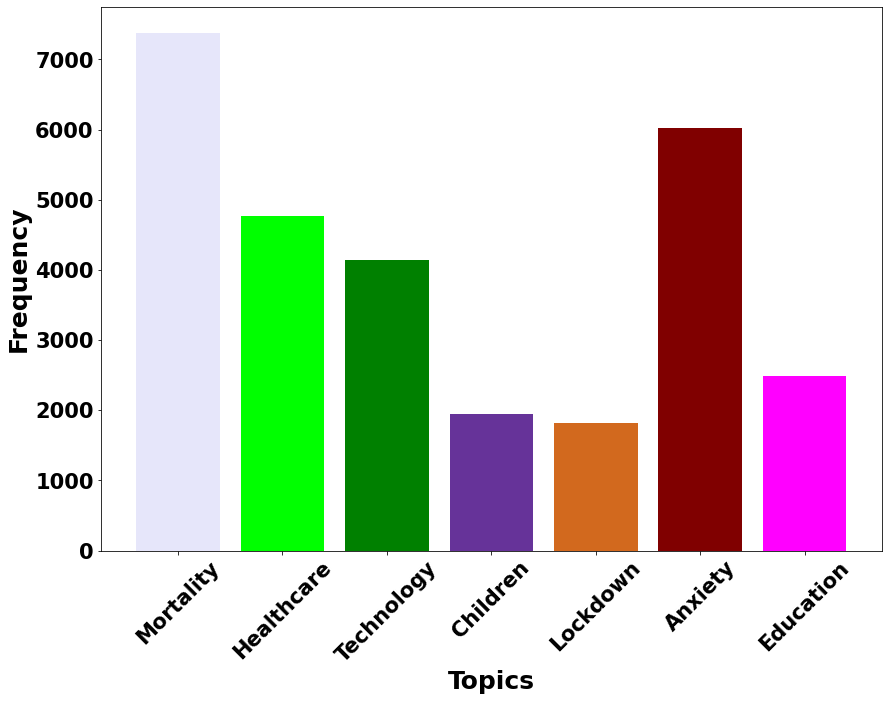

In [84]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']
plt.figure(figsize=(14, 10))
plt.bar(range(len(topic_c)), list(topic_c.values()), align='center', color=shuffle(cr,random_state=1))
plt.xticks(range(len(topic_c)), list(topic_c.keys()),rotation=45,fontsize=21,weight = 'bold')
plt.yticks(fontsize=21,weight = 'bold')
plt.xlabel('Topics', fontsize=25,weight = 'bold')
plt.ylabel('Frequency', fontsize=25,weight = 'bold')
plt.show()

## Findings:
### From above visualization we find that "Mortality" is the most trending topic in dataset and Lockdown is the least trending topic

##  2. Frequency of Topics in Quarters of Years

In [85]:
q1=dftpf2.loc[dftpf2["Publication_time"].isin(['Jan-20','Feb-20','Mar-20'])]
q2=dftpf2.loc[dftpf2["Publication_time"].isin(['Apr-20','May-20','Jun-20'])]
q3=dftpf2.loc[dftpf2["Publication_time"].isin(['Jul-20','Aug-20','Sep-20'])]
q4=dftpf2.loc[dftpf2["Publication_time"].isin(['Oct-20','Nov-20','Dec-20'])]

q5=dftpf2.loc[dftpf2["Publication_time"].isin(['Jan-21','Feb-21','Mar-21'])]
q6=dftpf2.loc[dftpf2["Publication_time"].isin(['Apr-21','May-21','Jun-21'])]
q7=dftpf2.loc[dftpf2["Publication_time"].isin(['Jul-21','Aug-21','Sep-21'])]

In [86]:
from collections import Counter
print(Counter(q1['Topic']))
print()
print(Counter(q2['Topic']))
print()
print(Counter(q3['Topic']))
print()
print(Counter(q4['Topic']))

print()
print(Counter(q5['Topic']))
print()
print(Counter(q6['Topic']))
print()
print(Counter(q7['Topic']))

Counter({'Mortality': 37, 'Variant': 34, 'Healthcare': 30, 'Children': 21, 'Technology': 14, 'Anxiety': 10, 'Woman': 9, 'Cancer': 8, 'Worker': 5, 'Thrombosis': 3, 'Lockdown': 2, 'Vaccine': 1})

Counter({'Healthcare': 1074, 'Mortality': 731, 'Technology': 626, 'Children': 361, 'Anxiety': 334, 'Worker': 260, 'Cancer': 226, 'Education': 201, 'Lockdown': 180, 'Thrombosis': 72, 'Variant': 60, 'Woman': 44, 'Vaccine': 18})

Counter({'Mortality': 1250, 'Healthcare': 1050, 'Anxiety': 824, 'Technology': 805, 'Children': 386, 'Education': 371, 'Lockdown': 355, 'Worker': 281, 'Cancer': 232, 'Thrombosis': 106, 'Variant': 97, 'Woman': 52, 'Vaccine': 16})

Counter({'Mortality': 1059, 'Anxiety': 960, 'Healthcare': 730, 'Technology': 565, 'Education': 422, 'Lockdown': 289, 'Children': 271, 'Worker': 176, 'Cancer': 109, 'Variant': 92, 'Thrombosis': 68, 'Woman': 31, 'Vaccine': 22})

Counter({'Mortality': 1667, 'Anxiety': 1358, 'Technology': 794, 'Healthcare': 790, 'Education': 511, 'Lockdown': 362, 'Chil

In [87]:
mf=[]
af=[]
hf=[]
tf=[]
ef=[]
cf=[]
lf=[]
dq1=dict(Counter(q1['Topic']))
dq2=dict(Counter(q2['Topic']))
dq3=dict(Counter(q3['Topic']))
dq4=dict(Counter(q4['Topic']))
dq5=dict(Counter(q5['Topic']))
dq6=dict(Counter(q6['Topic']))
dq7=dict(Counter(q7['Topic']))
mf.append(dq1['Mortality'])
mf.append(dq2['Mortality'])
mf.append(dq3['Mortality'])
mf.append(dq4['Mortality'])
mf.append(dq5['Mortality'])
mf.append(dq6['Mortality'])
mf.append(dq7['Mortality'])

af.append(dq1['Anxiety'])
af.append(dq2['Anxiety'])
af.append(dq3['Anxiety'])
af.append(dq4['Anxiety'])
af.append(dq5['Anxiety'])
af.append(dq6['Anxiety'])
af.append(dq7['Anxiety'])

hf.append(dq1['Healthcare'])
hf.append(dq2['Healthcare'])
hf.append(dq3['Healthcare'])
hf.append(dq4['Healthcare'])
hf.append(dq5['Healthcare'])
hf.append(dq6['Healthcare'])
hf.append(dq7['Healthcare'])

tf.append(dq1['Technology'])
tf.append(dq2['Technology'])
tf.append(dq3['Technology'])
tf.append(dq4['Technology'])
tf.append(dq5['Technology'])
tf.append(dq6['Technology'])
tf.append(dq7['Technology'])

ef.append(0)
ef.append(dq2['Education'])
ef.append(dq3['Education'])
ef.append(dq4['Education'])
ef.append(dq5['Education'])
ef.append(dq6['Education'])
ef.append(dq7['Education'])

cf.append(dq1['Children'])
cf.append(dq2['Children'])
cf.append(dq3['Children'])
cf.append(dq4['Children'])
cf.append(dq5['Children'])
cf.append(dq6['Children'])
cf.append(dq7['Children'])

lf.append(dq1['Lockdown'])
lf.append(dq2['Lockdown'])
lf.append(dq3['Lockdown'])
lf.append(dq4['Lockdown'])
lf.append(dq5['Lockdown'])
lf.append(dq6['Lockdown'])
lf.append(dq7['Lockdown'])

### Q1 => Jan to Mar 2020 <br>
### Q2 => Apr to June 2020 <br>
### Q3 => July to Sep 2020 <br>
### Q4 => Oct to Dec 2020 <br>
### Q5 => Jan to Mar 2021 <br>
### Q6 => Apr to June 2021 <br>
### Q7 => July to Sep 2021 <br>

In [90]:
lq=['Q1','Q2','Q3','Q4','Q5','Q6','Q7']
print(lq)

['Q1', 'Q2', 'Q3', 'Q4', 'Q5', 'Q6', 'Q7']


## Mortality

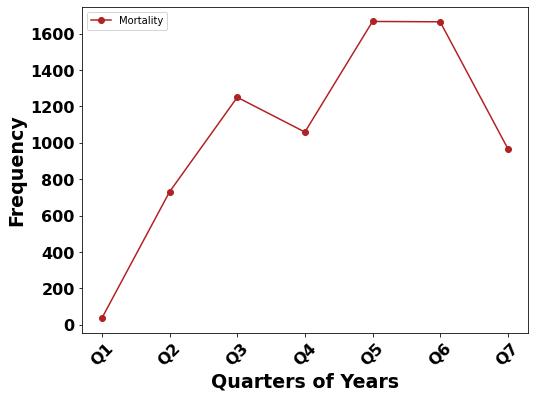

In [94]:
plt.figure(figsize=(8, 6))
plt.plot(lq, mf,color='firebrick',marker='o', label="Mortality")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Anxiety

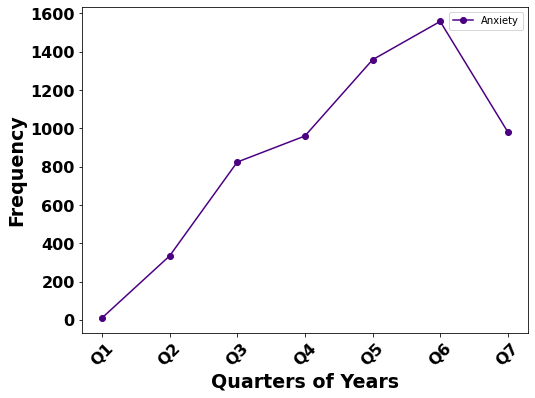

In [96]:
plt.figure(figsize=(8, 6))
plt.plot(lq, af,color='indigo',marker='o', label="Anxiety")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Healthcare

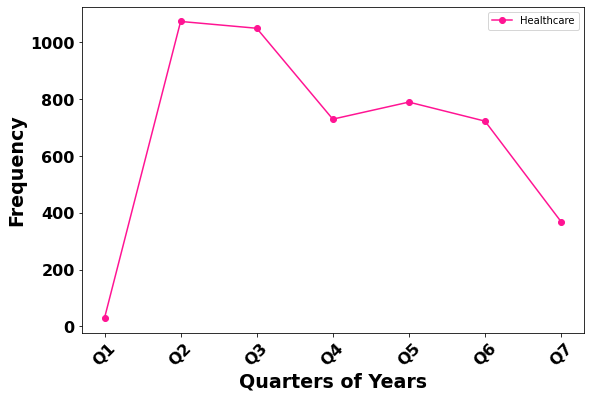

In [97]:
plt.figure(figsize=(9, 6))
plt.plot(lq, hf,color='deeppink',marker='o', label="Healthcare")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Technology

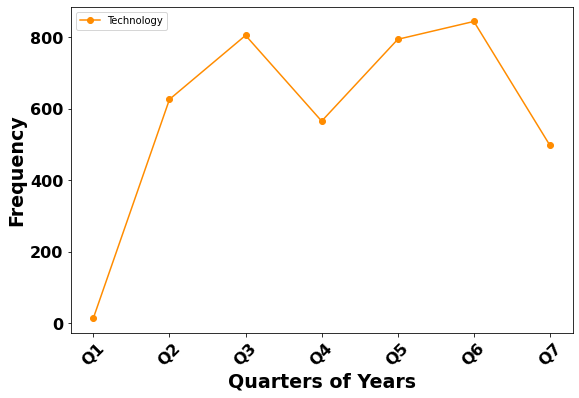

In [98]:
plt.figure(figsize=(9, 6))
plt.plot(lq, tf,color='darkorange',marker='o', label="Technology")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Education

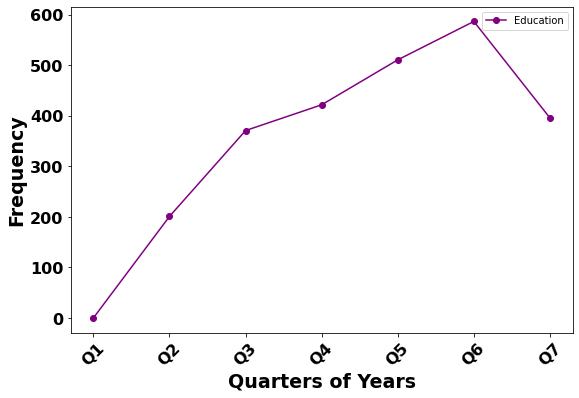

In [99]:
plt.figure(figsize=(9, 6))
plt.plot(lq, ef,color='purple',marker='o', label="Education")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Children

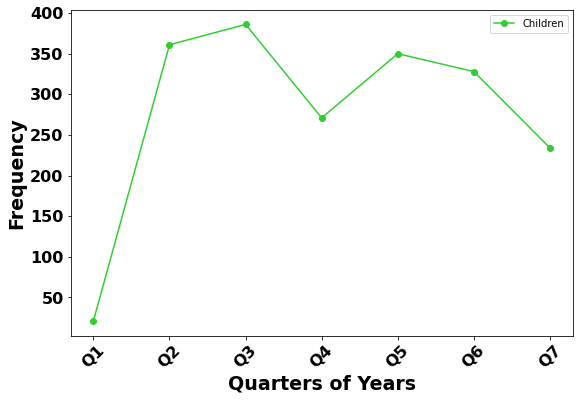

In [100]:
plt.figure(figsize=(9, 6))
plt.plot(lq, cf,color='limegreen',marker='o', label="Children")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Lockdown

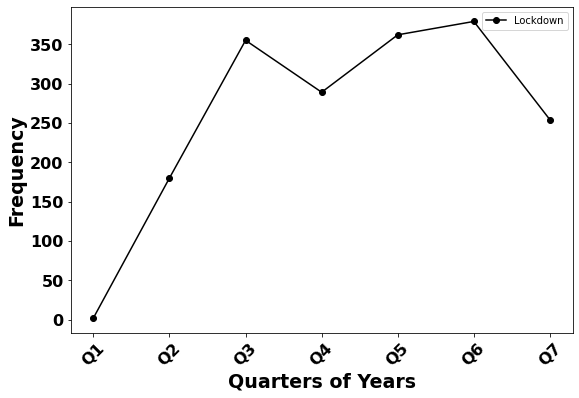

In [101]:
plt.figure(figsize=(9, 6))
plt.plot(lq, lf,color='black',marker='o', label="Lockdown")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend()

## Frequency of Topics and Quarters of Years

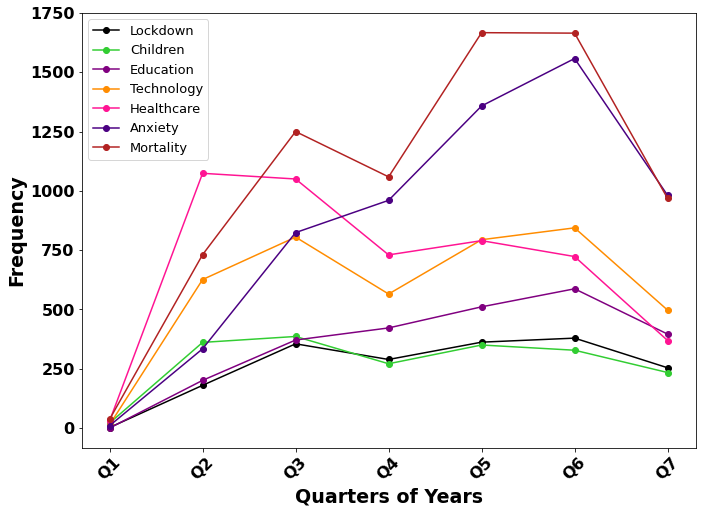

In [107]:
plt.figure(figsize=(11, 8))
plt.plot(lq, lf,color='black',marker='o', label="Lockdown")
plt.plot(lq, cf,color='limegreen',marker='o', label="Children")
plt.plot(lq, ef,color='purple',marker='o', label="Education")
plt.plot(lq, tf,color='darkorange',marker='o', label="Technology")
plt.plot(lq, hf,color='deeppink',marker='o', label="Healthcare")
plt.plot(lq, af,color='indigo',marker='o', label="Anxiety")
plt.plot(lq, mf,color='firebrick',marker='o', label="Mortality")
plt.xticks(lq,rotation=45,fontsize=16,weight = 'bold')
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Quarters of Years', fontsize=19,weight = 'bold')
plt.ylabel('Frequency', fontsize=19,weight = 'bold')
plt.legend(fontsize=13)

## 3. Which Country has Most Publications?

In [108]:
from collections import Counter
pc= Counter(dftpf2['Publication Country'])
print(pc)

Counter({'US': 11193, 'GB': 8453, 'CH': 2667, 'NL': 2261, 'DE': 1261, 'CA': 974, 'IT': 629, 'IN': 546, 'IE': 429, 'AU': 413, 'BR': 376, 'CN': 355, 'FR': 351, 'ES': 264, 'KR': 191, 'NZ': 187, 'JP': 181, 'TR': 115, 'CO': 105, 'IR': 99, 'PK': 97, 'PE': 95, 'PL': 94, 'MX': 83, 'DK': 82, 'SG': 70, 'SE': 66, 'UG': 65, 'RU': 53, 'SA': 49, 'GR': 48, 'ZA': 45, 'AT': 37, 'CL': 35, 'EG': 33, 'HR': 30, 'NO': 27, 'AE': 27, 'NP': 25, 'HU': 24, 'AR': 19, 'RO': 19, 'PT': 15, 'SK': 15, 'IL': 12, 'MY': 11, 'NG': 11, 'CZ': 9, 'TH': 7, 'ID': 6, 'BD': 6, 'BA': 6, 'UY': 6, 'BE': 5, 'PH': 4, 'TN': 3, 'OM': 3, 'PY': 3, 'ET': 3, 'FI': 2, 'KW': 1, 'IS': 1, 'LT': 1, 'VE': 1, 'CI': 1, 'MW': 1})


In [109]:
#Remove Countries which appears less then threshold
threshold=900
for key, value in list(pc.items()):
    if value < threshold:
        del pc[key]
print(pc) 

Counter({'US': 11193, 'GB': 8453, 'CH': 2667, 'NL': 2261, 'DE': 1261, 'CA': 974})


In [110]:
#Rename Countries
pc['United States']=pc.pop('US')
pc['Great Britain']=pc.pop('GB')
pc['Switzerland']=pc.pop('CH')
pc['Netherlands']=pc.pop('NL')
pc['Germany']=pc.pop('DE')
pc['Canada']=pc.pop('CA')
print(pc)

Counter({'United States': 11193, 'Great Britain': 8453, 'Switzerland': 2667, 'Netherlands': 2261, 'Germany': 1261, 'Canada': 974})


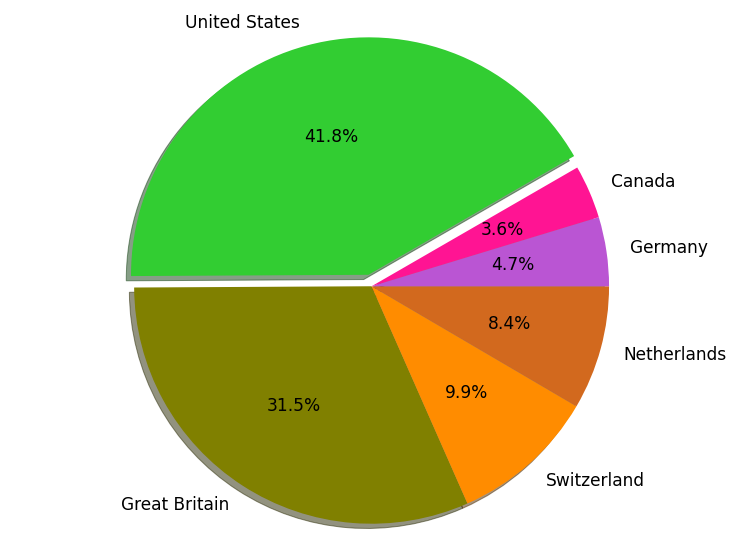

In [86]:
explode = (0.05, 0,0,0,0,0,)
fig = plt.figure(figsize =(13, 10))
plt.pie(list(pc.values()),explode =explode, labels=list(pc.keys()), autopct='%1.1f%%', shadow=True,
        startangle=30, colors=['limegreen','olive','darkorange','chocolate','mediumorchid','deeppink'],textprops={'fontsize': 17})
plt.axis('equal')
plt.show()

## Findings
### US has most Publications

## 4. Which Quarter of Years has Most Publications?

In [26]:
lq=['Jan to Mar 2020','Apr to June 2020','July to Sep 2020','Oct to Dec 2020','Jan to Mar 2021','Apr to June 2021','July to Sep 2021']
py=[]
py= [q1.shape[0],q2.shape[0],q3.shape[0],q4.shape[0],q5.shape[0],q6.shape[0],q7.shape[0]]
print(py)

[174, 4187, 5825, 4794, 6486, 6734, 4106]


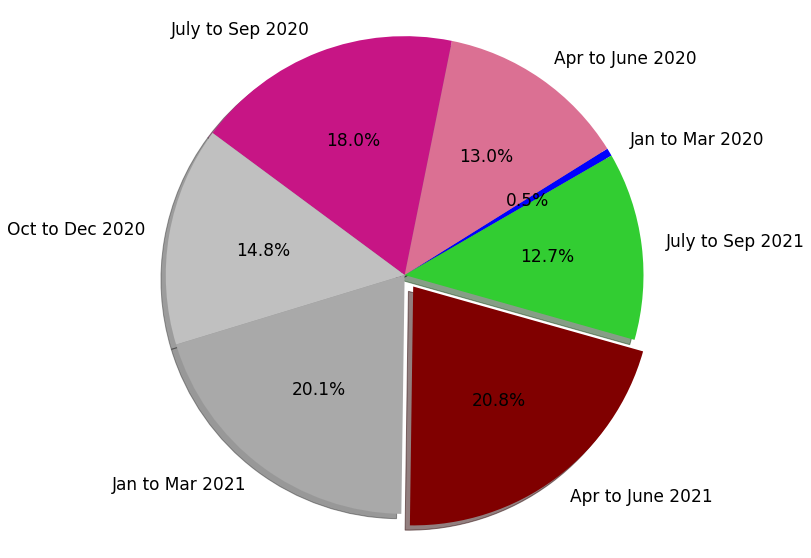

In [85]:
explode = (0,0,0,0,0,0.06,0)
fig = plt.figure(figsize =(13, 10))
plt.pie(list(py), labels=list(lq),explode=explode, autopct='%1.1f%%', shadow=True,
        startangle=30, colors=['blue','palevioletred','mediumvioletred','silver','darkgray','maroon','limegreen'],textprops={'fontsize': 17})
plt.axis('equal')
plt.show()

## Findings
### Apr to June 2021 Quarter has highest number of publications

## 5. Which Journal did produce Most of the Publications?

In [271]:
jl= Counter(dftpf2['Journal'])
#Remove Journal which appears less then threshold
threshold=150
for key, value in list(jl.items()):
    if value < threshold:
        del jl[key]
print(jl)
jl['Int. j. env. res. PH']=jl.pop('Int. j. environ. res. public health (Online)')
jl['Disaster Med PH Prep']=jl.pop('Disaster Med Public Health Prep')
jl['J Med Inter. Res']=jl.pop('J Med Internet Res')
jl['Front PH']=jl.pop('Front Public Health')
jl['Dis. Med PH Prep']=jl.pop('Disaster Med PH Prep')
jl['BMC PH']=jl.pop('BMC Public Health')
print()
print(jl)

Counter({'Int. j. environ. res. public health (Online)': 1126, 'PLoS One': 931, 'J Med Internet Res': 302, 'BMJ Open': 295, 'Front Public Health': 289, 'Sci Rep': 286, 'Int J Infect Dis': 177, 'BMC Public Health': 176, 'Disaster Med Public Health Prep': 172, 'BMC Infect Dis': 158, 'Cureus': 151})

Counter({'Int. j. env. res. PH': 1126, 'PLoS One': 931, 'J Med Inter. Res': 302, 'BMJ Open': 295, 'Front PH': 289, 'Sci Rep': 286, 'Int J Infect Dis': 177, 'BMC PH': 176, 'Dis. Med PH Prep': 172, 'BMC Infect Dis': 158, 'Cureus': 151})


Text(0, 0.5, 'Publications')

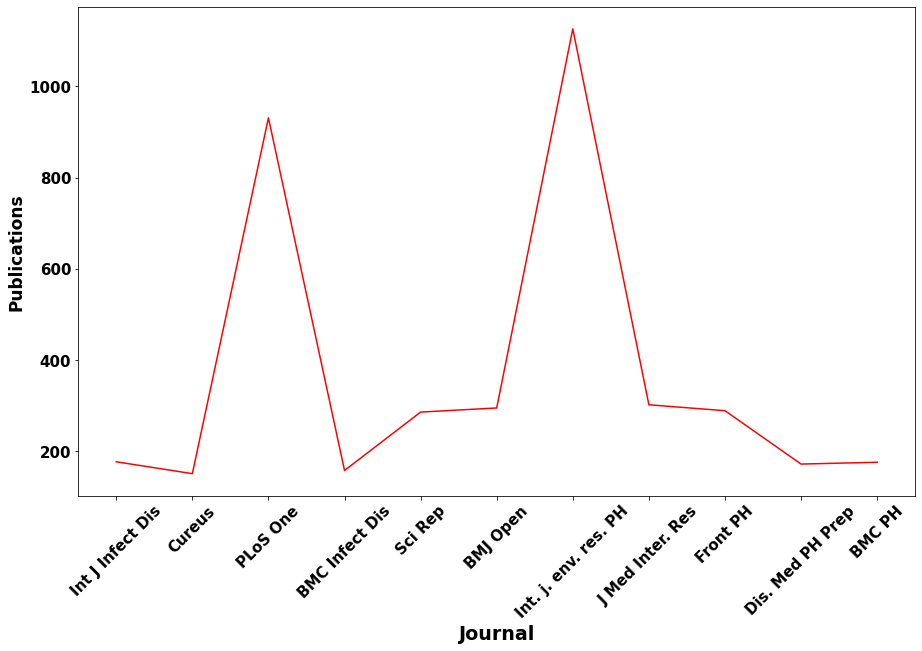

In [274]:
plt.figure(figsize=(15, 9))
plt.plot(range(len(jl)), list(jl.values()),color='r')
plt.xticks(range(len(jl)), list(jl.keys()),rotation=45,fontsize=15,weight = 'bold')
plt.yticks(fontsize=15,weight = 'bold')
plt.xlabel('Journal', fontsize=19,weight = 'bold')
plt.ylabel('Publications', fontsize=17,weight = 'bold')

## Findings
### "Int. j. environ. res. public health (Online)" has most Publications

## 6. Topics and their Publishing Countries

In [137]:
from collections import Counter
pc1= Counter(dftpf2['Publication Country'])
print(pc1)

Counter({'US': 11193, 'GB': 8453, 'CH': 2667, 'NL': 2261, 'DE': 1261, 'CA': 974, 'IT': 629, 'IN': 546, 'IE': 429, 'AU': 413, 'BR': 376, 'CN': 355, 'FR': 351, 'ES': 264, 'KR': 191, 'NZ': 187, 'JP': 181, 'TR': 115, 'CO': 105, 'IR': 99, 'PK': 97, 'PE': 95, 'PL': 94, 'MX': 83, 'DK': 82, 'SG': 70, 'SE': 66, 'UG': 65, 'RU': 53, 'SA': 49, 'GR': 48, 'ZA': 45, 'AT': 37, 'CL': 35, 'EG': 33, 'HR': 30, 'NO': 27, 'AE': 27, 'NP': 25, 'HU': 24, 'AR': 19, 'RO': 19, 'PT': 15, 'SK': 15, 'IL': 12, 'MY': 11, 'NG': 11, 'CZ': 9, 'TH': 7, 'ID': 6, 'BD': 6, 'BA': 6, 'UY': 6, 'BE': 5, 'PH': 4, 'TN': 3, 'OM': 3, 'PY': 3, 'ET': 3, 'FI': 2, 'KW': 1, 'IS': 1, 'LT': 1, 'VE': 1, 'CI': 1, 'MW': 1})


In [138]:
#Remove Countries which appears less then threshold
threshold=400
for key, value in list(pc1.items()):
    if value <= threshold:
        del pc1[key]
print(pc1)

Counter({'US': 11193, 'GB': 8453, 'CH': 2667, 'NL': 2261, 'DE': 1261, 'CA': 974, 'IT': 629, 'IN': 546, 'IE': 429, 'AU': 413})


In [139]:
dftpf3=dftpf2
dftpf3["Publication Country"]= dftpf2["Publication Country"].replace(['US','GB','CH','NL','DE','CA','IT','IN','IE','AU'],
['United States','Great Britain','Switzerland','Netherlands','Germany','Canada','Itly','India','Ireland','Australia'])

dftpf3=dftpf3.loc[dftpf3["Publication Country"].isin(['United States','Great Britain','Switzerland','Netherlands','Germany',
                                                      'Canada','Itly','India','Ireland','Australia'])]

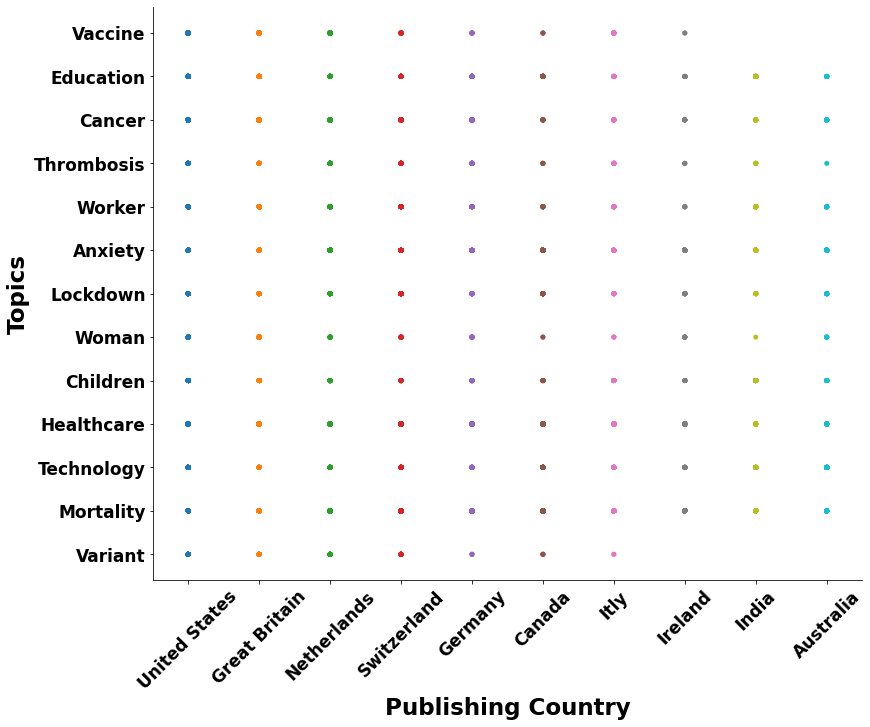

In [141]:
sns.catplot(x="Publication Country", y="Topic",jitter=False, data=dftpf3,height=8.5, aspect=1.3)
plt.xticks(rotation=45,weight='bold',fontsize=17)
plt.yticks(weight='bold',fontsize=17)
plt.xlabel('Publishing Country',weight = 'bold',fontsize=23)
plt.ylabel('Topics',weight = 'bold',fontsize=23)
print()

## Findings
### Australia and India missed Vaccine topic

# Vccination Part

In [175]:
vdf=pd.read_csv('vaccination-data.csv')

In [176]:
vdf.head()

,COUNTRY,ISO3,WHO_REGION,DATA_SOURCE,DATE_UPDATED,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_VACCINATED_1PLUS_DOSE_PER100,PERSONS_FULLY_VACCINATED,PERSONS_FULLY_VACCINATED_PER100,VACCINES_USED,FIRST_VACCINE_DATE,NUMBER_VACCINES_TYPES_USED
0,Afghanistan,AFG,EMRO,REPORTING,8/30/2021,1979652.0,773002.0,5.085,1.986,441371.0,1.134,"Beijing CNBG - BBIBP-CorV,Janssen - Ad26.COV 2.5,Pfizer BioNTech - Comirnaty,SII - Covishield",2/22/2021,4.0
1,Albania,ALB,EURO,OWID,9/13/2021,1610157.0,900814.0,55.951,31.302,709343.0,24.649,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty, Sinovac - CoronaVac, Gamaleya - Sputnik V",NaN,4.0
2,Algeria,DZA,AFRO,REPORTING,9/12/2021,9989662.0,5815039.0,22.781,13.261,4174623.0,9.520,"Beijing CNBG - BBIBP-CorV,Gamaleya - Sputnik V,SII - Covishield",1/30/2021,3.0
3,American Samoa,ASM,WPRO,REPORTING,9/7/2021,56744.0,31318.0,102.803,56.739,25971.0,47.051,"Janssen - Ad26.COV 2.5,Moderna - mRNA-1273,Pfizer BioNTech - Comirnaty",12/21/2020,3.0
4,Andorra,AND,EURO,OWID,8/29/2021,93430.0,51599.0,120.922,66.782,41831.0,54.140,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty",NaN,2.0


In [177]:
vdf.columns

Index(['COUNTRY', 'ISO3', 'WHO_REGION', 'DATA_SOURCE', 'DATE_UPDATED',
       'TOTAL_VACCINATIONS', 'PERSONS_VACCINATED_1PLUS_DOSE',
       'TOTAL_VACCINATIONS_PER100', 'PERSONS_VACCINATED_1PLUS_DOSE_PER100',
       'PERSONS_FULLY_VACCINATED', 'PERSONS_FULLY_VACCINATED_PER100',
       'VACCINES_USED', 'FIRST_VACCINE_DATE', 'NUMBER_VACCINES_TYPES_USED'],
      dtype='object')

In [178]:
vdf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227 entries, 0 to 226
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   COUNTRY                               227 non-null    object 
 1   ISO3                                  227 non-null    object 
 2   WHO_REGION                            227 non-null    object 
 3   DATA_SOURCE                           227 non-null    object 
 4   DATE_UPDATED                          227 non-null    object 
 5   TOTAL_VACCINATIONS                    225 non-null    float64
 6   PERSONS_VACCINATED_1PLUS_DOSE         220 non-null    float64
 7   TOTAL_VACCINATIONS_PER100             225 non-null    float64
 8   PERSONS_VACCINATED_1PLUS_DOSE_PER100  220 non-null    float64
 9   PERSONS_FULLY_VACCINATED              222 non-null    float64
 10  PERSONS_FULLY_VACCINATED_PER100       222 non-null    float64
 11  VACCINES_USED      

In [179]:
vdf=vdf.drop(['FIRST_VACCINE_DATE','PERSONS_VACCINATED_1PLUS_DOSE_PER100'],axis=1)

In [180]:
vdf.isnull().sum()

COUNTRY                            0
ISO3                               0
WHO_REGION                         0
DATA_SOURCE                        0
DATE_UPDATED                       0
TOTAL_VACCINATIONS                 2
PERSONS_VACCINATED_1PLUS_DOSE      7
TOTAL_VACCINATIONS_PER100          2
PERSONS_FULLY_VACCINATED           5
PERSONS_FULLY_VACCINATED_PER100    5
VACCINES_USED                      4
NUMBER_VACCINES_TYPES_USED         4
dtype: int64

In [181]:
vdf.dropna(inplace=True)

In [182]:
vdf.isnull().sum()

COUNTRY                            0
ISO3                               0
WHO_REGION                         0
DATA_SOURCE                        0
DATE_UPDATED                       0
TOTAL_VACCINATIONS                 0
PERSONS_VACCINATED_1PLUS_DOSE      0
TOTAL_VACCINATIONS_PER100          0
PERSONS_FULLY_VACCINATED           0
PERSONS_FULLY_VACCINATED_PER100    0
VACCINES_USED                      0
NUMBER_VACCINES_TYPES_USED         0
dtype: int64

In [183]:
vdf.shape

(214, 12)

## 1. How many vaccines are used by each WHO Region?

In [184]:
regions=['EMRO','EURO','AFRO','WPRO','AMRO','SEARO','OTHER']
tvr=[]
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'EMRO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'EURO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'AFRO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'WPRO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'AMRO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'SEARO', 'TOTAL_VACCINATIONS'].sum())
tvr.append(vdf.loc[vdf['WHO_REGION'] == 'OTHER', 'TOTAL_VACCINATIONS'].sum())
tvr=[int(x) for x in tvr] 
tvr=[x / 1000000 for x in tvr]
tvr=[round(num, 2) for num in tvr]
tvr

[238.6, 903.48, 66.15, 2453.04, 956.05, 990.8, 0.04]

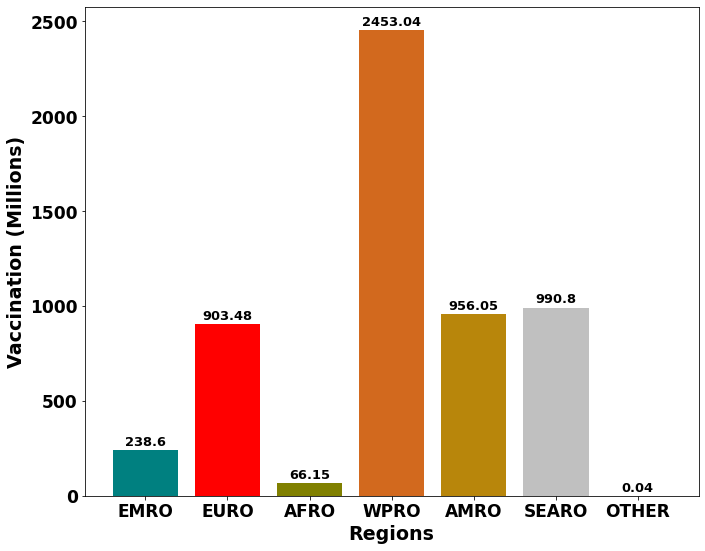

In [185]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(11, 9))   
plt.bar(regions,tvr,color=shuffle(cr,random_state=450))
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Regions',fontsize=19,weight = 'bold')
plt.ylabel('Vaccination (Millions)',fontsize=19,weight = 'bold')
for index,data in enumerate(tvr):
    plt.text(x=index , y =data+25 , s=f"{data}" , fontsize=13,ha='center',weight='bold')

## 2. How many persons are partially vaccinated in each WHO Region?

In [186]:
regions=['EMRO','EURO','AFRO','WPRO','AMRO','SEARO','OTHER']
pvr=[]
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'EMRO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'EURO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'AFRO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'WPRO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'AMRO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'SEARO', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr.append(vdf.loc[vdf['WHO_REGION'] == 'OTHER', 'PERSONS_VACCINATED_1PLUS_DOSE'].sum())
pvr=[int(x) for x in pvr] 
pvr=[x / 1000000 for x in pvr]
pvr=[round(num, 2) for num in pvr]
pvr

[127.68, 479.38, 41.17, 1302.54, 576.12, 719.65, 0.02]

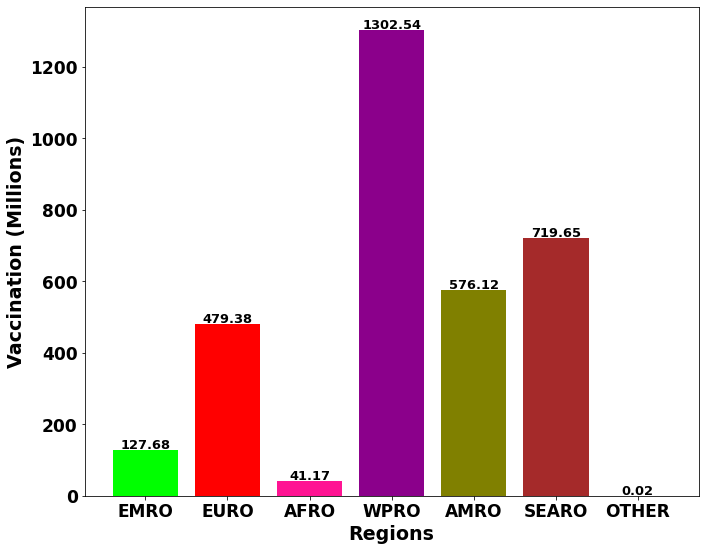

In [189]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(11, 9))   
plt.bar(regions,pvr,color=shuffle(cr,random_state=750))
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Regions',fontsize=19,weight = 'bold')
plt.ylabel('Vaccination (Millions)',fontsize=19,weight = 'bold')
for index,data in enumerate(pvr):
    plt.text(x=index , y =data+5 , s=f"{data}" , fontsize=13,ha='center',weight='bold')

## 3. How many Persons are Fully Vaccinated in each WHO Region?

In [190]:
regions=['EMRO','EURO','AFRO','WPRO','AMRO','SEARO','OTHER']
fvr=[]
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'EMRO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'EURO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'AFRO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'WPRO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'AMRO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'SEARO', 'PERSONS_FULLY_VACCINATED'].sum())
fvr.append(vdf.loc[vdf['WHO_REGION'] == 'OTHER', 'PERSONS_FULLY_VACCINATED'].sum())
fvr=[int(x) for x in fvr] 
fvr=[x / 1000000 for x in fvr]
fvr=[round(num, 2) for num in fvr]
fvr

[90.53, 425.98, 25.83, 1111.29, 403.82, 271.14, 0.02]

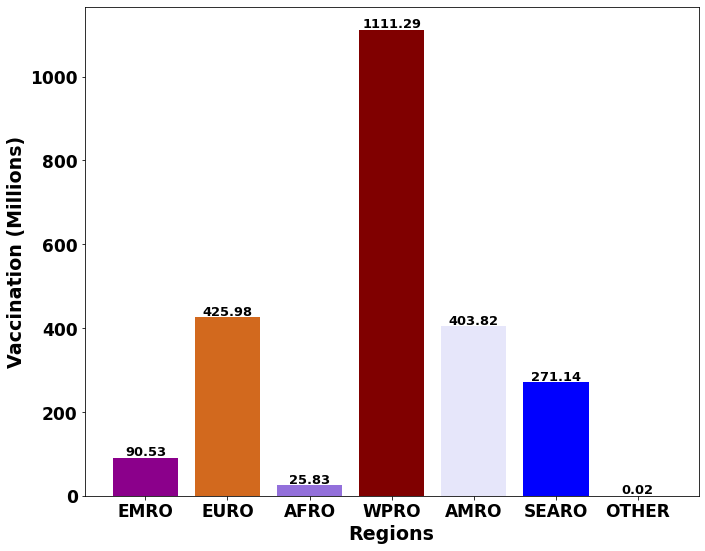

In [191]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(11, 9))   
plt.bar(regions,fvr,color=shuffle(cr,random_state=550))
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Regions',fontsize=19,weight = 'bold')
plt.ylabel('Vaccination (Millions)',fontsize=19,weight = 'bold')
for index,data in enumerate(fvr):
    plt.text(x=index , y =data+5 , s=f"{data}" , fontsize=13,ha='center',weight='bold')

## 4. How many Countries used a Specific Vaccine?

In [192]:
vdf['AstraZeneca'] = 0
vdf['BBIBP'] = 0
vdf['Sputnik V'] = 0
vdf['Janssen'] = 0
vdf['Moderna'] = 0
vdf['Pfizer'] = 0
vdf['Covishield'] = 0
vdf['Sinovac'] = 0

In [193]:
vdf.head()

,COUNTRY,ISO3,WHO_REGION,DATA_SOURCE,DATE_UPDATED,TOTAL_VACCINATIONS,PERSONS_VACCINATED_1PLUS_DOSE,TOTAL_VACCINATIONS_PER100,PERSONS_FULLY_VACCINATED,PERSONS_FULLY_VACCINATED_PER100,VACCINES_USED,NUMBER_VACCINES_TYPES_USED,AstraZeneca,BBIBP,Sputnik V,Janssen,Moderna,Pfizer,Covishield,Sinovac
0,Afghanistan,AFG,EMRO,REPORTING,8/30/2021,1979652.0,773002.0,5.085,441371.0,1.134,"Beijing CNBG - BBIBP-CorV,Janssen - Ad26.COV 2.5,Pfizer BioNTech - Comirnaty,SII - Covishield",4.0,0,0,0,0,0,0,0,0
1,Albania,ALB,EURO,OWID,9/13/2021,1610157.0,900814.0,55.951,709343.0,24.649,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty, Sinovac - CoronaVac, Gamaleya - Sputnik V",4.0,0,0,0,0,0,0,0,0
2,Algeria,DZA,AFRO,REPORTING,9/12/2021,9989662.0,5815039.0,22.781,4174623.0,9.520,"Beijing CNBG - BBIBP-CorV,Gamaleya - Sputnik V,SII - Covishield",3.0,0,0,0,0,0,0,0,0
3,American Samoa,ASM,WPRO,REPORTING,9/7/2021,56744.0,31318.0,102.803,25971.0,47.051,"Janssen - Ad26.COV 2.5,Moderna - mRNA-1273,Pfizer BioNTech - Comirnaty",3.0,0,0,0,0,0,0,0,0
4,Andorra,AND,EURO,OWID,8/29/2021,93430.0,51599.0,120.922,41831.0,54.140,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty",2.0,0,0,0,0,0,0,0,0


In [194]:
vdf.columns

Index(['COUNTRY', 'ISO3', 'WHO_REGION', 'DATA_SOURCE', 'DATE_UPDATED',
       'TOTAL_VACCINATIONS', 'PERSONS_VACCINATED_1PLUS_DOSE',
       'TOTAL_VACCINATIONS_PER100', 'PERSONS_FULLY_VACCINATED',
       'PERSONS_FULLY_VACCINATED_PER100', 'VACCINES_USED',
       'NUMBER_VACCINES_TYPES_USED', 'AstraZeneca', 'BBIBP', 'Sputnik V',
       'Janssen', 'Moderna', 'Pfizer', 'Covishield', 'Sinovac'],
      dtype='object')

In [195]:
vdf=vdf.rename(columns={'PERSONS_VACCINATED_1PLUS_DOSE': 'Partially Vaccinated','PERSONS_FULLY_VACCINATED': 'Fully Vaccinated',
                       'TOTAL_VACCINATIONS':'Total Vaccination'})

In [196]:
vdf.columns

Index(['COUNTRY', 'ISO3', 'WHO_REGION', 'DATA_SOURCE', 'DATE_UPDATED',
       'Total Vaccination', 'Partially Vaccinated',
       'TOTAL_VACCINATIONS_PER100', 'Fully Vaccinated',
       'PERSONS_FULLY_VACCINATED_PER100', 'VACCINES_USED',
       'NUMBER_VACCINES_TYPES_USED', 'AstraZeneca', 'BBIBP', 'Sputnik V',
       'Janssen', 'Moderna', 'Pfizer', 'Covishield', 'Sinovac'],
      dtype='object')

In [197]:
vdf['AstraZeneca']=vdf['VACCINES_USED'].str.contains('AstraZeneca')
vdf['BBIBP']=vdf['VACCINES_USED'].str.contains('BBIBP')
vdf['Sputnik V']=vdf['VACCINES_USED'].str.contains('Sputnik V')
vdf['Janssen']=vdf['VACCINES_USED'].str.contains('Janssen')
vdf['Moderna']=vdf['VACCINES_USED'].str.contains('Moderna')
vdf['Pfizer']=vdf['VACCINES_USED'].str.contains('Pfizer')
vdf['Covishield']=vdf['VACCINES_USED'].str.contains('Covishield')
vdf['Sinovac']=vdf['VACCINES_USED'].str.contains('Sinovac')

In [198]:
vdf.head()

,COUNTRY,ISO3,WHO_REGION,DATA_SOURCE,DATE_UPDATED,Total Vaccination,Partially Vaccinated,TOTAL_VACCINATIONS_PER100,Fully Vaccinated,PERSONS_FULLY_VACCINATED_PER100,VACCINES_USED,NUMBER_VACCINES_TYPES_USED,AstraZeneca,BBIBP,Sputnik V,Janssen,Moderna,Pfizer,Covishield,Sinovac
0,Afghanistan,AFG,EMRO,REPORTING,8/30/2021,1979652.0,773002.0,5.085,441371.0,1.134,"Beijing CNBG - BBIBP-CorV,Janssen - Ad26.COV 2.5,Pfizer BioNTech - Comirnaty,SII - Covishield",4.0,False,True,False,True,False,True,True,False
1,Albania,ALB,EURO,OWID,9/13/2021,1610157.0,900814.0,55.951,709343.0,24.649,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty, Sinovac - CoronaVac, Gamaleya - Sputnik V",4.0,True,False,True,False,False,True,False,True
2,Algeria,DZA,AFRO,REPORTING,9/12/2021,9989662.0,5815039.0,22.781,4174623.0,9.520,"Beijing CNBG - BBIBP-CorV,Gamaleya - Sputnik V,SII - Covishield",3.0,False,True,True,False,False,False,True,False
3,American Samoa,ASM,WPRO,REPORTING,9/7/2021,56744.0,31318.0,102.803,25971.0,47.051,"Janssen - Ad26.COV 2.5,Moderna - mRNA-1273,Pfizer BioNTech - Comirnaty",3.0,False,False,False,True,True,True,False,False
4,Andorra,AND,EURO,OWID,8/29/2021,93430.0,51599.0,120.922,41831.0,54.140,"AstraZeneca - AZD1222, Pfizer BioNTech - Comirnaty",2.0,True,False,False,False,False,True,False,False


In [199]:
ed={}
eud={}
ad={}
wd={}
amd={}
sd={}
vdfe = vdf[vdf['WHO_REGION'] == 'EMRO']
vdfeu = vdf[vdf['WHO_REGION'] == 'EURO']
vdfa = vdf[vdf['WHO_REGION'] == 'AFRO']
vdfw = vdf[vdf['WHO_REGION'] == 'WPRO']
vdfam = vdf[vdf['WHO_REGION'] == 'AMRO']
vdfs = vdf[vdf['WHO_REGION'] == 'SEARO']

vdfea = vdfe[vdfe['AstraZeneca']==True]
ed["AstraZeneca"]=len(vdfea)
vdfeb = vdfe[vdfe['BBIBP']==True]
ed["BBIBP"]=len(vdfeb)
vdfes = vdfe[vdfe['Sputnik V']==True]
ed["Sputnik V"]=len(vdfes)
vdfej = vdfe[vdfe['Janssen']==True]
ed["Janssen"]=len(vdfej)
vdfem = vdfe[vdfe['Moderna']==True]
ed["Moderna"]=len(vdfem)
vdfep = vdfe[vdfe['Pfizer']==True]
ed["Pfizer"]=len(vdfep)
vdfec = vdfe[vdfe['Covishield']==True]
ed["Covishield"]=len(vdfec)
vdfesc = vdfe[vdfe['Sinovac']==True]
ed["Sinovac"]=len(vdfesc)

vdfea = vdfeu[vdfeu['AstraZeneca']==True]
eud["AstraZeneca"]=len(vdfea)
vdfeb = vdfeu[vdfeu['BBIBP']==True]
eud["BBIBP"]=len(vdfeb)
vdfes = vdfeu[vdfeu['Sputnik V']==True]
eud["Sputnik V"]=len(vdfes)
vdfej = vdfeu[vdfeu['Janssen']==True]
eud["Janssen"]=len(vdfej)
vdfem = vdfeu[vdfeu['Moderna']==True]
eud["Moderna"]=len(vdfem)
vdfep = vdfeu[vdfeu['Pfizer']==True]
eud["Pfizer"]=len(vdfep)
vdfec = vdfeu[vdfeu['Covishield']==True]
eud["Covishield"]=len(vdfec)
vdfesc = vdfeu[vdfeu['Sinovac']==True]
eud["Sinovac"]=len(vdfesc)

vdfea = vdfa[vdfa['AstraZeneca']==True]
ad["AstraZeneca"]=len(vdfea)
vdfeb = vdfa[vdfa['BBIBP']==True]
ad["BBIBP"]=len(vdfeb)
vdfes = vdfa[vdfa['Sputnik V']==True]
ad["Sputnik V"]=len(vdfes)
vdfej = vdfa[vdfa['Janssen']==True]
ad["Janssen"]=len(vdfej)
vdfem = vdfa[vdfa['Moderna']==True]
ad["Moderna"]=len(vdfem)
vdfep = vdfa[vdfa['Pfizer']==True]
ad["Pfizer"]=len(vdfep)
vdfec = vdfa[vdfa['Covishield']==True]
ad["Covishield"]=len(vdfec)
vdfesc = vdfa[vdfa['Sinovac']==True]
ad["Sinovac"]=len(vdfesc)

vdfea = vdfw[vdfw['AstraZeneca']==True]
wd["AstraZeneca"]=len(vdfea)
vdfeb = vdfw[vdfw['BBIBP']==True]
wd["BBIBP"]=len(vdfeb)
vdfes = vdfw[vdfw['Sputnik V']==True]
wd["Sputnik V"]=len(vdfes)
vdfej = vdfw[vdfw['Janssen']==True]
wd["Janssen"]=len(vdfej)
vdfem = vdfw[vdfw['Moderna']==True]
wd["Moderna"]=len(vdfem)
vdfep = vdfw[vdfw['Pfizer']==True]
wd["Pfizer"]=len(vdfep)
vdfec = vdfw[vdfw['Covishield']==True]
wd["Covishield"]=len(vdfec)
vdfesc = vdfw[vdfw['Sinovac']==True]
wd["Sinovac"]=len(vdfesc)

vdfea = vdfam[vdfam['AstraZeneca']==True]
amd["AstraZeneca"]=len(vdfea)
vdfeb = vdfam[vdfam['BBIBP']==True]
amd["BBIBP"]=len(vdfeb)
vdfes = vdfam[vdfam['Sputnik V']==True]
amd["Sputnik V"]=len(vdfes)
vdfej = vdfam[vdfam['Janssen']==True]
amd["Janssen"]=len(vdfej)
vdfem = vdfam[vdfam['Moderna']==True]
amd["Moderna"]=len(vdfem)
vdfep = vdfam[vdfam['Pfizer']==True]
amd["Pfizer"]=len(vdfep)
vdfec = vdfam[vdfam['Covishield']==True]
amd["Covishield"]=len(vdfec)
vdfesc = vdfam[vdfam['Sinovac']==True]
amd["Sinovac"]=len(vdfesc)

vdfea = vdfs[vdfs['AstraZeneca']==True]
sd["AstraZeneca"]=len(vdfea)
vdfeb = vdfs[vdfs['BBIBP']==True]
sd["BBIBP"]=len(vdfeb)
vdfes = vdfs[vdfs['Sputnik V']==True]
sd["Sputnik V"]=len(vdfes)
vdfej = vdfs[vdfs['Janssen']==True]
sd["Janssen"]=len(vdfej)
vdfem = vdfs[vdfs['Moderna']==True]
sd["Moderna"]=len(vdfem)
vdfep = vdfs[vdfs['Pfizer']==True]
sd["Pfizer"]=len(vdfep)
vdfec = vdfs[vdfs['Covishield']==True]
sd["Covishield"]=len(vdfec)
vdfesc = vdfs[vdfs['Sinovac']==True]
sd["Sinovac"]=len(vdfesc)


In [200]:
print("EMRO:",ed)
print()
print("EURO:",eud)
print()
print("AFRO:",ad)
print()
print("WPRO:",wd)
print()
print("AMRO:",amd)
print()
print("SEARO:",sd)

EMRO: {'AstraZeneca': 13, 'BBIBP': 16, 'Sputnik V': 14, 'Janssen': 15, 'Moderna': 8, 'Pfizer': 16, 'Covishield': 9, 'Sinovac': 10}

EURO: {'AstraZeneca': 40, 'BBIBP': 0, 'Sputnik V': 13, 'Janssen': 20, 'Moderna': 33, 'Pfizer': 45, 'Covishield': 0, 'Sinovac': 9}

AFRO: {'AstraZeneca': 2, 'BBIBP': 21, 'Sputnik V': 5, 'Janssen': 3, 'Moderna': 3, 'Pfizer': 4, 'Covishield': 39, 'Sinovac': 5}

WPRO: {'AstraZeneca': 23, 'BBIBP': 10, 'Sputnik V': 5, 'Janssen': 14, 'Moderna': 15, 'Pfizer': 22, 'Covishield': 7, 'Sinovac': 5}

AMRO: {'AstraZeneca': 37, 'BBIBP': 12, 'Sputnik V': 11, 'Janssen': 14, 'Moderna': 17, 'Pfizer': 38, 'Covishield': 22, 'Sinovac': 9}

SEARO: {'AstraZeneca': 8, 'BBIBP': 8, 'Sputnik V': 5, 'Janssen': 5, 'Moderna': 7, 'Pfizer': 6, 'Covishield': 9, 'Sinovac': 5}


In [201]:
from collections import Counter
cd=Counter(ed) + Counter(eud) + Counter(ad) + Counter(wd) + Counter(amd) + Counter(sd)
cd=dict(cd)
cd

{'AstraZeneca': 123,
 'BBIBP': 67,
 'Sputnik V': 53,
 'Janssen': 71,
 'Moderna': 83,
 'Pfizer': 131,
 'Covishield': 86,
 'Sinovac': 43}

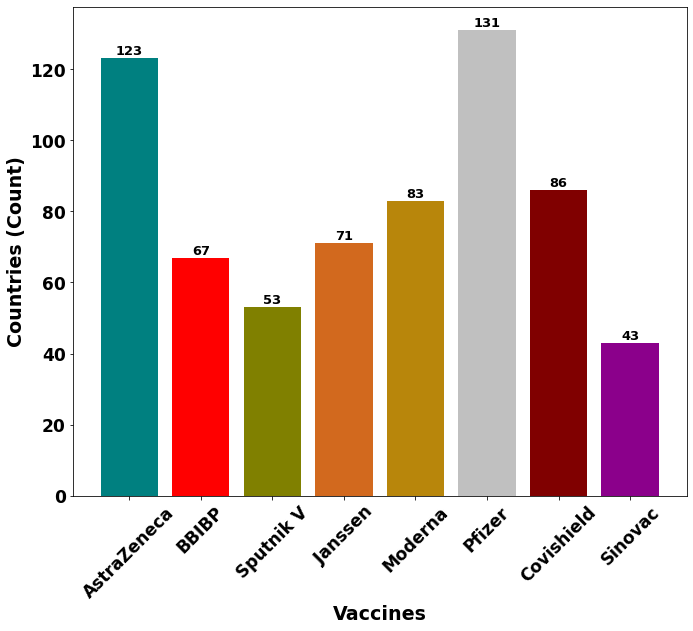

In [202]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(11, 9))   
plt.bar(list(cd.keys()),list(cd.values()),color=shuffle(cr,random_state=450))
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccines',fontsize=19,weight = 'bold')
plt.ylabel('Countries (Count)',fontsize=19,weight = 'bold')
for index,data in enumerate(list(cd.values())):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=13,ha='center',weight='bold')

## 5. Vaccination in Afghanistan 

In [203]:
cols=['Population',vdf.columns[5],vdf.columns[6],vdf.columns[8]]
afg=[39996349,vdf.loc[0][5],vdf.loc[0][6],vdf.loc[0][8]]
afg=[int(x) for x in afg] 
afg=[x / 1000000 for x in afg]
afg=[round(num, 2) for num in afg]
print(cols,'\n',afg)

['Population', 'Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated'] 
 [40.0, 1.98, 0.77, 0.44]


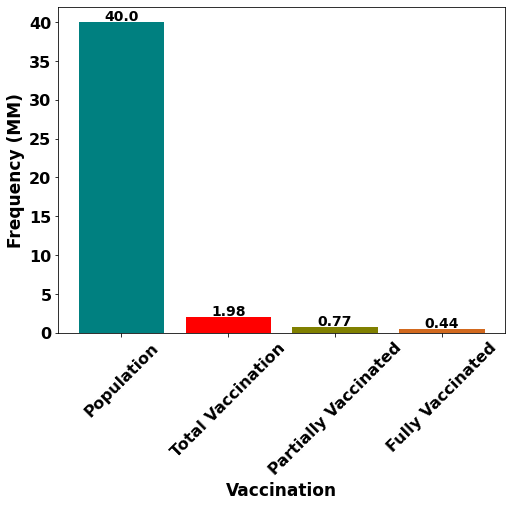

In [205]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(8, 6))   
plt.bar(cols,afg,color=shuffle(cr,random_state=450))
plt.xticks(fontsize=16,weight = 'bold',rotation=45)
plt.yticks(fontsize=16,weight = 'bold')

plt.xlabel('Vaccination',fontsize=17,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=17,weight = 'bold')
for index,data in enumerate(afg):
    plt.text(x=index , y =data+0.2 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

## 6. Vaccination in Pakistan

In [206]:
cols=['Population',vdf.columns[5],vdf.columns[6],vdf.columns[8]]
pak=[266132029,vdf.loc[154][5],vdf.loc[154][6],vdf.loc[154][8]]
pak=[int(x) for x in pak] 
pak=[x / 1000000 for x in pak]
pak=[round(num, 2) for num in pak]
print(cols,'\n',pak)

['Population', 'Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated'] 
 [266.13, 70.49, 29.59, 23.18]


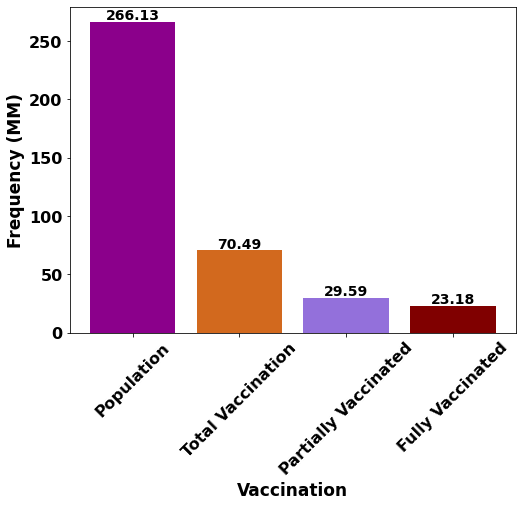

In [207]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(8, 6))   
plt.bar(cols,pak,color=shuffle(cr,random_state=550))
plt.xticks(fontsize=16,weight = 'bold',rotation=45)
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Vaccination',fontsize=17,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=17,weight = 'bold')
for index,data in enumerate(pak):
    plt.text(x=index , y =data+2 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

## 7. Vaccination in United States of America

In [208]:
cols=['Population',vdf.columns[5],vdf.columns[6],vdf.columns[8]]
usa=[333378983,vdf.loc[217][5],vdf.loc[217][6],vdf.loc[217][8]]
usa=[int(x) for x in usa] 
usa=[x / 1000000 for x in usa]
usa=[round(num, 2) for num in usa]
print(cols,'\n',usa)

['Population', 'Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated'] 
 [333.38, 379.08, 215.8, 177.92]


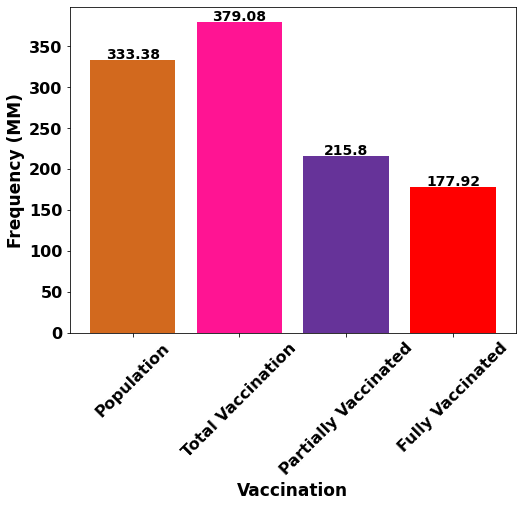

In [209]:
from sklearn.utils import shuffle
cr=['r','orange','crimson','g','b','indigo','navy','teal','darkgrey','deeppink','magenta','Brown','darkmagenta',
'rebeccapurple','mediumpurple','silver','maroon','lime','olive','chocolate','lavender','gold','darkgoldenrod']

plt.figure(figsize=(8, 6))   
plt.bar(cols,usa,color=shuffle(cr,random_state=650))
plt.xticks(fontsize=16,weight = 'bold',rotation=45)
plt.yticks(fontsize=16,weight = 'bold')
plt.xlabel('Vaccination',fontsize=17,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=17,weight = 'bold')
for index,data in enumerate(usa):
    plt.text(x=index , y =data+2 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

## 8. Comparision of South Asian Countries

In [178]:
dfsa =pd.DataFrame([
                     ['Maldives',round(552230/1000000,1),round(int(vdf.loc[123][5])/1000000,1),round(int(vdf.loc[123][6])/1000000,1),round(int(vdf.loc[123][8])/1000000,1)],
                     ['Bhutan',round(782049/1000000,1),round(int(vdf.loc[23][5])/1000000,1),round(int(vdf.loc[23][6])/1000000,1),round(int(vdf.loc[23][8])/1000000,1)],
                     ['Sri Lanka',round(21523439/1000000,1),round(int(vdf.loc[194][5])/1000000,1),round(int(vdf.loc[194][6])/1000000,1),round(int(vdf.loc[194][8])/1000000,1)],
                     ['Nepal',round(29780033/1000000,1),round(int(vdf.loc[141][5])/1000000,1),round(int(vdf.loc[141][6])/1000000,1),round(int(vdf.loc[141][8])/1000000,1)],
                     ['Afghanistan',round(40003552/1000000,1),round(int(vdf.loc[0][5])/1000000,1),round(int(vdf.loc[0][6])/1000000,1),round(int(vdf.loc[0][8])/1000000,1)],
                     ['Bangladesh',round(166705916/1000000,1),round(int(vdf.loc[16][5])/1000000,1),round(int(vdf.loc[16][6])/1000000,1),round(int(vdf.loc[16][8])/1000000,1)],
                     ['Pakistan',round(226155506/1000000,1),round(int(vdf.loc[154][5])/1000000,1),round(int(vdf.loc[154][6])/1000000,1),round(int(vdf.loc[154][8])/1000000,1)],
                     ['India',round(1396716723/1000000,1),round(int(vdf.loc[93][5])/1000000,1),round(int(vdf.loc[93][6])/1000000,1),round(int(vdf.loc[93][8])/1000000,1)]],
                  columns=['Countries','Population','Total Vaccination', 'Persons Partially Vaccinated', 'Persons Fully Vaccinated'])
dfsa

,Countries,Population,Total Vaccination,Persons Partially Vaccinated,Persons Fully Vaccinated
0,Maldives,0.6,0.7,0.4,0.3
1,Bhutan,0.8,1.0,0.6,0.5
2,Sri Lanka,21.5,24.2,13.6,10.7
3,Nepal,29.8,11.0,5.8,5.2
4,Afghanistan,40.0,2.0,0.8,0.4
5,Bangladesh,166.7,35.5,21.3,14.1
6,Pakistan,226.2,70.5,29.6,23.2
7,India,1396.7,752.2,570.5,181.7


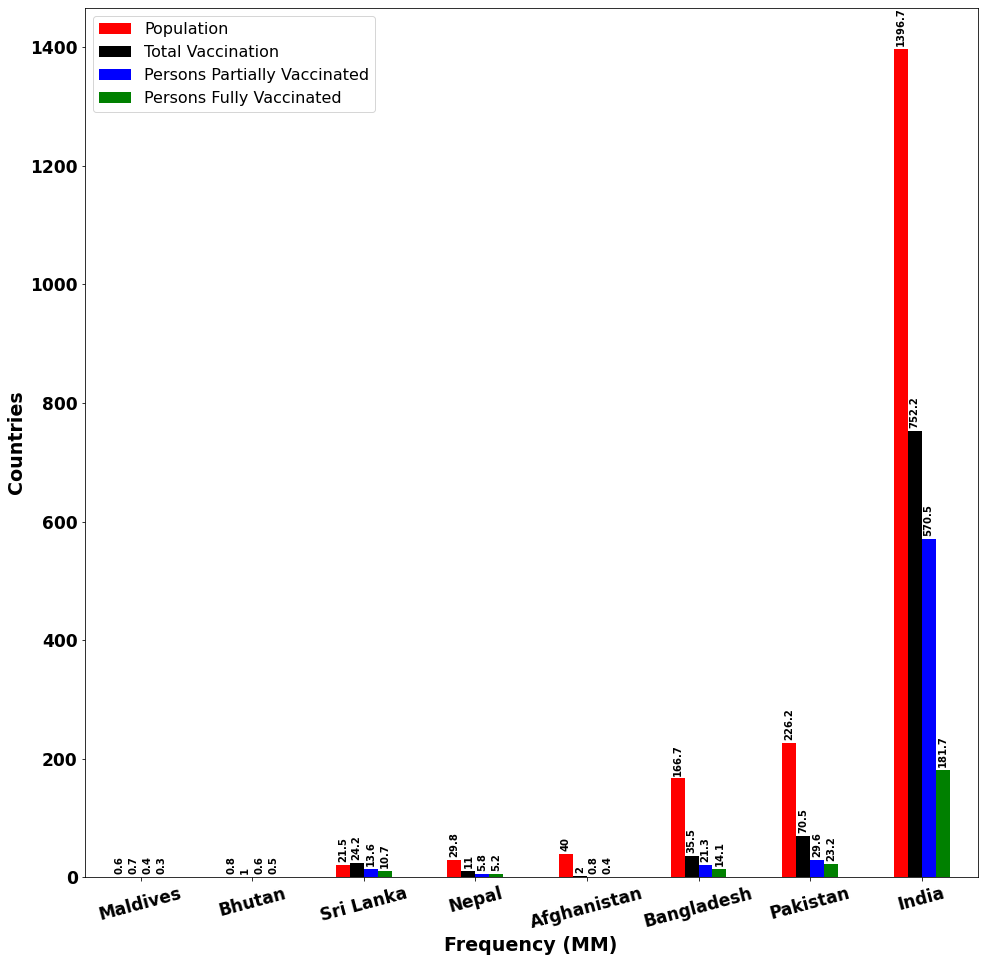

In [183]:
ax=dfsa.plot(x='Countries',kind='bar',figsize=(16, 16),color=['r','black','b','g'])
plt.xlabel('Frequency (MM)', fontsize=19,weight = 'bold')
plt.ylabel('Countries', fontsize=19,weight = 'bold')
plt.xticks(fontsize=17,weight = 'bold',rotation=15)
plt.yticks(fontsize=17,weight = 'bold')
plt.legend(loc='upper left',prop={"size":16})
for p in ax.patches:
    h = p.get_height()
    x = p.get_x()+p.get_width()/2.
    if h != 0:
        ax.annotate("%g" % p.get_height(), xy=(x,h), xytext=(0,5), textcoords="offset points", ha="center",weight='bold',fontsize=10,rotation=90)
print()

## 9. Comparision of South Asian Countries (G1)

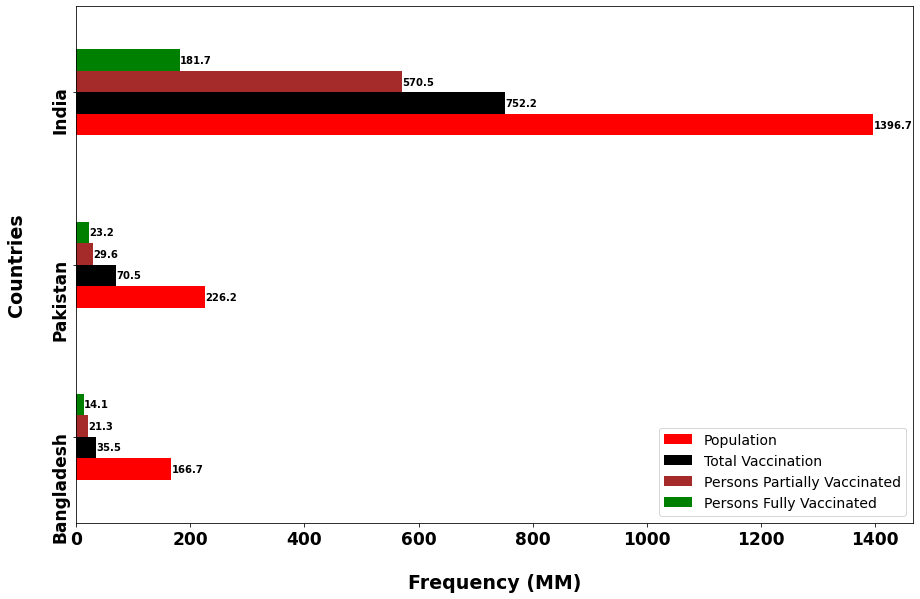

In [215]:
dfsa1 =pd.DataFrame([
                     ['Bangladesh',round(166705916/1000000,2),round(int(vdf.loc[16][5])/1000000,1),round(int(vdf.loc[16][6])/1000000,1),round(int(vdf.loc[16][8])/1000000,1)],
                     ['Pakistan',round(226155506/1000000,2),round(int(vdf.loc[154][5])/1000000,1),round(int(vdf.loc[154][6])/1000000,1),round(int(vdf.loc[154][8])/1000000,1)],
                     ['India',round(1396716723/1000000,2),round(int(vdf.loc[93][5])/1000000,1),round(int(vdf.loc[93][6])/1000000,1),round(int(vdf.loc[93][8])/1000000,1)]],
                  columns=['Countries','Population','Total Vaccination', 'Persons Partially Vaccinated', 'Persons Fully Vaccinated'])

ax=dfsa1.plot(x='Countries',kind='barh',stacked=False,figsize=(15, 9.5),color=['r','black','Brown','g'])
plt.xlabel('Frequency (MM)', fontsize=19,weight = 'bold',labelpad=25)
plt.ylabel('Countries', fontsize=19,weight = 'bold',labelpad=25)
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold',rotation=90)
plt.legend(loc='lower right',prop={"size":14})

rects = ax.patches
for rect in rects:
    x_value = rect.get_width()
    y_value = rect.get_y() + rect.get_height() / 2
    space = 0
    ha = 'left'
    if x_value < 0:
        space *= -1
        ha = 'right'
    label = "{:.1f}".format(x_value)
    plt.annotate(
        label,                      
        (x_value, y_value), xytext=(space, 0), textcoords="offset points", va='center',ha=ha,weight='bold',fontsize=10)                      
plt.show()

print()

## 10. Comparision of South Asian Countries (G2)

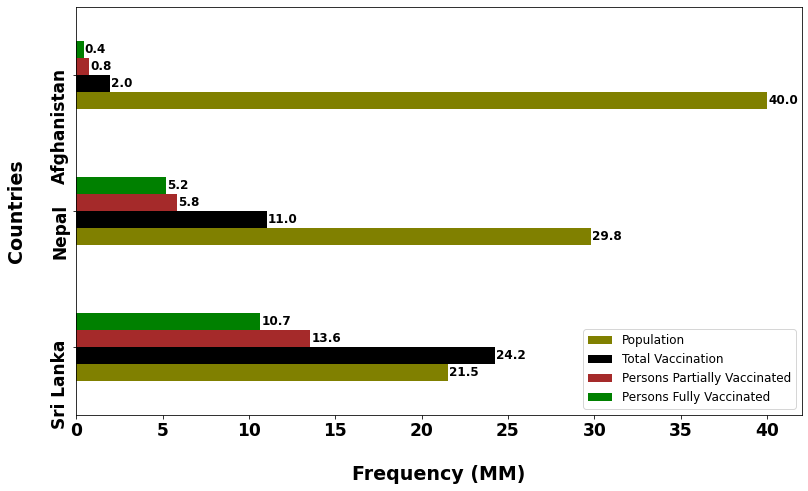

In [217]:
dfsa1 =pd.DataFrame([
                     ['Sri Lanka',round(21523439/1000000,2),round(int(vdf.loc[194][5])/1000000,2),round(int(vdf.loc[194][6])/1000000,2),round(int(vdf.loc[194][8])/1000000,2)],
                     ['Nepal',round(29780033/1000000,2),round(int(vdf.loc[141][5])/1000000,2),round(int(vdf.loc[141][6])/1000000,2),round(int(vdf.loc[141][8])/1000000,2)],
                     ['Afghanistan',round(40003552/1000000,2),round(int(vdf.loc[0][5])/1000000,2),round(int(vdf.loc[0][6])/1000000,2),round(int(vdf.loc[0][8])/1000000,2)]],
                  columns=['Countries','Population','Total Vaccination', 'Persons Partially Vaccinated', 'Persons Fully Vaccinated'])

ax=dfsa1.plot(x='Countries',kind='barh',stacked=False,figsize=(13, 7.5),color=['olive','black','Brown','g'])
plt.xlabel('Frequency (MM)', fontsize=19,weight = 'bold',labelpad=25)
plt.ylabel('Countries', fontsize=19,weight = 'bold',labelpad=25)
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold',rotation=90)
plt.legend(loc='lower right',prop={"size":12})

rects = ax.patches
for rect in rects:
    x_value = rect.get_width()
    y_value = rect.get_y() + rect.get_height() / 2
    space = 1
    ha = 'left'
    if x_value < 0:
        space *= -1
        ha = 'right'
    label = "{:.1f}".format(x_value)
    plt.annotate(
        label,                      
        (x_value, y_value), xytext=(space, 0), textcoords="offset points", va='center',ha=ha,weight='bold',fontsize=12) 
print()

## 11. Comparision of South Asian Countries (G3)

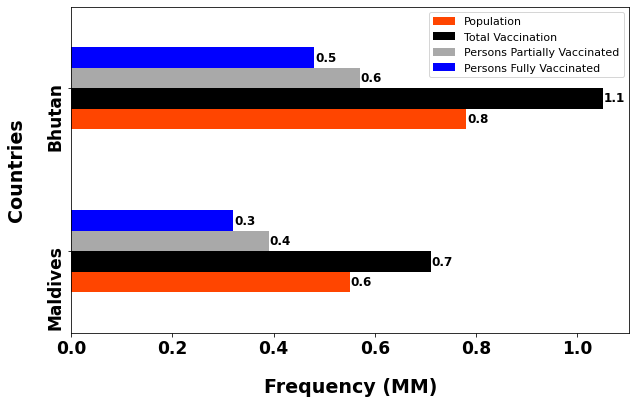

In [236]:
dfsa2 =pd.DataFrame([
                     ['Maldives',round(552230/1000000,2),round(int(vdf.loc[123][5])/1000000,2),round(int(vdf.loc[123][6])/1000000,2),round(int(vdf.loc[123][8])/1000000,2)],
                     ['Bhutan',round(782049/1000000,2),round(int(vdf.loc[23][5])/1000000,2),round(int(vdf.loc[23][6])/1000000,2),round(int(vdf.loc[23][8])/1000000,2)]],
                  columns=['Countries','Population','Total Vaccination', 'Persons Partially Vaccinated', 'Persons Fully Vaccinated'])

ax=dfsa2.plot(x='Countries',kind='barh',stacked=False,figsize=(10, 6),color=['orangered','black','darkgrey','b'])
plt.xlabel('Frequency (MM)', fontsize=19,weight = 'bold',labelpad=20)
plt.ylabel('Countries', fontsize=19,weight = 'bold',labelpad=20)
plt.xticks(fontsize=17,weight = 'bold')
plt.yticks(fontsize=17,weight = 'bold',rotation=90)
plt.legend(loc='upper right',prop={"size":11})

rects = ax.patches
for rect in rects:
    x_value = rect.get_width()
    y_value = rect.get_y() + rect.get_height() / 2
    space = 1
    ha = 'left'
    if x_value < 0:
        space *= -1
        ha = 'right'
    label = "{:.1f}".format(x_value)
    plt.annotate(
        label,                      
        (x_value, y_value), xytext=(space, 0), textcoords="offset points", va='center',ha=ha,weight='bold',fontsize=12) 
print()

## 12. Percentage of Fully Vaccinated Persons in South Asian Countries

In [58]:
c=['India','Pakistan','Bangladesh','Sri Lanka','Bhutan','Maldives','Afghanistan','Nepal']
fvp=[round((int(vdf.loc[93][8])/1396716723)*100,2),
    round((int(vdf.loc[154][8])/226155506)*100,2),
    round((int(vdf.loc[16][8])/166705916)*100,2),
    round((int(vdf.loc[194][8])/21523439)*100,2),
    round((int(vdf.loc[23][8])/782049)*100,2),
    round((int(vdf.loc[123][8])/552230)*100,2),
    round((int(vdf.loc[0][8])/40003552)*100,2),
    round((int(vdf.loc[141][8])/29780033)*100,2)]
print(c,'\n',fvp)

['India', 'Pakistan', 'Bangladesh', 'Sri Lanka', 'Bhutan', 'Maldives', 'Afghanistan', 'Nepal'] 
 [13.01, 10.25, 8.48, 49.59, 61.24, 58.23, 1.1, 17.46]


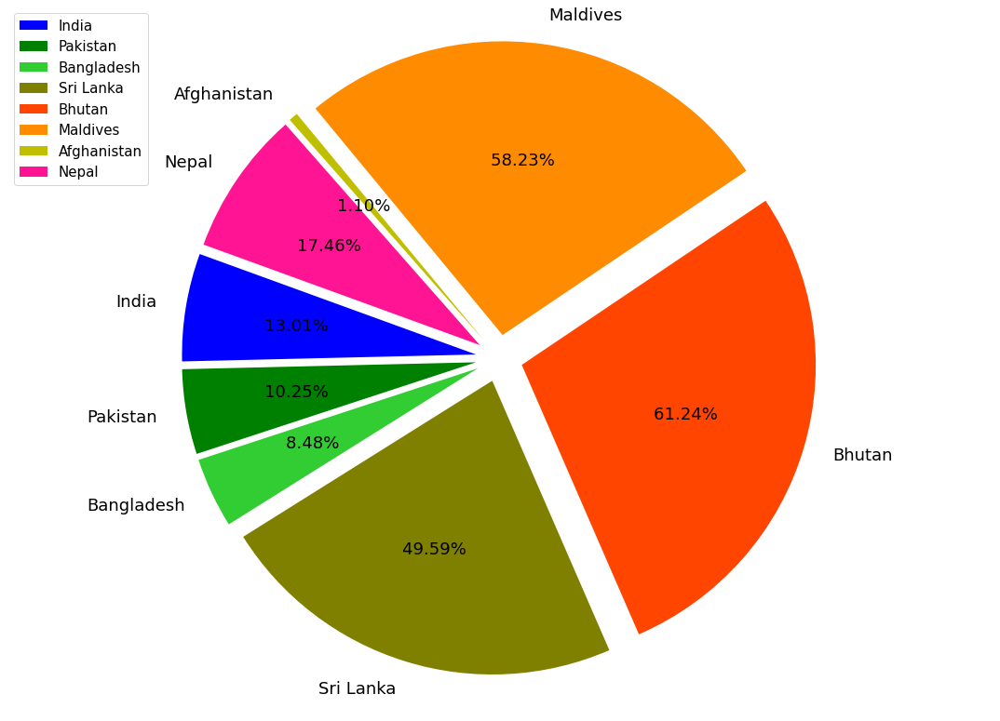

In [59]:
def autopcter(values):
    def autopct_inner(pct):
        total = sum(values)
        val = round(pct*total/100,2)
        return '{v:.2f}%  '.format(v=val)
    return autopct_inner
a=autopcter(fvp)

explode = (0.08,0.08,0.08,0.08,0.08,0.08,0.08,0.08)
fig = plt.figure(figsize =(19, 14))
plt.pie(fvp,explode =explode,labels=c,autopct=a, shadow=False,
        startangle=160, colors=['b','g','limegreen','olive','orangered','darkorange','y','deeppink'],textprops={'fontsize': 18})
plt.axis('equal')
plt.legend(loc='upper left',prop={"size":15})
plt.show()

## 13. Crisis Hit Countries

In [409]:
dfse =pd.DataFrame([
                     ['India',round(1397087126/1000000,1),round(int(vdf.loc[93][5])/1000000,1),round(int(vdf.loc[93][6])/1000000,1),round(int(vdf.loc[93][8])/1000000,1)],
                     ['United States',round(333447797/1000000,1),round(int(vdf.loc[217][5])/1000000,1),round(int(vdf.loc[217][6])/1000000,1),round(int(vdf.loc[217][8])/1000000,1)],
                     ['Brazil',round(214462541/1000000,1),round(int(vdf.loc[29][5])/1000000,1),round(int(vdf.loc[29][6])/1000000,1),round(int(vdf.loc[29][8])/1000000,1)],
                     ['Russia',round(146013340/1000000,1),round(int(vdf.loc[169][5])/1000000,1),round(int(vdf.loc[169][6])/1000000,1),round(int(vdf.loc[169][8])/1000000,1)],
                     ['Turkey',round(85481567/1000000,1),round(int(vdf.loc[209][5])/1000000,1),round(int(vdf.loc[209][6])/1000000,1),round(int(vdf.loc[209][8])/1000000,1)],
                     ['Iran',round(85345960/1000000,1),round(int(vdf.loc[95][5])/1000000,1),round(int(vdf.loc[95][6])/1000000,1),round(int(vdf.loc[95][8])/1000000,1)],
                     ['United Kingdom',round(68335277/1000000,1),round(int(vdf.loc[202][5])/1000000,1),round(int(vdf.loc[202][6])/1000000,1),round(int(vdf.loc[202][8])/1000000,1)],
                     ['France',round(65455540/1000000,1),round(int(vdf.loc[70][5])/1000000,1),round(int(vdf.loc[70][6])/1000000,1),round(int(vdf.loc[70][8])/1000000,1)]],
                  columns=['Countries','Population','Total Vaccination', 'Persons Partially Vaccinated', 'Persons Fully Vaccinated'])
dfse

,Countries,Population,Total Vaccination,Persons Partially Vaccinated,Persons Fully Vaccinated
0,India,1397.1,752.2,570.5,181.7
1,United States,333.4,379.1,215.8,177.9
2,Brazil,214.5,195.3,134.6,65.2
3,Russia,146.0,86.1,46.2,39.9
4,Turkey,85.5,103.0,52.0,40.9
5,Iran,85.3,36.8,22.9,12.5
6,United Kingdom,68.3,92.5,48.4,43.9
7,France,65.5,91.7,49.6,42.7


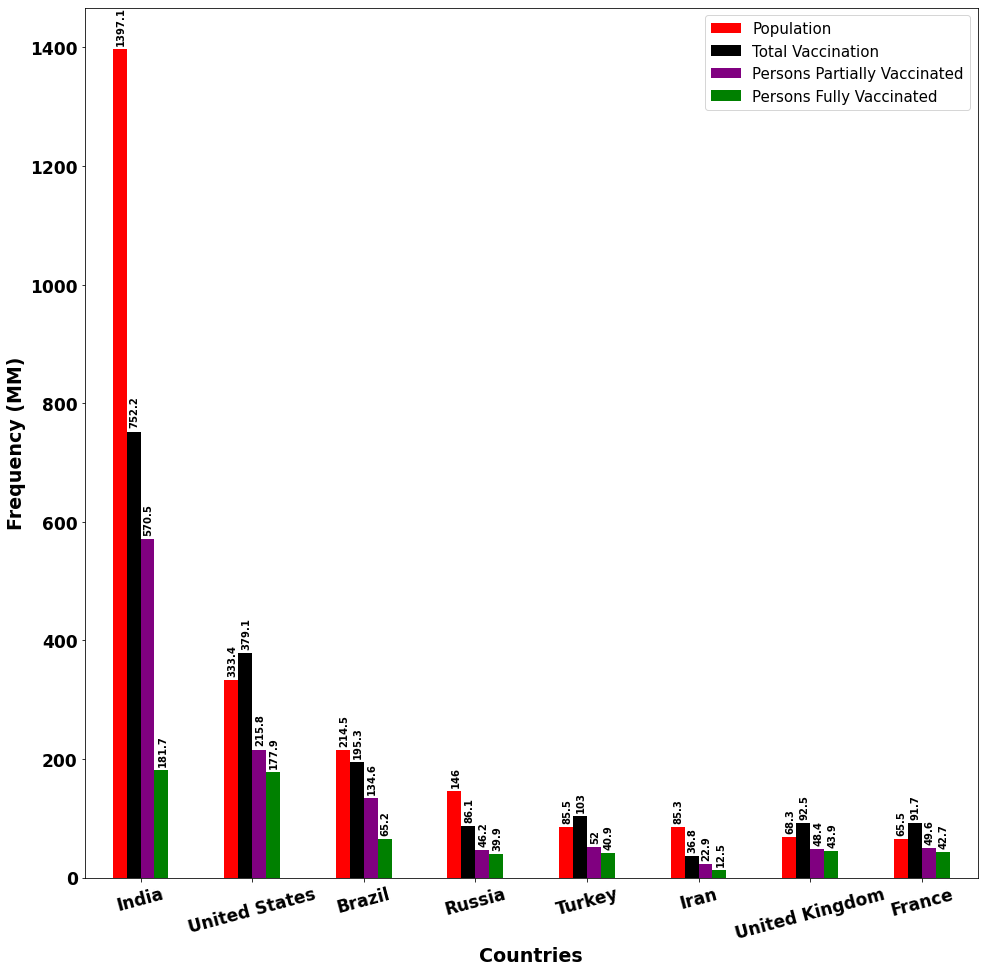

In [413]:
ax=dfse.plot(x='Countries',kind='bar',figsize=(16, 16),color=['r','black','purple','g'])
plt.xlabel('Countries', fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)', fontsize=19,weight = 'bold')
plt.xticks(fontsize=17,weight = 'bold',rotation=15)
plt.yticks(fontsize=17,weight = 'bold')
plt.legend(loc='upper right',prop={"size":15})
for p in ax.patches:
    h = p.get_height()
    x = p.get_x()+p.get_width()/2.
    if h != 0:
        ax.annotate("%g" % p.get_height(), xy=(x,h), xytext=(1,6), textcoords="offset points", ha="center",weight='bold',fontsize=10,rotation=90)
print()

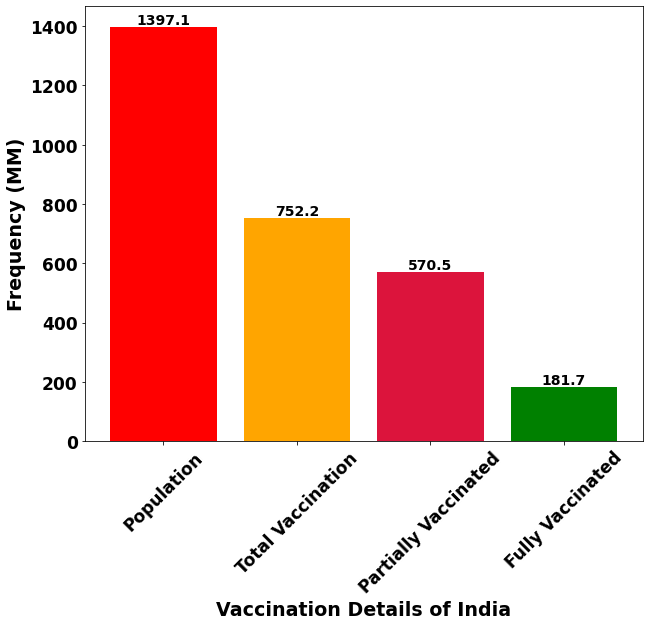

In [408]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y=[round(1397087126/1000000,1),round(int(vdf.loc[93][5])/1000000,1),round(int(vdf.loc[93][6])/1000000,1),round(int(vdf.loc[93][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['r','orange','crimson','g'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of India',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+10 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

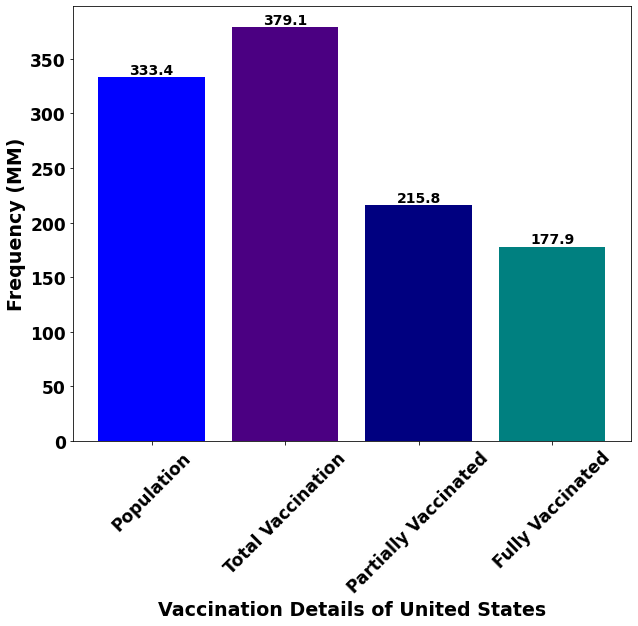

In [407]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(333447797/1000000,1),round(int(vdf.loc[217][5])/1000000,1),round(int(vdf.loc[217][6])/1000000,1),round(int(vdf.loc[217][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['b','indigo','navy','teal'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of United States',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+3 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

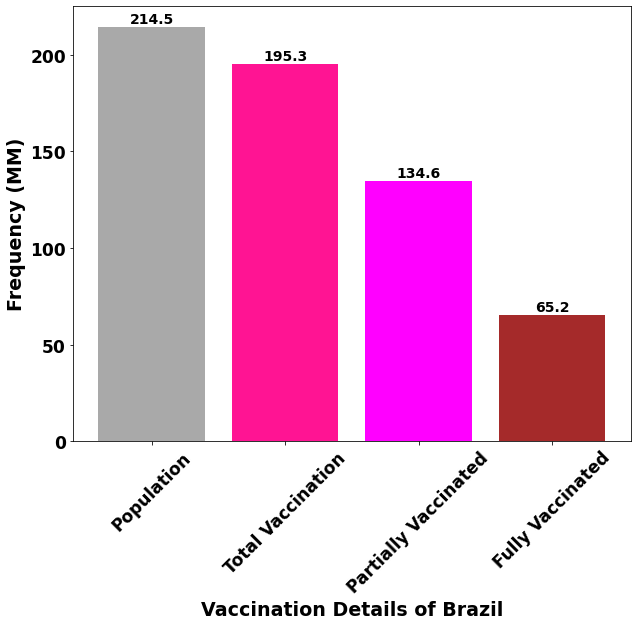

In [406]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(214462541/1000000,1),round(int(vdf.loc[29][5])/1000000,1),round(int(vdf.loc[29][6])/1000000,1),round(int(vdf.loc[29][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['darkgrey','deeppink','magenta','Brown'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of Brazil',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+2 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

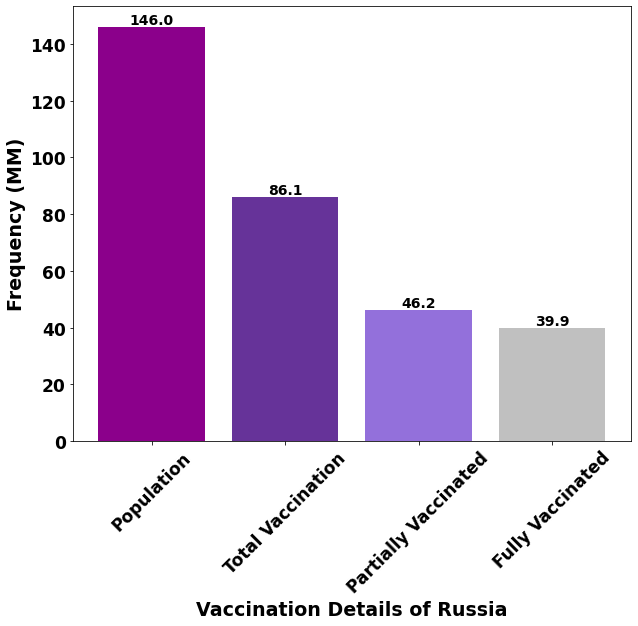

In [405]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(146013340/1000000,1),round(int(vdf.loc[169][5])/1000000,1),round(int(vdf.loc[169][6])/1000000,1),round(int(vdf.loc[169][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['darkmagenta','rebeccapurple','mediumpurple','silver'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of Russia',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

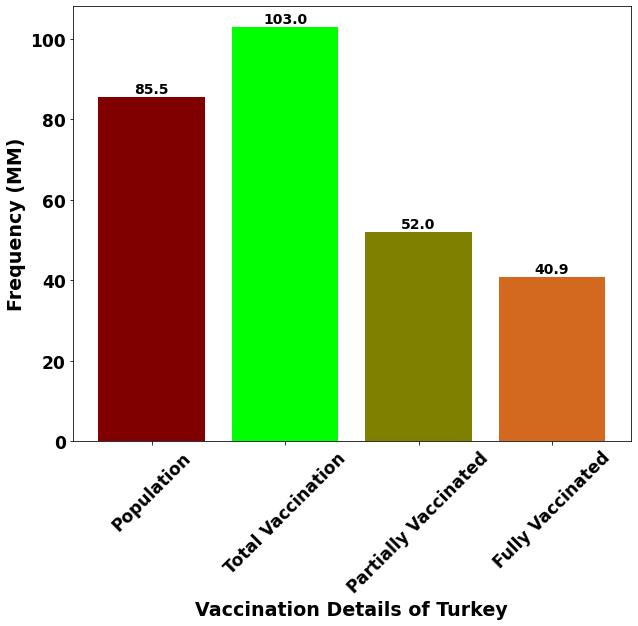

In [401]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(85481567/1000000,1),round(int(vdf.loc[209][5])/1000000,1),round(int(vdf.loc[209][6])/1000000,1),round(int(vdf.loc[209][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['maroon','lime','olive','chocolate'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of Turkey',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

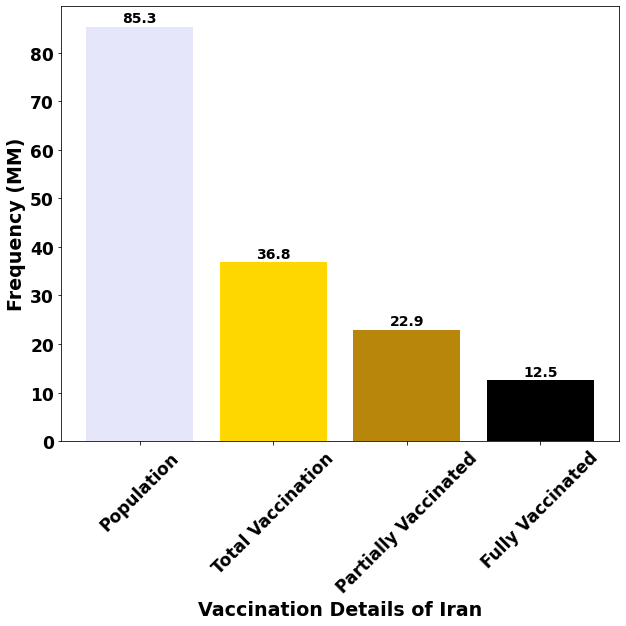

In [402]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(85345960/1000000,1),round(int(vdf.loc[95][5])/1000000,1),round(int(vdf.loc[95][6])/1000000,1),round(int(vdf.loc[95][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['lavender','gold','darkgoldenrod','black'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of Iran',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

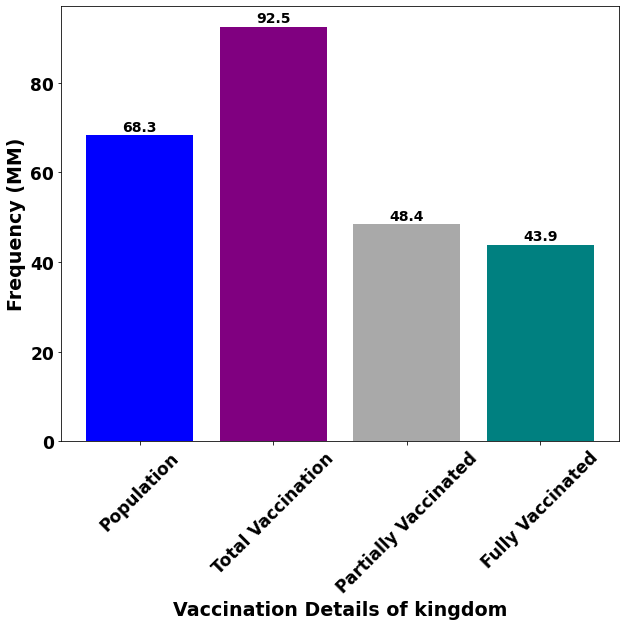

In [403]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(68335277/1000000,1),round(int(vdf.loc[202][5])/1000000,1),round(int(vdf.loc[202][6])/1000000,1),round(int(vdf.loc[202][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['b','Purple','darkgrey','teal'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of kingdom',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

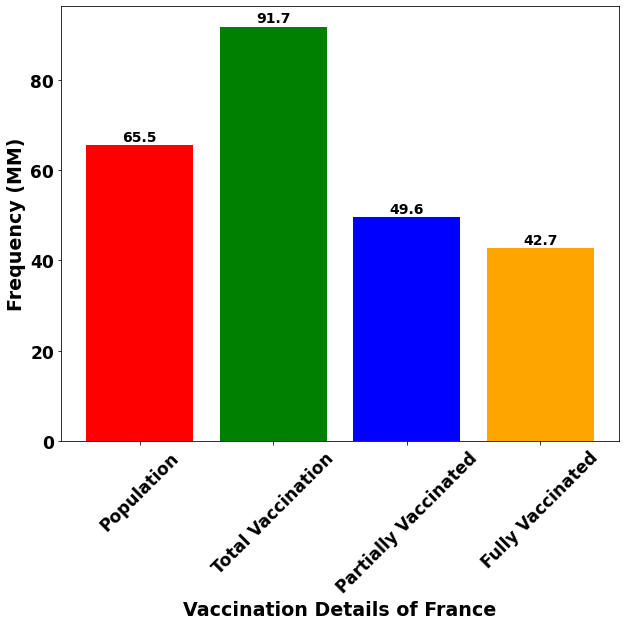

In [404]:
x=['Population','Total Vaccination', 'Partially Vaccinated', 'Fully Vaccinated']
y= [round(65455540/1000000,1),round(int(vdf.loc[70][5])/1000000,1),round(int(vdf.loc[70][6])/1000000,1),round(int(vdf.loc[70][8])/1000000,1)]
plt.figure(figsize=(10, 8))   
plt.bar(x,y,color=['r','g','b','orange'])
plt.xticks(fontsize=17,weight = 'bold',rotation=45)
plt.yticks(fontsize=17,weight = 'bold')
plt.xlabel('Vaccination Details of France',fontsize=19,weight = 'bold')
plt.ylabel('Frequency (MM)',fontsize=19,weight = 'bold')
for index,data in enumerate(y):
    plt.text(x=index , y =data+1 , s=f"{data}" , fontsize=14,ha='center',weight='bold')

## 14. Percentage of Fully Vaccinated Persons in Crisis Hit Countries

In [296]:
cc=['India','United States','Brazil','Russia','Turkey','Iran','United Kingdom','France']
cfvp=[
    round((int(vdf.loc[93][8])/1397087126)*100,2),
    round((int(vdf.loc[217][8])/333447797)*100,2),
    round((int(vdf.loc[29][8])/214462541)*100,2),
    round((int(vdf.loc[169][8])/146013340)*100,2),
    round((int(vdf.loc[209][8])/85481567)*100,2),
    round((int(vdf.loc[95][8])/85345960)*100,2),
    round((int(vdf.loc[202][8])/68335277)*100,2),
    round((int(vdf.loc[70][8])/65455540)*100,2)]
print(cc,'\n',cfvp)

['India', 'United States', 'Brazil', 'Russia', 'Turkey', 'Iran', 'United Kingdom', 'France'] 
 [13.01, 53.36, 30.42, 27.33, 47.87, 14.7, 64.29, 65.3]


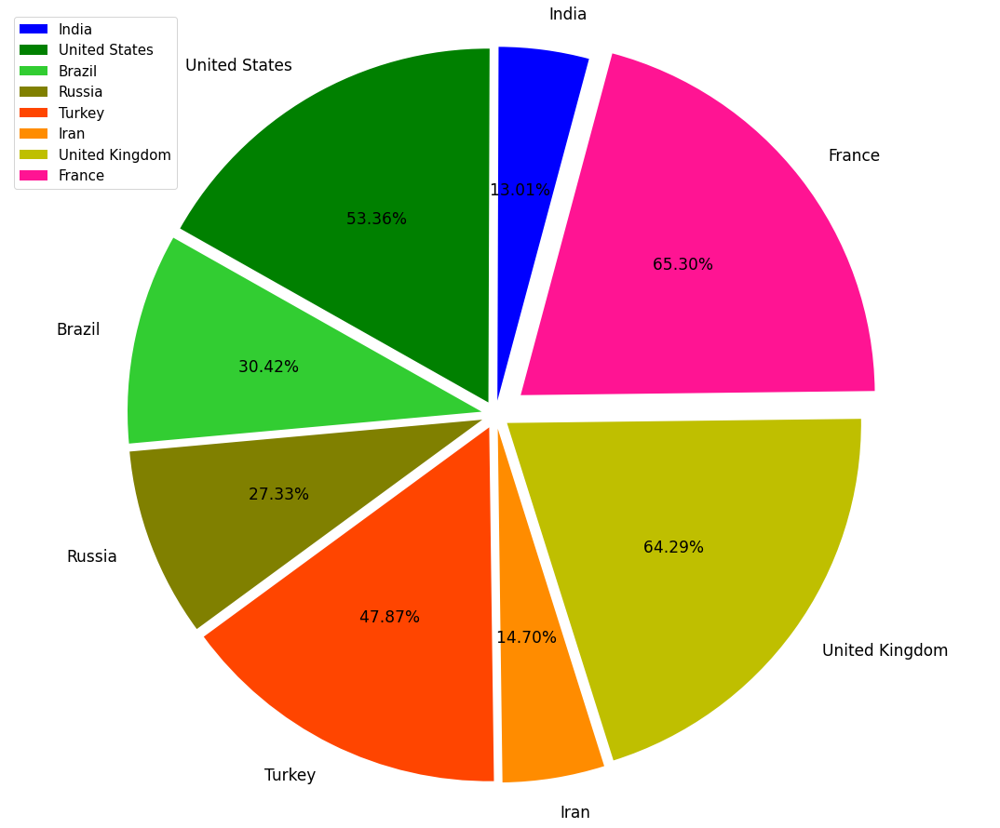

In [327]:
def autopcter(values):
    def autopct_inner(pct):
        total = sum(values)
        val = round(pct*total/100,2)
        return '{v:.2f}%  '.format(v=val)
    return autopct_inner
a=autopcter(cfvp)

explode = (0.04,0.04,0.04,0.04,0.04,0.04,0.04,0.09)
fig = plt.figure(figsize =(19, 16))
plt.pie(cfvp,explode =explode,labels=cc,autopct=a, shadow=False,
        startangle=75, colors=['b','g','limegreen','olive','orangered','darkorange','y','deeppink'],textprops={'fontsize': 17})
plt.axis('equal')
plt.legend(loc='upper left',prop={"size":15})
plt.show()